In [1]:
import math
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import scipy.cluster as cluster

In [2]:
START_POINTS_PER_SENSORY_DIMENSION = 51
N_SENSORS = 2
MAX_ROLLOUT_STEPS = 20000
BUFFER_SIZE = 5
#REGULARIZATION = 10**-12
TAU = 20
KAPPA = 1.8
FIXED_POINT_TIME_THRESHOLD = 200
FIXED_POINT_ABS_TOLERANCE = 1e-3 # 1e-3 #> 6 # 1e-3 > 91 # 1e-4 > 200
FIXED_POINT_REL_TOLERANCE = 0.0 # 1e-2
ORTHOGONALITY_TOLERANCE = 1e-03
DET_IS_ONE_TOLERANCE = 1e-05
REGULARIZATION = 1e-7
LAST_N_TIMESTEPS_FOR_MEAN = 1000
TOL = 10*1e-2
MAX_CLUSTER_DISTANCE = 0.1

VERBOSE = False
PLOT_TIMESTEPS = True
PLOT_TRAJECTORY_LAST_N_X_VALUE = 100
C_PLOT_WIDTH = 20
PLOT_C_HAT_EVOLUTION = False
CYAN = [0,1,1,1]
RED = [1,0,0,1]

REPRODUCE_DEP_2018_ALG = True

In [3]:
def lprint(*args, **kwargs):
    if VERBOSE:
        print(*args, **kwargs)

In [4]:
class Dep():
    
    def __init__(self, c_init, x_init):
        self.c = c_init
        self.x = x_init
        self.t = 0
        self.tau = TAU
        self.kappa = KAPPA
        self.model = np.identity(N_SENSORS)
        self.x_buffer = np.zeros(shape=(N_SENSORS, BUFFER_SIZE))
        for j in range(BUFFER_SIZE):
            self.x_buffer[:,j] = x_init[:,0]
        print("x_init", x_init)
        print("x_buffer", self.x_buffer)
        
    def step(self, x):
        self.x = x
        self.t_mod = self.t % BUFFER_SIZE
        lprint("\nt", self.t)
        lprint("\nt_mod", self.t_mod)
        self.x_buffer[:, self.t_mod] = self.x[:,0]
        #print("x", self.x)
        #print("x_buffer", self.x_buffer)
        if self.t==2 and REPRODUCE_DEP_2018_ALG:
            # Reinitialize with zeroes rather than identity
            self.c = np.zeros(shape=(self.c.shape))
        self.change_c()
        self.normalize_c()
        self.calculate_y()
        self.t = self.t + 1
        #self.x = self.y # short circuit for x(t+1)
        return (self.c_hat, self.y)
        
    def change_c(self):
        x = self.x_buffer[:, self.t_mod]
        xx = self.x_buffer[:, self.t_mod - 1]
        xxx = self.x_buffer[:, self.t_mod - 2]
        lprint("x", x)
        lprint("xx", xx)
        lprint("xxx", xxx)
        x_dot_prime = np.array([x-xx])
        x_dot = np.array([xx-xxx])
        lprint("x_dot", x_dot)
        lprint("x_dot_prime", x_dot_prime) 
        y_dot_tilde = np.matmul(self.model, x_dot_prime.T)
        lprint("y_dot_tilde", y_dot_tilde)
        product = np.matmul(y_dot_tilde, x_dot)     
        lprint("product", product)
        lprint("previous c")
        lprint(self.c)
        lprint("product - self.c", product - self.c)
        lprint("(product - self.c) / self.tau", (product - self.c) / self.tau)
        self.c = self.c + ((product - self.c) / self.tau)
        lprint("updated c", self.c)
        if self.t==0:
            print("x", x)
            print("xx", xx)
            print("xxx", xxx)
            print("x_dot", x_dot)
            print("y_dot_tilde", y_dot_tilde)
        
    def normalize_c(self):
        norml = math.sqrt(np.sum(self.c**2))
        lprint("norml", norml)
        self.c_hat = np.multiply(self.c, self.kappa/(norml+REGULARIZATION))
        lprint("c_hat", self.c_hat)
        
    def calculate_y(self):
        lprint("c_hat", self.c_hat)
        lprint("x", self.x)
        lprint("c_hat*x", np.matmul(self.c_hat, self.x))
        self.y = np.tanh(np.matmul(self.c_hat, self.x))
        lprint("y", self.y)
                

In [5]:
def get_angle_from_c_mean(c_mean):
    norm = np.linalg.norm(c_mean)
    if norm < TOL:
        # Zero matrix
        angle = -2000
    elif np.abs(c_mean[0,0]-c_mean[1,1])<TOL and np.abs(c_mean[1,0]+c_mean[0,1])<TOL:
        # Standard attractor, C interpreted as rotational matrix
        angle = np.arctan2(c_mean[1,0],c_mean[0,0]) * 180 / np.pi
        #angle = round(Decimal(angle,2))
        angle = round(angle,2)
    else:
        # period-2 oscillator
        angle = -1000
    return angle    
            
def angle_to_rgba(angle):
        norm = matplotlib.colors.Normalize(vmin=-90, vmax=90, clip=True)
        mapper = matplotlib.cm.ScalarMappable(norm=norm, cmap=matplotlib.cm.Spectral)
        if angle==-1000:
            return CYAN
        elif angle ==-2000:
            return RED
        return list(mapper.to_rgba(angle))   


In [6]:
x = np.array([[-1, 1]]).T
print(x.T)
c = np.identity(len(x))
dep = Dep(c, x)
for t in range(6):
    print("------- t=%d" % t)
    c_hat, y = dep.step(x)
    print(y)
    print(c_hat) 
    x = y

[[-1  1]]
x_init [[-1]
 [ 1]]
x_buffer [[-1. -1. -1. -1. -1.]
 [ 1.  1.  1.  1.  1.]]
------- t=0
x [-1.  1.]
xx [-1.  1.]
xxx [-1.  1.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
[[-0.8545526]
 [ 0.8545526]]
[[1.27279211 0.        ]
 [0.         1.27279211]]
------- t=1
[[-0.79602534]
 [ 0.79602534]]
[[1.27279211 0.        ]
 [0.         1.27279211]]
------- t=2
[[-0.89221396]
 [ 0.89221396]]
[[ 0.89989429 -0.89989429]
 [-0.89989429  0.89989429]]
------- t=3
[[-0.92246721]
 [ 0.92246721]]
[[ 0.8996339 -0.8996339]
 [-0.8996339  0.8996339]]
------- t=4
[[-0.93023394]
 [ 0.93023394]]
[[ 0.89982842 -0.89982842]
 [-0.89982842  0.89982842]]
------- t=5
[[-0.93209171]
 [ 0.93209171]]
[[ 0.89982753 -0.89982753]
 [-0.89982753  0.89982753]]


In [7]:
def rollout_dep(x1, x2):
    x = np.array([[x1, x2]]).T
    c = np.identity(len(x))
    #c = np.array([[0.,0.],[0.,0.]])
    all_c_hat = []
    all_x = []
    dep = Dep(c, x)
    for t in range(MAX_ROLLOUT_STEPS):
        c_hat, y = dep.step(x)
        all_c_hat.append(c_hat)
        x = y # Short circuit
        all_x.append(x) 
    all_c_hat = np.array(all_c_hat)
    print("shape", all_c_hat.shape)
    c_mean = np.mean(all_c_hat[-LAST_N_TIMESTEPS_FOR_MEAN:], axis=0)
    return (c_mean, all_c_hat, all_x)

In [8]:
def plot_c(all_c_hat):
    height = int(math.ceil(len(all_c_hat) / C_PLOT_WIDTH))
    print(height)
    fig, axes = plt.subplots(height, C_PLOT_WIDTH, figsize=(16, height*1))
    for t in range(height*C_PLOT_WIDTH):
        ax = axes[t] if height==1 else axes[t // C_PLOT_WIDTH, t % C_PLOT_WIDTH]
        ax.set_axis_off()
        if t<len(all_c_hat):
            c_hat = all_c_hat[t]
            lprint("t", t)
            lprint("c_hat", c_hat)
            ax.set_title("t=%d" % t)
            matrix = ax.imshow(c_hat)
            matrix.set_cmap("PRGn")
    plt.show()
    #plt.close()    


In [9]:
def plot_trajectory(all_x):
    fig, ax = plt.subplots()
    selected_x = all_x[-PLOT_TRAJECTORY_LAST_N_X_VALUE:]
    x1 = list(map(lambda x: x[0], selected_x))
    x2 = list(map(lambda x: x[1], selected_x))
    ax.plot(x1, x2)
    ax.grid()
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_xlabel("x1")
    ax.set_ylabel("x2")
    plt.show()
    


=================== Rollout 0 =====================
x_init [[-1.]
 [-1.]]
x_buffer [[-1. -1. -1. -1. -1.]
 [-1. -1. -1. -1. -1.]]
x [-1. -1.]
xx [-1. -1.]
xxx [-1. -1.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -1.0]


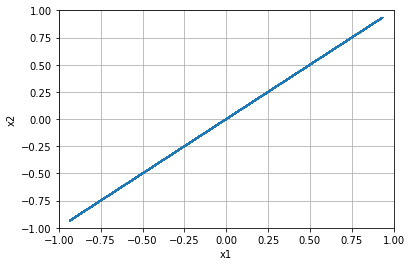


=================== Rollout 1 =====================
x_init [[-1.  ]
 [-0.96]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-1.   -0.96]
xx [-1.   -0.96]
xxx [-1.   -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.96]


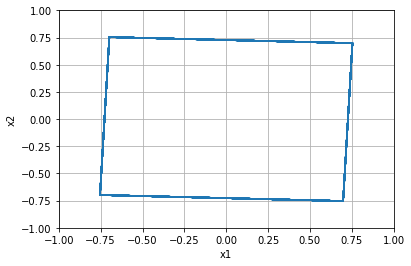


=================== Rollout 2 =====================
x_init [[-1.  ]
 [-0.92]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-1.   -0.92]
xx [-1.   -0.92]
xxx [-1.   -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.92]


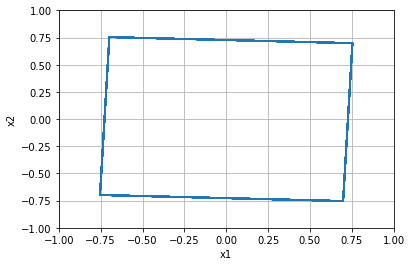


=================== Rollout 3 =====================
x_init [[-1.  ]
 [-0.88]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-1.   -0.88]
xx [-1.   -0.88]
xxx [-1.   -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.88]


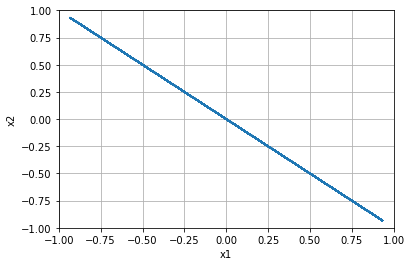


=================== Rollout 4 =====================
x_init [[-1.  ]
 [-0.84]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-1.   -0.84]
xx [-1.   -0.84]
xxx [-1.   -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.84]


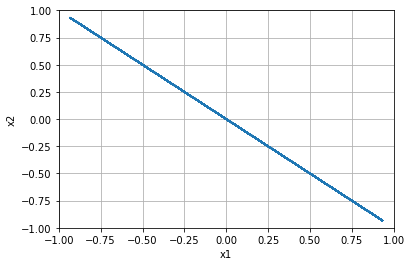


=================== Rollout 5 =====================
x_init [[-1. ]
 [-0.8]]
x_buffer [[-1.  -1.  -1.  -1.  -1. ]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [-1.  -0.8]
xx [-1.  -0.8]
xxx [-1.  -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.8]


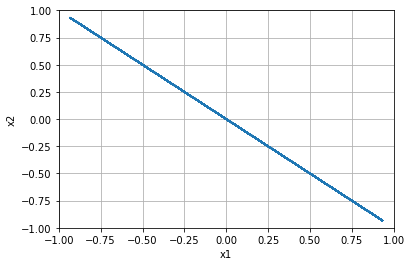


=================== Rollout 6 =====================
x_init [[-1.  ]
 [-0.76]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-1.   -0.76]
xx [-1.   -0.76]
xxx [-1.   -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.76]


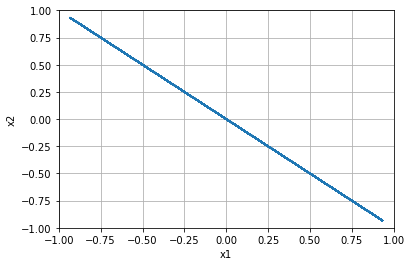


=================== Rollout 7 =====================
x_init [[-1.  ]
 [-0.72]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-1.   -0.72]
xx [-1.   -0.72]
xxx [-1.   -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.72]


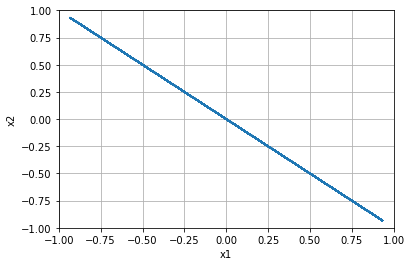


=================== Rollout 8 =====================
x_init [[-1.  ]
 [-0.68]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-1.   -0.68]
xx [-1.   -0.68]
xxx [-1.   -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.6799999999999999]


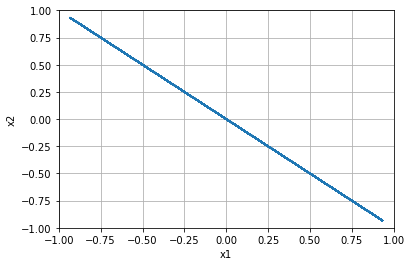


=================== Rollout 9 =====================
x_init [[-1.  ]
 [-0.64]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-1.   -0.64]
xx [-1.   -0.64]
xxx [-1.   -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.64]


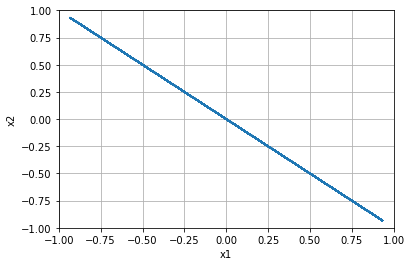


=================== Rollout 10 =====================
x_init [[-1. ]
 [-0.6]]
x_buffer [[-1.  -1.  -1.  -1.  -1. ]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [-1.  -0.6]
xx [-1.  -0.6]
xxx [-1.  -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.6]


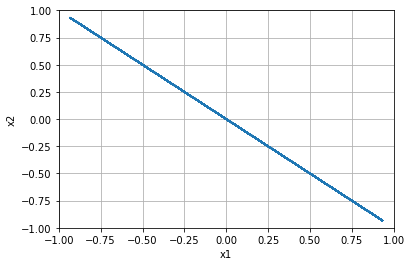


=================== Rollout 11 =====================
x_init [[-1.  ]
 [-0.56]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-1.   -0.56]
xx [-1.   -0.56]
xxx [-1.   -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.56]


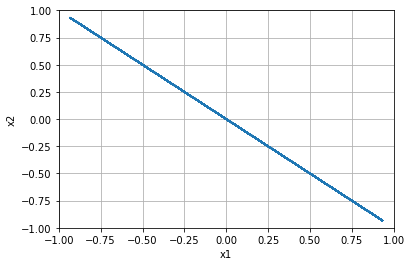


=================== Rollout 12 =====================
x_init [[-1.  ]
 [-0.52]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-1.   -0.52]
xx [-1.   -0.52]
xxx [-1.   -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.52]


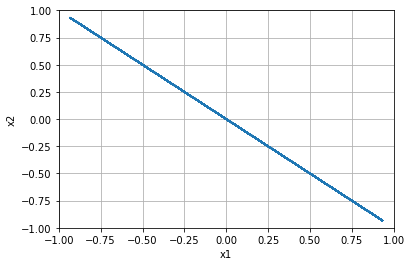


=================== Rollout 13 =====================
x_init [[-1.  ]
 [-0.48]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-1.   -0.48]
xx [-1.   -0.48]
xxx [-1.   -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.48]


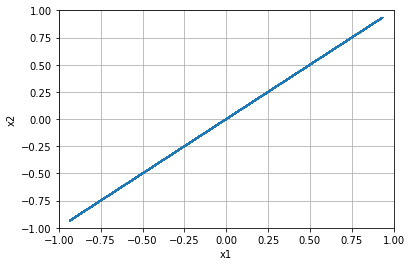


=================== Rollout 14 =====================
x_init [[-1.  ]
 [-0.44]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-1.   -0.44]
xx [-1.   -0.44]
xxx [-1.   -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.43999999999999995]


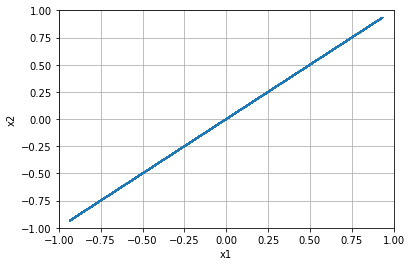


=================== Rollout 15 =====================
x_init [[-1. ]
 [-0.4]]
x_buffer [[-1.  -1.  -1.  -1.  -1. ]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [-1.  -0.4]
xx [-1.  -0.4]
xxx [-1.  -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.4]


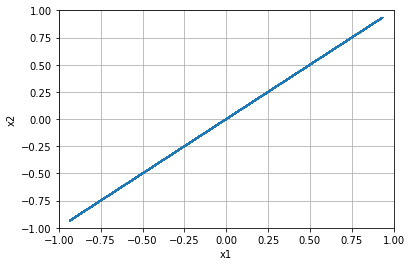


=================== Rollout 16 =====================
x_init [[-1.  ]
 [-0.36]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-1.   -0.36]
xx [-1.   -0.36]
xxx [-1.   -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.36]


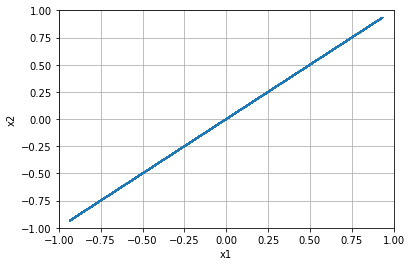


=================== Rollout 17 =====================
x_init [[-1.  ]
 [-0.32]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-1.   -0.32]
xx [-1.   -0.32]
xxx [-1.   -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.31999999999999995]


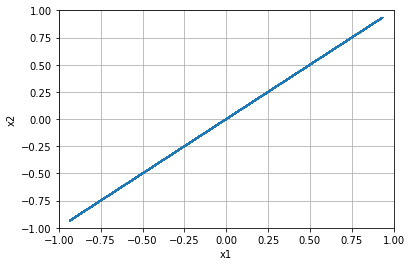


=================== Rollout 18 =====================
x_init [[-1.  ]
 [-0.28]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-1.   -0.28]
xx [-1.   -0.28]
xxx [-1.   -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.28]


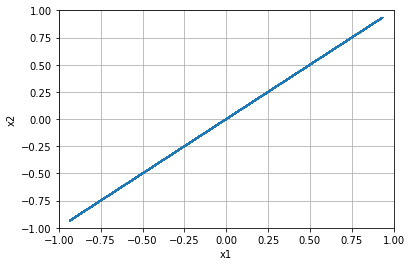


=================== Rollout 19 =====================
x_init [[-1.  ]
 [-0.24]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-1.   -0.24]
xx [-1.   -0.24]
xxx [-1.   -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.24]


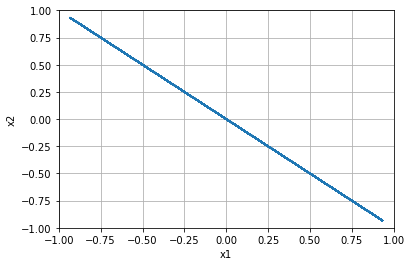


=================== Rollout 20 =====================
x_init [[-1. ]
 [-0.2]]
x_buffer [[-1.  -1.  -1.  -1.  -1. ]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [-1.  -0.2]
xx [-1.  -0.2]
xxx [-1.  -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.19999999999999996]


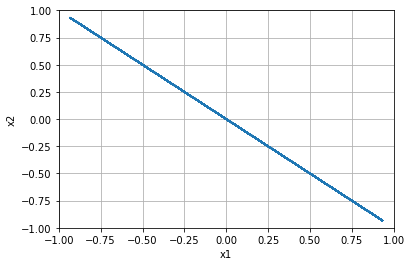


=================== Rollout 21 =====================
x_init [[-1.  ]
 [-0.16]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-1.   -0.16]
xx [-1.   -0.16]
xxx [-1.   -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.16000000000000003]


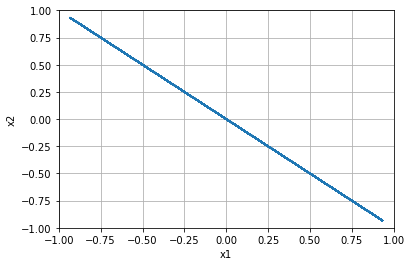


=================== Rollout 22 =====================
x_init [[-1.  ]
 [-0.12]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-1.   -0.12]
xx [-1.   -0.12]
xxx [-1.   -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.12]


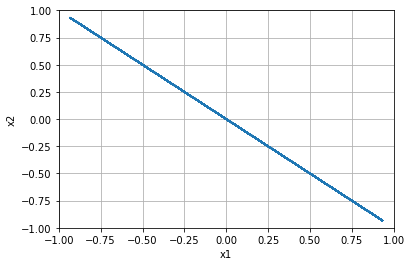


=================== Rollout 23 =====================
x_init [[-1.  ]
 [-0.08]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-1.   -0.08]
xx [-1.   -0.08]
xxx [-1.   -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.07999999999999996]


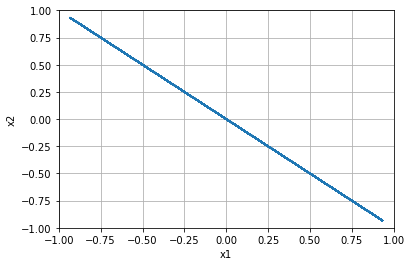


=================== Rollout 24 =====================
x_init [[-1.  ]
 [-0.04]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-1.   -0.04]
xx [-1.   -0.04]
xxx [-1.   -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, -0.040000000000000036]


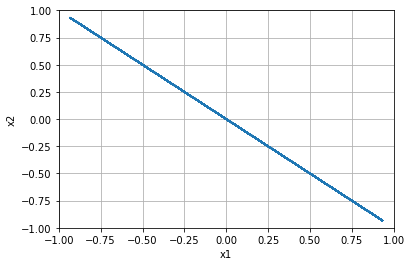


=================== Rollout 25 =====================
x_init [[-1.]
 [ 0.]]
x_buffer [[-1. -1. -1. -1. -1.]
 [ 0.  0.  0.  0.  0.]]
x [-1.  0.]
xx [-1.  0.]
xxx [-1.  0.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.0]


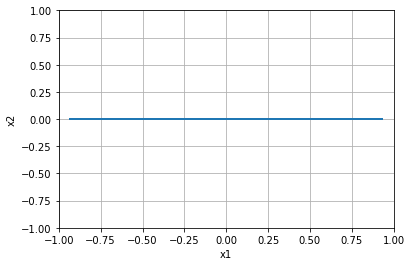


=================== Rollout 26 =====================
x_init [[-1.  ]
 [ 0.04]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-1.    0.04]
xx [-1.    0.04]
xxx [-1.    0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.040000000000000036]


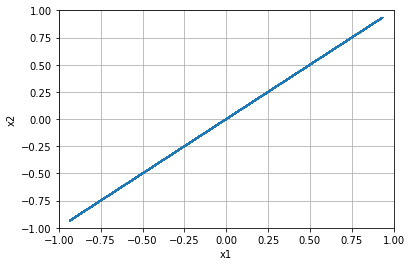


=================== Rollout 27 =====================
x_init [[-1.  ]
 [ 0.08]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-1.    0.08]
xx [-1.    0.08]
xxx [-1.    0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.08000000000000007]


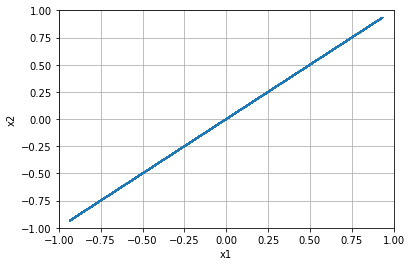


=================== Rollout 28 =====================
x_init [[-1.  ]
 [ 0.12]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-1.    0.12]
xx [-1.    0.12]
xxx [-1.    0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.1200000000000001]


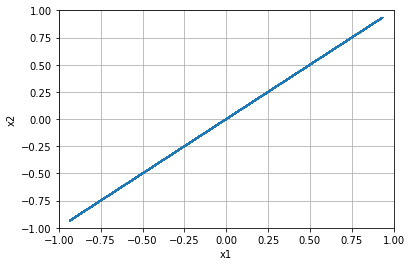


=================== Rollout 29 =====================
x_init [[-1.  ]
 [ 0.16]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-1.    0.16]
xx [-1.    0.16]
xxx [-1.    0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.15999999999999992]


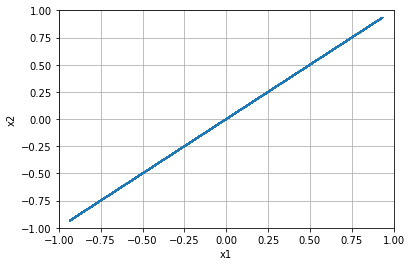


=================== Rollout 30 =====================
x_init [[-1. ]
 [ 0.2]]
x_buffer [[-1.  -1.  -1.  -1.  -1. ]
 [ 0.2  0.2  0.2  0.2  0.2]]
x [-1.   0.2]
xx [-1.   0.2]
xxx [-1.   0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.19999999999999996]


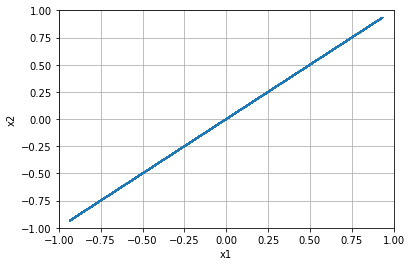


=================== Rollout 31 =====================
x_init [[-1.  ]
 [ 0.24]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-1.    0.24]
xx [-1.    0.24]
xxx [-1.    0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.24]


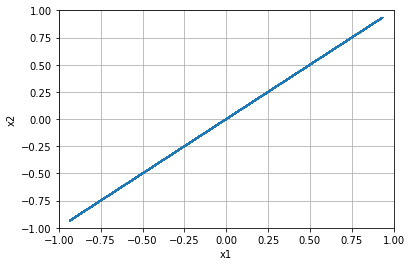


=================== Rollout 32 =====================
x_init [[-1.  ]
 [ 0.28]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-1.    0.28]
xx [-1.    0.28]
xxx [-1.    0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.28]


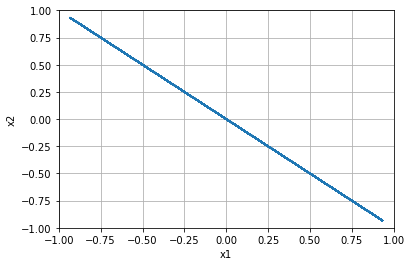


=================== Rollout 33 =====================
x_init [[-1.  ]
 [ 0.32]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-1.    0.32]
xx [-1.    0.32]
xxx [-1.    0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.32000000000000006]


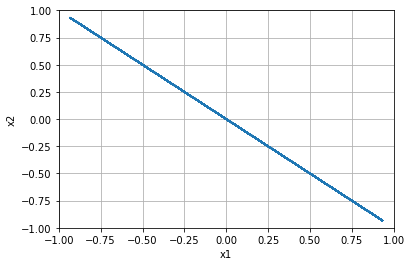


=================== Rollout 34 =====================
x_init [[-1.  ]
 [ 0.36]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-1.    0.36]
xx [-1.    0.36]
xxx [-1.    0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.3600000000000001]


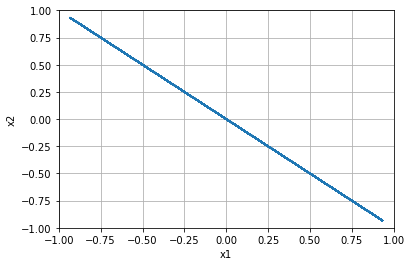


=================== Rollout 35 =====================
x_init [[-1. ]
 [ 0.4]]
x_buffer [[-1.  -1.  -1.  -1.  -1. ]
 [ 0.4  0.4  0.4  0.4  0.4]]
x [-1.   0.4]
xx [-1.   0.4]
xxx [-1.   0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.40000000000000013]


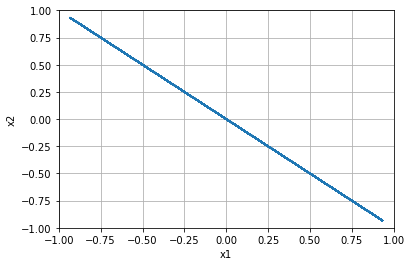


=================== Rollout 36 =====================
x_init [[-1.  ]
 [ 0.44]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-1.    0.44]
xx [-1.    0.44]
xxx [-1.    0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.43999999999999995]


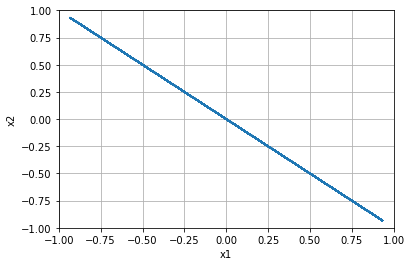


=================== Rollout 37 =====================
x_init [[-1.  ]
 [ 0.48]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-1.    0.48]
xx [-1.    0.48]
xxx [-1.    0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.48]


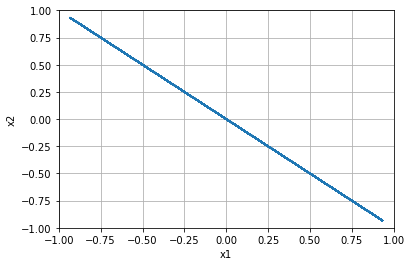


=================== Rollout 38 =====================
x_init [[-1.  ]
 [ 0.52]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-1.    0.52]
xx [-1.    0.52]
xxx [-1.    0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.52]


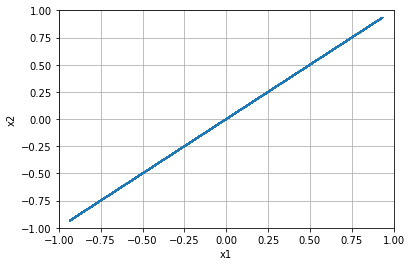


=================== Rollout 39 =====================
x_init [[-1.  ]
 [ 0.56]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-1.    0.56]
xx [-1.    0.56]
xxx [-1.    0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.56]


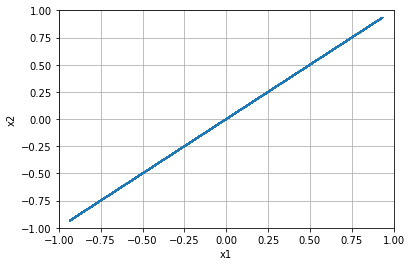


=================== Rollout 40 =====================
x_init [[-1. ]
 [ 0.6]]
x_buffer [[-1.  -1.  -1.  -1.  -1. ]
 [ 0.6  0.6  0.6  0.6  0.6]]
x [-1.   0.6]
xx [-1.   0.6]
xxx [-1.   0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.6000000000000001]


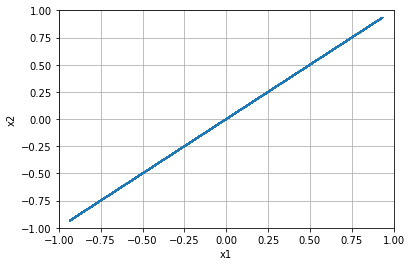


=================== Rollout 41 =====================
x_init [[-1.  ]
 [ 0.64]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-1.    0.64]
xx [-1.    0.64]
xxx [-1.    0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.6400000000000001]


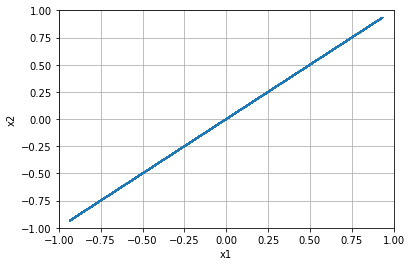


=================== Rollout 42 =====================
x_init [[-1.  ]
 [ 0.68]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-1.    0.68]
xx [-1.    0.68]
xxx [-1.    0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.6799999999999999]


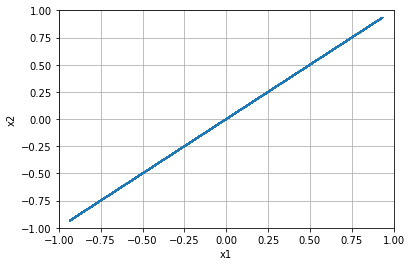


=================== Rollout 43 =====================
x_init [[-1.  ]
 [ 0.72]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-1.    0.72]
xx [-1.    0.72]
xxx [-1.    0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.72]


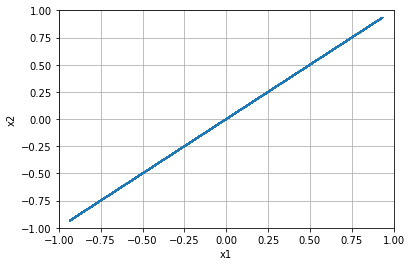


=================== Rollout 44 =====================
x_init [[-1.  ]
 [ 0.76]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-1.    0.76]
xx [-1.    0.76]
xxx [-1.    0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.76]


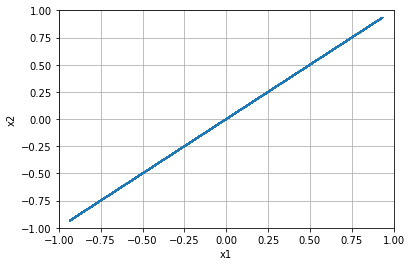


=================== Rollout 45 =====================
x_init [[-1. ]
 [ 0.8]]
x_buffer [[-1.  -1.  -1.  -1.  -1. ]
 [ 0.8  0.8  0.8  0.8  0.8]]
x [-1.   0.8]
xx [-1.   0.8]
xxx [-1.   0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.8]


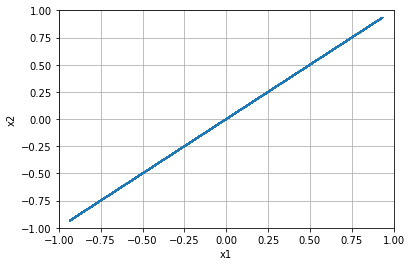


=================== Rollout 46 =====================
x_init [[-1.  ]
 [ 0.84]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-1.    0.84]
xx [-1.    0.84]
xxx [-1.    0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.8400000000000001]


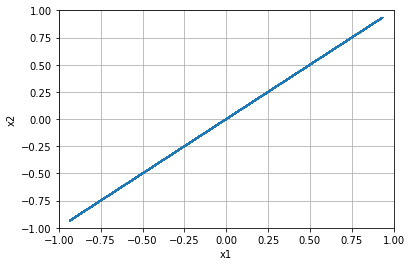


=================== Rollout 47 =====================
x_init [[-1.  ]
 [ 0.88]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-1.    0.88]
xx [-1.    0.88]
xxx [-1.    0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.8800000000000001]


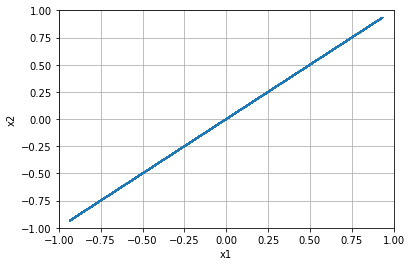


=================== Rollout 48 =====================
x_init [[-1.  ]
 [ 0.92]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-1.    0.92]
xx [-1.    0.92]
xxx [-1.    0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.9199999999999999]


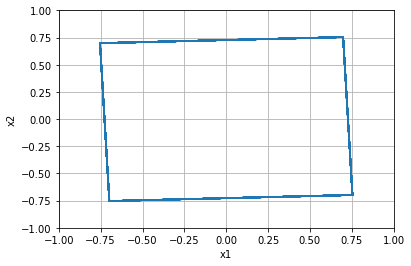


=================== Rollout 49 =====================
x_init [[-1.  ]
 [ 0.96]]
x_buffer [[-1.   -1.   -1.   -1.   -1.  ]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-1.    0.96]
xx [-1.    0.96]
xxx [-1.    0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 0.96]


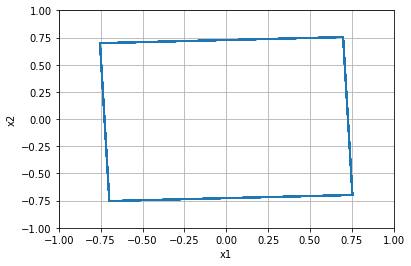


=================== Rollout 50 =====================
x_init [[-1.]
 [ 1.]]
x_buffer [[-1. -1. -1. -1. -1.]
 [ 1.  1.  1.  1.  1.]]
x [-1.  1.]
xx [-1.  1.]
xxx [-1.  1.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-1.0, 1.0]


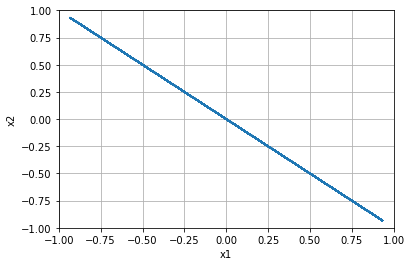


=================== Rollout 51 =====================
x_init [[-0.96]
 [-1.  ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.96 -1.  ]
xx [-0.96 -1.  ]
xxx [-0.96 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -1.0]


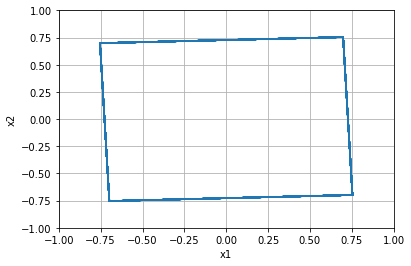


=================== Rollout 52 =====================
x_init [[-0.96]
 [-0.96]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.96 -0.96]
xx [-0.96 -0.96]
xxx [-0.96 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.96]


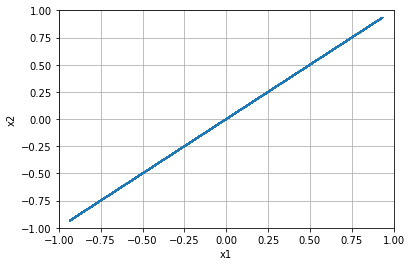


=================== Rollout 53 =====================
x_init [[-0.96]
 [-0.92]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.96 -0.92]
xx [-0.96 -0.92]
xxx [-0.96 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.92]


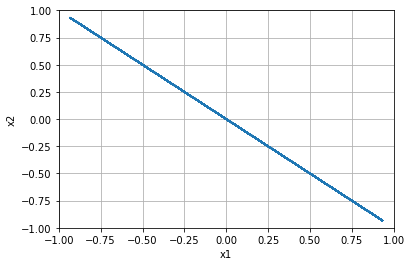


=================== Rollout 54 =====================
x_init [[-0.96]
 [-0.88]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.96 -0.88]
xx [-0.96 -0.88]
xxx [-0.96 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.88]


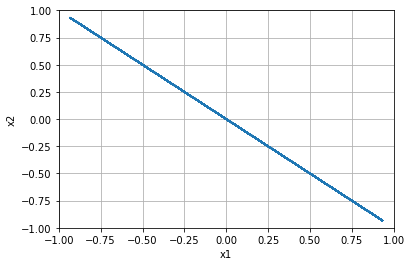


=================== Rollout 55 =====================
x_init [[-0.96]
 [-0.84]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.96 -0.84]
xx [-0.96 -0.84]
xxx [-0.96 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.84]


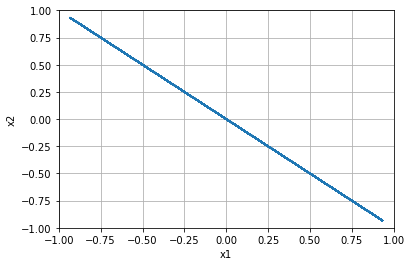


=================== Rollout 56 =====================
x_init [[-0.96]
 [-0.8 ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.96 -0.8 ]
xx [-0.96 -0.8 ]
xxx [-0.96 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.8]


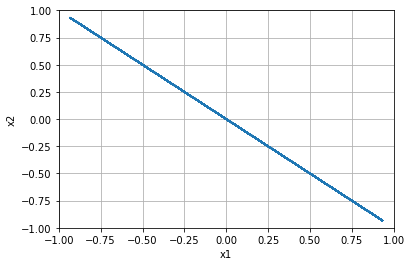


=================== Rollout 57 =====================
x_init [[-0.96]
 [-0.76]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.96 -0.76]
xx [-0.96 -0.76]
xxx [-0.96 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.76]


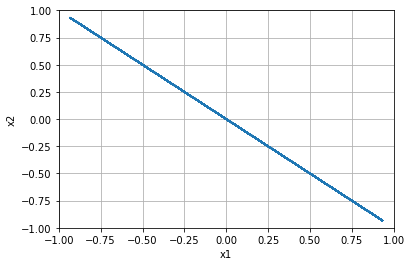


=================== Rollout 58 =====================
x_init [[-0.96]
 [-0.72]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.96 -0.72]
xx [-0.96 -0.72]
xxx [-0.96 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.72]


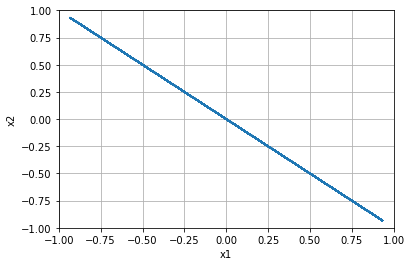


=================== Rollout 59 =====================
x_init [[-0.96]
 [-0.68]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.96 -0.68]
xx [-0.96 -0.68]
xxx [-0.96 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.6799999999999999]


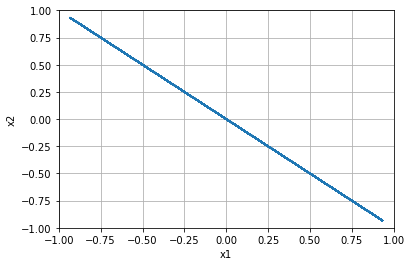


=================== Rollout 60 =====================
x_init [[-0.96]
 [-0.64]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.96 -0.64]
xx [-0.96 -0.64]
xxx [-0.96 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.64]


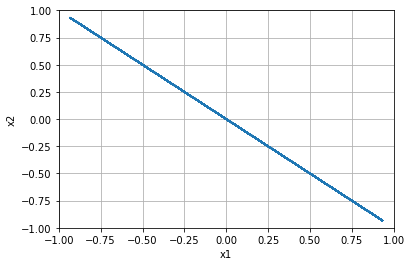


=================== Rollout 61 =====================
x_init [[-0.96]
 [-0.6 ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.96 -0.6 ]
xx [-0.96 -0.6 ]
xxx [-0.96 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.6]


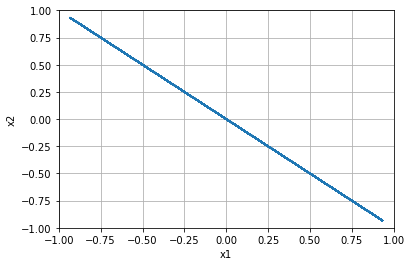


=================== Rollout 62 =====================
x_init [[-0.96]
 [-0.56]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.96 -0.56]
xx [-0.96 -0.56]
xxx [-0.96 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.56]


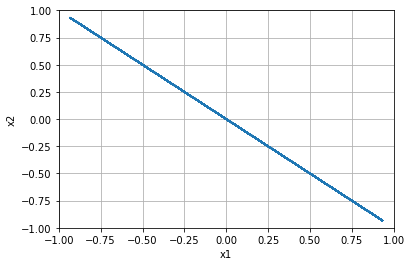


=================== Rollout 63 =====================
x_init [[-0.96]
 [-0.52]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.96 -0.52]
xx [-0.96 -0.52]
xxx [-0.96 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.52]


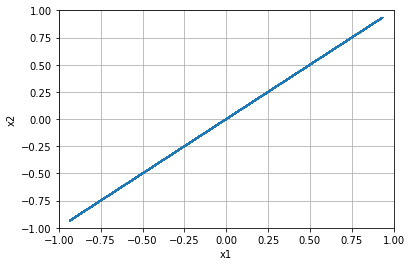


=================== Rollout 64 =====================
x_init [[-0.96]
 [-0.48]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.96 -0.48]
xx [-0.96 -0.48]
xxx [-0.96 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.48]


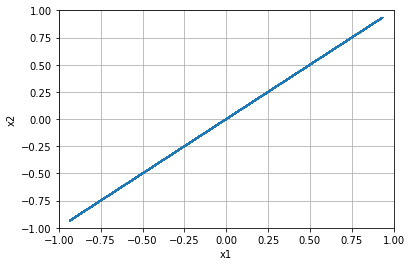


=================== Rollout 65 =====================
x_init [[-0.96]
 [-0.44]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.96 -0.44]
xx [-0.96 -0.44]
xxx [-0.96 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.43999999999999995]


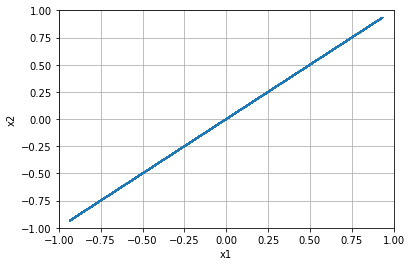


=================== Rollout 66 =====================
x_init [[-0.96]
 [-0.4 ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.96 -0.4 ]
xx [-0.96 -0.4 ]
xxx [-0.96 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.4]


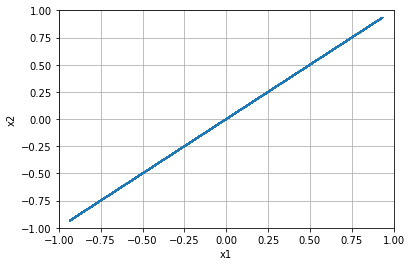


=================== Rollout 67 =====================
x_init [[-0.96]
 [-0.36]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.96 -0.36]
xx [-0.96 -0.36]
xxx [-0.96 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.36]


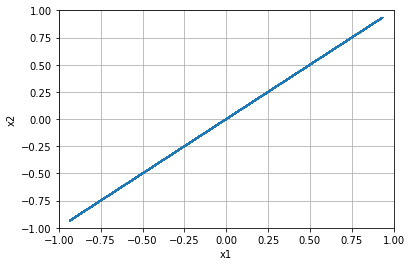


=================== Rollout 68 =====================
x_init [[-0.96]
 [-0.32]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.96 -0.32]
xx [-0.96 -0.32]
xxx [-0.96 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.31999999999999995]


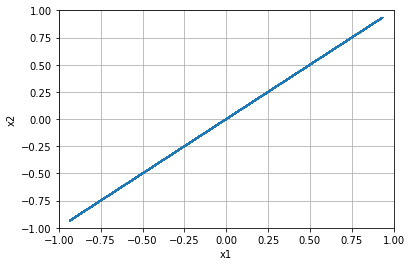


=================== Rollout 69 =====================
x_init [[-0.96]
 [-0.28]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.96 -0.28]
xx [-0.96 -0.28]
xxx [-0.96 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.28]


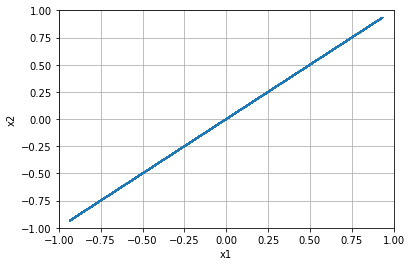


=================== Rollout 70 =====================
x_init [[-0.96]
 [-0.24]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.96 -0.24]
xx [-0.96 -0.24]
xxx [-0.96 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.24]


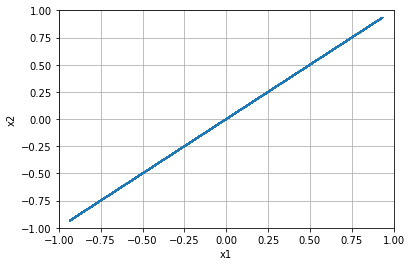


=================== Rollout 71 =====================
x_init [[-0.96]
 [-0.2 ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.96 -0.2 ]
xx [-0.96 -0.2 ]
xxx [-0.96 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.19999999999999996]


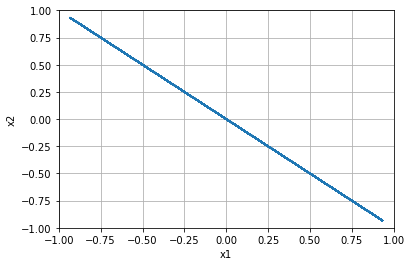


=================== Rollout 72 =====================
x_init [[-0.96]
 [-0.16]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.96 -0.16]
xx [-0.96 -0.16]
xxx [-0.96 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.16000000000000003]


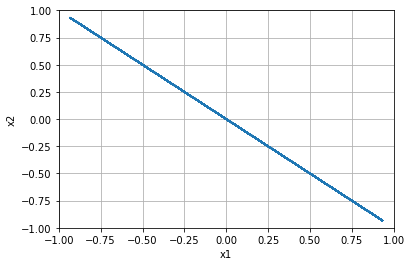


=================== Rollout 73 =====================
x_init [[-0.96]
 [-0.12]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.96 -0.12]
xx [-0.96 -0.12]
xxx [-0.96 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.12]


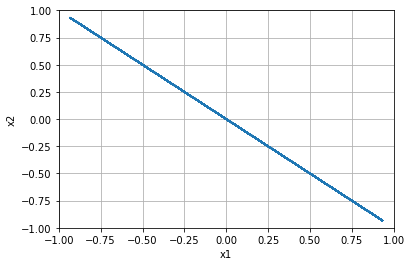


=================== Rollout 74 =====================
x_init [[-0.96]
 [-0.08]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.96 -0.08]
xx [-0.96 -0.08]
xxx [-0.96 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.07999999999999996]


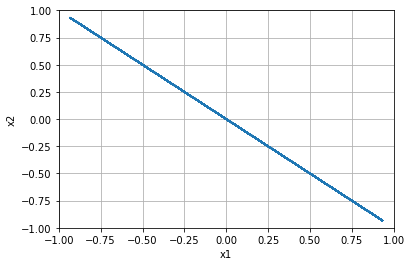


=================== Rollout 75 =====================
x_init [[-0.96]
 [-0.04]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.96 -0.04]
xx [-0.96 -0.04]
xxx [-0.96 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, -0.040000000000000036]


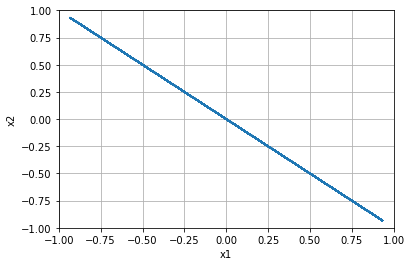


=================== Rollout 76 =====================
x_init [[-0.96]
 [ 0.  ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.96  0.  ]
xx [-0.96  0.  ]
xxx [-0.96  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.0]


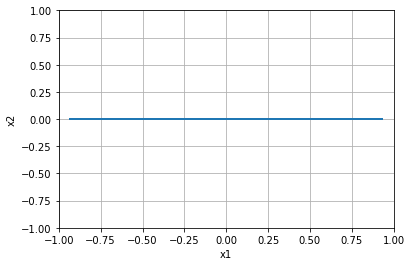


=================== Rollout 77 =====================
x_init [[-0.96]
 [ 0.04]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.96  0.04]
xx [-0.96  0.04]
xxx [-0.96  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.040000000000000036]


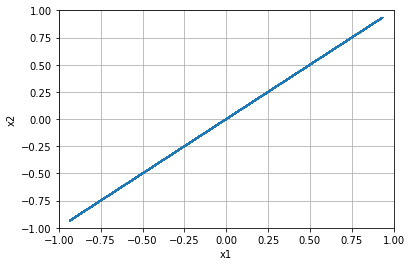


=================== Rollout 78 =====================
x_init [[-0.96]
 [ 0.08]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.96  0.08]
xx [-0.96  0.08]
xxx [-0.96  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.08000000000000007]


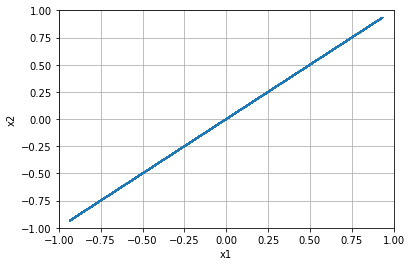


=================== Rollout 79 =====================
x_init [[-0.96]
 [ 0.12]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.96  0.12]
xx [-0.96  0.12]
xxx [-0.96  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.1200000000000001]


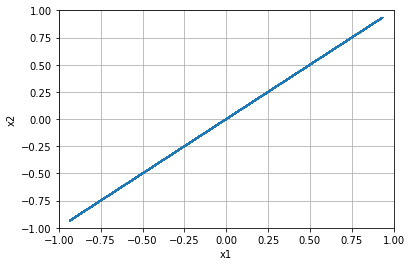


=================== Rollout 80 =====================
x_init [[-0.96]
 [ 0.16]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.96  0.16]
xx [-0.96  0.16]
xxx [-0.96  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.15999999999999992]


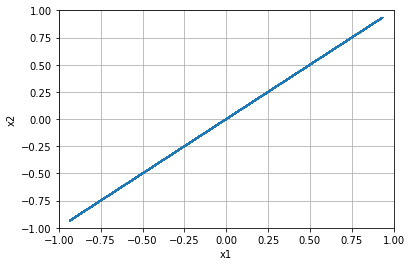


=================== Rollout 81 =====================
x_init [[-0.96]
 [ 0.2 ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.96  0.2 ]
xx [-0.96  0.2 ]
xxx [-0.96  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.19999999999999996]


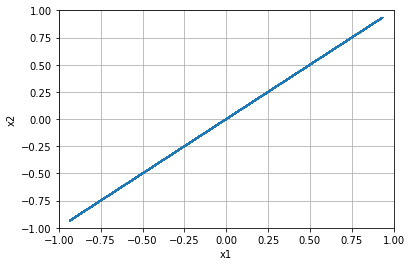


=================== Rollout 82 =====================
x_init [[-0.96]
 [ 0.24]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.96  0.24]
xx [-0.96  0.24]
xxx [-0.96  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.24]


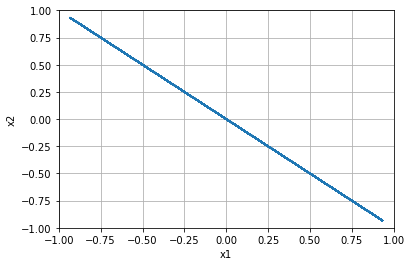


=================== Rollout 83 =====================
x_init [[-0.96]
 [ 0.28]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.96  0.28]
xx [-0.96  0.28]
xxx [-0.96  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.28]


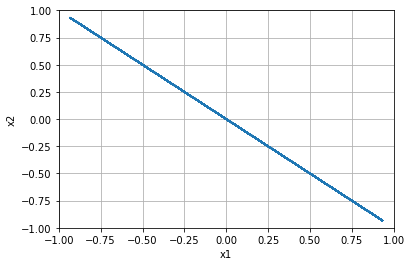


=================== Rollout 84 =====================
x_init [[-0.96]
 [ 0.32]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.96  0.32]
xx [-0.96  0.32]
xxx [-0.96  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.32000000000000006]


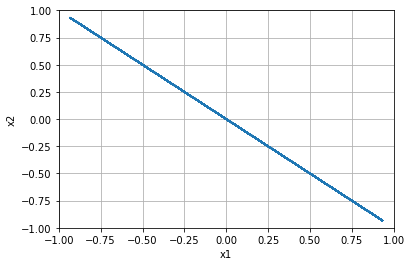


=================== Rollout 85 =====================
x_init [[-0.96]
 [ 0.36]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.96  0.36]
xx [-0.96  0.36]
xxx [-0.96  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.3600000000000001]


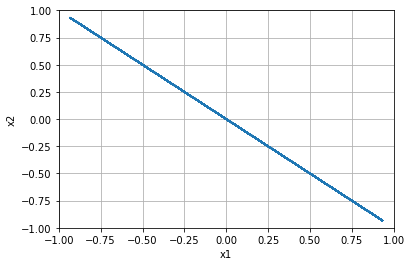


=================== Rollout 86 =====================
x_init [[-0.96]
 [ 0.4 ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.96  0.4 ]
xx [-0.96  0.4 ]
xxx [-0.96  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.40000000000000013]


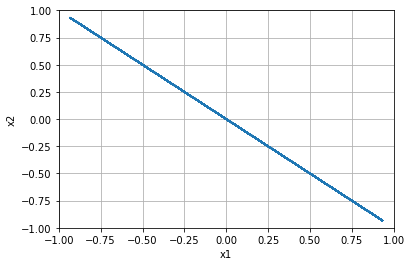


=================== Rollout 87 =====================
x_init [[-0.96]
 [ 0.44]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.96  0.44]
xx [-0.96  0.44]
xxx [-0.96  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.43999999999999995]


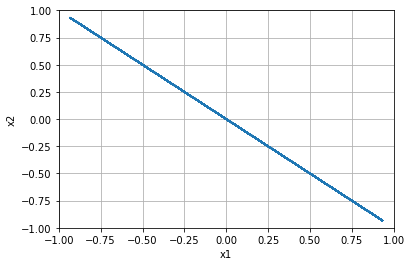


=================== Rollout 88 =====================
x_init [[-0.96]
 [ 0.48]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.96  0.48]
xx [-0.96  0.48]
xxx [-0.96  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.48]


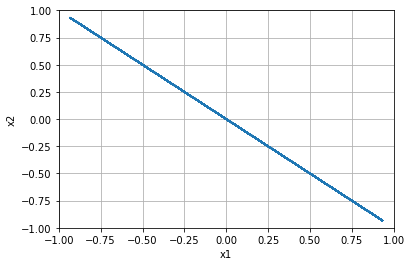


=================== Rollout 89 =====================
x_init [[-0.96]
 [ 0.52]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.96  0.52]
xx [-0.96  0.52]
xxx [-0.96  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.52]


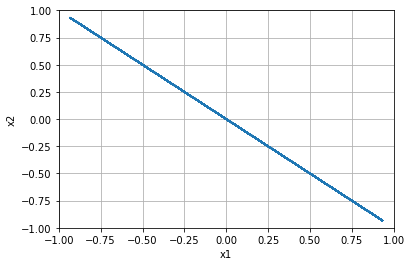


=================== Rollout 90 =====================
x_init [[-0.96]
 [ 0.56]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.96  0.56]
xx [-0.96  0.56]
xxx [-0.96  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.56]


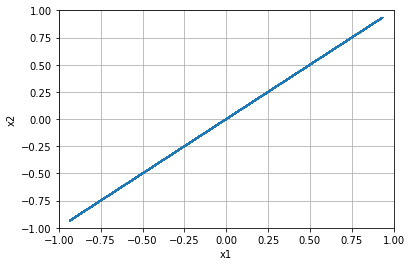


=================== Rollout 91 =====================
x_init [[-0.96]
 [ 0.6 ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.96  0.6 ]
xx [-0.96  0.6 ]
xxx [-0.96  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.6000000000000001]


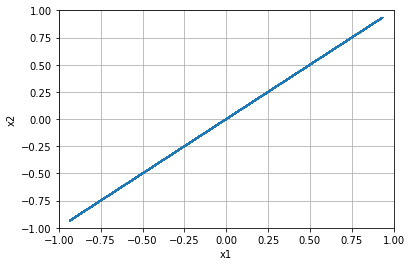


=================== Rollout 92 =====================
x_init [[-0.96]
 [ 0.64]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.96  0.64]
xx [-0.96  0.64]
xxx [-0.96  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.6400000000000001]


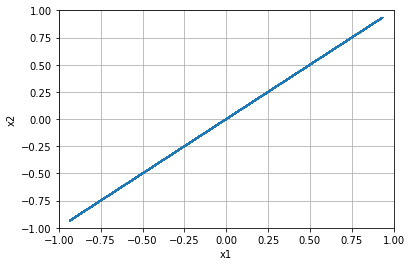


=================== Rollout 93 =====================
x_init [[-0.96]
 [ 0.68]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.96  0.68]
xx [-0.96  0.68]
xxx [-0.96  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.6799999999999999]


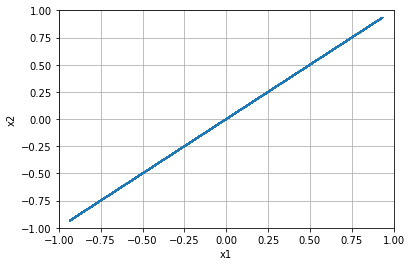


=================== Rollout 94 =====================
x_init [[-0.96]
 [ 0.72]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.96  0.72]
xx [-0.96  0.72]
xxx [-0.96  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.72]


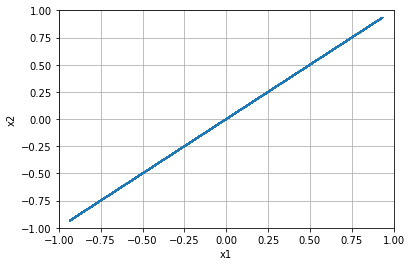


=================== Rollout 95 =====================
x_init [[-0.96]
 [ 0.76]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.96  0.76]
xx [-0.96  0.76]
xxx [-0.96  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.76]


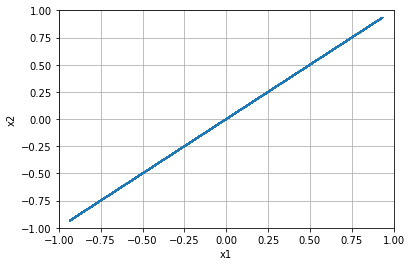


=================== Rollout 96 =====================
x_init [[-0.96]
 [ 0.8 ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.96  0.8 ]
xx [-0.96  0.8 ]
xxx [-0.96  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.8]


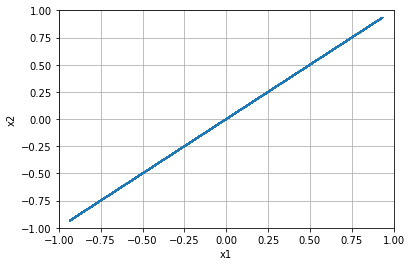


=================== Rollout 97 =====================
x_init [[-0.96]
 [ 0.84]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.96  0.84]
xx [-0.96  0.84]
xxx [-0.96  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.8400000000000001]


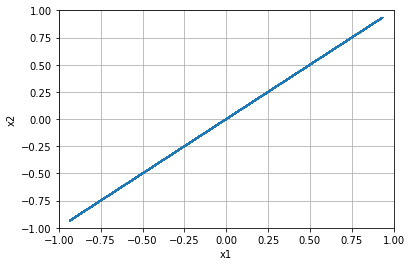


=================== Rollout 98 =====================
x_init [[-0.96]
 [ 0.88]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.96  0.88]
xx [-0.96  0.88]
xxx [-0.96  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.8800000000000001]


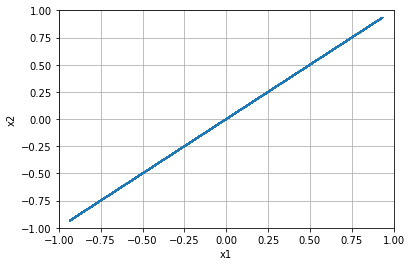


=================== Rollout 99 =====================
x_init [[-0.96]
 [ 0.92]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.96  0.92]
xx [-0.96  0.92]
xxx [-0.96  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.9199999999999999]


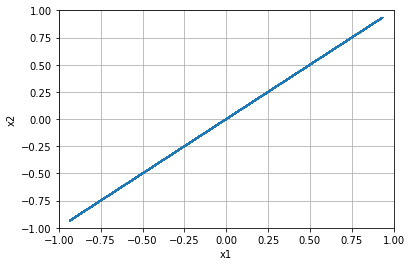


=================== Rollout 100 =====================
x_init [[-0.96]
 [ 0.96]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.96  0.96]
xx [-0.96  0.96]
xxx [-0.96  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 0.96]


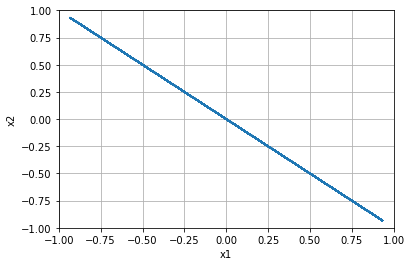


=================== Rollout 101 =====================
x_init [[-0.96]
 [ 1.  ]]
x_buffer [[-0.96 -0.96 -0.96 -0.96 -0.96]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.96  1.  ]
xx [-0.96  1.  ]
xxx [-0.96  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.96, 1.0]


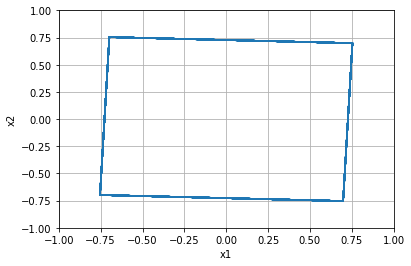


=================== Rollout 102 =====================
x_init [[-0.92]
 [-1.  ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.92 -1.  ]
xx [-0.92 -1.  ]
xxx [-0.92 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -1.0]


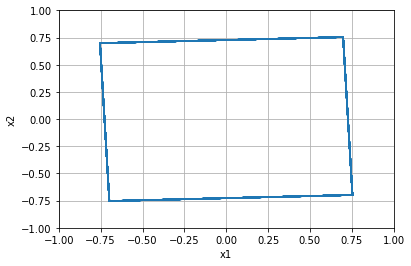


=================== Rollout 103 =====================
x_init [[-0.92]
 [-0.96]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.92 -0.96]
xx [-0.92 -0.96]
xxx [-0.92 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.96]


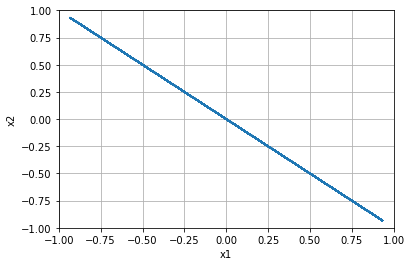


=================== Rollout 104 =====================
x_init [[-0.92]
 [-0.92]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.92 -0.92]
xx [-0.92 -0.92]
xxx [-0.92 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.92]


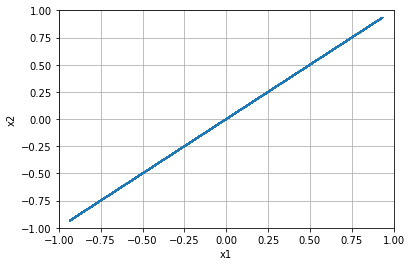


=================== Rollout 105 =====================
x_init [[-0.92]
 [-0.88]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.92 -0.88]
xx [-0.92 -0.88]
xxx [-0.92 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.88]


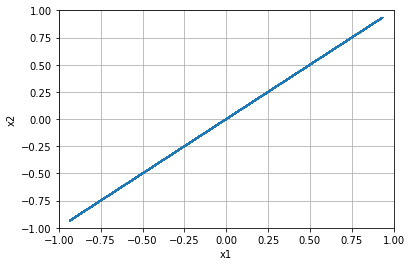


=================== Rollout 106 =====================
x_init [[-0.92]
 [-0.84]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.92 -0.84]
xx [-0.92 -0.84]
xxx [-0.92 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.84]


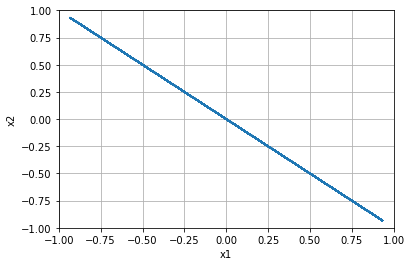


=================== Rollout 107 =====================
x_init [[-0.92]
 [-0.8 ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.92 -0.8 ]
xx [-0.92 -0.8 ]
xxx [-0.92 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.8]


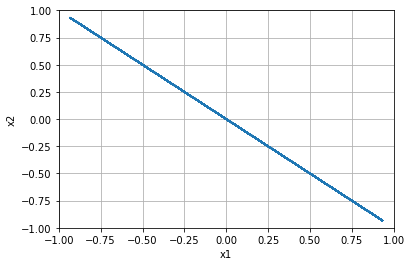


=================== Rollout 108 =====================
x_init [[-0.92]
 [-0.76]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.92 -0.76]
xx [-0.92 -0.76]
xxx [-0.92 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.76]


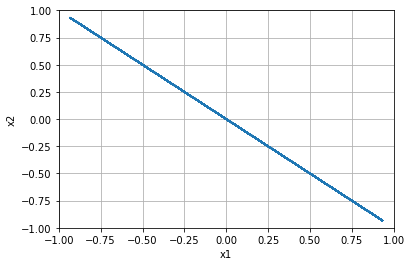


=================== Rollout 109 =====================
x_init [[-0.92]
 [-0.72]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.92 -0.72]
xx [-0.92 -0.72]
xxx [-0.92 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.72]


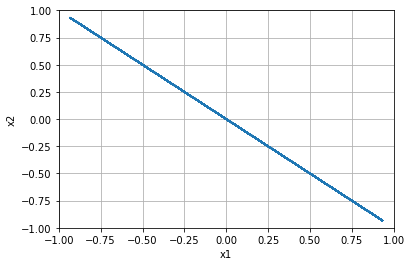


=================== Rollout 110 =====================
x_init [[-0.92]
 [-0.68]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.92 -0.68]
xx [-0.92 -0.68]
xxx [-0.92 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.6799999999999999]


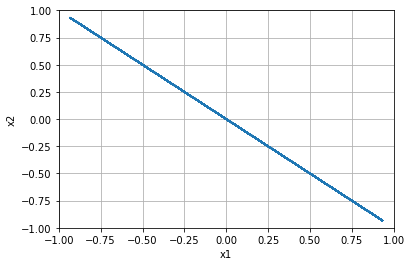


=================== Rollout 111 =====================
x_init [[-0.92]
 [-0.64]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.92 -0.64]
xx [-0.92 -0.64]
xxx [-0.92 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.64]


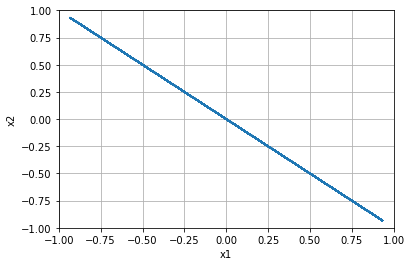


=================== Rollout 112 =====================
x_init [[-0.92]
 [-0.6 ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.92 -0.6 ]
xx [-0.92 -0.6 ]
xxx [-0.92 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.6]


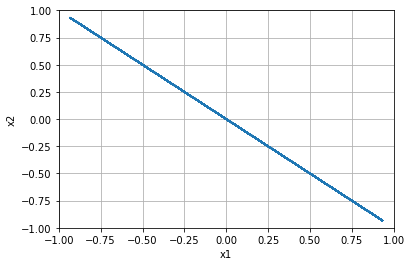


=================== Rollout 113 =====================
x_init [[-0.92]
 [-0.56]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.92 -0.56]
xx [-0.92 -0.56]
xxx [-0.92 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.56]


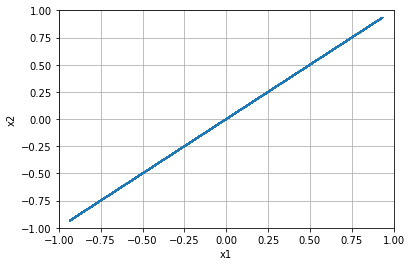


=================== Rollout 114 =====================
x_init [[-0.92]
 [-0.52]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.92 -0.52]
xx [-0.92 -0.52]
xxx [-0.92 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.52]


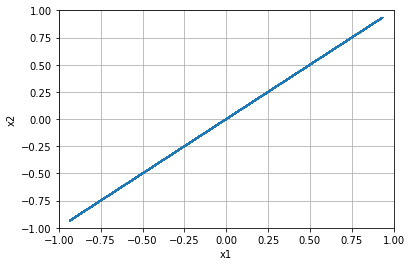


=================== Rollout 115 =====================
x_init [[-0.92]
 [-0.48]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.92 -0.48]
xx [-0.92 -0.48]
xxx [-0.92 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.48]


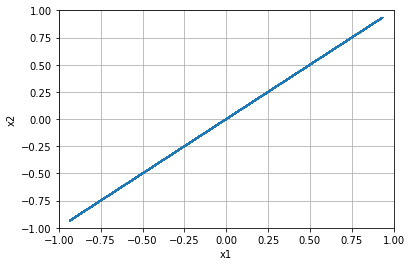


=================== Rollout 116 =====================
x_init [[-0.92]
 [-0.44]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.92 -0.44]
xx [-0.92 -0.44]
xxx [-0.92 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.43999999999999995]


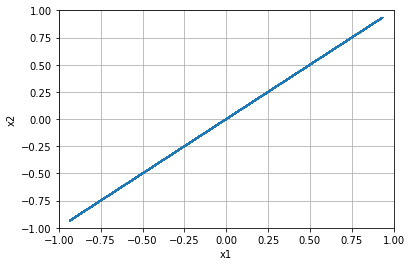


=================== Rollout 117 =====================
x_init [[-0.92]
 [-0.4 ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.92 -0.4 ]
xx [-0.92 -0.4 ]
xxx [-0.92 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.4]


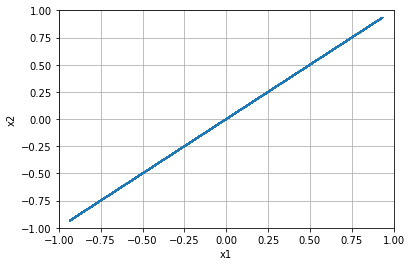


=================== Rollout 118 =====================
x_init [[-0.92]
 [-0.36]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.92 -0.36]
xx [-0.92 -0.36]
xxx [-0.92 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.36]


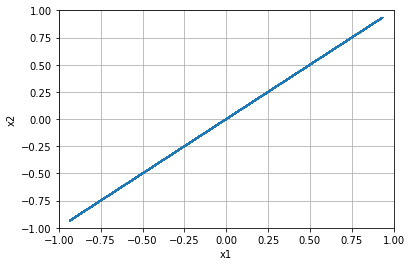


=================== Rollout 119 =====================
x_init [[-0.92]
 [-0.32]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.92 -0.32]
xx [-0.92 -0.32]
xxx [-0.92 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.31999999999999995]


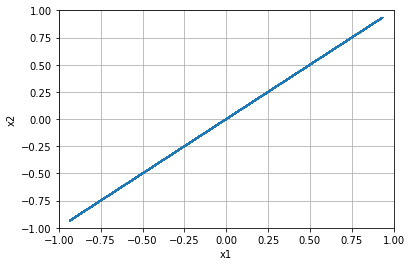


=================== Rollout 120 =====================
x_init [[-0.92]
 [-0.28]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.92 -0.28]
xx [-0.92 -0.28]
xxx [-0.92 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.28]


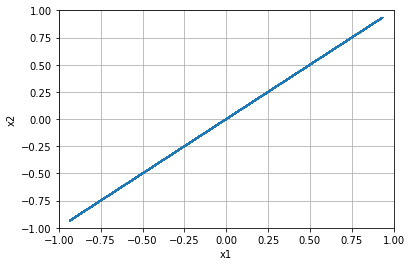


=================== Rollout 121 =====================
x_init [[-0.92]
 [-0.24]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.92 -0.24]
xx [-0.92 -0.24]
xxx [-0.92 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.24]


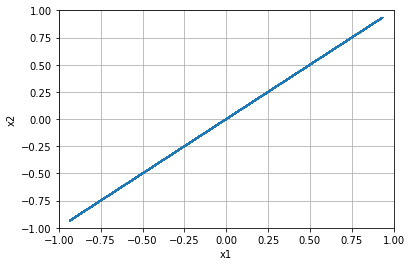


=================== Rollout 122 =====================
x_init [[-0.92]
 [-0.2 ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.92 -0.2 ]
xx [-0.92 -0.2 ]
xxx [-0.92 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.19999999999999996]


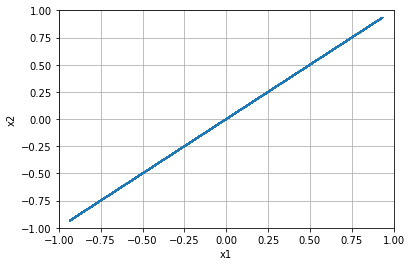


=================== Rollout 123 =====================
x_init [[-0.92]
 [-0.16]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.92 -0.16]
xx [-0.92 -0.16]
xxx [-0.92 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.16000000000000003]


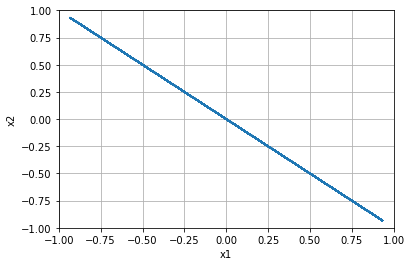


=================== Rollout 124 =====================
x_init [[-0.92]
 [-0.12]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.92 -0.12]
xx [-0.92 -0.12]
xxx [-0.92 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.12]


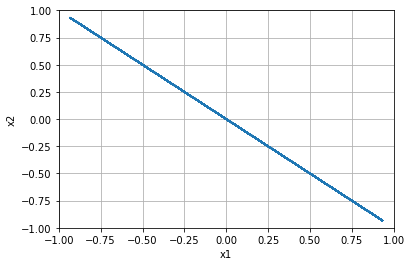


=================== Rollout 125 =====================
x_init [[-0.92]
 [-0.08]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.92 -0.08]
xx [-0.92 -0.08]
xxx [-0.92 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.07999999999999996]


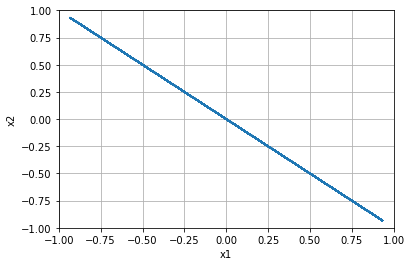


=================== Rollout 126 =====================
x_init [[-0.92]
 [-0.04]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.92 -0.04]
xx [-0.92 -0.04]
xxx [-0.92 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, -0.040000000000000036]


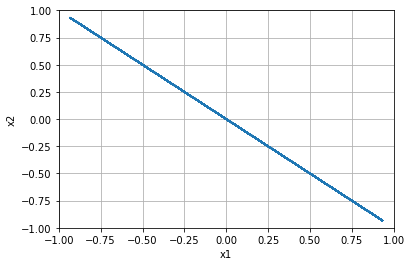


=================== Rollout 127 =====================
x_init [[-0.92]
 [ 0.  ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.92  0.  ]
xx [-0.92  0.  ]
xxx [-0.92  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.0]


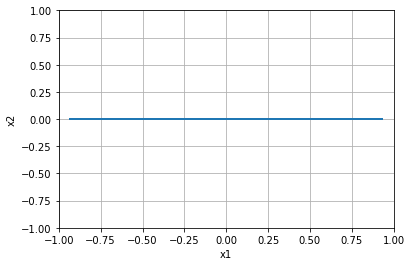


=================== Rollout 128 =====================
x_init [[-0.92]
 [ 0.04]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.92  0.04]
xx [-0.92  0.04]
xxx [-0.92  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.040000000000000036]


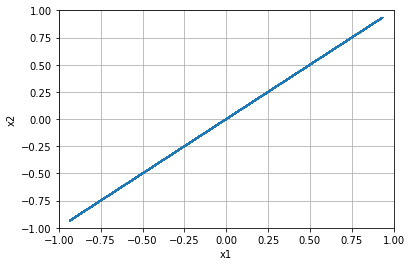


=================== Rollout 129 =====================
x_init [[-0.92]
 [ 0.08]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.92  0.08]
xx [-0.92  0.08]
xxx [-0.92  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.08000000000000007]


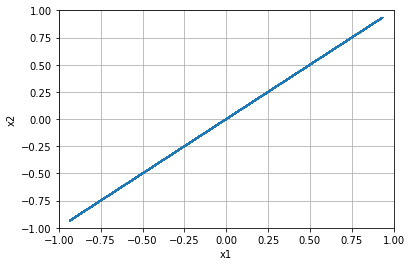


=================== Rollout 130 =====================
x_init [[-0.92]
 [ 0.12]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.92  0.12]
xx [-0.92  0.12]
xxx [-0.92  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.1200000000000001]


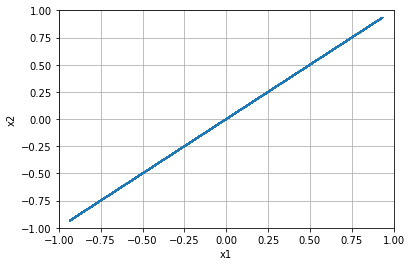


=================== Rollout 131 =====================
x_init [[-0.92]
 [ 0.16]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.92  0.16]
xx [-0.92  0.16]
xxx [-0.92  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.15999999999999992]


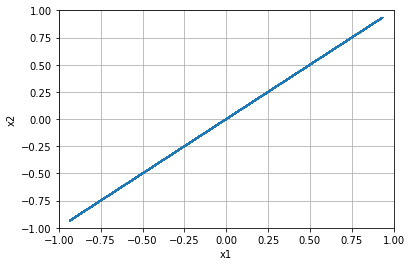


=================== Rollout 132 =====================
x_init [[-0.92]
 [ 0.2 ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.92  0.2 ]
xx [-0.92  0.2 ]
xxx [-0.92  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.19999999999999996]


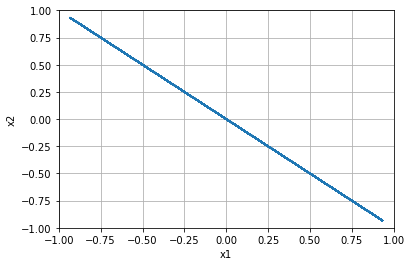


=================== Rollout 133 =====================
x_init [[-0.92]
 [ 0.24]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.92  0.24]
xx [-0.92  0.24]
xxx [-0.92  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.24]


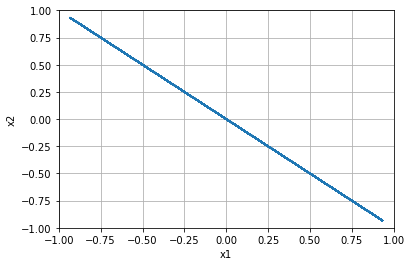


=================== Rollout 134 =====================
x_init [[-0.92]
 [ 0.28]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.92  0.28]
xx [-0.92  0.28]
xxx [-0.92  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.28]


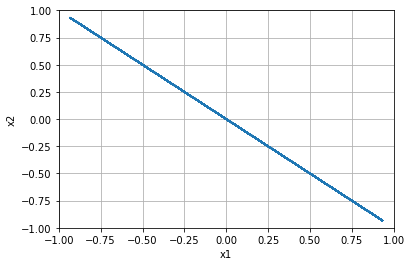


=================== Rollout 135 =====================
x_init [[-0.92]
 [ 0.32]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.92  0.32]
xx [-0.92  0.32]
xxx [-0.92  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.32000000000000006]


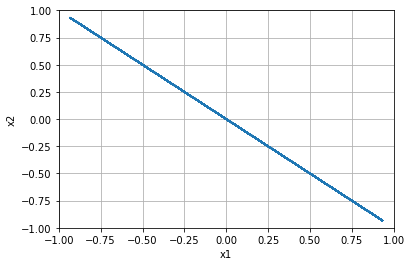


=================== Rollout 136 =====================
x_init [[-0.92]
 [ 0.36]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.92  0.36]
xx [-0.92  0.36]
xxx [-0.92  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.3600000000000001]


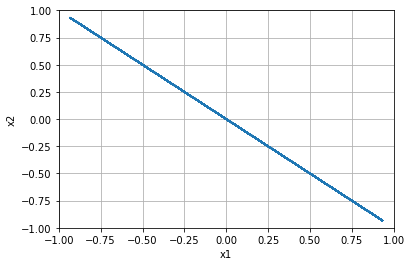


=================== Rollout 137 =====================
x_init [[-0.92]
 [ 0.4 ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.92  0.4 ]
xx [-0.92  0.4 ]
xxx [-0.92  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.40000000000000013]


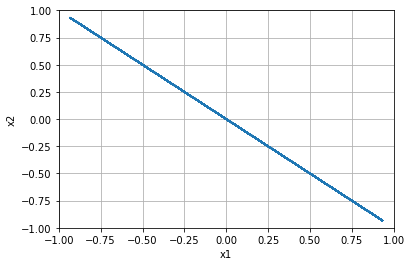


=================== Rollout 138 =====================
x_init [[-0.92]
 [ 0.44]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.92  0.44]
xx [-0.92  0.44]
xxx [-0.92  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.43999999999999995]


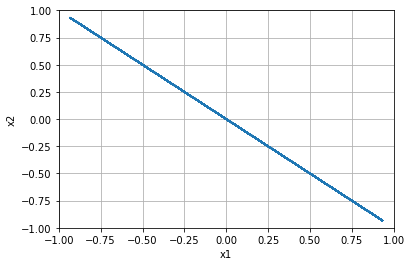


=================== Rollout 139 =====================
x_init [[-0.92]
 [ 0.48]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.92  0.48]
xx [-0.92  0.48]
xxx [-0.92  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.48]


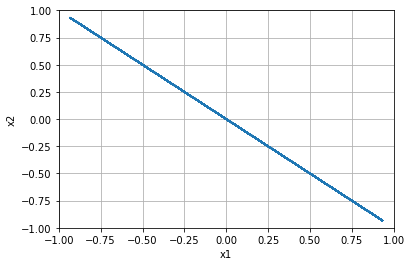


=================== Rollout 140 =====================
x_init [[-0.92]
 [ 0.52]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.92  0.52]
xx [-0.92  0.52]
xxx [-0.92  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.52]


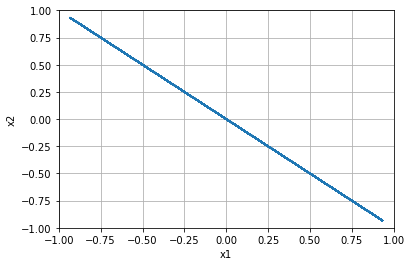


=================== Rollout 141 =====================
x_init [[-0.92]
 [ 0.56]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.92  0.56]
xx [-0.92  0.56]
xxx [-0.92  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.56]


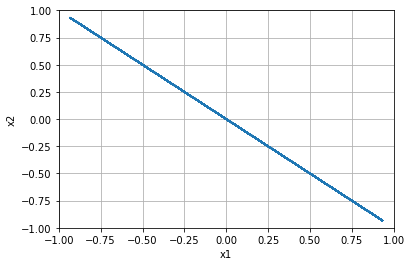


=================== Rollout 142 =====================
x_init [[-0.92]
 [ 0.6 ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.92  0.6 ]
xx [-0.92  0.6 ]
xxx [-0.92  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.6000000000000001]


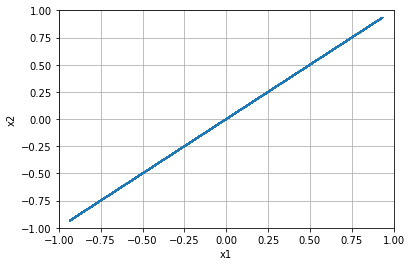


=================== Rollout 143 =====================
x_init [[-0.92]
 [ 0.64]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.92  0.64]
xx [-0.92  0.64]
xxx [-0.92  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.6400000000000001]


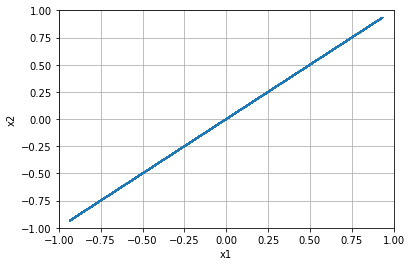


=================== Rollout 144 =====================
x_init [[-0.92]
 [ 0.68]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.92  0.68]
xx [-0.92  0.68]
xxx [-0.92  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.6799999999999999]


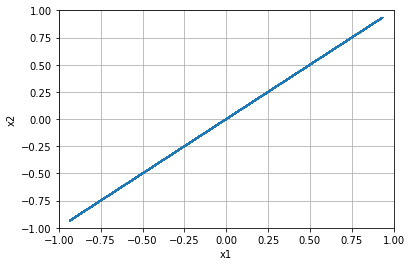


=================== Rollout 145 =====================
x_init [[-0.92]
 [ 0.72]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.92  0.72]
xx [-0.92  0.72]
xxx [-0.92  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.72]


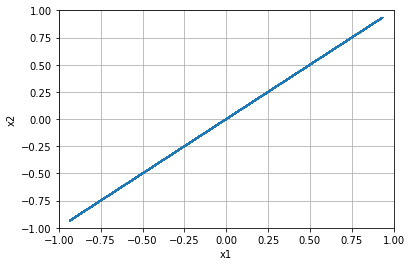


=================== Rollout 146 =====================
x_init [[-0.92]
 [ 0.76]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.92  0.76]
xx [-0.92  0.76]
xxx [-0.92  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.76]


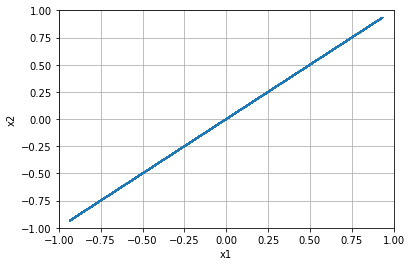


=================== Rollout 147 =====================
x_init [[-0.92]
 [ 0.8 ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.92  0.8 ]
xx [-0.92  0.8 ]
xxx [-0.92  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.8]


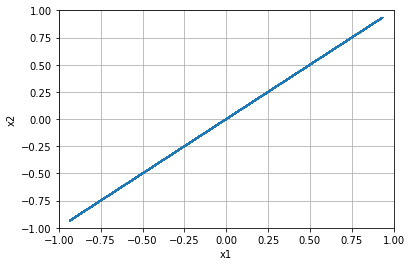


=================== Rollout 148 =====================
x_init [[-0.92]
 [ 0.84]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.92  0.84]
xx [-0.92  0.84]
xxx [-0.92  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.8400000000000001]


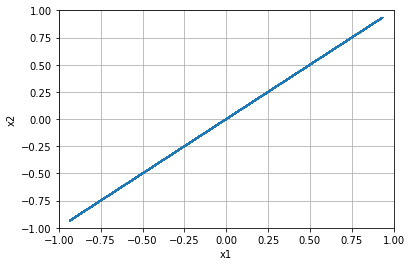


=================== Rollout 149 =====================
x_init [[-0.92]
 [ 0.88]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.92  0.88]
xx [-0.92  0.88]
xxx [-0.92  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.8800000000000001]


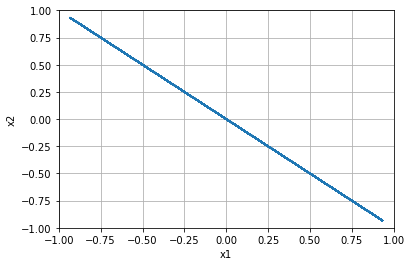


=================== Rollout 150 =====================
x_init [[-0.92]
 [ 0.92]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.92  0.92]
xx [-0.92  0.92]
xxx [-0.92  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.9199999999999999]


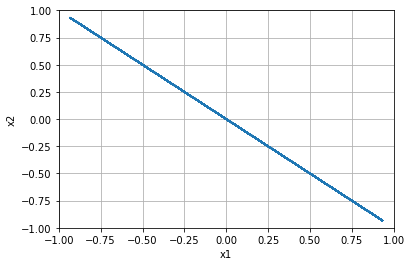


=================== Rollout 151 =====================
x_init [[-0.92]
 [ 0.96]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.92  0.96]
xx [-0.92  0.96]
xxx [-0.92  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 0.96]


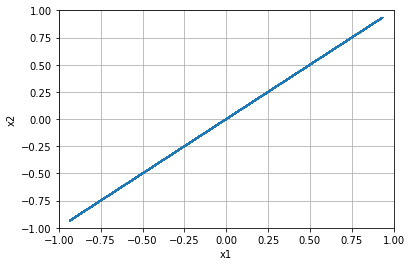


=================== Rollout 152 =====================
x_init [[-0.92]
 [ 1.  ]]
x_buffer [[-0.92 -0.92 -0.92 -0.92 -0.92]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.92  1.  ]
xx [-0.92  1.  ]
xxx [-0.92  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.92, 1.0]


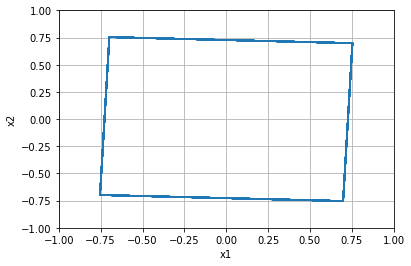


=================== Rollout 153 =====================
x_init [[-0.88]
 [-1.  ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.88 -1.  ]
xx [-0.88 -1.  ]
xxx [-0.88 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -1.0]


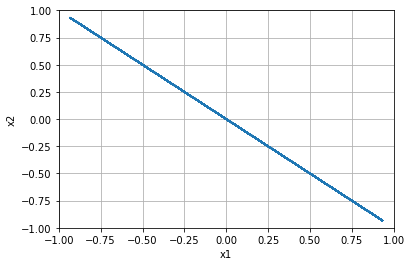


=================== Rollout 154 =====================
x_init [[-0.88]
 [-0.96]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.88 -0.96]
xx [-0.88 -0.96]
xxx [-0.88 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.96]


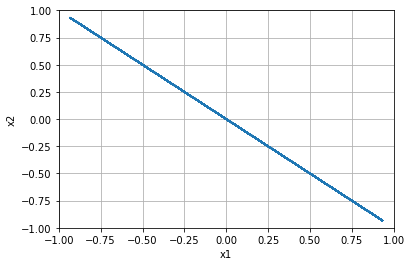


=================== Rollout 155 =====================
x_init [[-0.88]
 [-0.92]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.88 -0.92]
xx [-0.88 -0.92]
xxx [-0.88 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.92]


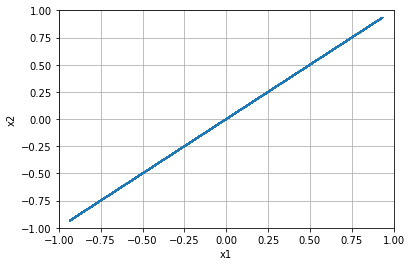


=================== Rollout 156 =====================
x_init [[-0.88]
 [-0.88]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.88 -0.88]
xx [-0.88 -0.88]
xxx [-0.88 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.88]


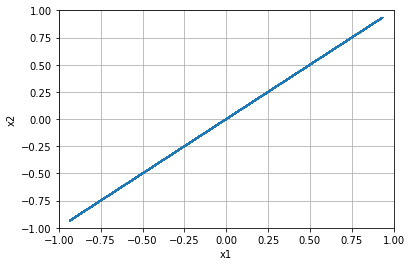


=================== Rollout 157 =====================
x_init [[-0.88]
 [-0.84]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.88 -0.84]
xx [-0.88 -0.84]
xxx [-0.88 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.84]


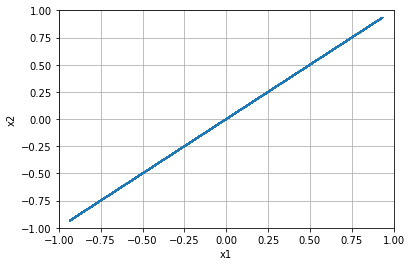


=================== Rollout 158 =====================
x_init [[-0.88]
 [-0.8 ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.88 -0.8 ]
xx [-0.88 -0.8 ]
xxx [-0.88 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.8]


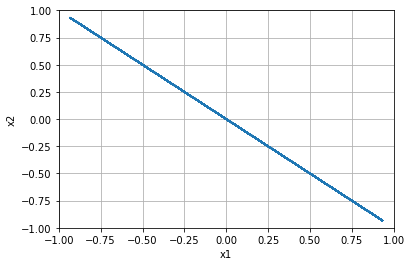


=================== Rollout 159 =====================
x_init [[-0.88]
 [-0.76]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.88 -0.76]
xx [-0.88 -0.76]
xxx [-0.88 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.76]


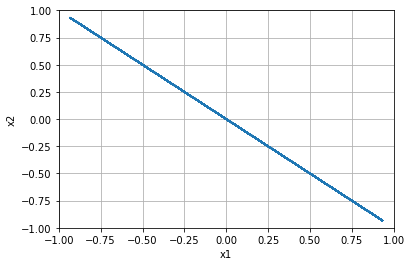


=================== Rollout 160 =====================
x_init [[-0.88]
 [-0.72]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.88 -0.72]
xx [-0.88 -0.72]
xxx [-0.88 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.72]


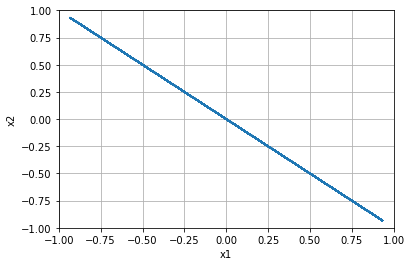


=================== Rollout 161 =====================
x_init [[-0.88]
 [-0.68]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.88 -0.68]
xx [-0.88 -0.68]
xxx [-0.88 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.6799999999999999]


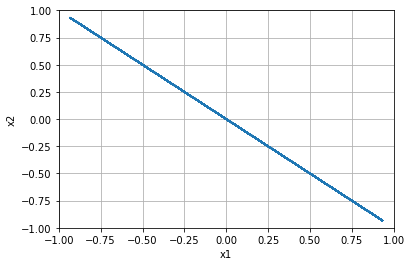


=================== Rollout 162 =====================
x_init [[-0.88]
 [-0.64]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.88 -0.64]
xx [-0.88 -0.64]
xxx [-0.88 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.64]


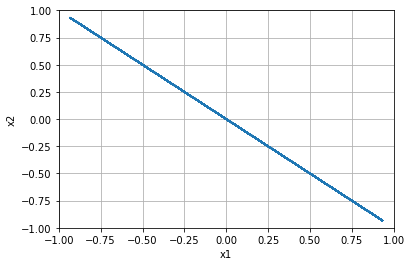


=================== Rollout 163 =====================
x_init [[-0.88]
 [-0.6 ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.88 -0.6 ]
xx [-0.88 -0.6 ]
xxx [-0.88 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.6]


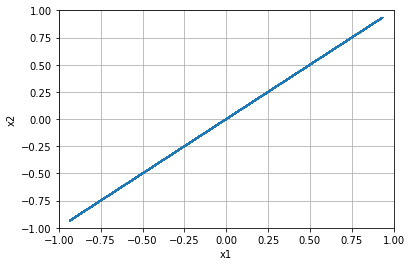


=================== Rollout 164 =====================
x_init [[-0.88]
 [-0.56]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.88 -0.56]
xx [-0.88 -0.56]
xxx [-0.88 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.56]


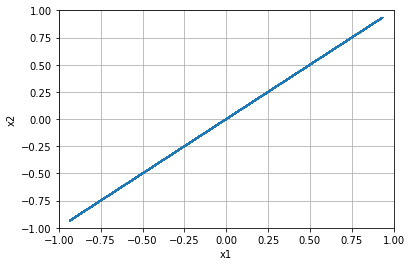


=================== Rollout 165 =====================
x_init [[-0.88]
 [-0.52]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.88 -0.52]
xx [-0.88 -0.52]
xxx [-0.88 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.52]


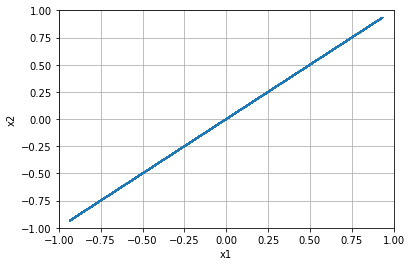


=================== Rollout 166 =====================
x_init [[-0.88]
 [-0.48]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.88 -0.48]
xx [-0.88 -0.48]
xxx [-0.88 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.48]


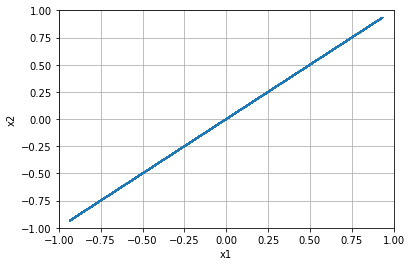


=================== Rollout 167 =====================
x_init [[-0.88]
 [-0.44]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.88 -0.44]
xx [-0.88 -0.44]
xxx [-0.88 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.43999999999999995]


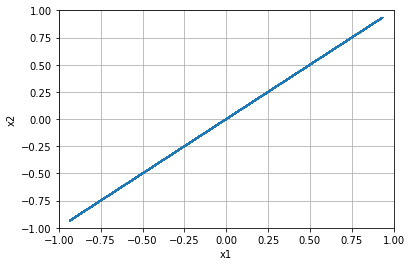


=================== Rollout 168 =====================
x_init [[-0.88]
 [-0.4 ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.88 -0.4 ]
xx [-0.88 -0.4 ]
xxx [-0.88 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.4]


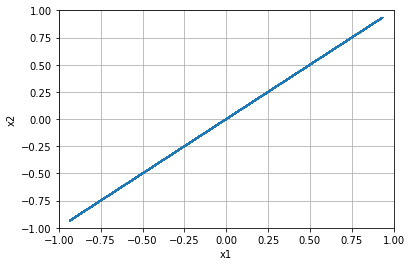


=================== Rollout 169 =====================
x_init [[-0.88]
 [-0.36]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.88 -0.36]
xx [-0.88 -0.36]
xxx [-0.88 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.36]


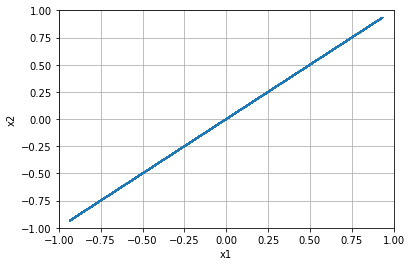


=================== Rollout 170 =====================
x_init [[-0.88]
 [-0.32]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.88 -0.32]
xx [-0.88 -0.32]
xxx [-0.88 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.31999999999999995]


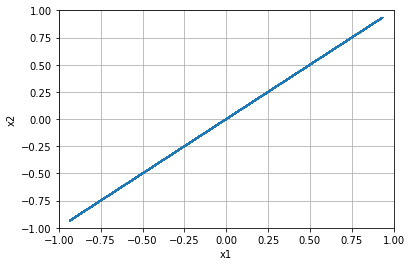


=================== Rollout 171 =====================
x_init [[-0.88]
 [-0.28]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.88 -0.28]
xx [-0.88 -0.28]
xxx [-0.88 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.28]


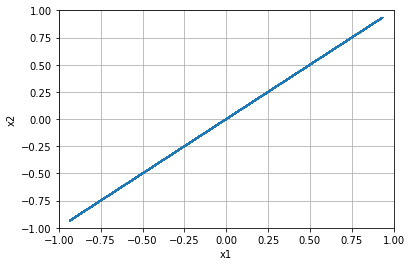


=================== Rollout 172 =====================
x_init [[-0.88]
 [-0.24]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.88 -0.24]
xx [-0.88 -0.24]
xxx [-0.88 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.24]


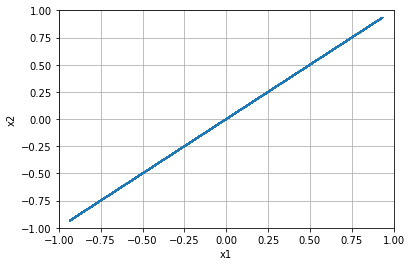


=================== Rollout 173 =====================
x_init [[-0.88]
 [-0.2 ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.88 -0.2 ]
xx [-0.88 -0.2 ]
xxx [-0.88 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.19999999999999996]


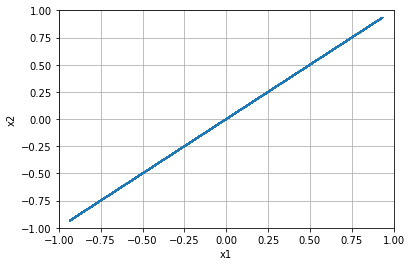


=================== Rollout 174 =====================
x_init [[-0.88]
 [-0.16]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.88 -0.16]
xx [-0.88 -0.16]
xxx [-0.88 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.16000000000000003]


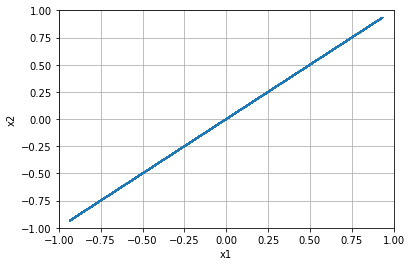


=================== Rollout 175 =====================
x_init [[-0.88]
 [-0.12]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.88 -0.12]
xx [-0.88 -0.12]
xxx [-0.88 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.12]


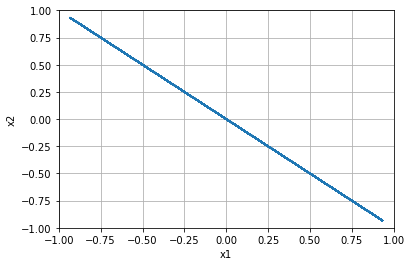


=================== Rollout 176 =====================
x_init [[-0.88]
 [-0.08]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.88 -0.08]
xx [-0.88 -0.08]
xxx [-0.88 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.07999999999999996]


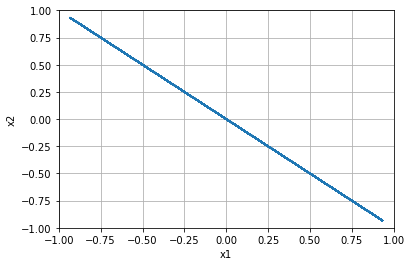


=================== Rollout 177 =====================
x_init [[-0.88]
 [-0.04]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.88 -0.04]
xx [-0.88 -0.04]
xxx [-0.88 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, -0.040000000000000036]


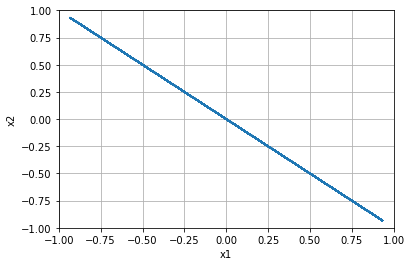


=================== Rollout 178 =====================
x_init [[-0.88]
 [ 0.  ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.88  0.  ]
xx [-0.88  0.  ]
xxx [-0.88  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.0]


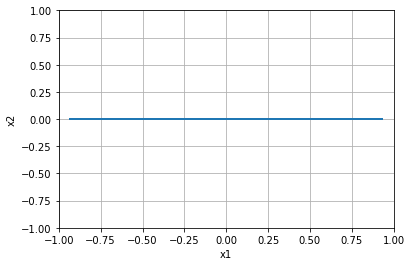


=================== Rollout 179 =====================
x_init [[-0.88]
 [ 0.04]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.88  0.04]
xx [-0.88  0.04]
xxx [-0.88  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.040000000000000036]


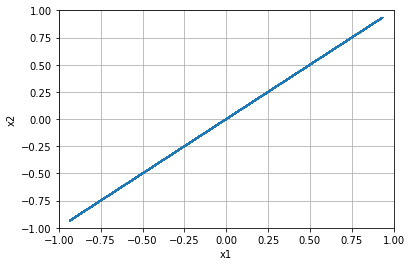


=================== Rollout 180 =====================
x_init [[-0.88]
 [ 0.08]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.88  0.08]
xx [-0.88  0.08]
xxx [-0.88  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.08000000000000007]


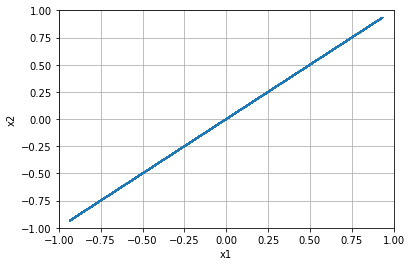


=================== Rollout 181 =====================
x_init [[-0.88]
 [ 0.12]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.88  0.12]
xx [-0.88  0.12]
xxx [-0.88  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.1200000000000001]


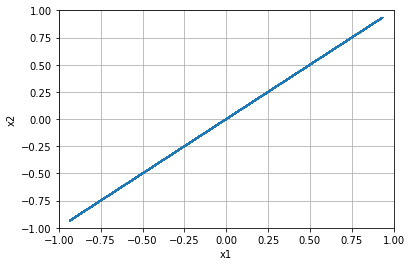


=================== Rollout 182 =====================
x_init [[-0.88]
 [ 0.16]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.88  0.16]
xx [-0.88  0.16]
xxx [-0.88  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.15999999999999992]


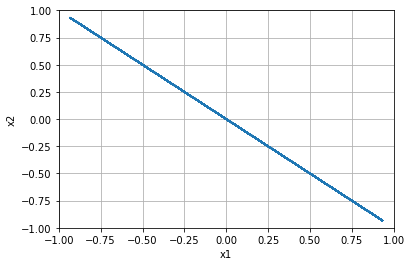


=================== Rollout 183 =====================
x_init [[-0.88]
 [ 0.2 ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.88  0.2 ]
xx [-0.88  0.2 ]
xxx [-0.88  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.19999999999999996]


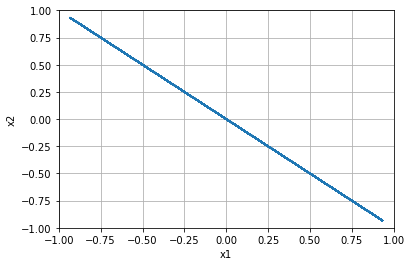


=================== Rollout 184 =====================
x_init [[-0.88]
 [ 0.24]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.88  0.24]
xx [-0.88  0.24]
xxx [-0.88  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.24]


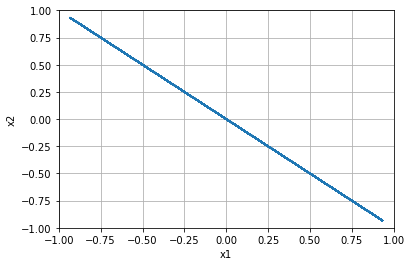


=================== Rollout 185 =====================
x_init [[-0.88]
 [ 0.28]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.88  0.28]
xx [-0.88  0.28]
xxx [-0.88  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.28]


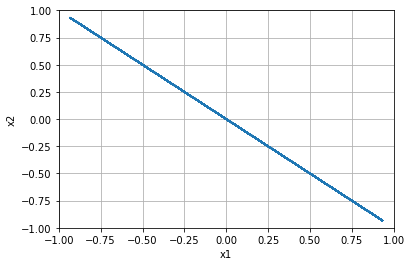


=================== Rollout 186 =====================
x_init [[-0.88]
 [ 0.32]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.88  0.32]
xx [-0.88  0.32]
xxx [-0.88  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.32000000000000006]


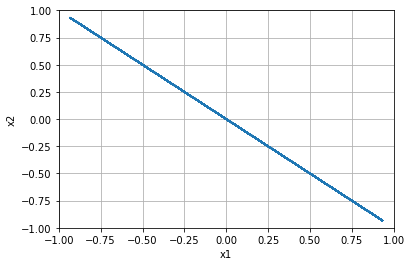


=================== Rollout 187 =====================
x_init [[-0.88]
 [ 0.36]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.88  0.36]
xx [-0.88  0.36]
xxx [-0.88  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.3600000000000001]


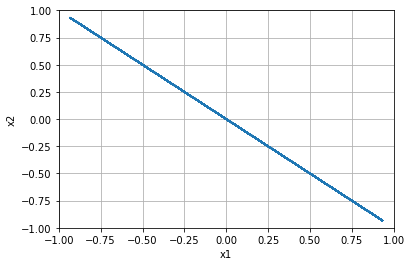


=================== Rollout 188 =====================
x_init [[-0.88]
 [ 0.4 ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.88  0.4 ]
xx [-0.88  0.4 ]
xxx [-0.88  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.40000000000000013]


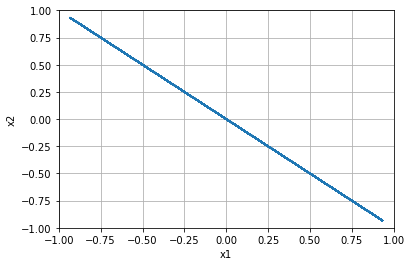


=================== Rollout 189 =====================
x_init [[-0.88]
 [ 0.44]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.88  0.44]
xx [-0.88  0.44]
xxx [-0.88  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.43999999999999995]


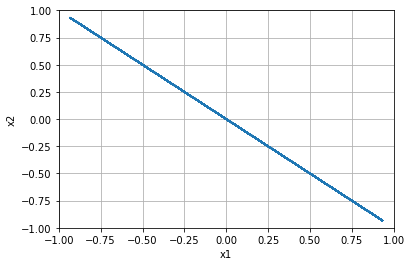


=================== Rollout 190 =====================
x_init [[-0.88]
 [ 0.48]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.88  0.48]
xx [-0.88  0.48]
xxx [-0.88  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.48]


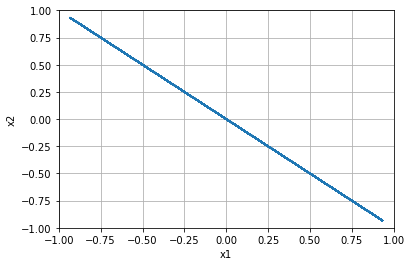


=================== Rollout 191 =====================
x_init [[-0.88]
 [ 0.52]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.88  0.52]
xx [-0.88  0.52]
xxx [-0.88  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.52]


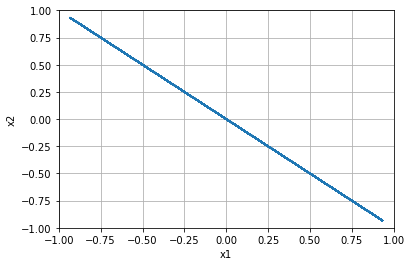


=================== Rollout 192 =====================
x_init [[-0.88]
 [ 0.56]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.88  0.56]
xx [-0.88  0.56]
xxx [-0.88  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.56]


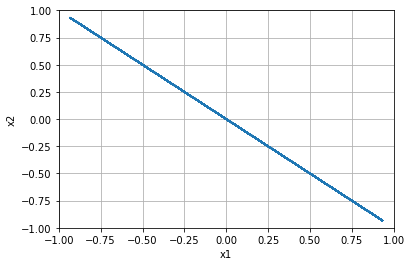


=================== Rollout 193 =====================
x_init [[-0.88]
 [ 0.6 ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.88  0.6 ]
xx [-0.88  0.6 ]
xxx [-0.88  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.6000000000000001]


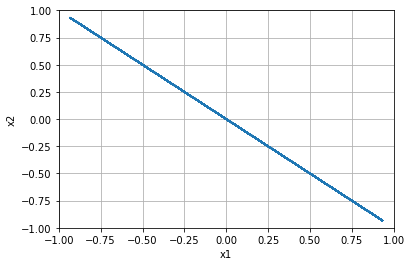


=================== Rollout 194 =====================
x_init [[-0.88]
 [ 0.64]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.88  0.64]
xx [-0.88  0.64]
xxx [-0.88  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.6400000000000001]


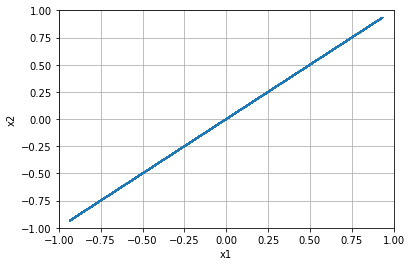


=================== Rollout 195 =====================
x_init [[-0.88]
 [ 0.68]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.88  0.68]
xx [-0.88  0.68]
xxx [-0.88  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.6799999999999999]


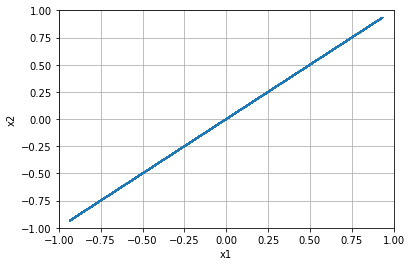


=================== Rollout 196 =====================
x_init [[-0.88]
 [ 0.72]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.88  0.72]
xx [-0.88  0.72]
xxx [-0.88  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.72]


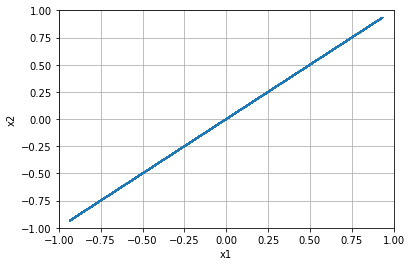


=================== Rollout 197 =====================
x_init [[-0.88]
 [ 0.76]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.88  0.76]
xx [-0.88  0.76]
xxx [-0.88  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.76]


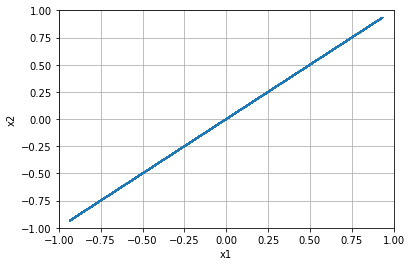


=================== Rollout 198 =====================
x_init [[-0.88]
 [ 0.8 ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.88  0.8 ]
xx [-0.88  0.8 ]
xxx [-0.88  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.8]


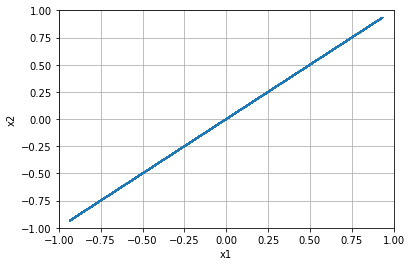


=================== Rollout 199 =====================
x_init [[-0.88]
 [ 0.84]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.88  0.84]
xx [-0.88  0.84]
xxx [-0.88  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.8400000000000001]


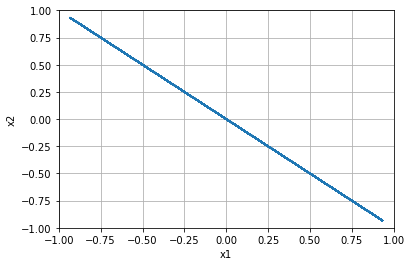


=================== Rollout 200 =====================
x_init [[-0.88]
 [ 0.88]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.88  0.88]
xx [-0.88  0.88]
xxx [-0.88  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.8800000000000001]


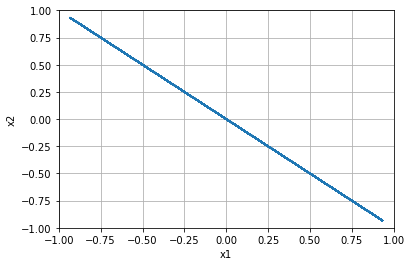


=================== Rollout 201 =====================
x_init [[-0.88]
 [ 0.92]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.88  0.92]
xx [-0.88  0.92]
xxx [-0.88  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.9199999999999999]


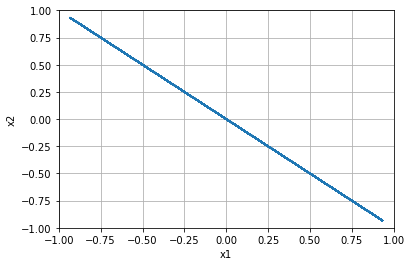


=================== Rollout 202 =====================
x_init [[-0.88]
 [ 0.96]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.88  0.96]
xx [-0.88  0.96]
xxx [-0.88  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 0.96]


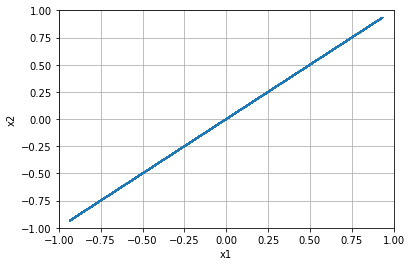


=================== Rollout 203 =====================
x_init [[-0.88]
 [ 1.  ]]
x_buffer [[-0.88 -0.88 -0.88 -0.88 -0.88]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.88  1.  ]
xx [-0.88  1.  ]
xxx [-0.88  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.88, 1.0]


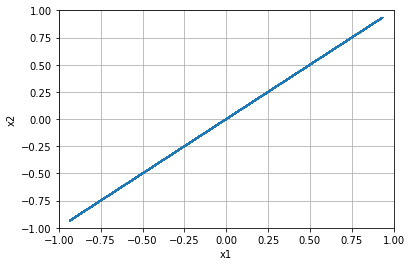


=================== Rollout 204 =====================
x_init [[-0.84]
 [-1.  ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.84 -1.  ]
xx [-0.84 -1.  ]
xxx [-0.84 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -1.0]


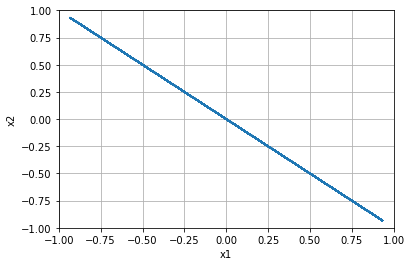


=================== Rollout 205 =====================
x_init [[-0.84]
 [-0.96]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.84 -0.96]
xx [-0.84 -0.96]
xxx [-0.84 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.96]


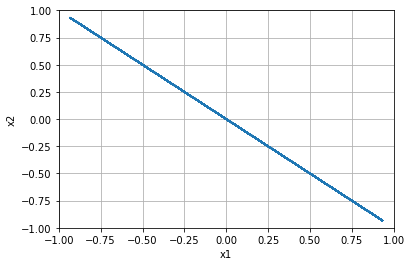


=================== Rollout 206 =====================
x_init [[-0.84]
 [-0.92]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.84 -0.92]
xx [-0.84 -0.92]
xxx [-0.84 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.92]


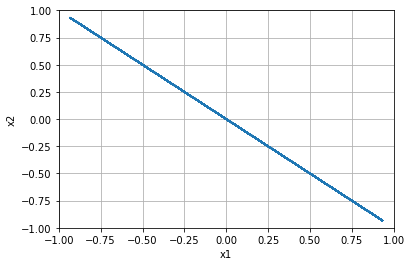


=================== Rollout 207 =====================
x_init [[-0.84]
 [-0.88]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.84 -0.88]
xx [-0.84 -0.88]
xxx [-0.84 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.88]


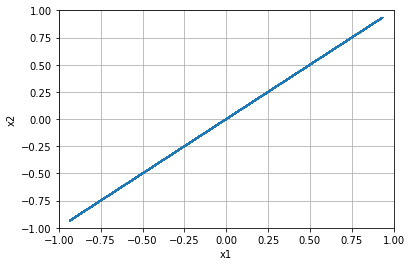


=================== Rollout 208 =====================
x_init [[-0.84]
 [-0.84]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.84 -0.84]
xx [-0.84 -0.84]
xxx [-0.84 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.84]


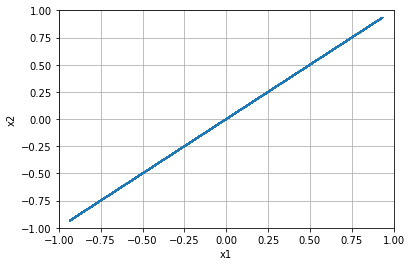


=================== Rollout 209 =====================
x_init [[-0.84]
 [-0.8 ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.84 -0.8 ]
xx [-0.84 -0.8 ]
xxx [-0.84 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.8]


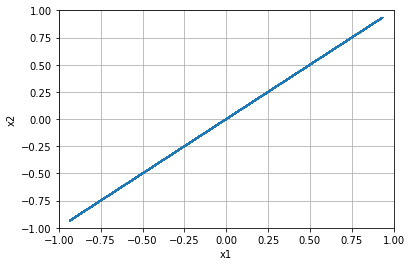


=================== Rollout 210 =====================
x_init [[-0.84]
 [-0.76]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.84 -0.76]
xx [-0.84 -0.76]
xxx [-0.84 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.76]


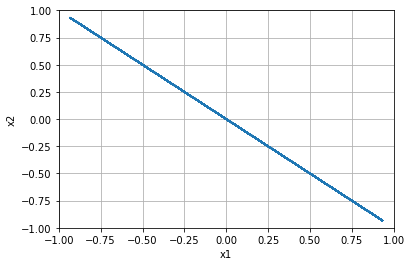


=================== Rollout 211 =====================
x_init [[-0.84]
 [-0.72]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.84 -0.72]
xx [-0.84 -0.72]
xxx [-0.84 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.72]


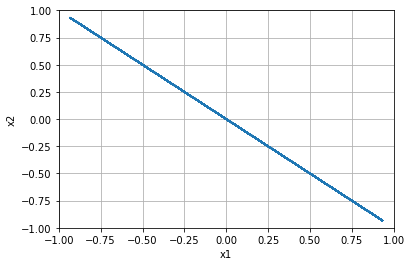


=================== Rollout 212 =====================
x_init [[-0.84]
 [-0.68]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.84 -0.68]
xx [-0.84 -0.68]
xxx [-0.84 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.6799999999999999]


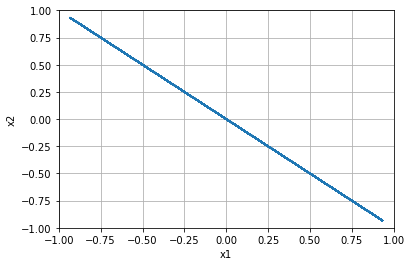


=================== Rollout 213 =====================
x_init [[-0.84]
 [-0.64]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.84 -0.64]
xx [-0.84 -0.64]
xxx [-0.84 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.64]


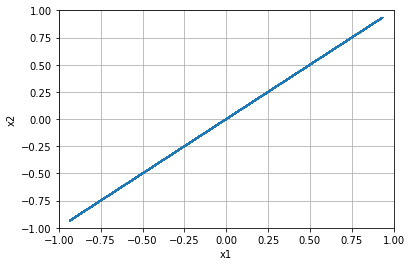


=================== Rollout 214 =====================
x_init [[-0.84]
 [-0.6 ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.84 -0.6 ]
xx [-0.84 -0.6 ]
xxx [-0.84 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.6]


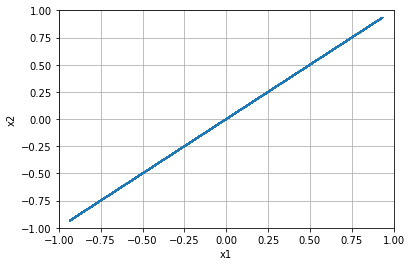


=================== Rollout 215 =====================
x_init [[-0.84]
 [-0.56]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.84 -0.56]
xx [-0.84 -0.56]
xxx [-0.84 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.56]


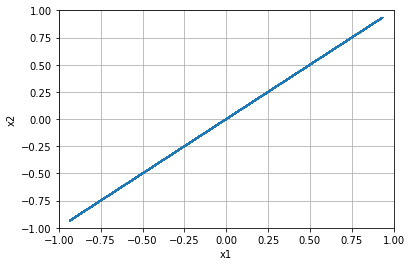


=================== Rollout 216 =====================
x_init [[-0.84]
 [-0.52]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.84 -0.52]
xx [-0.84 -0.52]
xxx [-0.84 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.52]


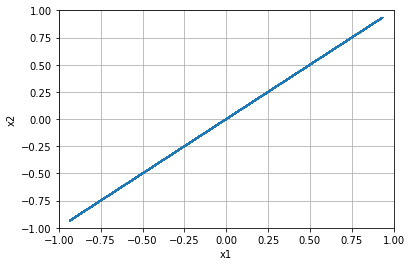


=================== Rollout 217 =====================
x_init [[-0.84]
 [-0.48]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.84 -0.48]
xx [-0.84 -0.48]
xxx [-0.84 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.48]


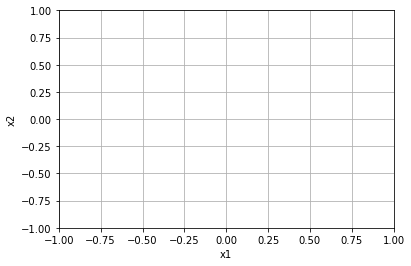


=================== Rollout 218 =====================
x_init [[-0.84]
 [-0.44]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.84 -0.44]
xx [-0.84 -0.44]
xxx [-0.84 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.43999999999999995]


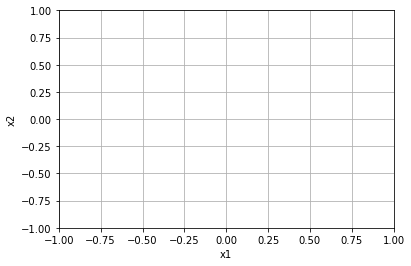


=================== Rollout 219 =====================
x_init [[-0.84]
 [-0.4 ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.84 -0.4 ]
xx [-0.84 -0.4 ]
xxx [-0.84 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.4]


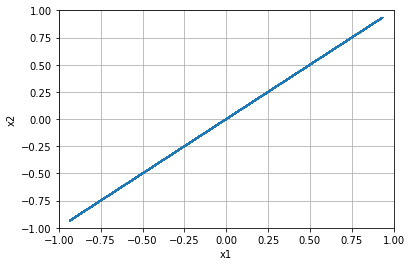


=================== Rollout 220 =====================
x_init [[-0.84]
 [-0.36]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.84 -0.36]
xx [-0.84 -0.36]
xxx [-0.84 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.36]


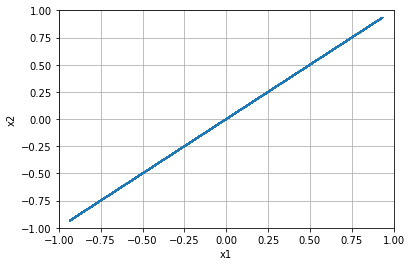


=================== Rollout 221 =====================
x_init [[-0.84]
 [-0.32]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.84 -0.32]
xx [-0.84 -0.32]
xxx [-0.84 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.31999999999999995]


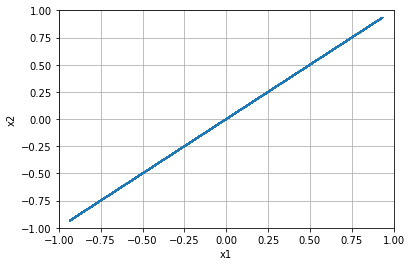


=================== Rollout 222 =====================
x_init [[-0.84]
 [-0.28]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.84 -0.28]
xx [-0.84 -0.28]
xxx [-0.84 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.28]


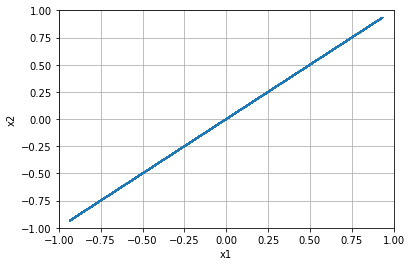


=================== Rollout 223 =====================
x_init [[-0.84]
 [-0.24]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.84 -0.24]
xx [-0.84 -0.24]
xxx [-0.84 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.24]


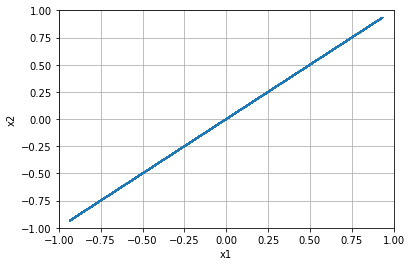


=================== Rollout 224 =====================
x_init [[-0.84]
 [-0.2 ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.84 -0.2 ]
xx [-0.84 -0.2 ]
xxx [-0.84 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.19999999999999996]


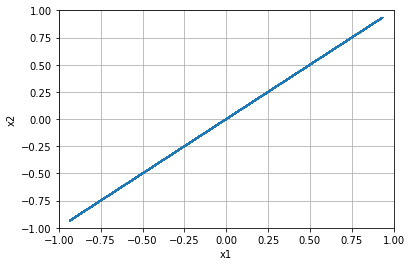


=================== Rollout 225 =====================
x_init [[-0.84]
 [-0.16]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.84 -0.16]
xx [-0.84 -0.16]
xxx [-0.84 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.16000000000000003]


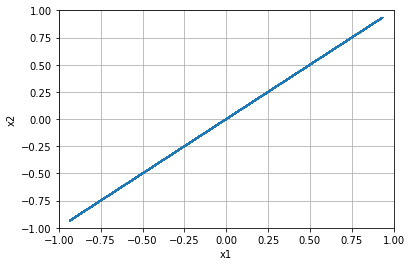


=================== Rollout 226 =====================
x_init [[-0.84]
 [-0.12]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.84 -0.12]
xx [-0.84 -0.12]
xxx [-0.84 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.12]


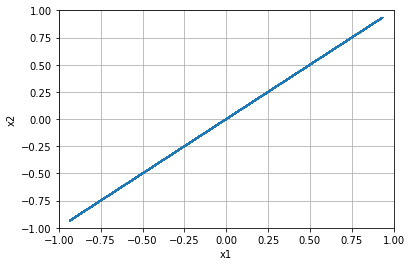


=================== Rollout 227 =====================
x_init [[-0.84]
 [-0.08]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.84 -0.08]
xx [-0.84 -0.08]
xxx [-0.84 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.07999999999999996]


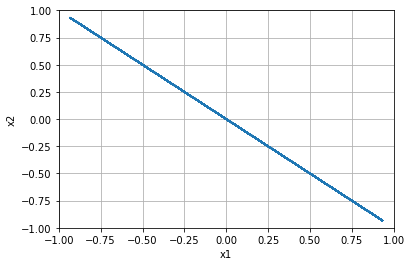


=================== Rollout 228 =====================
x_init [[-0.84]
 [-0.04]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.84 -0.04]
xx [-0.84 -0.04]
xxx [-0.84 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, -0.040000000000000036]


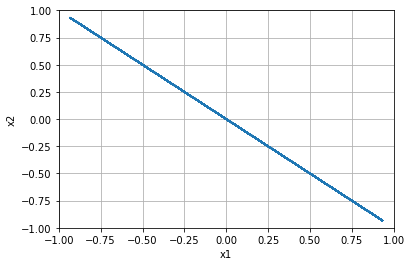


=================== Rollout 229 =====================
x_init [[-0.84]
 [ 0.  ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.84  0.  ]
xx [-0.84  0.  ]
xxx [-0.84  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.0]


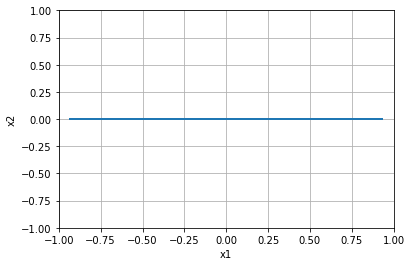


=================== Rollout 230 =====================
x_init [[-0.84]
 [ 0.04]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.84  0.04]
xx [-0.84  0.04]
xxx [-0.84  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.040000000000000036]


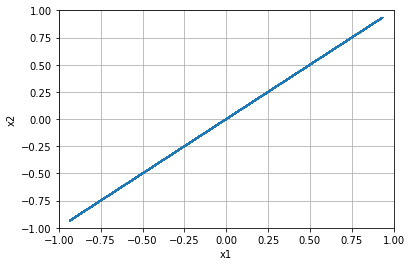


=================== Rollout 231 =====================
x_init [[-0.84]
 [ 0.08]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.84  0.08]
xx [-0.84  0.08]
xxx [-0.84  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.08000000000000007]


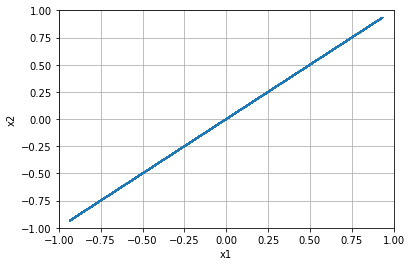


=================== Rollout 232 =====================
x_init [[-0.84]
 [ 0.12]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.84  0.12]
xx [-0.84  0.12]
xxx [-0.84  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.1200000000000001]


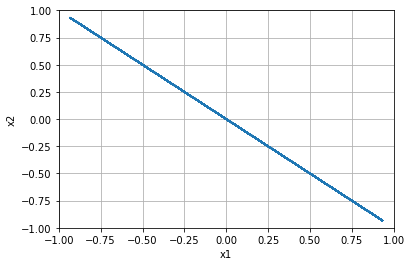


=================== Rollout 233 =====================
x_init [[-0.84]
 [ 0.16]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.84  0.16]
xx [-0.84  0.16]
xxx [-0.84  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.15999999999999992]


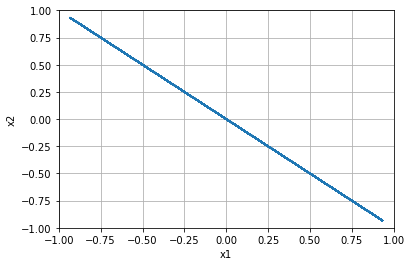


=================== Rollout 234 =====================
x_init [[-0.84]
 [ 0.2 ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.84  0.2 ]
xx [-0.84  0.2 ]
xxx [-0.84  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.19999999999999996]


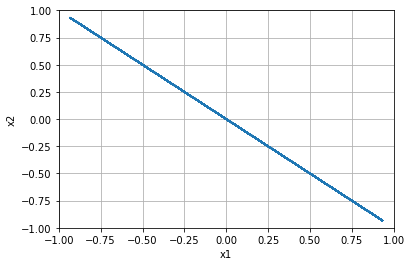


=================== Rollout 235 =====================
x_init [[-0.84]
 [ 0.24]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.84  0.24]
xx [-0.84  0.24]
xxx [-0.84  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.24]


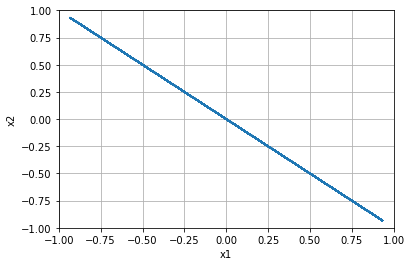


=================== Rollout 236 =====================
x_init [[-0.84]
 [ 0.28]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.84  0.28]
xx [-0.84  0.28]
xxx [-0.84  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.28]


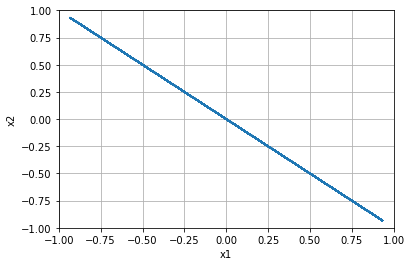


=================== Rollout 237 =====================
x_init [[-0.84]
 [ 0.32]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.84  0.32]
xx [-0.84  0.32]
xxx [-0.84  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.32000000000000006]


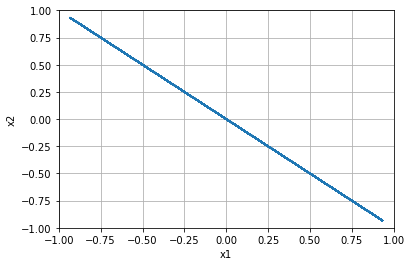


=================== Rollout 238 =====================
x_init [[-0.84]
 [ 0.36]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.84  0.36]
xx [-0.84  0.36]
xxx [-0.84  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.3600000000000001]


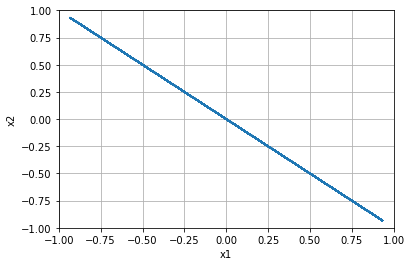


=================== Rollout 239 =====================
x_init [[-0.84]
 [ 0.4 ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.84  0.4 ]
xx [-0.84  0.4 ]
xxx [-0.84  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.40000000000000013]


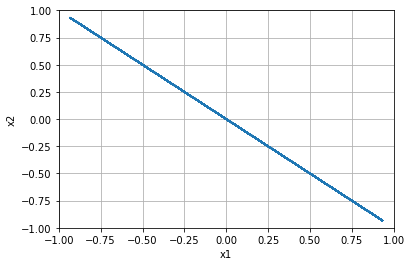


=================== Rollout 240 =====================
x_init [[-0.84]
 [ 0.44]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.84  0.44]
xx [-0.84  0.44]
xxx [-0.84  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.43999999999999995]


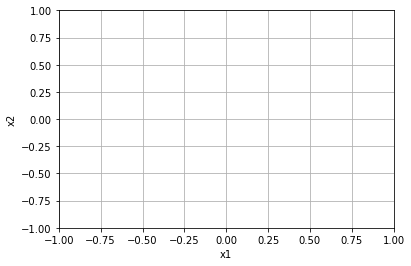


=================== Rollout 241 =====================
x_init [[-0.84]
 [ 0.48]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.84  0.48]
xx [-0.84  0.48]
xxx [-0.84  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.48]


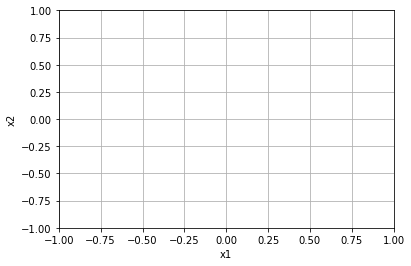


=================== Rollout 242 =====================
x_init [[-0.84]
 [ 0.52]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.84  0.52]
xx [-0.84  0.52]
xxx [-0.84  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.52]


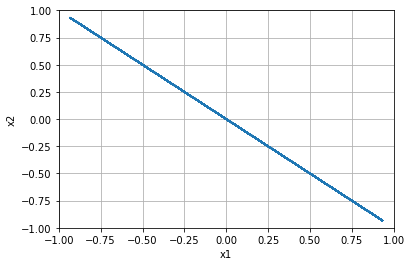


=================== Rollout 243 =====================
x_init [[-0.84]
 [ 0.56]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.84  0.56]
xx [-0.84  0.56]
xxx [-0.84  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.56]


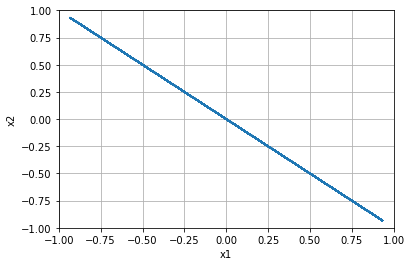


=================== Rollout 244 =====================
x_init [[-0.84]
 [ 0.6 ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.84  0.6 ]
xx [-0.84  0.6 ]
xxx [-0.84  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.6000000000000001]


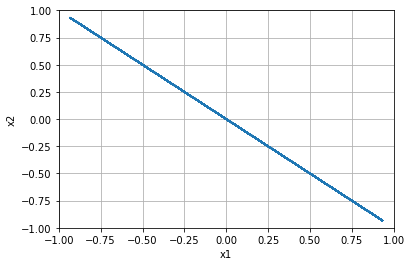


=================== Rollout 245 =====================
x_init [[-0.84]
 [ 0.64]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.84  0.64]
xx [-0.84  0.64]
xxx [-0.84  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.6400000000000001]


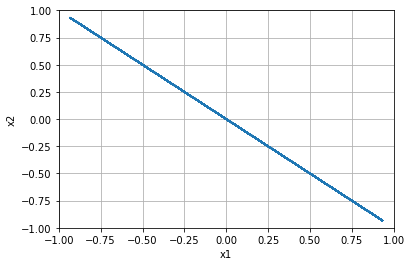


=================== Rollout 246 =====================
x_init [[-0.84]
 [ 0.68]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.84  0.68]
xx [-0.84  0.68]
xxx [-0.84  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.6799999999999999]


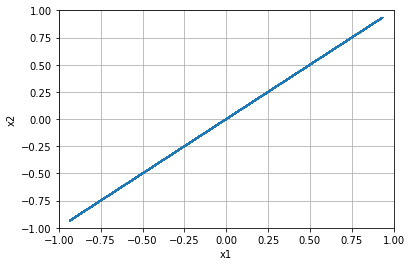


=================== Rollout 247 =====================
x_init [[-0.84]
 [ 0.72]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.84  0.72]
xx [-0.84  0.72]
xxx [-0.84  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.72]


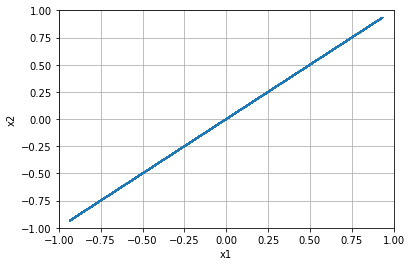


=================== Rollout 248 =====================
x_init [[-0.84]
 [ 0.76]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.84  0.76]
xx [-0.84  0.76]
xxx [-0.84  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.76]


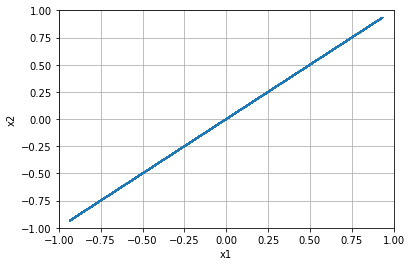


=================== Rollout 249 =====================
x_init [[-0.84]
 [ 0.8 ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.84  0.8 ]
xx [-0.84  0.8 ]
xxx [-0.84  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.8]


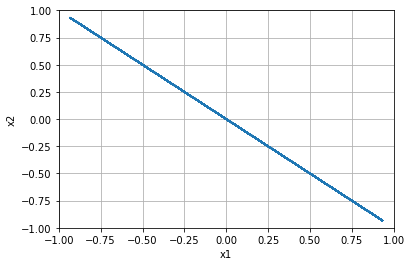


=================== Rollout 250 =====================
x_init [[-0.84]
 [ 0.84]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.84  0.84]
xx [-0.84  0.84]
xxx [-0.84  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.8400000000000001]


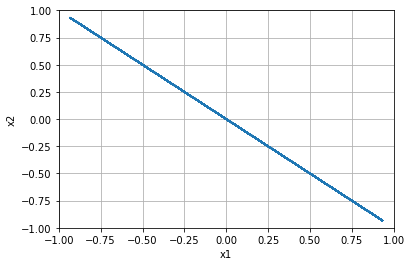


=================== Rollout 251 =====================
x_init [[-0.84]
 [ 0.88]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.84  0.88]
xx [-0.84  0.88]
xxx [-0.84  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.8800000000000001]


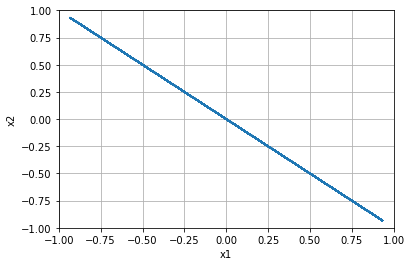


=================== Rollout 252 =====================
x_init [[-0.84]
 [ 0.92]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.84  0.92]
xx [-0.84  0.92]
xxx [-0.84  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.9199999999999999]


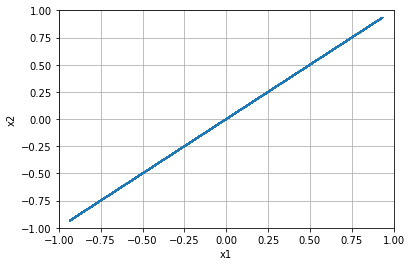


=================== Rollout 253 =====================
x_init [[-0.84]
 [ 0.96]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.84  0.96]
xx [-0.84  0.96]
xxx [-0.84  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 0.96]


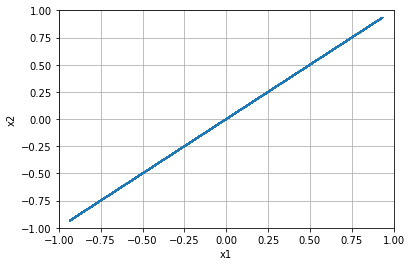


=================== Rollout 254 =====================
x_init [[-0.84]
 [ 1.  ]]
x_buffer [[-0.84 -0.84 -0.84 -0.84 -0.84]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.84  1.  ]
xx [-0.84  1.  ]
xxx [-0.84  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.84, 1.0]


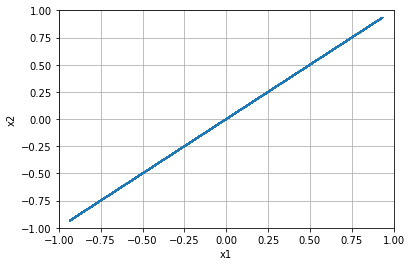


=================== Rollout 255 =====================
x_init [[-0.8]
 [-1. ]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [-1.  -1.  -1.  -1.  -1. ]]
x [-0.8 -1. ]
xx [-0.8 -1. ]
xxx [-0.8 -1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -1.0]


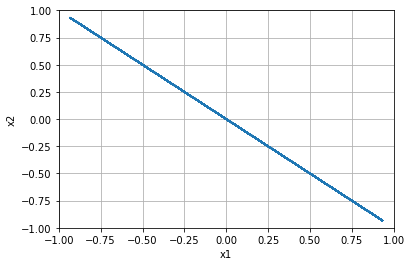


=================== Rollout 256 =====================
x_init [[-0.8 ]
 [-0.96]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.8  -0.96]
xx [-0.8  -0.96]
xxx [-0.8  -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.96]


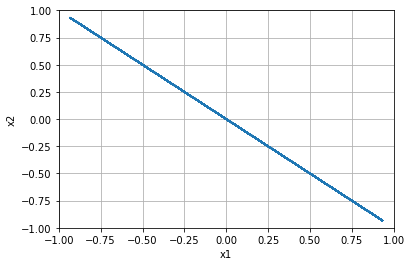


=================== Rollout 257 =====================
x_init [[-0.8 ]
 [-0.92]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.8  -0.92]
xx [-0.8  -0.92]
xxx [-0.8  -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.92]


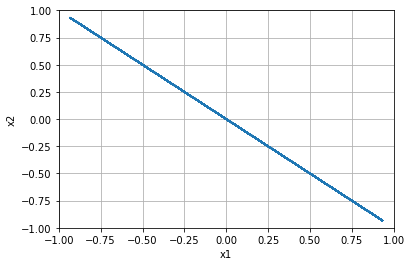


=================== Rollout 258 =====================
x_init [[-0.8 ]
 [-0.88]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.8  -0.88]
xx [-0.8  -0.88]
xxx [-0.8  -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.88]


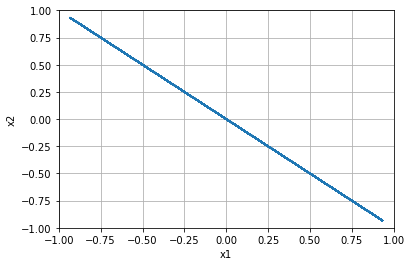


=================== Rollout 259 =====================
x_init [[-0.8 ]
 [-0.84]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.8  -0.84]
xx [-0.8  -0.84]
xxx [-0.8  -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.84]


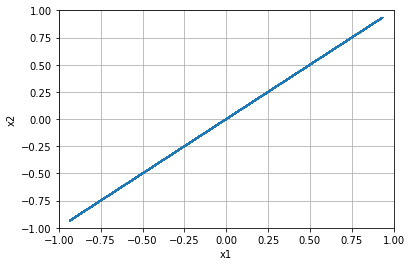


=================== Rollout 260 =====================
x_init [[-0.8]
 [-0.8]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [-0.8 -0.8]
xx [-0.8 -0.8]
xxx [-0.8 -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.8]


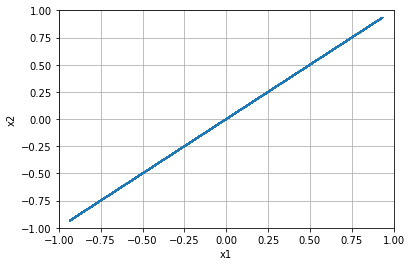


=================== Rollout 261 =====================
x_init [[-0.8 ]
 [-0.76]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.8  -0.76]
xx [-0.8  -0.76]
xxx [-0.8  -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.76]


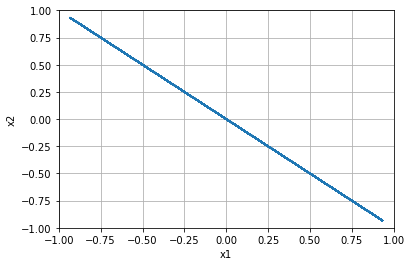


=================== Rollout 262 =====================
x_init [[-0.8 ]
 [-0.72]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.8  -0.72]
xx [-0.8  -0.72]
xxx [-0.8  -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.72]


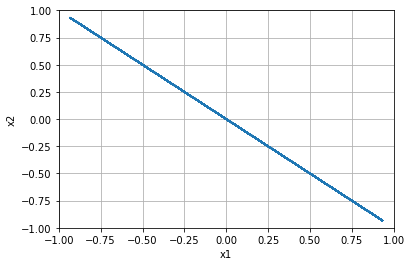


=================== Rollout 263 =====================
x_init [[-0.8 ]
 [-0.68]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.8  -0.68]
xx [-0.8  -0.68]
xxx [-0.8  -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.6799999999999999]


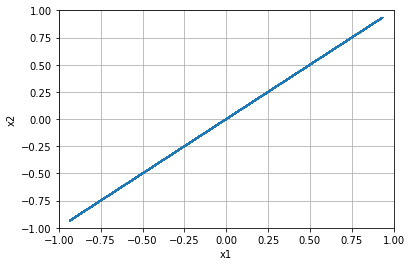


=================== Rollout 264 =====================
x_init [[-0.8 ]
 [-0.64]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.8  -0.64]
xx [-0.8  -0.64]
xxx [-0.8  -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.64]


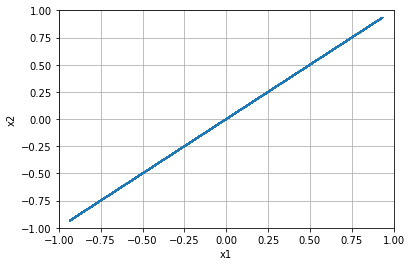


=================== Rollout 265 =====================
x_init [[-0.8]
 [-0.6]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [-0.8 -0.6]
xx [-0.8 -0.6]
xxx [-0.8 -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.6]


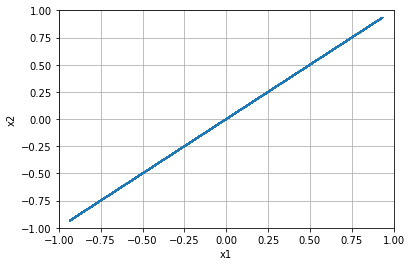


=================== Rollout 266 =====================
x_init [[-0.8 ]
 [-0.56]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.8  -0.56]
xx [-0.8  -0.56]
xxx [-0.8  -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.56]


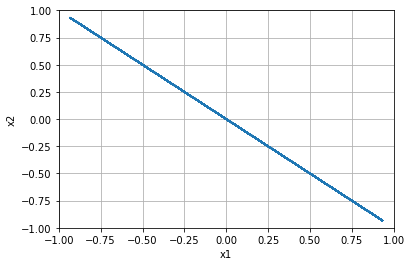


=================== Rollout 267 =====================
x_init [[-0.8 ]
 [-0.52]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.8  -0.52]
xx [-0.8  -0.52]
xxx [-0.8  -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.52]


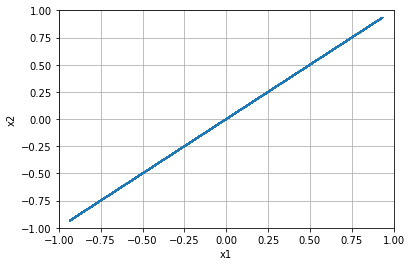


=================== Rollout 268 =====================
x_init [[-0.8 ]
 [-0.48]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.8  -0.48]
xx [-0.8  -0.48]
xxx [-0.8  -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.48]


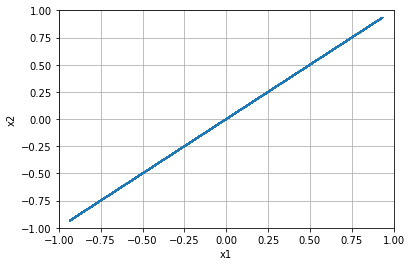


=================== Rollout 269 =====================
x_init [[-0.8 ]
 [-0.44]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.8  -0.44]
xx [-0.8  -0.44]
xxx [-0.8  -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.43999999999999995]


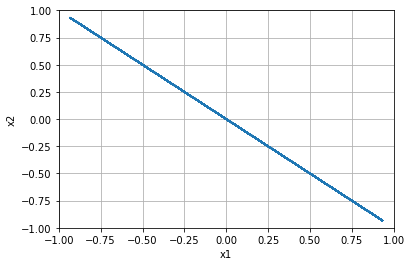


=================== Rollout 270 =====================
x_init [[-0.8]
 [-0.4]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [-0.8 -0.4]
xx [-0.8 -0.4]
xxx [-0.8 -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.4]


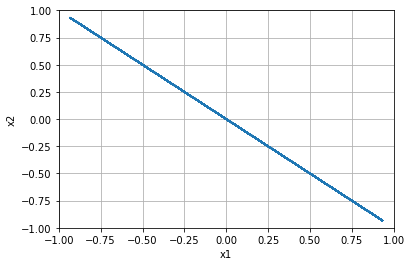


=================== Rollout 271 =====================
x_init [[-0.8 ]
 [-0.36]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.8  -0.36]
xx [-0.8  -0.36]
xxx [-0.8  -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.36]


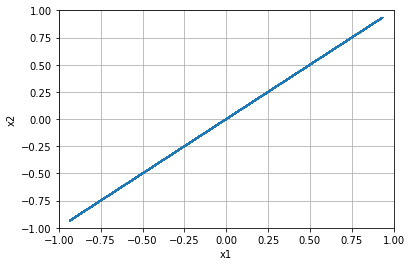


=================== Rollout 272 =====================
x_init [[-0.8 ]
 [-0.32]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.8  -0.32]
xx [-0.8  -0.32]
xxx [-0.8  -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.31999999999999995]


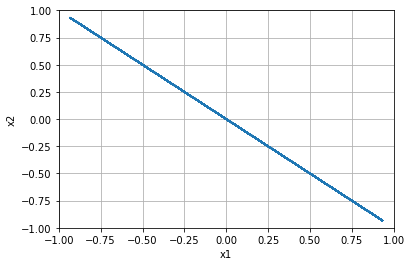


=================== Rollout 273 =====================
x_init [[-0.8 ]
 [-0.28]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.8  -0.28]
xx [-0.8  -0.28]
xxx [-0.8  -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.28]


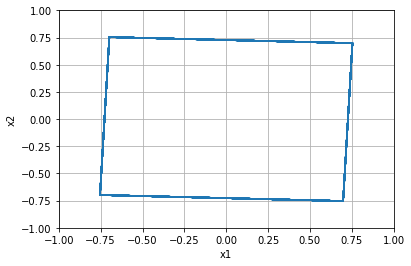


=================== Rollout 274 =====================
x_init [[-0.8 ]
 [-0.24]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.8  -0.24]
xx [-0.8  -0.24]
xxx [-0.8  -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.24]


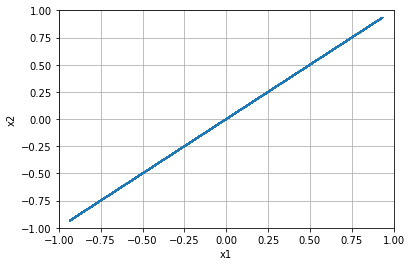


=================== Rollout 275 =====================
x_init [[-0.8]
 [-0.2]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [-0.8 -0.2]
xx [-0.8 -0.2]
xxx [-0.8 -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.19999999999999996]


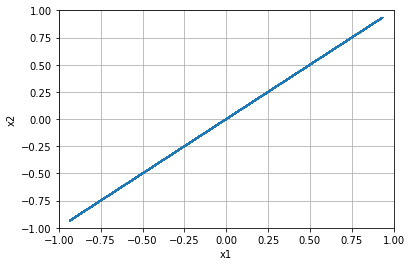


=================== Rollout 276 =====================
x_init [[-0.8 ]
 [-0.16]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.8  -0.16]
xx [-0.8  -0.16]
xxx [-0.8  -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.16000000000000003]


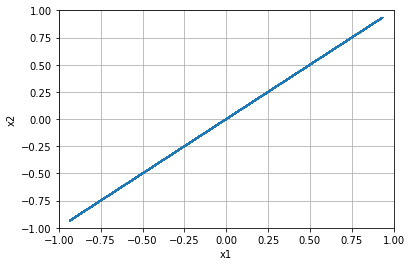


=================== Rollout 277 =====================
x_init [[-0.8 ]
 [-0.12]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.8  -0.12]
xx [-0.8  -0.12]
xxx [-0.8  -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.12]


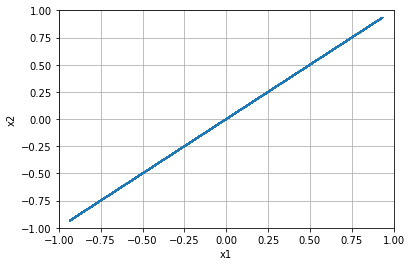


=================== Rollout 278 =====================
x_init [[-0.8 ]
 [-0.08]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.8  -0.08]
xx [-0.8  -0.08]
xxx [-0.8  -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.07999999999999996]


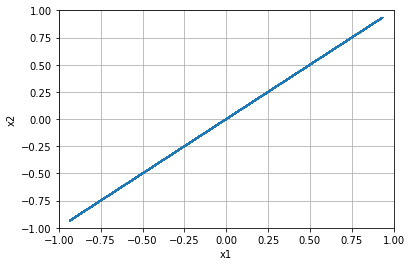


=================== Rollout 279 =====================
x_init [[-0.8 ]
 [-0.04]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.8  -0.04]
xx [-0.8  -0.04]
xxx [-0.8  -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, -0.040000000000000036]


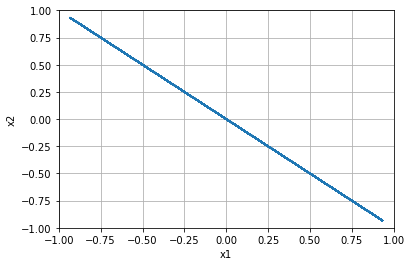


=================== Rollout 280 =====================
x_init [[-0.8]
 [ 0. ]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [ 0.   0.   0.   0.   0. ]]
x [-0.8  0. ]
xx [-0.8  0. ]
xxx [-0.8  0. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.0]


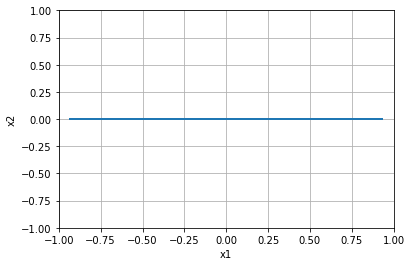


=================== Rollout 281 =====================
x_init [[-0.8 ]
 [ 0.04]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.8   0.04]
xx [-0.8   0.04]
xxx [-0.8   0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.040000000000000036]


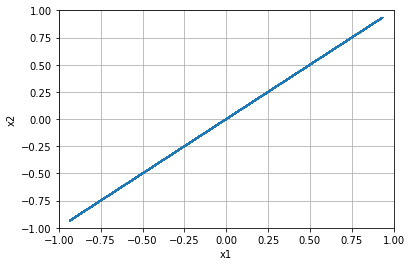


=================== Rollout 282 =====================
x_init [[-0.8 ]
 [ 0.08]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.8   0.08]
xx [-0.8   0.08]
xxx [-0.8   0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.08000000000000007]


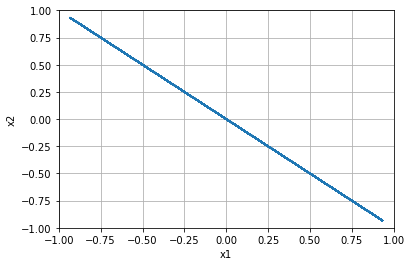


=================== Rollout 283 =====================
x_init [[-0.8 ]
 [ 0.12]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.8   0.12]
xx [-0.8   0.12]
xxx [-0.8   0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.1200000000000001]


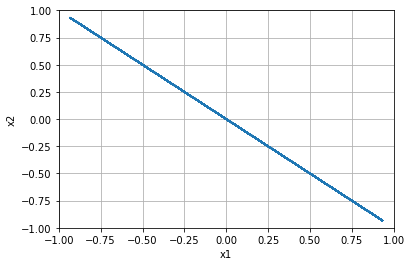


=================== Rollout 284 =====================
x_init [[-0.8 ]
 [ 0.16]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.8   0.16]
xx [-0.8   0.16]
xxx [-0.8   0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.15999999999999992]


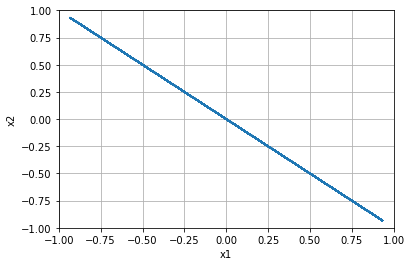


=================== Rollout 285 =====================
x_init [[-0.8]
 [ 0.2]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [ 0.2  0.2  0.2  0.2  0.2]]
x [-0.8  0.2]
xx [-0.8  0.2]
xxx [-0.8  0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.19999999999999996]


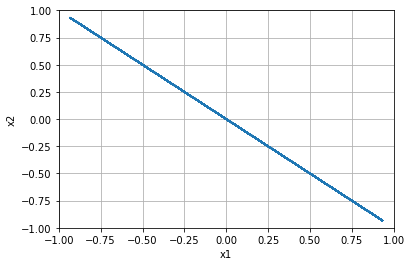


=================== Rollout 286 =====================
x_init [[-0.8 ]
 [ 0.24]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.8   0.24]
xx [-0.8   0.24]
xxx [-0.8   0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.24]


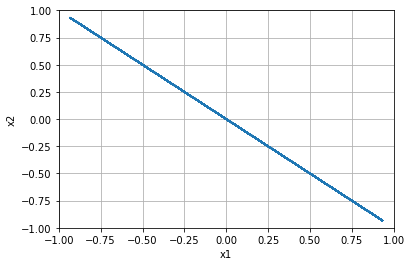


=================== Rollout 287 =====================
x_init [[-0.8 ]
 [ 0.28]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.8   0.28]
xx [-0.8   0.28]
xxx [-0.8   0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.28]


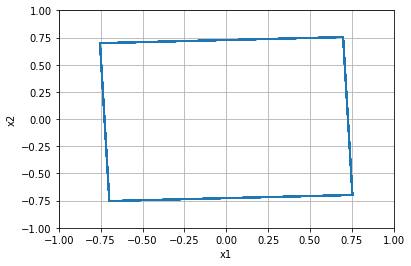


=================== Rollout 288 =====================
x_init [[-0.8 ]
 [ 0.32]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.8   0.32]
xx [-0.8   0.32]
xxx [-0.8   0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.32000000000000006]


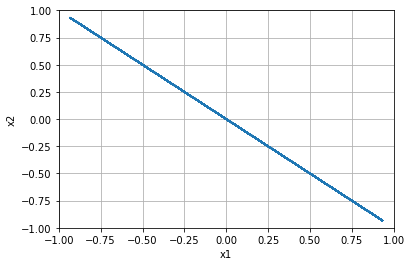


=================== Rollout 289 =====================
x_init [[-0.8 ]
 [ 0.36]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.8   0.36]
xx [-0.8   0.36]
xxx [-0.8   0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.3600000000000001]


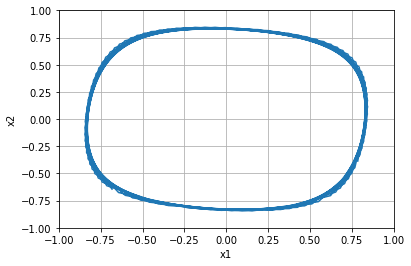


=================== Rollout 290 =====================
x_init [[-0.8]
 [ 0.4]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [ 0.4  0.4  0.4  0.4  0.4]]
x [-0.8  0.4]
xx [-0.8  0.4]
xxx [-0.8  0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.40000000000000013]


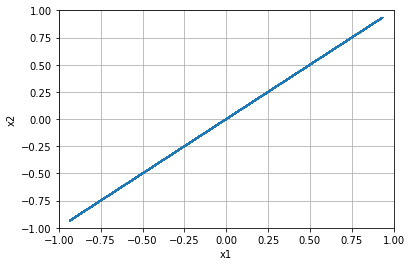


=================== Rollout 291 =====================
x_init [[-0.8 ]
 [ 0.44]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.8   0.44]
xx [-0.8   0.44]
xxx [-0.8   0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.43999999999999995]


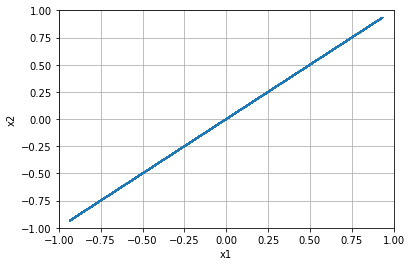


=================== Rollout 292 =====================
x_init [[-0.8 ]
 [ 0.48]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.8   0.48]
xx [-0.8   0.48]
xxx [-0.8   0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.48]


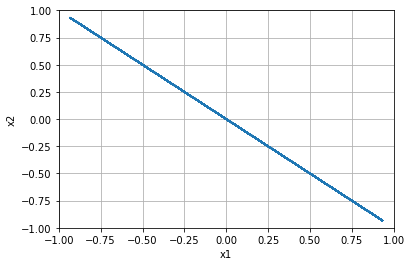


=================== Rollout 293 =====================
x_init [[-0.8 ]
 [ 0.52]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.8   0.52]
xx [-0.8   0.52]
xxx [-0.8   0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.52]


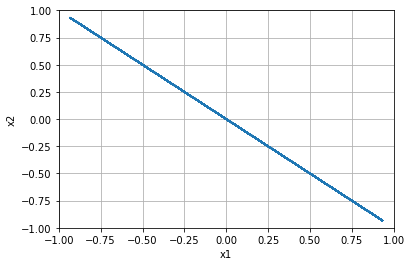


=================== Rollout 294 =====================
x_init [[-0.8 ]
 [ 0.56]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.8   0.56]
xx [-0.8   0.56]
xxx [-0.8   0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.56]


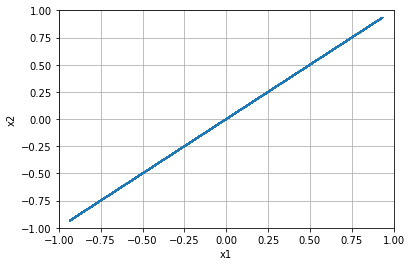


=================== Rollout 295 =====================
x_init [[-0.8]
 [ 0.6]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [ 0.6  0.6  0.6  0.6  0.6]]
x [-0.8  0.6]
xx [-0.8  0.6]
xxx [-0.8  0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.6000000000000001]


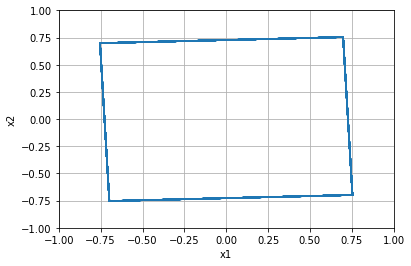


=================== Rollout 296 =====================
x_init [[-0.8 ]
 [ 0.64]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.8   0.64]
xx [-0.8   0.64]
xxx [-0.8   0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.6400000000000001]


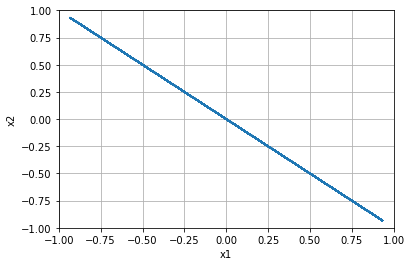


=================== Rollout 297 =====================
x_init [[-0.8 ]
 [ 0.68]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.8   0.68]
xx [-0.8   0.68]
xxx [-0.8   0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.6799999999999999]


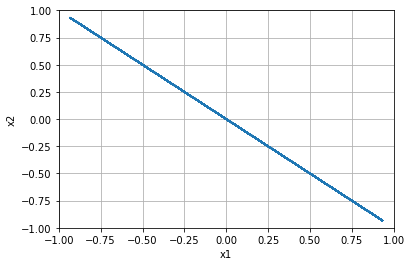


=================== Rollout 298 =====================
x_init [[-0.8 ]
 [ 0.72]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.8   0.72]
xx [-0.8   0.72]
xxx [-0.8   0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.72]


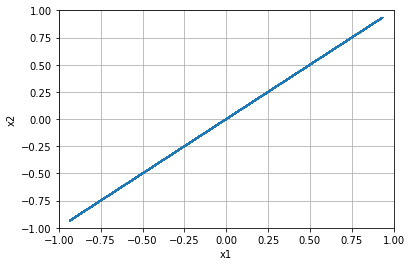


=================== Rollout 299 =====================
x_init [[-0.8 ]
 [ 0.76]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.8   0.76]
xx [-0.8   0.76]
xxx [-0.8   0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.76]


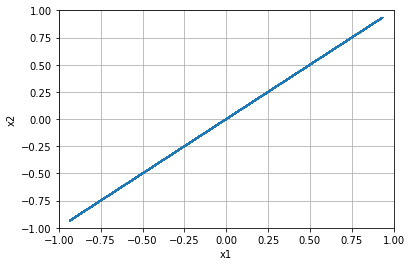


=================== Rollout 300 =====================
x_init [[-0.8]
 [ 0.8]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [ 0.8  0.8  0.8  0.8  0.8]]
x [-0.8  0.8]
xx [-0.8  0.8]
xxx [-0.8  0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.8]


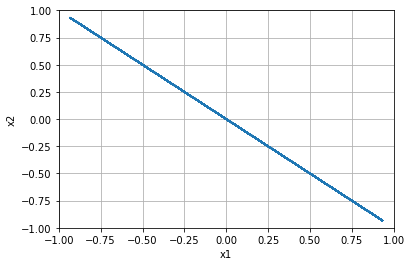


=================== Rollout 301 =====================
x_init [[-0.8 ]
 [ 0.84]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.8   0.84]
xx [-0.8   0.84]
xxx [-0.8   0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.8400000000000001]


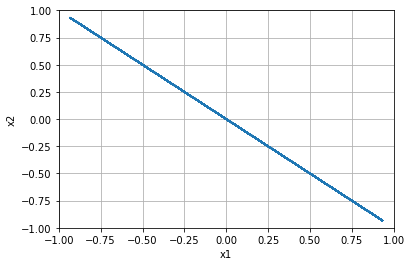


=================== Rollout 302 =====================
x_init [[-0.8 ]
 [ 0.88]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.8   0.88]
xx [-0.8   0.88]
xxx [-0.8   0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.8800000000000001]


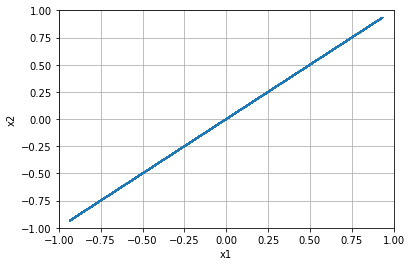


=================== Rollout 303 =====================
x_init [[-0.8 ]
 [ 0.92]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.8   0.92]
xx [-0.8   0.92]
xxx [-0.8   0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.9199999999999999]


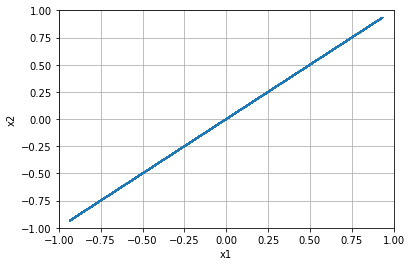


=================== Rollout 304 =====================
x_init [[-0.8 ]
 [ 0.96]]
x_buffer [[-0.8  -0.8  -0.8  -0.8  -0.8 ]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.8   0.96]
xx [-0.8   0.96]
xxx [-0.8   0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 0.96]


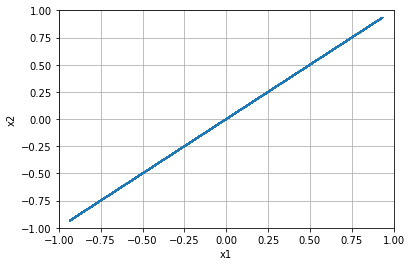


=================== Rollout 305 =====================
x_init [[-0.8]
 [ 1. ]]
x_buffer [[-0.8 -0.8 -0.8 -0.8 -0.8]
 [ 1.   1.   1.   1.   1. ]]
x [-0.8  1. ]
xx [-0.8  1. ]
xxx [-0.8  1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.8, 1.0]


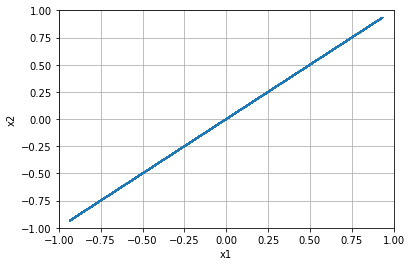


=================== Rollout 306 =====================
x_init [[-0.76]
 [-1.  ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.76 -1.  ]
xx [-0.76 -1.  ]
xxx [-0.76 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -1.0]


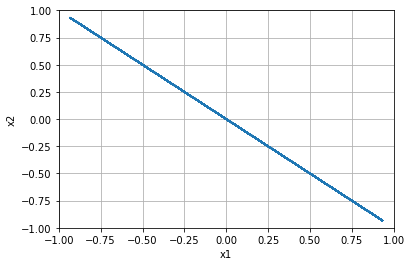


=================== Rollout 307 =====================
x_init [[-0.76]
 [-0.96]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.76 -0.96]
xx [-0.76 -0.96]
xxx [-0.76 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.96]


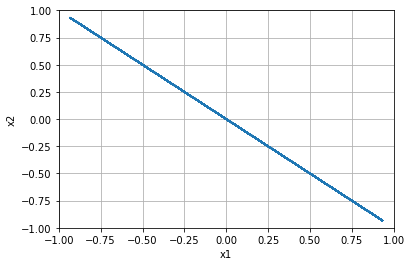


=================== Rollout 308 =====================
x_init [[-0.76]
 [-0.92]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.76 -0.92]
xx [-0.76 -0.92]
xxx [-0.76 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.92]


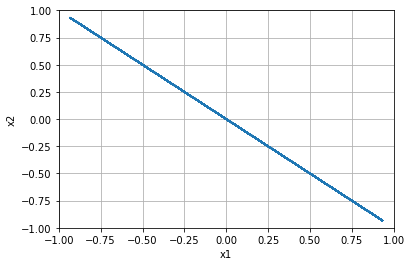


=================== Rollout 309 =====================
x_init [[-0.76]
 [-0.88]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.76 -0.88]
xx [-0.76 -0.88]
xxx [-0.76 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.88]


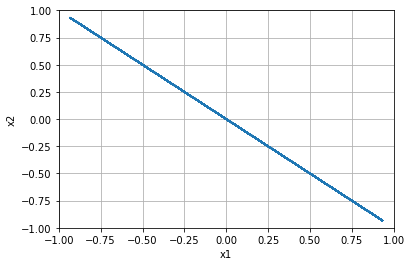


=================== Rollout 310 =====================
x_init [[-0.76]
 [-0.84]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.76 -0.84]
xx [-0.76 -0.84]
xxx [-0.76 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.84]


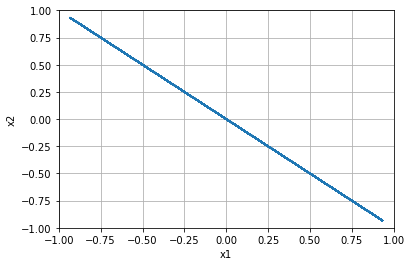


=================== Rollout 311 =====================
x_init [[-0.76]
 [-0.8 ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.76 -0.8 ]
xx [-0.76 -0.8 ]
xxx [-0.76 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.8]


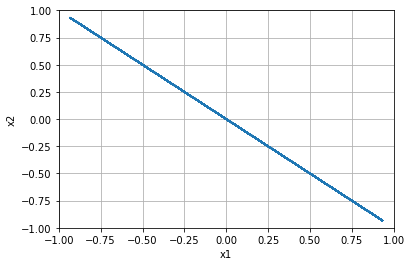


=================== Rollout 312 =====================
x_init [[-0.76]
 [-0.76]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.76 -0.76]
xx [-0.76 -0.76]
xxx [-0.76 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.76]


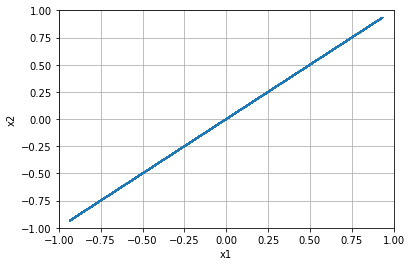


=================== Rollout 313 =====================
x_init [[-0.76]
 [-0.72]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.76 -0.72]
xx [-0.76 -0.72]
xxx [-0.76 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.72]


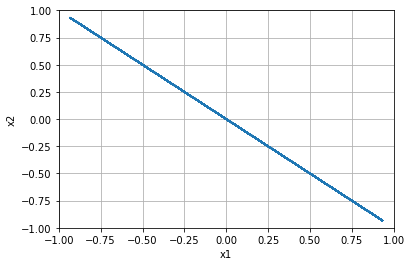


=================== Rollout 314 =====================
x_init [[-0.76]
 [-0.68]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.76 -0.68]
xx [-0.76 -0.68]
xxx [-0.76 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.6799999999999999]


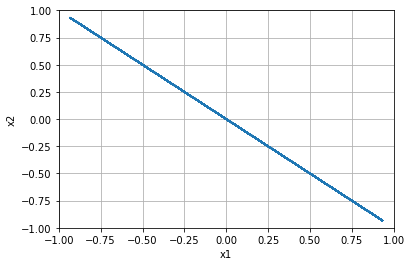


=================== Rollout 315 =====================
x_init [[-0.76]
 [-0.64]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.76 -0.64]
xx [-0.76 -0.64]
xxx [-0.76 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.64]


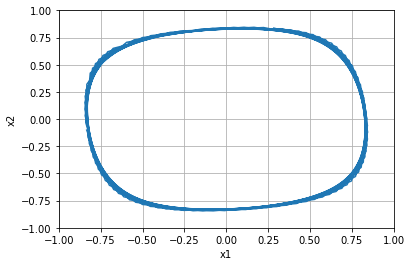


=================== Rollout 316 =====================
x_init [[-0.76]
 [-0.6 ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.76 -0.6 ]
xx [-0.76 -0.6 ]
xxx [-0.76 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.6]


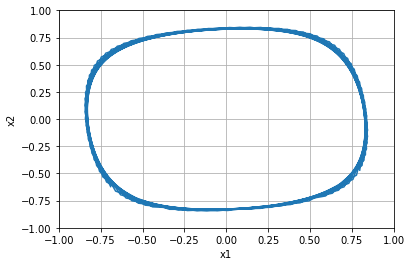


=================== Rollout 317 =====================
x_init [[-0.76]
 [-0.56]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.76 -0.56]
xx [-0.76 -0.56]
xxx [-0.76 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.56]


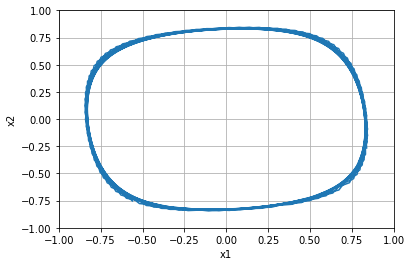


=================== Rollout 318 =====================
x_init [[-0.76]
 [-0.52]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.76 -0.52]
xx [-0.76 -0.52]
xxx [-0.76 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.52]


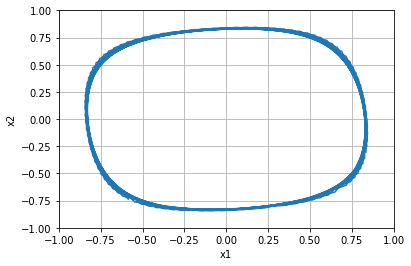


=================== Rollout 319 =====================
x_init [[-0.76]
 [-0.48]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.76 -0.48]
xx [-0.76 -0.48]
xxx [-0.76 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.48]


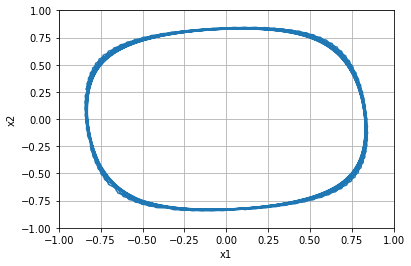


=================== Rollout 320 =====================
x_init [[-0.76]
 [-0.44]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.76 -0.44]
xx [-0.76 -0.44]
xxx [-0.76 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.43999999999999995]


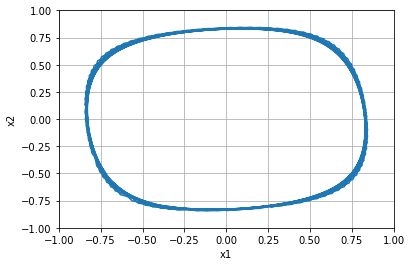


=================== Rollout 321 =====================
x_init [[-0.76]
 [-0.4 ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.76 -0.4 ]
xx [-0.76 -0.4 ]
xxx [-0.76 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.4]


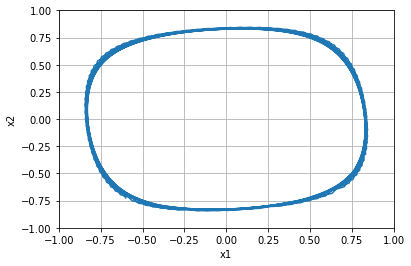


=================== Rollout 322 =====================
x_init [[-0.76]
 [-0.36]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.76 -0.36]
xx [-0.76 -0.36]
xxx [-0.76 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.36]


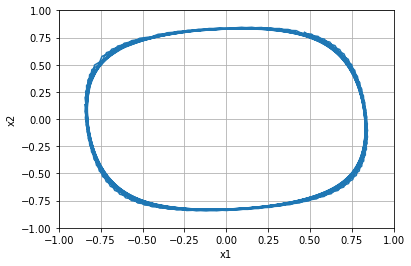


=================== Rollout 323 =====================
x_init [[-0.76]
 [-0.32]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.76 -0.32]
xx [-0.76 -0.32]
xxx [-0.76 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.31999999999999995]


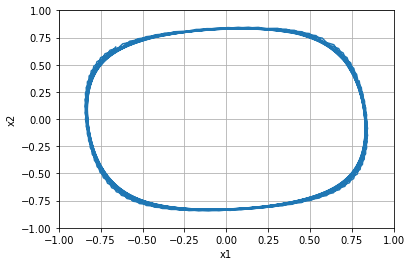


=================== Rollout 324 =====================
x_init [[-0.76]
 [-0.28]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.76 -0.28]
xx [-0.76 -0.28]
xxx [-0.76 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.28]


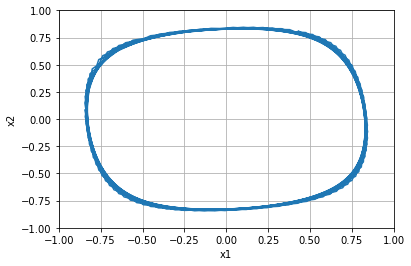


=================== Rollout 325 =====================
x_init [[-0.76]
 [-0.24]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.76 -0.24]
xx [-0.76 -0.24]
xxx [-0.76 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.24]


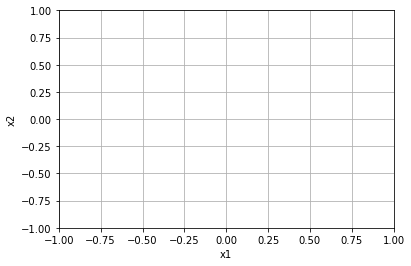


=================== Rollout 326 =====================
x_init [[-0.76]
 [-0.2 ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.76 -0.2 ]
xx [-0.76 -0.2 ]
xxx [-0.76 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.19999999999999996]


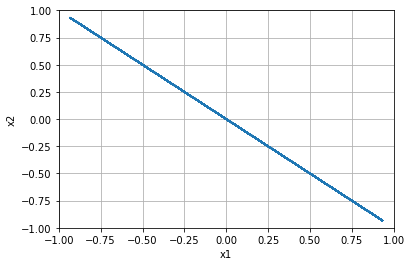


=================== Rollout 327 =====================
x_init [[-0.76]
 [-0.16]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.76 -0.16]
xx [-0.76 -0.16]
xxx [-0.76 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.16000000000000003]


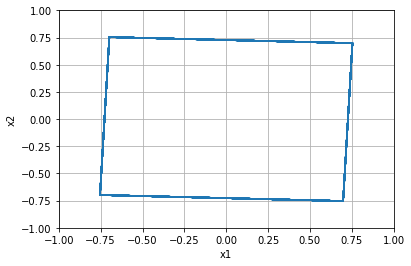


=================== Rollout 328 =====================
x_init [[-0.76]
 [-0.12]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.76 -0.12]
xx [-0.76 -0.12]
xxx [-0.76 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.12]


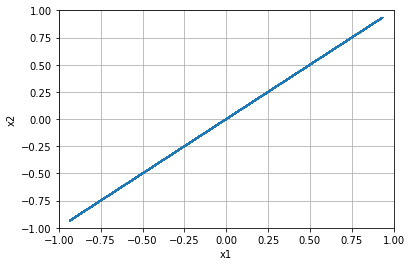


=================== Rollout 329 =====================
x_init [[-0.76]
 [-0.08]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.76 -0.08]
xx [-0.76 -0.08]
xxx [-0.76 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.07999999999999996]


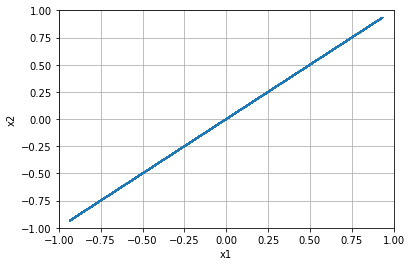


=================== Rollout 330 =====================
x_init [[-0.76]
 [-0.04]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.76 -0.04]
xx [-0.76 -0.04]
xxx [-0.76 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, -0.040000000000000036]


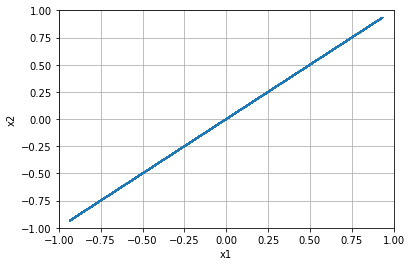


=================== Rollout 331 =====================
x_init [[-0.76]
 [ 0.  ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.76  0.  ]
xx [-0.76  0.  ]
xxx [-0.76  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.0]


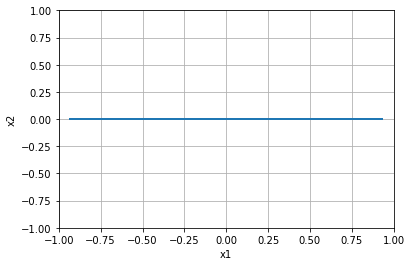


=================== Rollout 332 =====================
x_init [[-0.76]
 [ 0.04]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.76  0.04]
xx [-0.76  0.04]
xxx [-0.76  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.040000000000000036]


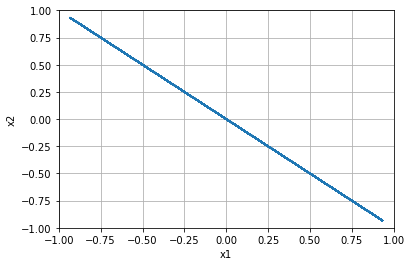


=================== Rollout 333 =====================
x_init [[-0.76]
 [ 0.08]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.76  0.08]
xx [-0.76  0.08]
xxx [-0.76  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.08000000000000007]


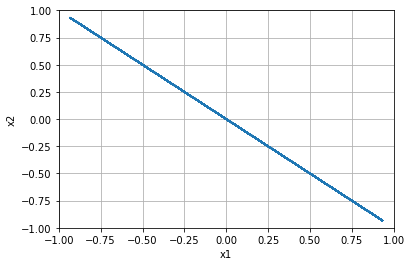


=================== Rollout 334 =====================
x_init [[-0.76]
 [ 0.12]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.76  0.12]
xx [-0.76  0.12]
xxx [-0.76  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.1200000000000001]


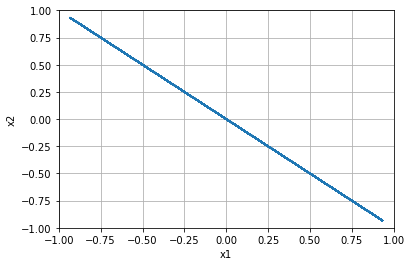


=================== Rollout 335 =====================
x_init [[-0.76]
 [ 0.16]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.76  0.16]
xx [-0.76  0.16]
xxx [-0.76  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.15999999999999992]


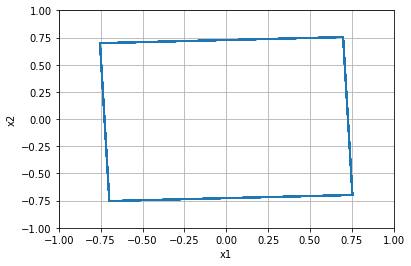


=================== Rollout 336 =====================
x_init [[-0.76]
 [ 0.2 ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.76  0.2 ]
xx [-0.76  0.2 ]
xxx [-0.76  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.19999999999999996]


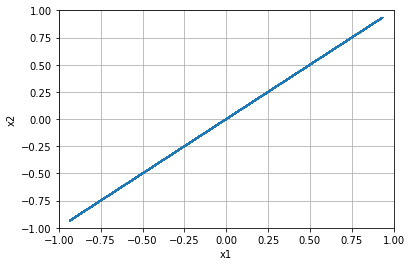


=================== Rollout 337 =====================
x_init [[-0.76]
 [ 0.24]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.76  0.24]
xx [-0.76  0.24]
xxx [-0.76  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.24]


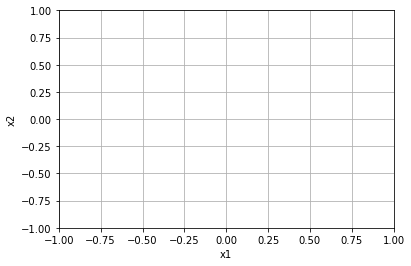


=================== Rollout 338 =====================
x_init [[-0.76]
 [ 0.28]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.76  0.28]
xx [-0.76  0.28]
xxx [-0.76  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.28]


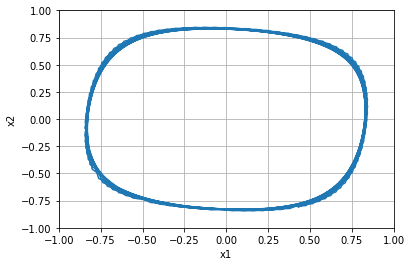


=================== Rollout 339 =====================
x_init [[-0.76]
 [ 0.32]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.76  0.32]
xx [-0.76  0.32]
xxx [-0.76  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.32000000000000006]


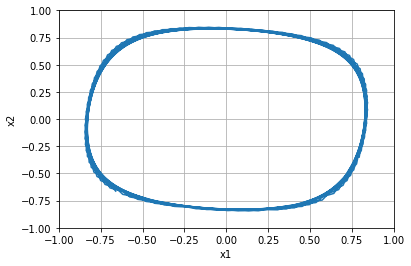


=================== Rollout 340 =====================
x_init [[-0.76]
 [ 0.36]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.76  0.36]
xx [-0.76  0.36]
xxx [-0.76  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.3600000000000001]


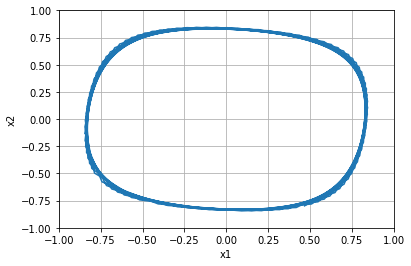


=================== Rollout 341 =====================
x_init [[-0.76]
 [ 0.4 ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.76  0.4 ]
xx [-0.76  0.4 ]
xxx [-0.76  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.40000000000000013]


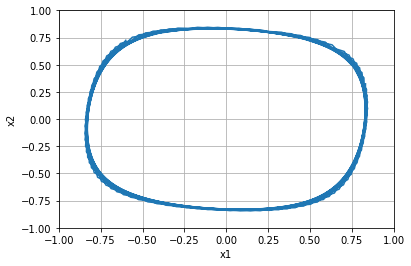


=================== Rollout 342 =====================
x_init [[-0.76]
 [ 0.44]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.76  0.44]
xx [-0.76  0.44]
xxx [-0.76  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.43999999999999995]


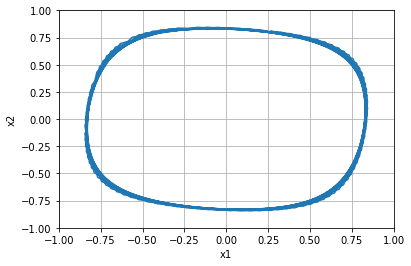


=================== Rollout 343 =====================
x_init [[-0.76]
 [ 0.48]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.76  0.48]
xx [-0.76  0.48]
xxx [-0.76  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.48]


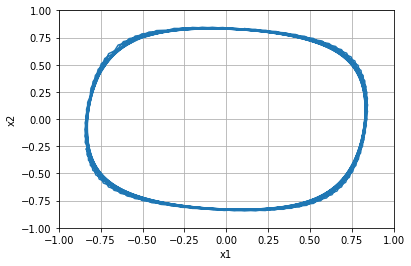


=================== Rollout 344 =====================
x_init [[-0.76]
 [ 0.52]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.76  0.52]
xx [-0.76  0.52]
xxx [-0.76  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.52]


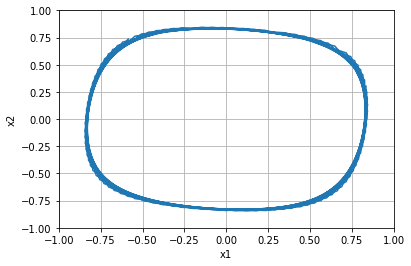


=================== Rollout 345 =====================
x_init [[-0.76]
 [ 0.56]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.76  0.56]
xx [-0.76  0.56]
xxx [-0.76  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.56]


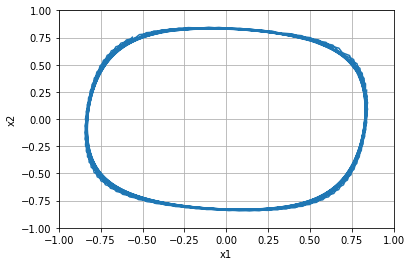


=================== Rollout 346 =====================
x_init [[-0.76]
 [ 0.6 ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.76  0.6 ]
xx [-0.76  0.6 ]
xxx [-0.76  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.6000000000000001]


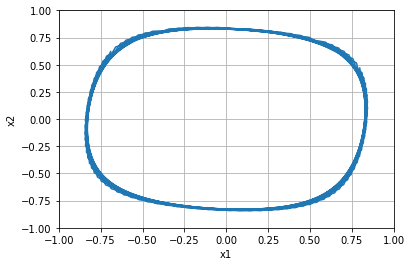


=================== Rollout 347 =====================
x_init [[-0.76]
 [ 0.64]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.76  0.64]
xx [-0.76  0.64]
xxx [-0.76  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.6400000000000001]


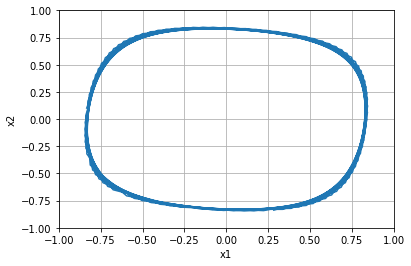


=================== Rollout 348 =====================
x_init [[-0.76]
 [ 0.68]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.76  0.68]
xx [-0.76  0.68]
xxx [-0.76  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.6799999999999999]


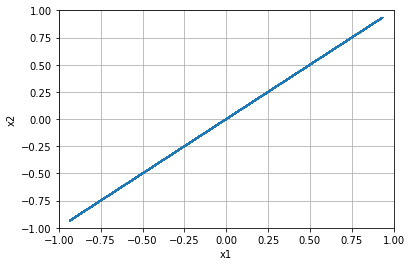


=================== Rollout 349 =====================
x_init [[-0.76]
 [ 0.72]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.76  0.72]
xx [-0.76  0.72]
xxx [-0.76  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.72]


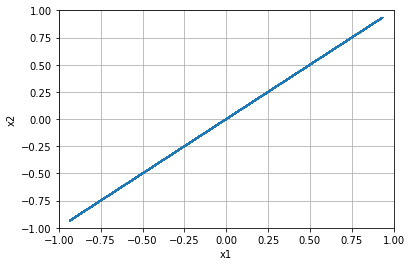


=================== Rollout 350 =====================
x_init [[-0.76]
 [ 0.76]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.76  0.76]
xx [-0.76  0.76]
xxx [-0.76  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.76]


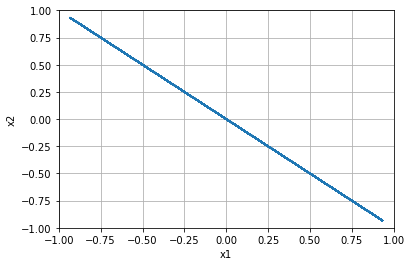


=================== Rollout 351 =====================
x_init [[-0.76]
 [ 0.8 ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.76  0.8 ]
xx [-0.76  0.8 ]
xxx [-0.76  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.8]


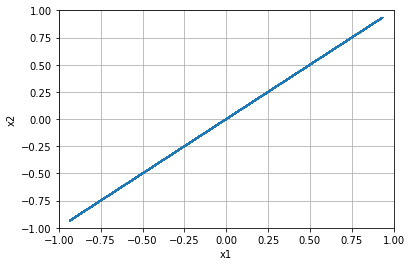


=================== Rollout 352 =====================
x_init [[-0.76]
 [ 0.84]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.76  0.84]
xx [-0.76  0.84]
xxx [-0.76  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.8400000000000001]


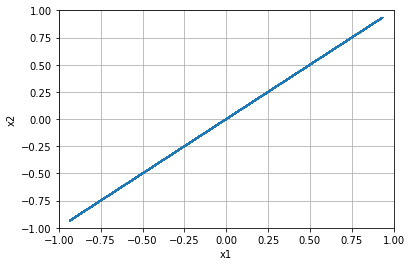


=================== Rollout 353 =====================
x_init [[-0.76]
 [ 0.88]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.76  0.88]
xx [-0.76  0.88]
xxx [-0.76  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.8800000000000001]


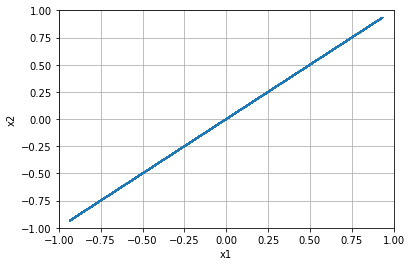


=================== Rollout 354 =====================
x_init [[-0.76]
 [ 0.92]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.76  0.92]
xx [-0.76  0.92]
xxx [-0.76  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.9199999999999999]


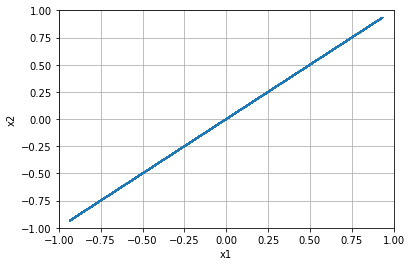


=================== Rollout 355 =====================
x_init [[-0.76]
 [ 0.96]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.76  0.96]
xx [-0.76  0.96]
xxx [-0.76  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 0.96]


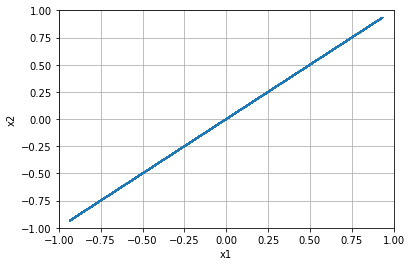


=================== Rollout 356 =====================
x_init [[-0.76]
 [ 1.  ]]
x_buffer [[-0.76 -0.76 -0.76 -0.76 -0.76]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.76  1.  ]
xx [-0.76  1.  ]
xxx [-0.76  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.76, 1.0]


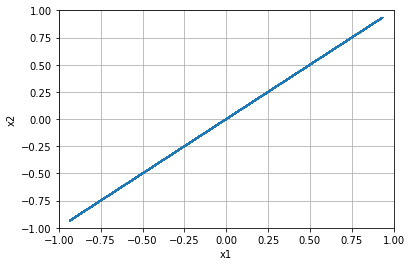


=================== Rollout 357 =====================
x_init [[-0.72]
 [-1.  ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.72 -1.  ]
xx [-0.72 -1.  ]
xxx [-0.72 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -1.0]


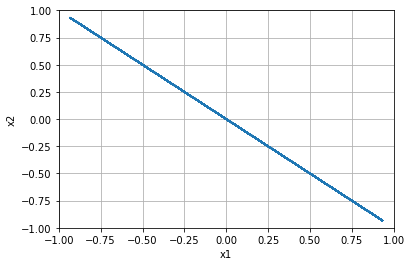


=================== Rollout 358 =====================
x_init [[-0.72]
 [-0.96]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.72 -0.96]
xx [-0.72 -0.96]
xxx [-0.72 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.96]


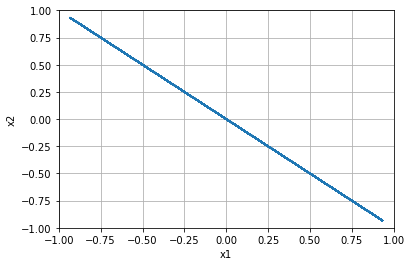


=================== Rollout 359 =====================
x_init [[-0.72]
 [-0.92]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.72 -0.92]
xx [-0.72 -0.92]
xxx [-0.72 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.92]


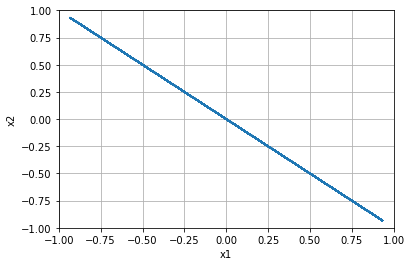


=================== Rollout 360 =====================
x_init [[-0.72]
 [-0.88]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.72 -0.88]
xx [-0.72 -0.88]
xxx [-0.72 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.88]


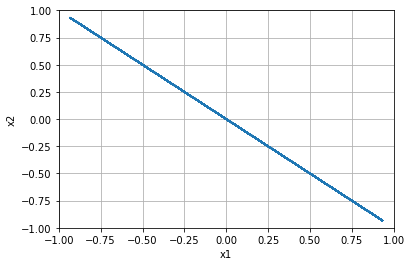


=================== Rollout 361 =====================
x_init [[-0.72]
 [-0.84]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.72 -0.84]
xx [-0.72 -0.84]
xxx [-0.72 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.84]


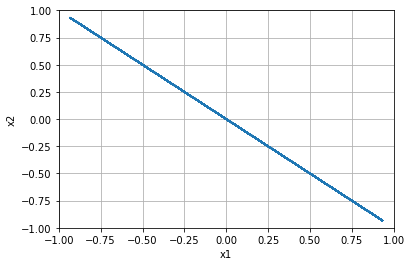


=================== Rollout 362 =====================
x_init [[-0.72]
 [-0.8 ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.72 -0.8 ]
xx [-0.72 -0.8 ]
xxx [-0.72 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.8]


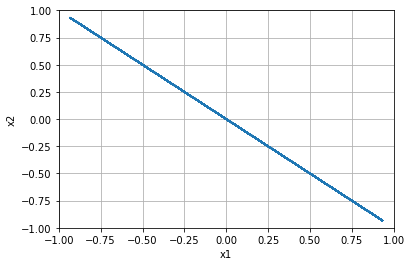


=================== Rollout 363 =====================
x_init [[-0.72]
 [-0.76]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.72 -0.76]
xx [-0.72 -0.76]
xxx [-0.72 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.76]


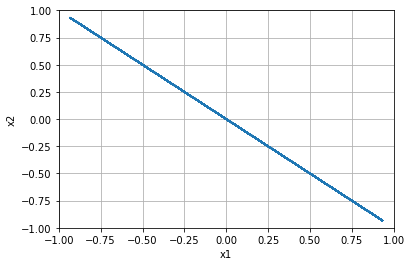


=================== Rollout 364 =====================
x_init [[-0.72]
 [-0.72]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.72 -0.72]
xx [-0.72 -0.72]
xxx [-0.72 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.72]


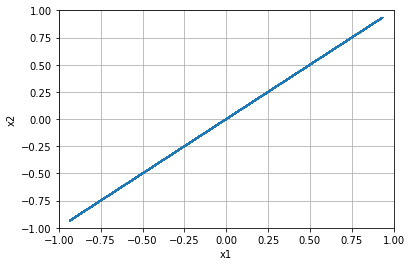


=================== Rollout 365 =====================
x_init [[-0.72]
 [-0.68]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.72 -0.68]
xx [-0.72 -0.68]
xxx [-0.72 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.6799999999999999]


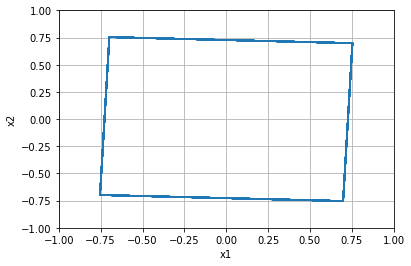


=================== Rollout 366 =====================
x_init [[-0.72]
 [-0.64]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.72 -0.64]
xx [-0.72 -0.64]
xxx [-0.72 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.64]


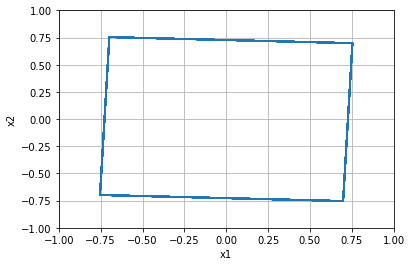


=================== Rollout 367 =====================
x_init [[-0.72]
 [-0.6 ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.72 -0.6 ]
xx [-0.72 -0.6 ]
xxx [-0.72 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.6]


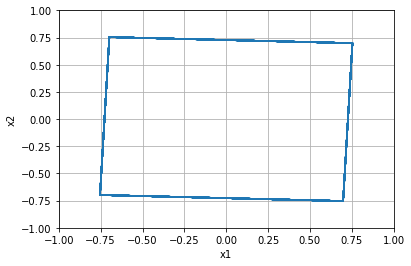


=================== Rollout 368 =====================
x_init [[-0.72]
 [-0.56]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.72 -0.56]
xx [-0.72 -0.56]
xxx [-0.72 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.56]


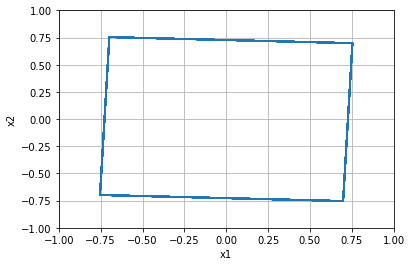


=================== Rollout 369 =====================
x_init [[-0.72]
 [-0.52]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.72 -0.52]
xx [-0.72 -0.52]
xxx [-0.72 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.52]


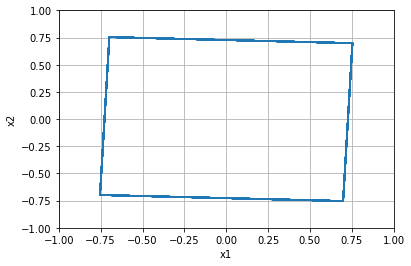


=================== Rollout 370 =====================
x_init [[-0.72]
 [-0.48]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.72 -0.48]
xx [-0.72 -0.48]
xxx [-0.72 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.48]


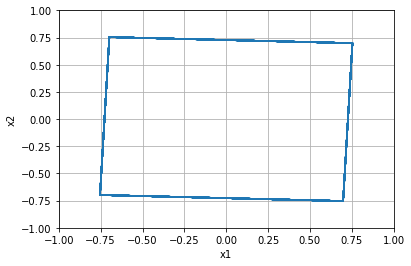


=================== Rollout 371 =====================
x_init [[-0.72]
 [-0.44]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.72 -0.44]
xx [-0.72 -0.44]
xxx [-0.72 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.43999999999999995]


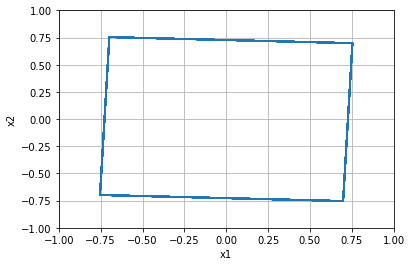


=================== Rollout 372 =====================
x_init [[-0.72]
 [-0.4 ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.72 -0.4 ]
xx [-0.72 -0.4 ]
xxx [-0.72 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.4]


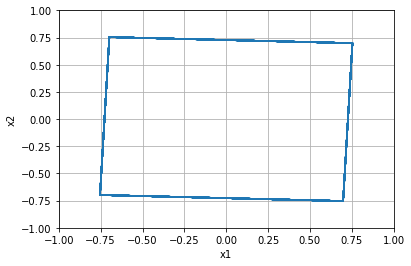


=================== Rollout 373 =====================
x_init [[-0.72]
 [-0.36]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.72 -0.36]
xx [-0.72 -0.36]
xxx [-0.72 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.36]


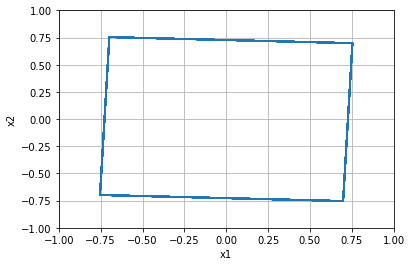


=================== Rollout 374 =====================
x_init [[-0.72]
 [-0.32]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.72 -0.32]
xx [-0.72 -0.32]
xxx [-0.72 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.31999999999999995]


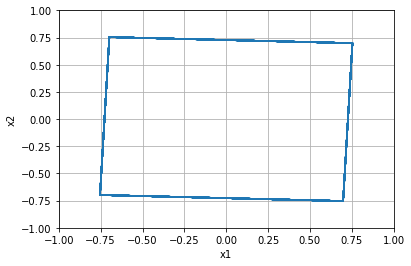


=================== Rollout 375 =====================
x_init [[-0.72]
 [-0.28]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.72 -0.28]
xx [-0.72 -0.28]
xxx [-0.72 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.28]


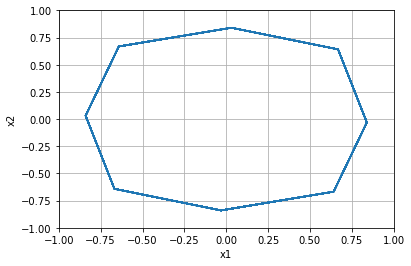


=================== Rollout 376 =====================
x_init [[-0.72]
 [-0.24]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.72 -0.24]
xx [-0.72 -0.24]
xxx [-0.72 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.24]


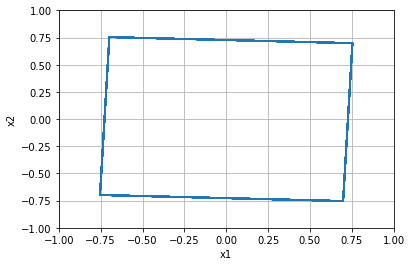


=================== Rollout 377 =====================
x_init [[-0.72]
 [-0.2 ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.72 -0.2 ]
xx [-0.72 -0.2 ]
xxx [-0.72 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.19999999999999996]


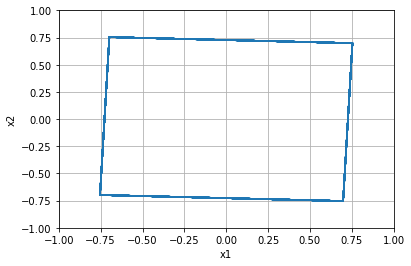


=================== Rollout 378 =====================
x_init [[-0.72]
 [-0.16]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.72 -0.16]
xx [-0.72 -0.16]
xxx [-0.72 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.16000000000000003]


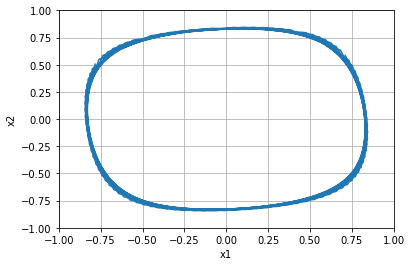


=================== Rollout 379 =====================
x_init [[-0.72]
 [-0.12]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.72 -0.12]
xx [-0.72 -0.12]
xxx [-0.72 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.12]


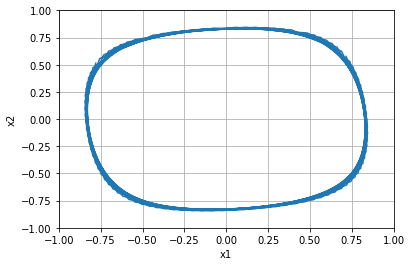


=================== Rollout 380 =====================
x_init [[-0.72]
 [-0.08]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.72 -0.08]
xx [-0.72 -0.08]
xxx [-0.72 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.07999999999999996]


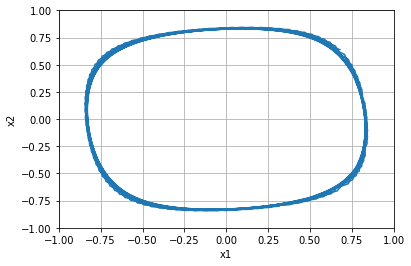


=================== Rollout 381 =====================
x_init [[-0.72]
 [-0.04]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.72 -0.04]
xx [-0.72 -0.04]
xxx [-0.72 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, -0.040000000000000036]


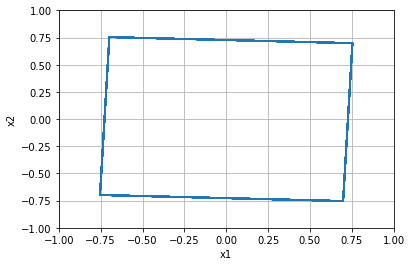


=================== Rollout 382 =====================
x_init [[-0.72]
 [ 0.  ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.72  0.  ]
xx [-0.72  0.  ]
xxx [-0.72  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.0]


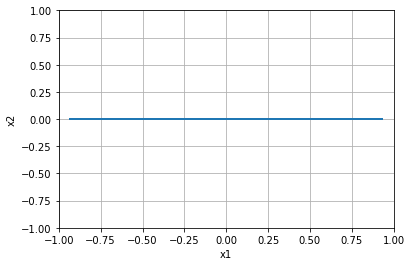


=================== Rollout 383 =====================
x_init [[-0.72]
 [ 0.04]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.72  0.04]
xx [-0.72  0.04]
xxx [-0.72  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.040000000000000036]


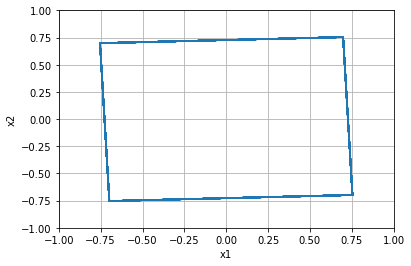


=================== Rollout 384 =====================
x_init [[-0.72]
 [ 0.08]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.72  0.08]
xx [-0.72  0.08]
xxx [-0.72  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.08000000000000007]


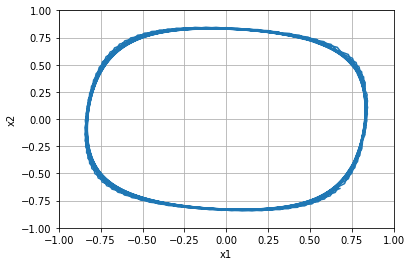


=================== Rollout 385 =====================
x_init [[-0.72]
 [ 0.12]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.72  0.12]
xx [-0.72  0.12]
xxx [-0.72  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.1200000000000001]


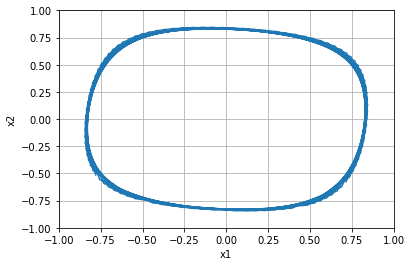


=================== Rollout 386 =====================
x_init [[-0.72]
 [ 0.16]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.72  0.16]
xx [-0.72  0.16]
xxx [-0.72  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.15999999999999992]


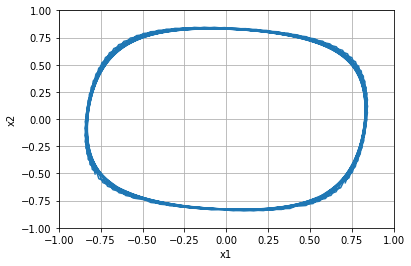


=================== Rollout 387 =====================
x_init [[-0.72]
 [ 0.2 ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.72  0.2 ]
xx [-0.72  0.2 ]
xxx [-0.72  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.19999999999999996]


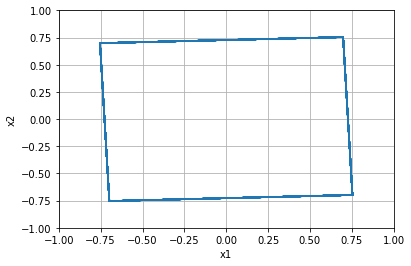


=================== Rollout 388 =====================
x_init [[-0.72]
 [ 0.24]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.72  0.24]
xx [-0.72  0.24]
xxx [-0.72  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.24]


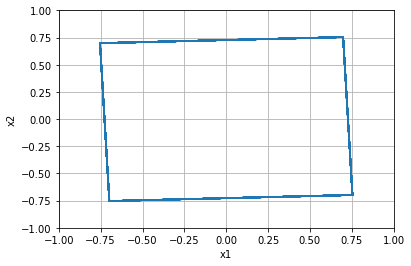


=================== Rollout 389 =====================
x_init [[-0.72]
 [ 0.28]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.72  0.28]
xx [-0.72  0.28]
xxx [-0.72  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.28]


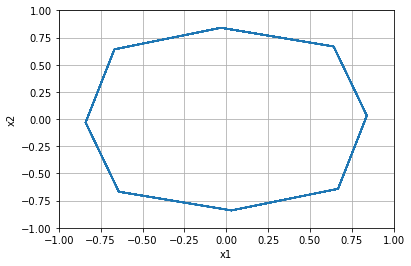


=================== Rollout 390 =====================
x_init [[-0.72]
 [ 0.32]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.72  0.32]
xx [-0.72  0.32]
xxx [-0.72  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.32000000000000006]


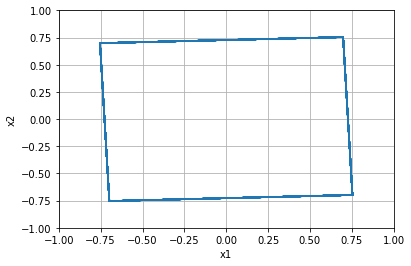


=================== Rollout 391 =====================
x_init [[-0.72]
 [ 0.36]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.72  0.36]
xx [-0.72  0.36]
xxx [-0.72  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.3600000000000001]


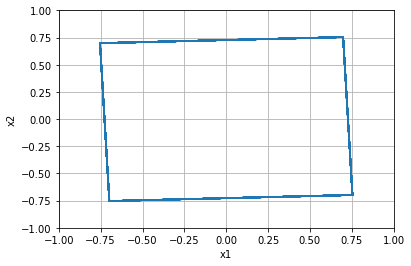


=================== Rollout 392 =====================
x_init [[-0.72]
 [ 0.4 ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.72  0.4 ]
xx [-0.72  0.4 ]
xxx [-0.72  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.40000000000000013]


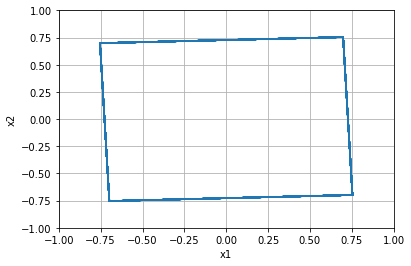


=================== Rollout 393 =====================
x_init [[-0.72]
 [ 0.44]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.72  0.44]
xx [-0.72  0.44]
xxx [-0.72  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.43999999999999995]


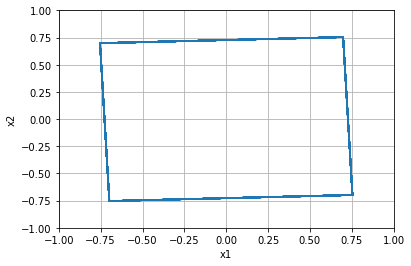


=================== Rollout 394 =====================
x_init [[-0.72]
 [ 0.48]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.72  0.48]
xx [-0.72  0.48]
xxx [-0.72  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.48]


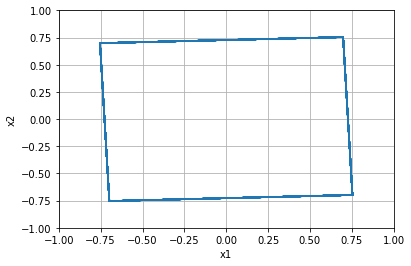


=================== Rollout 395 =====================
x_init [[-0.72]
 [ 0.52]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.72  0.52]
xx [-0.72  0.52]
xxx [-0.72  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.52]


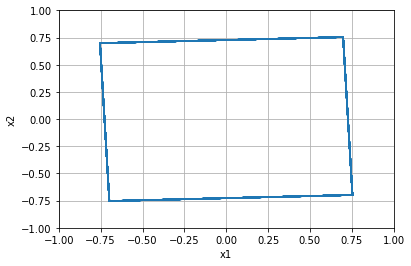


=================== Rollout 396 =====================
x_init [[-0.72]
 [ 0.56]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.72  0.56]
xx [-0.72  0.56]
xxx [-0.72  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.56]


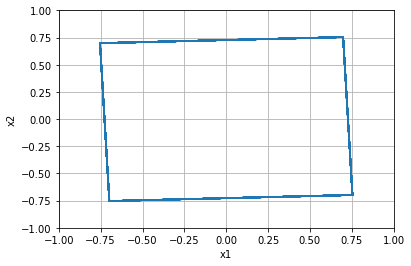


=================== Rollout 397 =====================
x_init [[-0.72]
 [ 0.6 ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.72  0.6 ]
xx [-0.72  0.6 ]
xxx [-0.72  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.6000000000000001]


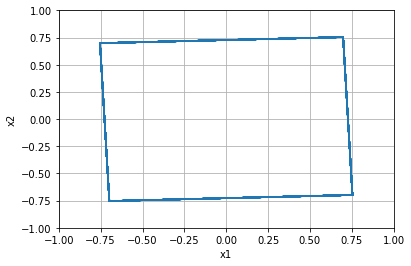


=================== Rollout 398 =====================
x_init [[-0.72]
 [ 0.64]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.72  0.64]
xx [-0.72  0.64]
xxx [-0.72  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.6400000000000001]


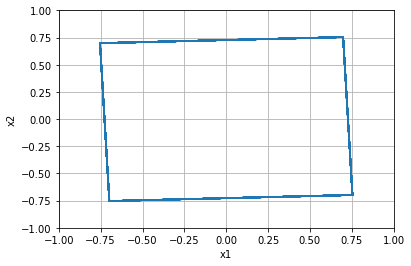


=================== Rollout 399 =====================
x_init [[-0.72]
 [ 0.68]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.72  0.68]
xx [-0.72  0.68]
xxx [-0.72  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.6799999999999999]


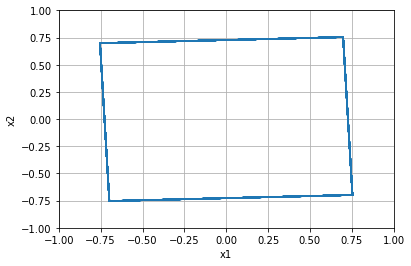


=================== Rollout 400 =====================
x_init [[-0.72]
 [ 0.72]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.72  0.72]
xx [-0.72  0.72]
xxx [-0.72  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.72]


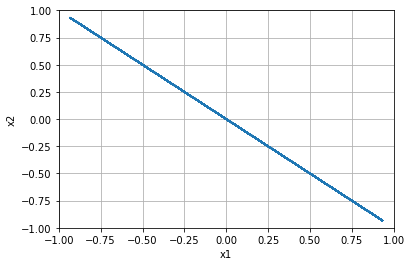


=================== Rollout 401 =====================
x_init [[-0.72]
 [ 0.76]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.72  0.76]
xx [-0.72  0.76]
xxx [-0.72  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.76]


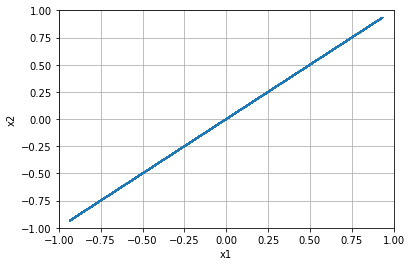


=================== Rollout 402 =====================
x_init [[-0.72]
 [ 0.8 ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.72  0.8 ]
xx [-0.72  0.8 ]
xxx [-0.72  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.8]


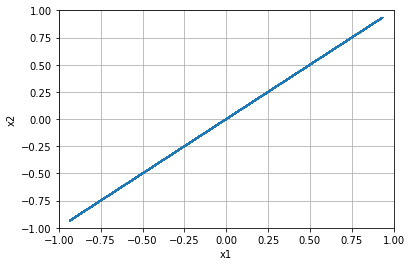


=================== Rollout 403 =====================
x_init [[-0.72]
 [ 0.84]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.72  0.84]
xx [-0.72  0.84]
xxx [-0.72  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.8400000000000001]


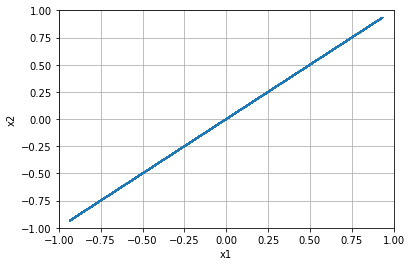


=================== Rollout 404 =====================
x_init [[-0.72]
 [ 0.88]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.72  0.88]
xx [-0.72  0.88]
xxx [-0.72  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.8800000000000001]


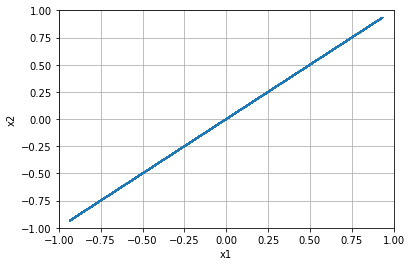


=================== Rollout 405 =====================
x_init [[-0.72]
 [ 0.92]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.72  0.92]
xx [-0.72  0.92]
xxx [-0.72  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.9199999999999999]


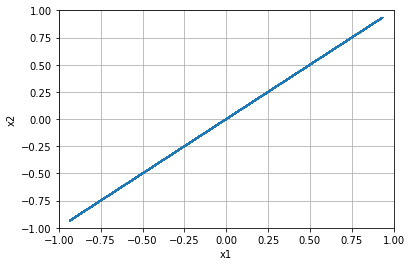


=================== Rollout 406 =====================
x_init [[-0.72]
 [ 0.96]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.72  0.96]
xx [-0.72  0.96]
xxx [-0.72  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 0.96]


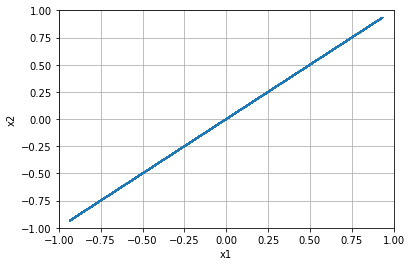


=================== Rollout 407 =====================
x_init [[-0.72]
 [ 1.  ]]
x_buffer [[-0.72 -0.72 -0.72 -0.72 -0.72]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.72  1.  ]
xx [-0.72  1.  ]
xxx [-0.72  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.72, 1.0]


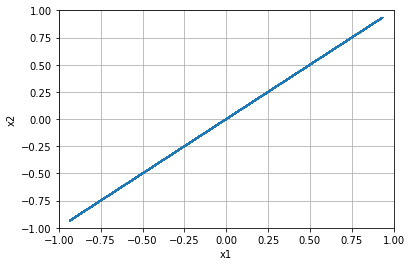


=================== Rollout 408 =====================
x_init [[-0.68]
 [-1.  ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.68 -1.  ]
xx [-0.68 -1.  ]
xxx [-0.68 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -1.0]


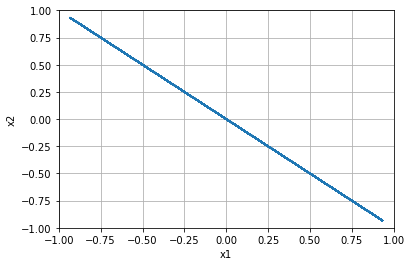


=================== Rollout 409 =====================
x_init [[-0.68]
 [-0.96]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.68 -0.96]
xx [-0.68 -0.96]
xxx [-0.68 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.96]


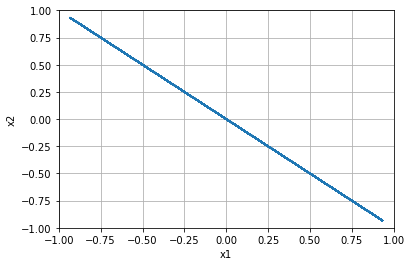


=================== Rollout 410 =====================
x_init [[-0.68]
 [-0.92]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.68 -0.92]
xx [-0.68 -0.92]
xxx [-0.68 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.92]


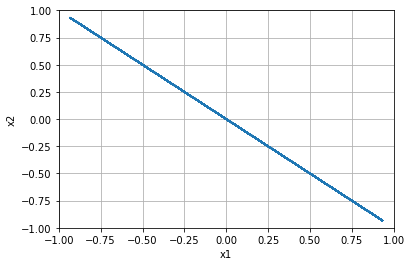


=================== Rollout 411 =====================
x_init [[-0.68]
 [-0.88]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.68 -0.88]
xx [-0.68 -0.88]
xxx [-0.68 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.88]


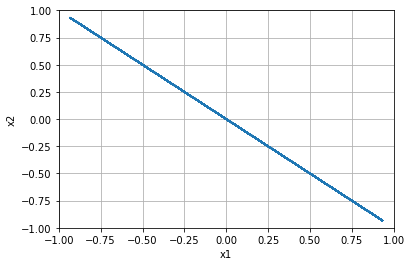


=================== Rollout 412 =====================
x_init [[-0.68]
 [-0.84]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.68 -0.84]
xx [-0.68 -0.84]
xxx [-0.68 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.84]


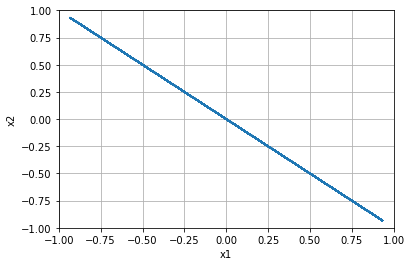


=================== Rollout 413 =====================
x_init [[-0.68]
 [-0.8 ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.68 -0.8 ]
xx [-0.68 -0.8 ]
xxx [-0.68 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.8]


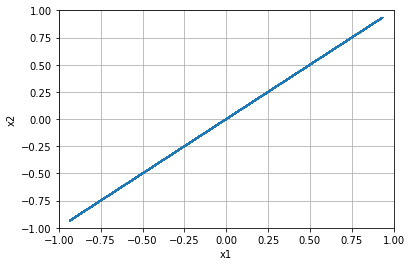


=================== Rollout 414 =====================
x_init [[-0.68]
 [-0.76]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.68 -0.76]
xx [-0.68 -0.76]
xxx [-0.68 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.76]


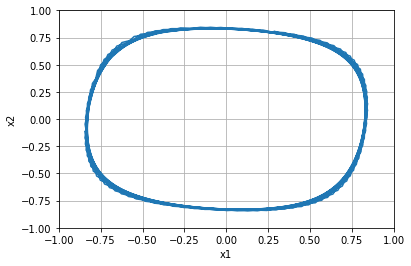


=================== Rollout 415 =====================
x_init [[-0.68]
 [-0.72]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.68 -0.72]
xx [-0.68 -0.72]
xxx [-0.68 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.72]


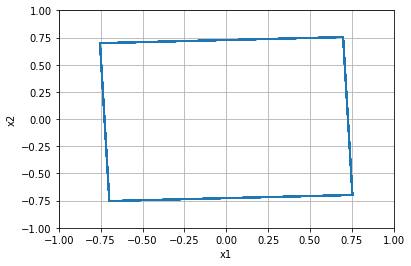


=================== Rollout 416 =====================
x_init [[-0.68]
 [-0.68]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.68 -0.68]
xx [-0.68 -0.68]
xxx [-0.68 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.6799999999999999]


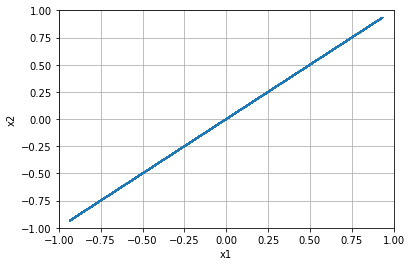


=================== Rollout 417 =====================
x_init [[-0.68]
 [-0.64]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.68 -0.64]
xx [-0.68 -0.64]
xxx [-0.68 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.64]


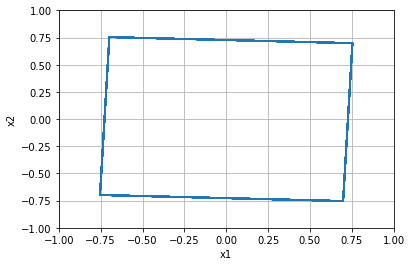


=================== Rollout 418 =====================
x_init [[-0.68]
 [-0.6 ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.68 -0.6 ]
xx [-0.68 -0.6 ]
xxx [-0.68 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.6]


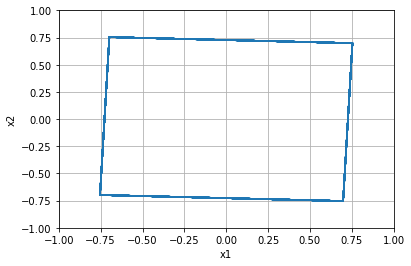


=================== Rollout 419 =====================
x_init [[-0.68]
 [-0.56]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.68 -0.56]
xx [-0.68 -0.56]
xxx [-0.68 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.56]


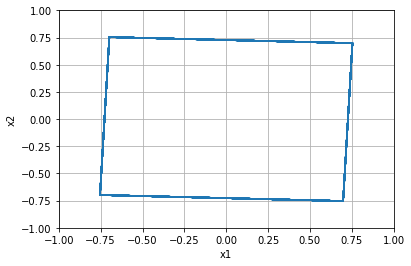


=================== Rollout 420 =====================
x_init [[-0.68]
 [-0.52]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.68 -0.52]
xx [-0.68 -0.52]
xxx [-0.68 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.52]


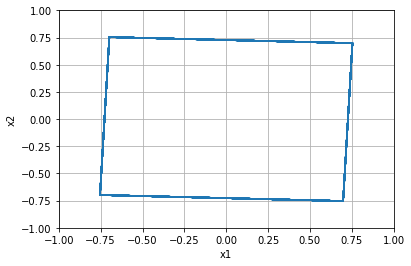


=================== Rollout 421 =====================
x_init [[-0.68]
 [-0.48]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.68 -0.48]
xx [-0.68 -0.48]
xxx [-0.68 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.48]


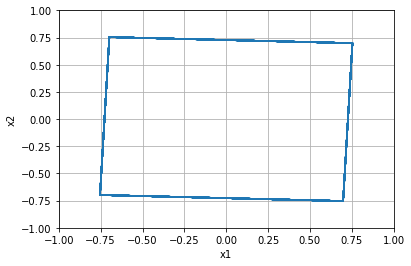


=================== Rollout 422 =====================
x_init [[-0.68]
 [-0.44]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.68 -0.44]
xx [-0.68 -0.44]
xxx [-0.68 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.43999999999999995]


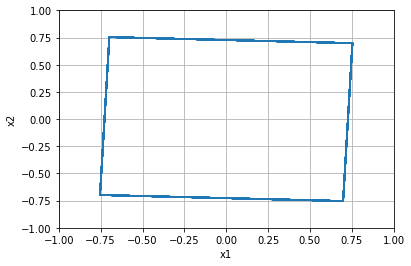


=================== Rollout 423 =====================
x_init [[-0.68]
 [-0.4 ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.68 -0.4 ]
xx [-0.68 -0.4 ]
xxx [-0.68 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.4]


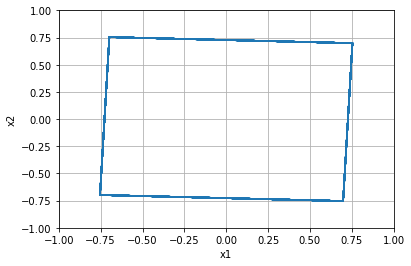


=================== Rollout 424 =====================
x_init [[-0.68]
 [-0.36]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.68 -0.36]
xx [-0.68 -0.36]
xxx [-0.68 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.36]


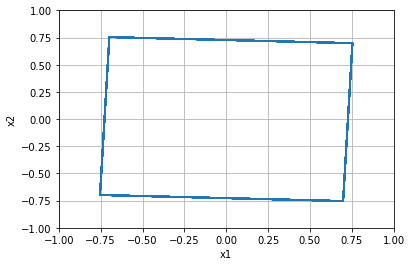


=================== Rollout 425 =====================
x_init [[-0.68]
 [-0.32]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.68 -0.32]
xx [-0.68 -0.32]
xxx [-0.68 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.31999999999999995]


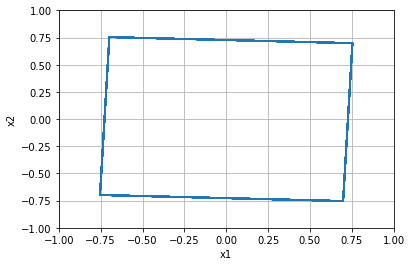


=================== Rollout 426 =====================
x_init [[-0.68]
 [-0.28]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.68 -0.28]
xx [-0.68 -0.28]
xxx [-0.68 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.28]


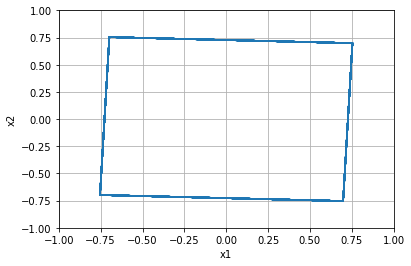


=================== Rollout 427 =====================
x_init [[-0.68]
 [-0.24]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.68 -0.24]
xx [-0.68 -0.24]
xxx [-0.68 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.24]


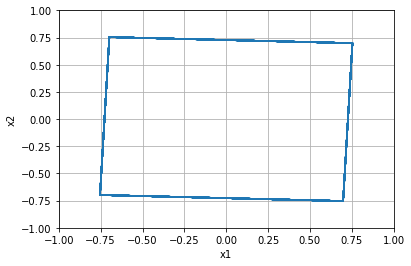


=================== Rollout 428 =====================
x_init [[-0.68]
 [-0.2 ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.68 -0.2 ]
xx [-0.68 -0.2 ]
xxx [-0.68 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.19999999999999996]


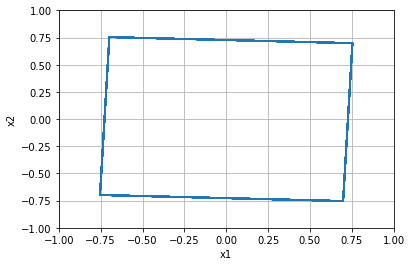


=================== Rollout 429 =====================
x_init [[-0.68]
 [-0.16]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.68 -0.16]
xx [-0.68 -0.16]
xxx [-0.68 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.16000000000000003]


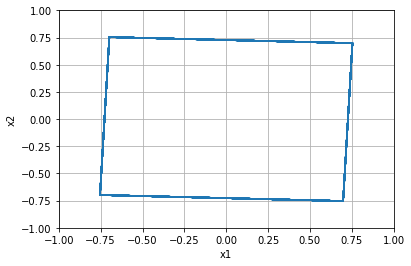


=================== Rollout 430 =====================
x_init [[-0.68]
 [-0.12]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.68 -0.12]
xx [-0.68 -0.12]
xxx [-0.68 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.12]


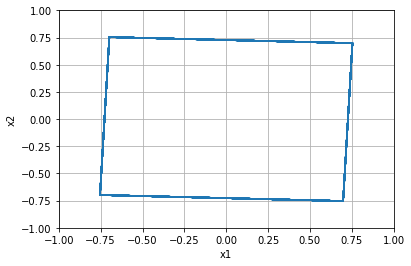


=================== Rollout 431 =====================
x_init [[-0.68]
 [-0.08]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.68 -0.08]
xx [-0.68 -0.08]
xxx [-0.68 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.07999999999999996]


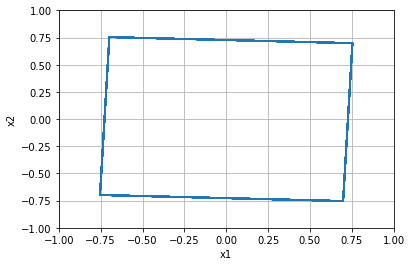


=================== Rollout 432 =====================
x_init [[-0.68]
 [-0.04]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.68 -0.04]
xx [-0.68 -0.04]
xxx [-0.68 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, -0.040000000000000036]


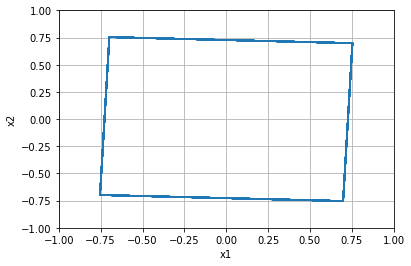


=================== Rollout 433 =====================
x_init [[-0.68]
 [ 0.  ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.68  0.  ]
xx [-0.68  0.  ]
xxx [-0.68  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.0]


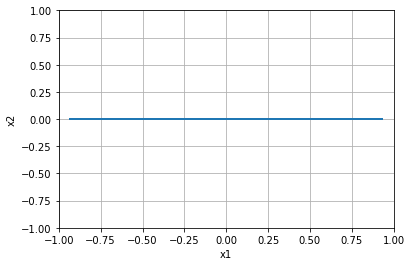


=================== Rollout 434 =====================
x_init [[-0.68]
 [ 0.04]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.68  0.04]
xx [-0.68  0.04]
xxx [-0.68  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.040000000000000036]


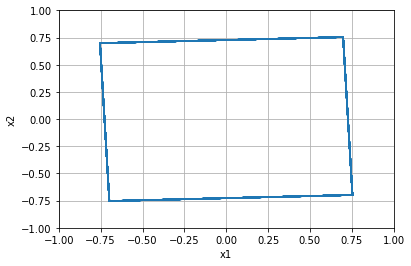


=================== Rollout 435 =====================
x_init [[-0.68]
 [ 0.08]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.68  0.08]
xx [-0.68  0.08]
xxx [-0.68  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.08000000000000007]


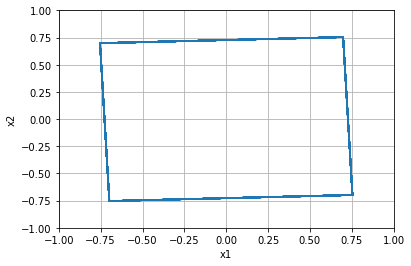


=================== Rollout 436 =====================
x_init [[-0.68]
 [ 0.12]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.68  0.12]
xx [-0.68  0.12]
xxx [-0.68  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.1200000000000001]


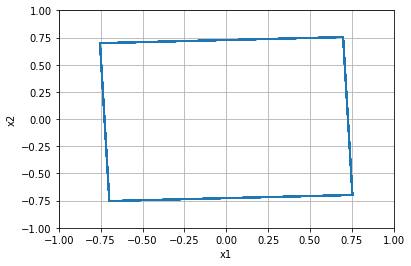


=================== Rollout 437 =====================
x_init [[-0.68]
 [ 0.16]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.68  0.16]
xx [-0.68  0.16]
xxx [-0.68  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.15999999999999992]


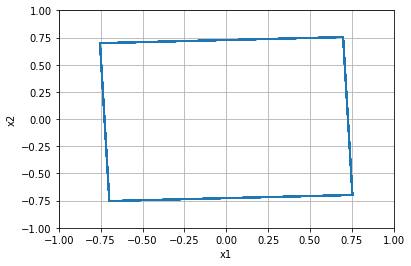


=================== Rollout 438 =====================
x_init [[-0.68]
 [ 0.2 ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.68  0.2 ]
xx [-0.68  0.2 ]
xxx [-0.68  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.19999999999999996]


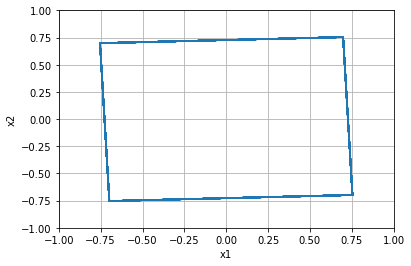


=================== Rollout 439 =====================
x_init [[-0.68]
 [ 0.24]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.68  0.24]
xx [-0.68  0.24]
xxx [-0.68  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.24]


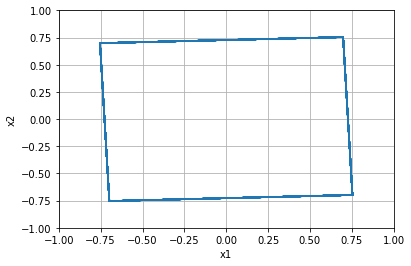


=================== Rollout 440 =====================
x_init [[-0.68]
 [ 0.28]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.68  0.28]
xx [-0.68  0.28]
xxx [-0.68  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.28]


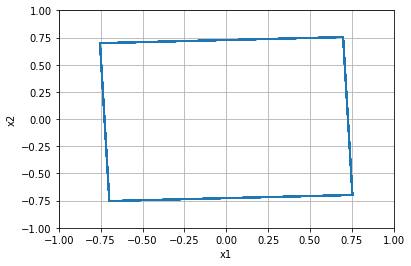


=================== Rollout 441 =====================
x_init [[-0.68]
 [ 0.32]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.68  0.32]
xx [-0.68  0.32]
xxx [-0.68  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.32000000000000006]


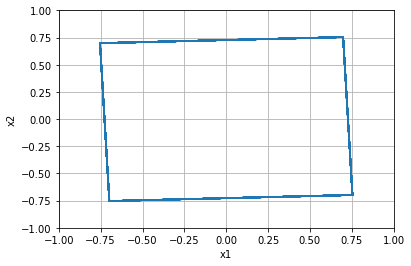


=================== Rollout 442 =====================
x_init [[-0.68]
 [ 0.36]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.68  0.36]
xx [-0.68  0.36]
xxx [-0.68  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.3600000000000001]


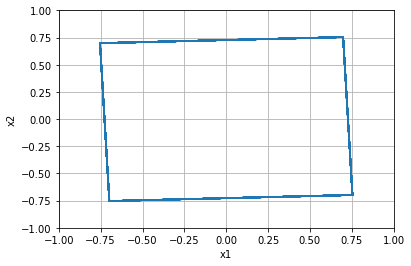


=================== Rollout 443 =====================
x_init [[-0.68]
 [ 0.4 ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.68  0.4 ]
xx [-0.68  0.4 ]
xxx [-0.68  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.40000000000000013]


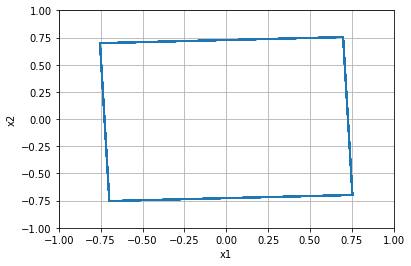


=================== Rollout 444 =====================
x_init [[-0.68]
 [ 0.44]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.68  0.44]
xx [-0.68  0.44]
xxx [-0.68  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.43999999999999995]


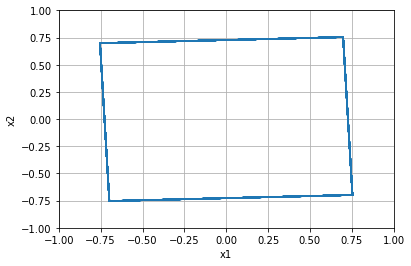


=================== Rollout 445 =====================
x_init [[-0.68]
 [ 0.48]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.68  0.48]
xx [-0.68  0.48]
xxx [-0.68  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.48]


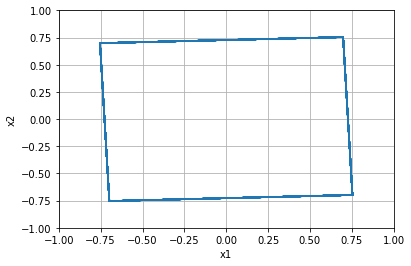


=================== Rollout 446 =====================
x_init [[-0.68]
 [ 0.52]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.68  0.52]
xx [-0.68  0.52]
xxx [-0.68  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.52]


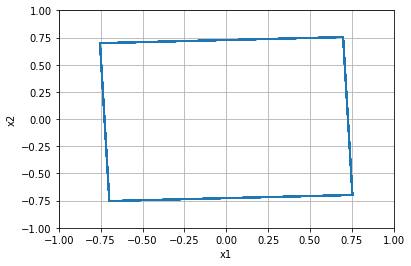


=================== Rollout 447 =====================
x_init [[-0.68]
 [ 0.56]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.68  0.56]
xx [-0.68  0.56]
xxx [-0.68  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.56]


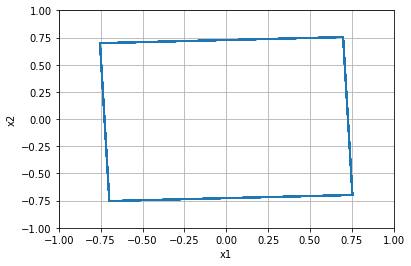


=================== Rollout 448 =====================
x_init [[-0.68]
 [ 0.6 ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.68  0.6 ]
xx [-0.68  0.6 ]
xxx [-0.68  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.6000000000000001]


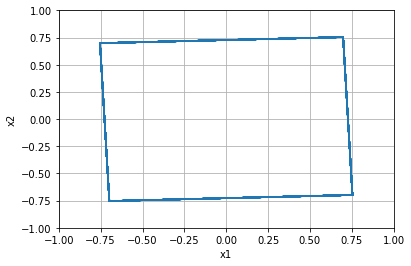


=================== Rollout 449 =====================
x_init [[-0.68]
 [ 0.64]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.68  0.64]
xx [-0.68  0.64]
xxx [-0.68  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.6400000000000001]


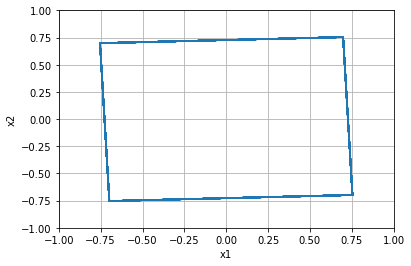


=================== Rollout 450 =====================
x_init [[-0.68]
 [ 0.68]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.68  0.68]
xx [-0.68  0.68]
xxx [-0.68  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.6799999999999999]


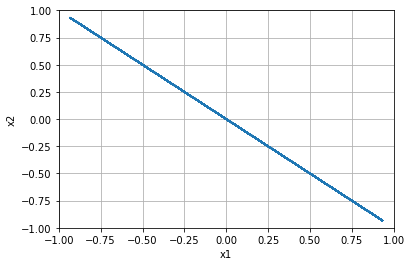


=================== Rollout 451 =====================
x_init [[-0.68]
 [ 0.72]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.68  0.72]
xx [-0.68  0.72]
xxx [-0.68  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.72]


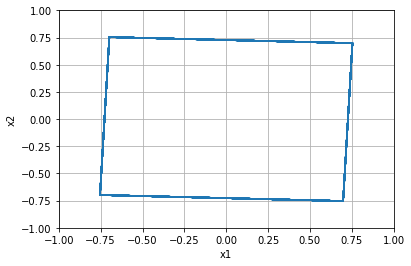


=================== Rollout 452 =====================
x_init [[-0.68]
 [ 0.76]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.68  0.76]
xx [-0.68  0.76]
xxx [-0.68  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.76]


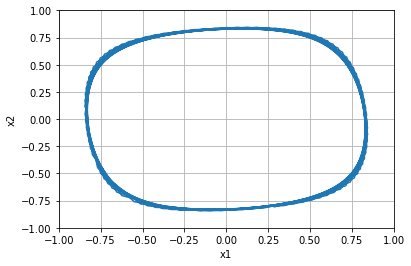


=================== Rollout 453 =====================
x_init [[-0.68]
 [ 0.8 ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.68  0.8 ]
xx [-0.68  0.8 ]
xxx [-0.68  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.8]


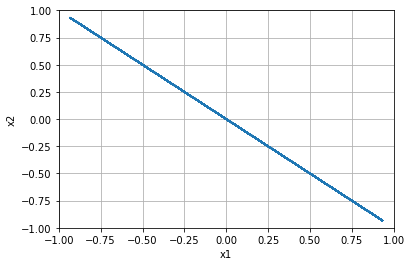


=================== Rollout 454 =====================
x_init [[-0.68]
 [ 0.84]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.68  0.84]
xx [-0.68  0.84]
xxx [-0.68  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.8400000000000001]


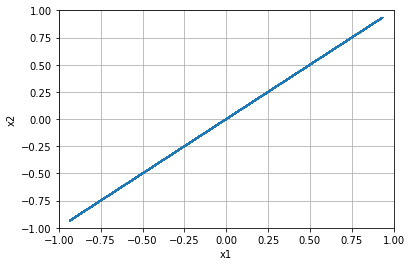


=================== Rollout 455 =====================
x_init [[-0.68]
 [ 0.88]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.68  0.88]
xx [-0.68  0.88]
xxx [-0.68  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.8800000000000001]


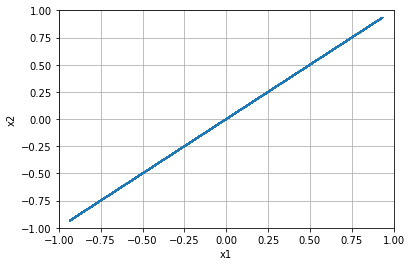


=================== Rollout 456 =====================
x_init [[-0.68]
 [ 0.92]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.68  0.92]
xx [-0.68  0.92]
xxx [-0.68  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.9199999999999999]


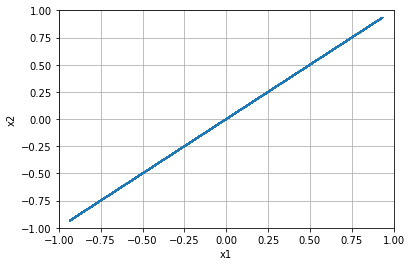


=================== Rollout 457 =====================
x_init [[-0.68]
 [ 0.96]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.68  0.96]
xx [-0.68  0.96]
xxx [-0.68  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 0.96]


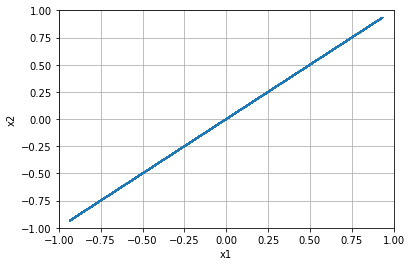


=================== Rollout 458 =====================
x_init [[-0.68]
 [ 1.  ]]
x_buffer [[-0.68 -0.68 -0.68 -0.68 -0.68]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.68  1.  ]
xx [-0.68  1.  ]
xxx [-0.68  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6799999999999999, 1.0]


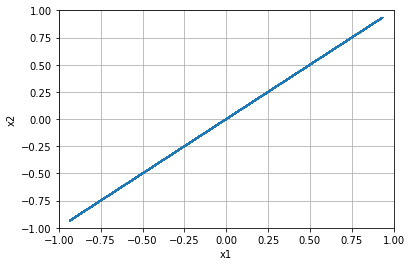


=================== Rollout 459 =====================
x_init [[-0.64]
 [-1.  ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.64 -1.  ]
xx [-0.64 -1.  ]
xxx [-0.64 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -1.0]


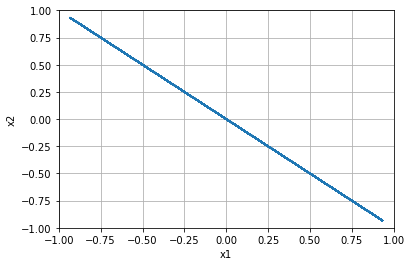


=================== Rollout 460 =====================
x_init [[-0.64]
 [-0.96]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.64 -0.96]
xx [-0.64 -0.96]
xxx [-0.64 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.96]


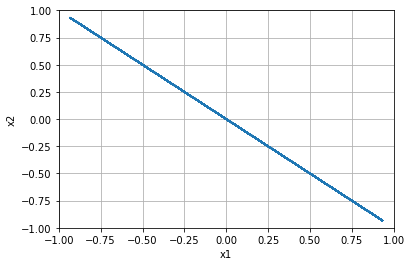


=================== Rollout 461 =====================
x_init [[-0.64]
 [-0.92]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.64 -0.92]
xx [-0.64 -0.92]
xxx [-0.64 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.92]


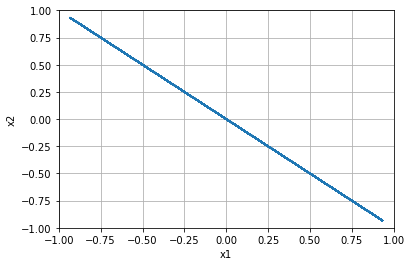


=================== Rollout 462 =====================
x_init [[-0.64]
 [-0.88]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.64 -0.88]
xx [-0.64 -0.88]
xxx [-0.64 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.88]


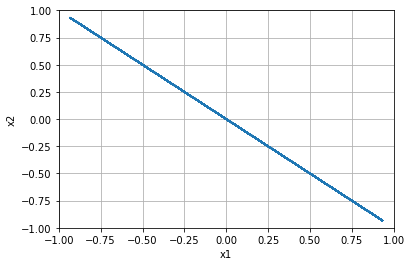


=================== Rollout 463 =====================
x_init [[-0.64]
 [-0.84]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.64 -0.84]
xx [-0.64 -0.84]
xxx [-0.64 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.84]


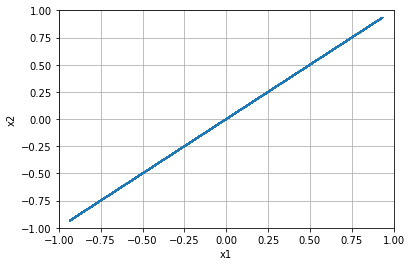


=================== Rollout 464 =====================
x_init [[-0.64]
 [-0.8 ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.64 -0.8 ]
xx [-0.64 -0.8 ]
xxx [-0.64 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.8]


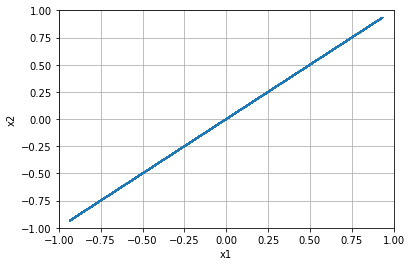


=================== Rollout 465 =====================
x_init [[-0.64]
 [-0.76]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.64 -0.76]
xx [-0.64 -0.76]
xxx [-0.64 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.76]


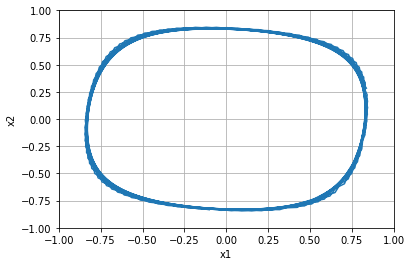


=================== Rollout 466 =====================
x_init [[-0.64]
 [-0.72]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.64 -0.72]
xx [-0.64 -0.72]
xxx [-0.64 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.72]


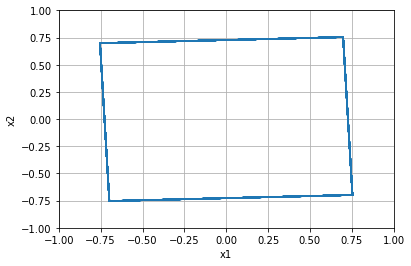


=================== Rollout 467 =====================
x_init [[-0.64]
 [-0.68]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.64 -0.68]
xx [-0.64 -0.68]
xxx [-0.64 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.6799999999999999]


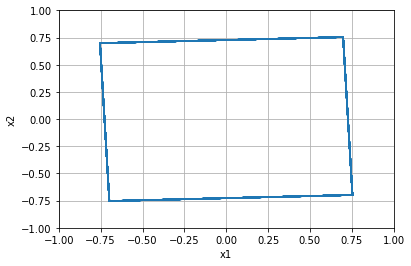


=================== Rollout 468 =====================
x_init [[-0.64]
 [-0.64]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.64 -0.64]
xx [-0.64 -0.64]
xxx [-0.64 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.64]


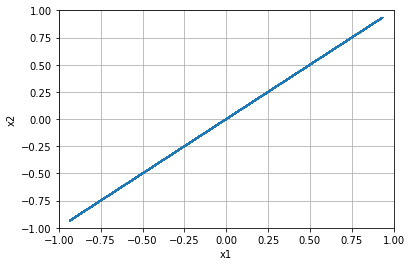


=================== Rollout 469 =====================
x_init [[-0.64]
 [-0.6 ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.64 -0.6 ]
xx [-0.64 -0.6 ]
xxx [-0.64 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.6]


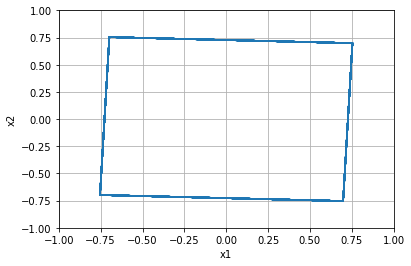


=================== Rollout 470 =====================
x_init [[-0.64]
 [-0.56]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.64 -0.56]
xx [-0.64 -0.56]
xxx [-0.64 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.56]


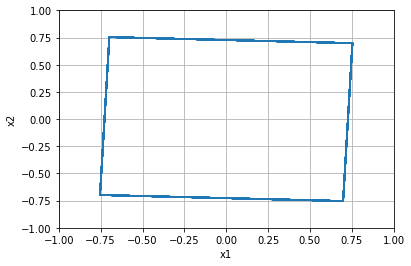


=================== Rollout 471 =====================
x_init [[-0.64]
 [-0.52]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.64 -0.52]
xx [-0.64 -0.52]
xxx [-0.64 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.52]


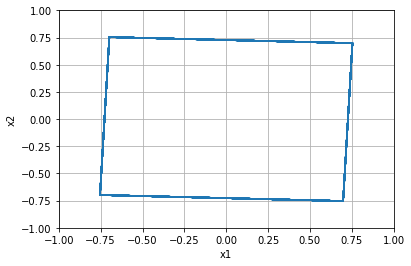


=================== Rollout 472 =====================
x_init [[-0.64]
 [-0.48]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.64 -0.48]
xx [-0.64 -0.48]
xxx [-0.64 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.48]


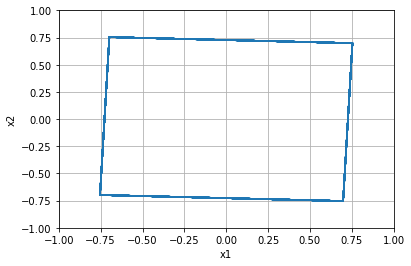


=================== Rollout 473 =====================
x_init [[-0.64]
 [-0.44]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.64 -0.44]
xx [-0.64 -0.44]
xxx [-0.64 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.43999999999999995]


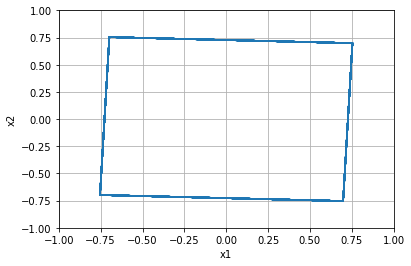


=================== Rollout 474 =====================
x_init [[-0.64]
 [-0.4 ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.64 -0.4 ]
xx [-0.64 -0.4 ]
xxx [-0.64 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.4]


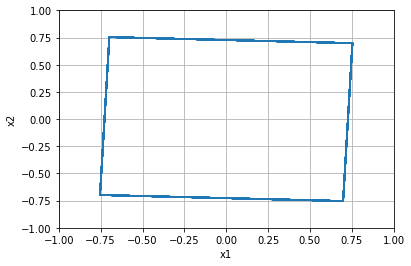


=================== Rollout 475 =====================
x_init [[-0.64]
 [-0.36]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.64 -0.36]
xx [-0.64 -0.36]
xxx [-0.64 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.36]


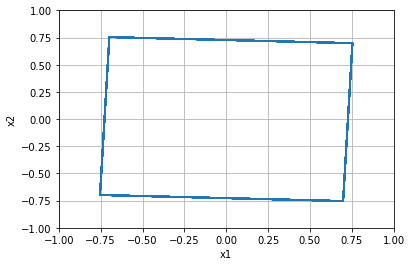


=================== Rollout 476 =====================
x_init [[-0.64]
 [-0.32]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.64 -0.32]
xx [-0.64 -0.32]
xxx [-0.64 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.31999999999999995]


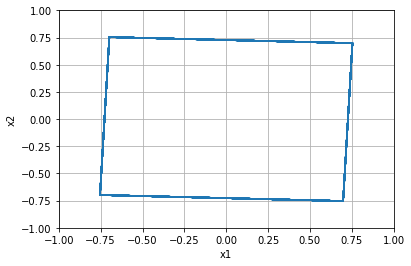


=================== Rollout 477 =====================
x_init [[-0.64]
 [-0.28]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.64 -0.28]
xx [-0.64 -0.28]
xxx [-0.64 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.28]


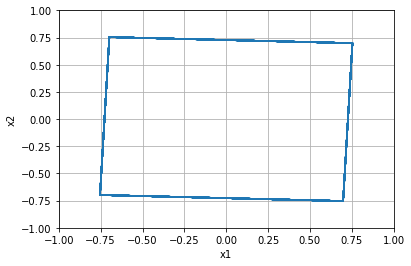


=================== Rollout 478 =====================
x_init [[-0.64]
 [-0.24]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.64 -0.24]
xx [-0.64 -0.24]
xxx [-0.64 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.24]


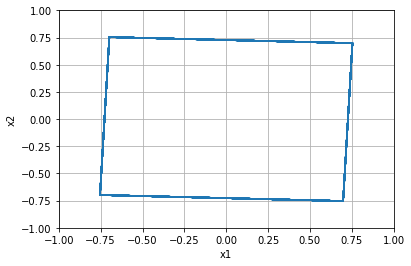


=================== Rollout 479 =====================
x_init [[-0.64]
 [-0.2 ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.64 -0.2 ]
xx [-0.64 -0.2 ]
xxx [-0.64 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.19999999999999996]


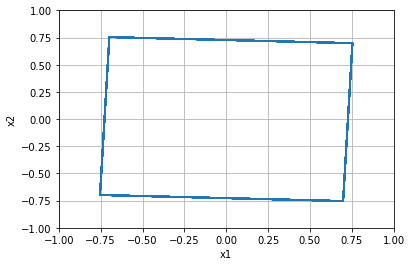


=================== Rollout 480 =====================
x_init [[-0.64]
 [-0.16]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.64 -0.16]
xx [-0.64 -0.16]
xxx [-0.64 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.16000000000000003]


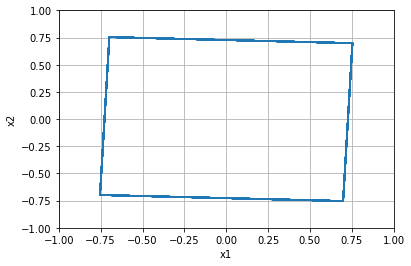


=================== Rollout 481 =====================
x_init [[-0.64]
 [-0.12]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.64 -0.12]
xx [-0.64 -0.12]
xxx [-0.64 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.12]


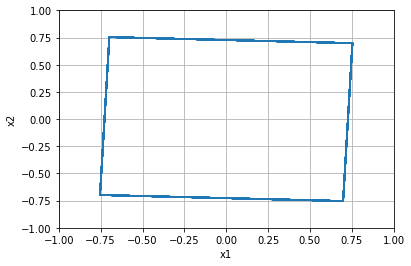


=================== Rollout 482 =====================
x_init [[-0.64]
 [-0.08]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.64 -0.08]
xx [-0.64 -0.08]
xxx [-0.64 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.07999999999999996]


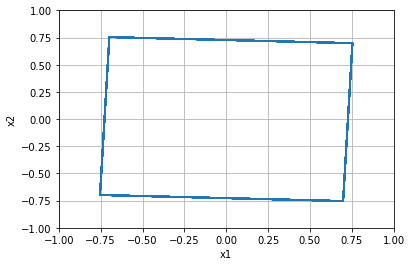


=================== Rollout 483 =====================
x_init [[-0.64]
 [-0.04]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.64 -0.04]
xx [-0.64 -0.04]
xxx [-0.64 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, -0.040000000000000036]


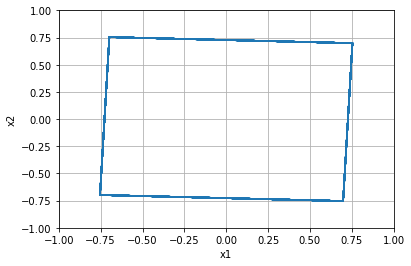


=================== Rollout 484 =====================
x_init [[-0.64]
 [ 0.  ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.64  0.  ]
xx [-0.64  0.  ]
xxx [-0.64  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.0]


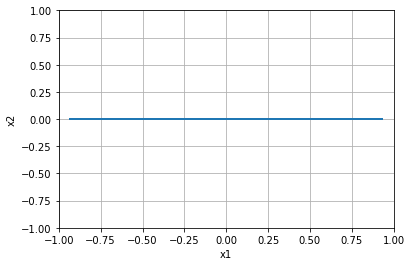


=================== Rollout 485 =====================
x_init [[-0.64]
 [ 0.04]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.64  0.04]
xx [-0.64  0.04]
xxx [-0.64  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.040000000000000036]


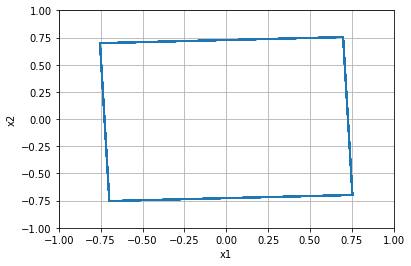


=================== Rollout 486 =====================
x_init [[-0.64]
 [ 0.08]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.64  0.08]
xx [-0.64  0.08]
xxx [-0.64  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.08000000000000007]


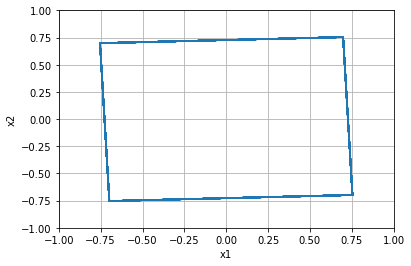


=================== Rollout 487 =====================
x_init [[-0.64]
 [ 0.12]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.64  0.12]
xx [-0.64  0.12]
xxx [-0.64  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.1200000000000001]


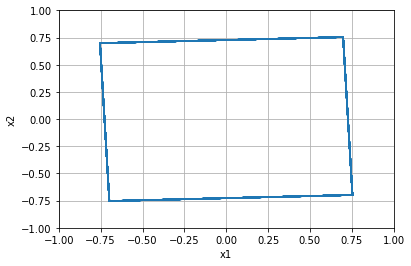


=================== Rollout 488 =====================
x_init [[-0.64]
 [ 0.16]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.64  0.16]
xx [-0.64  0.16]
xxx [-0.64  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.15999999999999992]


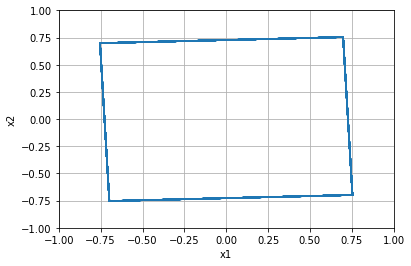


=================== Rollout 489 =====================
x_init [[-0.64]
 [ 0.2 ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.64  0.2 ]
xx [-0.64  0.2 ]
xxx [-0.64  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.19999999999999996]


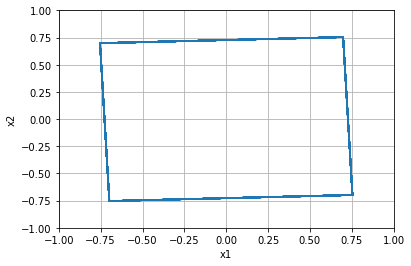


=================== Rollout 490 =====================
x_init [[-0.64]
 [ 0.24]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.64  0.24]
xx [-0.64  0.24]
xxx [-0.64  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.24]


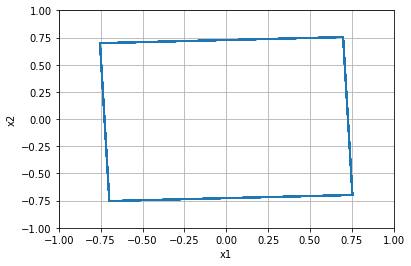


=================== Rollout 491 =====================
x_init [[-0.64]
 [ 0.28]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.64  0.28]
xx [-0.64  0.28]
xxx [-0.64  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.28]


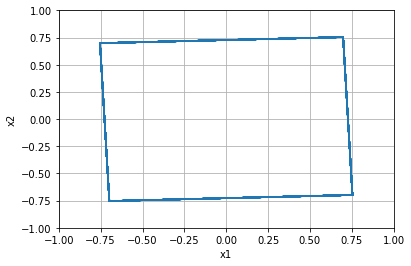


=================== Rollout 492 =====================
x_init [[-0.64]
 [ 0.32]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.64  0.32]
xx [-0.64  0.32]
xxx [-0.64  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.32000000000000006]


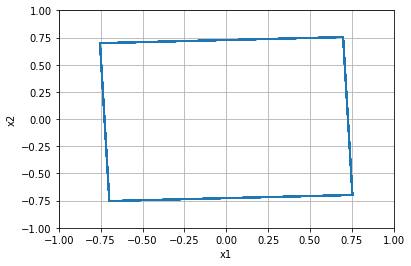


=================== Rollout 493 =====================
x_init [[-0.64]
 [ 0.36]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.64  0.36]
xx [-0.64  0.36]
xxx [-0.64  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.3600000000000001]


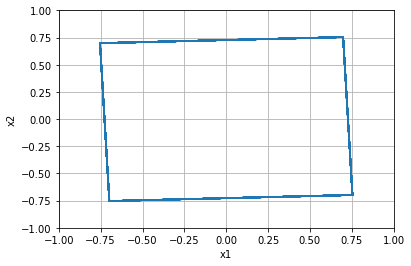


=================== Rollout 494 =====================
x_init [[-0.64]
 [ 0.4 ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.64  0.4 ]
xx [-0.64  0.4 ]
xxx [-0.64  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.40000000000000013]


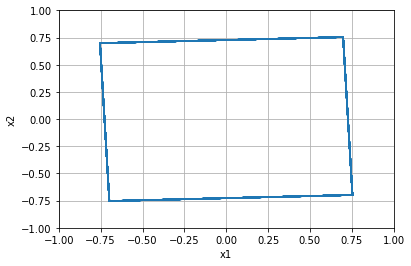


=================== Rollout 495 =====================
x_init [[-0.64]
 [ 0.44]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.64  0.44]
xx [-0.64  0.44]
xxx [-0.64  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.43999999999999995]


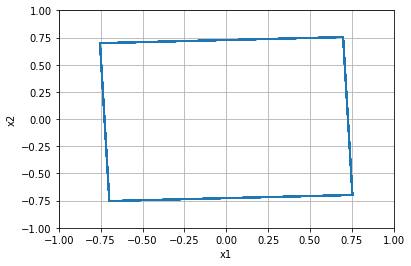


=================== Rollout 496 =====================
x_init [[-0.64]
 [ 0.48]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.64  0.48]
xx [-0.64  0.48]
xxx [-0.64  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.48]


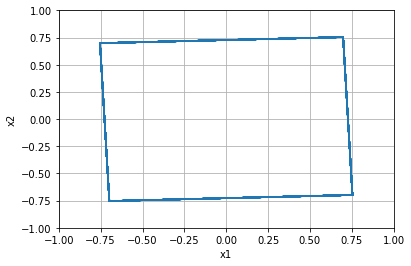


=================== Rollout 497 =====================
x_init [[-0.64]
 [ 0.52]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.64  0.52]
xx [-0.64  0.52]
xxx [-0.64  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.52]


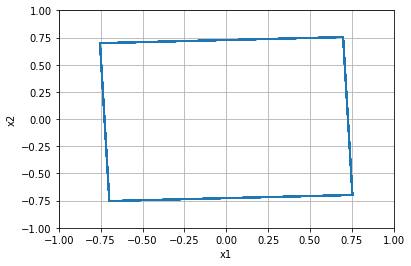


=================== Rollout 498 =====================
x_init [[-0.64]
 [ 0.56]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.64  0.56]
xx [-0.64  0.56]
xxx [-0.64  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.56]


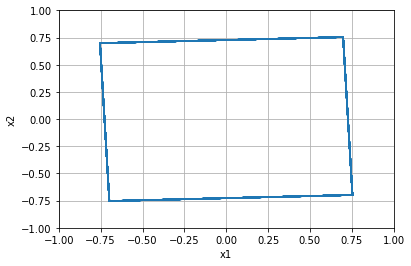


=================== Rollout 499 =====================
x_init [[-0.64]
 [ 0.6 ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.64  0.6 ]
xx [-0.64  0.6 ]
xxx [-0.64  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.6000000000000001]


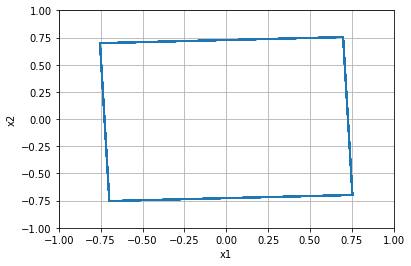


=================== Rollout 500 =====================
x_init [[-0.64]
 [ 0.64]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.64  0.64]
xx [-0.64  0.64]
xxx [-0.64  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.6400000000000001]


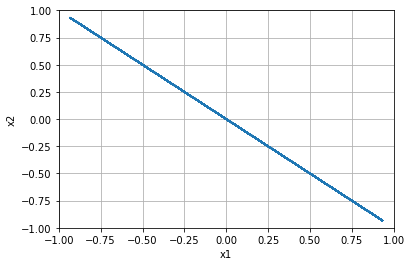


=================== Rollout 501 =====================
x_init [[-0.64]
 [ 0.68]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.64  0.68]
xx [-0.64  0.68]
xxx [-0.64  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.6799999999999999]


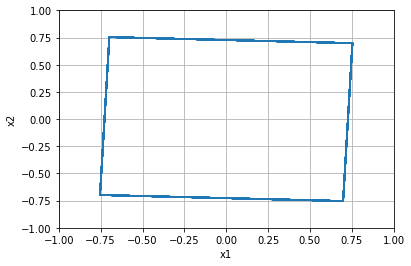


=================== Rollout 502 =====================
x_init [[-0.64]
 [ 0.72]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.64  0.72]
xx [-0.64  0.72]
xxx [-0.64  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.72]


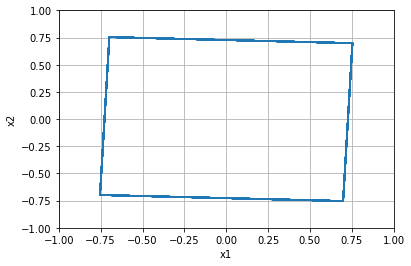


=================== Rollout 503 =====================
x_init [[-0.64]
 [ 0.76]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.64  0.76]
xx [-0.64  0.76]
xxx [-0.64  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.76]


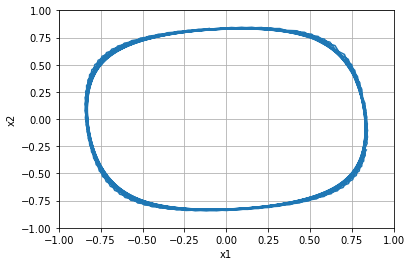


=================== Rollout 504 =====================
x_init [[-0.64]
 [ 0.8 ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.64  0.8 ]
xx [-0.64  0.8 ]
xxx [-0.64  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.8]


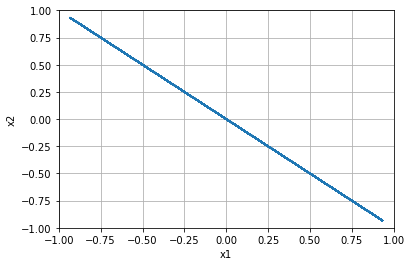


=================== Rollout 505 =====================
x_init [[-0.64]
 [ 0.84]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.64  0.84]
xx [-0.64  0.84]
xxx [-0.64  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.8400000000000001]


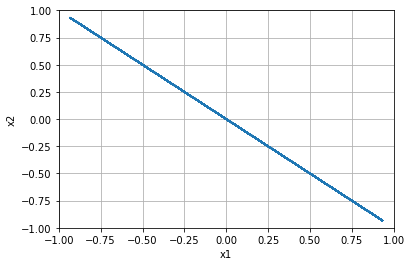


=================== Rollout 506 =====================
x_init [[-0.64]
 [ 0.88]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.64  0.88]
xx [-0.64  0.88]
xxx [-0.64  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.8800000000000001]


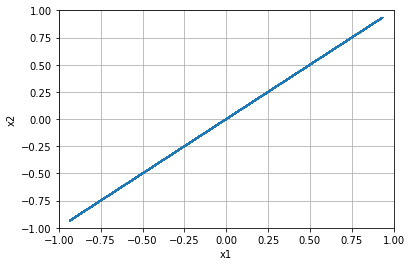


=================== Rollout 507 =====================
x_init [[-0.64]
 [ 0.92]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.64  0.92]
xx [-0.64  0.92]
xxx [-0.64  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.9199999999999999]


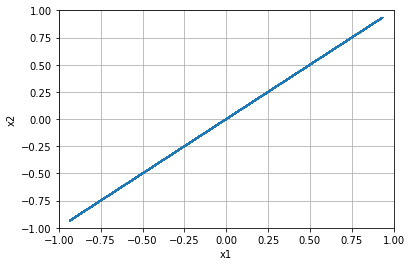


=================== Rollout 508 =====================
x_init [[-0.64]
 [ 0.96]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.64  0.96]
xx [-0.64  0.96]
xxx [-0.64  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 0.96]


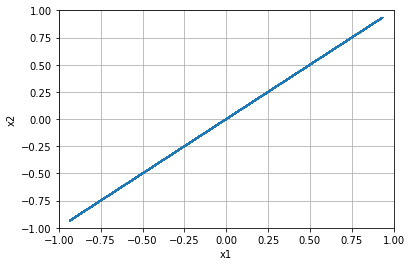


=================== Rollout 509 =====================
x_init [[-0.64]
 [ 1.  ]]
x_buffer [[-0.64 -0.64 -0.64 -0.64 -0.64]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.64  1.  ]
xx [-0.64  1.  ]
xxx [-0.64  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.64, 1.0]


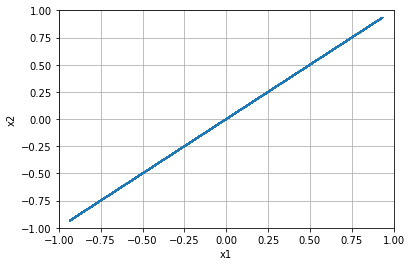


=================== Rollout 510 =====================
x_init [[-0.6]
 [-1. ]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [-1.  -1.  -1.  -1.  -1. ]]
x [-0.6 -1. ]
xx [-0.6 -1. ]
xxx [-0.6 -1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -1.0]


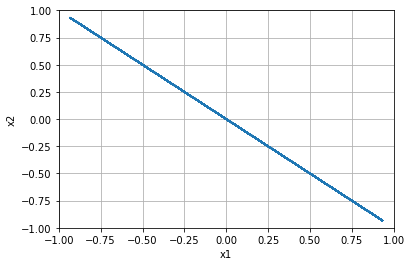


=================== Rollout 511 =====================
x_init [[-0.6 ]
 [-0.96]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.6  -0.96]
xx [-0.6  -0.96]
xxx [-0.6  -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.96]


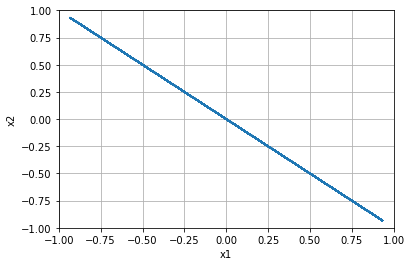


=================== Rollout 512 =====================
x_init [[-0.6 ]
 [-0.92]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.6  -0.92]
xx [-0.6  -0.92]
xxx [-0.6  -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.92]


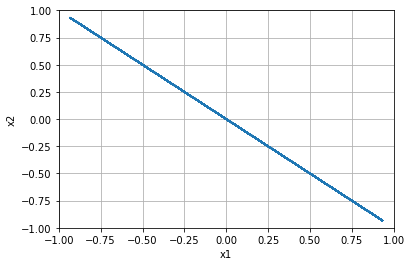


=================== Rollout 513 =====================
x_init [[-0.6 ]
 [-0.88]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.6  -0.88]
xx [-0.6  -0.88]
xxx [-0.6  -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.88]


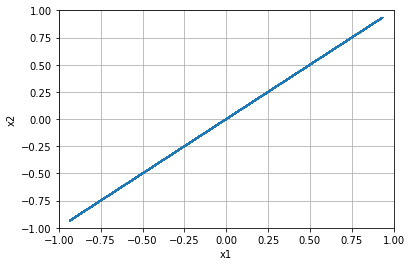


=================== Rollout 514 =====================
x_init [[-0.6 ]
 [-0.84]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.6  -0.84]
xx [-0.6  -0.84]
xxx [-0.6  -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.84]


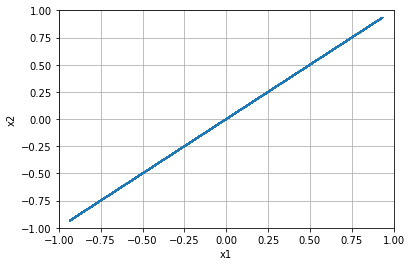


=================== Rollout 515 =====================
x_init [[-0.6]
 [-0.8]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [-0.6 -0.8]
xx [-0.6 -0.8]
xxx [-0.6 -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.8]


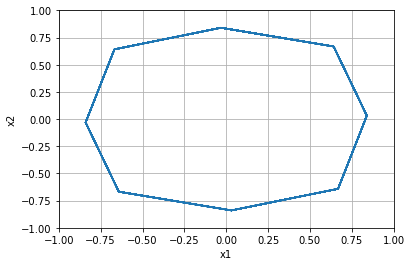


=================== Rollout 516 =====================
x_init [[-0.6 ]
 [-0.76]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.6  -0.76]
xx [-0.6  -0.76]
xxx [-0.6  -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.76]


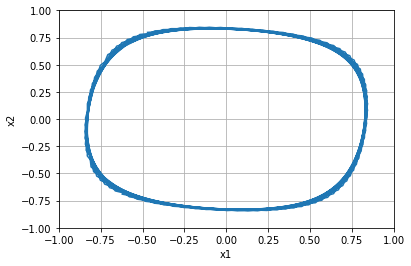


=================== Rollout 517 =====================
x_init [[-0.6 ]
 [-0.72]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.6  -0.72]
xx [-0.6  -0.72]
xxx [-0.6  -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.72]


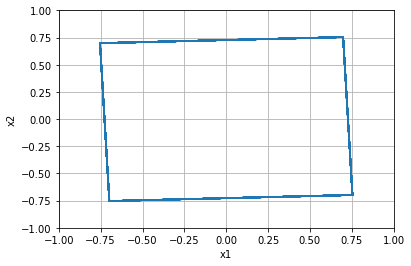


=================== Rollout 518 =====================
x_init [[-0.6 ]
 [-0.68]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.6  -0.68]
xx [-0.6  -0.68]
xxx [-0.6  -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.6799999999999999]


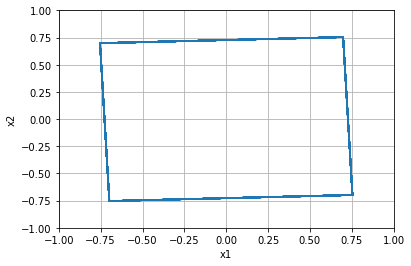


=================== Rollout 519 =====================
x_init [[-0.6 ]
 [-0.64]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.6  -0.64]
xx [-0.6  -0.64]
xxx [-0.6  -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.64]


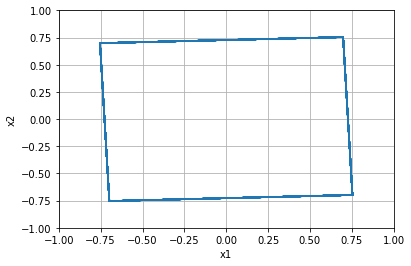


=================== Rollout 520 =====================
x_init [[-0.6]
 [-0.6]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [-0.6 -0.6]
xx [-0.6 -0.6]
xxx [-0.6 -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.6]


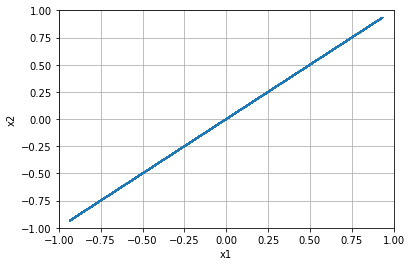


=================== Rollout 521 =====================
x_init [[-0.6 ]
 [-0.56]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.6  -0.56]
xx [-0.6  -0.56]
xxx [-0.6  -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.56]


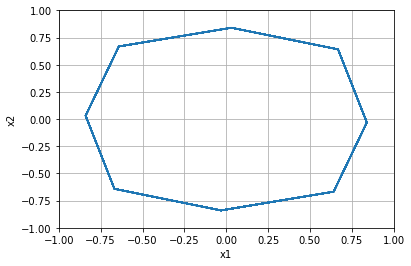


=================== Rollout 522 =====================
x_init [[-0.6 ]
 [-0.52]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.6  -0.52]
xx [-0.6  -0.52]
xxx [-0.6  -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.52]


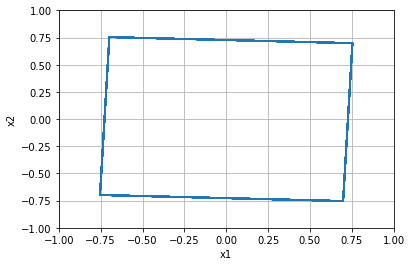


=================== Rollout 523 =====================
x_init [[-0.6 ]
 [-0.48]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.6  -0.48]
xx [-0.6  -0.48]
xxx [-0.6  -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.48]


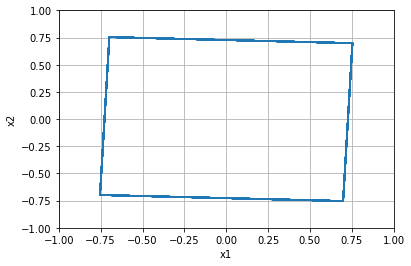


=================== Rollout 524 =====================
x_init [[-0.6 ]
 [-0.44]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.6  -0.44]
xx [-0.6  -0.44]
xxx [-0.6  -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.43999999999999995]


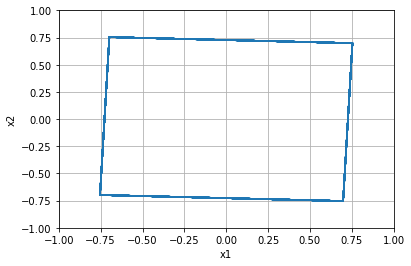


=================== Rollout 525 =====================
x_init [[-0.6]
 [-0.4]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [-0.6 -0.4]
xx [-0.6 -0.4]
xxx [-0.6 -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.4]


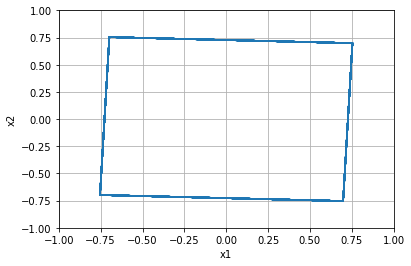


=================== Rollout 526 =====================
x_init [[-0.6 ]
 [-0.36]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.6  -0.36]
xx [-0.6  -0.36]
xxx [-0.6  -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.36]


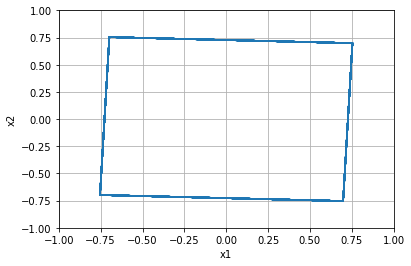


=================== Rollout 527 =====================
x_init [[-0.6 ]
 [-0.32]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.6  -0.32]
xx [-0.6  -0.32]
xxx [-0.6  -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.31999999999999995]


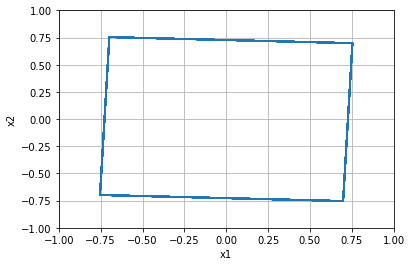


=================== Rollout 528 =====================
x_init [[-0.6 ]
 [-0.28]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.6  -0.28]
xx [-0.6  -0.28]
xxx [-0.6  -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.28]


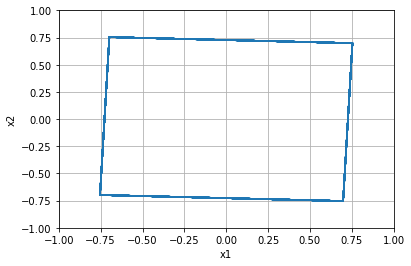


=================== Rollout 529 =====================
x_init [[-0.6 ]
 [-0.24]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.6  -0.24]
xx [-0.6  -0.24]
xxx [-0.6  -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.24]


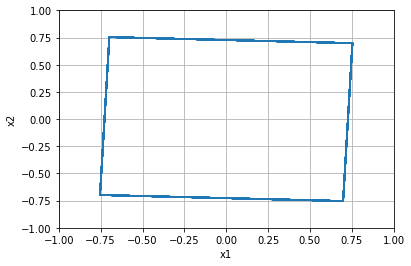


=================== Rollout 530 =====================
x_init [[-0.6]
 [-0.2]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [-0.6 -0.2]
xx [-0.6 -0.2]
xxx [-0.6 -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.19999999999999996]


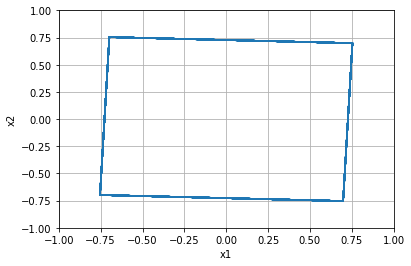


=================== Rollout 531 =====================
x_init [[-0.6 ]
 [-0.16]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.6  -0.16]
xx [-0.6  -0.16]
xxx [-0.6  -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.16000000000000003]


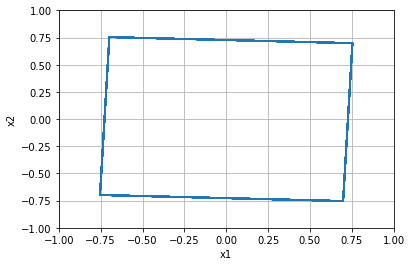


=================== Rollout 532 =====================
x_init [[-0.6 ]
 [-0.12]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.6  -0.12]
xx [-0.6  -0.12]
xxx [-0.6  -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.12]


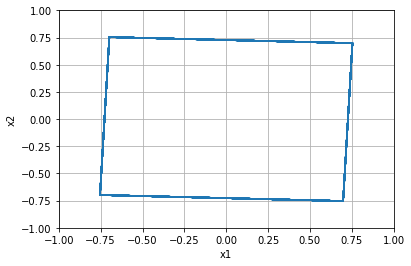


=================== Rollout 533 =====================
x_init [[-0.6 ]
 [-0.08]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.6  -0.08]
xx [-0.6  -0.08]
xxx [-0.6  -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.07999999999999996]


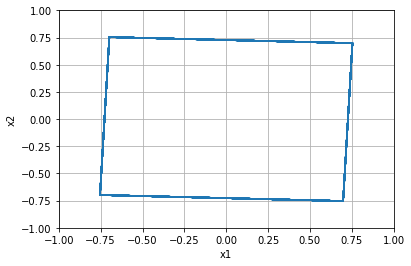


=================== Rollout 534 =====================
x_init [[-0.6 ]
 [-0.04]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.6  -0.04]
xx [-0.6  -0.04]
xxx [-0.6  -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, -0.040000000000000036]


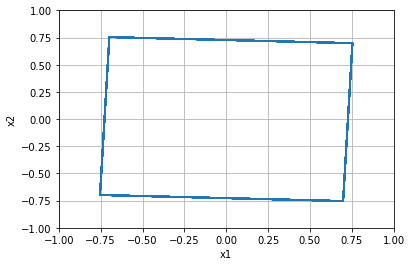


=================== Rollout 535 =====================
x_init [[-0.6]
 [ 0. ]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [ 0.   0.   0.   0.   0. ]]
x [-0.6  0. ]
xx [-0.6  0. ]
xxx [-0.6  0. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.0]


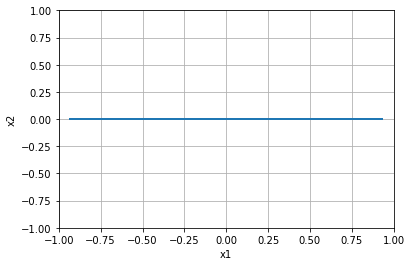


=================== Rollout 536 =====================
x_init [[-0.6 ]
 [ 0.04]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.6   0.04]
xx [-0.6   0.04]
xxx [-0.6   0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.040000000000000036]


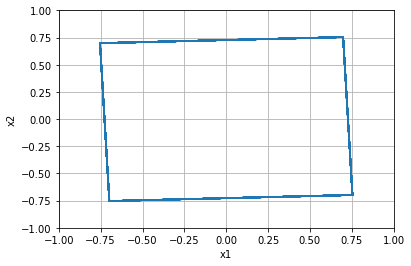


=================== Rollout 537 =====================
x_init [[-0.6 ]
 [ 0.08]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.6   0.08]
xx [-0.6   0.08]
xxx [-0.6   0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.08000000000000007]


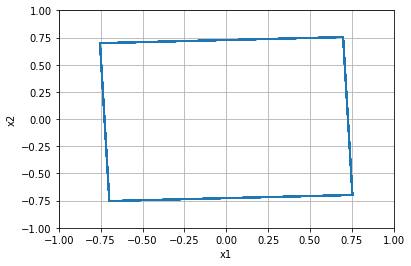


=================== Rollout 538 =====================
x_init [[-0.6 ]
 [ 0.12]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.6   0.12]
xx [-0.6   0.12]
xxx [-0.6   0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.1200000000000001]


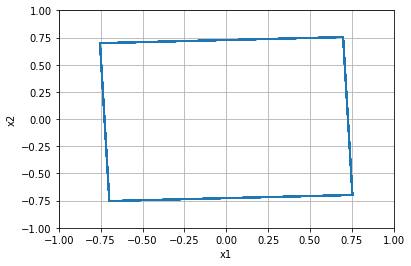


=================== Rollout 539 =====================
x_init [[-0.6 ]
 [ 0.16]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.6   0.16]
xx [-0.6   0.16]
xxx [-0.6   0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.15999999999999992]


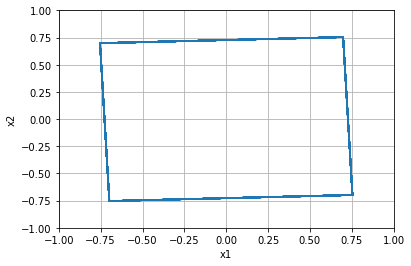


=================== Rollout 540 =====================
x_init [[-0.6]
 [ 0.2]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [ 0.2  0.2  0.2  0.2  0.2]]
x [-0.6  0.2]
xx [-0.6  0.2]
xxx [-0.6  0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.19999999999999996]


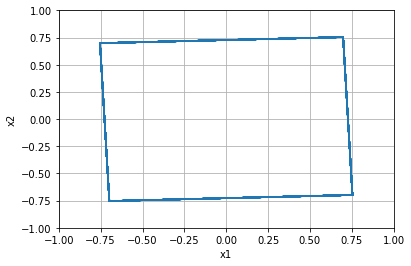


=================== Rollout 541 =====================
x_init [[-0.6 ]
 [ 0.24]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.6   0.24]
xx [-0.6   0.24]
xxx [-0.6   0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.24]


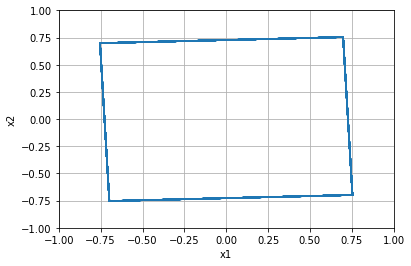


=================== Rollout 542 =====================
x_init [[-0.6 ]
 [ 0.28]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.6   0.28]
xx [-0.6   0.28]
xxx [-0.6   0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.28]


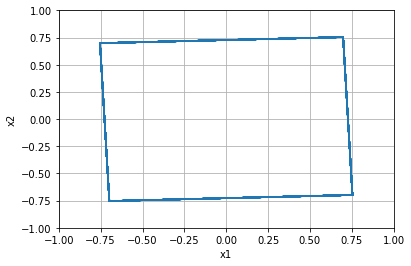


=================== Rollout 543 =====================
x_init [[-0.6 ]
 [ 0.32]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.6   0.32]
xx [-0.6   0.32]
xxx [-0.6   0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.32000000000000006]


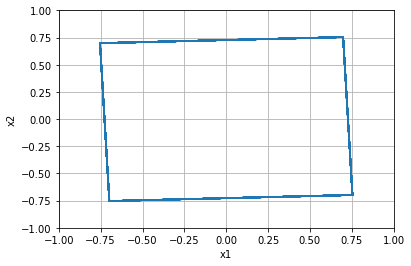


=================== Rollout 544 =====================
x_init [[-0.6 ]
 [ 0.36]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.6   0.36]
xx [-0.6   0.36]
xxx [-0.6   0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.3600000000000001]


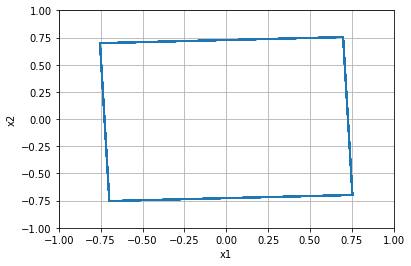


=================== Rollout 545 =====================
x_init [[-0.6]
 [ 0.4]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [ 0.4  0.4  0.4  0.4  0.4]]
x [-0.6  0.4]
xx [-0.6  0.4]
xxx [-0.6  0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.40000000000000013]


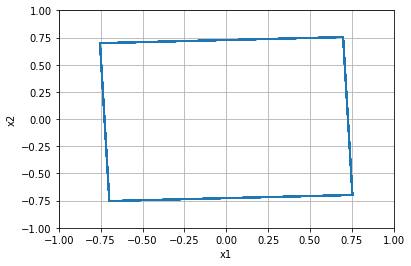


=================== Rollout 546 =====================
x_init [[-0.6 ]
 [ 0.44]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.6   0.44]
xx [-0.6   0.44]
xxx [-0.6   0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.43999999999999995]


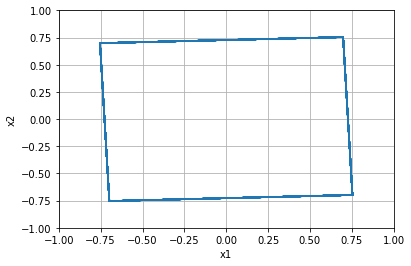


=================== Rollout 547 =====================
x_init [[-0.6 ]
 [ 0.48]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.6   0.48]
xx [-0.6   0.48]
xxx [-0.6   0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.48]


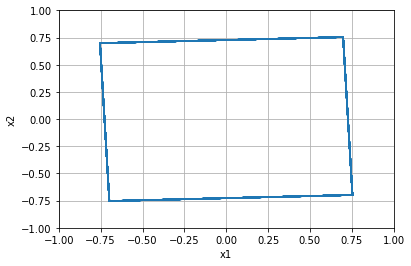


=================== Rollout 548 =====================
x_init [[-0.6 ]
 [ 0.52]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.6   0.52]
xx [-0.6   0.52]
xxx [-0.6   0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.52]


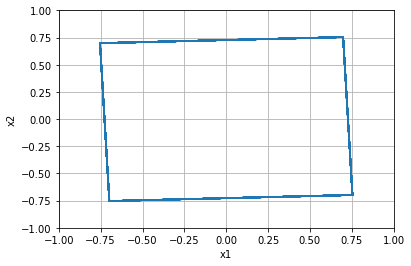


=================== Rollout 549 =====================
x_init [[-0.6 ]
 [ 0.56]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.6   0.56]
xx [-0.6   0.56]
xxx [-0.6   0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.56]


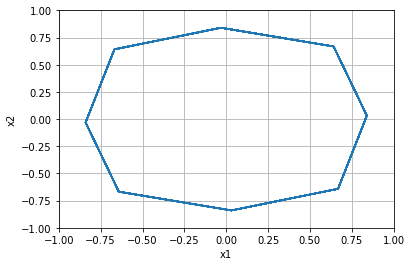


=================== Rollout 550 =====================
x_init [[-0.6]
 [ 0.6]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [ 0.6  0.6  0.6  0.6  0.6]]
x [-0.6  0.6]
xx [-0.6  0.6]
xxx [-0.6  0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.6000000000000001]


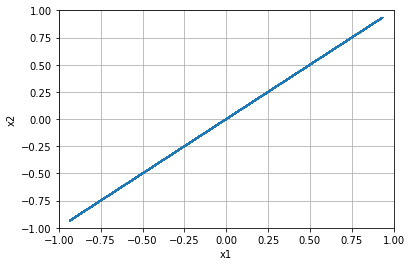


=================== Rollout 551 =====================
x_init [[-0.6 ]
 [ 0.64]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.6   0.64]
xx [-0.6   0.64]
xxx [-0.6   0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.6400000000000001]


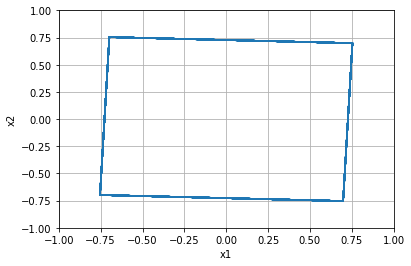


=================== Rollout 552 =====================
x_init [[-0.6 ]
 [ 0.68]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.6   0.68]
xx [-0.6   0.68]
xxx [-0.6   0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.6799999999999999]


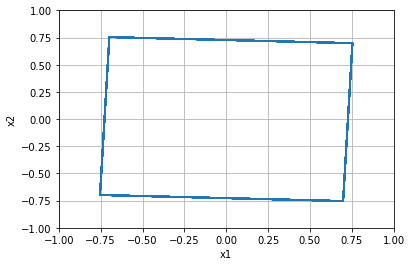


=================== Rollout 553 =====================
x_init [[-0.6 ]
 [ 0.72]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.6   0.72]
xx [-0.6   0.72]
xxx [-0.6   0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.72]


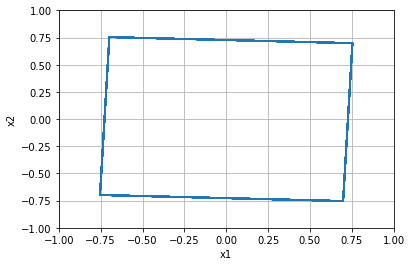


=================== Rollout 554 =====================
x_init [[-0.6 ]
 [ 0.76]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.6   0.76]
xx [-0.6   0.76]
xxx [-0.6   0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.76]


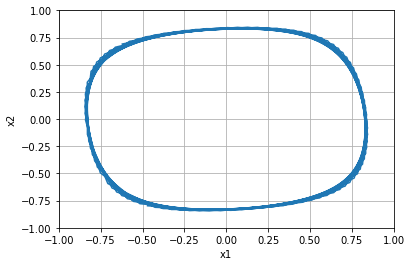


=================== Rollout 555 =====================
x_init [[-0.6]
 [ 0.8]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [ 0.8  0.8  0.8  0.8  0.8]]
x [-0.6  0.8]
xx [-0.6  0.8]
xxx [-0.6  0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.8]


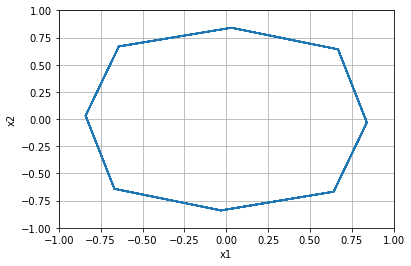


=================== Rollout 556 =====================
x_init [[-0.6 ]
 [ 0.84]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.6   0.84]
xx [-0.6   0.84]
xxx [-0.6   0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.8400000000000001]


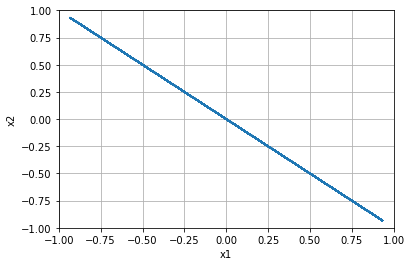


=================== Rollout 557 =====================
x_init [[-0.6 ]
 [ 0.88]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.6   0.88]
xx [-0.6   0.88]
xxx [-0.6   0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.8800000000000001]


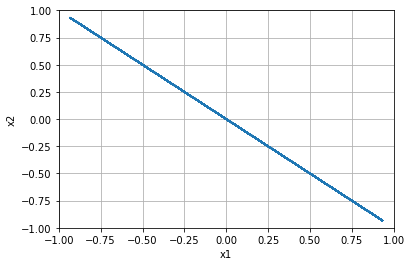


=================== Rollout 558 =====================
x_init [[-0.6 ]
 [ 0.92]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.6   0.92]
xx [-0.6   0.92]
xxx [-0.6   0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.9199999999999999]


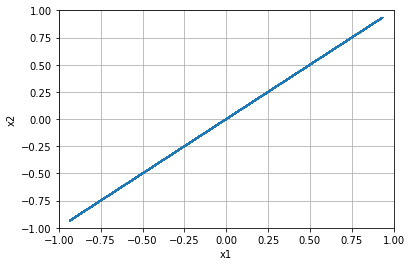


=================== Rollout 559 =====================
x_init [[-0.6 ]
 [ 0.96]]
x_buffer [[-0.6  -0.6  -0.6  -0.6  -0.6 ]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.6   0.96]
xx [-0.6   0.96]
xxx [-0.6   0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 0.96]


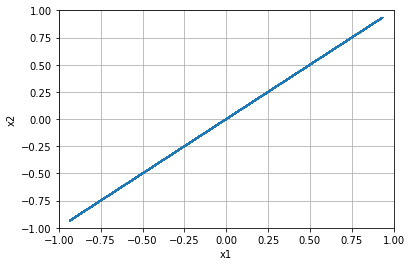


=================== Rollout 560 =====================
x_init [[-0.6]
 [ 1. ]]
x_buffer [[-0.6 -0.6 -0.6 -0.6 -0.6]
 [ 1.   1.   1.   1.   1. ]]
x [-0.6  1. ]
xx [-0.6  1. ]
xxx [-0.6  1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.6, 1.0]


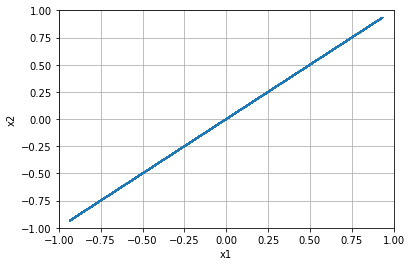


=================== Rollout 561 =====================
x_init [[-0.56]
 [-1.  ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.56 -1.  ]
xx [-0.56 -1.  ]
xxx [-0.56 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -1.0]


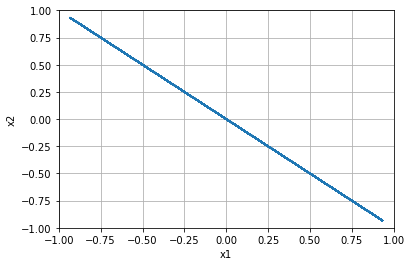


=================== Rollout 562 =====================
x_init [[-0.56]
 [-0.96]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.56 -0.96]
xx [-0.56 -0.96]
xxx [-0.56 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.96]


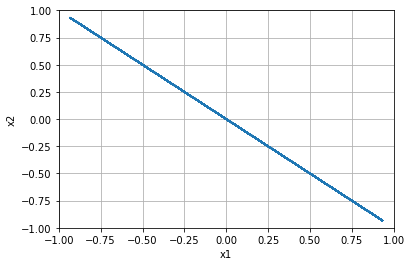


=================== Rollout 563 =====================
x_init [[-0.56]
 [-0.92]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.56 -0.92]
xx [-0.56 -0.92]
xxx [-0.56 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.92]


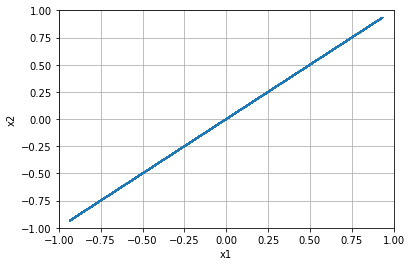


=================== Rollout 564 =====================
x_init [[-0.56]
 [-0.88]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.56 -0.88]
xx [-0.56 -0.88]
xxx [-0.56 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.88]


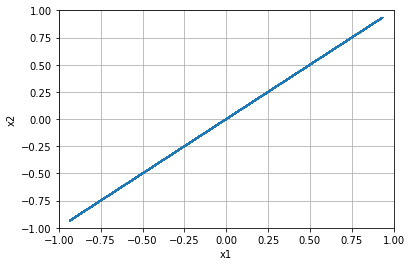


=================== Rollout 565 =====================
x_init [[-0.56]
 [-0.84]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.56 -0.84]
xx [-0.56 -0.84]
xxx [-0.56 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.84]


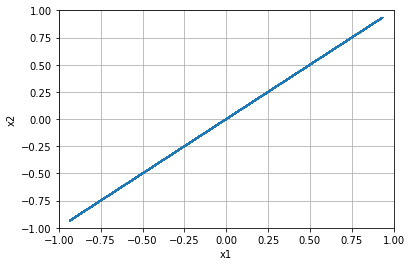


=================== Rollout 566 =====================
x_init [[-0.56]
 [-0.8 ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.56 -0.8 ]
xx [-0.56 -0.8 ]
xxx [-0.56 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.8]


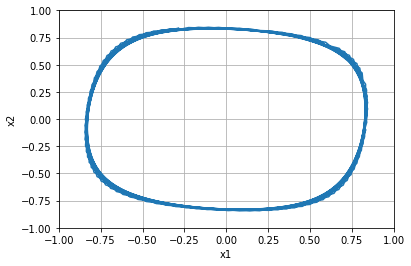


=================== Rollout 567 =====================
x_init [[-0.56]
 [-0.76]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.56 -0.76]
xx [-0.56 -0.76]
xxx [-0.56 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.76]


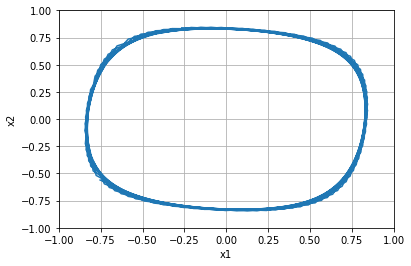


=================== Rollout 568 =====================
x_init [[-0.56]
 [-0.72]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.56 -0.72]
xx [-0.56 -0.72]
xxx [-0.56 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.72]


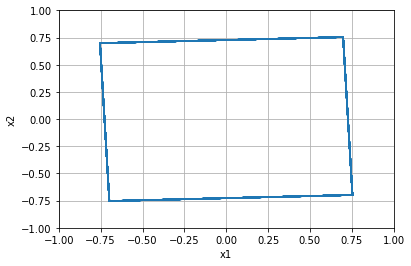


=================== Rollout 569 =====================
x_init [[-0.56]
 [-0.68]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.56 -0.68]
xx [-0.56 -0.68]
xxx [-0.56 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.6799999999999999]


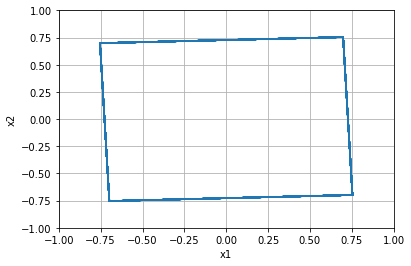


=================== Rollout 570 =====================
x_init [[-0.56]
 [-0.64]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.56 -0.64]
xx [-0.56 -0.64]
xxx [-0.56 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.64]


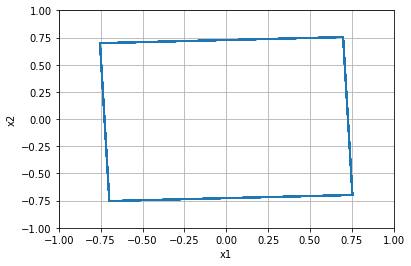


=================== Rollout 571 =====================
x_init [[-0.56]
 [-0.6 ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.56 -0.6 ]
xx [-0.56 -0.6 ]
xxx [-0.56 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.6]


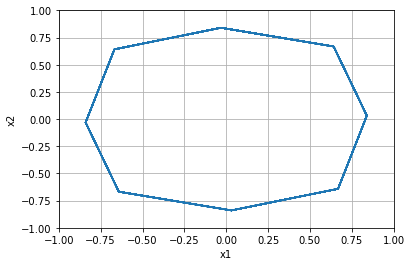


=================== Rollout 572 =====================
x_init [[-0.56]
 [-0.56]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.56 -0.56]
xx [-0.56 -0.56]
xxx [-0.56 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.56]


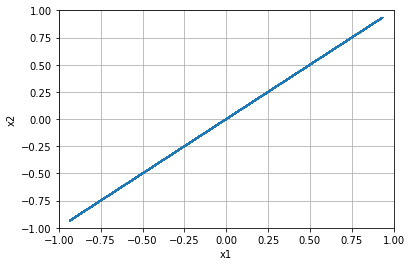


=================== Rollout 573 =====================
x_init [[-0.56]
 [-0.52]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.56 -0.52]
xx [-0.56 -0.52]
xxx [-0.56 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.52]


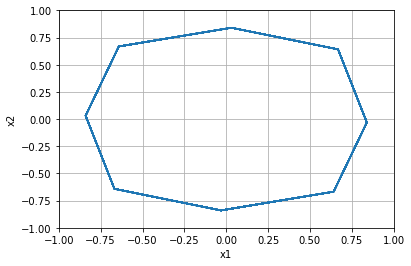


=================== Rollout 574 =====================
x_init [[-0.56]
 [-0.48]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.56 -0.48]
xx [-0.56 -0.48]
xxx [-0.56 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.48]


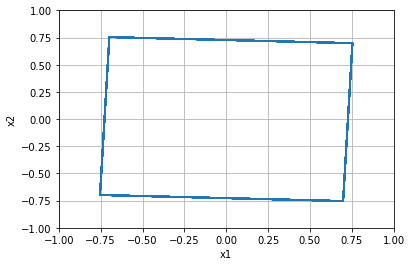


=================== Rollout 575 =====================
x_init [[-0.56]
 [-0.44]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.56 -0.44]
xx [-0.56 -0.44]
xxx [-0.56 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.43999999999999995]


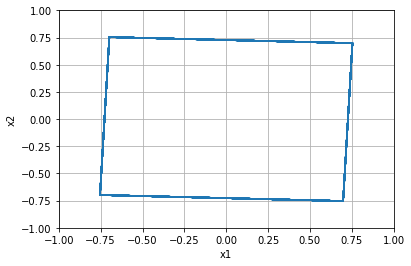


=================== Rollout 576 =====================
x_init [[-0.56]
 [-0.4 ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.56 -0.4 ]
xx [-0.56 -0.4 ]
xxx [-0.56 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.4]


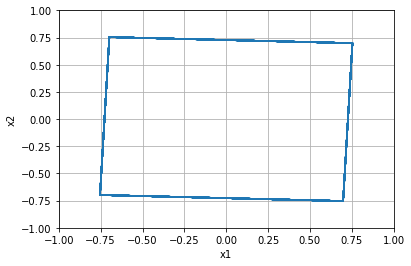


=================== Rollout 577 =====================
x_init [[-0.56]
 [-0.36]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.56 -0.36]
xx [-0.56 -0.36]
xxx [-0.56 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.36]


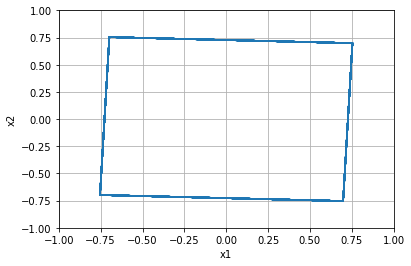


=================== Rollout 578 =====================
x_init [[-0.56]
 [-0.32]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.56 -0.32]
xx [-0.56 -0.32]
xxx [-0.56 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.31999999999999995]


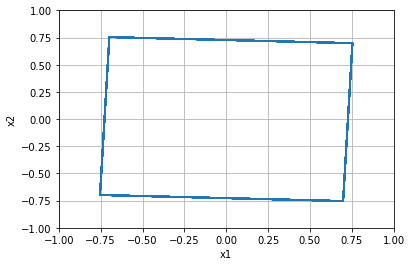


=================== Rollout 579 =====================
x_init [[-0.56]
 [-0.28]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.56 -0.28]
xx [-0.56 -0.28]
xxx [-0.56 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.28]


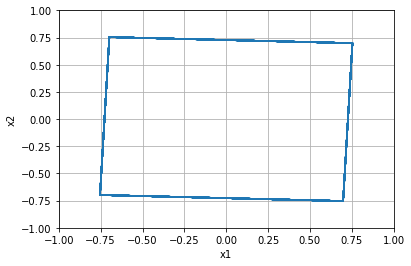


=================== Rollout 580 =====================
x_init [[-0.56]
 [-0.24]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.56 -0.24]
xx [-0.56 -0.24]
xxx [-0.56 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.24]


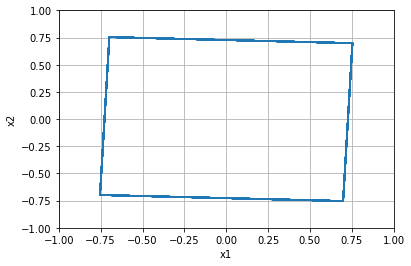


=================== Rollout 581 =====================
x_init [[-0.56]
 [-0.2 ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.56 -0.2 ]
xx [-0.56 -0.2 ]
xxx [-0.56 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.19999999999999996]


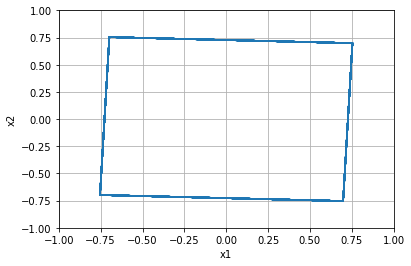


=================== Rollout 582 =====================
x_init [[-0.56]
 [-0.16]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.56 -0.16]
xx [-0.56 -0.16]
xxx [-0.56 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.16000000000000003]


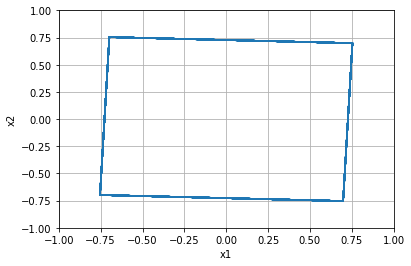


=================== Rollout 583 =====================
x_init [[-0.56]
 [-0.12]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.56 -0.12]
xx [-0.56 -0.12]
xxx [-0.56 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.12]


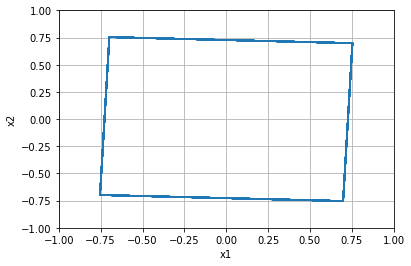


=================== Rollout 584 =====================
x_init [[-0.56]
 [-0.08]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.56 -0.08]
xx [-0.56 -0.08]
xxx [-0.56 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.07999999999999996]


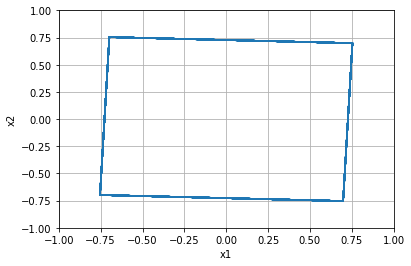


=================== Rollout 585 =====================
x_init [[-0.56]
 [-0.04]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.56 -0.04]
xx [-0.56 -0.04]
xxx [-0.56 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, -0.040000000000000036]


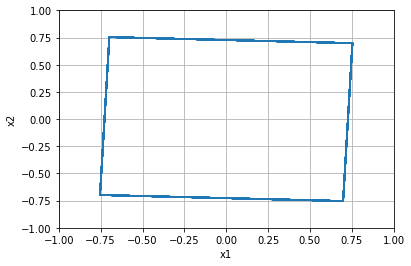


=================== Rollout 586 =====================
x_init [[-0.56]
 [ 0.  ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.56  0.  ]
xx [-0.56  0.  ]
xxx [-0.56  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.0]


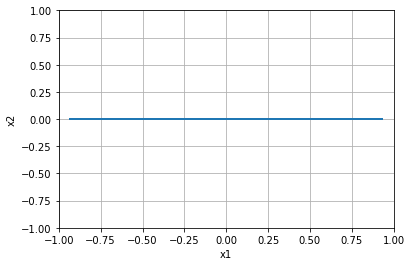


=================== Rollout 587 =====================
x_init [[-0.56]
 [ 0.04]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.56  0.04]
xx [-0.56  0.04]
xxx [-0.56  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.040000000000000036]


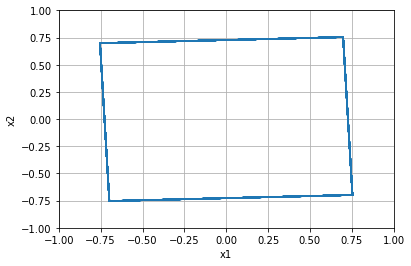


=================== Rollout 588 =====================
x_init [[-0.56]
 [ 0.08]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.56  0.08]
xx [-0.56  0.08]
xxx [-0.56  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.08000000000000007]


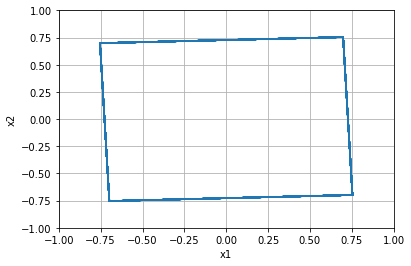


=================== Rollout 589 =====================
x_init [[-0.56]
 [ 0.12]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.56  0.12]
xx [-0.56  0.12]
xxx [-0.56  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.1200000000000001]


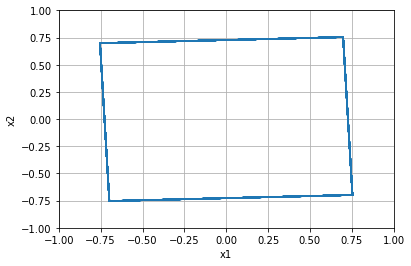


=================== Rollout 590 =====================
x_init [[-0.56]
 [ 0.16]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.56  0.16]
xx [-0.56  0.16]
xxx [-0.56  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.15999999999999992]


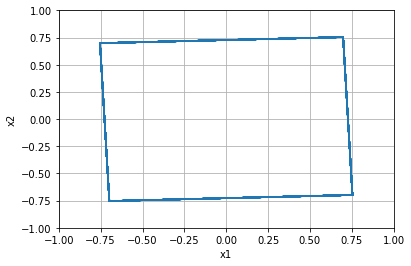


=================== Rollout 591 =====================
x_init [[-0.56]
 [ 0.2 ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.56  0.2 ]
xx [-0.56  0.2 ]
xxx [-0.56  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.19999999999999996]


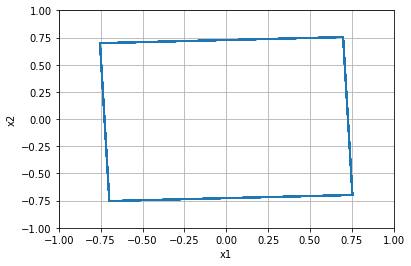


=================== Rollout 592 =====================
x_init [[-0.56]
 [ 0.24]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.56  0.24]
xx [-0.56  0.24]
xxx [-0.56  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.24]


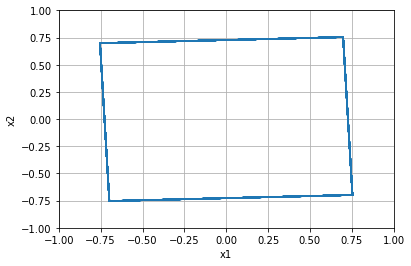


=================== Rollout 593 =====================
x_init [[-0.56]
 [ 0.28]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.56  0.28]
xx [-0.56  0.28]
xxx [-0.56  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.28]


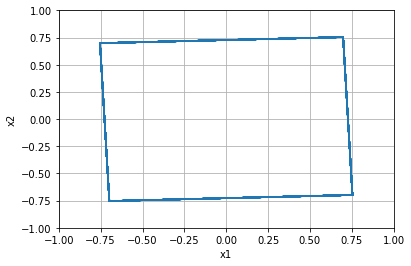


=================== Rollout 594 =====================
x_init [[-0.56]
 [ 0.32]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.56  0.32]
xx [-0.56  0.32]
xxx [-0.56  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.32000000000000006]


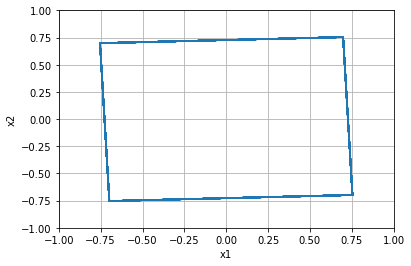


=================== Rollout 595 =====================
x_init [[-0.56]
 [ 0.36]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.56  0.36]
xx [-0.56  0.36]
xxx [-0.56  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.3600000000000001]


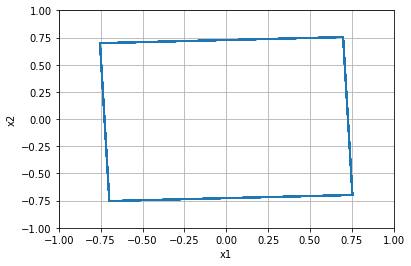


=================== Rollout 596 =====================
x_init [[-0.56]
 [ 0.4 ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.56  0.4 ]
xx [-0.56  0.4 ]
xxx [-0.56  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.40000000000000013]


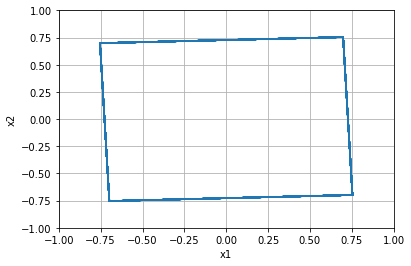


=================== Rollout 597 =====================
x_init [[-0.56]
 [ 0.44]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.56  0.44]
xx [-0.56  0.44]
xxx [-0.56  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.43999999999999995]


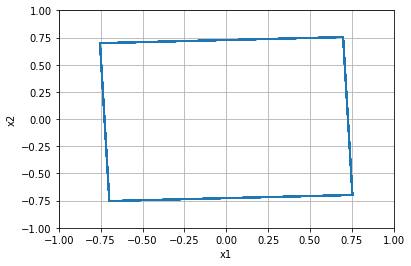


=================== Rollout 598 =====================
x_init [[-0.56]
 [ 0.48]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.56  0.48]
xx [-0.56  0.48]
xxx [-0.56  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.48]


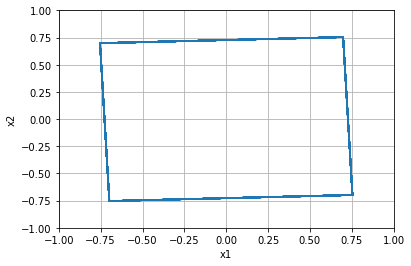


=================== Rollout 599 =====================
x_init [[-0.56]
 [ 0.52]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.56  0.52]
xx [-0.56  0.52]
xxx [-0.56  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.52]


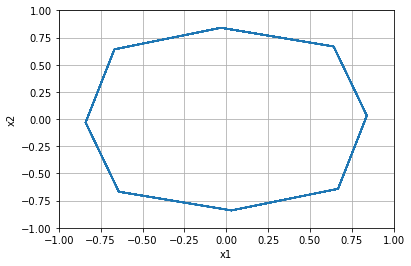


=================== Rollout 600 =====================
x_init [[-0.56]
 [ 0.56]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.56  0.56]
xx [-0.56  0.56]
xxx [-0.56  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.56]


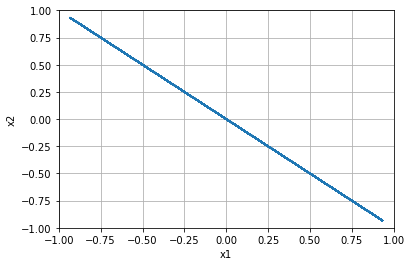


=================== Rollout 601 =====================
x_init [[-0.56]
 [ 0.6 ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.56  0.6 ]
xx [-0.56  0.6 ]
xxx [-0.56  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.6000000000000001]


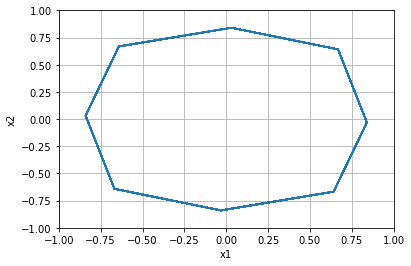


=================== Rollout 602 =====================
x_init [[-0.56]
 [ 0.64]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.56  0.64]
xx [-0.56  0.64]
xxx [-0.56  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.6400000000000001]


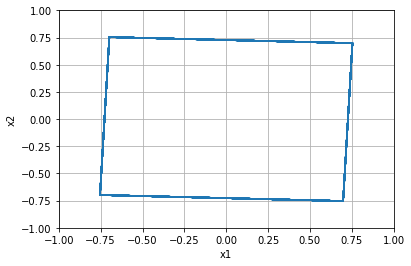


=================== Rollout 603 =====================
x_init [[-0.56]
 [ 0.68]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.56  0.68]
xx [-0.56  0.68]
xxx [-0.56  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.6799999999999999]


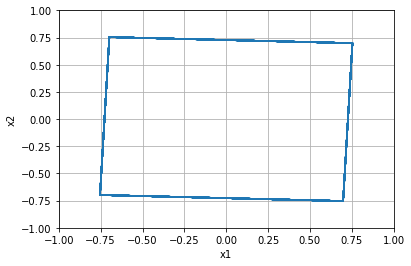


=================== Rollout 604 =====================
x_init [[-0.56]
 [ 0.72]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.56  0.72]
xx [-0.56  0.72]
xxx [-0.56  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.72]


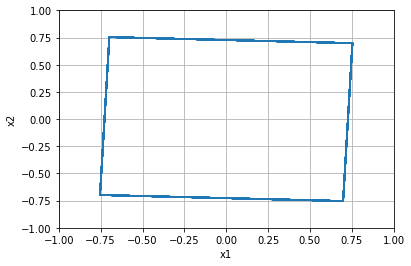


=================== Rollout 605 =====================
x_init [[-0.56]
 [ 0.76]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.56  0.76]
xx [-0.56  0.76]
xxx [-0.56  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.76]


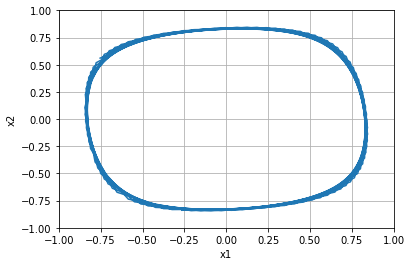


=================== Rollout 606 =====================
x_init [[-0.56]
 [ 0.8 ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.56  0.8 ]
xx [-0.56  0.8 ]
xxx [-0.56  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.8]


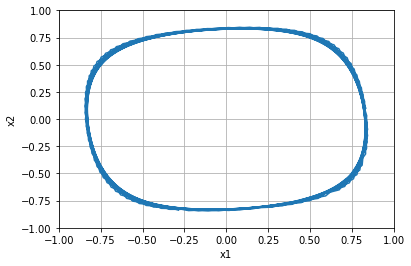


=================== Rollout 607 =====================
x_init [[-0.56]
 [ 0.84]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.56  0.84]
xx [-0.56  0.84]
xxx [-0.56  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.8400000000000001]


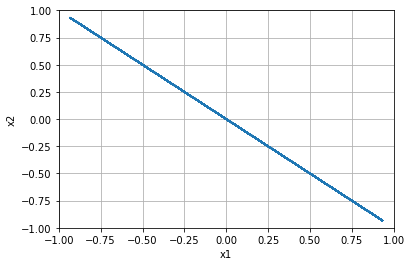


=================== Rollout 608 =====================
x_init [[-0.56]
 [ 0.88]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.56  0.88]
xx [-0.56  0.88]
xxx [-0.56  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.8800000000000001]


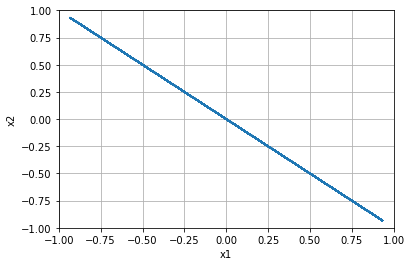


=================== Rollout 609 =====================
x_init [[-0.56]
 [ 0.92]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.56  0.92]
xx [-0.56  0.92]
xxx [-0.56  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.9199999999999999]


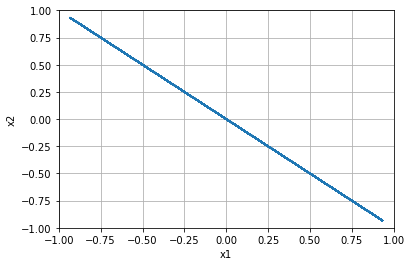


=================== Rollout 610 =====================
x_init [[-0.56]
 [ 0.96]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.56  0.96]
xx [-0.56  0.96]
xxx [-0.56  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 0.96]


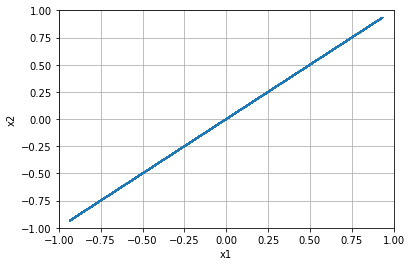


=================== Rollout 611 =====================
x_init [[-0.56]
 [ 1.  ]]
x_buffer [[-0.56 -0.56 -0.56 -0.56 -0.56]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.56  1.  ]
xx [-0.56  1.  ]
xxx [-0.56  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.56, 1.0]


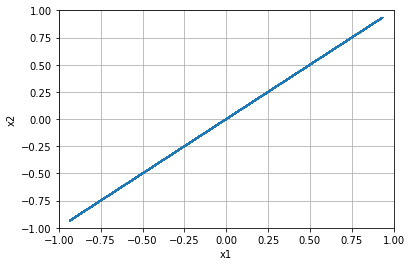


=================== Rollout 612 =====================
x_init [[-0.52]
 [-1.  ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.52 -1.  ]
xx [-0.52 -1.  ]
xxx [-0.52 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -1.0]


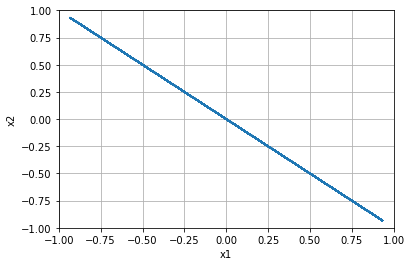


=================== Rollout 613 =====================
x_init [[-0.52]
 [-0.96]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.52 -0.96]
xx [-0.52 -0.96]
xxx [-0.52 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.96]


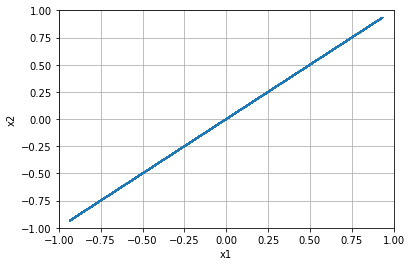


=================== Rollout 614 =====================
x_init [[-0.52]
 [-0.92]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.52 -0.92]
xx [-0.52 -0.92]
xxx [-0.52 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.92]


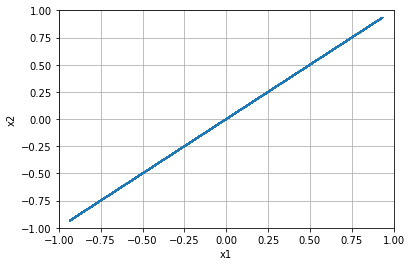


=================== Rollout 615 =====================
x_init [[-0.52]
 [-0.88]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.52 -0.88]
xx [-0.52 -0.88]
xxx [-0.52 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.88]


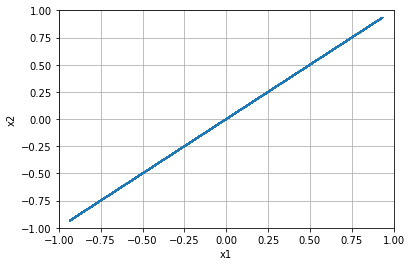


=================== Rollout 616 =====================
x_init [[-0.52]
 [-0.84]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.52 -0.84]
xx [-0.52 -0.84]
xxx [-0.52 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.84]


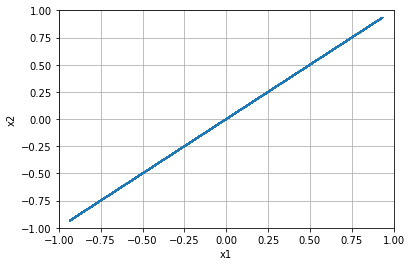


=================== Rollout 617 =====================
x_init [[-0.52]
 [-0.8 ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.52 -0.8 ]
xx [-0.52 -0.8 ]
xxx [-0.52 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.8]


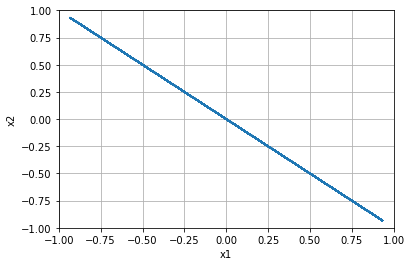


=================== Rollout 618 =====================
x_init [[-0.52]
 [-0.76]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.52 -0.76]
xx [-0.52 -0.76]
xxx [-0.52 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.76]


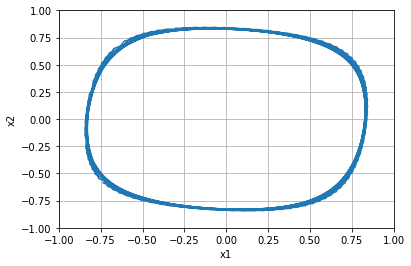


=================== Rollout 619 =====================
x_init [[-0.52]
 [-0.72]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.52 -0.72]
xx [-0.52 -0.72]
xxx [-0.52 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.72]


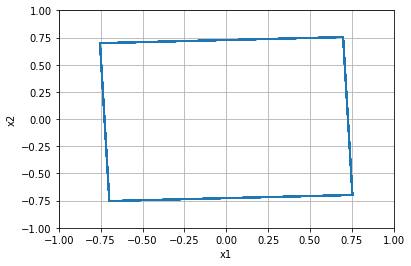


=================== Rollout 620 =====================
x_init [[-0.52]
 [-0.68]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.52 -0.68]
xx [-0.52 -0.68]
xxx [-0.52 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.6799999999999999]


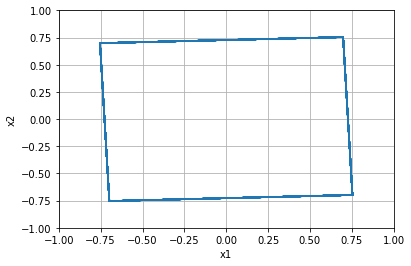


=================== Rollout 621 =====================
x_init [[-0.52]
 [-0.64]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.52 -0.64]
xx [-0.52 -0.64]
xxx [-0.52 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.64]


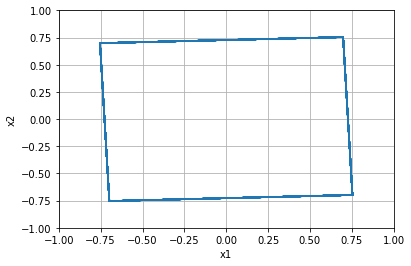


=================== Rollout 622 =====================
x_init [[-0.52]
 [-0.6 ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.52 -0.6 ]
xx [-0.52 -0.6 ]
xxx [-0.52 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.6]


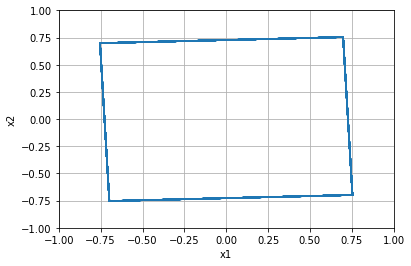


=================== Rollout 623 =====================
x_init [[-0.52]
 [-0.56]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.52 -0.56]
xx [-0.52 -0.56]
xxx [-0.52 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.56]


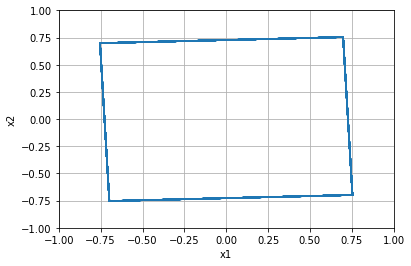


=================== Rollout 624 =====================
x_init [[-0.52]
 [-0.52]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.52 -0.52]
xx [-0.52 -0.52]
xxx [-0.52 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.52]


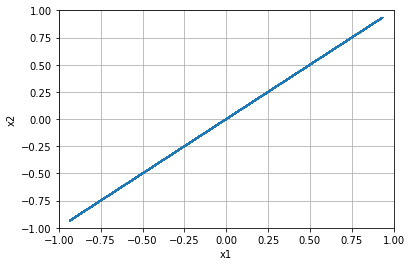


=================== Rollout 625 =====================
x_init [[-0.52]
 [-0.48]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.52 -0.48]
xx [-0.52 -0.48]
xxx [-0.52 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.48]


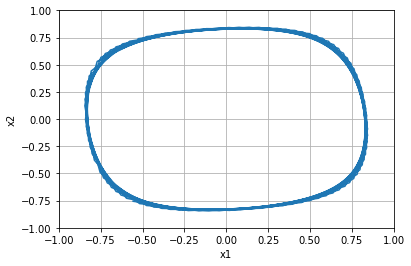


=================== Rollout 626 =====================
x_init [[-0.52]
 [-0.44]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.52 -0.44]
xx [-0.52 -0.44]
xxx [-0.52 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.43999999999999995]


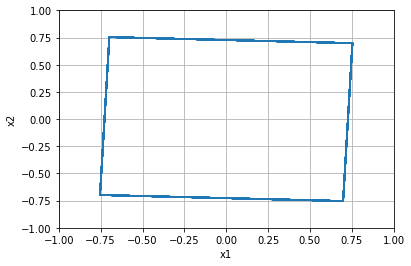


=================== Rollout 627 =====================
x_init [[-0.52]
 [-0.4 ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.52 -0.4 ]
xx [-0.52 -0.4 ]
xxx [-0.52 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.4]


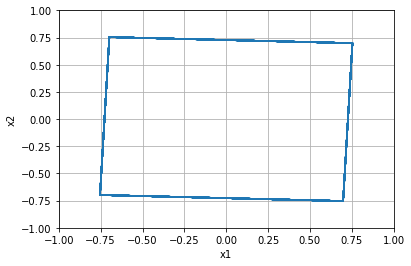


=================== Rollout 628 =====================
x_init [[-0.52]
 [-0.36]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.52 -0.36]
xx [-0.52 -0.36]
xxx [-0.52 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.36]


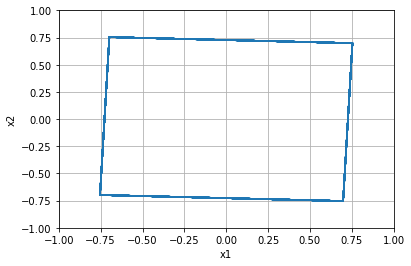


=================== Rollout 629 =====================
x_init [[-0.52]
 [-0.32]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.52 -0.32]
xx [-0.52 -0.32]
xxx [-0.52 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.31999999999999995]


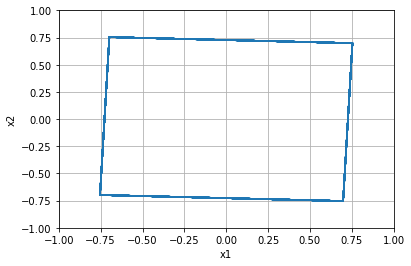


=================== Rollout 630 =====================
x_init [[-0.52]
 [-0.28]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.52 -0.28]
xx [-0.52 -0.28]
xxx [-0.52 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.28]


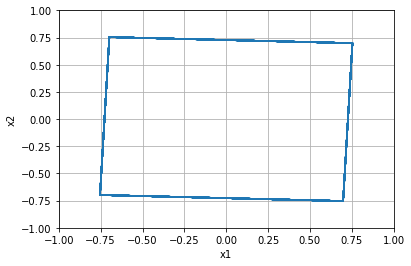


=================== Rollout 631 =====================
x_init [[-0.52]
 [-0.24]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.52 -0.24]
xx [-0.52 -0.24]
xxx [-0.52 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.24]


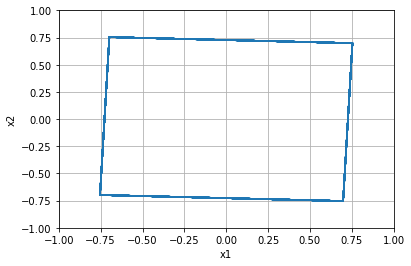


=================== Rollout 632 =====================
x_init [[-0.52]
 [-0.2 ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.52 -0.2 ]
xx [-0.52 -0.2 ]
xxx [-0.52 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.19999999999999996]


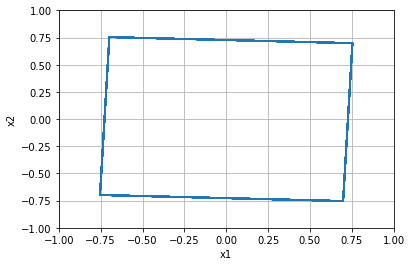


=================== Rollout 633 =====================
x_init [[-0.52]
 [-0.16]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.52 -0.16]
xx [-0.52 -0.16]
xxx [-0.52 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.16000000000000003]


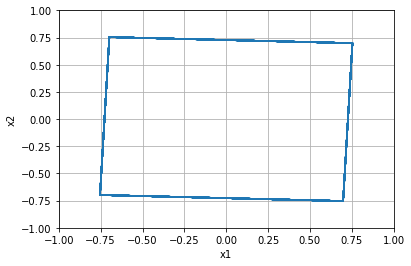


=================== Rollout 634 =====================
x_init [[-0.52]
 [-0.12]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.52 -0.12]
xx [-0.52 -0.12]
xxx [-0.52 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.12]


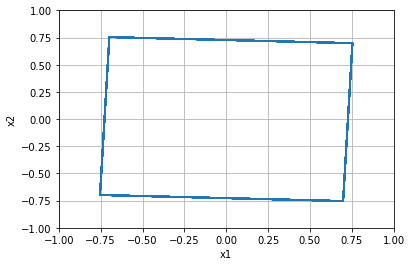


=================== Rollout 635 =====================
x_init [[-0.52]
 [-0.08]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.52 -0.08]
xx [-0.52 -0.08]
xxx [-0.52 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.07999999999999996]


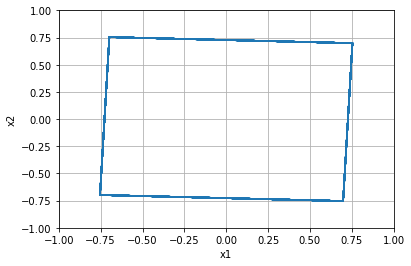


=================== Rollout 636 =====================
x_init [[-0.52]
 [-0.04]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.52 -0.04]
xx [-0.52 -0.04]
xxx [-0.52 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, -0.040000000000000036]


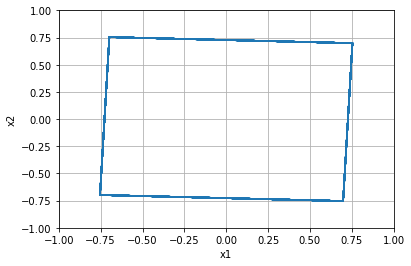


=================== Rollout 637 =====================
x_init [[-0.52]
 [ 0.  ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.52  0.  ]
xx [-0.52  0.  ]
xxx [-0.52  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.0]


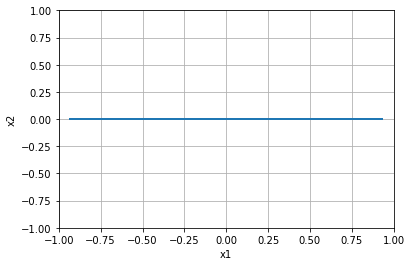


=================== Rollout 638 =====================
x_init [[-0.52]
 [ 0.04]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.52  0.04]
xx [-0.52  0.04]
xxx [-0.52  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.040000000000000036]


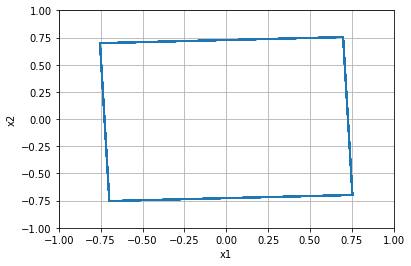


=================== Rollout 639 =====================
x_init [[-0.52]
 [ 0.08]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.52  0.08]
xx [-0.52  0.08]
xxx [-0.52  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.08000000000000007]


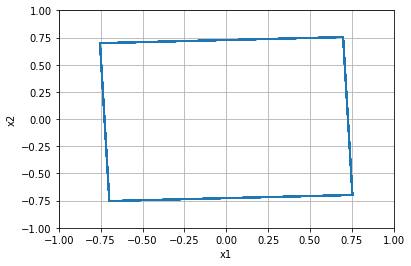


=================== Rollout 640 =====================
x_init [[-0.52]
 [ 0.12]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.52  0.12]
xx [-0.52  0.12]
xxx [-0.52  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.1200000000000001]


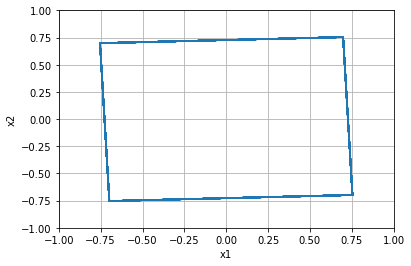


=================== Rollout 641 =====================
x_init [[-0.52]
 [ 0.16]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.52  0.16]
xx [-0.52  0.16]
xxx [-0.52  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.15999999999999992]


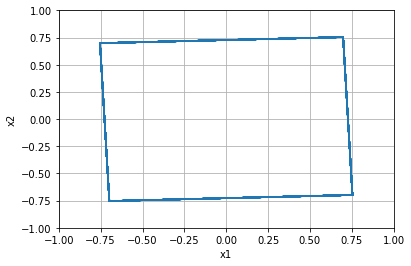


=================== Rollout 642 =====================
x_init [[-0.52]
 [ 0.2 ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.52  0.2 ]
xx [-0.52  0.2 ]
xxx [-0.52  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.19999999999999996]


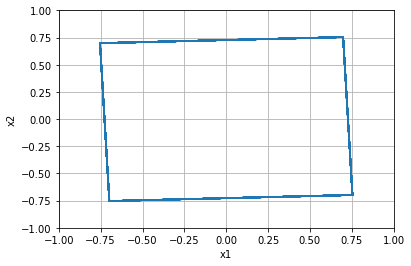


=================== Rollout 643 =====================
x_init [[-0.52]
 [ 0.24]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.52  0.24]
xx [-0.52  0.24]
xxx [-0.52  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.24]


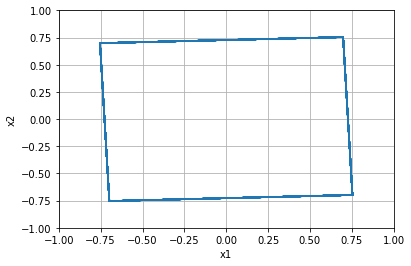


=================== Rollout 644 =====================
x_init [[-0.52]
 [ 0.28]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.52  0.28]
xx [-0.52  0.28]
xxx [-0.52  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.28]


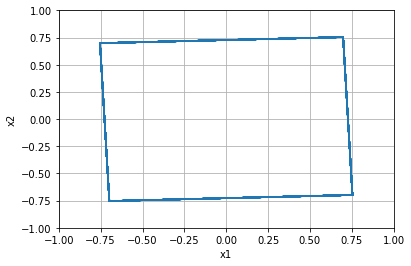


=================== Rollout 645 =====================
x_init [[-0.52]
 [ 0.32]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.52  0.32]
xx [-0.52  0.32]
xxx [-0.52  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.32000000000000006]


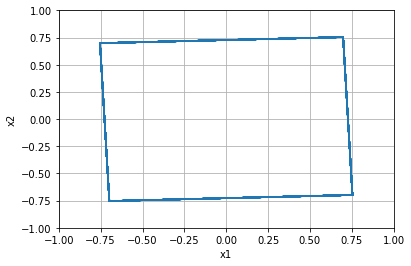


=================== Rollout 646 =====================
x_init [[-0.52]
 [ 0.36]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.52  0.36]
xx [-0.52  0.36]
xxx [-0.52  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.3600000000000001]


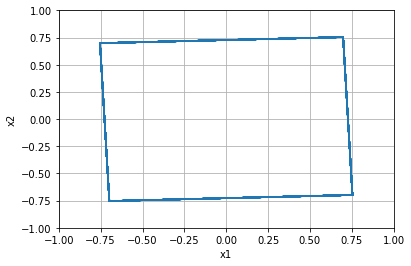


=================== Rollout 647 =====================
x_init [[-0.52]
 [ 0.4 ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.52  0.4 ]
xx [-0.52  0.4 ]
xxx [-0.52  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.40000000000000013]


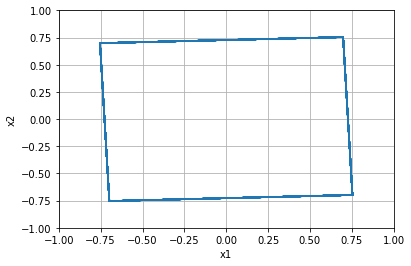


=================== Rollout 648 =====================
x_init [[-0.52]
 [ 0.44]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.52  0.44]
xx [-0.52  0.44]
xxx [-0.52  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.43999999999999995]


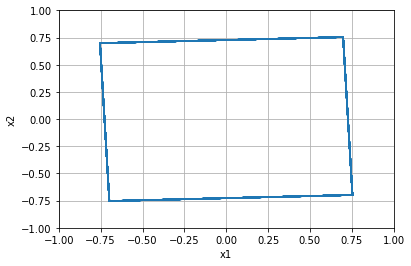


=================== Rollout 649 =====================
x_init [[-0.52]
 [ 0.48]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.52  0.48]
xx [-0.52  0.48]
xxx [-0.52  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.48]


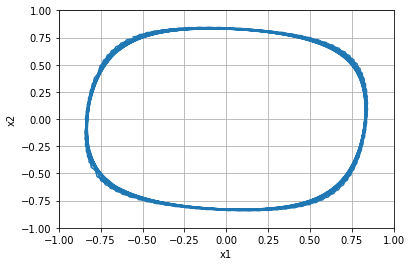


=================== Rollout 650 =====================
x_init [[-0.52]
 [ 0.52]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.52  0.52]
xx [-0.52  0.52]
xxx [-0.52  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.52]


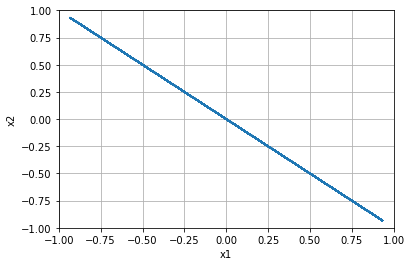


=================== Rollout 651 =====================
x_init [[-0.52]
 [ 0.56]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.52  0.56]
xx [-0.52  0.56]
xxx [-0.52  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.56]


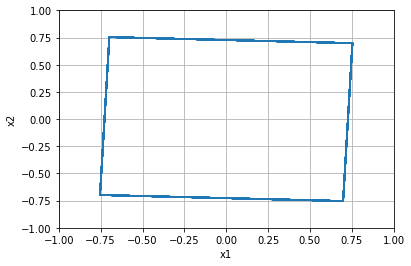


=================== Rollout 652 =====================
x_init [[-0.52]
 [ 0.6 ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.52  0.6 ]
xx [-0.52  0.6 ]
xxx [-0.52  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.6000000000000001]


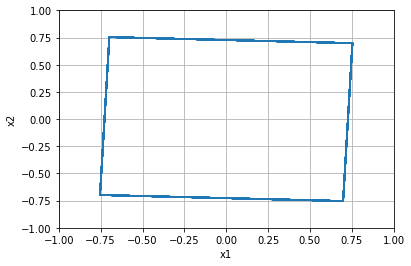


=================== Rollout 653 =====================
x_init [[-0.52]
 [ 0.64]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.52  0.64]
xx [-0.52  0.64]
xxx [-0.52  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.6400000000000001]


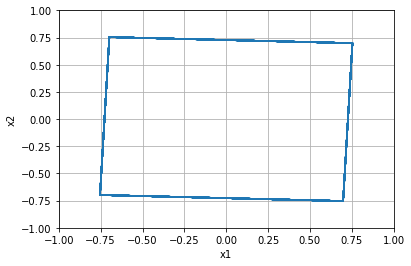


=================== Rollout 654 =====================
x_init [[-0.52]
 [ 0.68]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.52  0.68]
xx [-0.52  0.68]
xxx [-0.52  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.6799999999999999]


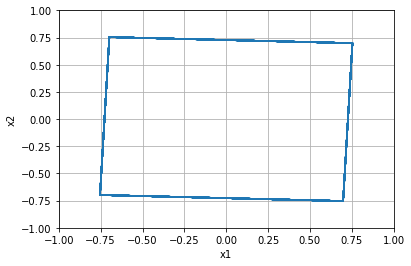


=================== Rollout 655 =====================
x_init [[-0.52]
 [ 0.72]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.52  0.72]
xx [-0.52  0.72]
xxx [-0.52  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.72]


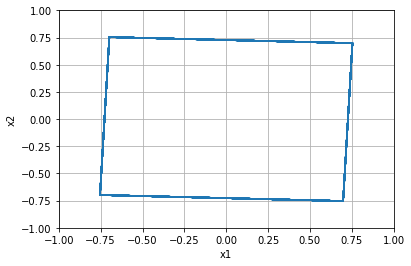


=================== Rollout 656 =====================
x_init [[-0.52]
 [ 0.76]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.52  0.76]
xx [-0.52  0.76]
xxx [-0.52  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.76]


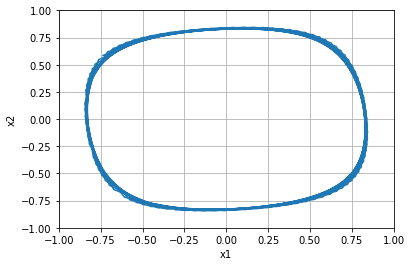


=================== Rollout 657 =====================
x_init [[-0.52]
 [ 0.8 ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.52  0.8 ]
xx [-0.52  0.8 ]
xxx [-0.52  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.8]


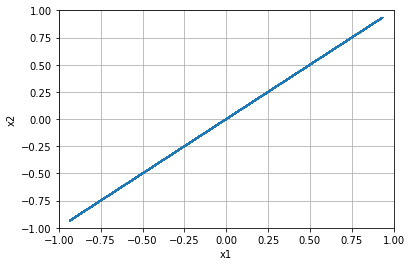


=================== Rollout 658 =====================
x_init [[-0.52]
 [ 0.84]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.52  0.84]
xx [-0.52  0.84]
xxx [-0.52  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.8400000000000001]


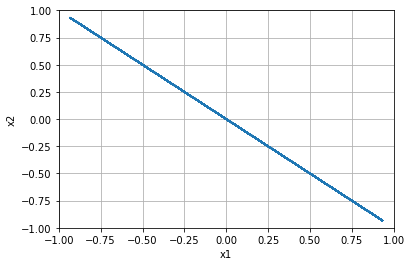


=================== Rollout 659 =====================
x_init [[-0.52]
 [ 0.88]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.52  0.88]
xx [-0.52  0.88]
xxx [-0.52  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.8800000000000001]


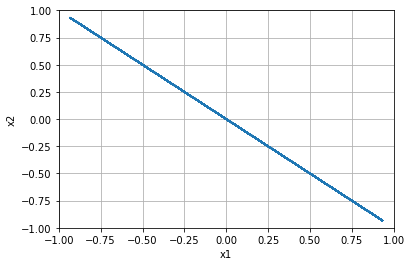


=================== Rollout 660 =====================
x_init [[-0.52]
 [ 0.92]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.52  0.92]
xx [-0.52  0.92]
xxx [-0.52  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.9199999999999999]


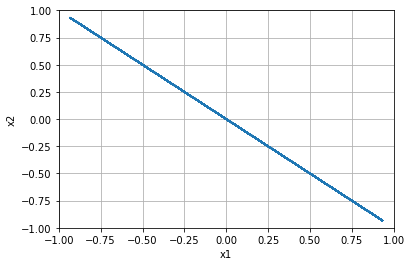


=================== Rollout 661 =====================
x_init [[-0.52]
 [ 0.96]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.52  0.96]
xx [-0.52  0.96]
xxx [-0.52  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 0.96]


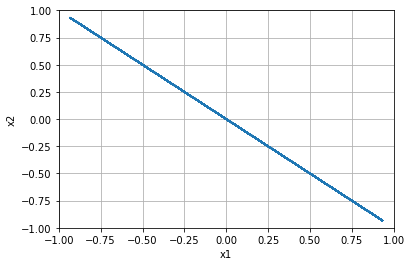


=================== Rollout 662 =====================
x_init [[-0.52]
 [ 1.  ]]
x_buffer [[-0.52 -0.52 -0.52 -0.52 -0.52]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.52  1.  ]
xx [-0.52  1.  ]
xxx [-0.52  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.52, 1.0]


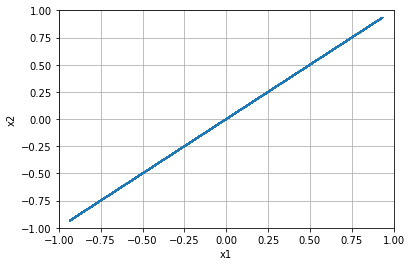


=================== Rollout 663 =====================
x_init [[-0.48]
 [-1.  ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.48 -1.  ]
xx [-0.48 -1.  ]
xxx [-0.48 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -1.0]


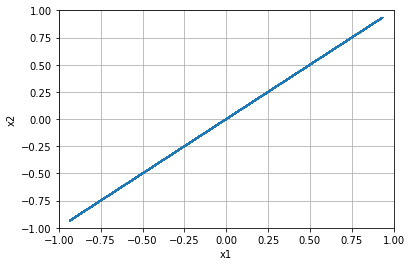


=================== Rollout 664 =====================
x_init [[-0.48]
 [-0.96]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.48 -0.96]
xx [-0.48 -0.96]
xxx [-0.48 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.96]


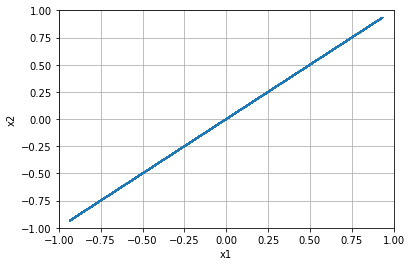


=================== Rollout 665 =====================
x_init [[-0.48]
 [-0.92]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.48 -0.92]
xx [-0.48 -0.92]
xxx [-0.48 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.92]


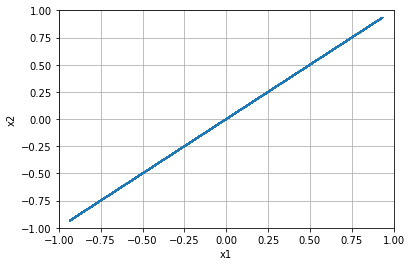


=================== Rollout 666 =====================
x_init [[-0.48]
 [-0.88]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.48 -0.88]
xx [-0.48 -0.88]
xxx [-0.48 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.88]


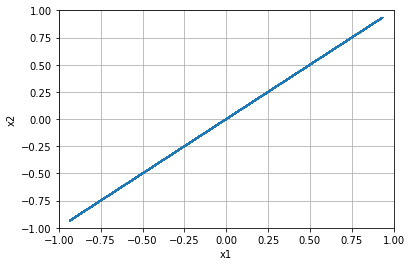


=================== Rollout 667 =====================
x_init [[-0.48]
 [-0.84]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.48 -0.84]
xx [-0.48 -0.84]
xxx [-0.48 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.84]


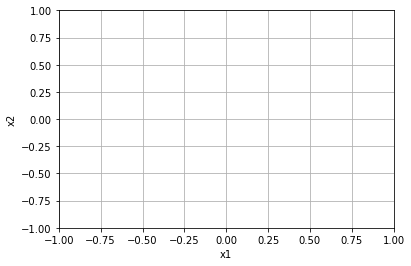


=================== Rollout 668 =====================
x_init [[-0.48]
 [-0.8 ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.48 -0.8 ]
xx [-0.48 -0.8 ]
xxx [-0.48 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.8]


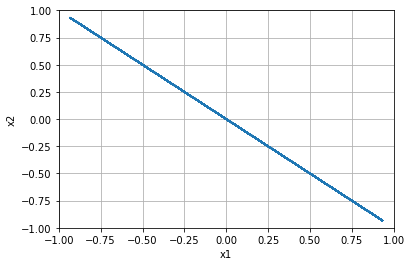


=================== Rollout 669 =====================
x_init [[-0.48]
 [-0.76]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.48 -0.76]
xx [-0.48 -0.76]
xxx [-0.48 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.76]


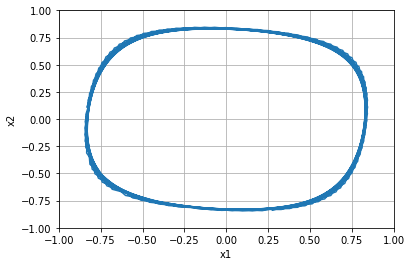


=================== Rollout 670 =====================
x_init [[-0.48]
 [-0.72]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.48 -0.72]
xx [-0.48 -0.72]
xxx [-0.48 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.72]


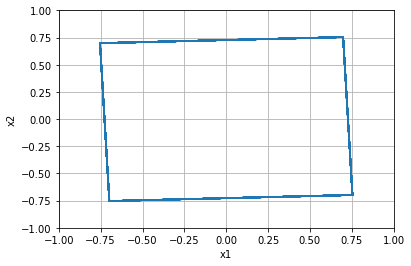


=================== Rollout 671 =====================
x_init [[-0.48]
 [-0.68]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.48 -0.68]
xx [-0.48 -0.68]
xxx [-0.48 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.6799999999999999]


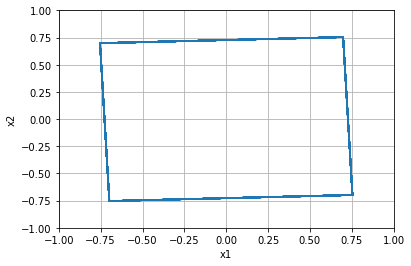


=================== Rollout 672 =====================
x_init [[-0.48]
 [-0.64]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.48 -0.64]
xx [-0.48 -0.64]
xxx [-0.48 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.64]


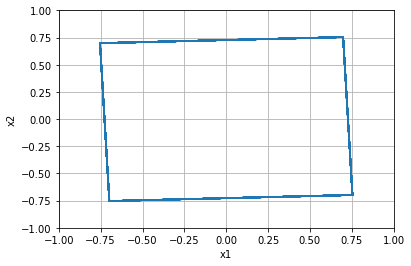


=================== Rollout 673 =====================
x_init [[-0.48]
 [-0.6 ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.48 -0.6 ]
xx [-0.48 -0.6 ]
xxx [-0.48 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.6]


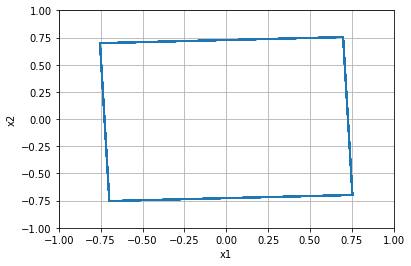


=================== Rollout 674 =====================
x_init [[-0.48]
 [-0.56]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.48 -0.56]
xx [-0.48 -0.56]
xxx [-0.48 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.56]


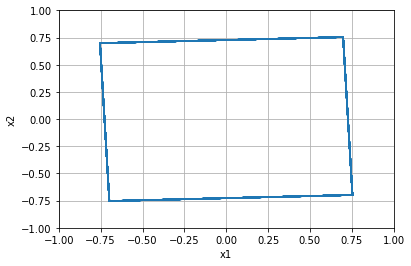


=================== Rollout 675 =====================
x_init [[-0.48]
 [-0.52]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.48 -0.52]
xx [-0.48 -0.52]
xxx [-0.48 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.52]


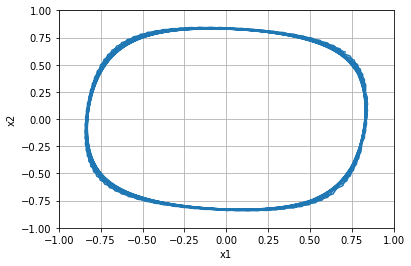


=================== Rollout 676 =====================
x_init [[-0.48]
 [-0.48]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.48 -0.48]
xx [-0.48 -0.48]
xxx [-0.48 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.48]


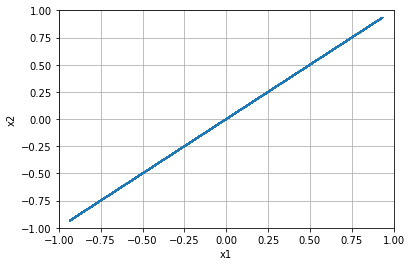


=================== Rollout 677 =====================
x_init [[-0.48]
 [-0.44]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.48 -0.44]
xx [-0.48 -0.44]
xxx [-0.48 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.43999999999999995]


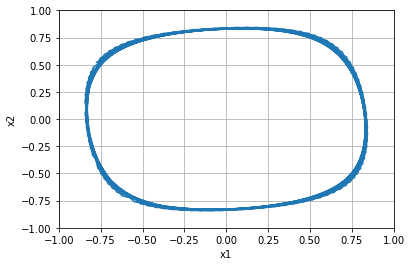


=================== Rollout 678 =====================
x_init [[-0.48]
 [-0.4 ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.48 -0.4 ]
xx [-0.48 -0.4 ]
xxx [-0.48 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.4]


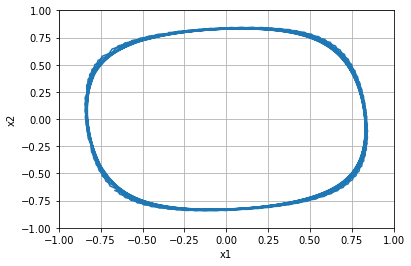


=================== Rollout 679 =====================
x_init [[-0.48]
 [-0.36]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.48 -0.36]
xx [-0.48 -0.36]
xxx [-0.48 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.36]


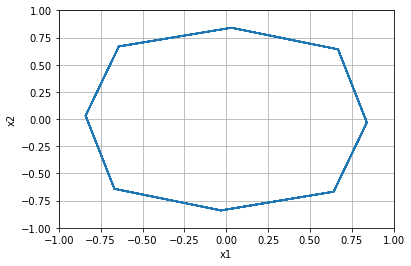


=================== Rollout 680 =====================
x_init [[-0.48]
 [-0.32]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.48 -0.32]
xx [-0.48 -0.32]
xxx [-0.48 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.31999999999999995]


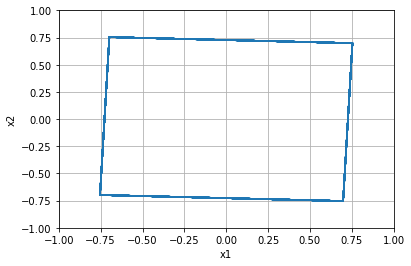


=================== Rollout 681 =====================
x_init [[-0.48]
 [-0.28]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.48 -0.28]
xx [-0.48 -0.28]
xxx [-0.48 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.28]


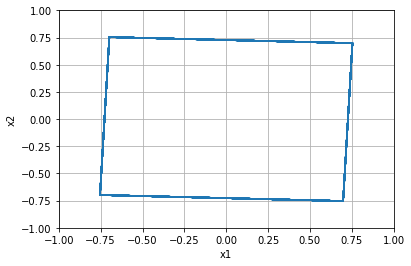


=================== Rollout 682 =====================
x_init [[-0.48]
 [-0.24]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.48 -0.24]
xx [-0.48 -0.24]
xxx [-0.48 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.24]


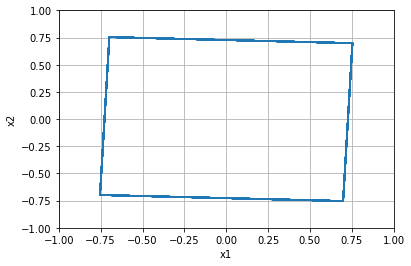


=================== Rollout 683 =====================
x_init [[-0.48]
 [-0.2 ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.48 -0.2 ]
xx [-0.48 -0.2 ]
xxx [-0.48 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.19999999999999996]


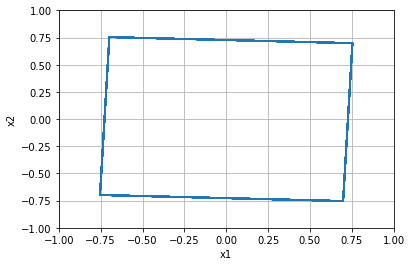


=================== Rollout 684 =====================
x_init [[-0.48]
 [-0.16]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.48 -0.16]
xx [-0.48 -0.16]
xxx [-0.48 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.16000000000000003]


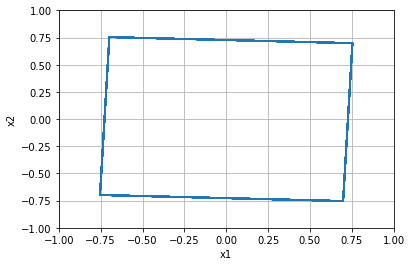


=================== Rollout 685 =====================
x_init [[-0.48]
 [-0.12]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.48 -0.12]
xx [-0.48 -0.12]
xxx [-0.48 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.12]


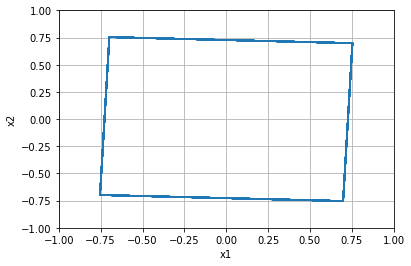


=================== Rollout 686 =====================
x_init [[-0.48]
 [-0.08]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.48 -0.08]
xx [-0.48 -0.08]
xxx [-0.48 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.07999999999999996]


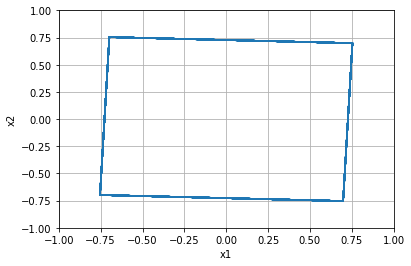


=================== Rollout 687 =====================
x_init [[-0.48]
 [-0.04]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.48 -0.04]
xx [-0.48 -0.04]
xxx [-0.48 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, -0.040000000000000036]


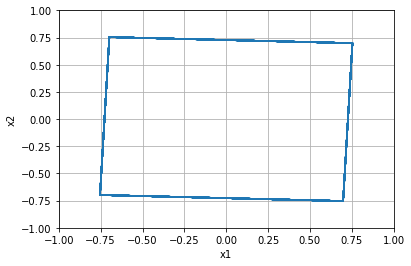


=================== Rollout 688 =====================
x_init [[-0.48]
 [ 0.  ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.48  0.  ]
xx [-0.48  0.  ]
xxx [-0.48  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.0]


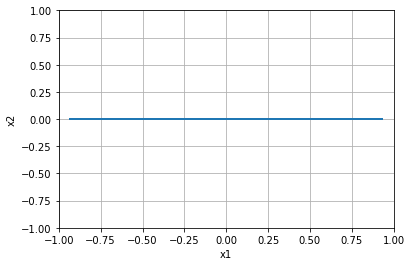


=================== Rollout 689 =====================
x_init [[-0.48]
 [ 0.04]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.48  0.04]
xx [-0.48  0.04]
xxx [-0.48  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.040000000000000036]


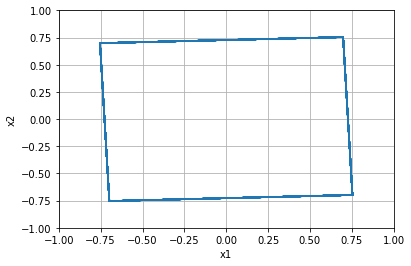


=================== Rollout 690 =====================
x_init [[-0.48]
 [ 0.08]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.48  0.08]
xx [-0.48  0.08]
xxx [-0.48  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.08000000000000007]


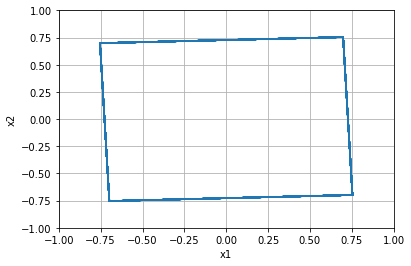


=================== Rollout 691 =====================
x_init [[-0.48]
 [ 0.12]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.48  0.12]
xx [-0.48  0.12]
xxx [-0.48  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.1200000000000001]


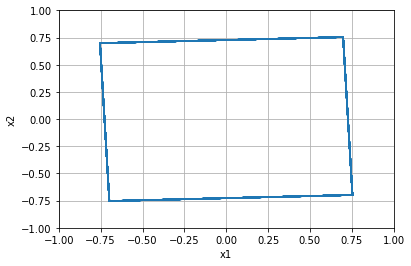


=================== Rollout 692 =====================
x_init [[-0.48]
 [ 0.16]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.48  0.16]
xx [-0.48  0.16]
xxx [-0.48  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.15999999999999992]


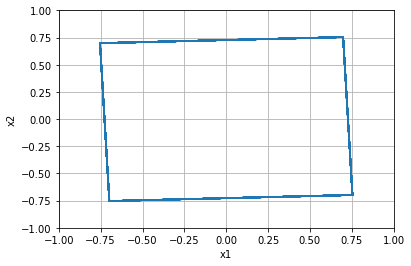


=================== Rollout 693 =====================
x_init [[-0.48]
 [ 0.2 ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.48  0.2 ]
xx [-0.48  0.2 ]
xxx [-0.48  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.19999999999999996]


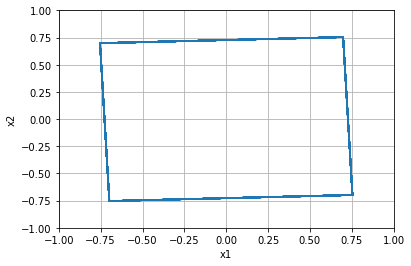


=================== Rollout 694 =====================
x_init [[-0.48]
 [ 0.24]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.48  0.24]
xx [-0.48  0.24]
xxx [-0.48  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.24]


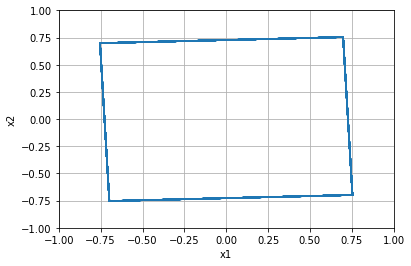


=================== Rollout 695 =====================
x_init [[-0.48]
 [ 0.28]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.48  0.28]
xx [-0.48  0.28]
xxx [-0.48  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.28]


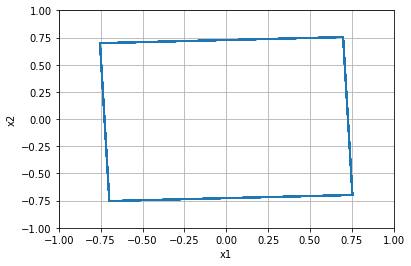


=================== Rollout 696 =====================
x_init [[-0.48]
 [ 0.32]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.48  0.32]
xx [-0.48  0.32]
xxx [-0.48  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.32000000000000006]


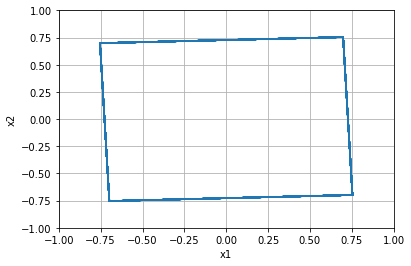


=================== Rollout 697 =====================
x_init [[-0.48]
 [ 0.36]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.48  0.36]
xx [-0.48  0.36]
xxx [-0.48  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.3600000000000001]


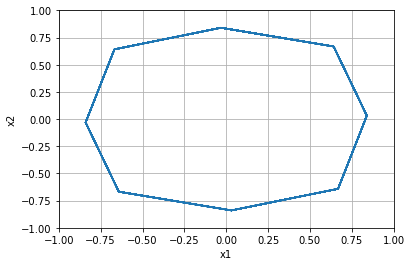


=================== Rollout 698 =====================
x_init [[-0.48]
 [ 0.4 ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.48  0.4 ]
xx [-0.48  0.4 ]
xxx [-0.48  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.40000000000000013]


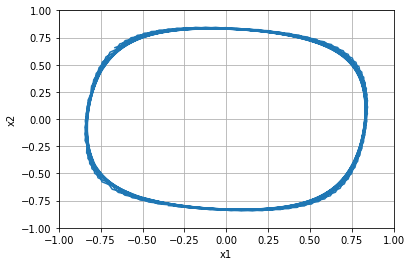


=================== Rollout 699 =====================
x_init [[-0.48]
 [ 0.44]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.48  0.44]
xx [-0.48  0.44]
xxx [-0.48  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.43999999999999995]


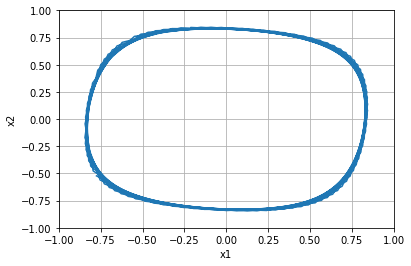


=================== Rollout 700 =====================
x_init [[-0.48]
 [ 0.48]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.48  0.48]
xx [-0.48  0.48]
xxx [-0.48  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.48]


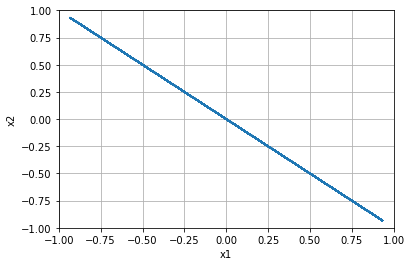


=================== Rollout 701 =====================
x_init [[-0.48]
 [ 0.52]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.48  0.52]
xx [-0.48  0.52]
xxx [-0.48  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.52]


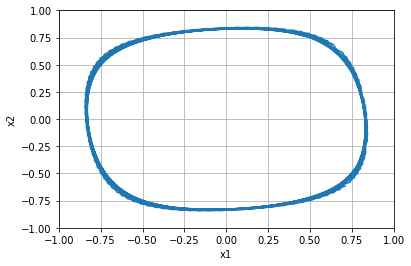


=================== Rollout 702 =====================
x_init [[-0.48]
 [ 0.56]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.48  0.56]
xx [-0.48  0.56]
xxx [-0.48  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.56]


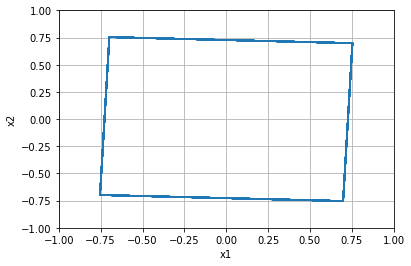


=================== Rollout 703 =====================
x_init [[-0.48]
 [ 0.6 ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.48  0.6 ]
xx [-0.48  0.6 ]
xxx [-0.48  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.6000000000000001]


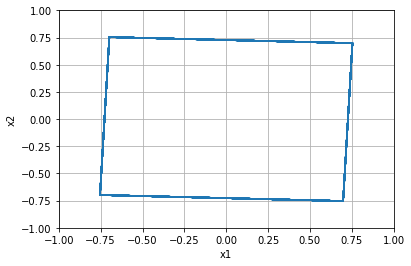


=================== Rollout 704 =====================
x_init [[-0.48]
 [ 0.64]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.48  0.64]
xx [-0.48  0.64]
xxx [-0.48  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.6400000000000001]


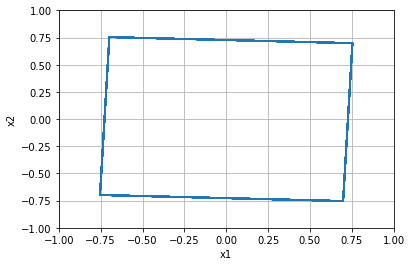


=================== Rollout 705 =====================
x_init [[-0.48]
 [ 0.68]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.48  0.68]
xx [-0.48  0.68]
xxx [-0.48  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.6799999999999999]


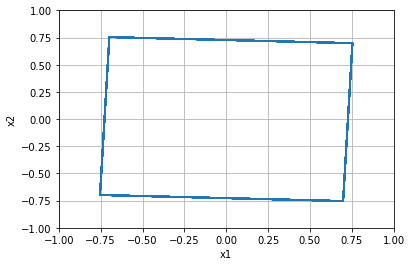


=================== Rollout 706 =====================
x_init [[-0.48]
 [ 0.72]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.48  0.72]
xx [-0.48  0.72]
xxx [-0.48  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.72]


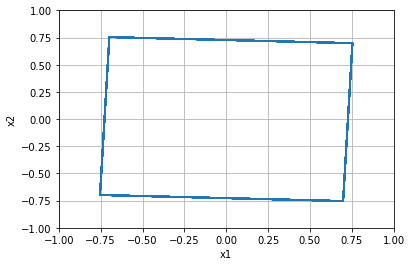


=================== Rollout 707 =====================
x_init [[-0.48]
 [ 0.76]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.48  0.76]
xx [-0.48  0.76]
xxx [-0.48  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.76]


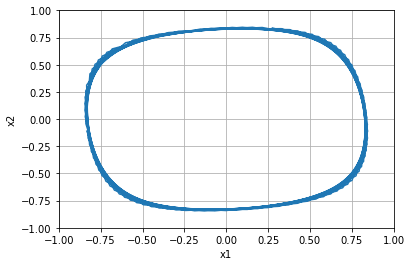


=================== Rollout 708 =====================
x_init [[-0.48]
 [ 0.8 ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.48  0.8 ]
xx [-0.48  0.8 ]
xxx [-0.48  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.8]


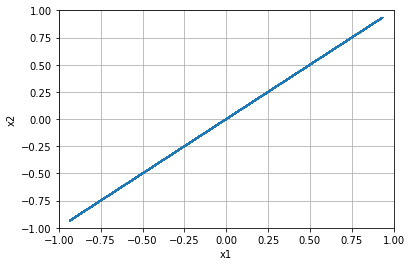


=================== Rollout 709 =====================
x_init [[-0.48]
 [ 0.84]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.48  0.84]
xx [-0.48  0.84]
xxx [-0.48  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.8400000000000001]


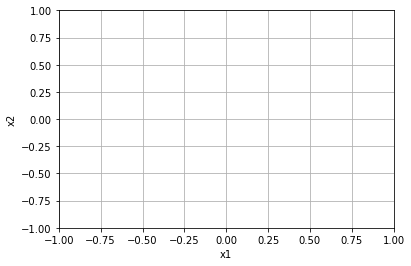


=================== Rollout 710 =====================
x_init [[-0.48]
 [ 0.88]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.48  0.88]
xx [-0.48  0.88]
xxx [-0.48  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.8800000000000001]


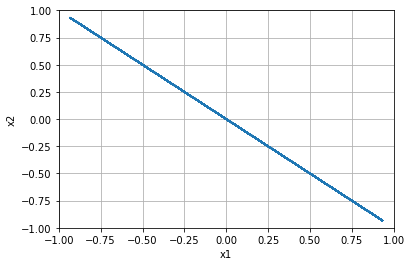


=================== Rollout 711 =====================
x_init [[-0.48]
 [ 0.92]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.48  0.92]
xx [-0.48  0.92]
xxx [-0.48  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.9199999999999999]


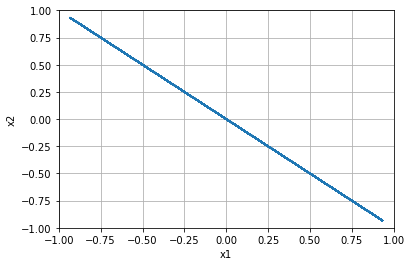


=================== Rollout 712 =====================
x_init [[-0.48]
 [ 0.96]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.48  0.96]
xx [-0.48  0.96]
xxx [-0.48  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 0.96]


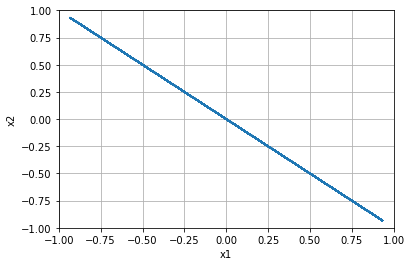


=================== Rollout 713 =====================
x_init [[-0.48]
 [ 1.  ]]
x_buffer [[-0.48 -0.48 -0.48 -0.48 -0.48]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.48  1.  ]
xx [-0.48  1.  ]
xxx [-0.48  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.48, 1.0]


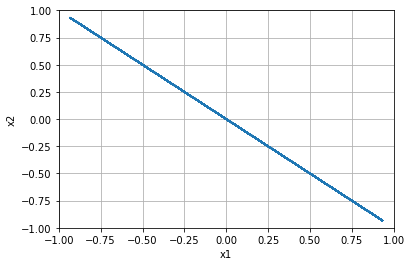


=================== Rollout 714 =====================
x_init [[-0.44]
 [-1.  ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.44 -1.  ]
xx [-0.44 -1.  ]
xxx [-0.44 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -1.0]


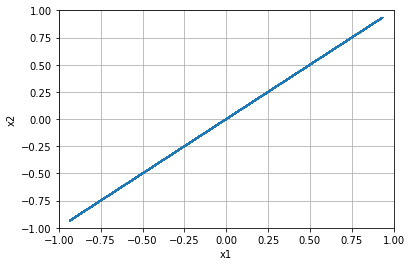


=================== Rollout 715 =====================
x_init [[-0.44]
 [-0.96]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.44 -0.96]
xx [-0.44 -0.96]
xxx [-0.44 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.96]


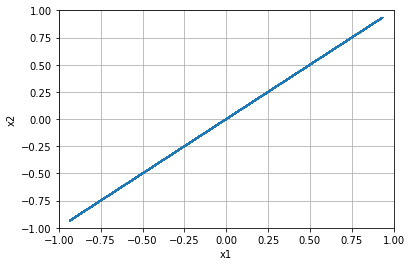


=================== Rollout 716 =====================
x_init [[-0.44]
 [-0.92]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.44 -0.92]
xx [-0.44 -0.92]
xxx [-0.44 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.92]


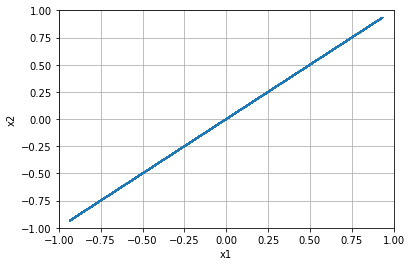


=================== Rollout 717 =====================
x_init [[-0.44]
 [-0.88]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.44 -0.88]
xx [-0.44 -0.88]
xxx [-0.44 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.88]


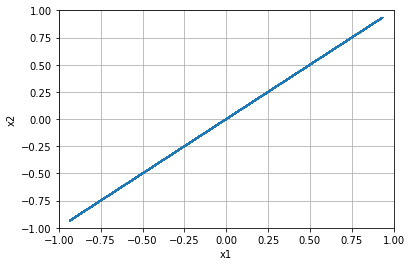


=================== Rollout 718 =====================
x_init [[-0.44]
 [-0.84]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.44 -0.84]
xx [-0.44 -0.84]
xxx [-0.44 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.84]


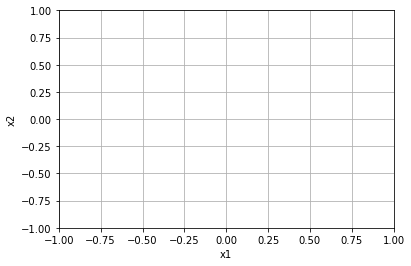


=================== Rollout 719 =====================
x_init [[-0.44]
 [-0.8 ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.44 -0.8 ]
xx [-0.44 -0.8 ]
xxx [-0.44 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.8]


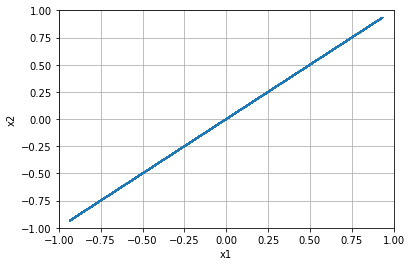


=================== Rollout 720 =====================
x_init [[-0.44]
 [-0.76]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.44 -0.76]
xx [-0.44 -0.76]
xxx [-0.44 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.76]


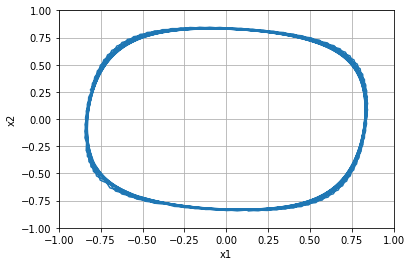


=================== Rollout 721 =====================
x_init [[-0.44]
 [-0.72]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.44 -0.72]
xx [-0.44 -0.72]
xxx [-0.44 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.72]


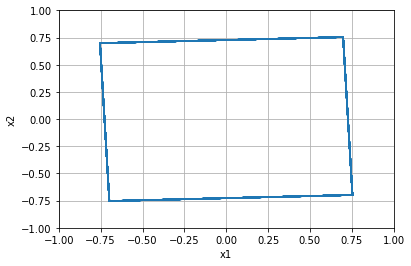


=================== Rollout 722 =====================
x_init [[-0.44]
 [-0.68]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.44 -0.68]
xx [-0.44 -0.68]
xxx [-0.44 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.6799999999999999]


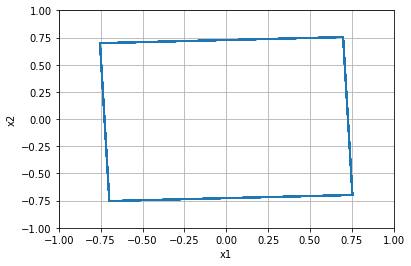


=================== Rollout 723 =====================
x_init [[-0.44]
 [-0.64]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.44 -0.64]
xx [-0.44 -0.64]
xxx [-0.44 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.64]


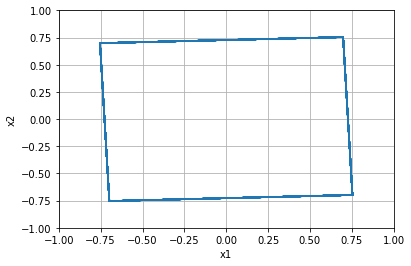


=================== Rollout 724 =====================
x_init [[-0.44]
 [-0.6 ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.44 -0.6 ]
xx [-0.44 -0.6 ]
xxx [-0.44 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.6]


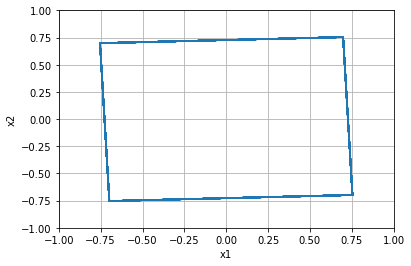


=================== Rollout 725 =====================
x_init [[-0.44]
 [-0.56]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.44 -0.56]
xx [-0.44 -0.56]
xxx [-0.44 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.56]


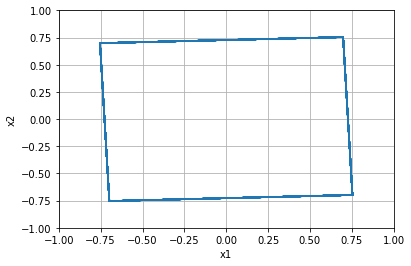


=================== Rollout 726 =====================
x_init [[-0.44]
 [-0.52]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.44 -0.52]
xx [-0.44 -0.52]
xxx [-0.44 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.52]


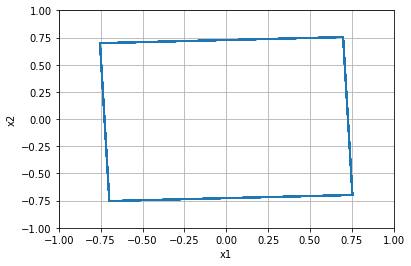


=================== Rollout 727 =====================
x_init [[-0.44]
 [-0.48]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.44 -0.48]
xx [-0.44 -0.48]
xxx [-0.44 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.48]


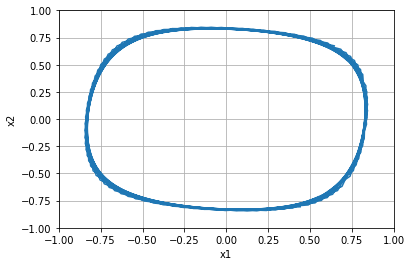


=================== Rollout 728 =====================
x_init [[-0.44]
 [-0.44]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.44 -0.44]
xx [-0.44 -0.44]
xxx [-0.44 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.43999999999999995]


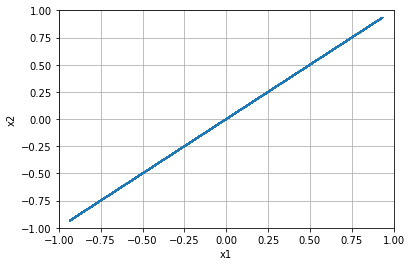


=================== Rollout 729 =====================
x_init [[-0.44]
 [-0.4 ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.44 -0.4 ]
xx [-0.44 -0.4 ]
xxx [-0.44 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.4]


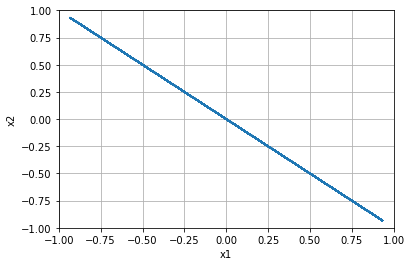


=================== Rollout 730 =====================
x_init [[-0.44]
 [-0.36]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.44 -0.36]
xx [-0.44 -0.36]
xxx [-0.44 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.36]


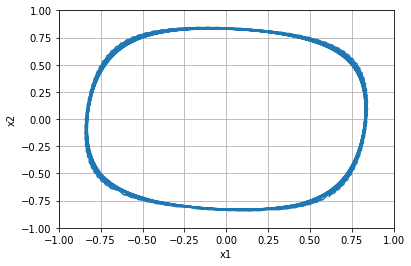


=================== Rollout 731 =====================
x_init [[-0.44]
 [-0.32]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.44 -0.32]
xx [-0.44 -0.32]
xxx [-0.44 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.31999999999999995]


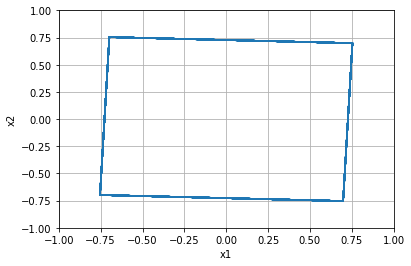


=================== Rollout 732 =====================
x_init [[-0.44]
 [-0.28]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.44 -0.28]
xx [-0.44 -0.28]
xxx [-0.44 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.28]


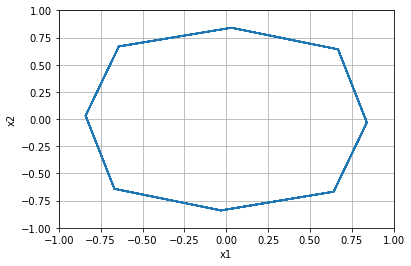


=================== Rollout 733 =====================
x_init [[-0.44]
 [-0.24]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.44 -0.24]
xx [-0.44 -0.24]
xxx [-0.44 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.24]


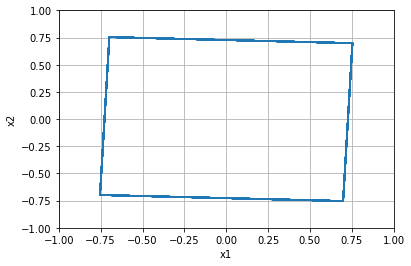


=================== Rollout 734 =====================
x_init [[-0.44]
 [-0.2 ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.44 -0.2 ]
xx [-0.44 -0.2 ]
xxx [-0.44 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.19999999999999996]


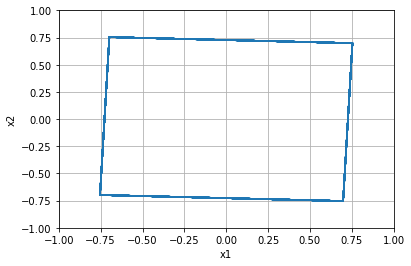


=================== Rollout 735 =====================
x_init [[-0.44]
 [-0.16]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.44 -0.16]
xx [-0.44 -0.16]
xxx [-0.44 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.16000000000000003]


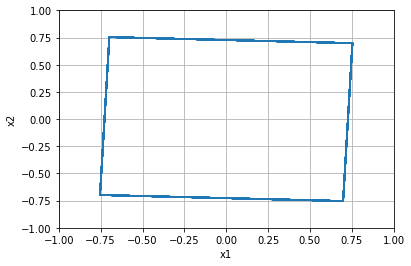


=================== Rollout 736 =====================
x_init [[-0.44]
 [-0.12]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.44 -0.12]
xx [-0.44 -0.12]
xxx [-0.44 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.12]


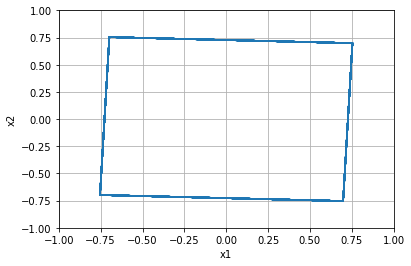


=================== Rollout 737 =====================
x_init [[-0.44]
 [-0.08]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.44 -0.08]
xx [-0.44 -0.08]
xxx [-0.44 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.07999999999999996]


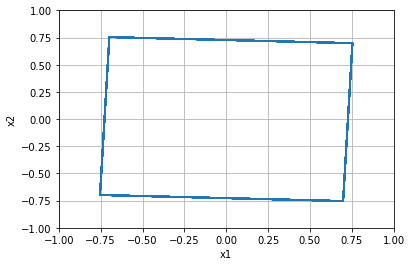


=================== Rollout 738 =====================
x_init [[-0.44]
 [-0.04]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.44 -0.04]
xx [-0.44 -0.04]
xxx [-0.44 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, -0.040000000000000036]


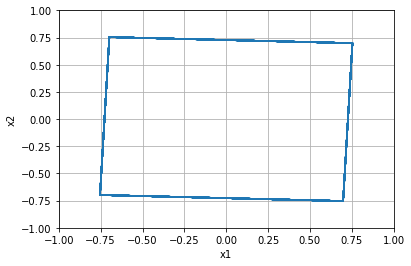


=================== Rollout 739 =====================
x_init [[-0.44]
 [ 0.  ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.44  0.  ]
xx [-0.44  0.  ]
xxx [-0.44  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.0]


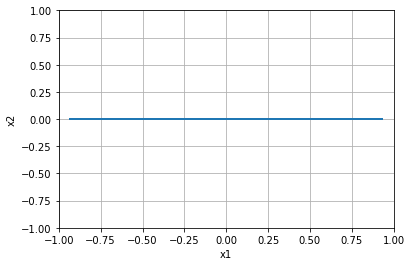


=================== Rollout 740 =====================
x_init [[-0.44]
 [ 0.04]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.44  0.04]
xx [-0.44  0.04]
xxx [-0.44  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.040000000000000036]


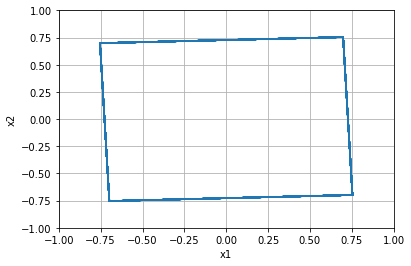


=================== Rollout 741 =====================
x_init [[-0.44]
 [ 0.08]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.44  0.08]
xx [-0.44  0.08]
xxx [-0.44  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.08000000000000007]


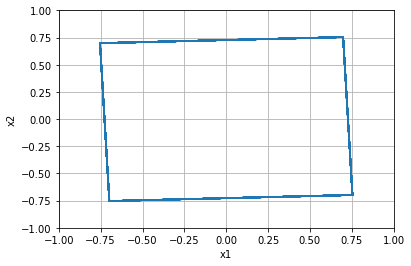


=================== Rollout 742 =====================
x_init [[-0.44]
 [ 0.12]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.44  0.12]
xx [-0.44  0.12]
xxx [-0.44  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.1200000000000001]


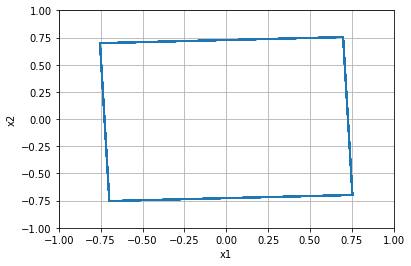


=================== Rollout 743 =====================
x_init [[-0.44]
 [ 0.16]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.44  0.16]
xx [-0.44  0.16]
xxx [-0.44  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.15999999999999992]


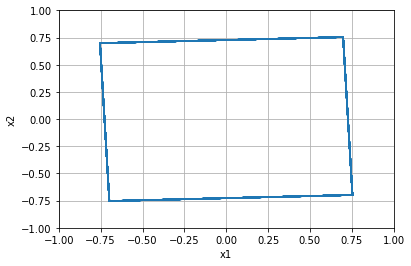


=================== Rollout 744 =====================
x_init [[-0.44]
 [ 0.2 ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.44  0.2 ]
xx [-0.44  0.2 ]
xxx [-0.44  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.19999999999999996]


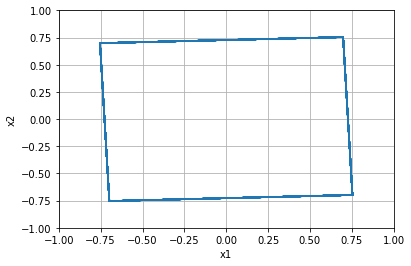


=================== Rollout 745 =====================
x_init [[-0.44]
 [ 0.24]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.44  0.24]
xx [-0.44  0.24]
xxx [-0.44  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.24]


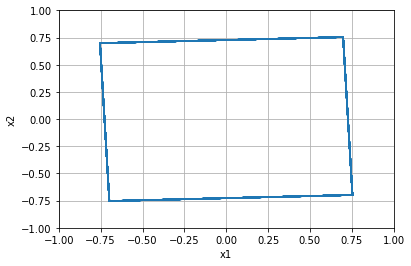


=================== Rollout 746 =====================
x_init [[-0.44]
 [ 0.28]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.44  0.28]
xx [-0.44  0.28]
xxx [-0.44  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.28]


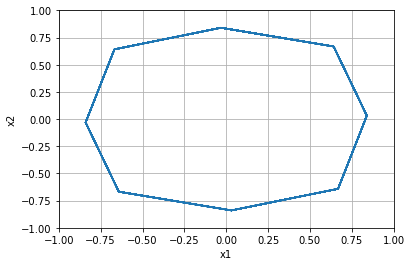


=================== Rollout 747 =====================
x_init [[-0.44]
 [ 0.32]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.44  0.32]
xx [-0.44  0.32]
xxx [-0.44  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.32000000000000006]


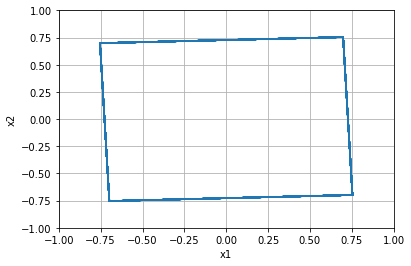


=================== Rollout 748 =====================
x_init [[-0.44]
 [ 0.36]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.44  0.36]
xx [-0.44  0.36]
xxx [-0.44  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.3600000000000001]


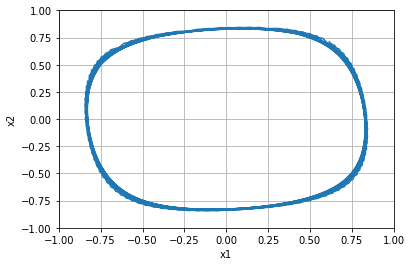


=================== Rollout 749 =====================
x_init [[-0.44]
 [ 0.4 ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.44  0.4 ]
xx [-0.44  0.4 ]
xxx [-0.44  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.40000000000000013]


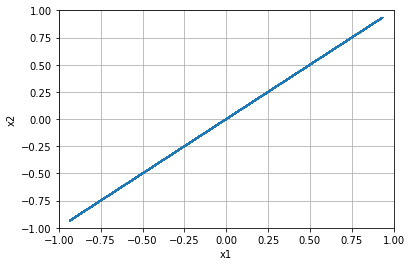


=================== Rollout 750 =====================
x_init [[-0.44]
 [ 0.44]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.44  0.44]
xx [-0.44  0.44]
xxx [-0.44  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.43999999999999995]


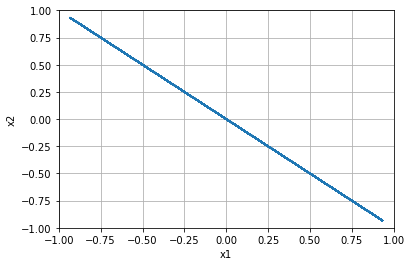


=================== Rollout 751 =====================
x_init [[-0.44]
 [ 0.48]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.44  0.48]
xx [-0.44  0.48]
xxx [-0.44  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.48]


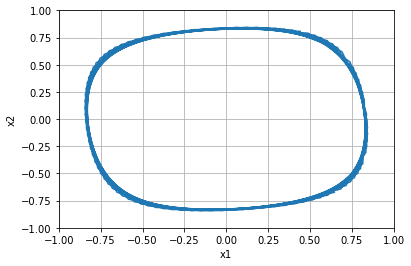


=================== Rollout 752 =====================
x_init [[-0.44]
 [ 0.52]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.44  0.52]
xx [-0.44  0.52]
xxx [-0.44  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.52]


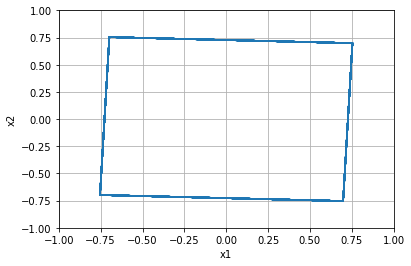


=================== Rollout 753 =====================
x_init [[-0.44]
 [ 0.56]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.44  0.56]
xx [-0.44  0.56]
xxx [-0.44  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.56]


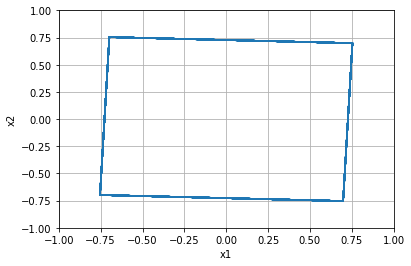


=================== Rollout 754 =====================
x_init [[-0.44]
 [ 0.6 ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.44  0.6 ]
xx [-0.44  0.6 ]
xxx [-0.44  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.6000000000000001]


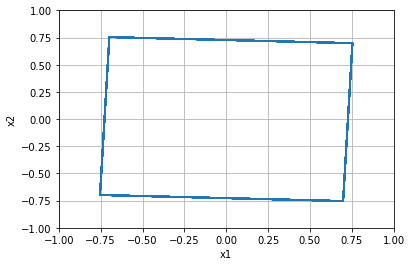


=================== Rollout 755 =====================
x_init [[-0.44]
 [ 0.64]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.44  0.64]
xx [-0.44  0.64]
xxx [-0.44  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.6400000000000001]


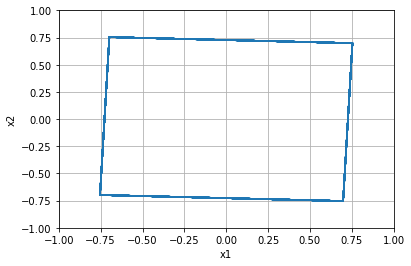


=================== Rollout 756 =====================
x_init [[-0.44]
 [ 0.68]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.44  0.68]
xx [-0.44  0.68]
xxx [-0.44  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.6799999999999999]


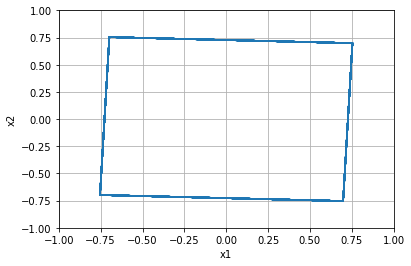


=================== Rollout 757 =====================
x_init [[-0.44]
 [ 0.72]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.44  0.72]
xx [-0.44  0.72]
xxx [-0.44  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.72]


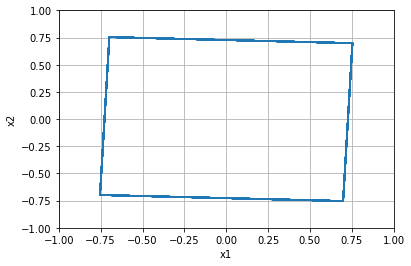


=================== Rollout 758 =====================
x_init [[-0.44]
 [ 0.76]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.44  0.76]
xx [-0.44  0.76]
xxx [-0.44  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.76]


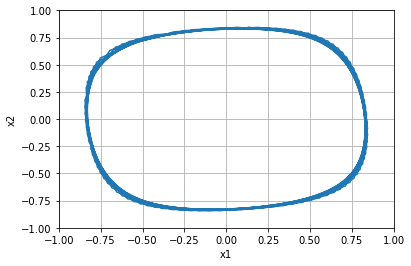


=================== Rollout 759 =====================
x_init [[-0.44]
 [ 0.8 ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.44  0.8 ]
xx [-0.44  0.8 ]
xxx [-0.44  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.8]


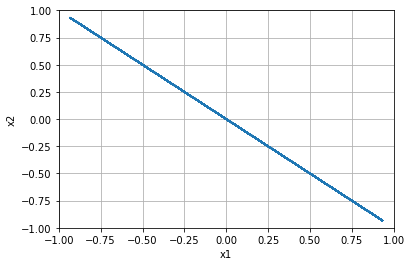


=================== Rollout 760 =====================
x_init [[-0.44]
 [ 0.84]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.44  0.84]
xx [-0.44  0.84]
xxx [-0.44  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.8400000000000001]


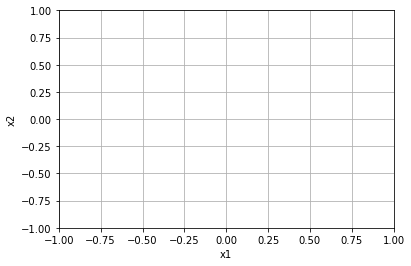


=================== Rollout 761 =====================
x_init [[-0.44]
 [ 0.88]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.44  0.88]
xx [-0.44  0.88]
xxx [-0.44  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.8800000000000001]


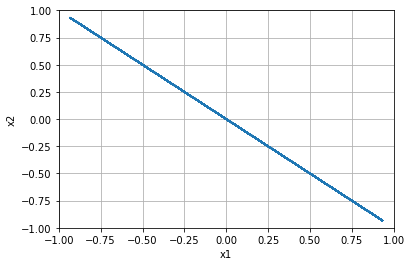


=================== Rollout 762 =====================
x_init [[-0.44]
 [ 0.92]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.44  0.92]
xx [-0.44  0.92]
xxx [-0.44  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.9199999999999999]


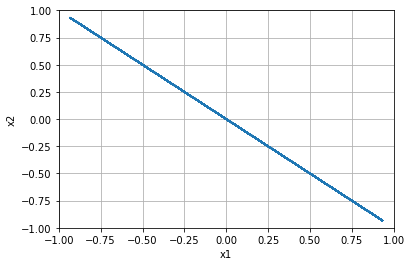


=================== Rollout 763 =====================
x_init [[-0.44]
 [ 0.96]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.44  0.96]
xx [-0.44  0.96]
xxx [-0.44  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 0.96]


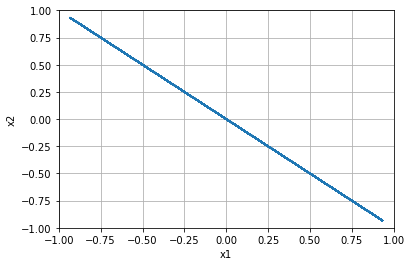


=================== Rollout 764 =====================
x_init [[-0.44]
 [ 1.  ]]
x_buffer [[-0.44 -0.44 -0.44 -0.44 -0.44]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.44  1.  ]
xx [-0.44  1.  ]
xxx [-0.44  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.43999999999999995, 1.0]


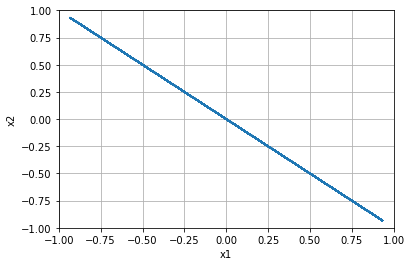


=================== Rollout 765 =====================
x_init [[-0.4]
 [-1. ]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [-1.  -1.  -1.  -1.  -1. ]]
x [-0.4 -1. ]
xx [-0.4 -1. ]
xxx [-0.4 -1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -1.0]


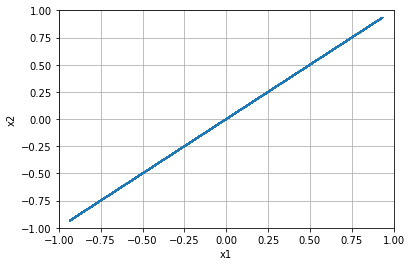


=================== Rollout 766 =====================
x_init [[-0.4 ]
 [-0.96]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.4  -0.96]
xx [-0.4  -0.96]
xxx [-0.4  -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.96]


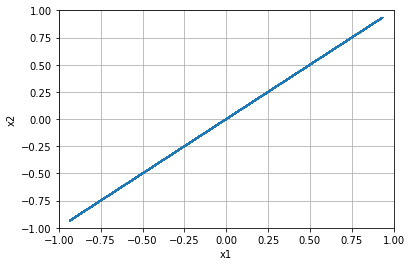


=================== Rollout 767 =====================
x_init [[-0.4 ]
 [-0.92]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.4  -0.92]
xx [-0.4  -0.92]
xxx [-0.4  -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.92]


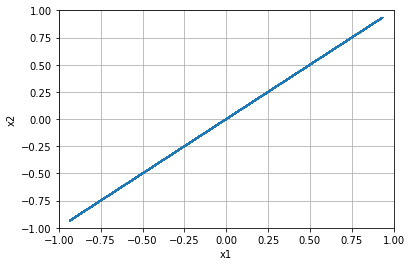


=================== Rollout 768 =====================
x_init [[-0.4 ]
 [-0.88]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.4  -0.88]
xx [-0.4  -0.88]
xxx [-0.4  -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.88]


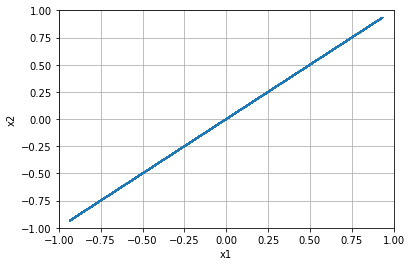


=================== Rollout 769 =====================
x_init [[-0.4 ]
 [-0.84]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.4  -0.84]
xx [-0.4  -0.84]
xxx [-0.4  -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.84]


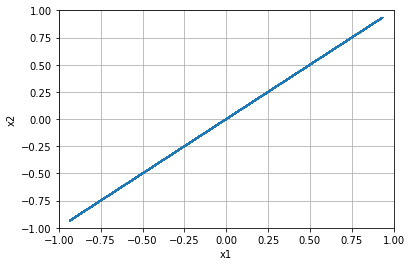


=================== Rollout 770 =====================
x_init [[-0.4]
 [-0.8]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [-0.4 -0.8]
xx [-0.4 -0.8]
xxx [-0.4 -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.8]


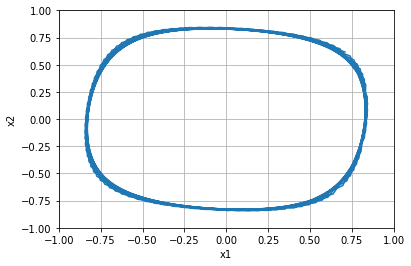


=================== Rollout 771 =====================
x_init [[-0.4 ]
 [-0.76]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.4  -0.76]
xx [-0.4  -0.76]
xxx [-0.4  -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.76]


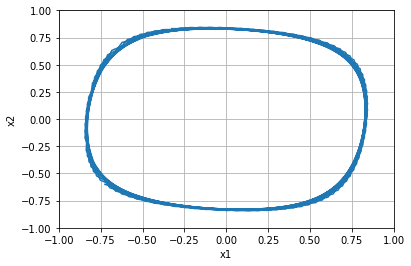


=================== Rollout 772 =====================
x_init [[-0.4 ]
 [-0.72]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.4  -0.72]
xx [-0.4  -0.72]
xxx [-0.4  -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.72]


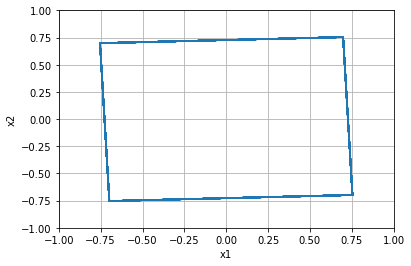


=================== Rollout 773 =====================
x_init [[-0.4 ]
 [-0.68]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.4  -0.68]
xx [-0.4  -0.68]
xxx [-0.4  -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.6799999999999999]


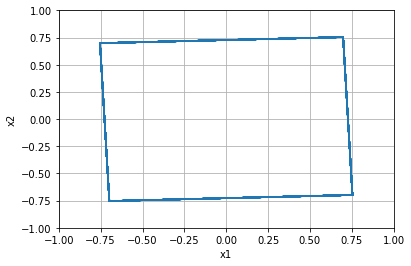


=================== Rollout 774 =====================
x_init [[-0.4 ]
 [-0.64]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.4  -0.64]
xx [-0.4  -0.64]
xxx [-0.4  -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.64]


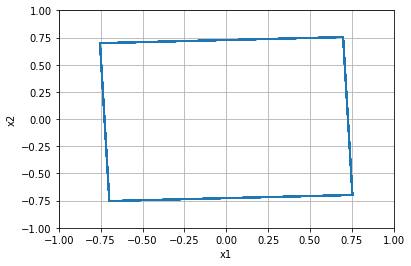


=================== Rollout 775 =====================
x_init [[-0.4]
 [-0.6]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [-0.4 -0.6]
xx [-0.4 -0.6]
xxx [-0.4 -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.6]


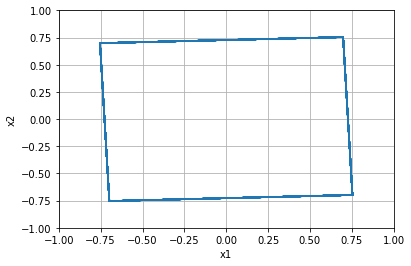


=================== Rollout 776 =====================
x_init [[-0.4 ]
 [-0.56]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.4  -0.56]
xx [-0.4  -0.56]
xxx [-0.4  -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.56]


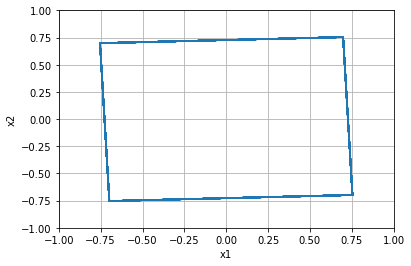


=================== Rollout 777 =====================
x_init [[-0.4 ]
 [-0.52]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.4  -0.52]
xx [-0.4  -0.52]
xxx [-0.4  -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.52]


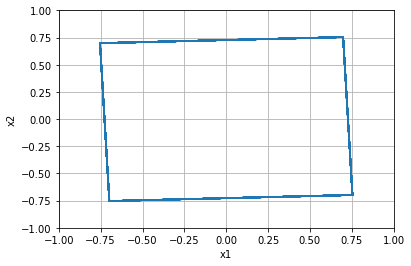


=================== Rollout 778 =====================
x_init [[-0.4 ]
 [-0.48]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.4  -0.48]
xx [-0.4  -0.48]
xxx [-0.4  -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.48]


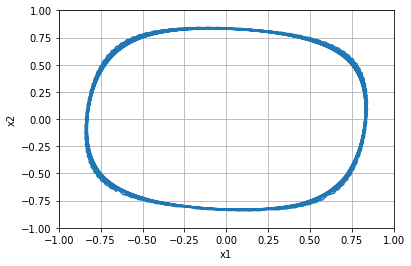


=================== Rollout 779 =====================
x_init [[-0.4 ]
 [-0.44]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.4  -0.44]
xx [-0.4  -0.44]
xxx [-0.4  -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.43999999999999995]


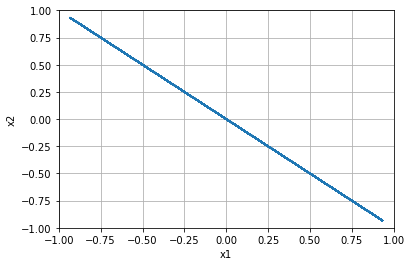


=================== Rollout 780 =====================
x_init [[-0.4]
 [-0.4]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [-0.4 -0.4]
xx [-0.4 -0.4]
xxx [-0.4 -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.4]


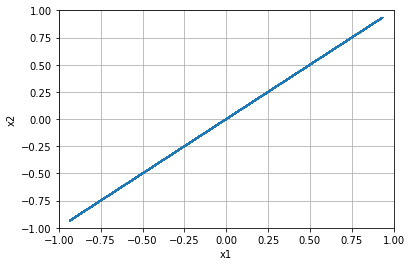


=================== Rollout 781 =====================
x_init [[-0.4 ]
 [-0.36]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.4  -0.36]
xx [-0.4  -0.36]
xxx [-0.4  -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.36]


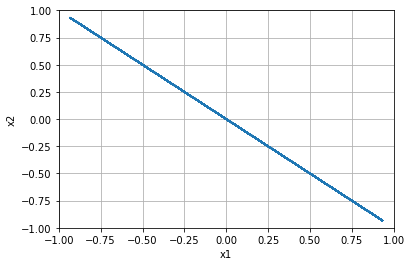


=================== Rollout 782 =====================
x_init [[-0.4 ]
 [-0.32]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.4  -0.32]
xx [-0.4  -0.32]
xxx [-0.4  -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.31999999999999995]


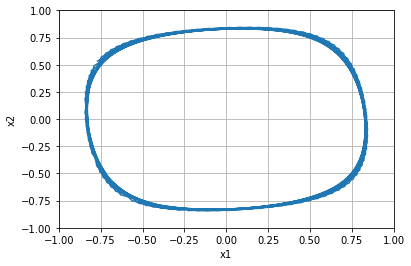


=================== Rollout 783 =====================
x_init [[-0.4 ]
 [-0.28]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.4  -0.28]
xx [-0.4  -0.28]
xxx [-0.4  -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.28]


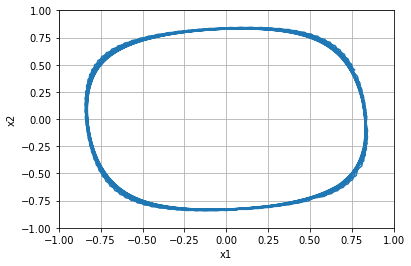


=================== Rollout 784 =====================
x_init [[-0.4 ]
 [-0.24]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.4  -0.24]
xx [-0.4  -0.24]
xxx [-0.4  -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.24]


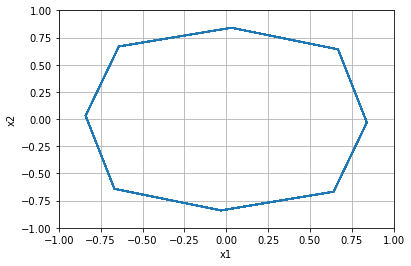


=================== Rollout 785 =====================
x_init [[-0.4]
 [-0.2]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [-0.4 -0.2]
xx [-0.4 -0.2]
xxx [-0.4 -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.19999999999999996]


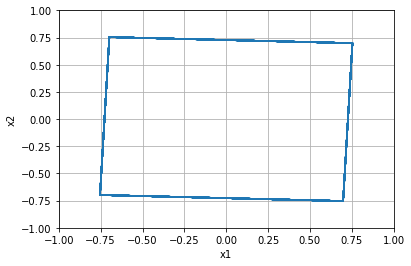


=================== Rollout 786 =====================
x_init [[-0.4 ]
 [-0.16]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.4  -0.16]
xx [-0.4  -0.16]
xxx [-0.4  -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.16000000000000003]


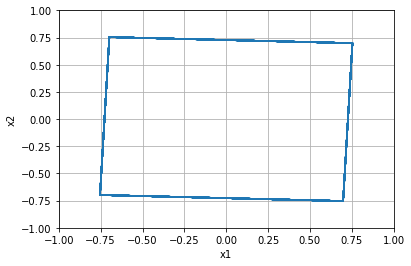


=================== Rollout 787 =====================
x_init [[-0.4 ]
 [-0.12]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.4  -0.12]
xx [-0.4  -0.12]
xxx [-0.4  -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.12]


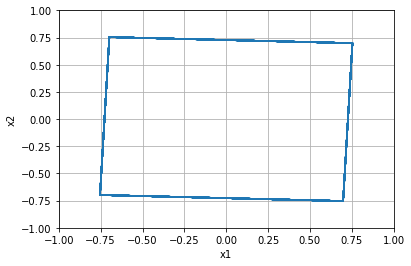


=================== Rollout 788 =====================
x_init [[-0.4 ]
 [-0.08]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.4  -0.08]
xx [-0.4  -0.08]
xxx [-0.4  -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.07999999999999996]


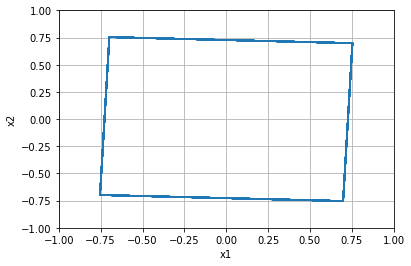


=================== Rollout 789 =====================
x_init [[-0.4 ]
 [-0.04]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.4  -0.04]
xx [-0.4  -0.04]
xxx [-0.4  -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, -0.040000000000000036]


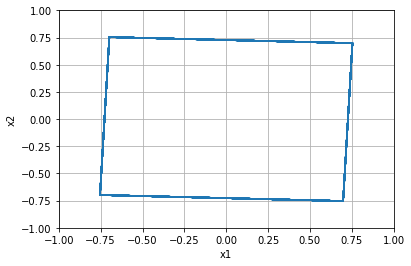


=================== Rollout 790 =====================
x_init [[-0.4]
 [ 0. ]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [ 0.   0.   0.   0.   0. ]]
x [-0.4  0. ]
xx [-0.4  0. ]
xxx [-0.4  0. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.0]


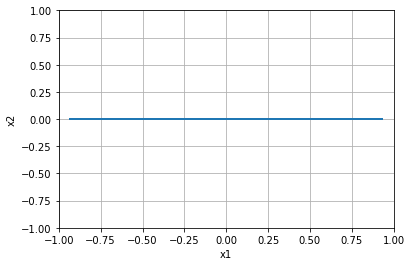


=================== Rollout 791 =====================
x_init [[-0.4 ]
 [ 0.04]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.4   0.04]
xx [-0.4   0.04]
xxx [-0.4   0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.040000000000000036]


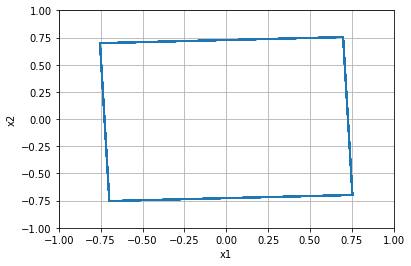


=================== Rollout 792 =====================
x_init [[-0.4 ]
 [ 0.08]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.4   0.08]
xx [-0.4   0.08]
xxx [-0.4   0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.08000000000000007]


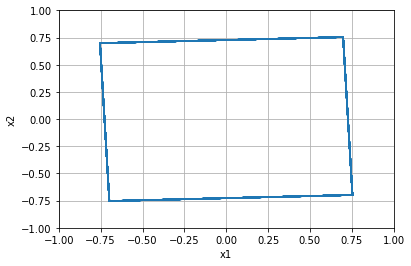


=================== Rollout 793 =====================
x_init [[-0.4 ]
 [ 0.12]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.4   0.12]
xx [-0.4   0.12]
xxx [-0.4   0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.1200000000000001]


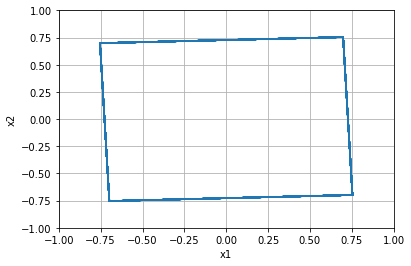


=================== Rollout 794 =====================
x_init [[-0.4 ]
 [ 0.16]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.4   0.16]
xx [-0.4   0.16]
xxx [-0.4   0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.15999999999999992]


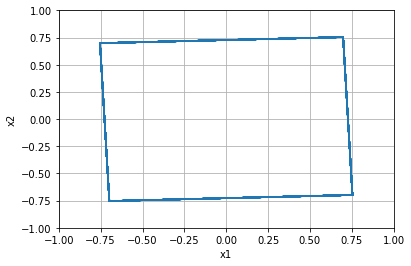


=================== Rollout 795 =====================
x_init [[-0.4]
 [ 0.2]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [ 0.2  0.2  0.2  0.2  0.2]]
x [-0.4  0.2]
xx [-0.4  0.2]
xxx [-0.4  0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.19999999999999996]


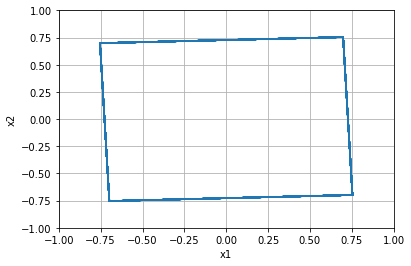


=================== Rollout 796 =====================
x_init [[-0.4 ]
 [ 0.24]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.4   0.24]
xx [-0.4   0.24]
xxx [-0.4   0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.24]


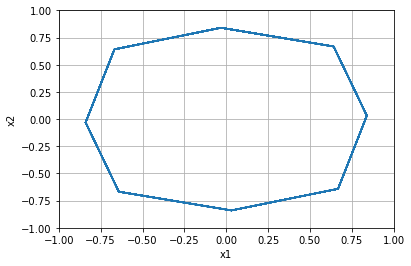


=================== Rollout 797 =====================
x_init [[-0.4 ]
 [ 0.28]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.4   0.28]
xx [-0.4   0.28]
xxx [-0.4   0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.28]


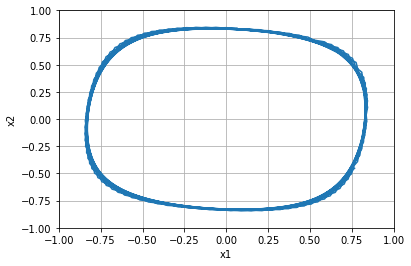


=================== Rollout 798 =====================
x_init [[-0.4 ]
 [ 0.32]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.4   0.32]
xx [-0.4   0.32]
xxx [-0.4   0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.32000000000000006]


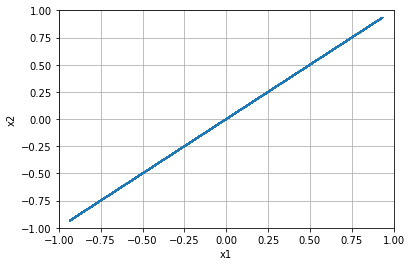


=================== Rollout 799 =====================
x_init [[-0.4 ]
 [ 0.36]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.4   0.36]
xx [-0.4   0.36]
xxx [-0.4   0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.3600000000000001]


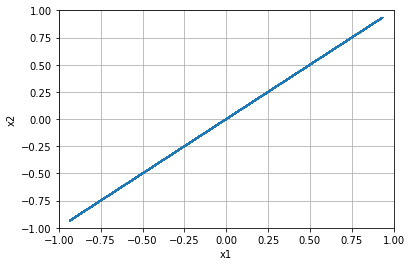


=================== Rollout 800 =====================
x_init [[-0.4]
 [ 0.4]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [ 0.4  0.4  0.4  0.4  0.4]]
x [-0.4  0.4]
xx [-0.4  0.4]
xxx [-0.4  0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.40000000000000013]


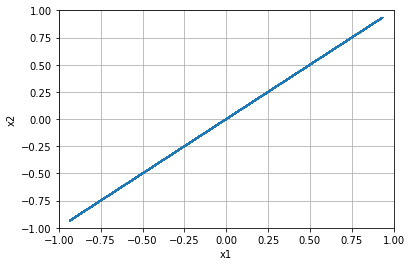


=================== Rollout 801 =====================
x_init [[-0.4 ]
 [ 0.44]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.4   0.44]
xx [-0.4   0.44]
xxx [-0.4   0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.43999999999999995]


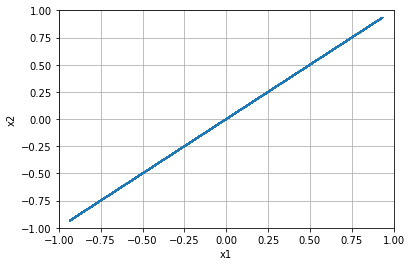


=================== Rollout 802 =====================
x_init [[-0.4 ]
 [ 0.48]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.4   0.48]
xx [-0.4   0.48]
xxx [-0.4   0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.48]


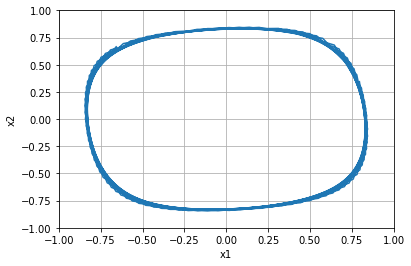


=================== Rollout 803 =====================
x_init [[-0.4 ]
 [ 0.52]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.4   0.52]
xx [-0.4   0.52]
xxx [-0.4   0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.52]


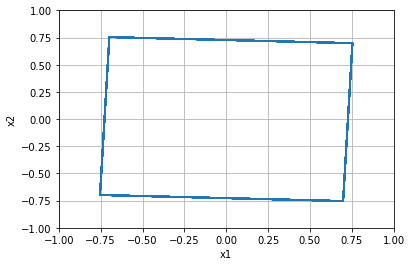


=================== Rollout 804 =====================
x_init [[-0.4 ]
 [ 0.56]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.4   0.56]
xx [-0.4   0.56]
xxx [-0.4   0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.56]


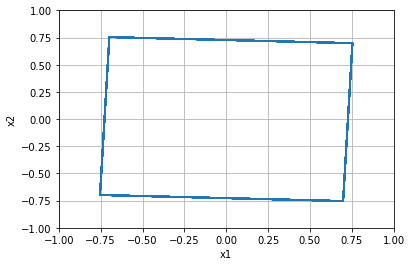


=================== Rollout 805 =====================
x_init [[-0.4]
 [ 0.6]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [ 0.6  0.6  0.6  0.6  0.6]]
x [-0.4  0.6]
xx [-0.4  0.6]
xxx [-0.4  0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.6000000000000001]


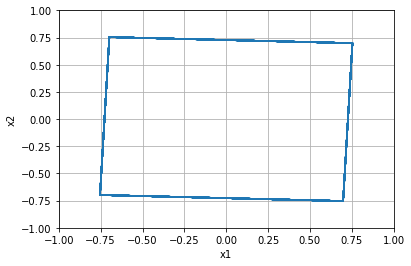


=================== Rollout 806 =====================
x_init [[-0.4 ]
 [ 0.64]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.4   0.64]
xx [-0.4   0.64]
xxx [-0.4   0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.6400000000000001]


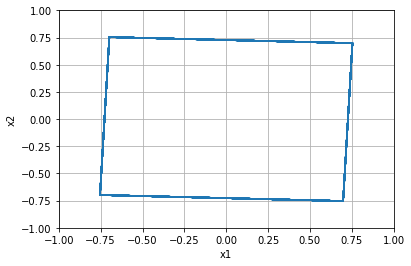


=================== Rollout 807 =====================
x_init [[-0.4 ]
 [ 0.68]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.4   0.68]
xx [-0.4   0.68]
xxx [-0.4   0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.6799999999999999]


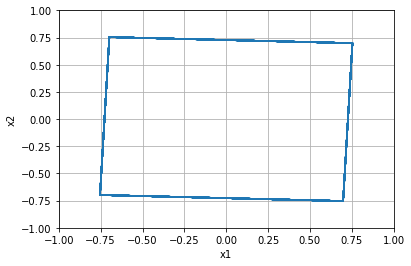


=================== Rollout 808 =====================
x_init [[-0.4 ]
 [ 0.72]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.4   0.72]
xx [-0.4   0.72]
xxx [-0.4   0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.72]


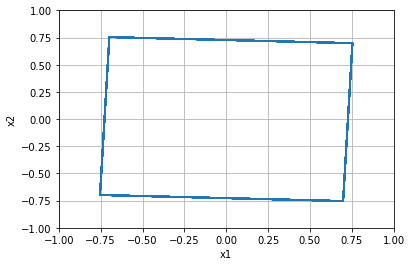


=================== Rollout 809 =====================
x_init [[-0.4 ]
 [ 0.76]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.4   0.76]
xx [-0.4   0.76]
xxx [-0.4   0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.76]


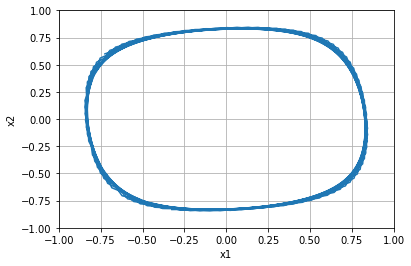


=================== Rollout 810 =====================
x_init [[-0.4]
 [ 0.8]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [ 0.8  0.8  0.8  0.8  0.8]]
x [-0.4  0.8]
xx [-0.4  0.8]
xxx [-0.4  0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.8]


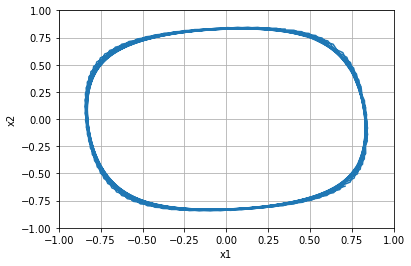


=================== Rollout 811 =====================
x_init [[-0.4 ]
 [ 0.84]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.4   0.84]
xx [-0.4   0.84]
xxx [-0.4   0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.8400000000000001]


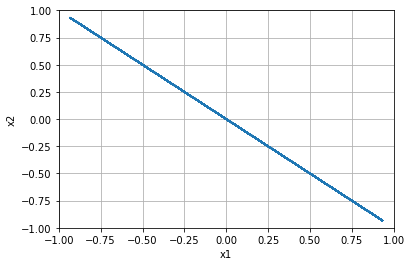


=================== Rollout 812 =====================
x_init [[-0.4 ]
 [ 0.88]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.4   0.88]
xx [-0.4   0.88]
xxx [-0.4   0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.8800000000000001]


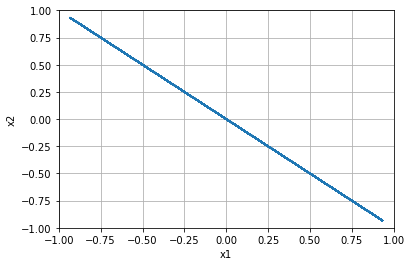


=================== Rollout 813 =====================
x_init [[-0.4 ]
 [ 0.92]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.4   0.92]
xx [-0.4   0.92]
xxx [-0.4   0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.9199999999999999]


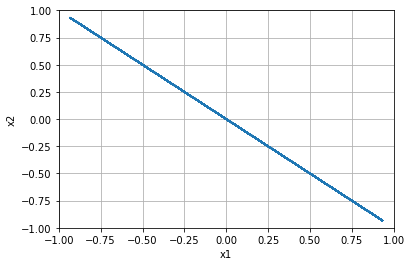


=================== Rollout 814 =====================
x_init [[-0.4 ]
 [ 0.96]]
x_buffer [[-0.4  -0.4  -0.4  -0.4  -0.4 ]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.4   0.96]
xx [-0.4   0.96]
xxx [-0.4   0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 0.96]


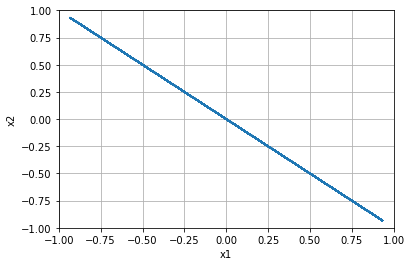


=================== Rollout 815 =====================
x_init [[-0.4]
 [ 1. ]]
x_buffer [[-0.4 -0.4 -0.4 -0.4 -0.4]
 [ 1.   1.   1.   1.   1. ]]
x [-0.4  1. ]
xx [-0.4  1. ]
xxx [-0.4  1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.4, 1.0]


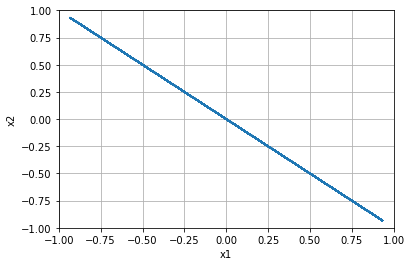


=================== Rollout 816 =====================
x_init [[-0.36]
 [-1.  ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.36 -1.  ]
xx [-0.36 -1.  ]
xxx [-0.36 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -1.0]


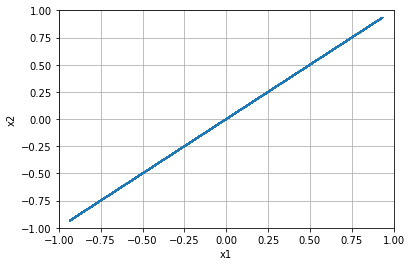


=================== Rollout 817 =====================
x_init [[-0.36]
 [-0.96]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.36 -0.96]
xx [-0.36 -0.96]
xxx [-0.36 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.96]


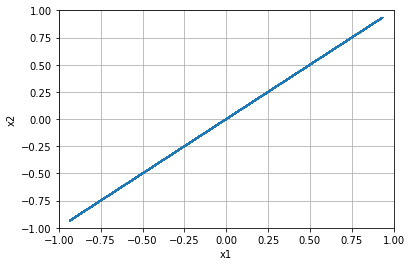


=================== Rollout 818 =====================
x_init [[-0.36]
 [-0.92]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.36 -0.92]
xx [-0.36 -0.92]
xxx [-0.36 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.92]


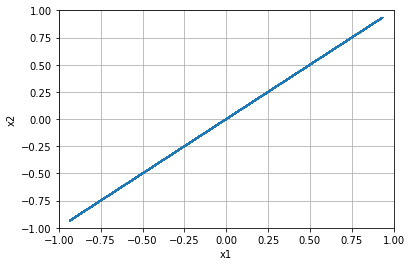


=================== Rollout 819 =====================
x_init [[-0.36]
 [-0.88]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.36 -0.88]
xx [-0.36 -0.88]
xxx [-0.36 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.88]


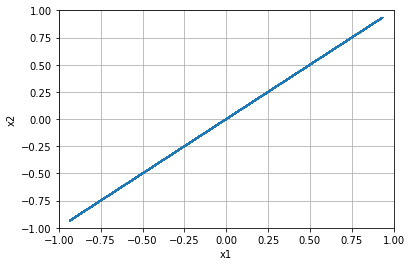


=================== Rollout 820 =====================
x_init [[-0.36]
 [-0.84]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.36 -0.84]
xx [-0.36 -0.84]
xxx [-0.36 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.84]


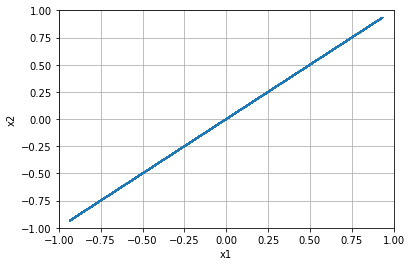


=================== Rollout 821 =====================
x_init [[-0.36]
 [-0.8 ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.36 -0.8 ]
xx [-0.36 -0.8 ]
xxx [-0.36 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.8]


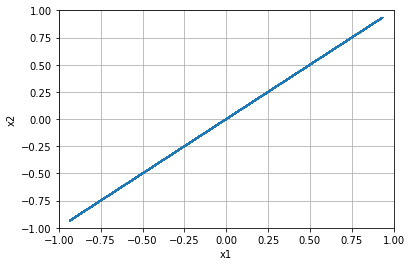


=================== Rollout 822 =====================
x_init [[-0.36]
 [-0.76]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.36 -0.76]
xx [-0.36 -0.76]
xxx [-0.36 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.76]


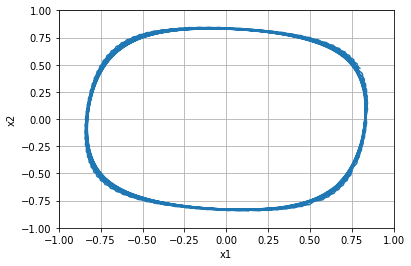


=================== Rollout 823 =====================
x_init [[-0.36]
 [-0.72]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.36 -0.72]
xx [-0.36 -0.72]
xxx [-0.36 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.72]


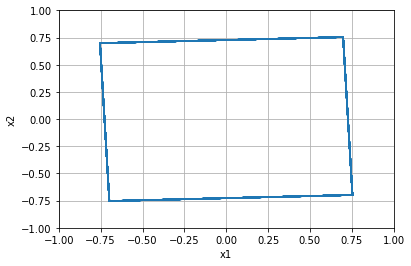


=================== Rollout 824 =====================
x_init [[-0.36]
 [-0.68]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.36 -0.68]
xx [-0.36 -0.68]
xxx [-0.36 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.6799999999999999]


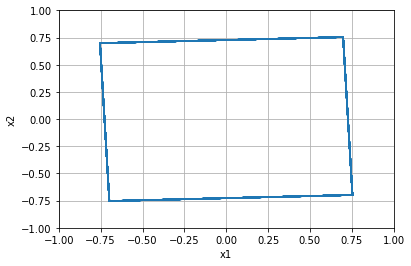


=================== Rollout 825 =====================
x_init [[-0.36]
 [-0.64]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.36 -0.64]
xx [-0.36 -0.64]
xxx [-0.36 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.64]


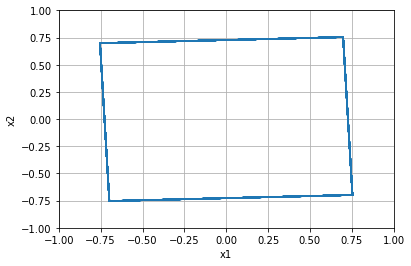


=================== Rollout 826 =====================
x_init [[-0.36]
 [-0.6 ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.36 -0.6 ]
xx [-0.36 -0.6 ]
xxx [-0.36 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.6]


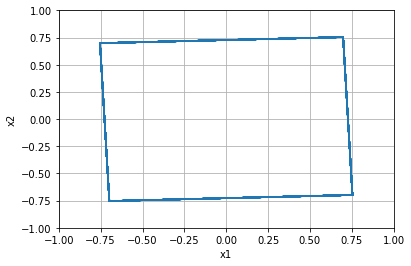


=================== Rollout 827 =====================
x_init [[-0.36]
 [-0.56]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.36 -0.56]
xx [-0.36 -0.56]
xxx [-0.36 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.56]


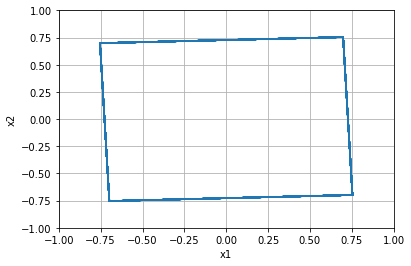


=================== Rollout 828 =====================
x_init [[-0.36]
 [-0.52]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.36 -0.52]
xx [-0.36 -0.52]
xxx [-0.36 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.52]


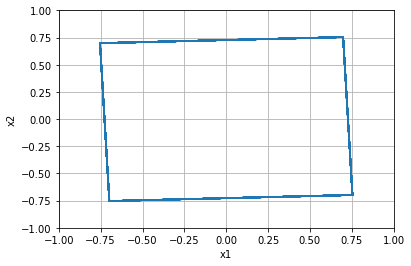


=================== Rollout 829 =====================
x_init [[-0.36]
 [-0.48]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.36 -0.48]
xx [-0.36 -0.48]
xxx [-0.36 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.48]


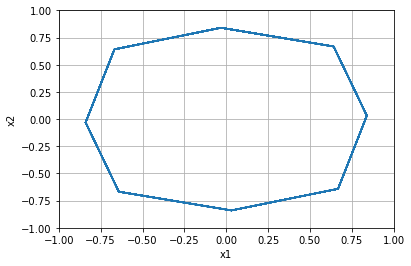


=================== Rollout 830 =====================
x_init [[-0.36]
 [-0.44]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.36 -0.44]
xx [-0.36 -0.44]
xxx [-0.36 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.43999999999999995]


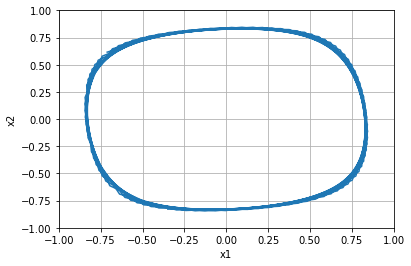


=================== Rollout 831 =====================
x_init [[-0.36]
 [-0.4 ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.36 -0.4 ]
xx [-0.36 -0.4 ]
xxx [-0.36 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.4]


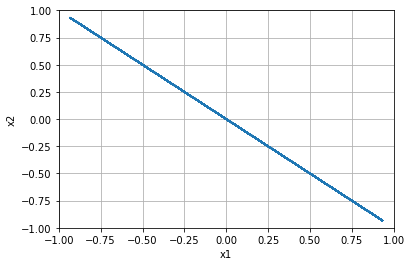


=================== Rollout 832 =====================
x_init [[-0.36]
 [-0.36]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.36 -0.36]
xx [-0.36 -0.36]
xxx [-0.36 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.36]


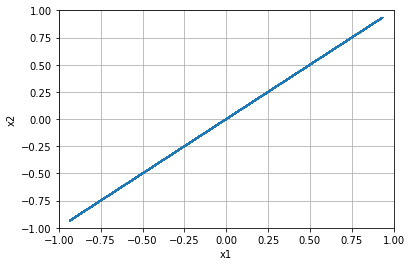


=================== Rollout 833 =====================
x_init [[-0.36]
 [-0.32]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.36 -0.32]
xx [-0.36 -0.32]
xxx [-0.36 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.31999999999999995]


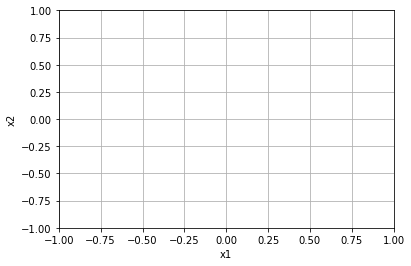


=================== Rollout 834 =====================
x_init [[-0.36]
 [-0.28]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.36 -0.28]
xx [-0.36 -0.28]
xxx [-0.36 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.28]


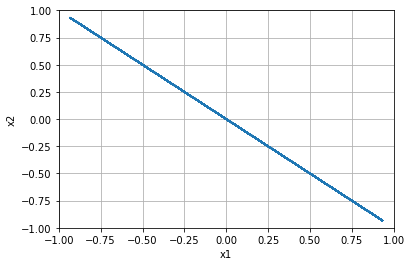


=================== Rollout 835 =====================
x_init [[-0.36]
 [-0.24]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.36 -0.24]
xx [-0.36 -0.24]
xxx [-0.36 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.24]


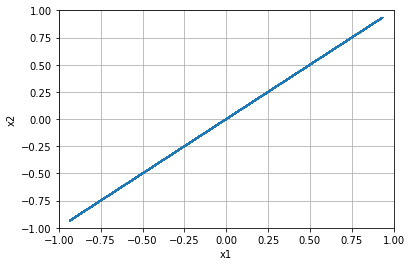


=================== Rollout 836 =====================
x_init [[-0.36]
 [-0.2 ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.36 -0.2 ]
xx [-0.36 -0.2 ]
xxx [-0.36 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.19999999999999996]


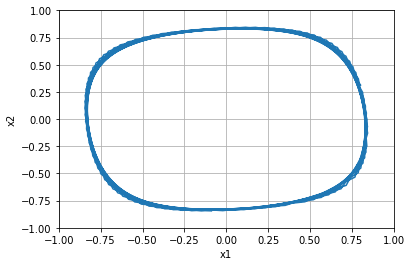


=================== Rollout 837 =====================
x_init [[-0.36]
 [-0.16]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.36 -0.16]
xx [-0.36 -0.16]
xxx [-0.36 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.16000000000000003]


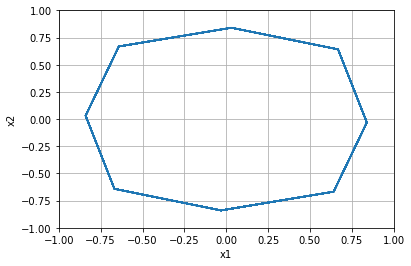


=================== Rollout 838 =====================
x_init [[-0.36]
 [-0.12]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.36 -0.12]
xx [-0.36 -0.12]
xxx [-0.36 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.12]


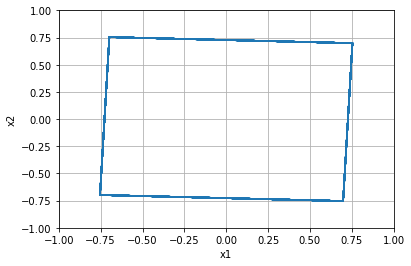


=================== Rollout 839 =====================
x_init [[-0.36]
 [-0.08]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.36 -0.08]
xx [-0.36 -0.08]
xxx [-0.36 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.07999999999999996]


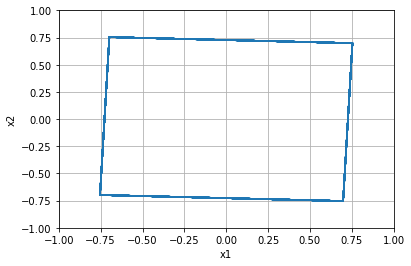


=================== Rollout 840 =====================
x_init [[-0.36]
 [-0.04]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.36 -0.04]
xx [-0.36 -0.04]
xxx [-0.36 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, -0.040000000000000036]


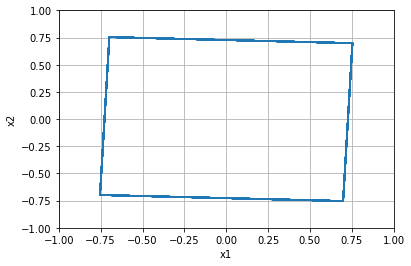


=================== Rollout 841 =====================
x_init [[-0.36]
 [ 0.  ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.36  0.  ]
xx [-0.36  0.  ]
xxx [-0.36  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.0]


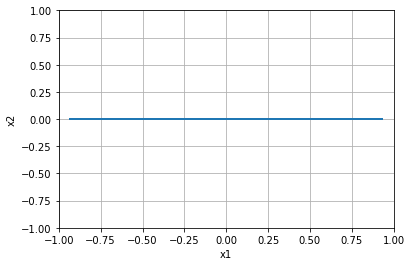


=================== Rollout 842 =====================
x_init [[-0.36]
 [ 0.04]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.36  0.04]
xx [-0.36  0.04]
xxx [-0.36  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.040000000000000036]


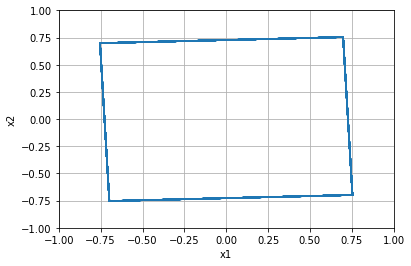


=================== Rollout 843 =====================
x_init [[-0.36]
 [ 0.08]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.36  0.08]
xx [-0.36  0.08]
xxx [-0.36  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.08000000000000007]


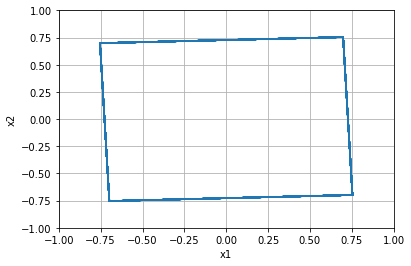


=================== Rollout 844 =====================
x_init [[-0.36]
 [ 0.12]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.36  0.12]
xx [-0.36  0.12]
xxx [-0.36  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.1200000000000001]


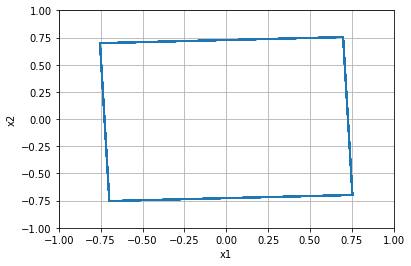


=================== Rollout 845 =====================
x_init [[-0.36]
 [ 0.16]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.36  0.16]
xx [-0.36  0.16]
xxx [-0.36  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.15999999999999992]


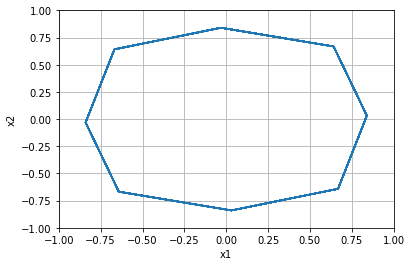


=================== Rollout 846 =====================
x_init [[-0.36]
 [ 0.2 ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.36  0.2 ]
xx [-0.36  0.2 ]
xxx [-0.36  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.19999999999999996]


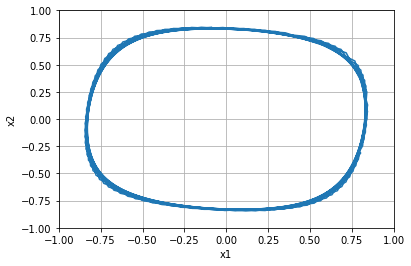


=================== Rollout 847 =====================
x_init [[-0.36]
 [ 0.24]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.36  0.24]
xx [-0.36  0.24]
xxx [-0.36  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.24]


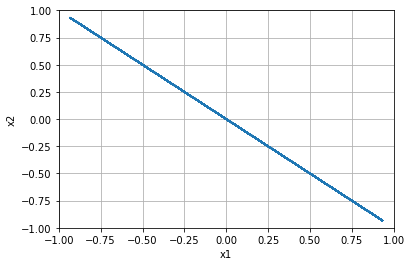


=================== Rollout 848 =====================
x_init [[-0.36]
 [ 0.28]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.36  0.28]
xx [-0.36  0.28]
xxx [-0.36  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.28]


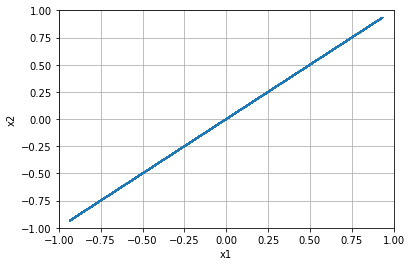


=================== Rollout 849 =====================
x_init [[-0.36]
 [ 0.32]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.36  0.32]
xx [-0.36  0.32]
xxx [-0.36  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.32000000000000006]


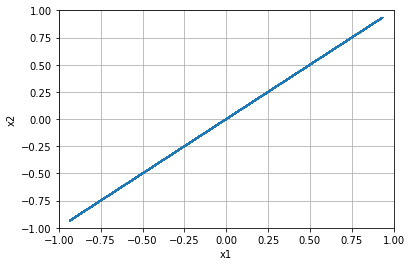


=================== Rollout 850 =====================
x_init [[-0.36]
 [ 0.36]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.36  0.36]
xx [-0.36  0.36]
xxx [-0.36  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.3600000000000001]


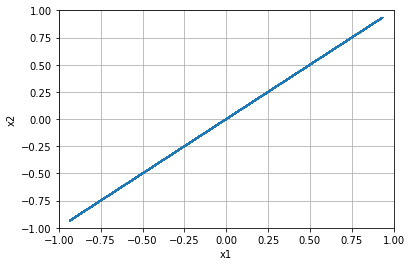


=================== Rollout 851 =====================
x_init [[-0.36]
 [ 0.4 ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.36  0.4 ]
xx [-0.36  0.4 ]
xxx [-0.36  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.40000000000000013]


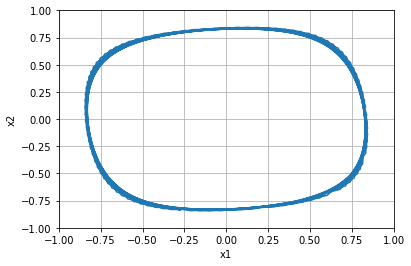


=================== Rollout 852 =====================
x_init [[-0.36]
 [ 0.44]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.36  0.44]
xx [-0.36  0.44]
xxx [-0.36  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.43999999999999995]


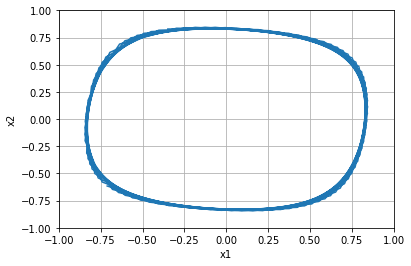


=================== Rollout 853 =====================
x_init [[-0.36]
 [ 0.48]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.36  0.48]
xx [-0.36  0.48]
xxx [-0.36  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.48]


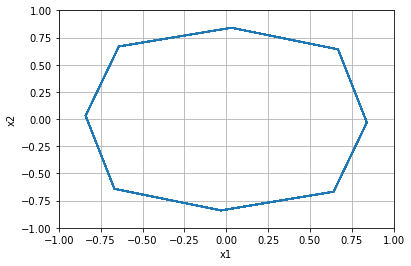


=================== Rollout 854 =====================
x_init [[-0.36]
 [ 0.52]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.36  0.52]
xx [-0.36  0.52]
xxx [-0.36  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.52]


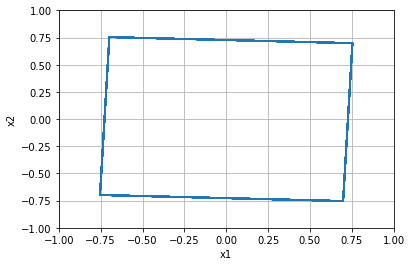


=================== Rollout 855 =====================
x_init [[-0.36]
 [ 0.56]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.36  0.56]
xx [-0.36  0.56]
xxx [-0.36  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.56]


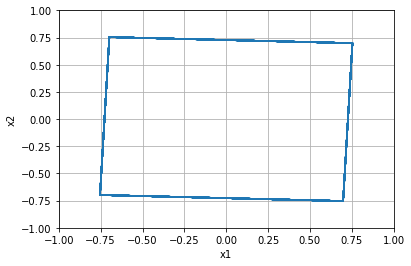


=================== Rollout 856 =====================
x_init [[-0.36]
 [ 0.6 ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.36  0.6 ]
xx [-0.36  0.6 ]
xxx [-0.36  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.6000000000000001]


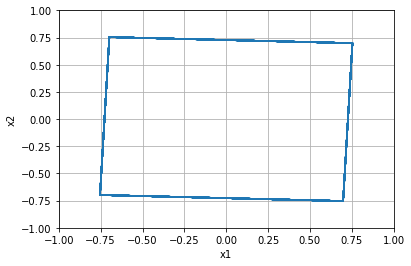


=================== Rollout 857 =====================
x_init [[-0.36]
 [ 0.64]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.36  0.64]
xx [-0.36  0.64]
xxx [-0.36  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.6400000000000001]


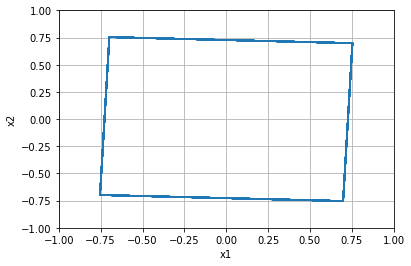


=================== Rollout 858 =====================
x_init [[-0.36]
 [ 0.68]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.36  0.68]
xx [-0.36  0.68]
xxx [-0.36  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.6799999999999999]


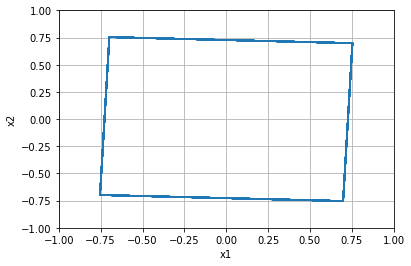


=================== Rollout 859 =====================
x_init [[-0.36]
 [ 0.72]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.36  0.72]
xx [-0.36  0.72]
xxx [-0.36  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.72]


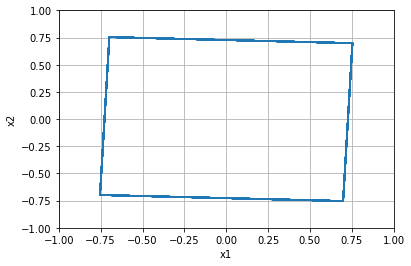


=================== Rollout 860 =====================
x_init [[-0.36]
 [ 0.76]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.36  0.76]
xx [-0.36  0.76]
xxx [-0.36  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.76]


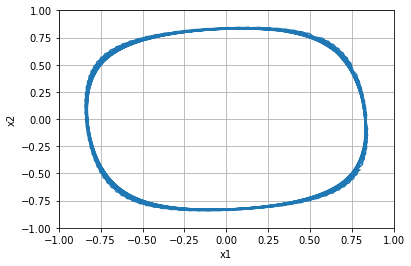


=================== Rollout 861 =====================
x_init [[-0.36]
 [ 0.8 ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.36  0.8 ]
xx [-0.36  0.8 ]
xxx [-0.36  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.8]


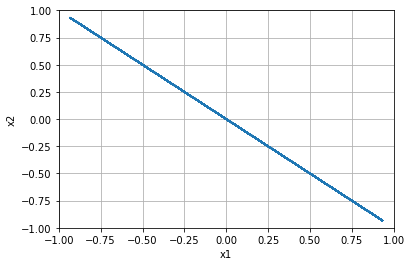


=================== Rollout 862 =====================
x_init [[-0.36]
 [ 0.84]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.36  0.84]
xx [-0.36  0.84]
xxx [-0.36  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.8400000000000001]


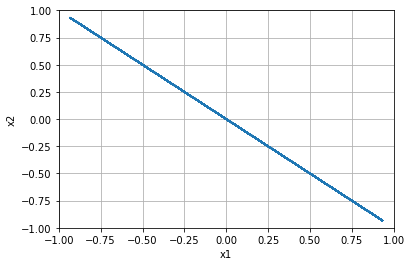


=================== Rollout 863 =====================
x_init [[-0.36]
 [ 0.88]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.36  0.88]
xx [-0.36  0.88]
xxx [-0.36  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.8800000000000001]


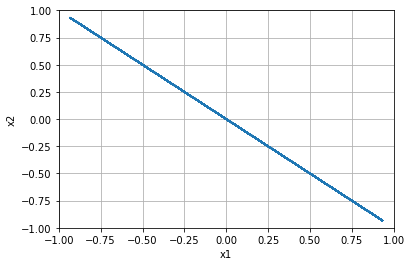


=================== Rollout 864 =====================
x_init [[-0.36]
 [ 0.92]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.36  0.92]
xx [-0.36  0.92]
xxx [-0.36  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.9199999999999999]


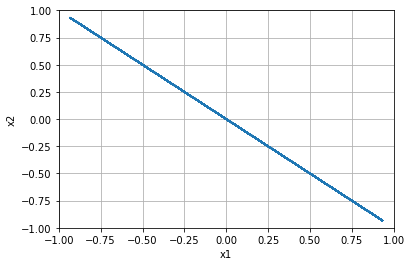


=================== Rollout 865 =====================
x_init [[-0.36]
 [ 0.96]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.36  0.96]
xx [-0.36  0.96]
xxx [-0.36  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 0.96]


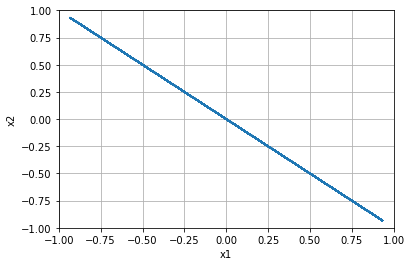


=================== Rollout 866 =====================
x_init [[-0.36]
 [ 1.  ]]
x_buffer [[-0.36 -0.36 -0.36 -0.36 -0.36]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.36  1.  ]
xx [-0.36  1.  ]
xxx [-0.36  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.36, 1.0]


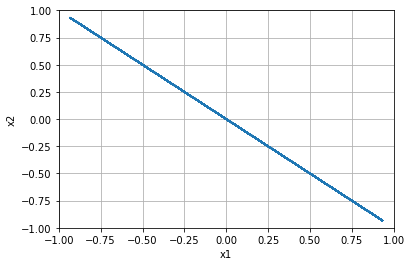


=================== Rollout 867 =====================
x_init [[-0.32]
 [-1.  ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.32 -1.  ]
xx [-0.32 -1.  ]
xxx [-0.32 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -1.0]


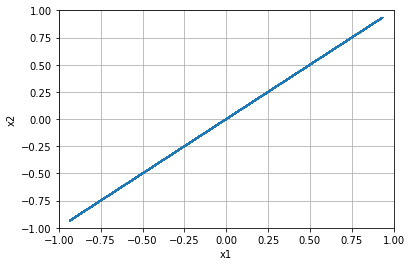


=================== Rollout 868 =====================
x_init [[-0.32]
 [-0.96]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.32 -0.96]
xx [-0.32 -0.96]
xxx [-0.32 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.96]


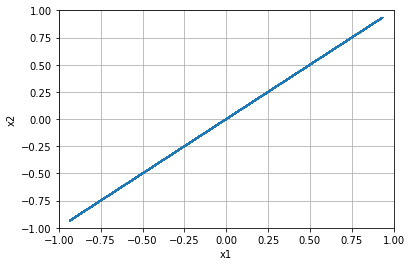


=================== Rollout 869 =====================
x_init [[-0.32]
 [-0.92]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.32 -0.92]
xx [-0.32 -0.92]
xxx [-0.32 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.92]


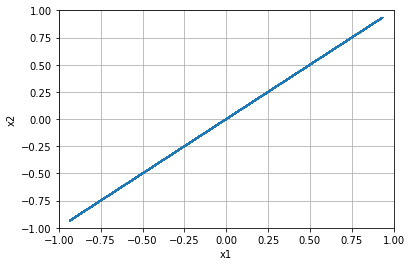


=================== Rollout 870 =====================
x_init [[-0.32]
 [-0.88]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.32 -0.88]
xx [-0.32 -0.88]
xxx [-0.32 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.88]


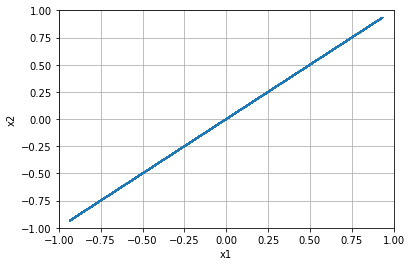


=================== Rollout 871 =====================
x_init [[-0.32]
 [-0.84]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.32 -0.84]
xx [-0.32 -0.84]
xxx [-0.32 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.84]


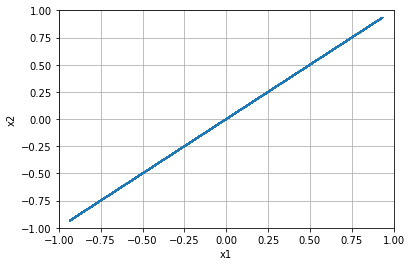


=================== Rollout 872 =====================
x_init [[-0.32]
 [-0.8 ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.32 -0.8 ]
xx [-0.32 -0.8 ]
xxx [-0.32 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.8]


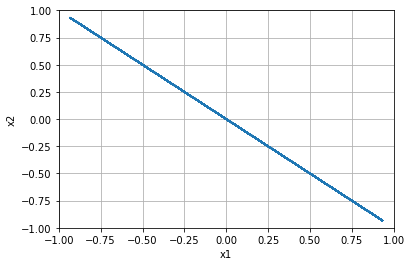


=================== Rollout 873 =====================
x_init [[-0.32]
 [-0.76]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.32 -0.76]
xx [-0.32 -0.76]
xxx [-0.32 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.76]


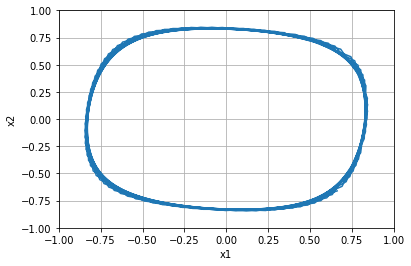


=================== Rollout 874 =====================
x_init [[-0.32]
 [-0.72]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.32 -0.72]
xx [-0.32 -0.72]
xxx [-0.32 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.72]


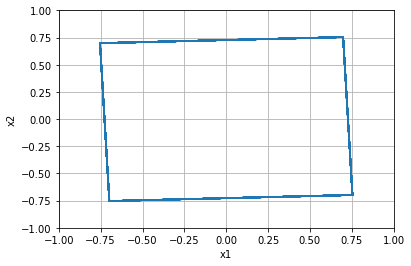


=================== Rollout 875 =====================
x_init [[-0.32]
 [-0.68]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.32 -0.68]
xx [-0.32 -0.68]
xxx [-0.32 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.6799999999999999]


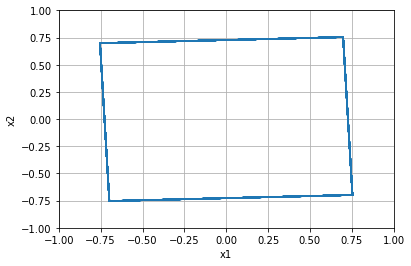


=================== Rollout 876 =====================
x_init [[-0.32]
 [-0.64]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.32 -0.64]
xx [-0.32 -0.64]
xxx [-0.32 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.64]


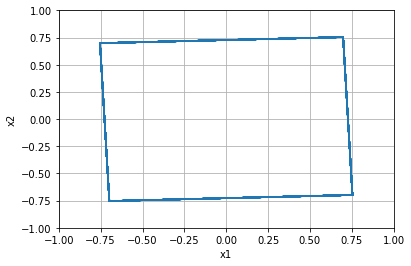


=================== Rollout 877 =====================
x_init [[-0.32]
 [-0.6 ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.32 -0.6 ]
xx [-0.32 -0.6 ]
xxx [-0.32 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.6]


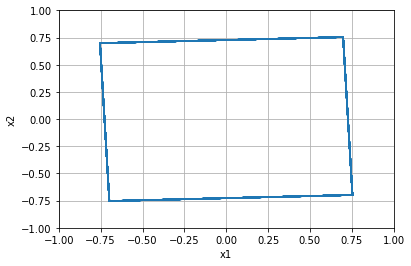


=================== Rollout 878 =====================
x_init [[-0.32]
 [-0.56]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.32 -0.56]
xx [-0.32 -0.56]
xxx [-0.32 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.56]


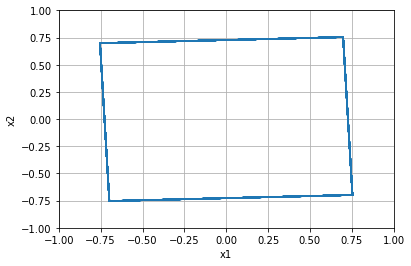


=================== Rollout 879 =====================
x_init [[-0.32]
 [-0.52]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.32 -0.52]
xx [-0.32 -0.52]
xxx [-0.32 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.52]


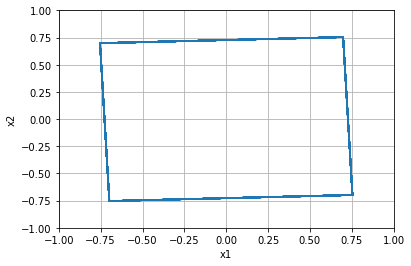


=================== Rollout 880 =====================
x_init [[-0.32]
 [-0.48]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.32 -0.48]
xx [-0.32 -0.48]
xxx [-0.32 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.48]


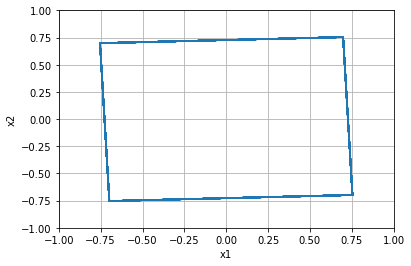


=================== Rollout 881 =====================
x_init [[-0.32]
 [-0.44]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.32 -0.44]
xx [-0.32 -0.44]
xxx [-0.32 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.43999999999999995]


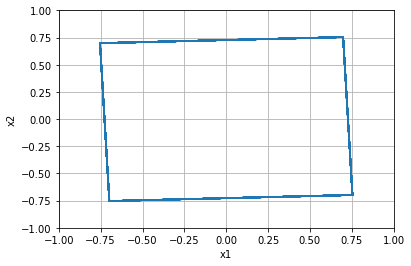


=================== Rollout 882 =====================
x_init [[-0.32]
 [-0.4 ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.32 -0.4 ]
xx [-0.32 -0.4 ]
xxx [-0.32 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.4]


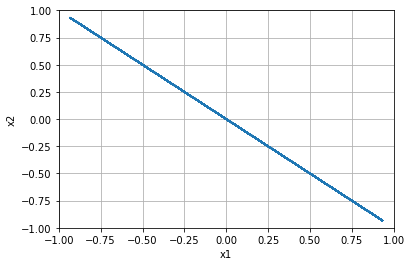


=================== Rollout 883 =====================
x_init [[-0.32]
 [-0.36]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.32 -0.36]
xx [-0.32 -0.36]
xxx [-0.32 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.36]


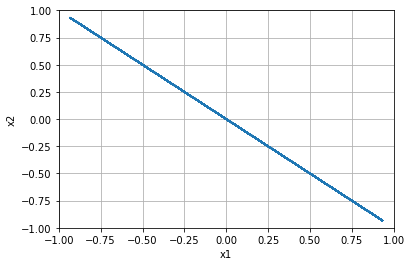


=================== Rollout 884 =====================
x_init [[-0.32]
 [-0.32]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.32 -0.32]
xx [-0.32 -0.32]
xxx [-0.32 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.31999999999999995]


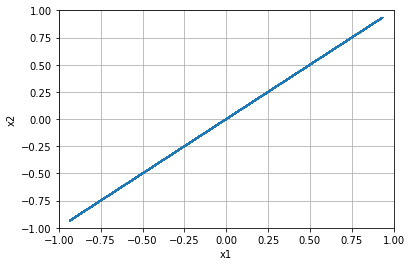


=================== Rollout 885 =====================
x_init [[-0.32]
 [-0.28]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.32 -0.28]
xx [-0.32 -0.28]
xxx [-0.32 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.28]


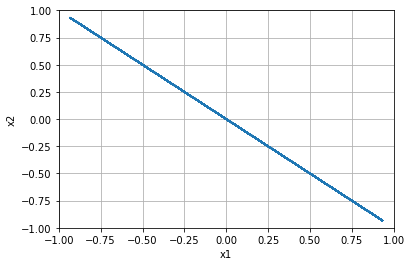


=================== Rollout 886 =====================
x_init [[-0.32]
 [-0.24]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.32 -0.24]
xx [-0.32 -0.24]
xxx [-0.32 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.24]


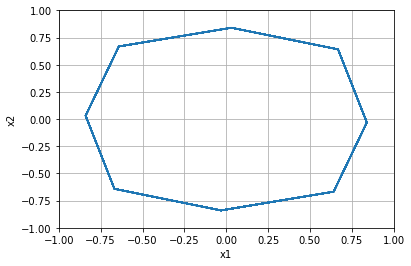


=================== Rollout 887 =====================
x_init [[-0.32]
 [-0.2 ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.32 -0.2 ]
xx [-0.32 -0.2 ]
xxx [-0.32 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.19999999999999996]


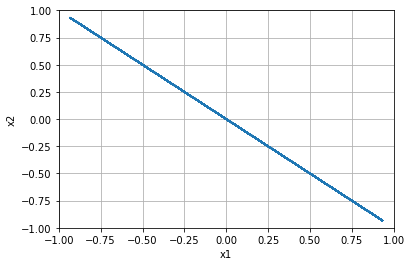


=================== Rollout 888 =====================
x_init [[-0.32]
 [-0.16]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.32 -0.16]
xx [-0.32 -0.16]
xxx [-0.32 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.16000000000000003]


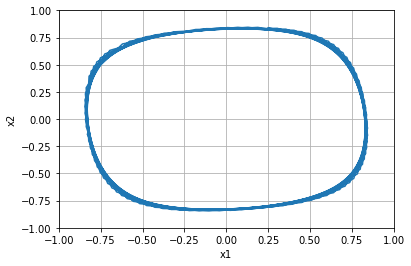


=================== Rollout 889 =====================
x_init [[-0.32]
 [-0.12]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.32 -0.12]
xx [-0.32 -0.12]
xxx [-0.32 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.12]


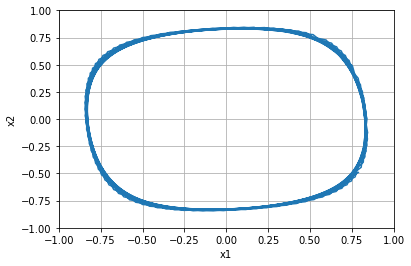


=================== Rollout 890 =====================
x_init [[-0.32]
 [-0.08]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.32 -0.08]
xx [-0.32 -0.08]
xxx [-0.32 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.07999999999999996]


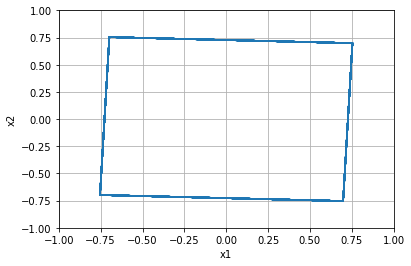


=================== Rollout 891 =====================
x_init [[-0.32]
 [-0.04]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.32 -0.04]
xx [-0.32 -0.04]
xxx [-0.32 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, -0.040000000000000036]


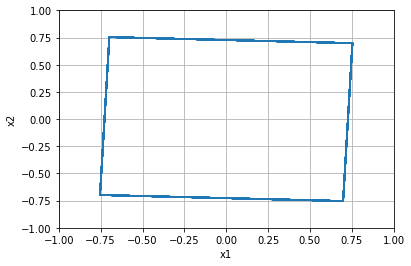


=================== Rollout 892 =====================
x_init [[-0.32]
 [ 0.  ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.32  0.  ]
xx [-0.32  0.  ]
xxx [-0.32  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.0]


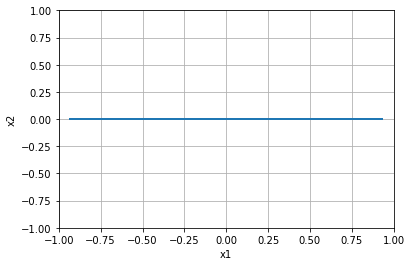


=================== Rollout 893 =====================
x_init [[-0.32]
 [ 0.04]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.32  0.04]
xx [-0.32  0.04]
xxx [-0.32  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.040000000000000036]


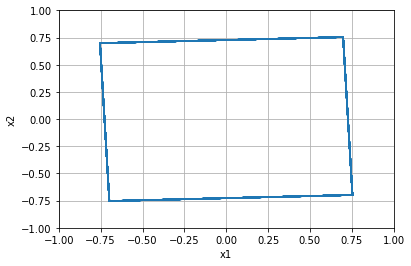


=================== Rollout 894 =====================
x_init [[-0.32]
 [ 0.08]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.32  0.08]
xx [-0.32  0.08]
xxx [-0.32  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.08000000000000007]


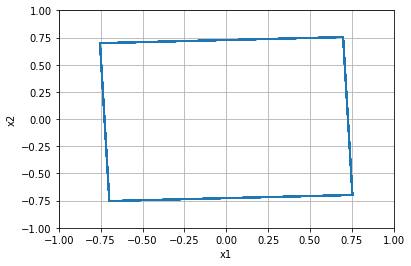


=================== Rollout 895 =====================
x_init [[-0.32]
 [ 0.12]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.32  0.12]
xx [-0.32  0.12]
xxx [-0.32  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.1200000000000001]


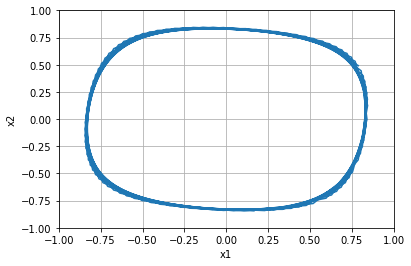


=================== Rollout 896 =====================
x_init [[-0.32]
 [ 0.16]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.32  0.16]
xx [-0.32  0.16]
xxx [-0.32  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.15999999999999992]


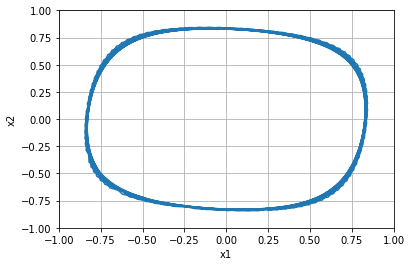


=================== Rollout 897 =====================
x_init [[-0.32]
 [ 0.2 ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.32  0.2 ]
xx [-0.32  0.2 ]
xxx [-0.32  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.19999999999999996]


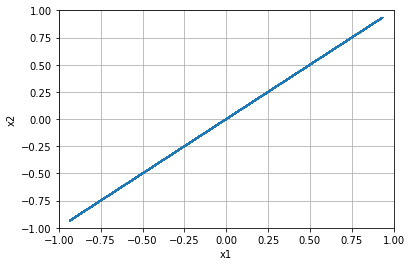


=================== Rollout 898 =====================
x_init [[-0.32]
 [ 0.24]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.32  0.24]
xx [-0.32  0.24]
xxx [-0.32  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.24]


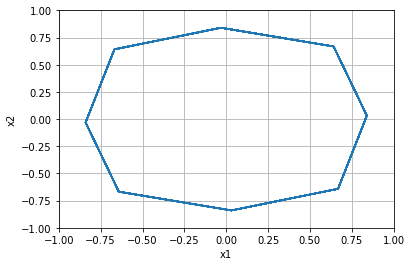


=================== Rollout 899 =====================
x_init [[-0.32]
 [ 0.28]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.32  0.28]
xx [-0.32  0.28]
xxx [-0.32  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.28]


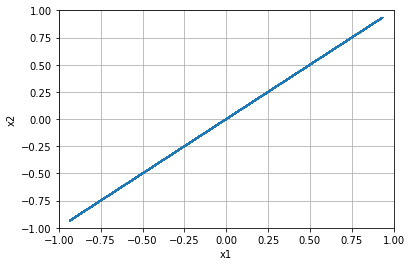


=================== Rollout 900 =====================
x_init [[-0.32]
 [ 0.32]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.32  0.32]
xx [-0.32  0.32]
xxx [-0.32  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.32000000000000006]


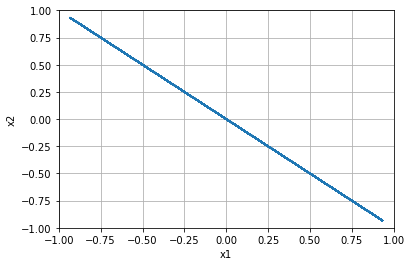


=================== Rollout 901 =====================
x_init [[-0.32]
 [ 0.36]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.32  0.36]
xx [-0.32  0.36]
xxx [-0.32  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.3600000000000001]


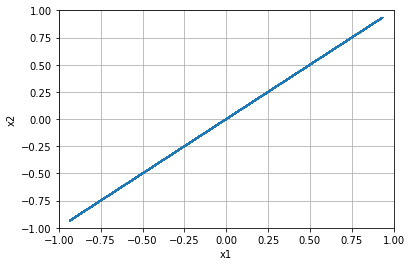


=================== Rollout 902 =====================
x_init [[-0.32]
 [ 0.4 ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.32  0.4 ]
xx [-0.32  0.4 ]
xxx [-0.32  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.40000000000000013]


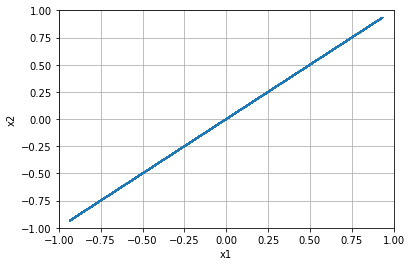


=================== Rollout 903 =====================
x_init [[-0.32]
 [ 0.44]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.32  0.44]
xx [-0.32  0.44]
xxx [-0.32  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.43999999999999995]


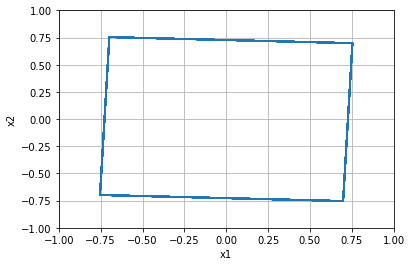


=================== Rollout 904 =====================
x_init [[-0.32]
 [ 0.48]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.32  0.48]
xx [-0.32  0.48]
xxx [-0.32  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.48]


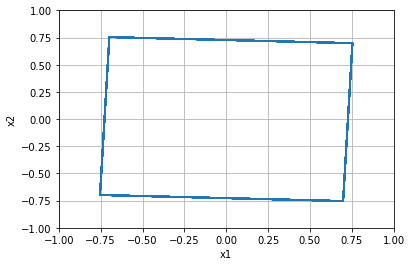


=================== Rollout 905 =====================
x_init [[-0.32]
 [ 0.52]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.32  0.52]
xx [-0.32  0.52]
xxx [-0.32  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.52]


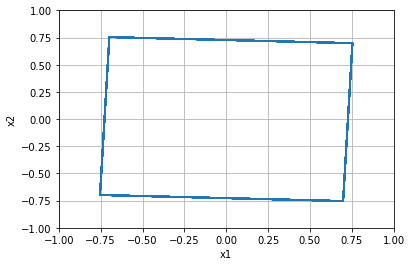


=================== Rollout 906 =====================
x_init [[-0.32]
 [ 0.56]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.32  0.56]
xx [-0.32  0.56]
xxx [-0.32  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.56]


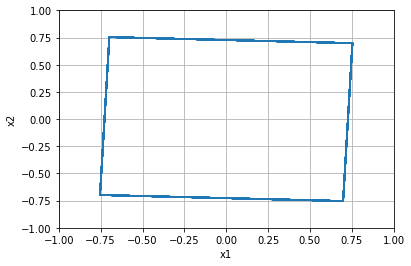


=================== Rollout 907 =====================
x_init [[-0.32]
 [ 0.6 ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.32  0.6 ]
xx [-0.32  0.6 ]
xxx [-0.32  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.6000000000000001]


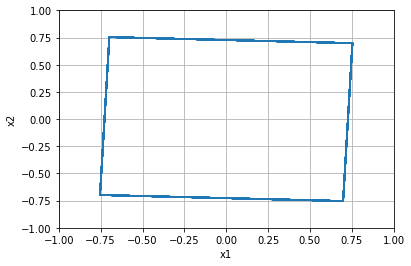


=================== Rollout 908 =====================
x_init [[-0.32]
 [ 0.64]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.32  0.64]
xx [-0.32  0.64]
xxx [-0.32  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.6400000000000001]


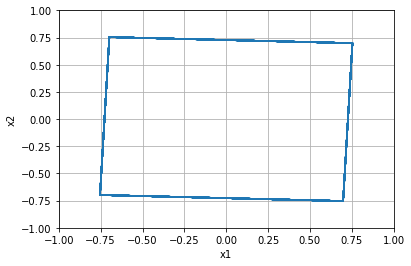


=================== Rollout 909 =====================
x_init [[-0.32]
 [ 0.68]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.32  0.68]
xx [-0.32  0.68]
xxx [-0.32  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.6799999999999999]


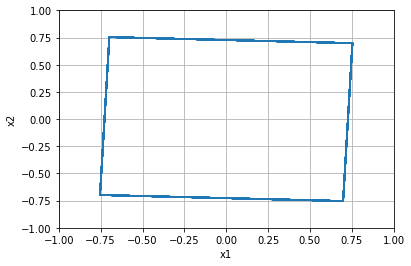


=================== Rollout 910 =====================
x_init [[-0.32]
 [ 0.72]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.32  0.72]
xx [-0.32  0.72]
xxx [-0.32  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.72]


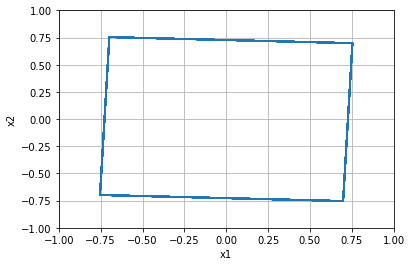


=================== Rollout 911 =====================
x_init [[-0.32]
 [ 0.76]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.32  0.76]
xx [-0.32  0.76]
xxx [-0.32  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.76]


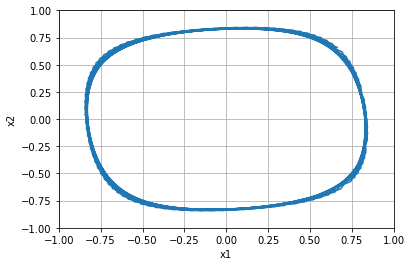


=================== Rollout 912 =====================
x_init [[-0.32]
 [ 0.8 ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.32  0.8 ]
xx [-0.32  0.8 ]
xxx [-0.32  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.8]


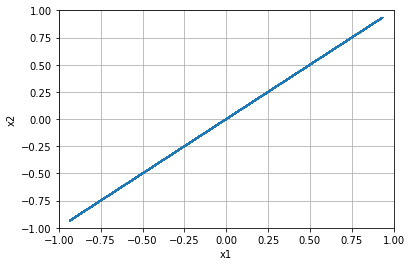


=================== Rollout 913 =====================
x_init [[-0.32]
 [ 0.84]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.32  0.84]
xx [-0.32  0.84]
xxx [-0.32  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.8400000000000001]


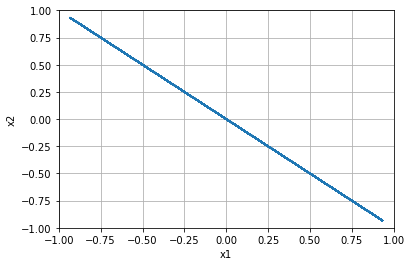


=================== Rollout 914 =====================
x_init [[-0.32]
 [ 0.88]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.32  0.88]
xx [-0.32  0.88]
xxx [-0.32  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.8800000000000001]


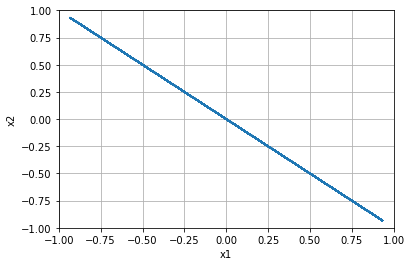


=================== Rollout 915 =====================
x_init [[-0.32]
 [ 0.92]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.32  0.92]
xx [-0.32  0.92]
xxx [-0.32  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.9199999999999999]


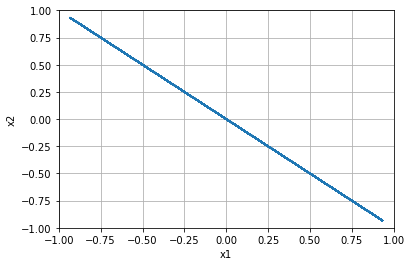


=================== Rollout 916 =====================
x_init [[-0.32]
 [ 0.96]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.32  0.96]
xx [-0.32  0.96]
xxx [-0.32  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 0.96]


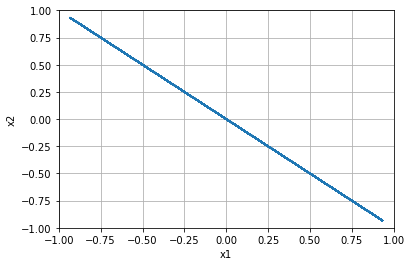


=================== Rollout 917 =====================
x_init [[-0.32]
 [ 1.  ]]
x_buffer [[-0.32 -0.32 -0.32 -0.32 -0.32]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.32  1.  ]
xx [-0.32  1.  ]
xxx [-0.32  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.31999999999999995, 1.0]


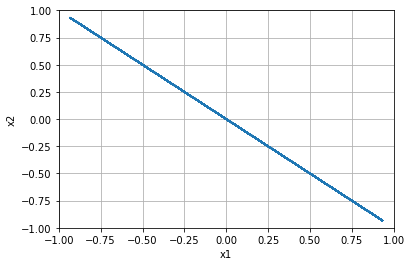


=================== Rollout 918 =====================
x_init [[-0.28]
 [-1.  ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.28 -1.  ]
xx [-0.28 -1.  ]
xxx [-0.28 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -1.0]


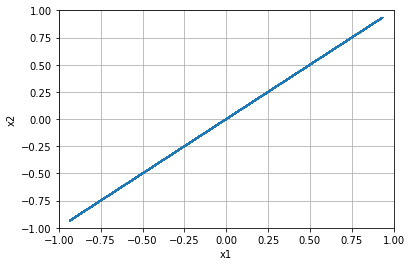


=================== Rollout 919 =====================
x_init [[-0.28]
 [-0.96]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.28 -0.96]
xx [-0.28 -0.96]
xxx [-0.28 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.96]


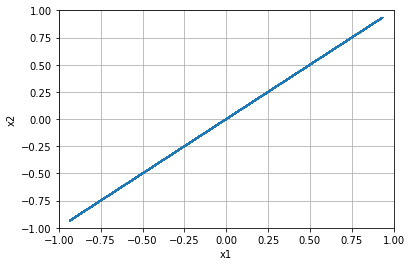


=================== Rollout 920 =====================
x_init [[-0.28]
 [-0.92]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.28 -0.92]
xx [-0.28 -0.92]
xxx [-0.28 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.92]


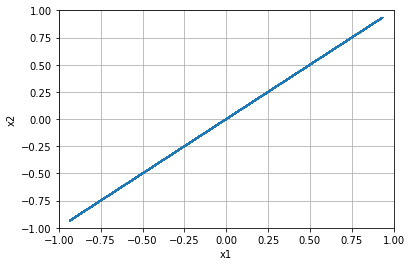


=================== Rollout 921 =====================
x_init [[-0.28]
 [-0.88]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.28 -0.88]
xx [-0.28 -0.88]
xxx [-0.28 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.88]


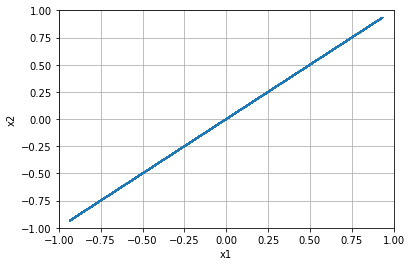


=================== Rollout 922 =====================
x_init [[-0.28]
 [-0.84]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.28 -0.84]
xx [-0.28 -0.84]
xxx [-0.28 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.84]


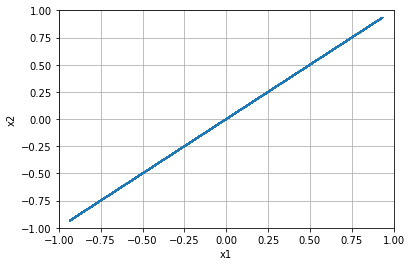


=================== Rollout 923 =====================
x_init [[-0.28]
 [-0.8 ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.28 -0.8 ]
xx [-0.28 -0.8 ]
xxx [-0.28 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.8]


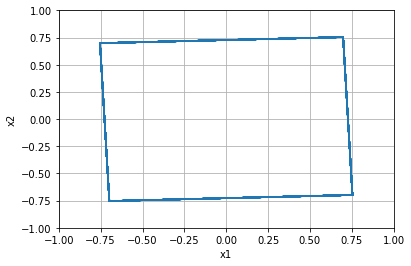


=================== Rollout 924 =====================
x_init [[-0.28]
 [-0.76]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.28 -0.76]
xx [-0.28 -0.76]
xxx [-0.28 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.76]


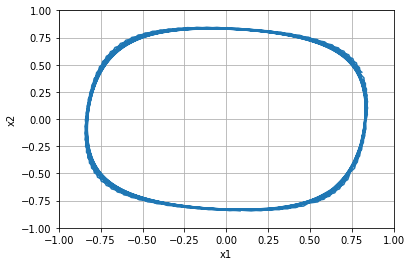


=================== Rollout 925 =====================
x_init [[-0.28]
 [-0.72]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.28 -0.72]
xx [-0.28 -0.72]
xxx [-0.28 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.72]


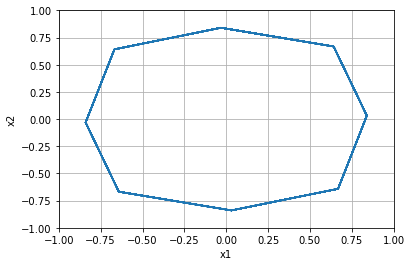


=================== Rollout 926 =====================
x_init [[-0.28]
 [-0.68]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.28 -0.68]
xx [-0.28 -0.68]
xxx [-0.28 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.6799999999999999]


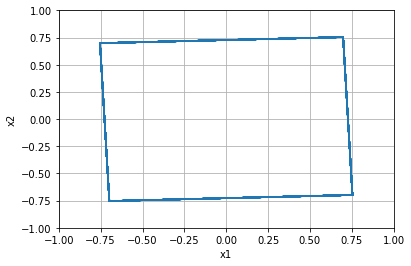


=================== Rollout 927 =====================
x_init [[-0.28]
 [-0.64]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.28 -0.64]
xx [-0.28 -0.64]
xxx [-0.28 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.64]


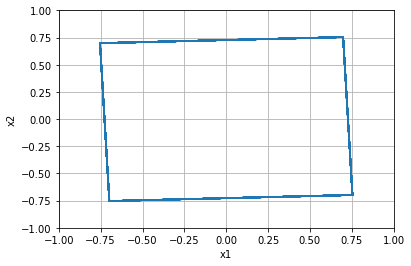


=================== Rollout 928 =====================
x_init [[-0.28]
 [-0.6 ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.28 -0.6 ]
xx [-0.28 -0.6 ]
xxx [-0.28 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.6]


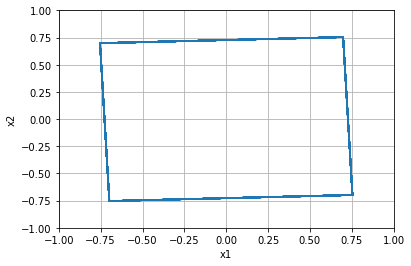


=================== Rollout 929 =====================
x_init [[-0.28]
 [-0.56]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.28 -0.56]
xx [-0.28 -0.56]
xxx [-0.28 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.56]


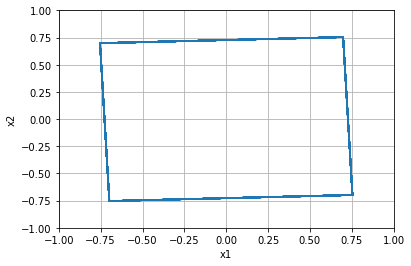


=================== Rollout 930 =====================
x_init [[-0.28]
 [-0.52]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.28 -0.52]
xx [-0.28 -0.52]
xxx [-0.28 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.52]


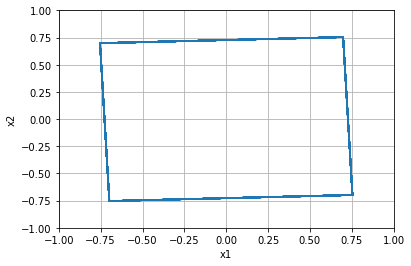


=================== Rollout 931 =====================
x_init [[-0.28]
 [-0.48]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.28 -0.48]
xx [-0.28 -0.48]
xxx [-0.28 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.48]


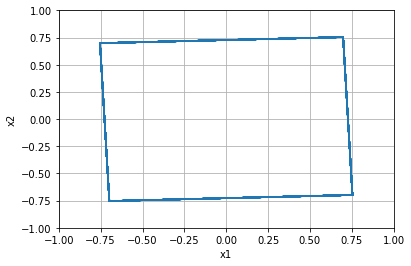


=================== Rollout 932 =====================
x_init [[-0.28]
 [-0.44]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.28 -0.44]
xx [-0.28 -0.44]
xxx [-0.28 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.43999999999999995]


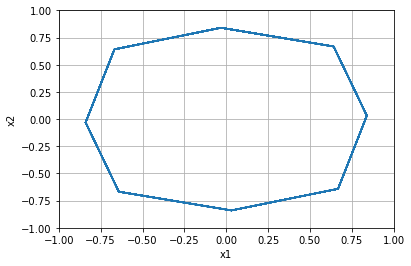


=================== Rollout 933 =====================
x_init [[-0.28]
 [-0.4 ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.28 -0.4 ]
xx [-0.28 -0.4 ]
xxx [-0.28 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.4]


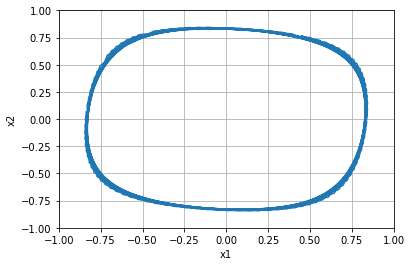


=================== Rollout 934 =====================
x_init [[-0.28]
 [-0.36]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.28 -0.36]
xx [-0.28 -0.36]
xxx [-0.28 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.36]


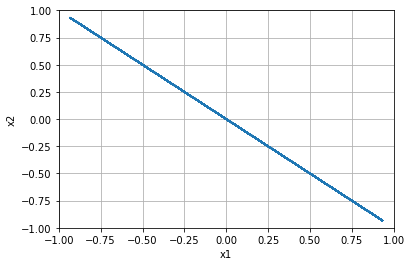


=================== Rollout 935 =====================
x_init [[-0.28]
 [-0.32]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.28 -0.32]
xx [-0.28 -0.32]
xxx [-0.28 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.31999999999999995]


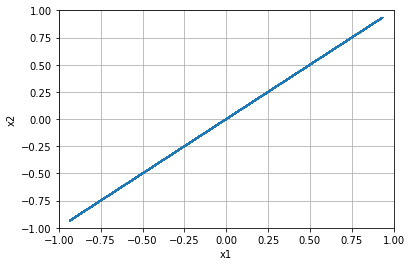


=================== Rollout 936 =====================
x_init [[-0.28]
 [-0.28]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.28 -0.28]
xx [-0.28 -0.28]
xxx [-0.28 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.28]


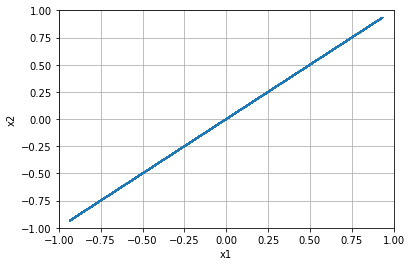


=================== Rollout 937 =====================
x_init [[-0.28]
 [-0.24]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.28 -0.24]
xx [-0.28 -0.24]
xxx [-0.28 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.24]


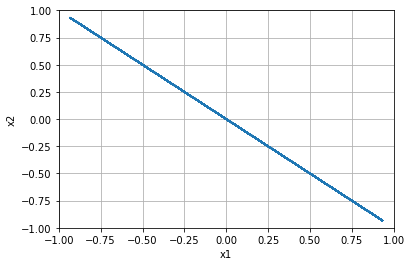


=================== Rollout 938 =====================
x_init [[-0.28]
 [-0.2 ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.28 -0.2 ]
xx [-0.28 -0.2 ]
xxx [-0.28 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.19999999999999996]


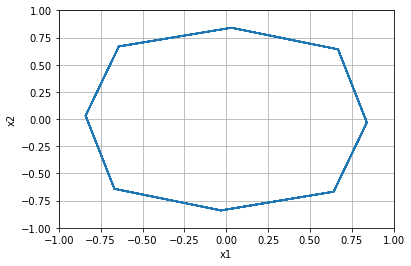


=================== Rollout 939 =====================
x_init [[-0.28]
 [-0.16]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.28 -0.16]
xx [-0.28 -0.16]
xxx [-0.28 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.16000000000000003]


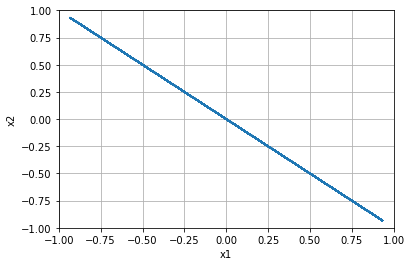


=================== Rollout 940 =====================
x_init [[-0.28]
 [-0.12]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.28 -0.12]
xx [-0.28 -0.12]
xxx [-0.28 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.12]


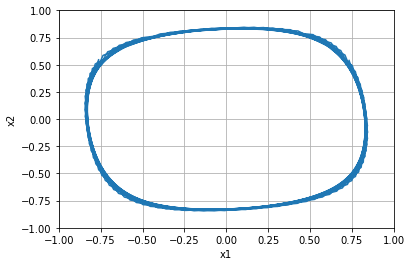


=================== Rollout 941 =====================
x_init [[-0.28]
 [-0.08]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.28 -0.08]
xx [-0.28 -0.08]
xxx [-0.28 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.07999999999999996]


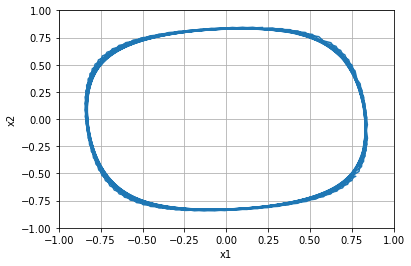


=================== Rollout 942 =====================
x_init [[-0.28]
 [-0.04]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.28 -0.04]
xx [-0.28 -0.04]
xxx [-0.28 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, -0.040000000000000036]


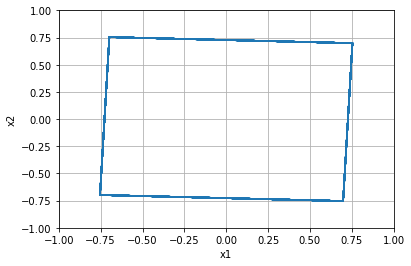


=================== Rollout 943 =====================
x_init [[-0.28]
 [ 0.  ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.28  0.  ]
xx [-0.28  0.  ]
xxx [-0.28  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.0]


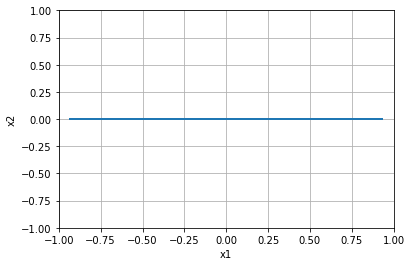


=================== Rollout 944 =====================
x_init [[-0.28]
 [ 0.04]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.28  0.04]
xx [-0.28  0.04]
xxx [-0.28  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.040000000000000036]


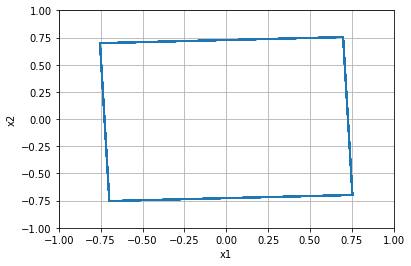


=================== Rollout 945 =====================
x_init [[-0.28]
 [ 0.08]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.28  0.08]
xx [-0.28  0.08]
xxx [-0.28  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.08000000000000007]


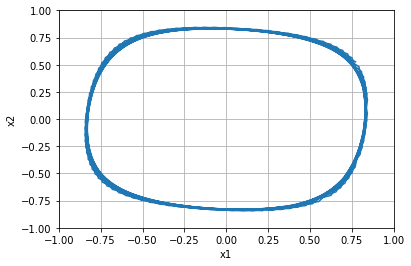


=================== Rollout 946 =====================
x_init [[-0.28]
 [ 0.12]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.28  0.12]
xx [-0.28  0.12]
xxx [-0.28  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.1200000000000001]


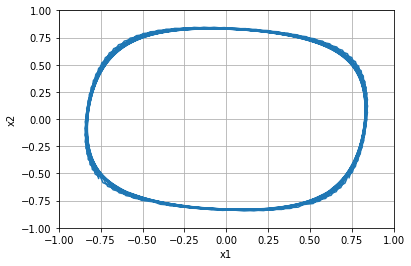


=================== Rollout 947 =====================
x_init [[-0.28]
 [ 0.16]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.28  0.16]
xx [-0.28  0.16]
xxx [-0.28  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.15999999999999992]


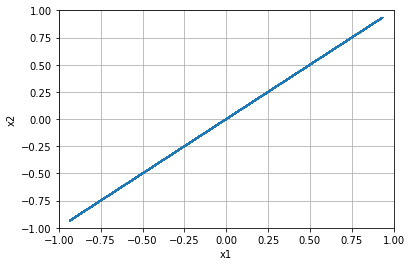


=================== Rollout 948 =====================
x_init [[-0.28]
 [ 0.2 ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.28  0.2 ]
xx [-0.28  0.2 ]
xxx [-0.28  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.19999999999999996]


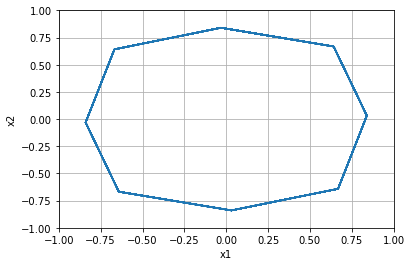


=================== Rollout 949 =====================
x_init [[-0.28]
 [ 0.24]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.28  0.24]
xx [-0.28  0.24]
xxx [-0.28  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.24]


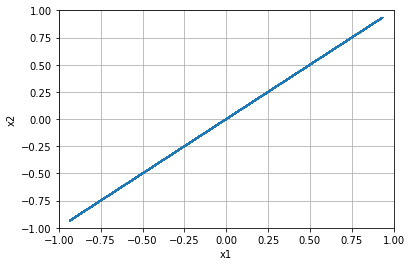


=================== Rollout 950 =====================
x_init [[-0.28]
 [ 0.28]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.28  0.28]
xx [-0.28  0.28]
xxx [-0.28  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.28]


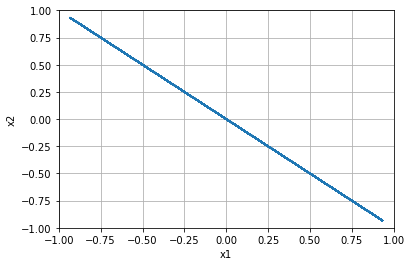


=================== Rollout 951 =====================
x_init [[-0.28]
 [ 0.32]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.28  0.32]
xx [-0.28  0.32]
xxx [-0.28  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.32000000000000006]


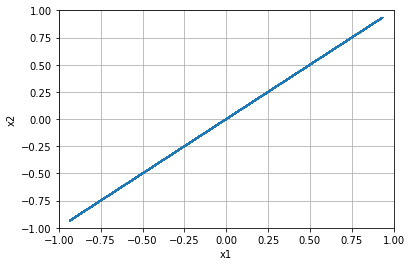


=================== Rollout 952 =====================
x_init [[-0.28]
 [ 0.36]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.28  0.36]
xx [-0.28  0.36]
xxx [-0.28  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.3600000000000001]


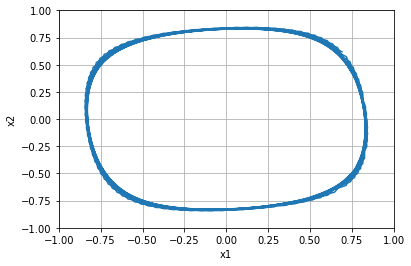


=================== Rollout 953 =====================
x_init [[-0.28]
 [ 0.4 ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.28  0.4 ]
xx [-0.28  0.4 ]
xxx [-0.28  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.40000000000000013]


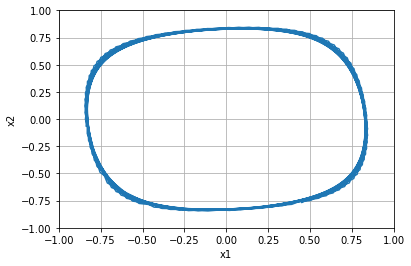


=================== Rollout 954 =====================
x_init [[-0.28]
 [ 0.44]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.28  0.44]
xx [-0.28  0.44]
xxx [-0.28  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.43999999999999995]


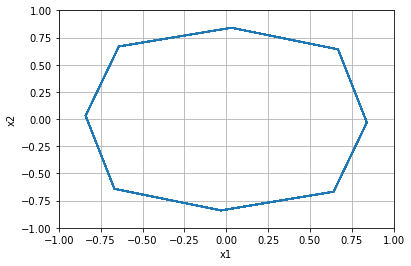


=================== Rollout 955 =====================
x_init [[-0.28]
 [ 0.48]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.28  0.48]
xx [-0.28  0.48]
xxx [-0.28  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.48]


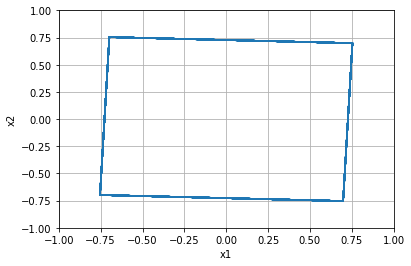


=================== Rollout 956 =====================
x_init [[-0.28]
 [ 0.52]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.28  0.52]
xx [-0.28  0.52]
xxx [-0.28  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.52]


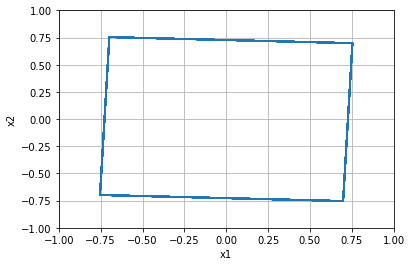


=================== Rollout 957 =====================
x_init [[-0.28]
 [ 0.56]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.28  0.56]
xx [-0.28  0.56]
xxx [-0.28  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.56]


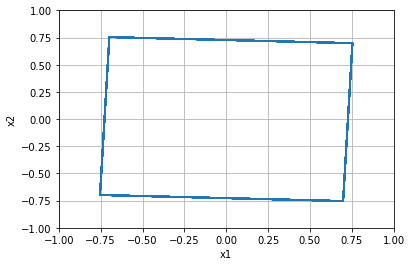


=================== Rollout 958 =====================
x_init [[-0.28]
 [ 0.6 ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.28  0.6 ]
xx [-0.28  0.6 ]
xxx [-0.28  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.6000000000000001]


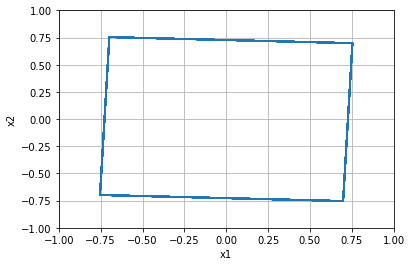


=================== Rollout 959 =====================
x_init [[-0.28]
 [ 0.64]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.28  0.64]
xx [-0.28  0.64]
xxx [-0.28  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.6400000000000001]


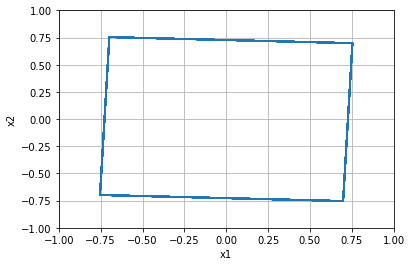


=================== Rollout 960 =====================
x_init [[-0.28]
 [ 0.68]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.28  0.68]
xx [-0.28  0.68]
xxx [-0.28  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.6799999999999999]


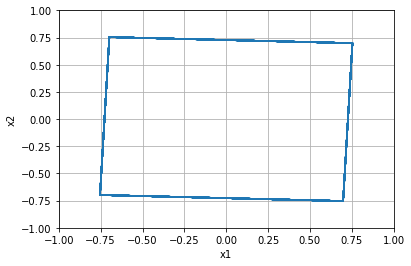


=================== Rollout 961 =====================
x_init [[-0.28]
 [ 0.72]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.28  0.72]
xx [-0.28  0.72]
xxx [-0.28  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.72]


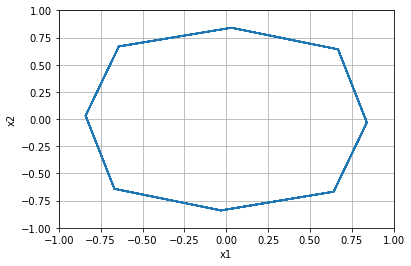


=================== Rollout 962 =====================
x_init [[-0.28]
 [ 0.76]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.28  0.76]
xx [-0.28  0.76]
xxx [-0.28  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.76]


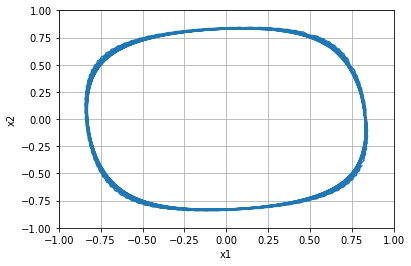


=================== Rollout 963 =====================
x_init [[-0.28]
 [ 0.8 ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.28  0.8 ]
xx [-0.28  0.8 ]
xxx [-0.28  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.8]


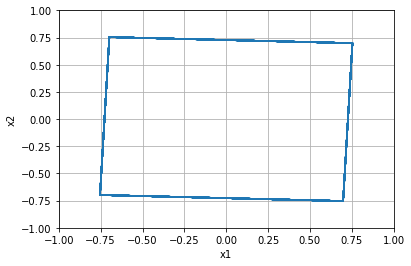


=================== Rollout 964 =====================
x_init [[-0.28]
 [ 0.84]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.28  0.84]
xx [-0.28  0.84]
xxx [-0.28  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.8400000000000001]


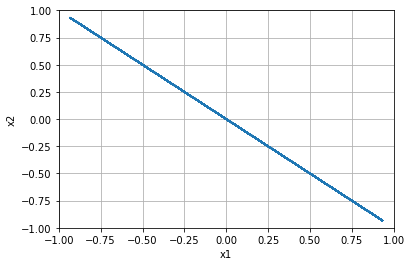


=================== Rollout 965 =====================
x_init [[-0.28]
 [ 0.88]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.28  0.88]
xx [-0.28  0.88]
xxx [-0.28  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.8800000000000001]


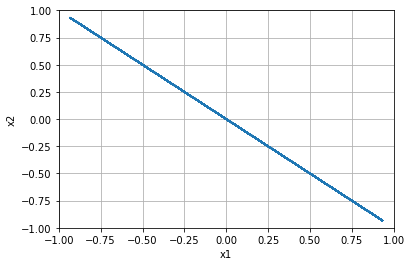


=================== Rollout 966 =====================
x_init [[-0.28]
 [ 0.92]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.28  0.92]
xx [-0.28  0.92]
xxx [-0.28  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.9199999999999999]


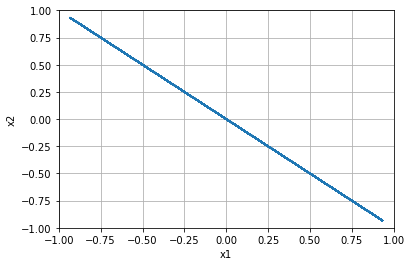


=================== Rollout 967 =====================
x_init [[-0.28]
 [ 0.96]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.28  0.96]
xx [-0.28  0.96]
xxx [-0.28  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 0.96]


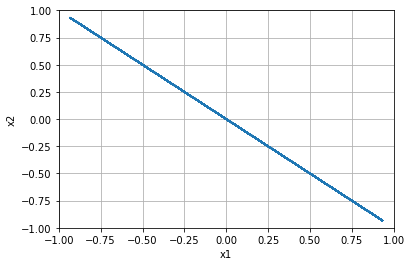


=================== Rollout 968 =====================
x_init [[-0.28]
 [ 1.  ]]
x_buffer [[-0.28 -0.28 -0.28 -0.28 -0.28]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.28  1.  ]
xx [-0.28  1.  ]
xxx [-0.28  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.28, 1.0]


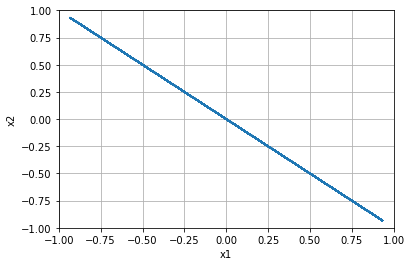


=================== Rollout 969 =====================
x_init [[-0.24]
 [-1.  ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.24 -1.  ]
xx [-0.24 -1.  ]
xxx [-0.24 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -1.0]


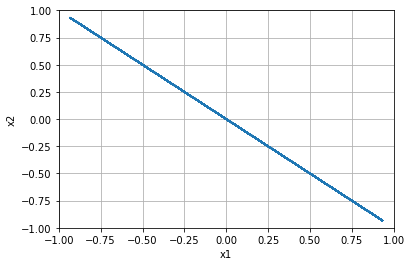


=================== Rollout 970 =====================
x_init [[-0.24]
 [-0.96]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.24 -0.96]
xx [-0.24 -0.96]
xxx [-0.24 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.96]


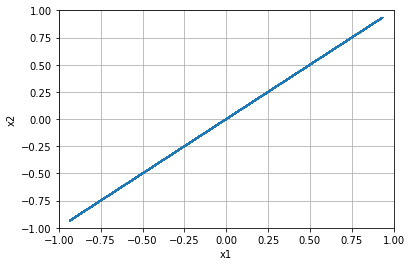


=================== Rollout 971 =====================
x_init [[-0.24]
 [-0.92]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.24 -0.92]
xx [-0.24 -0.92]
xxx [-0.24 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.92]


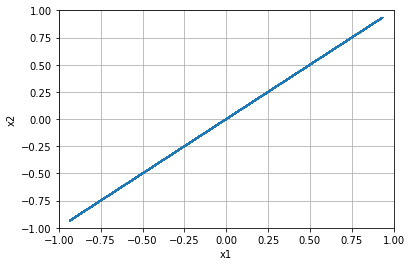


=================== Rollout 972 =====================
x_init [[-0.24]
 [-0.88]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.24 -0.88]
xx [-0.24 -0.88]
xxx [-0.24 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.88]


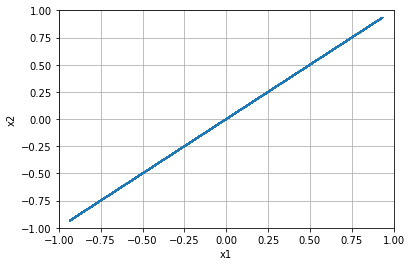


=================== Rollout 973 =====================
x_init [[-0.24]
 [-0.84]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.24 -0.84]
xx [-0.24 -0.84]
xxx [-0.24 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.84]


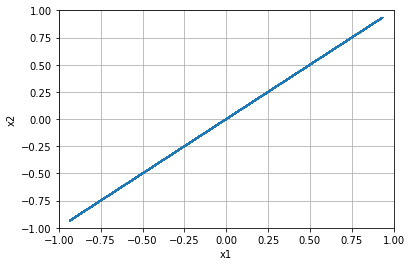


=================== Rollout 974 =====================
x_init [[-0.24]
 [-0.8 ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.24 -0.8 ]
xx [-0.24 -0.8 ]
xxx [-0.24 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.8]


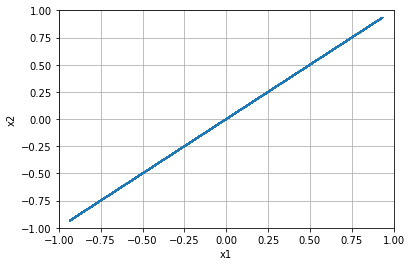


=================== Rollout 975 =====================
x_init [[-0.24]
 [-0.76]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.24 -0.76]
xx [-0.24 -0.76]
xxx [-0.24 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.76]


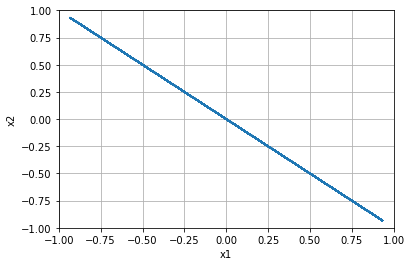


=================== Rollout 976 =====================
x_init [[-0.24]
 [-0.72]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.24 -0.72]
xx [-0.24 -0.72]
xxx [-0.24 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.72]


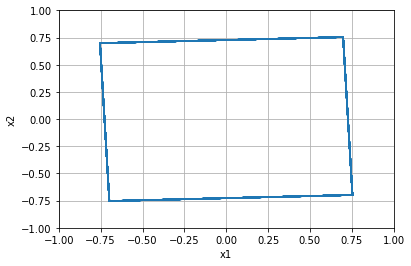


=================== Rollout 977 =====================
x_init [[-0.24]
 [-0.68]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.24 -0.68]
xx [-0.24 -0.68]
xxx [-0.24 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.6799999999999999]


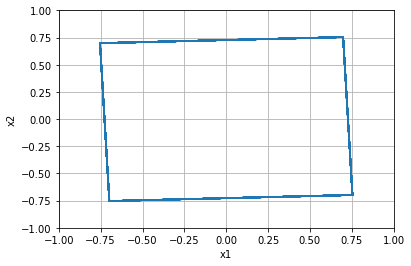


=================== Rollout 978 =====================
x_init [[-0.24]
 [-0.64]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.24 -0.64]
xx [-0.24 -0.64]
xxx [-0.24 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.64]


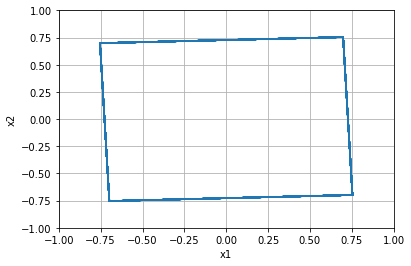


=================== Rollout 979 =====================
x_init [[-0.24]
 [-0.6 ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.24 -0.6 ]
xx [-0.24 -0.6 ]
xxx [-0.24 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.6]


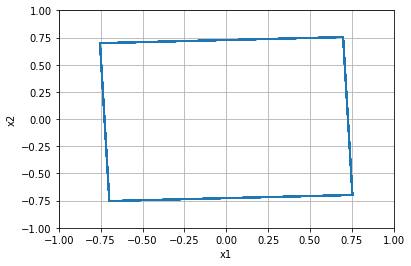


=================== Rollout 980 =====================
x_init [[-0.24]
 [-0.56]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.24 -0.56]
xx [-0.24 -0.56]
xxx [-0.24 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.56]


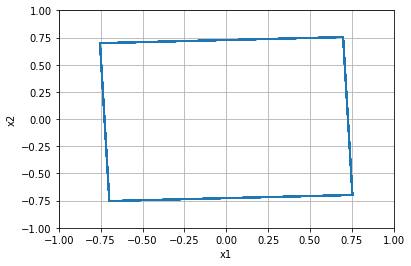


=================== Rollout 981 =====================
x_init [[-0.24]
 [-0.52]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.24 -0.52]
xx [-0.24 -0.52]
xxx [-0.24 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.52]


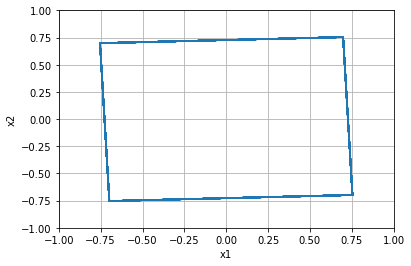


=================== Rollout 982 =====================
x_init [[-0.24]
 [-0.48]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.24 -0.48]
xx [-0.24 -0.48]
xxx [-0.24 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.48]


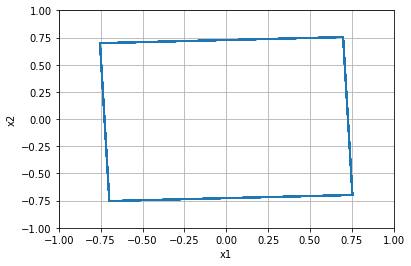


=================== Rollout 983 =====================
x_init [[-0.24]
 [-0.44]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.24 -0.44]
xx [-0.24 -0.44]
xxx [-0.24 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.43999999999999995]


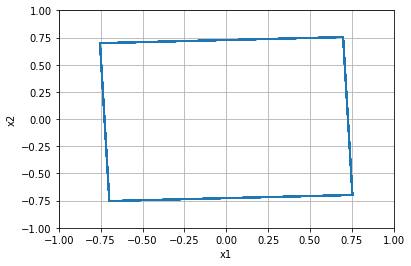


=================== Rollout 984 =====================
x_init [[-0.24]
 [-0.4 ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.24 -0.4 ]
xx [-0.24 -0.4 ]
xxx [-0.24 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.4]


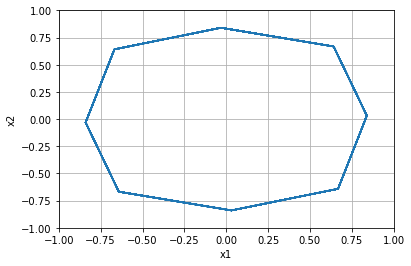


=================== Rollout 985 =====================
x_init [[-0.24]
 [-0.36]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.24 -0.36]
xx [-0.24 -0.36]
xxx [-0.24 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.36]


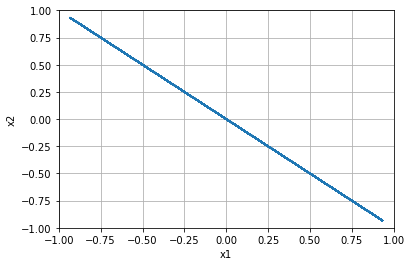


=================== Rollout 986 =====================
x_init [[-0.24]
 [-0.32]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.24 -0.32]
xx [-0.24 -0.32]
xxx [-0.24 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.31999999999999995]


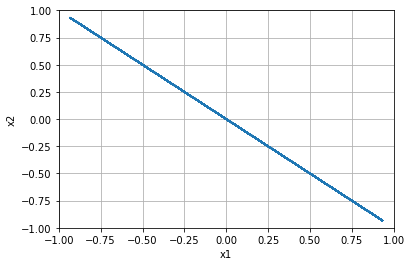


=================== Rollout 987 =====================
x_init [[-0.24]
 [-0.28]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.24 -0.28]
xx [-0.24 -0.28]
xxx [-0.24 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.28]


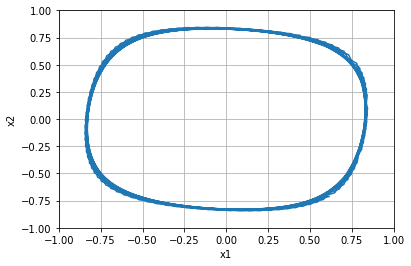


=================== Rollout 988 =====================
x_init [[-0.24]
 [-0.24]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.24 -0.24]
xx [-0.24 -0.24]
xxx [-0.24 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.24]


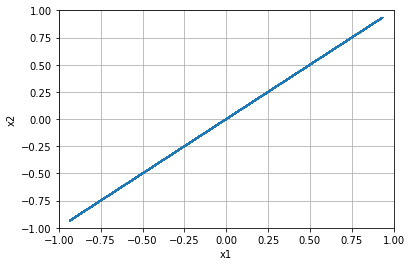


=================== Rollout 989 =====================
x_init [[-0.24]
 [-0.2 ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.24 -0.2 ]
xx [-0.24 -0.2 ]
xxx [-0.24 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.19999999999999996]


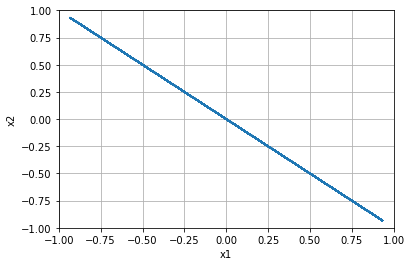


=================== Rollout 990 =====================
x_init [[-0.24]
 [-0.16]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.24 -0.16]
xx [-0.24 -0.16]
xxx [-0.24 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.16000000000000003]


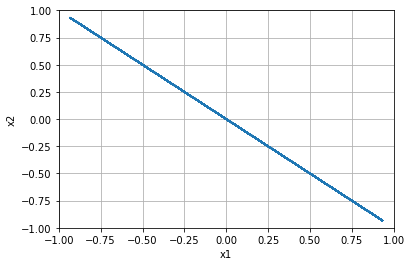


=================== Rollout 991 =====================
x_init [[-0.24]
 [-0.12]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.24 -0.12]
xx [-0.24 -0.12]
xxx [-0.24 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.12]


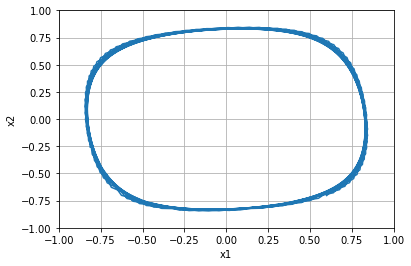


=================== Rollout 992 =====================
x_init [[-0.24]
 [-0.08]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.24 -0.08]
xx [-0.24 -0.08]
xxx [-0.24 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.07999999999999996]


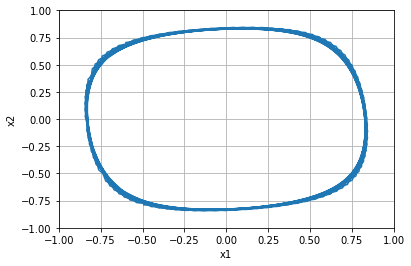


=================== Rollout 993 =====================
x_init [[-0.24]
 [-0.04]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.24 -0.04]
xx [-0.24 -0.04]
xxx [-0.24 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, -0.040000000000000036]


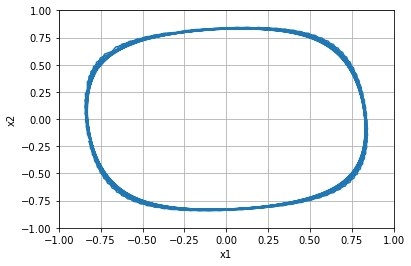


=================== Rollout 994 =====================
x_init [[-0.24]
 [ 0.  ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.24  0.  ]
xx [-0.24  0.  ]
xxx [-0.24  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.0]


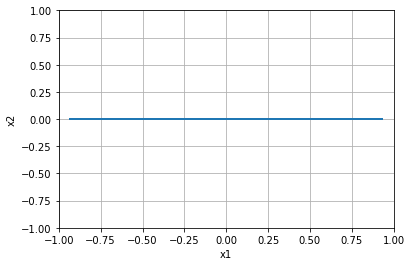


=================== Rollout 995 =====================
x_init [[-0.24]
 [ 0.04]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.24  0.04]
xx [-0.24  0.04]
xxx [-0.24  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.040000000000000036]


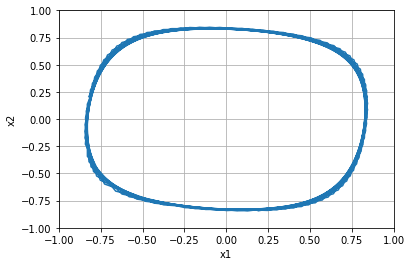


=================== Rollout 996 =====================
x_init [[-0.24]
 [ 0.08]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.24  0.08]
xx [-0.24  0.08]
xxx [-0.24  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.08000000000000007]


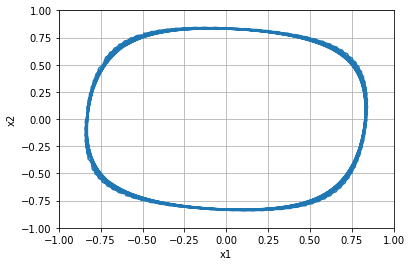


=================== Rollout 997 =====================
x_init [[-0.24]
 [ 0.12]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.24  0.12]
xx [-0.24  0.12]
xxx [-0.24  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.1200000000000001]


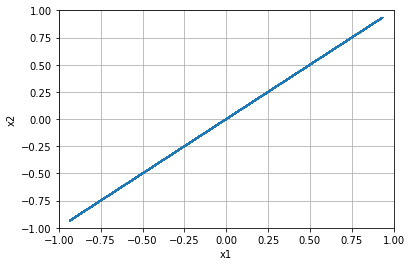


=================== Rollout 998 =====================
x_init [[-0.24]
 [ 0.16]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.24  0.16]
xx [-0.24  0.16]
xxx [-0.24  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.15999999999999992]


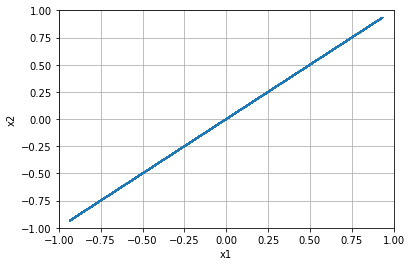


=================== Rollout 999 =====================
x_init [[-0.24]
 [ 0.2 ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.24  0.2 ]
xx [-0.24  0.2 ]
xxx [-0.24  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.19999999999999996]


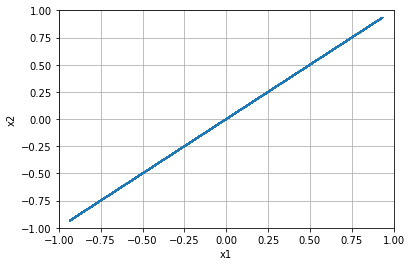


=================== Rollout 1000 =====================
x_init [[-0.24]
 [ 0.24]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.24  0.24]
xx [-0.24  0.24]
xxx [-0.24  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.24]


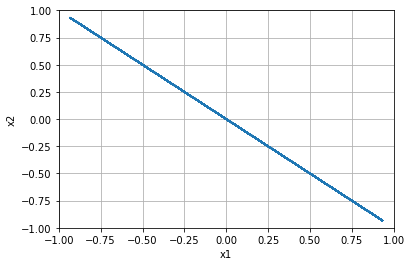


=================== Rollout 1001 =====================
x_init [[-0.24]
 [ 0.28]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.24  0.28]
xx [-0.24  0.28]
xxx [-0.24  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.28]


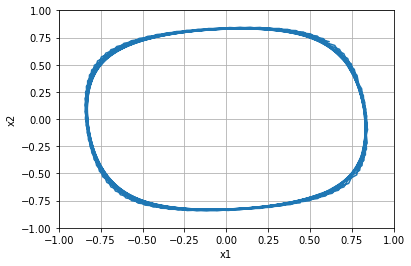


=================== Rollout 1002 =====================
x_init [[-0.24]
 [ 0.32]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.24  0.32]
xx [-0.24  0.32]
xxx [-0.24  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.32000000000000006]


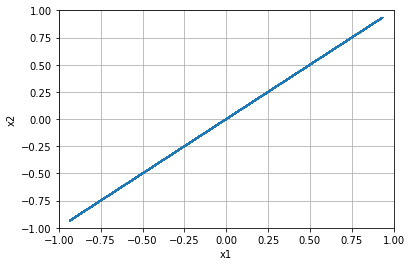


=================== Rollout 1003 =====================
x_init [[-0.24]
 [ 0.36]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.24  0.36]
xx [-0.24  0.36]
xxx [-0.24  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.3600000000000001]


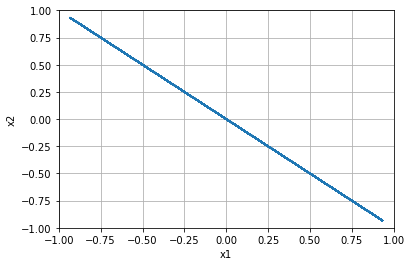


=================== Rollout 1004 =====================
x_init [[-0.24]
 [ 0.4 ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.24  0.4 ]
xx [-0.24  0.4 ]
xxx [-0.24  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.40000000000000013]


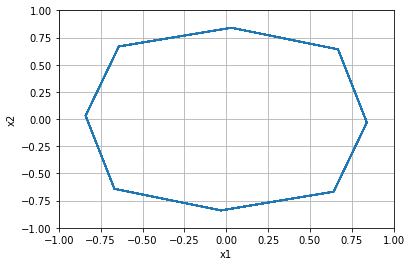


=================== Rollout 1005 =====================
x_init [[-0.24]
 [ 0.44]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.24  0.44]
xx [-0.24  0.44]
xxx [-0.24  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.43999999999999995]


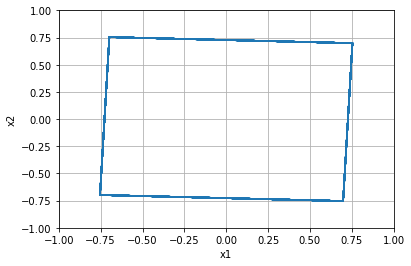


=================== Rollout 1006 =====================
x_init [[-0.24]
 [ 0.48]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.24  0.48]
xx [-0.24  0.48]
xxx [-0.24  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.48]


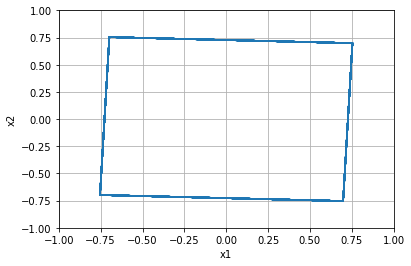


=================== Rollout 1007 =====================
x_init [[-0.24]
 [ 0.52]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.24  0.52]
xx [-0.24  0.52]
xxx [-0.24  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.52]


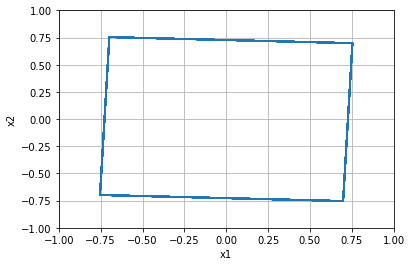


=================== Rollout 1008 =====================
x_init [[-0.24]
 [ 0.56]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.24  0.56]
xx [-0.24  0.56]
xxx [-0.24  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.56]


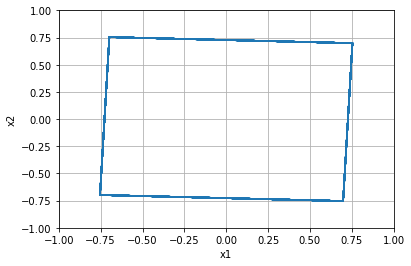


=================== Rollout 1009 =====================
x_init [[-0.24]
 [ 0.6 ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.24  0.6 ]
xx [-0.24  0.6 ]
xxx [-0.24  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.6000000000000001]


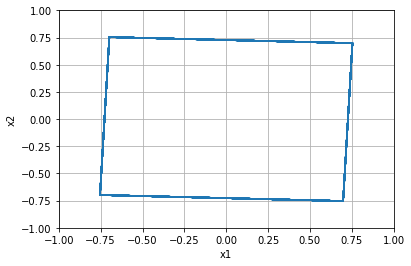


=================== Rollout 1010 =====================
x_init [[-0.24]
 [ 0.64]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.24  0.64]
xx [-0.24  0.64]
xxx [-0.24  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.6400000000000001]


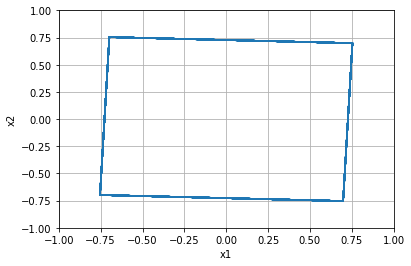


=================== Rollout 1011 =====================
x_init [[-0.24]
 [ 0.68]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.24  0.68]
xx [-0.24  0.68]
xxx [-0.24  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.6799999999999999]


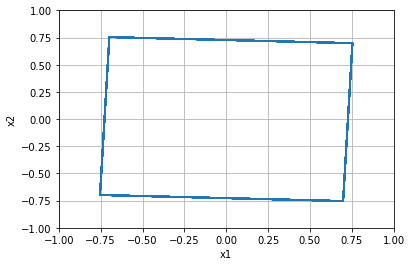


=================== Rollout 1012 =====================
x_init [[-0.24]
 [ 0.72]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.24  0.72]
xx [-0.24  0.72]
xxx [-0.24  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.72]


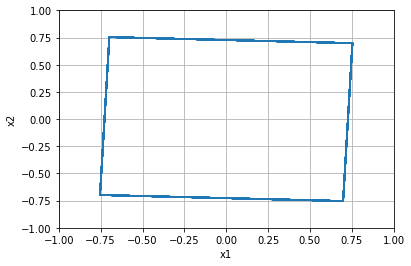


=================== Rollout 1013 =====================
x_init [[-0.24]
 [ 0.76]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.24  0.76]
xx [-0.24  0.76]
xxx [-0.24  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.76]


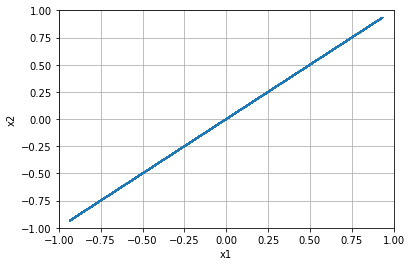


=================== Rollout 1014 =====================
x_init [[-0.24]
 [ 0.8 ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.24  0.8 ]
xx [-0.24  0.8 ]
xxx [-0.24  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.8]


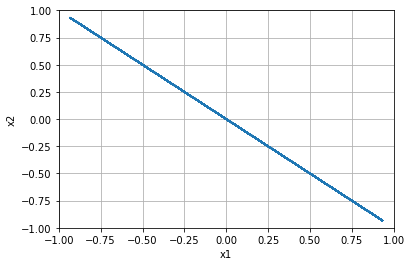


=================== Rollout 1015 =====================
x_init [[-0.24]
 [ 0.84]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.24  0.84]
xx [-0.24  0.84]
xxx [-0.24  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.8400000000000001]


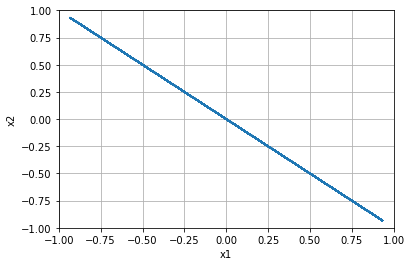


=================== Rollout 1016 =====================
x_init [[-0.24]
 [ 0.88]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.24  0.88]
xx [-0.24  0.88]
xxx [-0.24  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.8800000000000001]


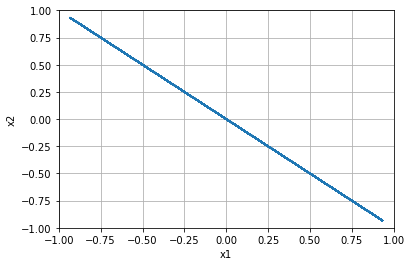


=================== Rollout 1017 =====================
x_init [[-0.24]
 [ 0.92]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.24  0.92]
xx [-0.24  0.92]
xxx [-0.24  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.9199999999999999]


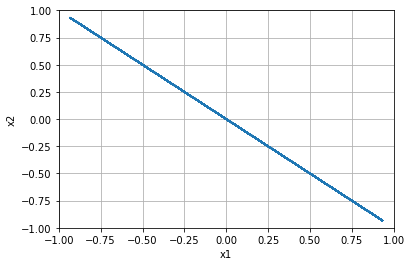


=================== Rollout 1018 =====================
x_init [[-0.24]
 [ 0.96]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.24  0.96]
xx [-0.24  0.96]
xxx [-0.24  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 0.96]


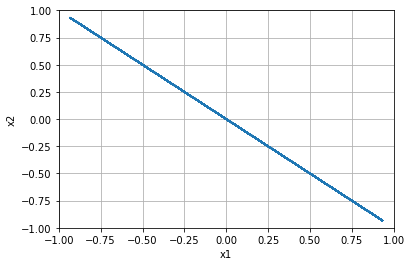


=================== Rollout 1019 =====================
x_init [[-0.24]
 [ 1.  ]]
x_buffer [[-0.24 -0.24 -0.24 -0.24 -0.24]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.24  1.  ]
xx [-0.24  1.  ]
xxx [-0.24  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.24, 1.0]


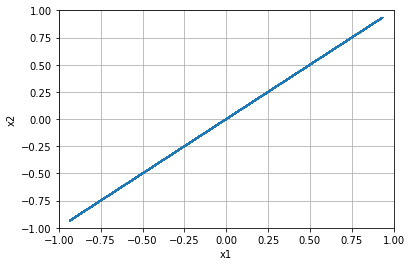


=================== Rollout 1020 =====================
x_init [[-0.2]
 [-1. ]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [-1.  -1.  -1.  -1.  -1. ]]
x [-0.2 -1. ]
xx [-0.2 -1. ]
xxx [-0.2 -1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -1.0]


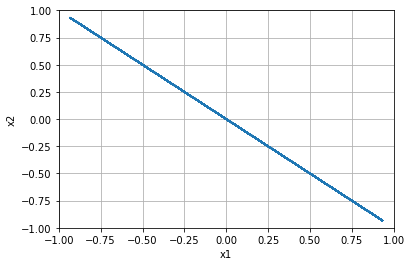


=================== Rollout 1021 =====================
x_init [[-0.2 ]
 [-0.96]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.2  -0.96]
xx [-0.2  -0.96]
xxx [-0.2  -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.96]


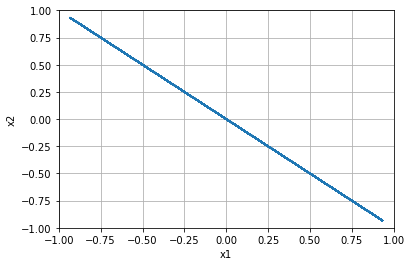


=================== Rollout 1022 =====================
x_init [[-0.2 ]
 [-0.92]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.2  -0.92]
xx [-0.2  -0.92]
xxx [-0.2  -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.92]


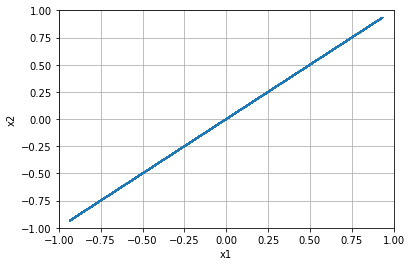


=================== Rollout 1023 =====================
x_init [[-0.2 ]
 [-0.88]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.2  -0.88]
xx [-0.2  -0.88]
xxx [-0.2  -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.88]


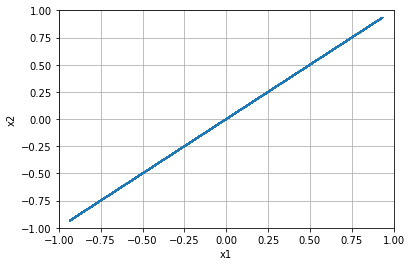


=================== Rollout 1024 =====================
x_init [[-0.2 ]
 [-0.84]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.2  -0.84]
xx [-0.2  -0.84]
xxx [-0.2  -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.84]


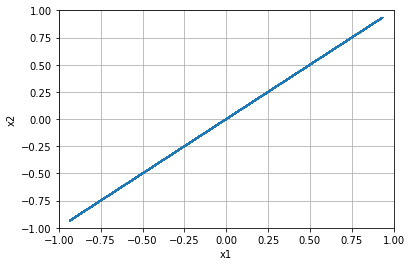


=================== Rollout 1025 =====================
x_init [[-0.2]
 [-0.8]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [-0.2 -0.8]
xx [-0.2 -0.8]
xxx [-0.2 -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.8]


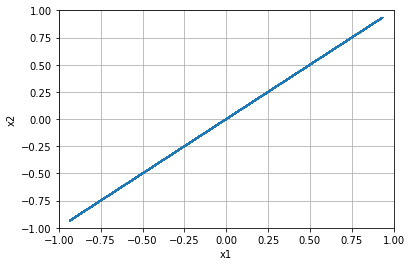


=================== Rollout 1026 =====================
x_init [[-0.2 ]
 [-0.76]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.2  -0.76]
xx [-0.2  -0.76]
xxx [-0.2  -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.76]


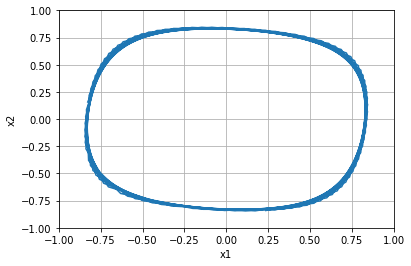


=================== Rollout 1027 =====================
x_init [[-0.2 ]
 [-0.72]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.2  -0.72]
xx [-0.2  -0.72]
xxx [-0.2  -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.72]


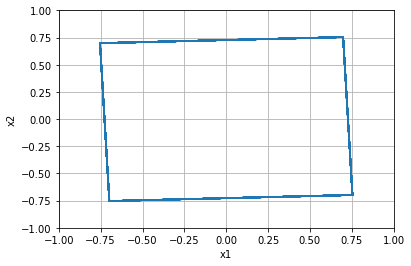


=================== Rollout 1028 =====================
x_init [[-0.2 ]
 [-0.68]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.2  -0.68]
xx [-0.2  -0.68]
xxx [-0.2  -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.6799999999999999]


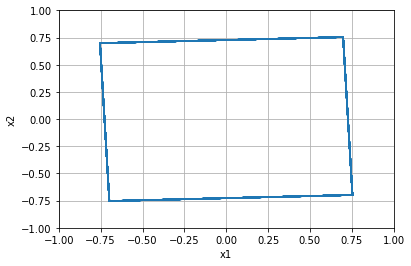


=================== Rollout 1029 =====================
x_init [[-0.2 ]
 [-0.64]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.2  -0.64]
xx [-0.2  -0.64]
xxx [-0.2  -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.64]


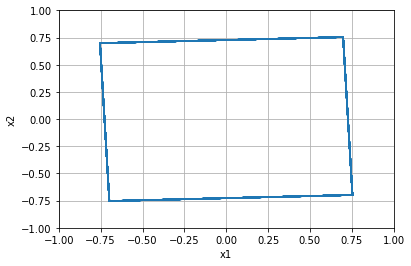


=================== Rollout 1030 =====================
x_init [[-0.2]
 [-0.6]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [-0.2 -0.6]
xx [-0.2 -0.6]
xxx [-0.2 -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.6]


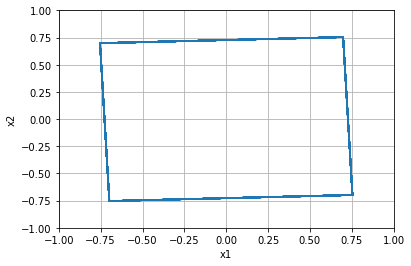


=================== Rollout 1031 =====================
x_init [[-0.2 ]
 [-0.56]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.2  -0.56]
xx [-0.2  -0.56]
xxx [-0.2  -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.56]


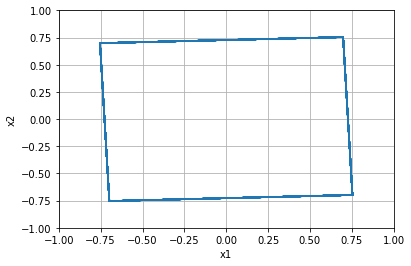


=================== Rollout 1032 =====================
x_init [[-0.2 ]
 [-0.52]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.2  -0.52]
xx [-0.2  -0.52]
xxx [-0.2  -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.52]


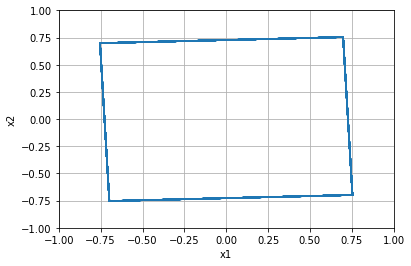


=================== Rollout 1033 =====================
x_init [[-0.2 ]
 [-0.48]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.2  -0.48]
xx [-0.2  -0.48]
xxx [-0.2  -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.48]


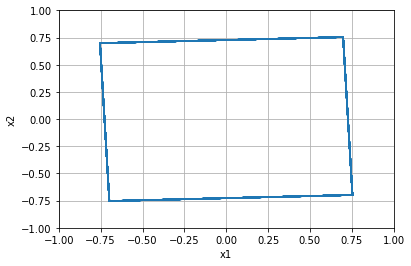


=================== Rollout 1034 =====================
x_init [[-0.2 ]
 [-0.44]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.2  -0.44]
xx [-0.2  -0.44]
xxx [-0.2  -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.43999999999999995]


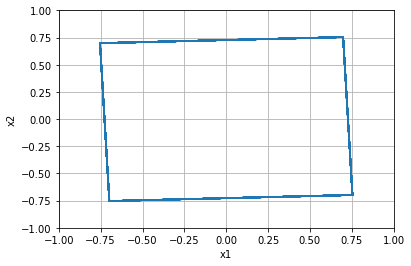


=================== Rollout 1035 =====================
x_init [[-0.2]
 [-0.4]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [-0.2 -0.4]
xx [-0.2 -0.4]
xxx [-0.2 -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.4]


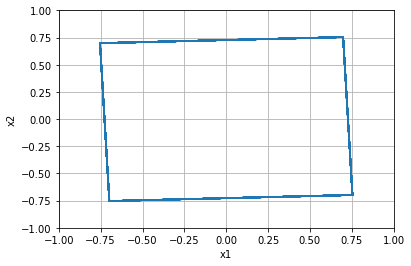


=================== Rollout 1036 =====================
x_init [[-0.2 ]
 [-0.36]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.2  -0.36]
xx [-0.2  -0.36]
xxx [-0.2  -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.36]


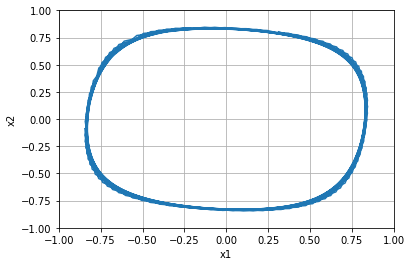


=================== Rollout 1037 =====================
x_init [[-0.2 ]
 [-0.32]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.2  -0.32]
xx [-0.2  -0.32]
xxx [-0.2  -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.31999999999999995]


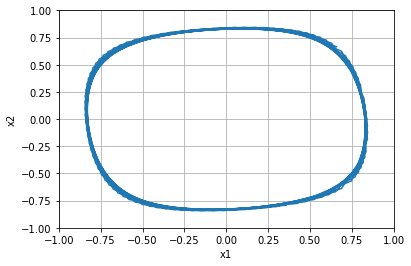


=================== Rollout 1038 =====================
x_init [[-0.2 ]
 [-0.28]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.2  -0.28]
xx [-0.2  -0.28]
xxx [-0.2  -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.28]


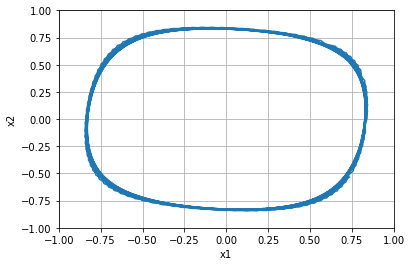


=================== Rollout 1039 =====================
x_init [[-0.2 ]
 [-0.24]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.2  -0.24]
xx [-0.2  -0.24]
xxx [-0.2  -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.24]


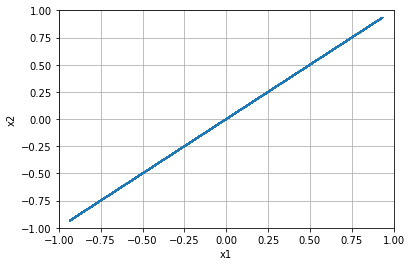


=================== Rollout 1040 =====================
x_init [[-0.2]
 [-0.2]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [-0.2 -0.2]
xx [-0.2 -0.2]
xxx [-0.2 -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.19999999999999996]


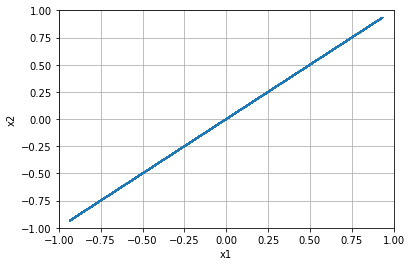


=================== Rollout 1041 =====================
x_init [[-0.2 ]
 [-0.16]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.2  -0.16]
xx [-0.2  -0.16]
xxx [-0.2  -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.16000000000000003]


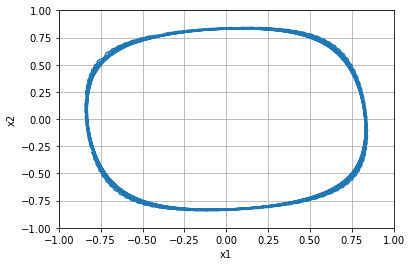


=================== Rollout 1042 =====================
x_init [[-0.2 ]
 [-0.12]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.2  -0.12]
xx [-0.2  -0.12]
xxx [-0.2  -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.12]


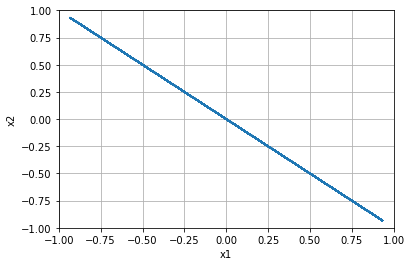


=================== Rollout 1043 =====================
x_init [[-0.2 ]
 [-0.08]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.2  -0.08]
xx [-0.2  -0.08]
xxx [-0.2  -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.07999999999999996]


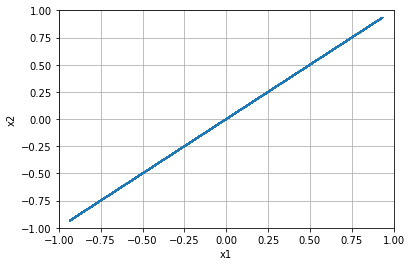


=================== Rollout 1044 =====================
x_init [[-0.2 ]
 [-0.04]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.2  -0.04]
xx [-0.2  -0.04]
xxx [-0.2  -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, -0.040000000000000036]


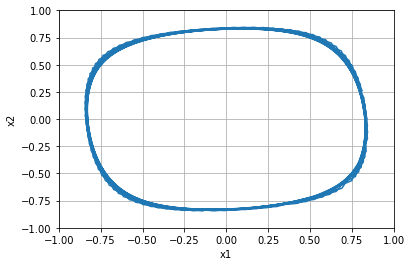


=================== Rollout 1045 =====================
x_init [[-0.2]
 [ 0. ]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [ 0.   0.   0.   0.   0. ]]
x [-0.2  0. ]
xx [-0.2  0. ]
xxx [-0.2  0. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.0]


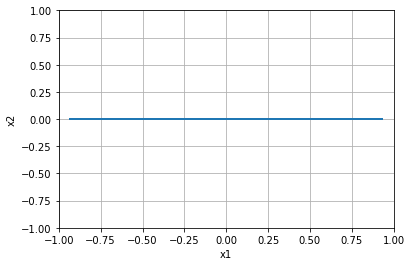


=================== Rollout 1046 =====================
x_init [[-0.2 ]
 [ 0.04]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.2   0.04]
xx [-0.2   0.04]
xxx [-0.2   0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.040000000000000036]


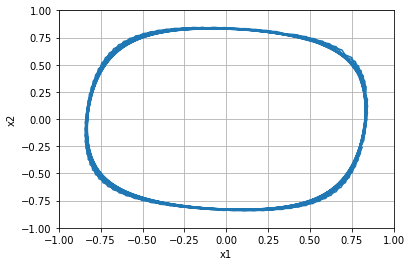


=================== Rollout 1047 =====================
x_init [[-0.2 ]
 [ 0.08]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.2   0.08]
xx [-0.2   0.08]
xxx [-0.2   0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.08000000000000007]


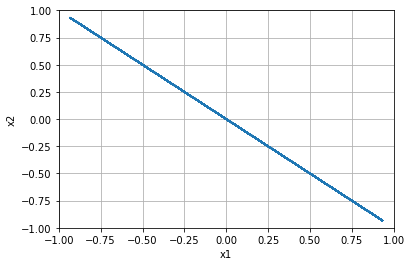


=================== Rollout 1048 =====================
x_init [[-0.2 ]
 [ 0.12]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.2   0.12]
xx [-0.2   0.12]
xxx [-0.2   0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.1200000000000001]


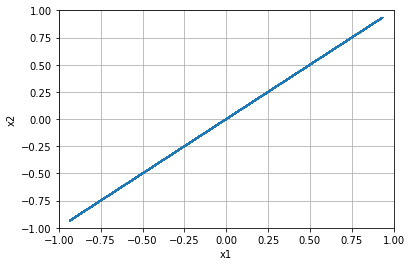


=================== Rollout 1049 =====================
x_init [[-0.2 ]
 [ 0.16]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.2   0.16]
xx [-0.2   0.16]
xxx [-0.2   0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.15999999999999992]


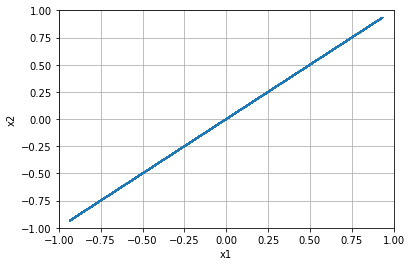


=================== Rollout 1050 =====================
x_init [[-0.2]
 [ 0.2]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [ 0.2  0.2  0.2  0.2  0.2]]
x [-0.2  0.2]
xx [-0.2  0.2]
xxx [-0.2  0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.19999999999999996]


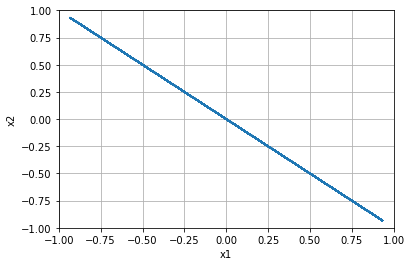


=================== Rollout 1051 =====================
x_init [[-0.2 ]
 [ 0.24]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.2   0.24]
xx [-0.2   0.24]
xxx [-0.2   0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.24]


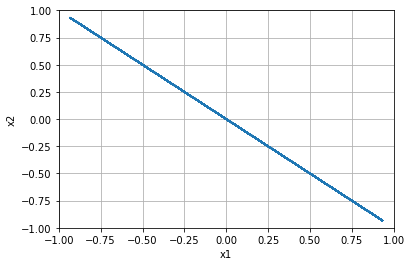


=================== Rollout 1052 =====================
x_init [[-0.2 ]
 [ 0.28]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.2   0.28]
xx [-0.2   0.28]
xxx [-0.2   0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.28]


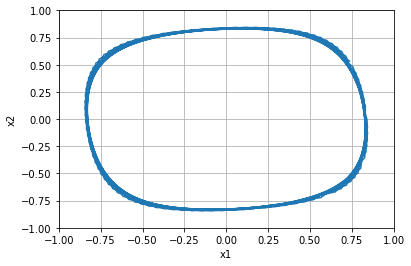


=================== Rollout 1053 =====================
x_init [[-0.2 ]
 [ 0.32]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.2   0.32]
xx [-0.2   0.32]
xxx [-0.2   0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.32000000000000006]


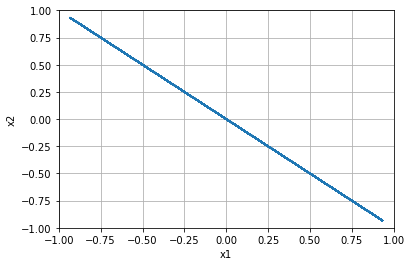


=================== Rollout 1054 =====================
x_init [[-0.2 ]
 [ 0.36]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.2   0.36]
xx [-0.2   0.36]
xxx [-0.2   0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.3600000000000001]


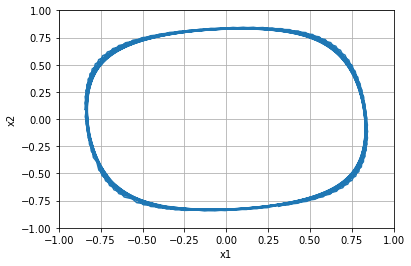


=================== Rollout 1055 =====================
x_init [[-0.2]
 [ 0.4]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [ 0.4  0.4  0.4  0.4  0.4]]
x [-0.2  0.4]
xx [-0.2  0.4]
xxx [-0.2  0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.40000000000000013]


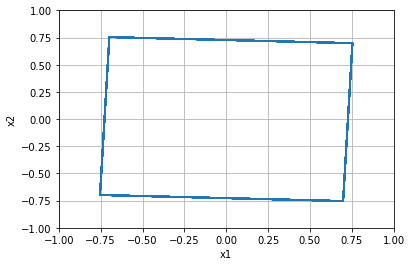


=================== Rollout 1056 =====================
x_init [[-0.2 ]
 [ 0.44]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.2   0.44]
xx [-0.2   0.44]
xxx [-0.2   0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.43999999999999995]


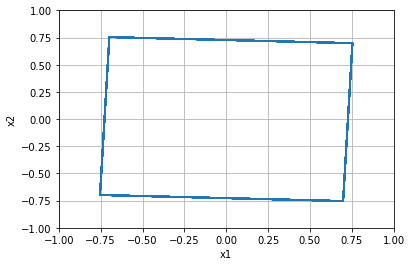


=================== Rollout 1057 =====================
x_init [[-0.2 ]
 [ 0.48]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.2   0.48]
xx [-0.2   0.48]
xxx [-0.2   0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.48]


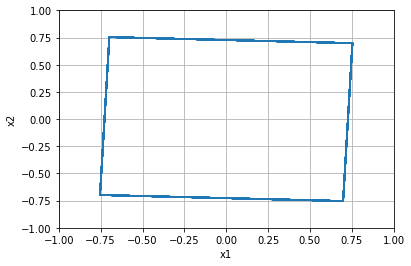


=================== Rollout 1058 =====================
x_init [[-0.2 ]
 [ 0.52]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.2   0.52]
xx [-0.2   0.52]
xxx [-0.2   0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.52]


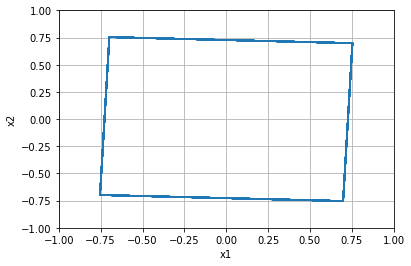


=================== Rollout 1059 =====================
x_init [[-0.2 ]
 [ 0.56]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.2   0.56]
xx [-0.2   0.56]
xxx [-0.2   0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.56]


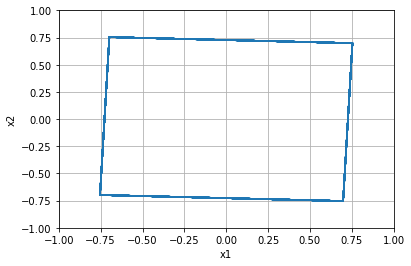


=================== Rollout 1060 =====================
x_init [[-0.2]
 [ 0.6]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [ 0.6  0.6  0.6  0.6  0.6]]
x [-0.2  0.6]
xx [-0.2  0.6]
xxx [-0.2  0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.6000000000000001]


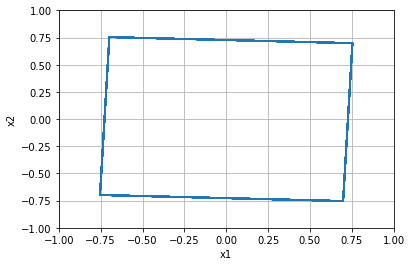


=================== Rollout 1061 =====================
x_init [[-0.2 ]
 [ 0.64]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.2   0.64]
xx [-0.2   0.64]
xxx [-0.2   0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.6400000000000001]


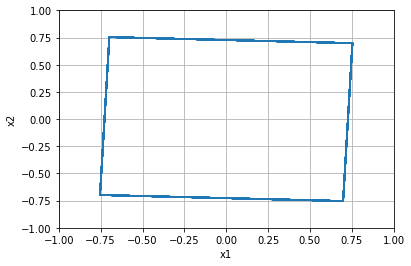


=================== Rollout 1062 =====================
x_init [[-0.2 ]
 [ 0.68]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.2   0.68]
xx [-0.2   0.68]
xxx [-0.2   0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.6799999999999999]


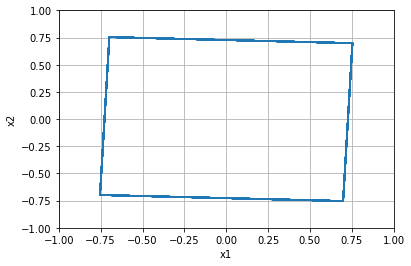


=================== Rollout 1063 =====================
x_init [[-0.2 ]
 [ 0.72]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.2   0.72]
xx [-0.2   0.72]
xxx [-0.2   0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.72]


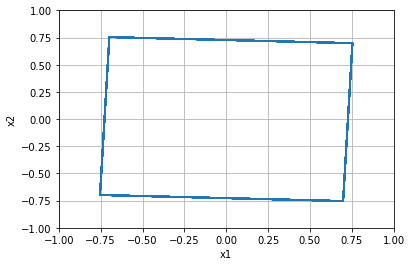


=================== Rollout 1064 =====================
x_init [[-0.2 ]
 [ 0.76]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.2   0.76]
xx [-0.2   0.76]
xxx [-0.2   0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.76]


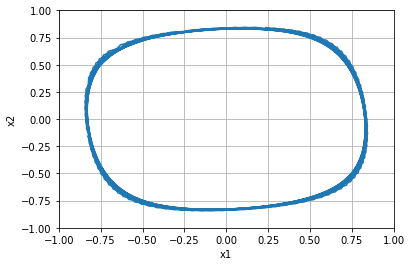


=================== Rollout 1065 =====================
x_init [[-0.2]
 [ 0.8]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [ 0.8  0.8  0.8  0.8  0.8]]
x [-0.2  0.8]
xx [-0.2  0.8]
xxx [-0.2  0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.8]


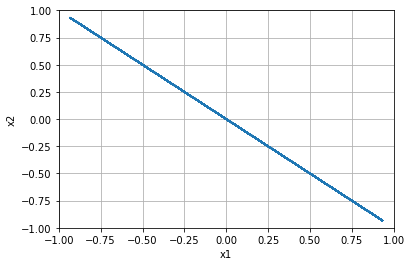


=================== Rollout 1066 =====================
x_init [[-0.2 ]
 [ 0.84]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.2   0.84]
xx [-0.2   0.84]
xxx [-0.2   0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.8400000000000001]


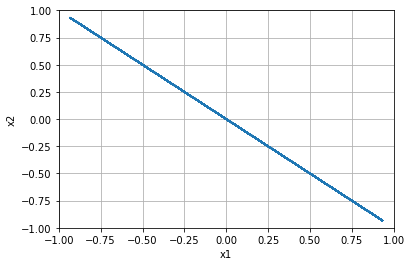


=================== Rollout 1067 =====================
x_init [[-0.2 ]
 [ 0.88]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.2   0.88]
xx [-0.2   0.88]
xxx [-0.2   0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.8800000000000001]


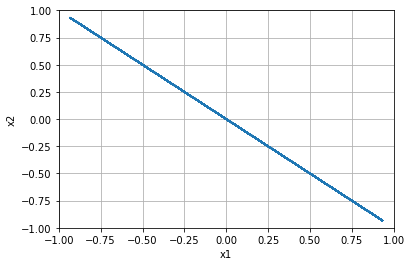


=================== Rollout 1068 =====================
x_init [[-0.2 ]
 [ 0.92]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.2   0.92]
xx [-0.2   0.92]
xxx [-0.2   0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.9199999999999999]


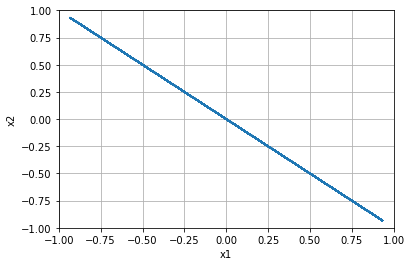


=================== Rollout 1069 =====================
x_init [[-0.2 ]
 [ 0.96]]
x_buffer [[-0.2  -0.2  -0.2  -0.2  -0.2 ]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.2   0.96]
xx [-0.2   0.96]
xxx [-0.2   0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 0.96]


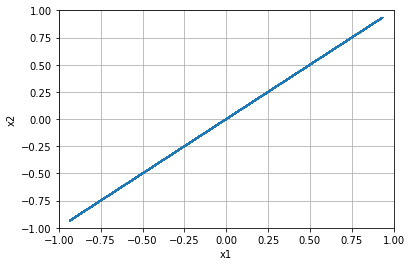


=================== Rollout 1070 =====================
x_init [[-0.2]
 [ 1. ]]
x_buffer [[-0.2 -0.2 -0.2 -0.2 -0.2]
 [ 1.   1.   1.   1.   1. ]]
x [-0.2  1. ]
xx [-0.2  1. ]
xxx [-0.2  1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.19999999999999996, 1.0]


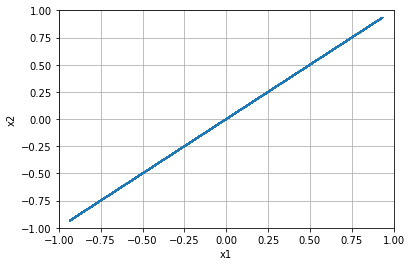


=================== Rollout 1071 =====================
x_init [[-0.16]
 [-1.  ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.16 -1.  ]
xx [-0.16 -1.  ]
xxx [-0.16 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -1.0]


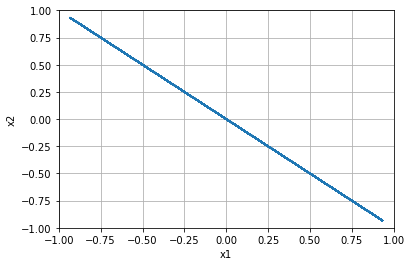


=================== Rollout 1072 =====================
x_init [[-0.16]
 [-0.96]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.16 -0.96]
xx [-0.16 -0.96]
xxx [-0.16 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.96]


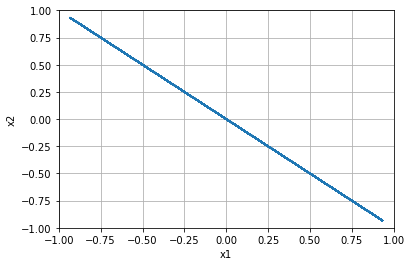


=================== Rollout 1073 =====================
x_init [[-0.16]
 [-0.92]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.16 -0.92]
xx [-0.16 -0.92]
xxx [-0.16 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.92]


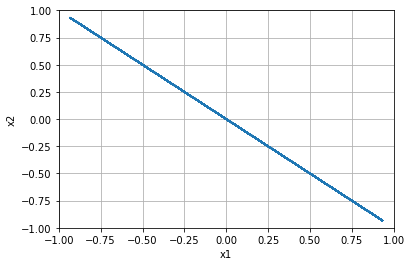


=================== Rollout 1074 =====================
x_init [[-0.16]
 [-0.88]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.16 -0.88]
xx [-0.16 -0.88]
xxx [-0.16 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.88]


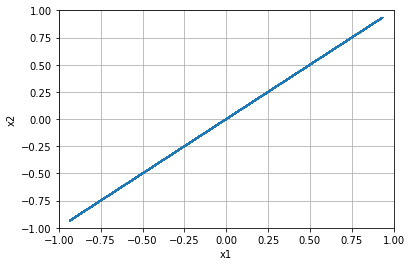


=================== Rollout 1075 =====================
x_init [[-0.16]
 [-0.84]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.16 -0.84]
xx [-0.16 -0.84]
xxx [-0.16 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.84]


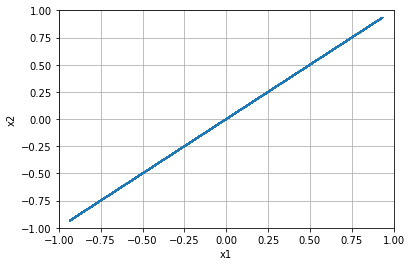


=================== Rollout 1076 =====================
x_init [[-0.16]
 [-0.8 ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.16 -0.8 ]
xx [-0.16 -0.8 ]
xxx [-0.16 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.8]


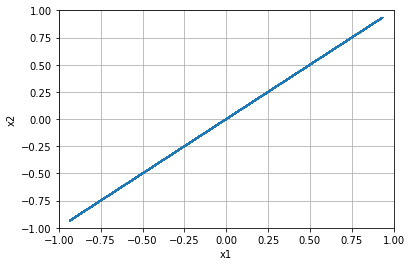


=================== Rollout 1077 =====================
x_init [[-0.16]
 [-0.76]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.16 -0.76]
xx [-0.16 -0.76]
xxx [-0.16 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.76]


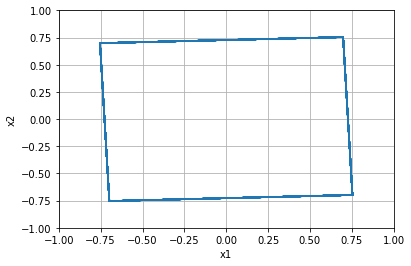


=================== Rollout 1078 =====================
x_init [[-0.16]
 [-0.72]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.16 -0.72]
xx [-0.16 -0.72]
xxx [-0.16 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.72]


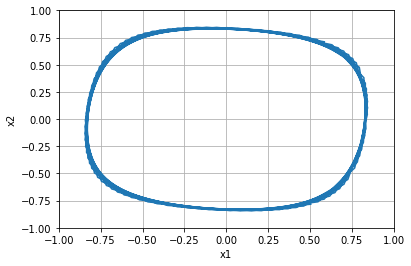


=================== Rollout 1079 =====================
x_init [[-0.16]
 [-0.68]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.16 -0.68]
xx [-0.16 -0.68]
xxx [-0.16 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.6799999999999999]


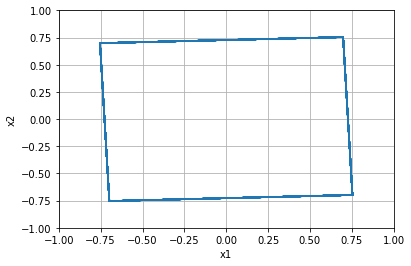


=================== Rollout 1080 =====================
x_init [[-0.16]
 [-0.64]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.16 -0.64]
xx [-0.16 -0.64]
xxx [-0.16 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.64]


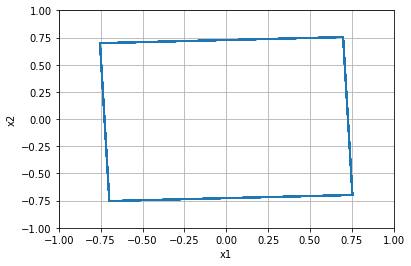


=================== Rollout 1081 =====================
x_init [[-0.16]
 [-0.6 ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.16 -0.6 ]
xx [-0.16 -0.6 ]
xxx [-0.16 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.6]


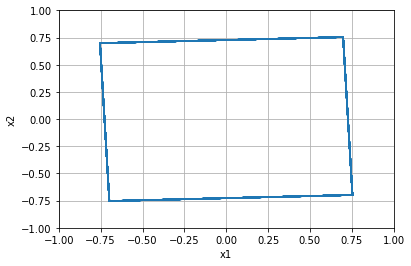


=================== Rollout 1082 =====================
x_init [[-0.16]
 [-0.56]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.16 -0.56]
xx [-0.16 -0.56]
xxx [-0.16 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.56]


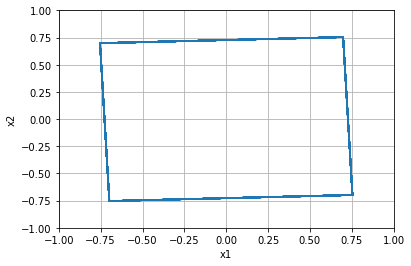


=================== Rollout 1083 =====================
x_init [[-0.16]
 [-0.52]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.16 -0.52]
xx [-0.16 -0.52]
xxx [-0.16 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.52]


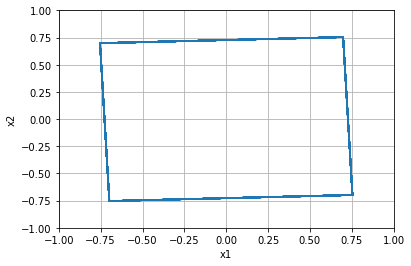


=================== Rollout 1084 =====================
x_init [[-0.16]
 [-0.48]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.16 -0.48]
xx [-0.16 -0.48]
xxx [-0.16 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.48]


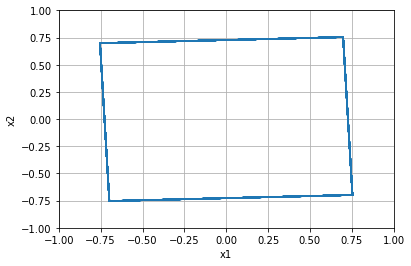


=================== Rollout 1085 =====================
x_init [[-0.16]
 [-0.44]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.16 -0.44]
xx [-0.16 -0.44]
xxx [-0.16 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.43999999999999995]


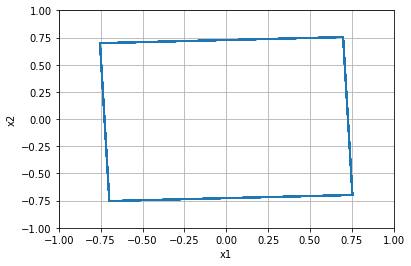


=================== Rollout 1086 =====================
x_init [[-0.16]
 [-0.4 ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.16 -0.4 ]
xx [-0.16 -0.4 ]
xxx [-0.16 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.4]


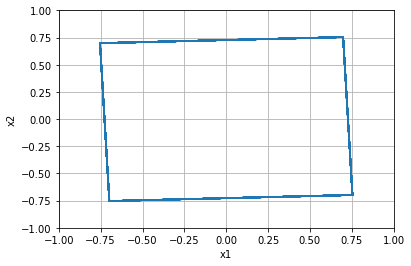


=================== Rollout 1087 =====================
x_init [[-0.16]
 [-0.36]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.16 -0.36]
xx [-0.16 -0.36]
xxx [-0.16 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.36]


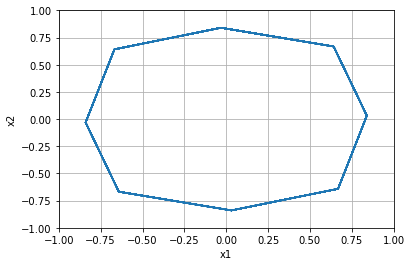


=================== Rollout 1088 =====================
x_init [[-0.16]
 [-0.32]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.16 -0.32]
xx [-0.16 -0.32]
xxx [-0.16 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.31999999999999995]


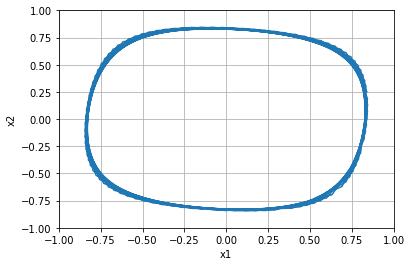


=================== Rollout 1089 =====================
x_init [[-0.16]
 [-0.28]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.16 -0.28]
xx [-0.16 -0.28]
xxx [-0.16 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.28]


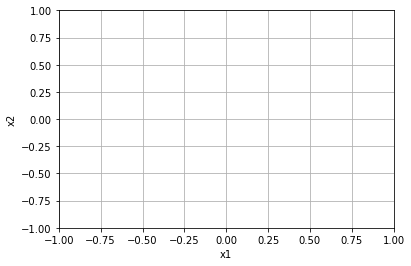


=================== Rollout 1090 =====================
x_init [[-0.16]
 [-0.24]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.16 -0.24]
xx [-0.16 -0.24]
xxx [-0.16 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.24]


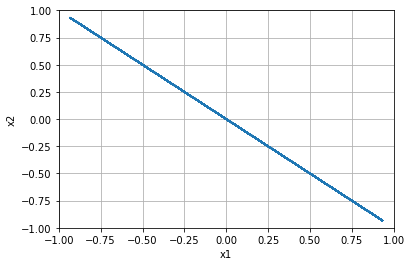


=================== Rollout 1091 =====================
x_init [[-0.16]
 [-0.2 ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.16 -0.2 ]
xx [-0.16 -0.2 ]
xxx [-0.16 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.19999999999999996]


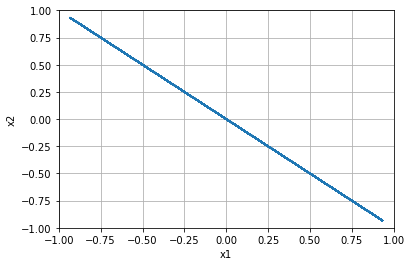


=================== Rollout 1092 =====================
x_init [[-0.16]
 [-0.16]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.16 -0.16]
xx [-0.16 -0.16]
xxx [-0.16 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.16000000000000003]


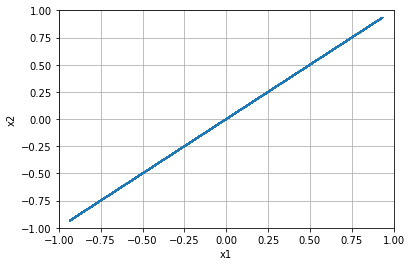


=================== Rollout 1093 =====================
x_init [[-0.16]
 [-0.12]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.16 -0.12]
xx [-0.16 -0.12]
xxx [-0.16 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.12]


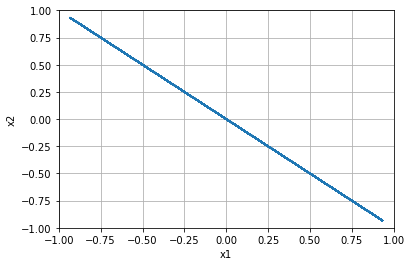


=================== Rollout 1094 =====================
x_init [[-0.16]
 [-0.08]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.16 -0.08]
xx [-0.16 -0.08]
xxx [-0.16 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.07999999999999996]


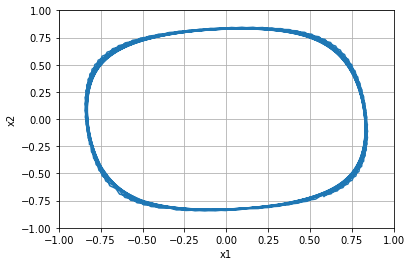


=================== Rollout 1095 =====================
x_init [[-0.16]
 [-0.04]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.16 -0.04]
xx [-0.16 -0.04]
xxx [-0.16 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, -0.040000000000000036]


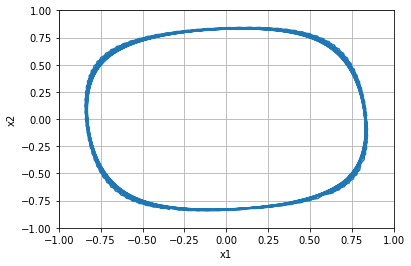


=================== Rollout 1096 =====================
x_init [[-0.16]
 [ 0.  ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.16  0.  ]
xx [-0.16  0.  ]
xxx [-0.16  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.0]


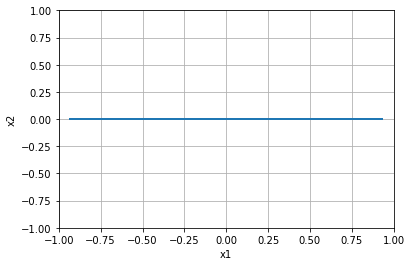


=================== Rollout 1097 =====================
x_init [[-0.16]
 [ 0.04]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.16  0.04]
xx [-0.16  0.04]
xxx [-0.16  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.040000000000000036]


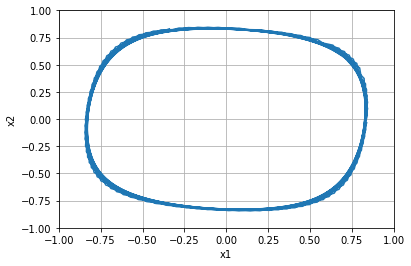


=================== Rollout 1098 =====================
x_init [[-0.16]
 [ 0.08]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.16  0.08]
xx [-0.16  0.08]
xxx [-0.16  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.08000000000000007]


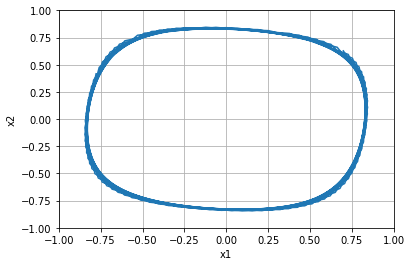


=================== Rollout 1099 =====================
x_init [[-0.16]
 [ 0.12]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.16  0.12]
xx [-0.16  0.12]
xxx [-0.16  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.1200000000000001]


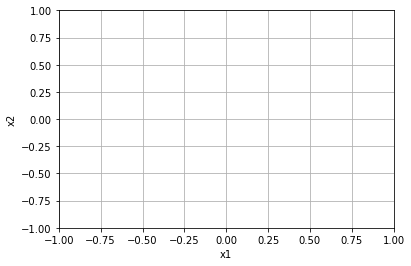


=================== Rollout 1100 =====================
x_init [[-0.16]
 [ 0.16]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.16  0.16]
xx [-0.16  0.16]
xxx [-0.16  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.15999999999999992]


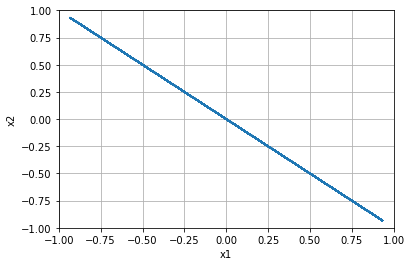


=================== Rollout 1101 =====================
x_init [[-0.16]
 [ 0.2 ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.16  0.2 ]
xx [-0.16  0.2 ]
xxx [-0.16  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.19999999999999996]


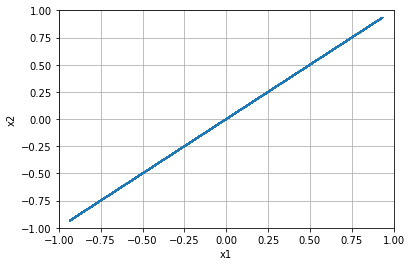


=================== Rollout 1102 =====================
x_init [[-0.16]
 [ 0.24]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.16  0.24]
xx [-0.16  0.24]
xxx [-0.16  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.24]


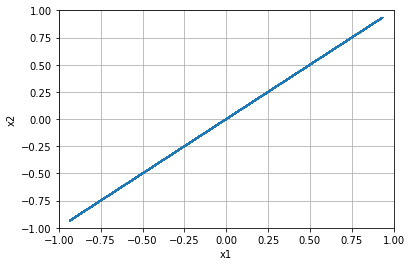


=================== Rollout 1103 =====================
x_init [[-0.16]
 [ 0.28]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.16  0.28]
xx [-0.16  0.28]
xxx [-0.16  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.28]


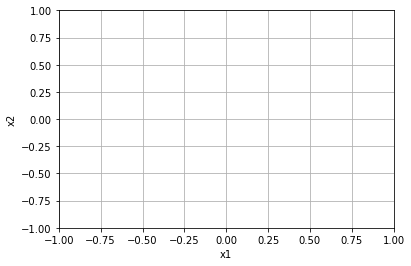


=================== Rollout 1104 =====================
x_init [[-0.16]
 [ 0.32]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.16  0.32]
xx [-0.16  0.32]
xxx [-0.16  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.32000000000000006]


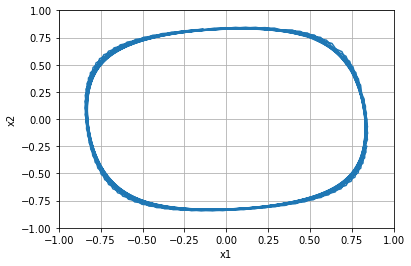


=================== Rollout 1105 =====================
x_init [[-0.16]
 [ 0.36]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.16  0.36]
xx [-0.16  0.36]
xxx [-0.16  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.3600000000000001]


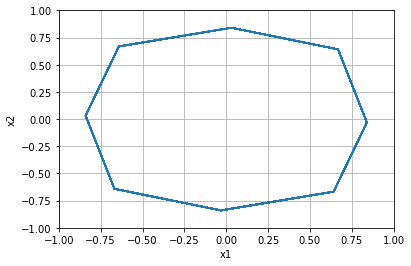


=================== Rollout 1106 =====================
x_init [[-0.16]
 [ 0.4 ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.16  0.4 ]
xx [-0.16  0.4 ]
xxx [-0.16  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.40000000000000013]


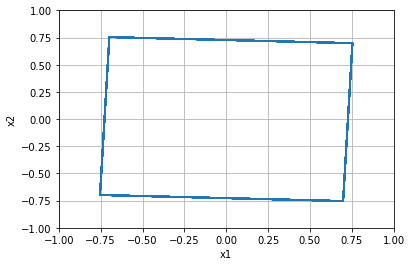


=================== Rollout 1107 =====================
x_init [[-0.16]
 [ 0.44]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.16  0.44]
xx [-0.16  0.44]
xxx [-0.16  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.43999999999999995]


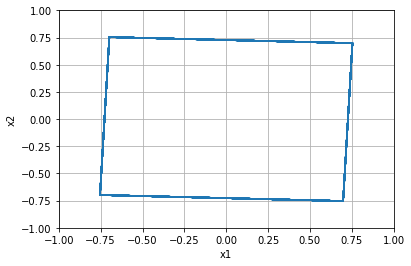


=================== Rollout 1108 =====================
x_init [[-0.16]
 [ 0.48]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.16  0.48]
xx [-0.16  0.48]
xxx [-0.16  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.48]


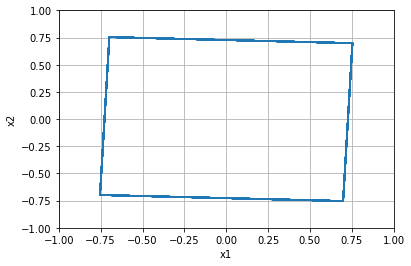


=================== Rollout 1109 =====================
x_init [[-0.16]
 [ 0.52]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.16  0.52]
xx [-0.16  0.52]
xxx [-0.16  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.52]


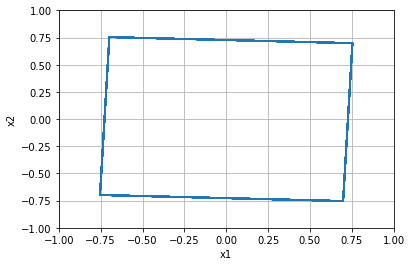


=================== Rollout 1110 =====================
x_init [[-0.16]
 [ 0.56]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.16  0.56]
xx [-0.16  0.56]
xxx [-0.16  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.56]


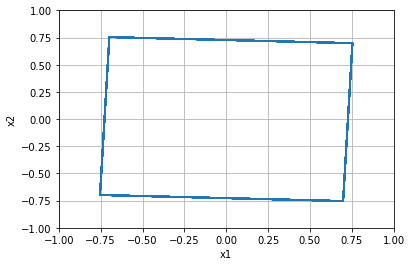


=================== Rollout 1111 =====================
x_init [[-0.16]
 [ 0.6 ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.16  0.6 ]
xx [-0.16  0.6 ]
xxx [-0.16  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.6000000000000001]


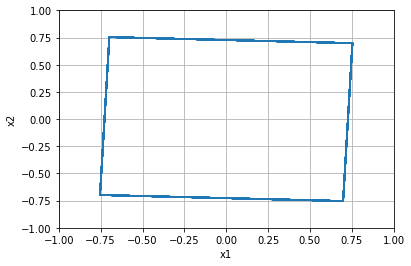


=================== Rollout 1112 =====================
x_init [[-0.16]
 [ 0.64]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.16  0.64]
xx [-0.16  0.64]
xxx [-0.16  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.6400000000000001]


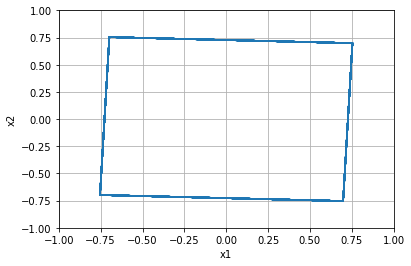


=================== Rollout 1113 =====================
x_init [[-0.16]
 [ 0.68]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.16  0.68]
xx [-0.16  0.68]
xxx [-0.16  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.6799999999999999]


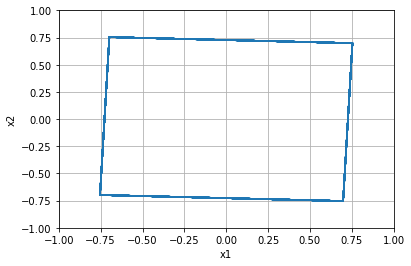


=================== Rollout 1114 =====================
x_init [[-0.16]
 [ 0.72]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.16  0.72]
xx [-0.16  0.72]
xxx [-0.16  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.72]


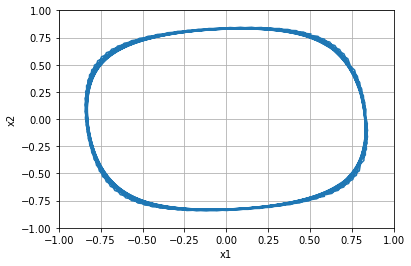


=================== Rollout 1115 =====================
x_init [[-0.16]
 [ 0.76]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.16  0.76]
xx [-0.16  0.76]
xxx [-0.16  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.76]


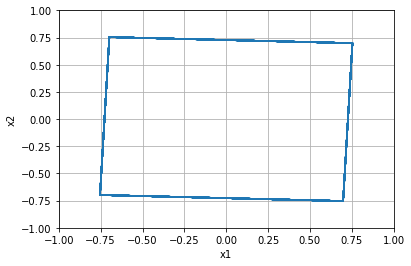


=================== Rollout 1116 =====================
x_init [[-0.16]
 [ 0.8 ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.16  0.8 ]
xx [-0.16  0.8 ]
xxx [-0.16  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.8]


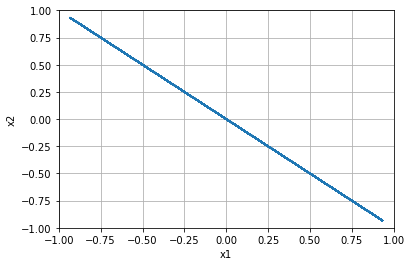


=================== Rollout 1117 =====================
x_init [[-0.16]
 [ 0.84]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.16  0.84]
xx [-0.16  0.84]
xxx [-0.16  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.8400000000000001]


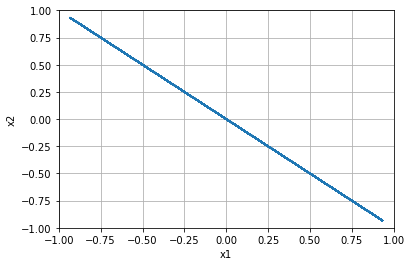


=================== Rollout 1118 =====================
x_init [[-0.16]
 [ 0.88]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.16  0.88]
xx [-0.16  0.88]
xxx [-0.16  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.8800000000000001]


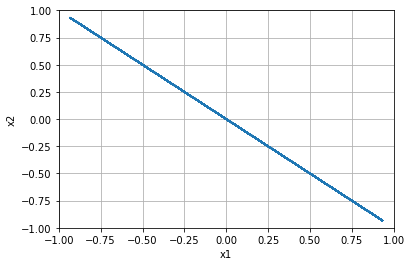


=================== Rollout 1119 =====================
x_init [[-0.16]
 [ 0.92]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.16  0.92]
xx [-0.16  0.92]
xxx [-0.16  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.9199999999999999]


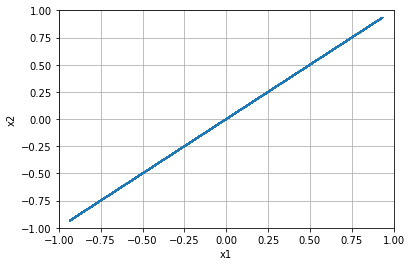


=================== Rollout 1120 =====================
x_init [[-0.16]
 [ 0.96]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.16  0.96]
xx [-0.16  0.96]
xxx [-0.16  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 0.96]


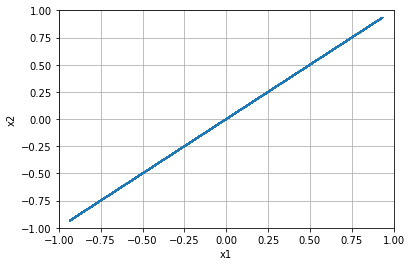


=================== Rollout 1121 =====================
x_init [[-0.16]
 [ 1.  ]]
x_buffer [[-0.16 -0.16 -0.16 -0.16 -0.16]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.16  1.  ]
xx [-0.16  1.  ]
xxx [-0.16  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.16000000000000003, 1.0]


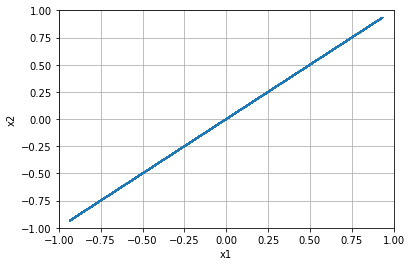


=================== Rollout 1122 =====================
x_init [[-0.12]
 [-1.  ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.12 -1.  ]
xx [-0.12 -1.  ]
xxx [-0.12 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -1.0]


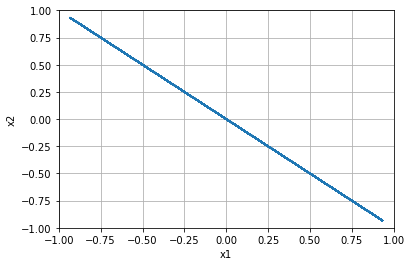


=================== Rollout 1123 =====================
x_init [[-0.12]
 [-0.96]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.12 -0.96]
xx [-0.12 -0.96]
xxx [-0.12 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.96]


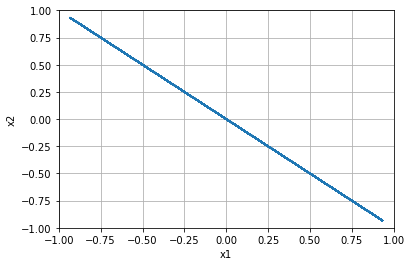


=================== Rollout 1124 =====================
x_init [[-0.12]
 [-0.92]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.12 -0.92]
xx [-0.12 -0.92]
xxx [-0.12 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.92]


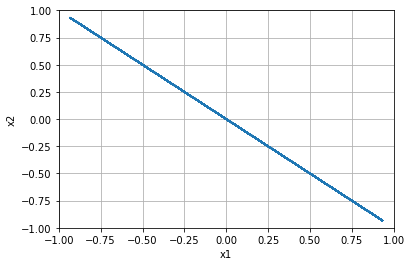


=================== Rollout 1125 =====================
x_init [[-0.12]
 [-0.88]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.12 -0.88]
xx [-0.12 -0.88]
xxx [-0.12 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.88]


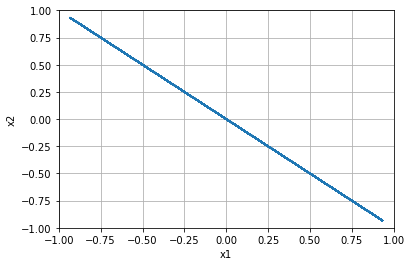


=================== Rollout 1126 =====================
x_init [[-0.12]
 [-0.84]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.12 -0.84]
xx [-0.12 -0.84]
xxx [-0.12 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.84]


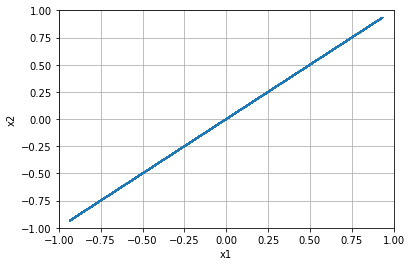


=================== Rollout 1127 =====================
x_init [[-0.12]
 [-0.8 ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.12 -0.8 ]
xx [-0.12 -0.8 ]
xxx [-0.12 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.8]


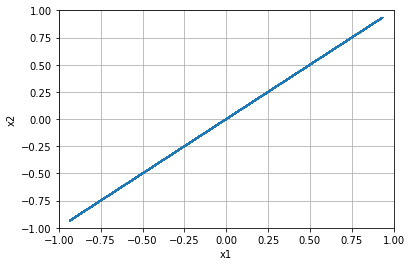


=================== Rollout 1128 =====================
x_init [[-0.12]
 [-0.76]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.12 -0.76]
xx [-0.12 -0.76]
xxx [-0.12 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.76]


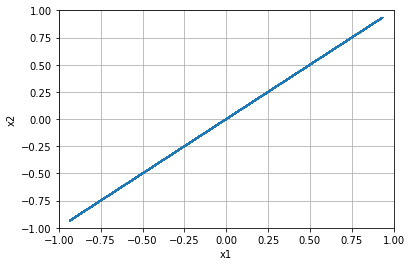


=================== Rollout 1129 =====================
x_init [[-0.12]
 [-0.72]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.12 -0.72]
xx [-0.12 -0.72]
xxx [-0.12 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.72]


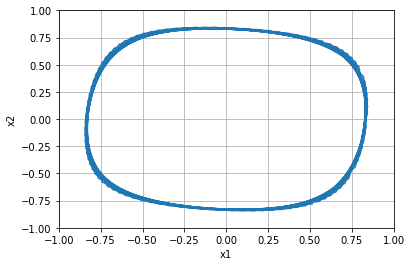


=================== Rollout 1130 =====================
x_init [[-0.12]
 [-0.68]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.12 -0.68]
xx [-0.12 -0.68]
xxx [-0.12 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.6799999999999999]


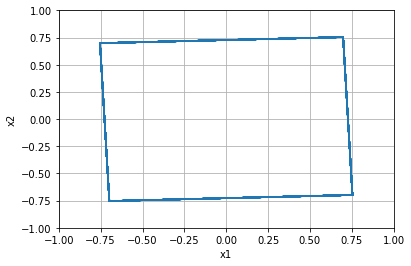


=================== Rollout 1131 =====================
x_init [[-0.12]
 [-0.64]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.12 -0.64]
xx [-0.12 -0.64]
xxx [-0.12 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.64]


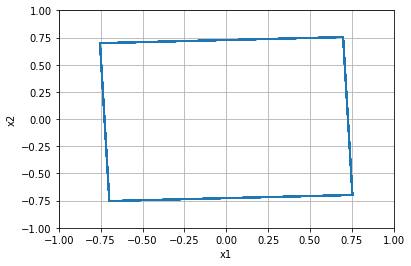


=================== Rollout 1132 =====================
x_init [[-0.12]
 [-0.6 ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.12 -0.6 ]
xx [-0.12 -0.6 ]
xxx [-0.12 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.6]


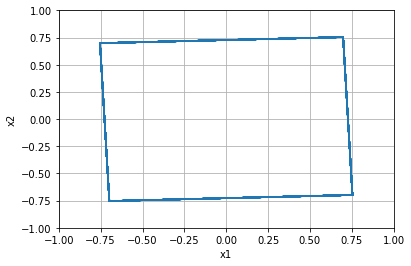


=================== Rollout 1133 =====================
x_init [[-0.12]
 [-0.56]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.12 -0.56]
xx [-0.12 -0.56]
xxx [-0.12 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.56]


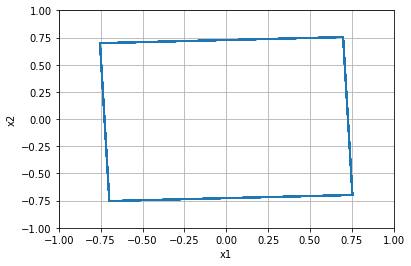


=================== Rollout 1134 =====================
x_init [[-0.12]
 [-0.52]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.12 -0.52]
xx [-0.12 -0.52]
xxx [-0.12 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.52]


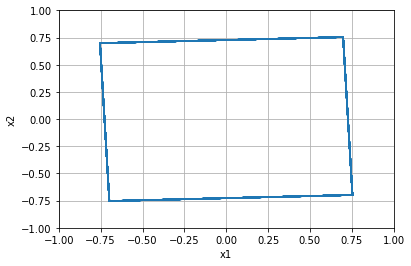


=================== Rollout 1135 =====================
x_init [[-0.12]
 [-0.48]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.12 -0.48]
xx [-0.12 -0.48]
xxx [-0.12 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.48]


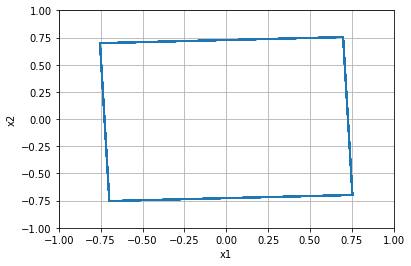


=================== Rollout 1136 =====================
x_init [[-0.12]
 [-0.44]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.12 -0.44]
xx [-0.12 -0.44]
xxx [-0.12 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.43999999999999995]


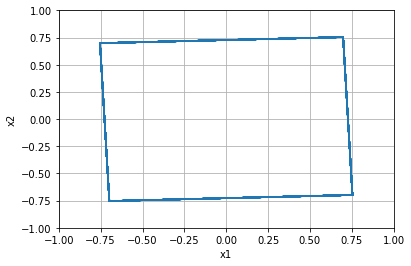


=================== Rollout 1137 =====================
x_init [[-0.12]
 [-0.4 ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.12 -0.4 ]
xx [-0.12 -0.4 ]
xxx [-0.12 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.4]


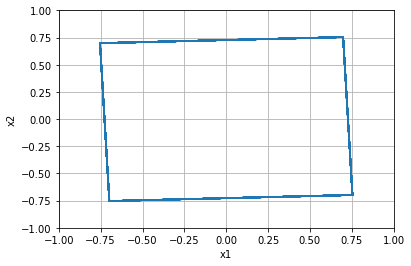


=================== Rollout 1138 =====================
x_init [[-0.12]
 [-0.36]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.12 -0.36]
xx [-0.12 -0.36]
xxx [-0.12 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.36]


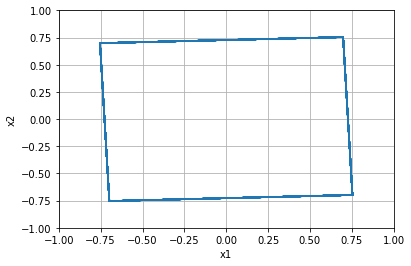


=================== Rollout 1139 =====================
x_init [[-0.12]
 [-0.32]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.12 -0.32]
xx [-0.12 -0.32]
xxx [-0.12 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.31999999999999995]


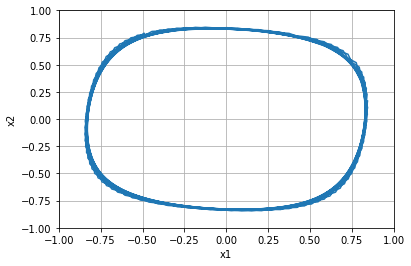


=================== Rollout 1140 =====================
x_init [[-0.12]
 [-0.28]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.12 -0.28]
xx [-0.12 -0.28]
xxx [-0.12 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.28]


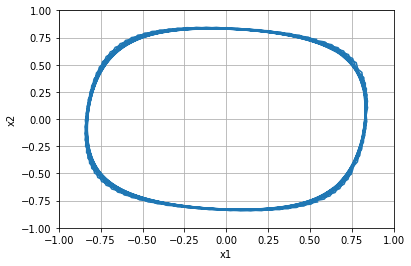


=================== Rollout 1141 =====================
x_init [[-0.12]
 [-0.24]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.12 -0.24]
xx [-0.12 -0.24]
xxx [-0.12 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.24]


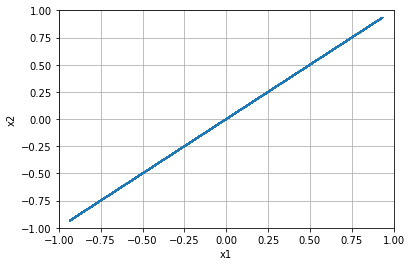


=================== Rollout 1142 =====================
x_init [[-0.12]
 [-0.2 ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.12 -0.2 ]
xx [-0.12 -0.2 ]
xxx [-0.12 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.19999999999999996]


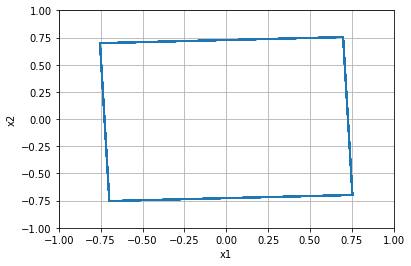


=================== Rollout 1143 =====================
x_init [[-0.12]
 [-0.16]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.12 -0.16]
xx [-0.12 -0.16]
xxx [-0.12 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.16000000000000003]


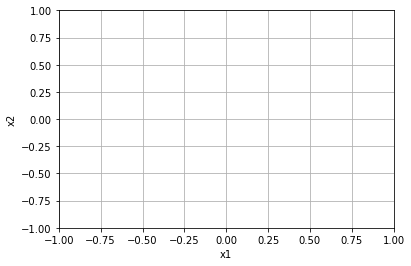


=================== Rollout 1144 =====================
x_init [[-0.12]
 [-0.12]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.12 -0.12]
xx [-0.12 -0.12]
xxx [-0.12 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.12]


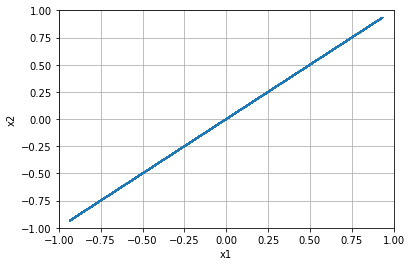


=================== Rollout 1145 =====================
x_init [[-0.12]
 [-0.08]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.12 -0.08]
xx [-0.12 -0.08]
xxx [-0.12 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.07999999999999996]


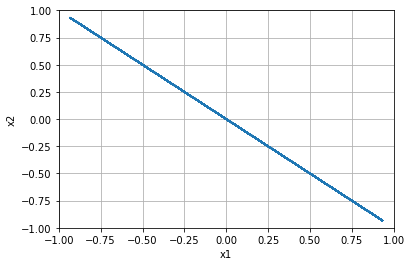


=================== Rollout 1146 =====================
x_init [[-0.12]
 [-0.04]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.12 -0.04]
xx [-0.12 -0.04]
xxx [-0.12 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, -0.040000000000000036]


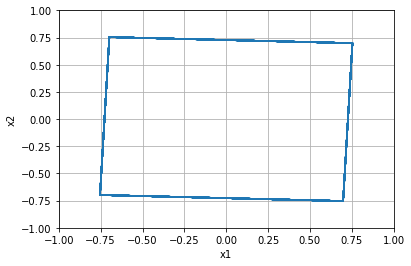


=================== Rollout 1147 =====================
x_init [[-0.12]
 [ 0.  ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.12  0.  ]
xx [-0.12  0.  ]
xxx [-0.12  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.0]


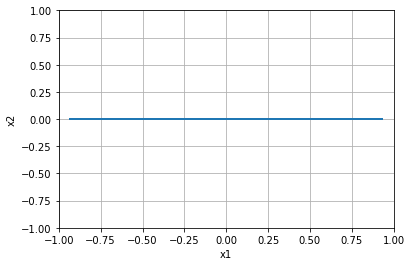


=================== Rollout 1148 =====================
x_init [[-0.12]
 [ 0.04]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.12  0.04]
xx [-0.12  0.04]
xxx [-0.12  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.040000000000000036]


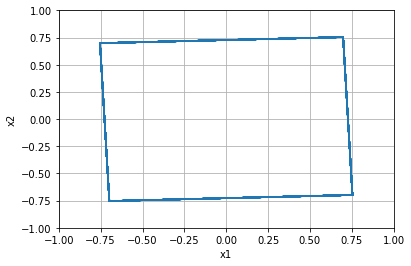


=================== Rollout 1149 =====================
x_init [[-0.12]
 [ 0.08]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.12  0.08]
xx [-0.12  0.08]
xxx [-0.12  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.08000000000000007]


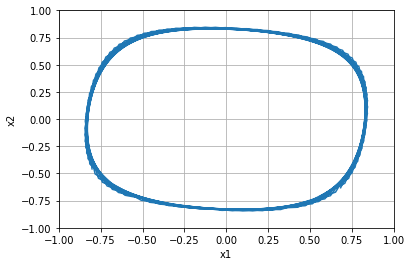


=================== Rollout 1150 =====================
x_init [[-0.12]
 [ 0.12]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.12  0.12]
xx [-0.12  0.12]
xxx [-0.12  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.1200000000000001]


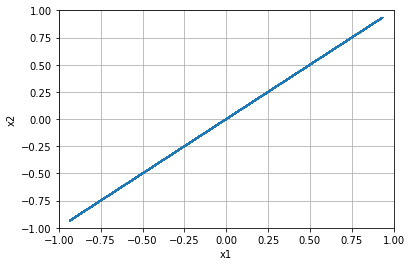


=================== Rollout 1151 =====================
x_init [[-0.12]
 [ 0.16]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.12  0.16]
xx [-0.12  0.16]
xxx [-0.12  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.15999999999999992]


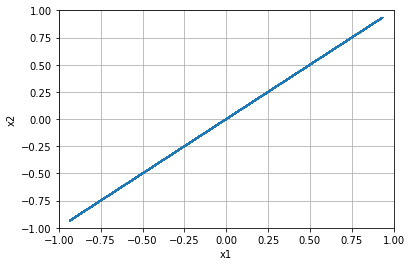


=================== Rollout 1152 =====================
x_init [[-0.12]
 [ 0.2 ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.12  0.2 ]
xx [-0.12  0.2 ]
xxx [-0.12  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.19999999999999996]


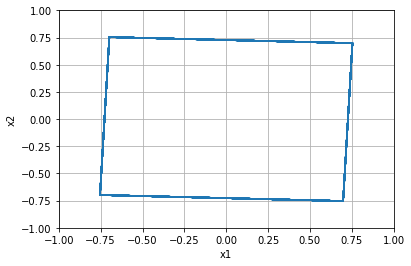


=================== Rollout 1153 =====================
x_init [[-0.12]
 [ 0.24]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.12  0.24]
xx [-0.12  0.24]
xxx [-0.12  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.24]


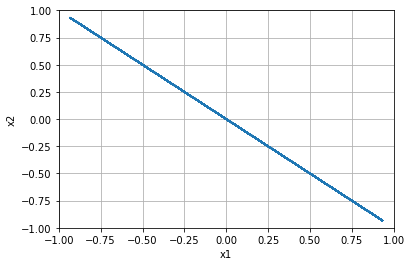


=================== Rollout 1154 =====================
x_init [[-0.12]
 [ 0.28]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.12  0.28]
xx [-0.12  0.28]
xxx [-0.12  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.28]


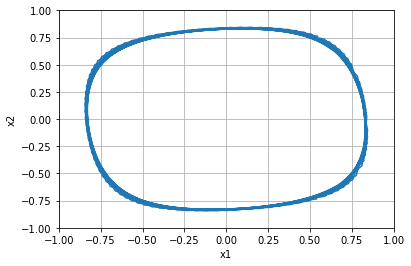


=================== Rollout 1155 =====================
x_init [[-0.12]
 [ 0.32]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.12  0.32]
xx [-0.12  0.32]
xxx [-0.12  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.32000000000000006]


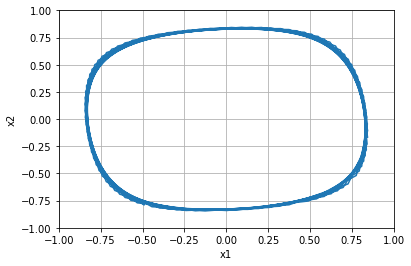


=================== Rollout 1156 =====================
x_init [[-0.12]
 [ 0.36]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.12  0.36]
xx [-0.12  0.36]
xxx [-0.12  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.3600000000000001]


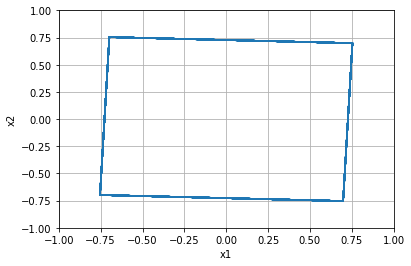


=================== Rollout 1157 =====================
x_init [[-0.12]
 [ 0.4 ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.12  0.4 ]
xx [-0.12  0.4 ]
xxx [-0.12  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.40000000000000013]


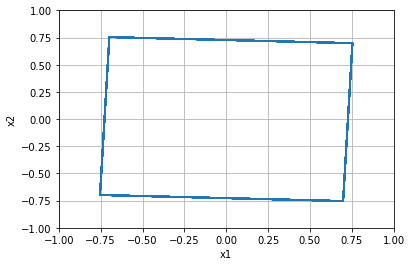


=================== Rollout 1158 =====================
x_init [[-0.12]
 [ 0.44]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.12  0.44]
xx [-0.12  0.44]
xxx [-0.12  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.43999999999999995]


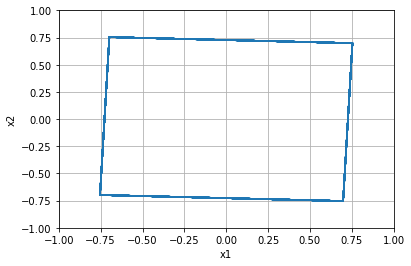


=================== Rollout 1159 =====================
x_init [[-0.12]
 [ 0.48]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.12  0.48]
xx [-0.12  0.48]
xxx [-0.12  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.48]


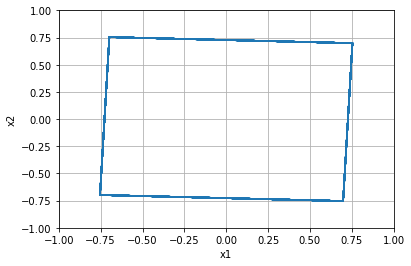


=================== Rollout 1160 =====================
x_init [[-0.12]
 [ 0.52]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.12  0.52]
xx [-0.12  0.52]
xxx [-0.12  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.52]


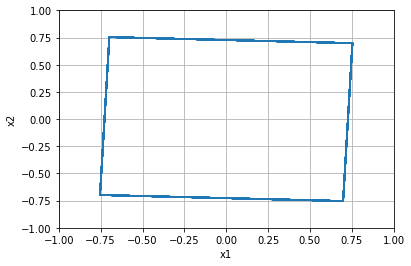


=================== Rollout 1161 =====================
x_init [[-0.12]
 [ 0.56]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.12  0.56]
xx [-0.12  0.56]
xxx [-0.12  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.56]


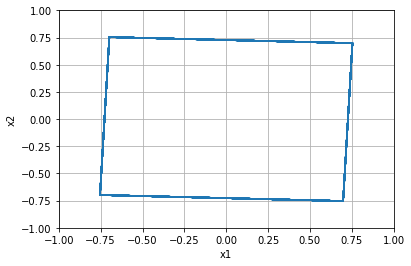


=================== Rollout 1162 =====================
x_init [[-0.12]
 [ 0.6 ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.12  0.6 ]
xx [-0.12  0.6 ]
xxx [-0.12  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.6000000000000001]


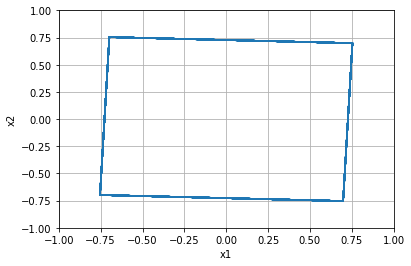


=================== Rollout 1163 =====================
x_init [[-0.12]
 [ 0.64]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.12  0.64]
xx [-0.12  0.64]
xxx [-0.12  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.6400000000000001]


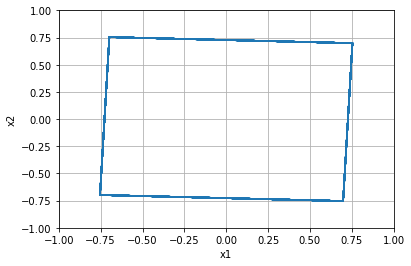


=================== Rollout 1164 =====================
x_init [[-0.12]
 [ 0.68]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.12  0.68]
xx [-0.12  0.68]
xxx [-0.12  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.6799999999999999]


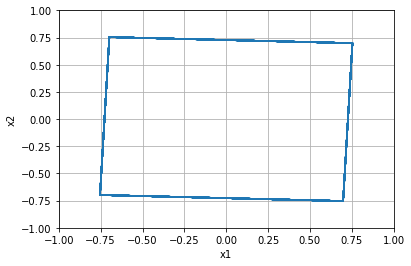


=================== Rollout 1165 =====================
x_init [[-0.12]
 [ 0.72]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.12  0.72]
xx [-0.12  0.72]
xxx [-0.12  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.72]


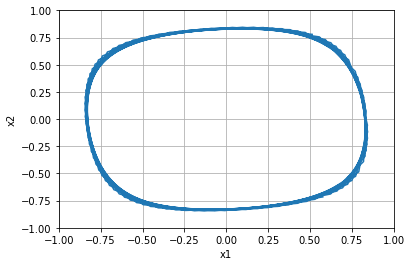


=================== Rollout 1166 =====================
x_init [[-0.12]
 [ 0.76]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.12  0.76]
xx [-0.12  0.76]
xxx [-0.12  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.76]


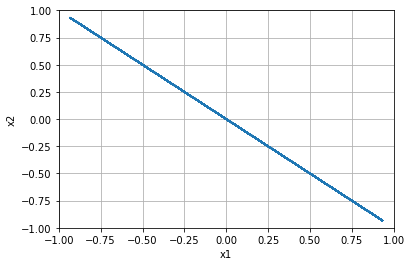


=================== Rollout 1167 =====================
x_init [[-0.12]
 [ 0.8 ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.12  0.8 ]
xx [-0.12  0.8 ]
xxx [-0.12  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.8]


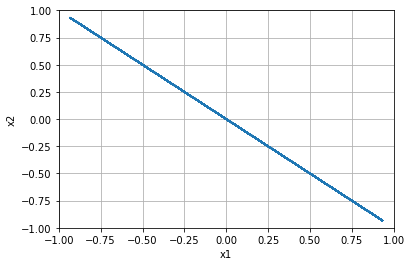


=================== Rollout 1168 =====================
x_init [[-0.12]
 [ 0.84]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.12  0.84]
xx [-0.12  0.84]
xxx [-0.12  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.8400000000000001]


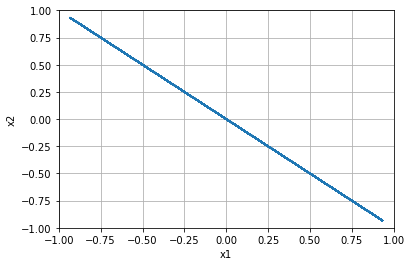


=================== Rollout 1169 =====================
x_init [[-0.12]
 [ 0.88]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.12  0.88]
xx [-0.12  0.88]
xxx [-0.12  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.8800000000000001]


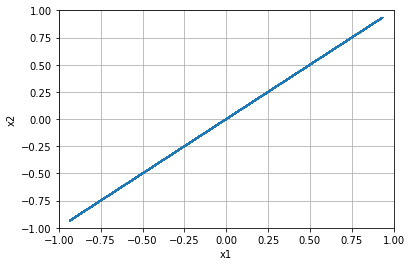


=================== Rollout 1170 =====================
x_init [[-0.12]
 [ 0.92]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.12  0.92]
xx [-0.12  0.92]
xxx [-0.12  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.9199999999999999]


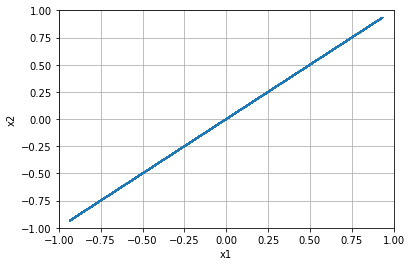


=================== Rollout 1171 =====================
x_init [[-0.12]
 [ 0.96]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.12  0.96]
xx [-0.12  0.96]
xxx [-0.12  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 0.96]


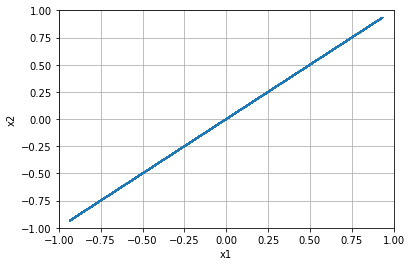


=================== Rollout 1172 =====================
x_init [[-0.12]
 [ 1.  ]]
x_buffer [[-0.12 -0.12 -0.12 -0.12 -0.12]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.12  1.  ]
xx [-0.12  1.  ]
xxx [-0.12  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.12, 1.0]


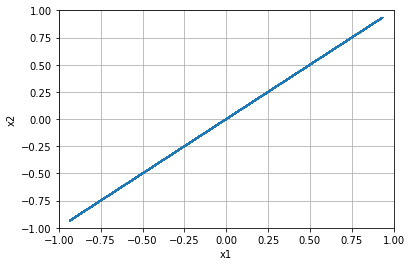


=================== Rollout 1173 =====================
x_init [[-0.08]
 [-1.  ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.08 -1.  ]
xx [-0.08 -1.  ]
xxx [-0.08 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -1.0]


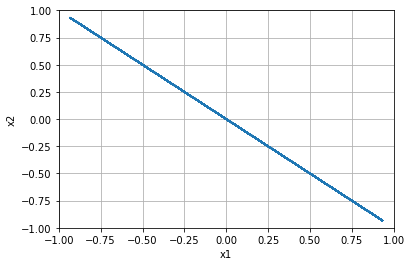


=================== Rollout 1174 =====================
x_init [[-0.08]
 [-0.96]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.08 -0.96]
xx [-0.08 -0.96]
xxx [-0.08 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.96]


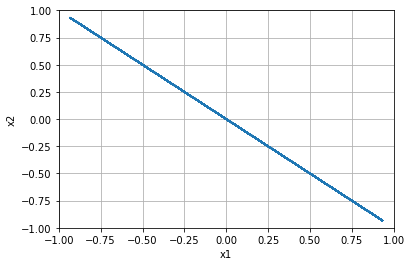


=================== Rollout 1175 =====================
x_init [[-0.08]
 [-0.92]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.08 -0.92]
xx [-0.08 -0.92]
xxx [-0.08 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.92]


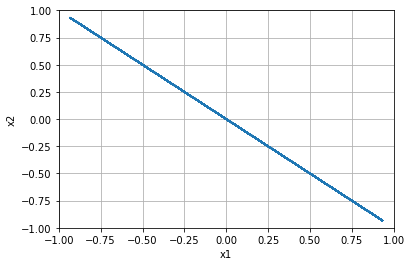


=================== Rollout 1176 =====================
x_init [[-0.08]
 [-0.88]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.08 -0.88]
xx [-0.08 -0.88]
xxx [-0.08 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.88]


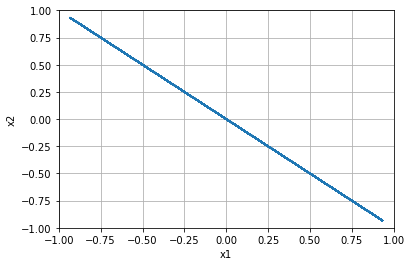


=================== Rollout 1177 =====================
x_init [[-0.08]
 [-0.84]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.08 -0.84]
xx [-0.08 -0.84]
xxx [-0.08 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.84]


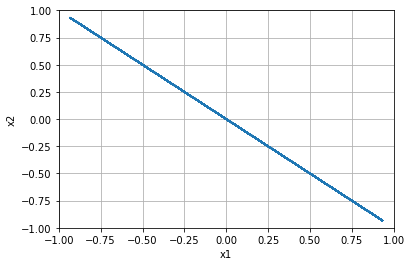


=================== Rollout 1178 =====================
x_init [[-0.08]
 [-0.8 ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.08 -0.8 ]
xx [-0.08 -0.8 ]
xxx [-0.08 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.8]


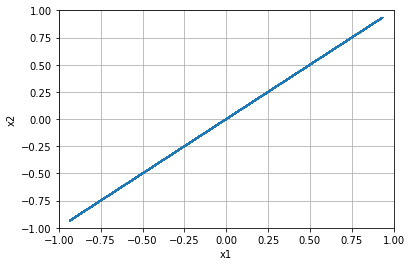


=================== Rollout 1179 =====================
x_init [[-0.08]
 [-0.76]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.08 -0.76]
xx [-0.08 -0.76]
xxx [-0.08 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.76]


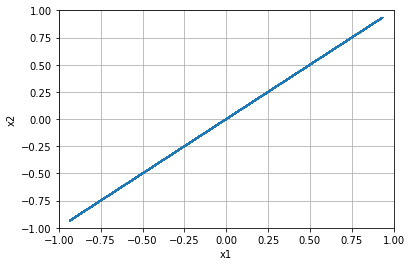


=================== Rollout 1180 =====================
x_init [[-0.08]
 [-0.72]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.08 -0.72]
xx [-0.08 -0.72]
xxx [-0.08 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.72]


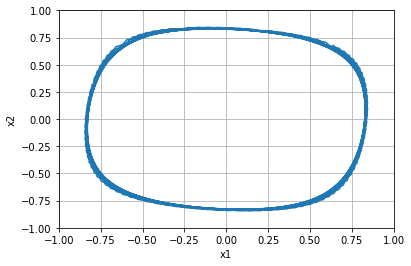


=================== Rollout 1181 =====================
x_init [[-0.08]
 [-0.68]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.08 -0.68]
xx [-0.08 -0.68]
xxx [-0.08 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.6799999999999999]


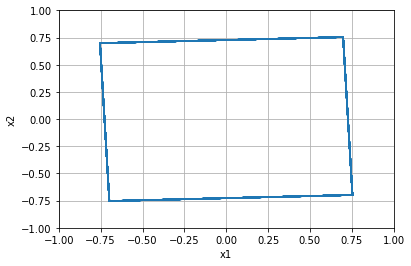


=================== Rollout 1182 =====================
x_init [[-0.08]
 [-0.64]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.08 -0.64]
xx [-0.08 -0.64]
xxx [-0.08 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.64]


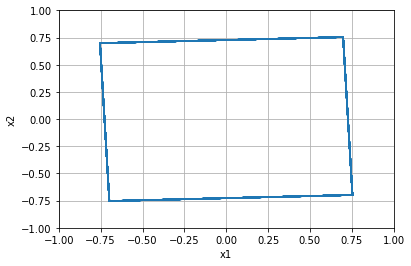


=================== Rollout 1183 =====================
x_init [[-0.08]
 [-0.6 ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.08 -0.6 ]
xx [-0.08 -0.6 ]
xxx [-0.08 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.6]


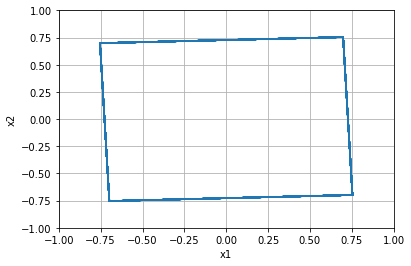


=================== Rollout 1184 =====================
x_init [[-0.08]
 [-0.56]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.08 -0.56]
xx [-0.08 -0.56]
xxx [-0.08 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.56]


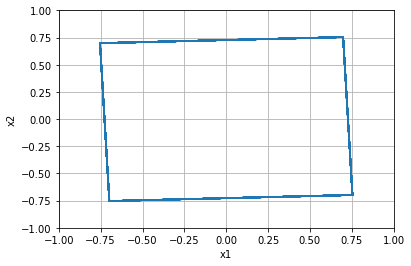


=================== Rollout 1185 =====================
x_init [[-0.08]
 [-0.52]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.08 -0.52]
xx [-0.08 -0.52]
xxx [-0.08 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.52]


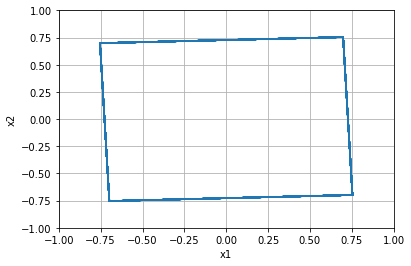


=================== Rollout 1186 =====================
x_init [[-0.08]
 [-0.48]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.08 -0.48]
xx [-0.08 -0.48]
xxx [-0.08 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.48]


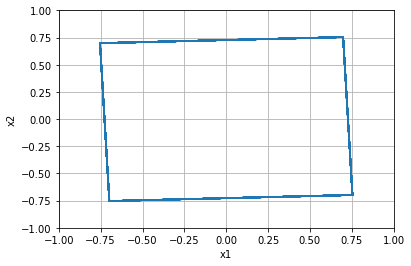


=================== Rollout 1187 =====================
x_init [[-0.08]
 [-0.44]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.08 -0.44]
xx [-0.08 -0.44]
xxx [-0.08 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.43999999999999995]


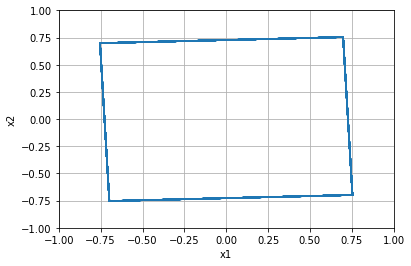


=================== Rollout 1188 =====================
x_init [[-0.08]
 [-0.4 ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.08 -0.4 ]
xx [-0.08 -0.4 ]
xxx [-0.08 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.4]


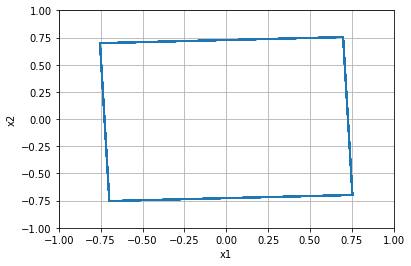


=================== Rollout 1189 =====================
x_init [[-0.08]
 [-0.36]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.08 -0.36]
xx [-0.08 -0.36]
xxx [-0.08 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.36]


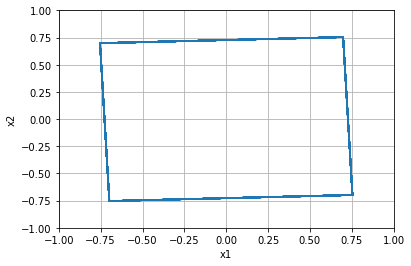


=================== Rollout 1190 =====================
x_init [[-0.08]
 [-0.32]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.08 -0.32]
xx [-0.08 -0.32]
xxx [-0.08 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.31999999999999995]


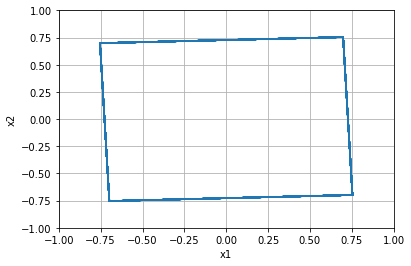


=================== Rollout 1191 =====================
x_init [[-0.08]
 [-0.28]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.08 -0.28]
xx [-0.08 -0.28]
xxx [-0.08 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.28]


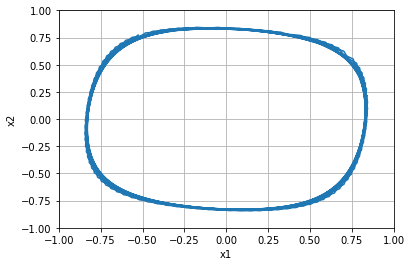


=================== Rollout 1192 =====================
x_init [[-0.08]
 [-0.24]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.08 -0.24]
xx [-0.08 -0.24]
xxx [-0.08 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.24]


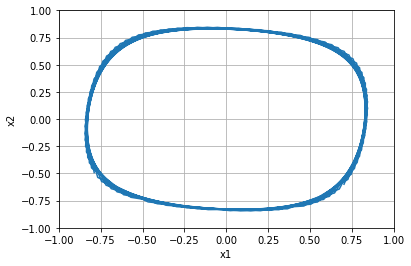


=================== Rollout 1193 =====================
x_init [[-0.08]
 [-0.2 ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.08 -0.2 ]
xx [-0.08 -0.2 ]
xxx [-0.08 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.19999999999999996]


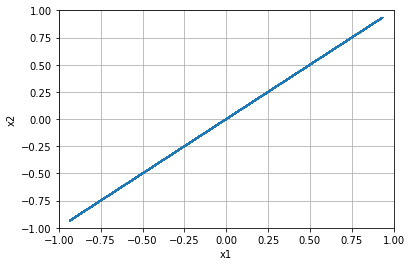


=================== Rollout 1194 =====================
x_init [[-0.08]
 [-0.16]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.08 -0.16]
xx [-0.08 -0.16]
xxx [-0.08 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.16000000000000003]


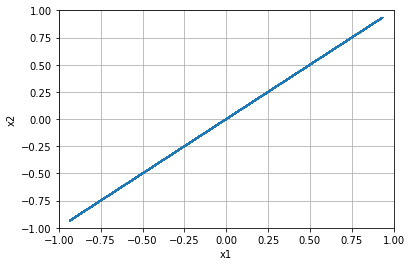


=================== Rollout 1195 =====================
x_init [[-0.08]
 [-0.12]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.08 -0.12]
xx [-0.08 -0.12]
xxx [-0.08 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.12]


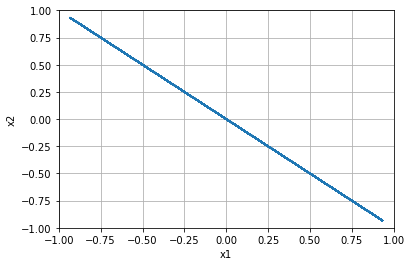


=================== Rollout 1196 =====================
x_init [[-0.08]
 [-0.08]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.08 -0.08]
xx [-0.08 -0.08]
xxx [-0.08 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.07999999999999996]


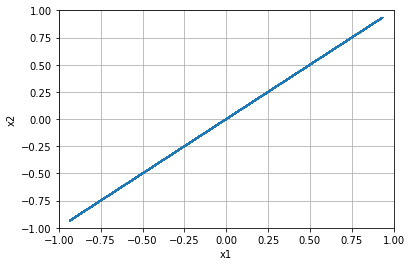


=================== Rollout 1197 =====================
x_init [[-0.08]
 [-0.04]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.08 -0.04]
xx [-0.08 -0.04]
xxx [-0.08 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, -0.040000000000000036]


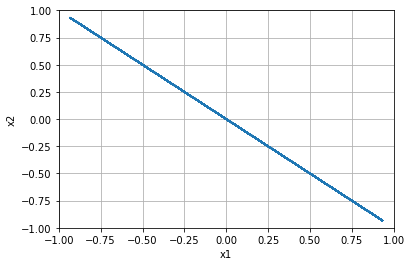


=================== Rollout 1198 =====================
x_init [[-0.08]
 [ 0.  ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.08  0.  ]
xx [-0.08  0.  ]
xxx [-0.08  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.0]


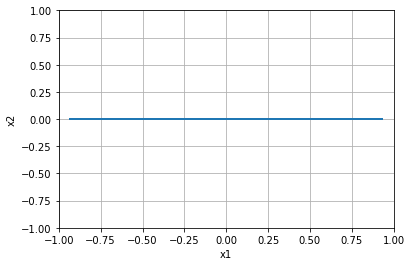


=================== Rollout 1199 =====================
x_init [[-0.08]
 [ 0.04]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.08  0.04]
xx [-0.08  0.04]
xxx [-0.08  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.040000000000000036]


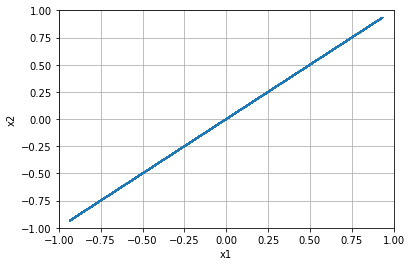


=================== Rollout 1200 =====================
x_init [[-0.08]
 [ 0.08]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.08  0.08]
xx [-0.08  0.08]
xxx [-0.08  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.08000000000000007]


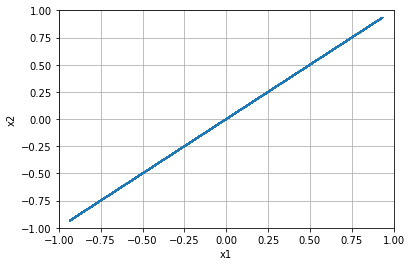


=================== Rollout 1201 =====================
x_init [[-0.08]
 [ 0.12]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.08  0.12]
xx [-0.08  0.12]
xxx [-0.08  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.1200000000000001]


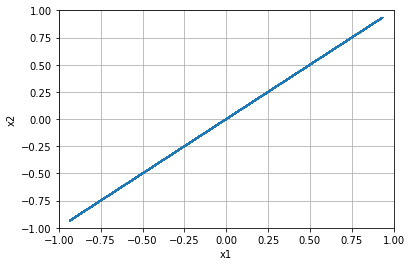


=================== Rollout 1202 =====================
x_init [[-0.08]
 [ 0.16]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.08  0.16]
xx [-0.08  0.16]
xxx [-0.08  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.15999999999999992]


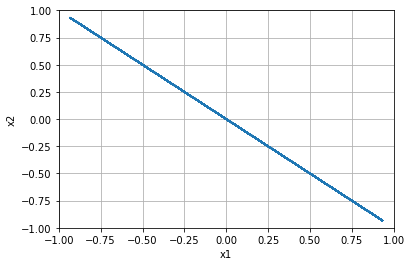


=================== Rollout 1203 =====================
x_init [[-0.08]
 [ 0.2 ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.08  0.2 ]
xx [-0.08  0.2 ]
xxx [-0.08  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.19999999999999996]


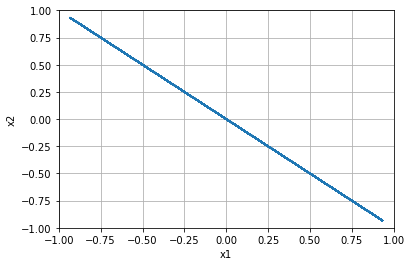


=================== Rollout 1204 =====================
x_init [[-0.08]
 [ 0.24]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.08  0.24]
xx [-0.08  0.24]
xxx [-0.08  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.24]


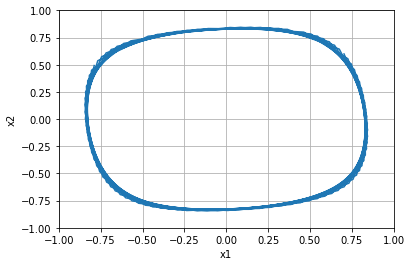


=================== Rollout 1205 =====================
x_init [[-0.08]
 [ 0.28]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.08  0.28]
xx [-0.08  0.28]
xxx [-0.08  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.28]


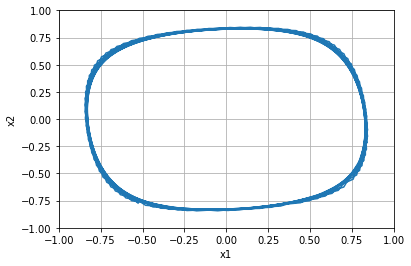


=================== Rollout 1206 =====================
x_init [[-0.08]
 [ 0.32]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.08  0.32]
xx [-0.08  0.32]
xxx [-0.08  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.32000000000000006]


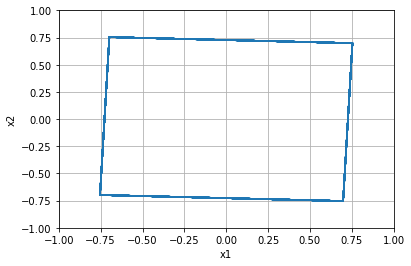


=================== Rollout 1207 =====================
x_init [[-0.08]
 [ 0.36]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.08  0.36]
xx [-0.08  0.36]
xxx [-0.08  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.3600000000000001]


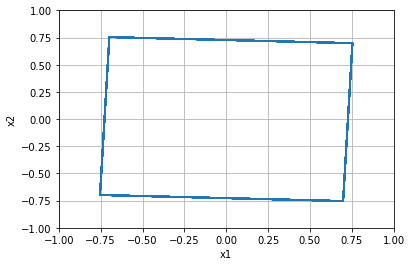


=================== Rollout 1208 =====================
x_init [[-0.08]
 [ 0.4 ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.08  0.4 ]
xx [-0.08  0.4 ]
xxx [-0.08  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.40000000000000013]


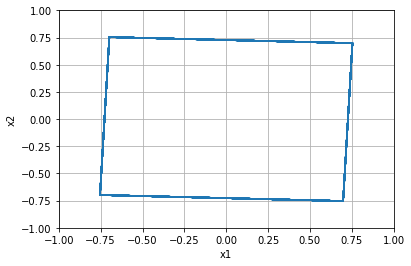


=================== Rollout 1209 =====================
x_init [[-0.08]
 [ 0.44]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.08  0.44]
xx [-0.08  0.44]
xxx [-0.08  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.43999999999999995]


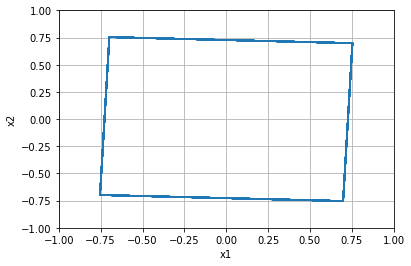


=================== Rollout 1210 =====================
x_init [[-0.08]
 [ 0.48]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.08  0.48]
xx [-0.08  0.48]
xxx [-0.08  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.48]


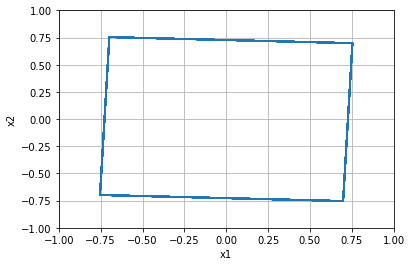


=================== Rollout 1211 =====================
x_init [[-0.08]
 [ 0.52]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.08  0.52]
xx [-0.08  0.52]
xxx [-0.08  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.52]


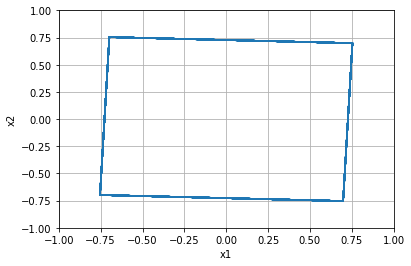


=================== Rollout 1212 =====================
x_init [[-0.08]
 [ 0.56]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.08  0.56]
xx [-0.08  0.56]
xxx [-0.08  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.56]


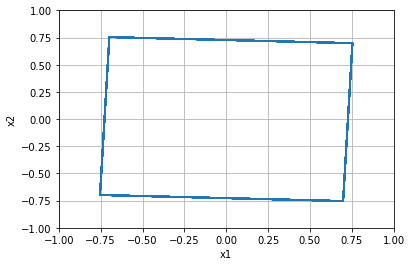


=================== Rollout 1213 =====================
x_init [[-0.08]
 [ 0.6 ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.08  0.6 ]
xx [-0.08  0.6 ]
xxx [-0.08  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.6000000000000001]


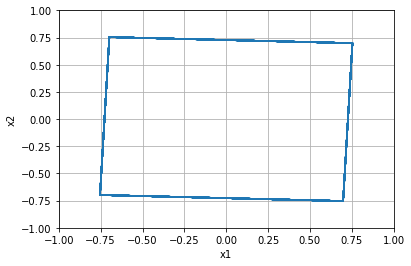


=================== Rollout 1214 =====================
x_init [[-0.08]
 [ 0.64]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.08  0.64]
xx [-0.08  0.64]
xxx [-0.08  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.6400000000000001]


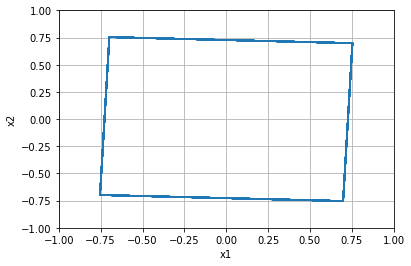


=================== Rollout 1215 =====================
x_init [[-0.08]
 [ 0.68]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.08  0.68]
xx [-0.08  0.68]
xxx [-0.08  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.6799999999999999]


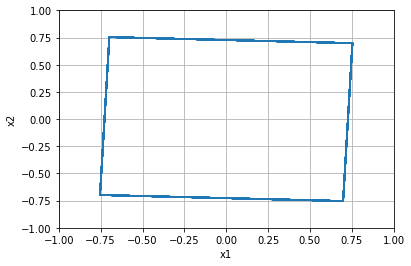


=================== Rollout 1216 =====================
x_init [[-0.08]
 [ 0.72]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.08  0.72]
xx [-0.08  0.72]
xxx [-0.08  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.72]


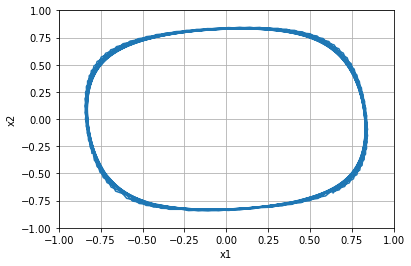


=================== Rollout 1217 =====================
x_init [[-0.08]
 [ 0.76]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.08  0.76]
xx [-0.08  0.76]
xxx [-0.08  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.76]


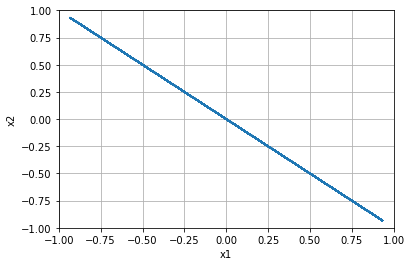


=================== Rollout 1218 =====================
x_init [[-0.08]
 [ 0.8 ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.08  0.8 ]
xx [-0.08  0.8 ]
xxx [-0.08  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.8]


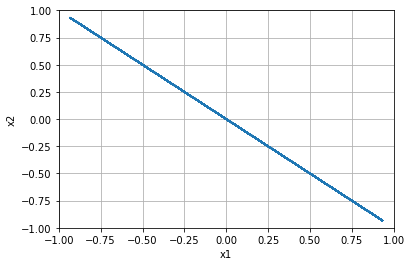


=================== Rollout 1219 =====================
x_init [[-0.08]
 [ 0.84]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.08  0.84]
xx [-0.08  0.84]
xxx [-0.08  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.8400000000000001]


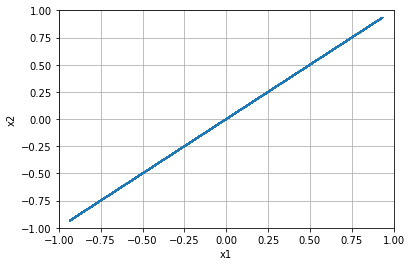


=================== Rollout 1220 =====================
x_init [[-0.08]
 [ 0.88]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.08  0.88]
xx [-0.08  0.88]
xxx [-0.08  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.8800000000000001]


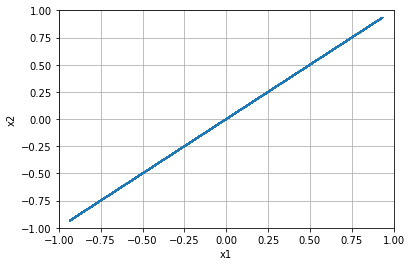


=================== Rollout 1221 =====================
x_init [[-0.08]
 [ 0.92]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.08  0.92]
xx [-0.08  0.92]
xxx [-0.08  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.9199999999999999]


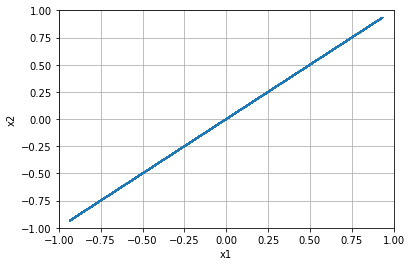


=================== Rollout 1222 =====================
x_init [[-0.08]
 [ 0.96]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.08  0.96]
xx [-0.08  0.96]
xxx [-0.08  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 0.96]


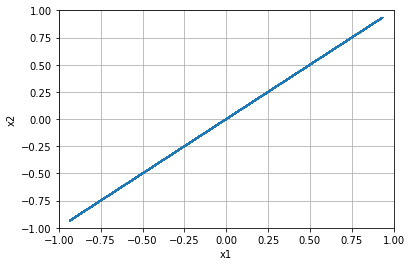


=================== Rollout 1223 =====================
x_init [[-0.08]
 [ 1.  ]]
x_buffer [[-0.08 -0.08 -0.08 -0.08 -0.08]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.08  1.  ]
xx [-0.08  1.  ]
xxx [-0.08  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.07999999999999996, 1.0]


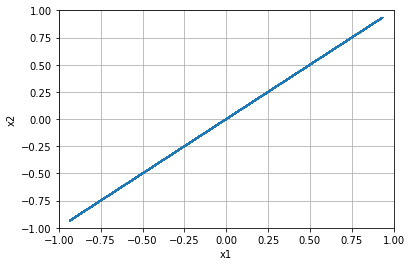


=================== Rollout 1224 =====================
x_init [[-0.04]
 [-1.  ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [-0.04 -1.  ]
xx [-0.04 -1.  ]
xxx [-0.04 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -1.0]


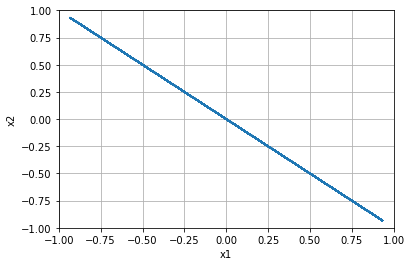


=================== Rollout 1225 =====================
x_init [[-0.04]
 [-0.96]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [-0.04 -0.96]
xx [-0.04 -0.96]
xxx [-0.04 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.96]


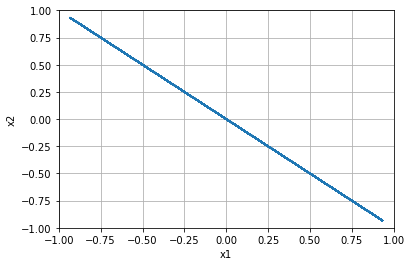


=================== Rollout 1226 =====================
x_init [[-0.04]
 [-0.92]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [-0.04 -0.92]
xx [-0.04 -0.92]
xxx [-0.04 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.92]


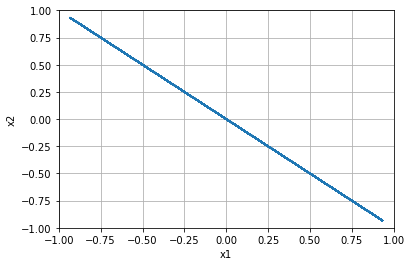


=================== Rollout 1227 =====================
x_init [[-0.04]
 [-0.88]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [-0.04 -0.88]
xx [-0.04 -0.88]
xxx [-0.04 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.88]


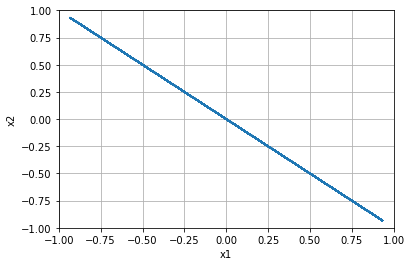


=================== Rollout 1228 =====================
x_init [[-0.04]
 [-0.84]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [-0.04 -0.84]
xx [-0.04 -0.84]
xxx [-0.04 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.84]


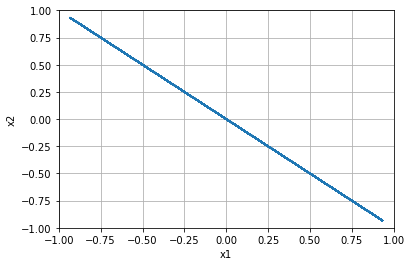


=================== Rollout 1229 =====================
x_init [[-0.04]
 [-0.8 ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [-0.04 -0.8 ]
xx [-0.04 -0.8 ]
xxx [-0.04 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.8]


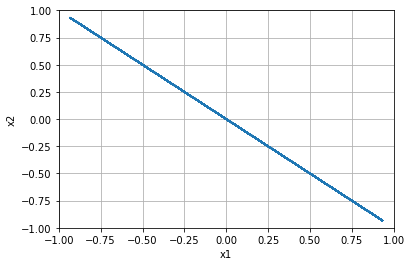


=================== Rollout 1230 =====================
x_init [[-0.04]
 [-0.76]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [-0.04 -0.76]
xx [-0.04 -0.76]
xxx [-0.04 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.76]


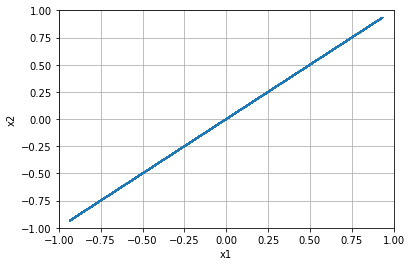


=================== Rollout 1231 =====================
x_init [[-0.04]
 [-0.72]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [-0.04 -0.72]
xx [-0.04 -0.72]
xxx [-0.04 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.72]


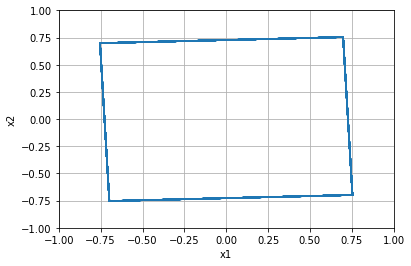


=================== Rollout 1232 =====================
x_init [[-0.04]
 [-0.68]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [-0.04 -0.68]
xx [-0.04 -0.68]
xxx [-0.04 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.6799999999999999]


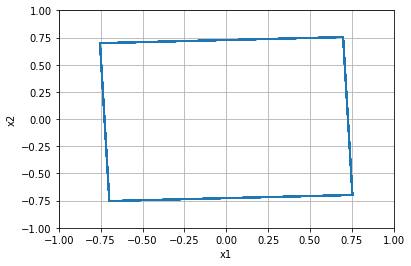


=================== Rollout 1233 =====================
x_init [[-0.04]
 [-0.64]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [-0.04 -0.64]
xx [-0.04 -0.64]
xxx [-0.04 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.64]


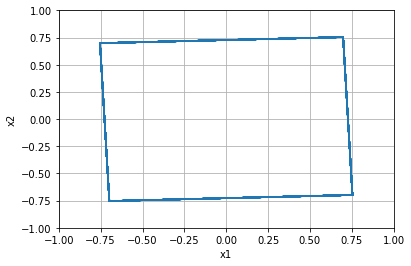


=================== Rollout 1234 =====================
x_init [[-0.04]
 [-0.6 ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [-0.04 -0.6 ]
xx [-0.04 -0.6 ]
xxx [-0.04 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.6]


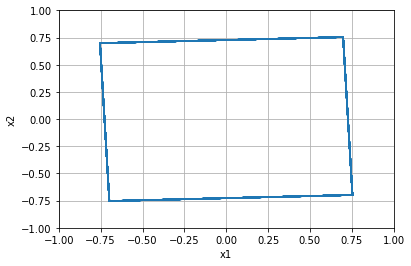


=================== Rollout 1235 =====================
x_init [[-0.04]
 [-0.56]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [-0.04 -0.56]
xx [-0.04 -0.56]
xxx [-0.04 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.56]


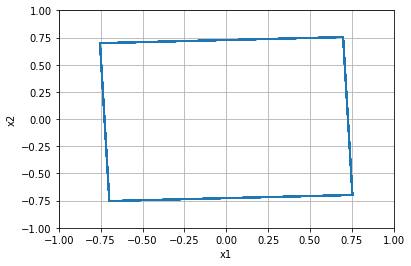


=================== Rollout 1236 =====================
x_init [[-0.04]
 [-0.52]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [-0.04 -0.52]
xx [-0.04 -0.52]
xxx [-0.04 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.52]


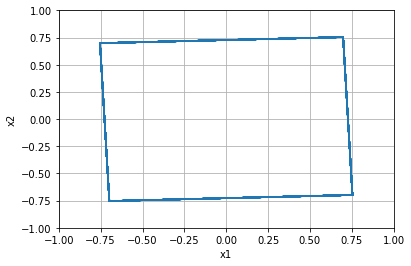


=================== Rollout 1237 =====================
x_init [[-0.04]
 [-0.48]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [-0.04 -0.48]
xx [-0.04 -0.48]
xxx [-0.04 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.48]


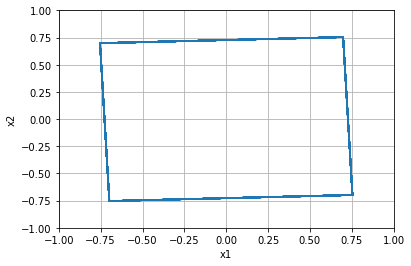


=================== Rollout 1238 =====================
x_init [[-0.04]
 [-0.44]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [-0.04 -0.44]
xx [-0.04 -0.44]
xxx [-0.04 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.43999999999999995]


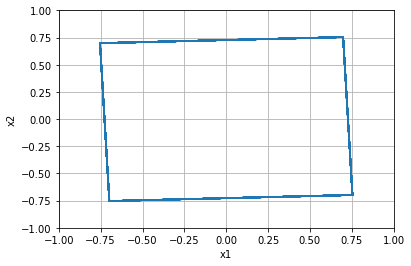


=================== Rollout 1239 =====================
x_init [[-0.04]
 [-0.4 ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [-0.04 -0.4 ]
xx [-0.04 -0.4 ]
xxx [-0.04 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.4]


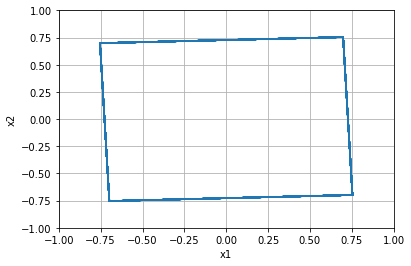


=================== Rollout 1240 =====================
x_init [[-0.04]
 [-0.36]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [-0.04 -0.36]
xx [-0.04 -0.36]
xxx [-0.04 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.36]


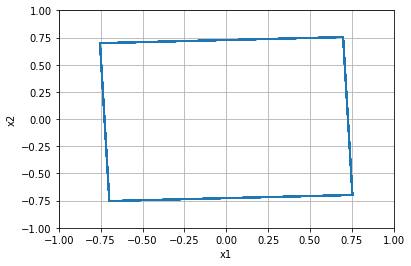


=================== Rollout 1241 =====================
x_init [[-0.04]
 [-0.32]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [-0.04 -0.32]
xx [-0.04 -0.32]
xxx [-0.04 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.31999999999999995]


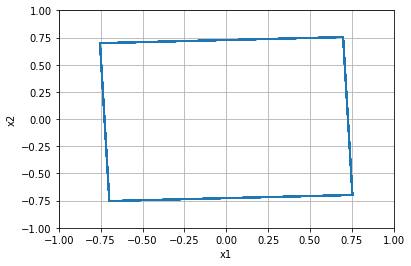


=================== Rollout 1242 =====================
x_init [[-0.04]
 [-0.28]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [-0.04 -0.28]
xx [-0.04 -0.28]
xxx [-0.04 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.28]


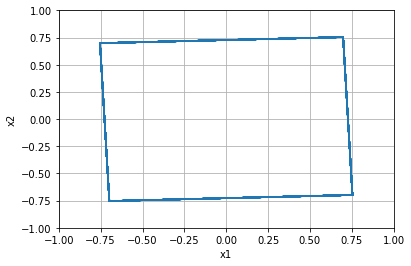


=================== Rollout 1243 =====================
x_init [[-0.04]
 [-0.24]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [-0.04 -0.24]
xx [-0.04 -0.24]
xxx [-0.04 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.24]


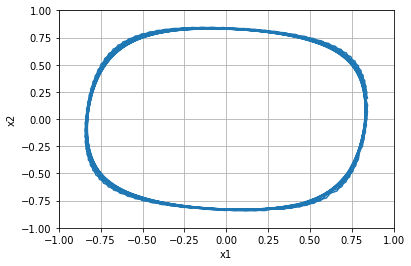


=================== Rollout 1244 =====================
x_init [[-0.04]
 [-0.2 ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [-0.04 -0.2 ]
xx [-0.04 -0.2 ]
xxx [-0.04 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.19999999999999996]


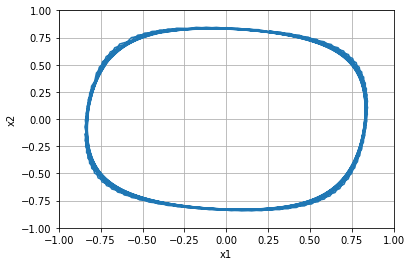


=================== Rollout 1245 =====================
x_init [[-0.04]
 [-0.16]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [-0.04 -0.16]
xx [-0.04 -0.16]
xxx [-0.04 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.16000000000000003]


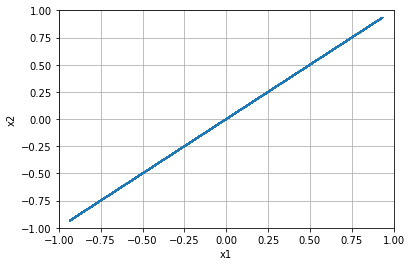


=================== Rollout 1246 =====================
x_init [[-0.04]
 [-0.12]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [-0.04 -0.12]
xx [-0.04 -0.12]
xxx [-0.04 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.12]


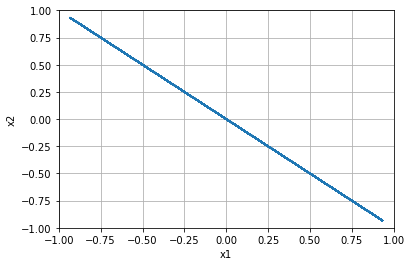


=================== Rollout 1247 =====================
x_init [[-0.04]
 [-0.08]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [-0.04 -0.08]
xx [-0.04 -0.08]
xxx [-0.04 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.07999999999999996]


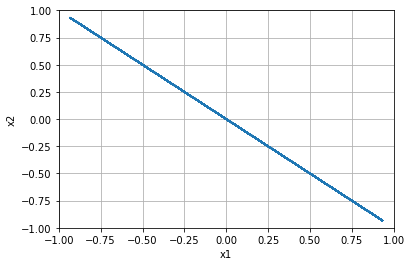


=================== Rollout 1248 =====================
x_init [[-0.04]
 [-0.04]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [-0.04 -0.04]
xx [-0.04 -0.04]
xxx [-0.04 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, -0.040000000000000036]


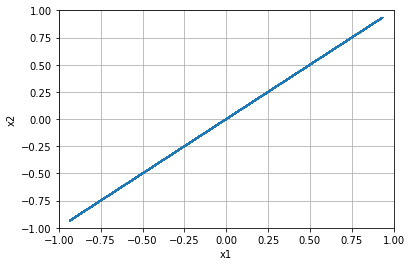


=================== Rollout 1249 =====================
x_init [[-0.04]
 [ 0.  ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.    0.    0.    0.    0.  ]]
x [-0.04  0.  ]
xx [-0.04  0.  ]
xxx [-0.04  0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.0]


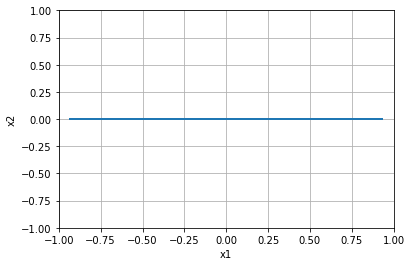


=================== Rollout 1250 =====================
x_init [[-0.04]
 [ 0.04]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.04  0.04  0.04  0.04  0.04]]
x [-0.04  0.04]
xx [-0.04  0.04]
xxx [-0.04  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.040000000000000036]


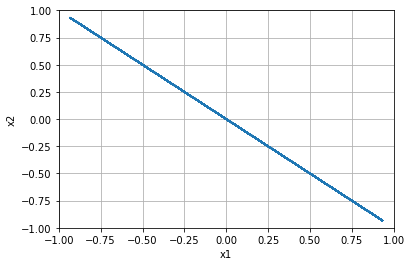


=================== Rollout 1251 =====================
x_init [[-0.04]
 [ 0.08]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.08  0.08  0.08  0.08  0.08]]
x [-0.04  0.08]
xx [-0.04  0.08]
xxx [-0.04  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.08000000000000007]


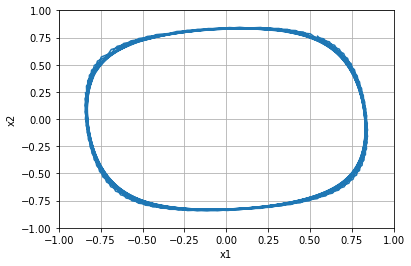


=================== Rollout 1252 =====================
x_init [[-0.04]
 [ 0.12]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.12  0.12  0.12  0.12  0.12]]
x [-0.04  0.12]
xx [-0.04  0.12]
xxx [-0.04  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.1200000000000001]


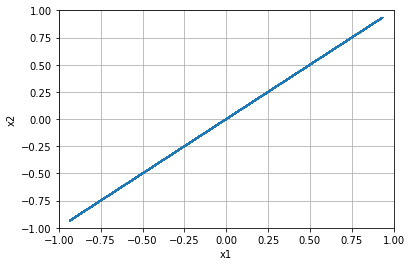


=================== Rollout 1253 =====================
x_init [[-0.04]
 [ 0.16]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.16  0.16  0.16  0.16  0.16]]
x [-0.04  0.16]
xx [-0.04  0.16]
xxx [-0.04  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.15999999999999992]


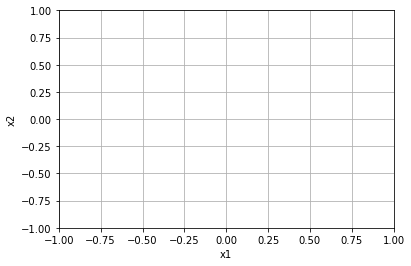


=================== Rollout 1254 =====================
x_init [[-0.04]
 [ 0.2 ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.2   0.2   0.2   0.2   0.2 ]]
x [-0.04  0.2 ]
xx [-0.04  0.2 ]
xxx [-0.04  0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.19999999999999996]


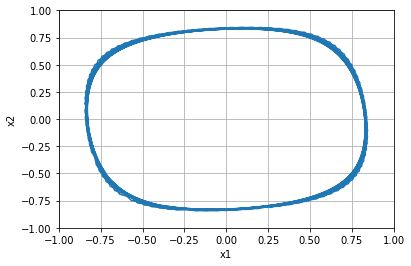


=================== Rollout 1255 =====================
x_init [[-0.04]
 [ 0.24]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.24  0.24  0.24  0.24  0.24]]
x [-0.04  0.24]
xx [-0.04  0.24]
xxx [-0.04  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.24]


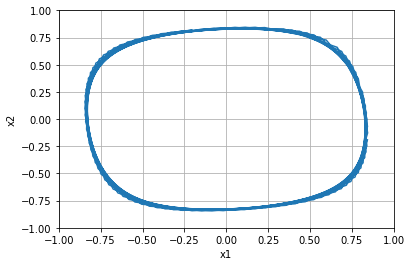


=================== Rollout 1256 =====================
x_init [[-0.04]
 [ 0.28]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.28  0.28  0.28  0.28  0.28]]
x [-0.04  0.28]
xx [-0.04  0.28]
xxx [-0.04  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.28]


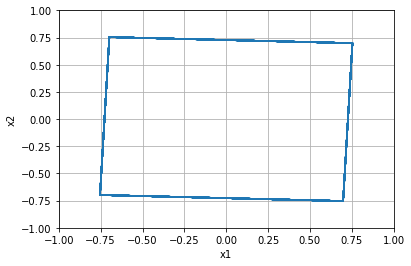


=================== Rollout 1257 =====================
x_init [[-0.04]
 [ 0.32]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.32  0.32  0.32  0.32  0.32]]
x [-0.04  0.32]
xx [-0.04  0.32]
xxx [-0.04  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.32000000000000006]


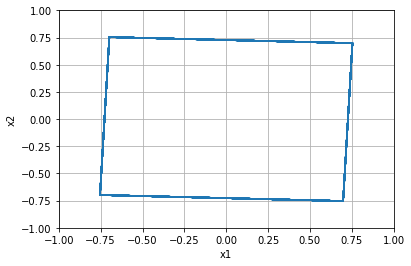


=================== Rollout 1258 =====================
x_init [[-0.04]
 [ 0.36]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.36  0.36  0.36  0.36  0.36]]
x [-0.04  0.36]
xx [-0.04  0.36]
xxx [-0.04  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.3600000000000001]


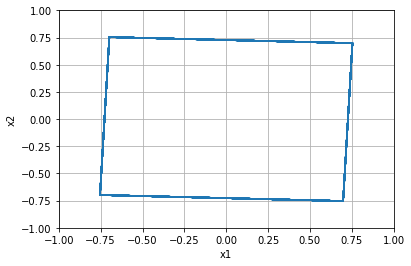


=================== Rollout 1259 =====================
x_init [[-0.04]
 [ 0.4 ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.4   0.4   0.4   0.4   0.4 ]]
x [-0.04  0.4 ]
xx [-0.04  0.4 ]
xxx [-0.04  0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.40000000000000013]


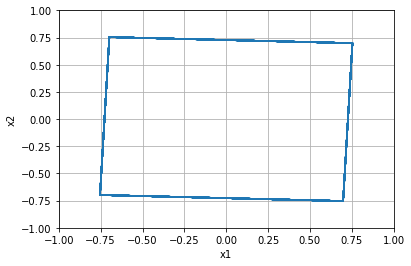


=================== Rollout 1260 =====================
x_init [[-0.04]
 [ 0.44]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.44  0.44  0.44  0.44  0.44]]
x [-0.04  0.44]
xx [-0.04  0.44]
xxx [-0.04  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.43999999999999995]


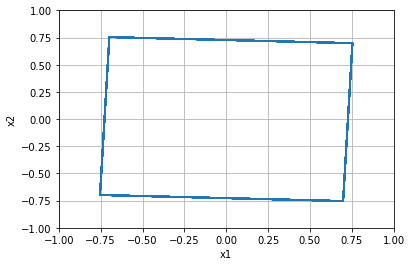


=================== Rollout 1261 =====================
x_init [[-0.04]
 [ 0.48]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.48  0.48  0.48  0.48  0.48]]
x [-0.04  0.48]
xx [-0.04  0.48]
xxx [-0.04  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.48]


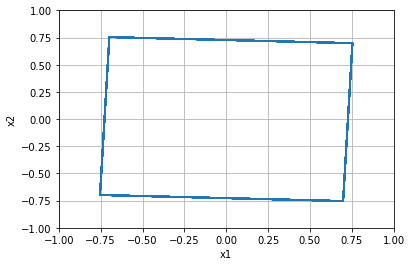


=================== Rollout 1262 =====================
x_init [[-0.04]
 [ 0.52]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.52  0.52  0.52  0.52  0.52]]
x [-0.04  0.52]
xx [-0.04  0.52]
xxx [-0.04  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.52]


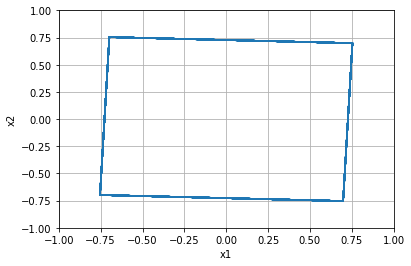


=================== Rollout 1263 =====================
x_init [[-0.04]
 [ 0.56]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.56  0.56  0.56  0.56  0.56]]
x [-0.04  0.56]
xx [-0.04  0.56]
xxx [-0.04  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.56]


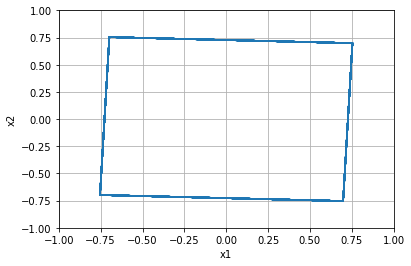


=================== Rollout 1264 =====================
x_init [[-0.04]
 [ 0.6 ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.6   0.6   0.6   0.6   0.6 ]]
x [-0.04  0.6 ]
xx [-0.04  0.6 ]
xxx [-0.04  0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.6000000000000001]


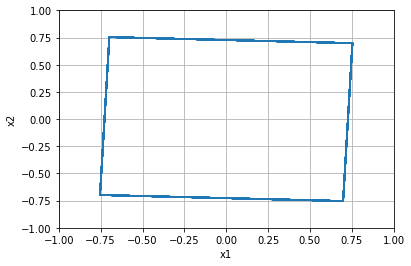


=================== Rollout 1265 =====================
x_init [[-0.04]
 [ 0.64]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.64  0.64  0.64  0.64  0.64]]
x [-0.04  0.64]
xx [-0.04  0.64]
xxx [-0.04  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.6400000000000001]


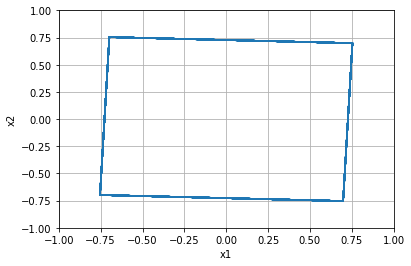


=================== Rollout 1266 =====================
x_init [[-0.04]
 [ 0.68]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.68  0.68  0.68  0.68  0.68]]
x [-0.04  0.68]
xx [-0.04  0.68]
xxx [-0.04  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.6799999999999999]


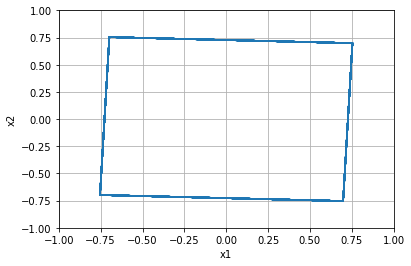


=================== Rollout 1267 =====================
x_init [[-0.04]
 [ 0.72]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.72  0.72  0.72  0.72  0.72]]
x [-0.04  0.72]
xx [-0.04  0.72]
xxx [-0.04  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.72]


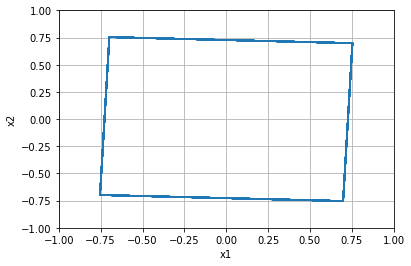


=================== Rollout 1268 =====================
x_init [[-0.04]
 [ 0.76]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.76  0.76  0.76  0.76  0.76]]
x [-0.04  0.76]
xx [-0.04  0.76]
xxx [-0.04  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.76]


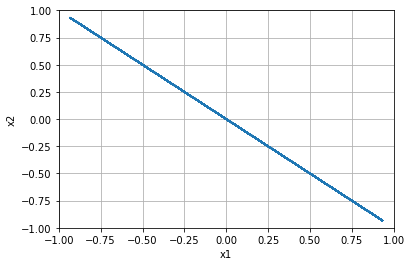


=================== Rollout 1269 =====================
x_init [[-0.04]
 [ 0.8 ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.8   0.8   0.8   0.8   0.8 ]]
x [-0.04  0.8 ]
xx [-0.04  0.8 ]
xxx [-0.04  0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.8]


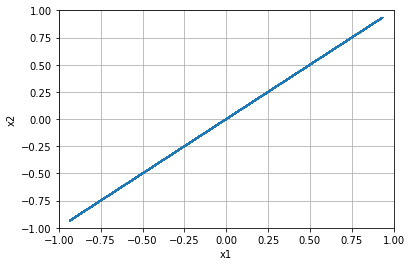


=================== Rollout 1270 =====================
x_init [[-0.04]
 [ 0.84]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.84  0.84  0.84  0.84  0.84]]
x [-0.04  0.84]
xx [-0.04  0.84]
xxx [-0.04  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.8400000000000001]


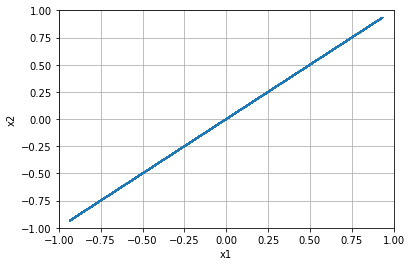


=================== Rollout 1271 =====================
x_init [[-0.04]
 [ 0.88]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.88  0.88  0.88  0.88  0.88]]
x [-0.04  0.88]
xx [-0.04  0.88]
xxx [-0.04  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.8800000000000001]


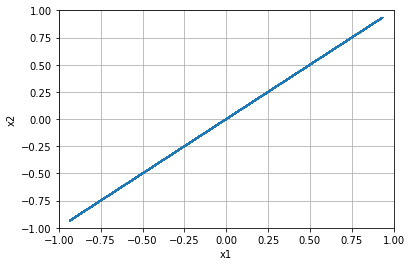


=================== Rollout 1272 =====================
x_init [[-0.04]
 [ 0.92]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.92  0.92  0.92  0.92  0.92]]
x [-0.04  0.92]
xx [-0.04  0.92]
xxx [-0.04  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.9199999999999999]


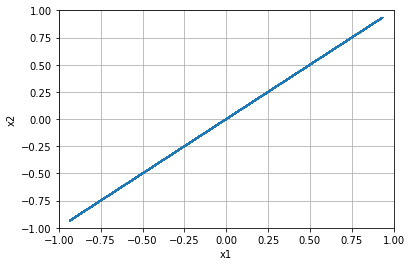


=================== Rollout 1273 =====================
x_init [[-0.04]
 [ 0.96]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 0.96  0.96  0.96  0.96  0.96]]
x [-0.04  0.96]
xx [-0.04  0.96]
xxx [-0.04  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 0.96]


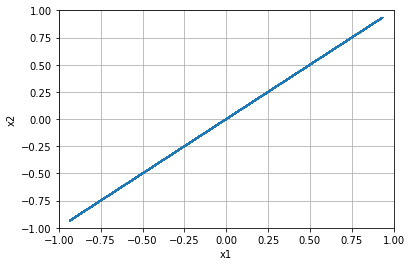


=================== Rollout 1274 =====================
x_init [[-0.04]
 [ 1.  ]]
x_buffer [[-0.04 -0.04 -0.04 -0.04 -0.04]
 [ 1.    1.    1.    1.    1.  ]]
x [-0.04  1.  ]
xx [-0.04  1.  ]
xxx [-0.04  1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [-0.040000000000000036, 1.0]


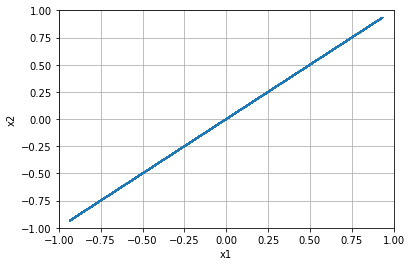


=================== Rollout 1275 =====================
x_init [[ 0.]
 [-1.]]
x_buffer [[ 0.  0.  0.  0.  0.]
 [-1. -1. -1. -1. -1.]]
x [ 0. -1.]
xx [ 0. -1.]
xxx [ 0. -1.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -1.0]


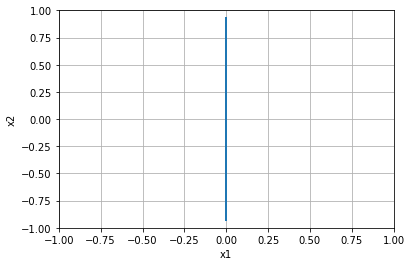


=================== Rollout 1276 =====================
x_init [[ 0.  ]
 [-0.96]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.   -0.96]
xx [ 0.   -0.96]
xxx [ 0.   -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.96]


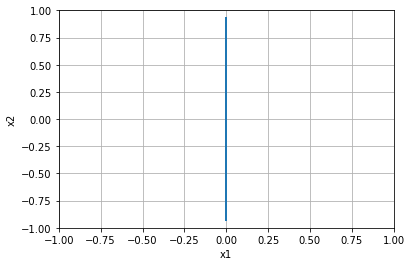


=================== Rollout 1277 =====================
x_init [[ 0.  ]
 [-0.92]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.   -0.92]
xx [ 0.   -0.92]
xxx [ 0.   -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.92]


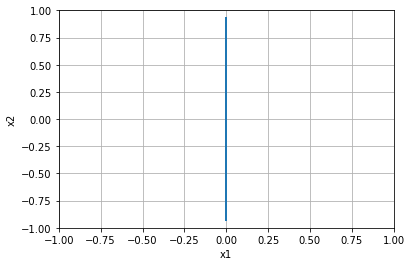


=================== Rollout 1278 =====================
x_init [[ 0.  ]
 [-0.88]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.   -0.88]
xx [ 0.   -0.88]
xxx [ 0.   -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.88]


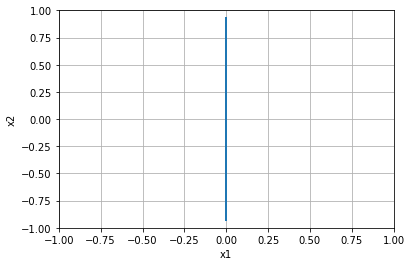


=================== Rollout 1279 =====================
x_init [[ 0.  ]
 [-0.84]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.   -0.84]
xx [ 0.   -0.84]
xxx [ 0.   -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.84]


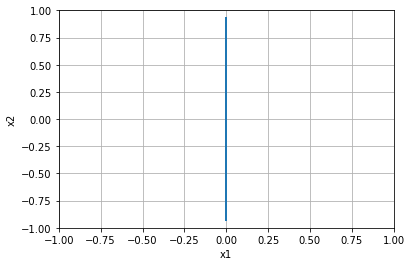


=================== Rollout 1280 =====================
x_init [[ 0. ]
 [-0.8]]
x_buffer [[ 0.   0.   0.   0.   0. ]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [ 0.  -0.8]
xx [ 0.  -0.8]
xxx [ 0.  -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.8]


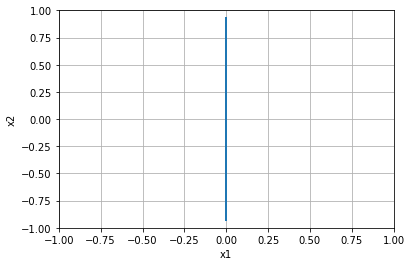


=================== Rollout 1281 =====================
x_init [[ 0.  ]
 [-0.76]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.   -0.76]
xx [ 0.   -0.76]
xxx [ 0.   -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.76]


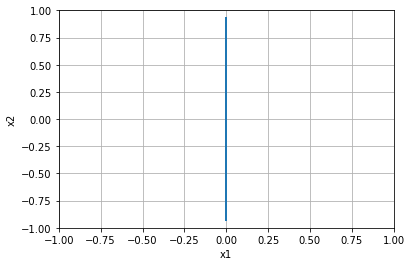


=================== Rollout 1282 =====================
x_init [[ 0.  ]
 [-0.72]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.   -0.72]
xx [ 0.   -0.72]
xxx [ 0.   -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.72]


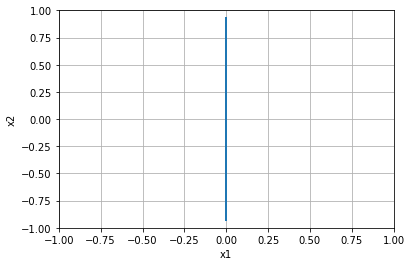


=================== Rollout 1283 =====================
x_init [[ 0.  ]
 [-0.68]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.   -0.68]
xx [ 0.   -0.68]
xxx [ 0.   -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.6799999999999999]


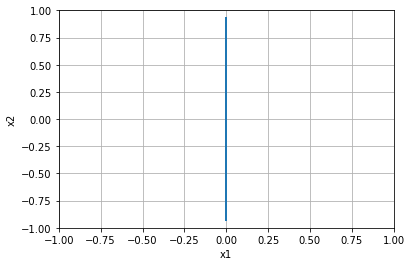


=================== Rollout 1284 =====================
x_init [[ 0.  ]
 [-0.64]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.   -0.64]
xx [ 0.   -0.64]
xxx [ 0.   -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.64]


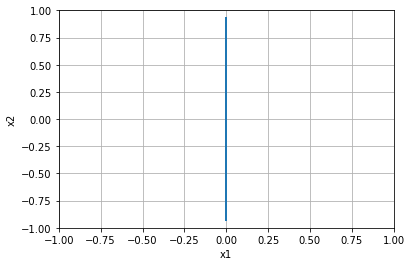


=================== Rollout 1285 =====================
x_init [[ 0. ]
 [-0.6]]
x_buffer [[ 0.   0.   0.   0.   0. ]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [ 0.  -0.6]
xx [ 0.  -0.6]
xxx [ 0.  -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.6]


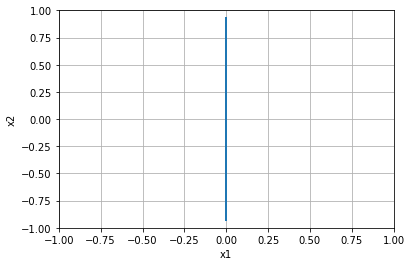


=================== Rollout 1286 =====================
x_init [[ 0.  ]
 [-0.56]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.   -0.56]
xx [ 0.   -0.56]
xxx [ 0.   -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.56]


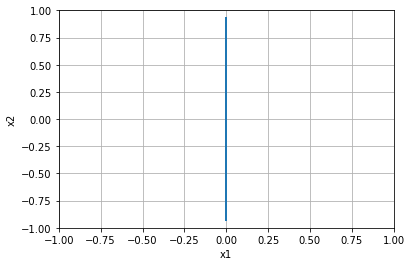


=================== Rollout 1287 =====================
x_init [[ 0.  ]
 [-0.52]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.   -0.52]
xx [ 0.   -0.52]
xxx [ 0.   -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.52]


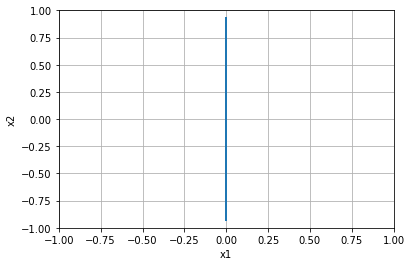


=================== Rollout 1288 =====================
x_init [[ 0.  ]
 [-0.48]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.   -0.48]
xx [ 0.   -0.48]
xxx [ 0.   -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.48]


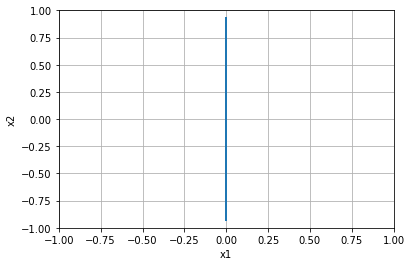


=================== Rollout 1289 =====================
x_init [[ 0.  ]
 [-0.44]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.   -0.44]
xx [ 0.   -0.44]
xxx [ 0.   -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.43999999999999995]


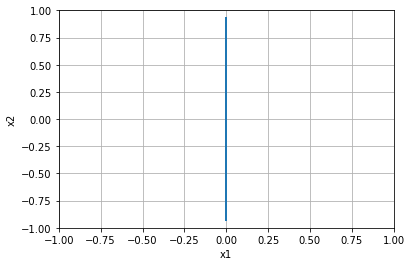


=================== Rollout 1290 =====================
x_init [[ 0. ]
 [-0.4]]
x_buffer [[ 0.   0.   0.   0.   0. ]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [ 0.  -0.4]
xx [ 0.  -0.4]
xxx [ 0.  -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.4]


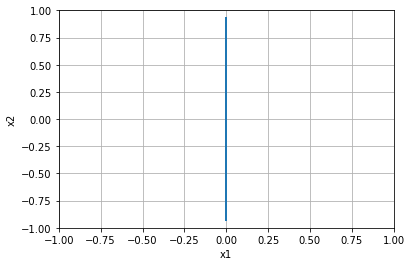


=================== Rollout 1291 =====================
x_init [[ 0.  ]
 [-0.36]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.   -0.36]
xx [ 0.   -0.36]
xxx [ 0.   -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.36]


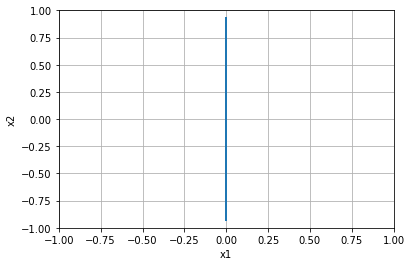


=================== Rollout 1292 =====================
x_init [[ 0.  ]
 [-0.32]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.   -0.32]
xx [ 0.   -0.32]
xxx [ 0.   -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.31999999999999995]


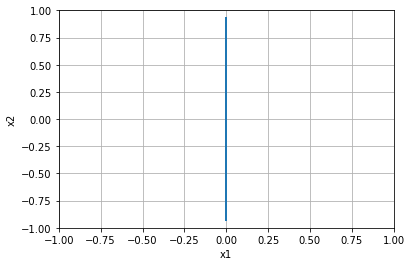


=================== Rollout 1293 =====================
x_init [[ 0.  ]
 [-0.28]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.   -0.28]
xx [ 0.   -0.28]
xxx [ 0.   -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.28]


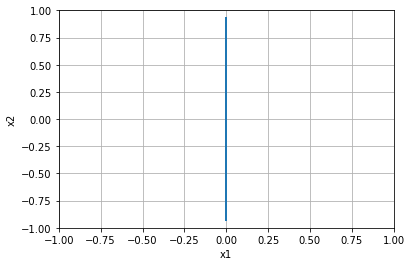


=================== Rollout 1294 =====================
x_init [[ 0.  ]
 [-0.24]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.   -0.24]
xx [ 0.   -0.24]
xxx [ 0.   -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.24]


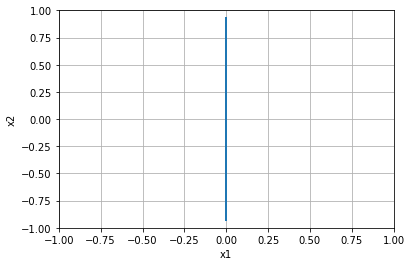


=================== Rollout 1295 =====================
x_init [[ 0. ]
 [-0.2]]
x_buffer [[ 0.   0.   0.   0.   0. ]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [ 0.  -0.2]
xx [ 0.  -0.2]
xxx [ 0.  -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.19999999999999996]


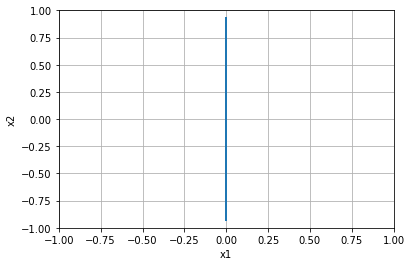


=================== Rollout 1296 =====================
x_init [[ 0.  ]
 [-0.16]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.   -0.16]
xx [ 0.   -0.16]
xxx [ 0.   -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.16000000000000003]


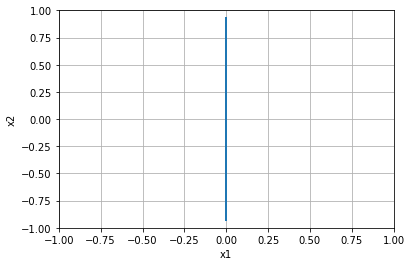


=================== Rollout 1297 =====================
x_init [[ 0.  ]
 [-0.12]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.   -0.12]
xx [ 0.   -0.12]
xxx [ 0.   -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.12]


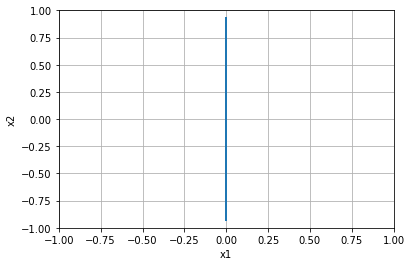


=================== Rollout 1298 =====================
x_init [[ 0.  ]
 [-0.08]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.   -0.08]
xx [ 0.   -0.08]
xxx [ 0.   -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.07999999999999996]


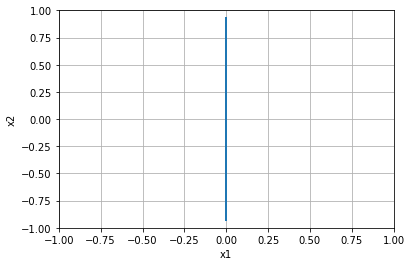


=================== Rollout 1299 =====================
x_init [[ 0.  ]
 [-0.04]]
x_buffer [[ 0.    0.    0.    0.    0.  ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.   -0.04]
xx [ 0.   -0.04]
xxx [ 0.   -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, -0.040000000000000036]


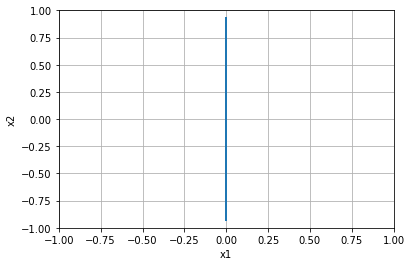


=================== Rollout 1300 =====================
x_init [[0.]
 [0.]]
x_buffer [[0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]]
x [0. 0.]
xx [0. 0.]
xxx [0. 0.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.0]


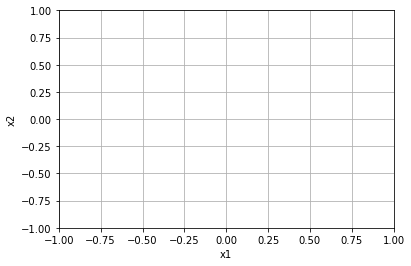


=================== Rollout 1301 =====================
x_init [[0.  ]
 [0.04]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.   0.04]
xx [0.   0.04]
xxx [0.   0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.040000000000000036]


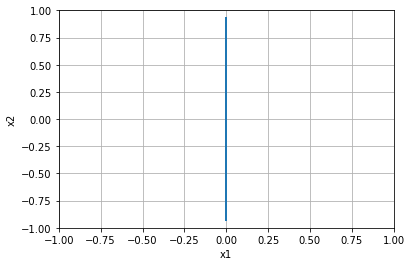


=================== Rollout 1302 =====================
x_init [[0.  ]
 [0.08]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.   0.08]
xx [0.   0.08]
xxx [0.   0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.08000000000000007]


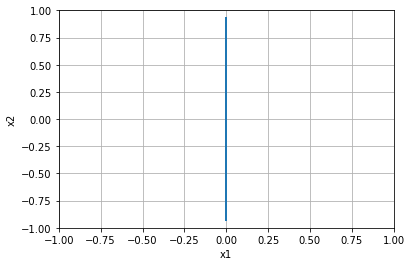


=================== Rollout 1303 =====================
x_init [[0.  ]
 [0.12]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.   0.12]
xx [0.   0.12]
xxx [0.   0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.1200000000000001]


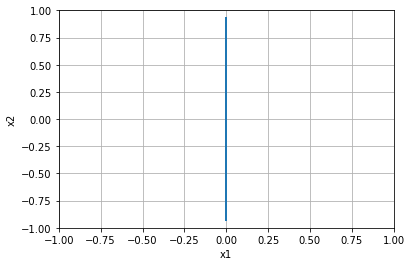


=================== Rollout 1304 =====================
x_init [[0.  ]
 [0.16]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.   0.16]
xx [0.   0.16]
xxx [0.   0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.15999999999999992]


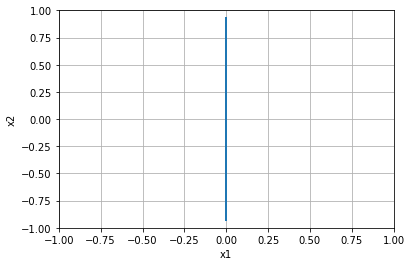


=================== Rollout 1305 =====================
x_init [[0. ]
 [0.2]]
x_buffer [[0.  0.  0.  0.  0. ]
 [0.2 0.2 0.2 0.2 0.2]]
x [0.  0.2]
xx [0.  0.2]
xxx [0.  0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.19999999999999996]


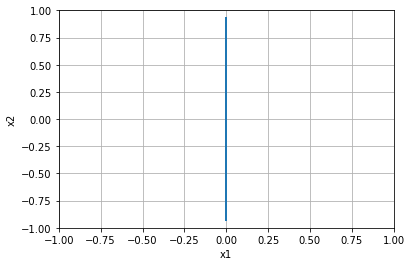


=================== Rollout 1306 =====================
x_init [[0.  ]
 [0.24]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.   0.24]
xx [0.   0.24]
xxx [0.   0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.24]


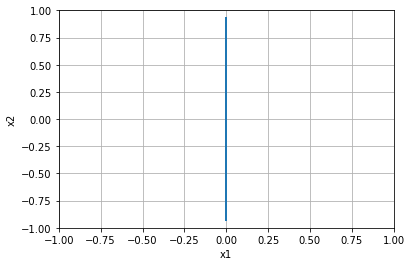


=================== Rollout 1307 =====================
x_init [[0.  ]
 [0.28]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.   0.28]
xx [0.   0.28]
xxx [0.   0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.28]


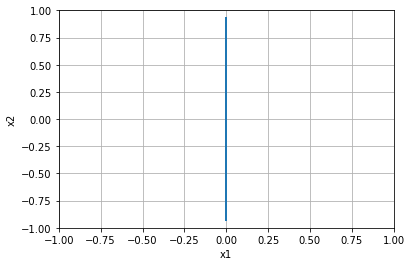


=================== Rollout 1308 =====================
x_init [[0.  ]
 [0.32]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.   0.32]
xx [0.   0.32]
xxx [0.   0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.32000000000000006]


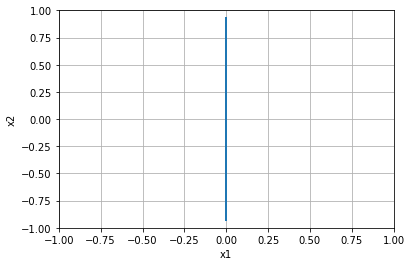


=================== Rollout 1309 =====================
x_init [[0.  ]
 [0.36]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.   0.36]
xx [0.   0.36]
xxx [0.   0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.3600000000000001]


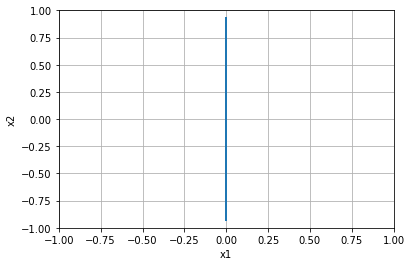


=================== Rollout 1310 =====================
x_init [[0. ]
 [0.4]]
x_buffer [[0.  0.  0.  0.  0. ]
 [0.4 0.4 0.4 0.4 0.4]]
x [0.  0.4]
xx [0.  0.4]
xxx [0.  0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.40000000000000013]


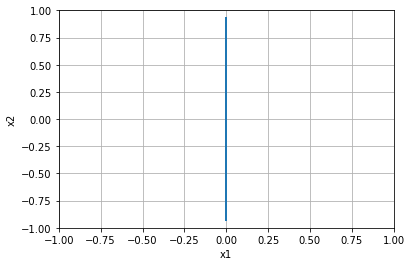


=================== Rollout 1311 =====================
x_init [[0.  ]
 [0.44]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.   0.44]
xx [0.   0.44]
xxx [0.   0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.43999999999999995]


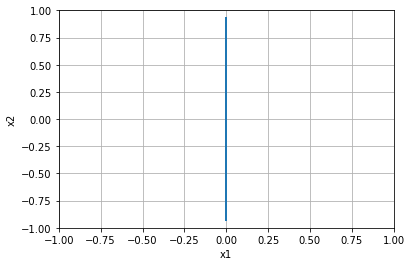


=================== Rollout 1312 =====================
x_init [[0.  ]
 [0.48]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.   0.48]
xx [0.   0.48]
xxx [0.   0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.48]


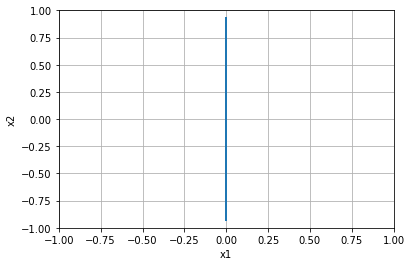


=================== Rollout 1313 =====================
x_init [[0.  ]
 [0.52]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.   0.52]
xx [0.   0.52]
xxx [0.   0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.52]


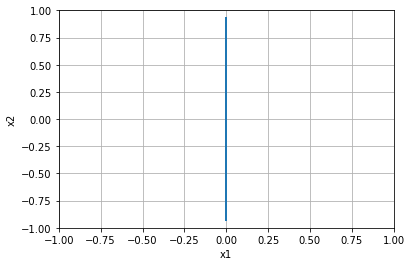


=================== Rollout 1314 =====================
x_init [[0.  ]
 [0.56]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.   0.56]
xx [0.   0.56]
xxx [0.   0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.56]


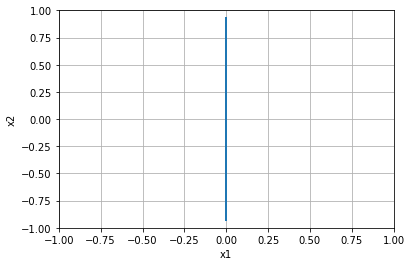


=================== Rollout 1315 =====================
x_init [[0. ]
 [0.6]]
x_buffer [[0.  0.  0.  0.  0. ]
 [0.6 0.6 0.6 0.6 0.6]]
x [0.  0.6]
xx [0.  0.6]
xxx [0.  0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.6000000000000001]


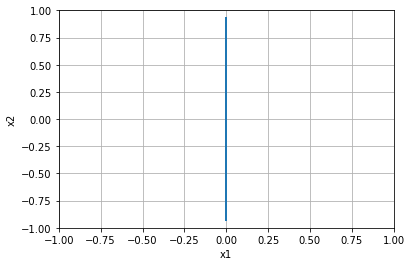


=================== Rollout 1316 =====================
x_init [[0.  ]
 [0.64]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.   0.64]
xx [0.   0.64]
xxx [0.   0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.6400000000000001]


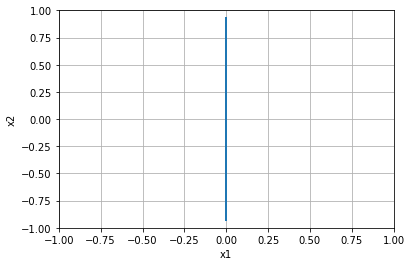


=================== Rollout 1317 =====================
x_init [[0.  ]
 [0.68]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.   0.68]
xx [0.   0.68]
xxx [0.   0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.6799999999999999]


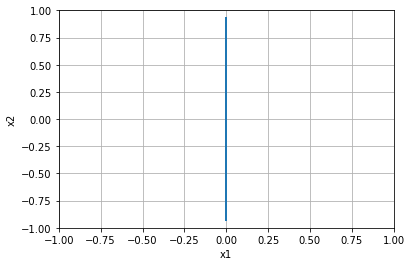


=================== Rollout 1318 =====================
x_init [[0.  ]
 [0.72]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.   0.72]
xx [0.   0.72]
xxx [0.   0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.72]


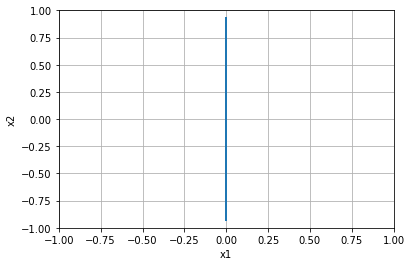


=================== Rollout 1319 =====================
x_init [[0.  ]
 [0.76]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.   0.76]
xx [0.   0.76]
xxx [0.   0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.76]


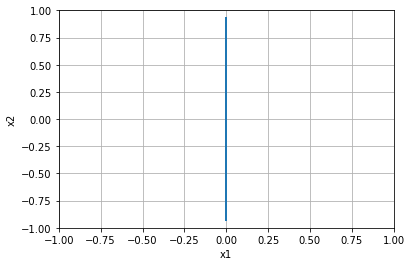


=================== Rollout 1320 =====================
x_init [[0. ]
 [0.8]]
x_buffer [[0.  0.  0.  0.  0. ]
 [0.8 0.8 0.8 0.8 0.8]]
x [0.  0.8]
xx [0.  0.8]
xxx [0.  0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.8]


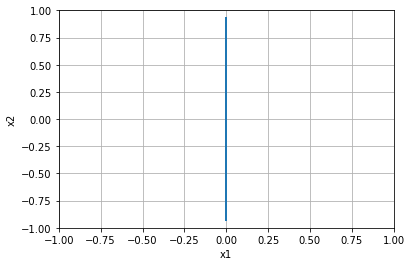


=================== Rollout 1321 =====================
x_init [[0.  ]
 [0.84]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.   0.84]
xx [0.   0.84]
xxx [0.   0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.8400000000000001]


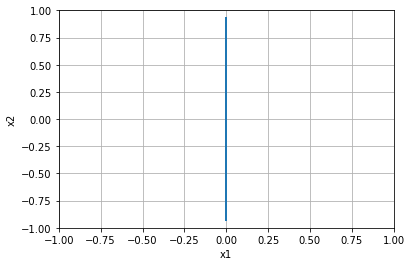


=================== Rollout 1322 =====================
x_init [[0.  ]
 [0.88]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.   0.88]
xx [0.   0.88]
xxx [0.   0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.8800000000000001]


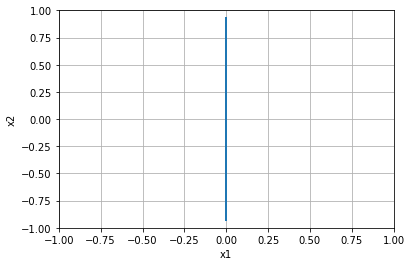


=================== Rollout 1323 =====================
x_init [[0.  ]
 [0.92]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.   0.92]
xx [0.   0.92]
xxx [0.   0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.9199999999999999]


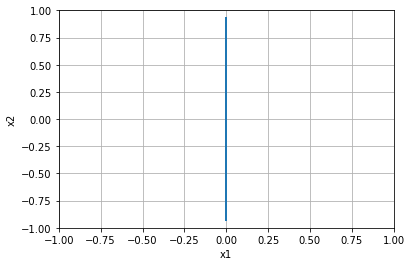


=================== Rollout 1324 =====================
x_init [[0.  ]
 [0.96]]
x_buffer [[0.   0.   0.   0.   0.  ]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.   0.96]
xx [0.   0.96]
xxx [0.   0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 0.96]


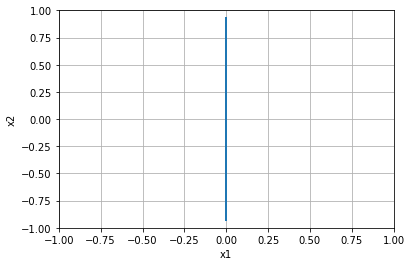


=================== Rollout 1325 =====================
x_init [[0.]
 [1.]]
x_buffer [[0. 0. 0. 0. 0.]
 [1. 1. 1. 1. 1.]]
x [0. 1.]
xx [0. 1.]
xxx [0. 1.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.0, 1.0]


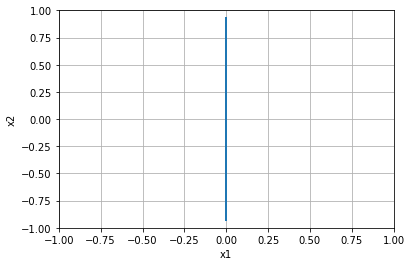


=================== Rollout 1326 =====================
x_init [[ 0.04]
 [-1.  ]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.04 -1.  ]
xx [ 0.04 -1.  ]
xxx [ 0.04 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -1.0]


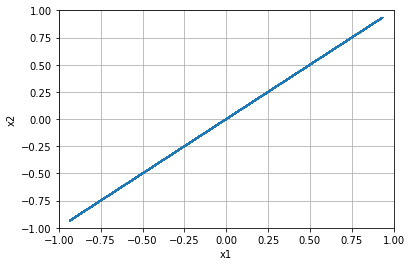


=================== Rollout 1327 =====================
x_init [[ 0.04]
 [-0.96]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.04 -0.96]
xx [ 0.04 -0.96]
xxx [ 0.04 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.96]


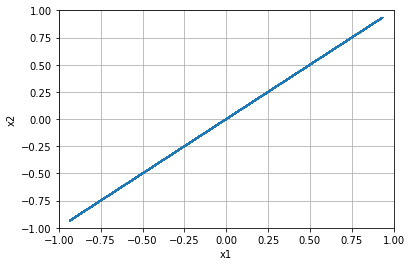


=================== Rollout 1328 =====================
x_init [[ 0.04]
 [-0.92]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.04 -0.92]
xx [ 0.04 -0.92]
xxx [ 0.04 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.92]


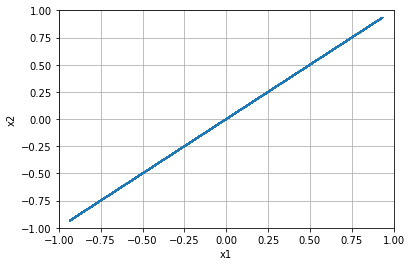


=================== Rollout 1329 =====================
x_init [[ 0.04]
 [-0.88]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.04 -0.88]
xx [ 0.04 -0.88]
xxx [ 0.04 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.88]


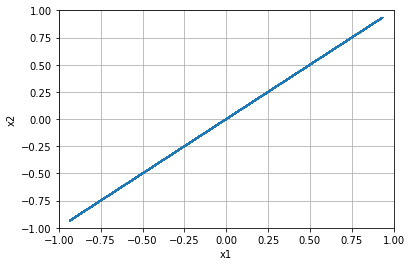


=================== Rollout 1330 =====================
x_init [[ 0.04]
 [-0.84]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.04 -0.84]
xx [ 0.04 -0.84]
xxx [ 0.04 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.84]


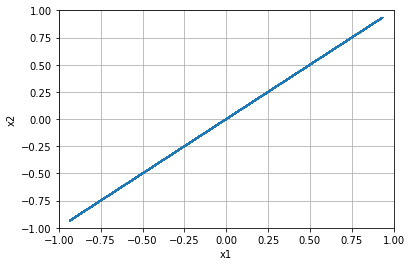


=================== Rollout 1331 =====================
x_init [[ 0.04]
 [-0.8 ]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.04 -0.8 ]
xx [ 0.04 -0.8 ]
xxx [ 0.04 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.8]


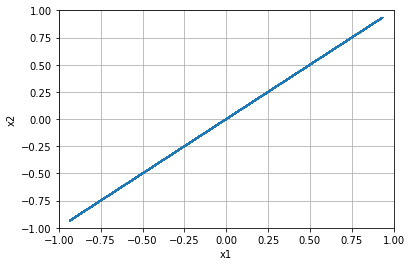


=================== Rollout 1332 =====================
x_init [[ 0.04]
 [-0.76]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.04 -0.76]
xx [ 0.04 -0.76]
xxx [ 0.04 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.76]


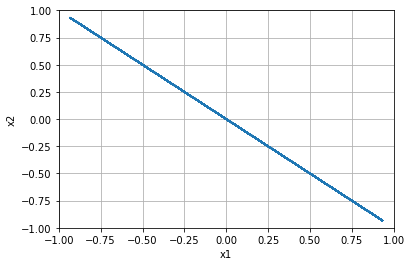


=================== Rollout 1333 =====================
x_init [[ 0.04]
 [-0.72]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.04 -0.72]
xx [ 0.04 -0.72]
xxx [ 0.04 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.72]


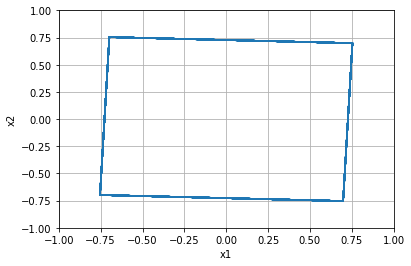


=================== Rollout 1334 =====================
x_init [[ 0.04]
 [-0.68]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.04 -0.68]
xx [ 0.04 -0.68]
xxx [ 0.04 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.6799999999999999]


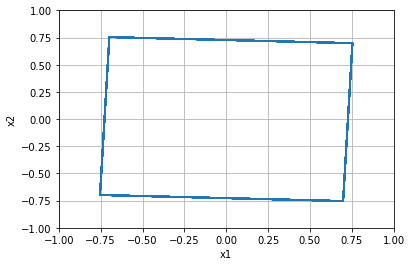


=================== Rollout 1335 =====================
x_init [[ 0.04]
 [-0.64]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.04 -0.64]
xx [ 0.04 -0.64]
xxx [ 0.04 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.64]


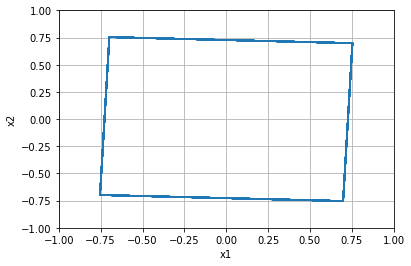


=================== Rollout 1336 =====================
x_init [[ 0.04]
 [-0.6 ]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.04 -0.6 ]
xx [ 0.04 -0.6 ]
xxx [ 0.04 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.6]


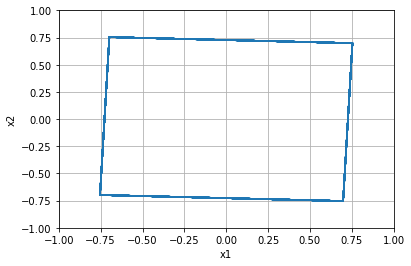


=================== Rollout 1337 =====================
x_init [[ 0.04]
 [-0.56]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.04 -0.56]
xx [ 0.04 -0.56]
xxx [ 0.04 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.56]


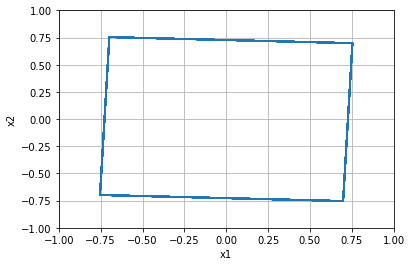


=================== Rollout 1338 =====================
x_init [[ 0.04]
 [-0.52]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.04 -0.52]
xx [ 0.04 -0.52]
xxx [ 0.04 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.52]


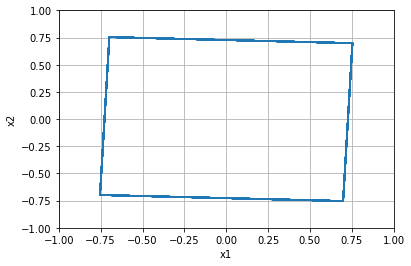


=================== Rollout 1339 =====================
x_init [[ 0.04]
 [-0.48]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.04 -0.48]
xx [ 0.04 -0.48]
xxx [ 0.04 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.48]


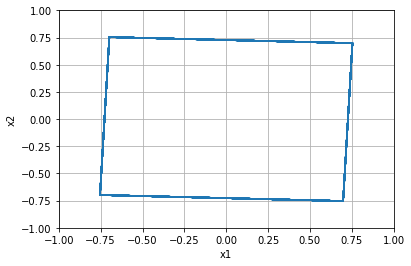


=================== Rollout 1340 =====================
x_init [[ 0.04]
 [-0.44]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.04 -0.44]
xx [ 0.04 -0.44]
xxx [ 0.04 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.43999999999999995]


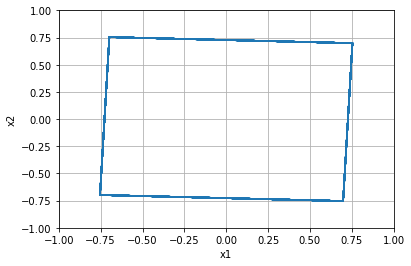


=================== Rollout 1341 =====================
x_init [[ 0.04]
 [-0.4 ]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.04 -0.4 ]
xx [ 0.04 -0.4 ]
xxx [ 0.04 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.4]


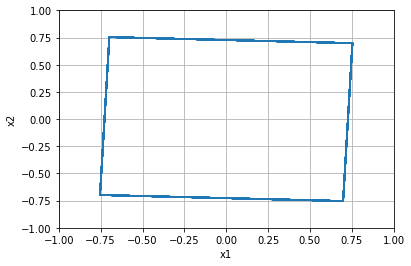


=================== Rollout 1342 =====================
x_init [[ 0.04]
 [-0.36]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.04 -0.36]
xx [ 0.04 -0.36]
xxx [ 0.04 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.36]


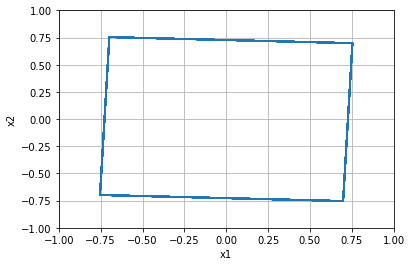


=================== Rollout 1343 =====================
x_init [[ 0.04]
 [-0.32]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.04 -0.32]
xx [ 0.04 -0.32]
xxx [ 0.04 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.31999999999999995]


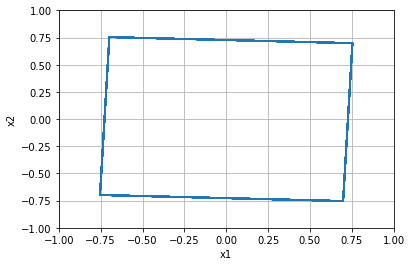


=================== Rollout 1344 =====================
x_init [[ 0.04]
 [-0.28]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.04 -0.28]
xx [ 0.04 -0.28]
xxx [ 0.04 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.28]


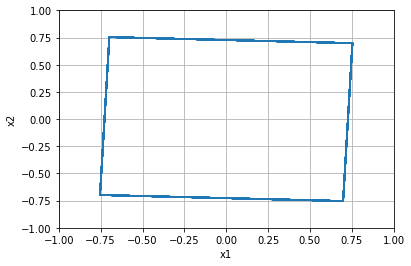


=================== Rollout 1345 =====================
x_init [[ 0.04]
 [-0.24]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.04 -0.24]
xx [ 0.04 -0.24]
xxx [ 0.04 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.24]


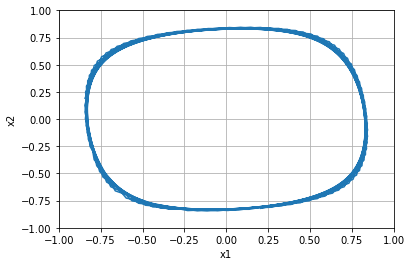


=================== Rollout 1346 =====================
x_init [[ 0.04]
 [-0.2 ]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.04 -0.2 ]
xx [ 0.04 -0.2 ]
xxx [ 0.04 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.19999999999999996]


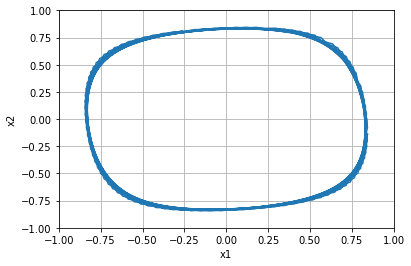


=================== Rollout 1347 =====================
x_init [[ 0.04]
 [-0.16]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.04 -0.16]
xx [ 0.04 -0.16]
xxx [ 0.04 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.16000000000000003]


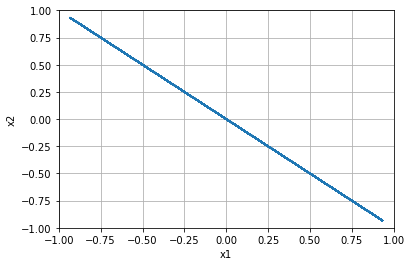


=================== Rollout 1348 =====================
x_init [[ 0.04]
 [-0.12]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.04 -0.12]
xx [ 0.04 -0.12]
xxx [ 0.04 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.12]


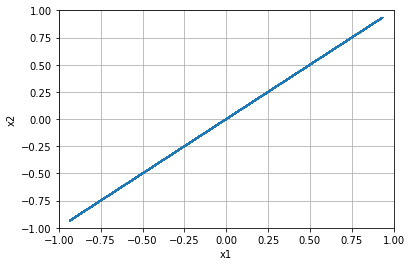


=================== Rollout 1349 =====================
x_init [[ 0.04]
 [-0.08]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.04 -0.08]
xx [ 0.04 -0.08]
xxx [ 0.04 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.07999999999999996]


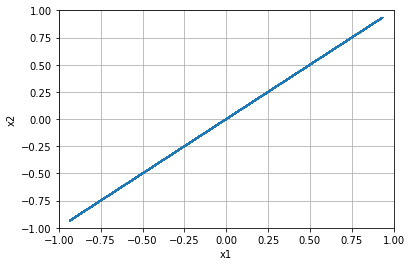


=================== Rollout 1350 =====================
x_init [[ 0.04]
 [-0.04]]
x_buffer [[ 0.04  0.04  0.04  0.04  0.04]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.04 -0.04]
xx [ 0.04 -0.04]
xxx [ 0.04 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, -0.040000000000000036]


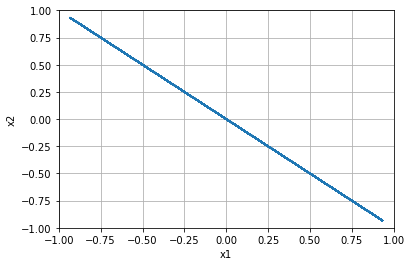


=================== Rollout 1351 =====================
x_init [[0.04]
 [0.  ]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.   0.   0.   0.   0.  ]]
x [0.04 0.  ]
xx [0.04 0.  ]
xxx [0.04 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.0]


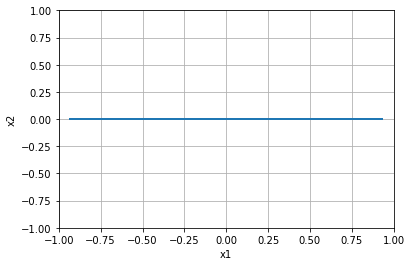


=================== Rollout 1352 =====================
x_init [[0.04]
 [0.04]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.04 0.04]
xx [0.04 0.04]
xxx [0.04 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.040000000000000036]


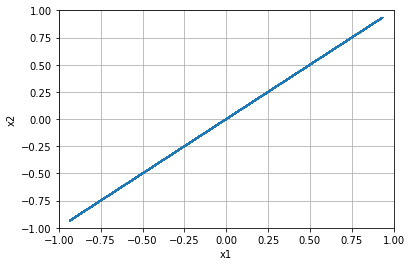


=================== Rollout 1353 =====================
x_init [[0.04]
 [0.08]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.04 0.08]
xx [0.04 0.08]
xxx [0.04 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.08000000000000007]


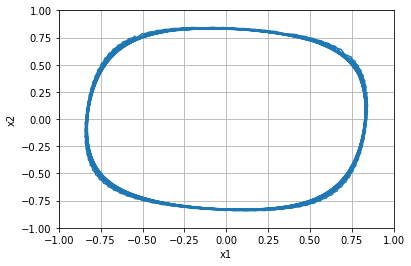


=================== Rollout 1354 =====================
x_init [[0.04]
 [0.12]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.04 0.12]
xx [0.04 0.12]
xxx [0.04 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.1200000000000001]


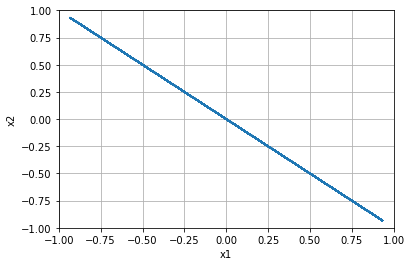


=================== Rollout 1355 =====================
x_init [[0.04]
 [0.16]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.04 0.16]
xx [0.04 0.16]
xxx [0.04 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.15999999999999992]


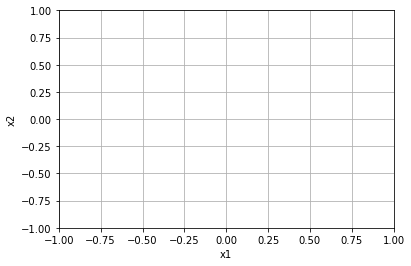


=================== Rollout 1356 =====================
x_init [[0.04]
 [0.2 ]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.04 0.2 ]
xx [0.04 0.2 ]
xxx [0.04 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.19999999999999996]


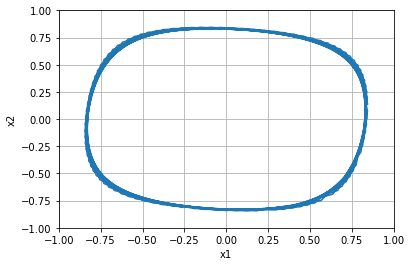


=================== Rollout 1357 =====================
x_init [[0.04]
 [0.24]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.04 0.24]
xx [0.04 0.24]
xxx [0.04 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.24]


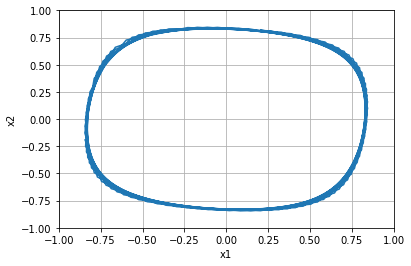


=================== Rollout 1358 =====================
x_init [[0.04]
 [0.28]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.04 0.28]
xx [0.04 0.28]
xxx [0.04 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.28]


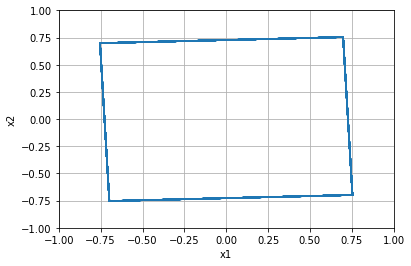


=================== Rollout 1359 =====================
x_init [[0.04]
 [0.32]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.04 0.32]
xx [0.04 0.32]
xxx [0.04 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.32000000000000006]


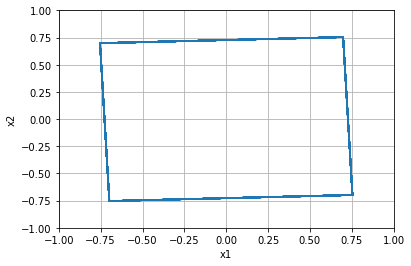


=================== Rollout 1360 =====================
x_init [[0.04]
 [0.36]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.04 0.36]
xx [0.04 0.36]
xxx [0.04 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.3600000000000001]


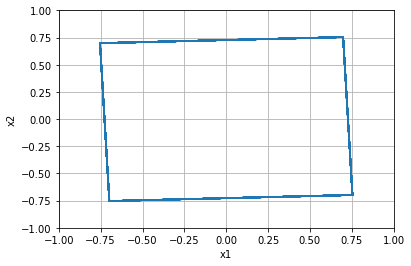


=================== Rollout 1361 =====================
x_init [[0.04]
 [0.4 ]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.04 0.4 ]
xx [0.04 0.4 ]
xxx [0.04 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.40000000000000013]


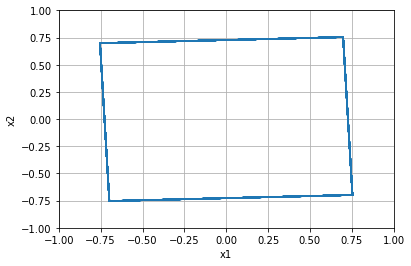


=================== Rollout 1362 =====================
x_init [[0.04]
 [0.44]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.04 0.44]
xx [0.04 0.44]
xxx [0.04 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.43999999999999995]


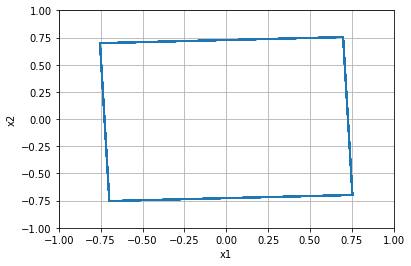


=================== Rollout 1363 =====================
x_init [[0.04]
 [0.48]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.04 0.48]
xx [0.04 0.48]
xxx [0.04 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.48]


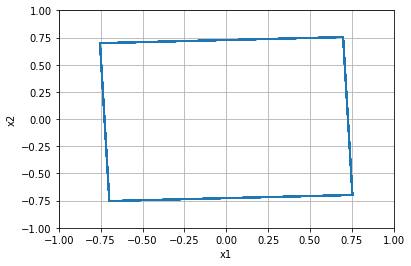


=================== Rollout 1364 =====================
x_init [[0.04]
 [0.52]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.04 0.52]
xx [0.04 0.52]
xxx [0.04 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.52]


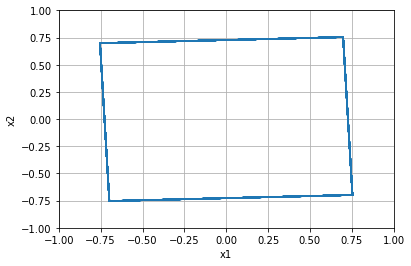


=================== Rollout 1365 =====================
x_init [[0.04]
 [0.56]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.04 0.56]
xx [0.04 0.56]
xxx [0.04 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.56]


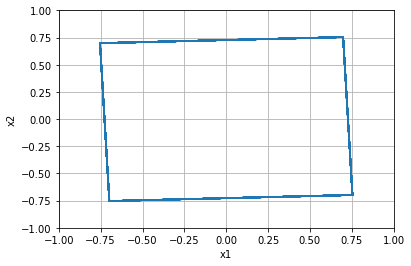


=================== Rollout 1366 =====================
x_init [[0.04]
 [0.6 ]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.04 0.6 ]
xx [0.04 0.6 ]
xxx [0.04 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.6000000000000001]


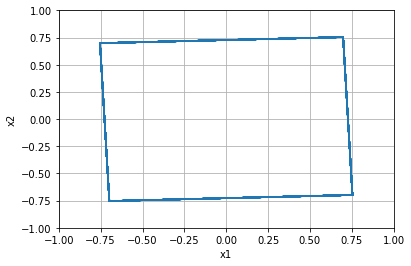


=================== Rollout 1367 =====================
x_init [[0.04]
 [0.64]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.04 0.64]
xx [0.04 0.64]
xxx [0.04 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.6400000000000001]


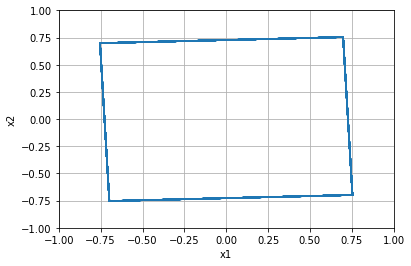


=================== Rollout 1368 =====================
x_init [[0.04]
 [0.68]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.04 0.68]
xx [0.04 0.68]
xxx [0.04 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.6799999999999999]


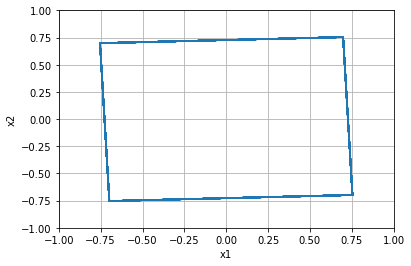


=================== Rollout 1369 =====================
x_init [[0.04]
 [0.72]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.04 0.72]
xx [0.04 0.72]
xxx [0.04 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.72]


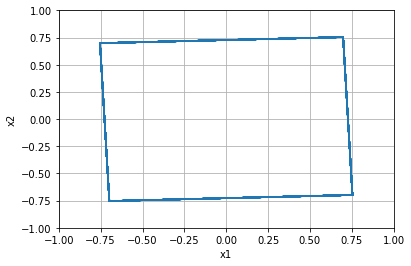


=================== Rollout 1370 =====================
x_init [[0.04]
 [0.76]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.04 0.76]
xx [0.04 0.76]
xxx [0.04 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.76]


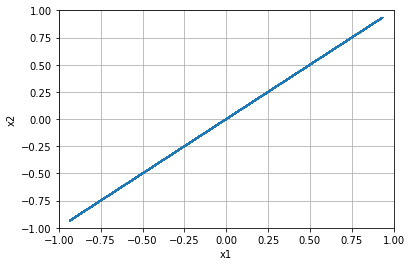


=================== Rollout 1371 =====================
x_init [[0.04]
 [0.8 ]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.04 0.8 ]
xx [0.04 0.8 ]
xxx [0.04 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.8]


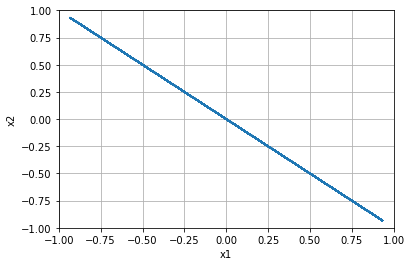


=================== Rollout 1372 =====================
x_init [[0.04]
 [0.84]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.04 0.84]
xx [0.04 0.84]
xxx [0.04 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.8400000000000001]


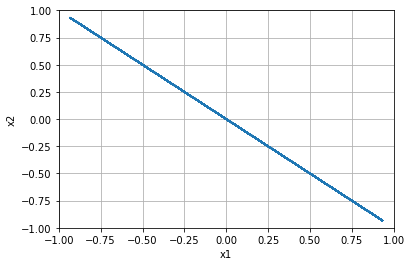


=================== Rollout 1373 =====================
x_init [[0.04]
 [0.88]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.04 0.88]
xx [0.04 0.88]
xxx [0.04 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.8800000000000001]


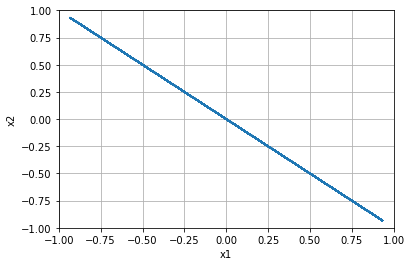


=================== Rollout 1374 =====================
x_init [[0.04]
 [0.92]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.04 0.92]
xx [0.04 0.92]
xxx [0.04 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.9199999999999999]


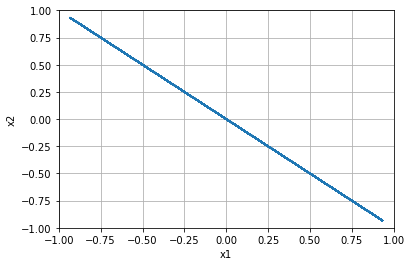


=================== Rollout 1375 =====================
x_init [[0.04]
 [0.96]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.04 0.96]
xx [0.04 0.96]
xxx [0.04 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 0.96]


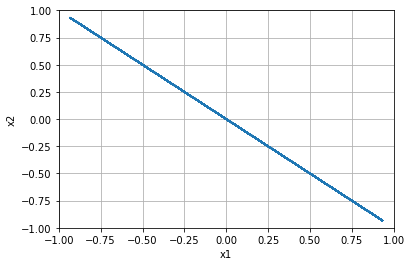


=================== Rollout 1376 =====================
x_init [[0.04]
 [1.  ]]
x_buffer [[0.04 0.04 0.04 0.04 0.04]
 [1.   1.   1.   1.   1.  ]]
x [0.04 1.  ]
xx [0.04 1.  ]
xxx [0.04 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.040000000000000036, 1.0]


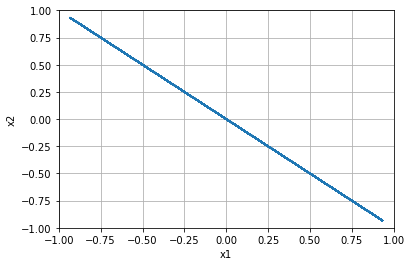


=================== Rollout 1377 =====================
x_init [[ 0.08]
 [-1.  ]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.08 -1.  ]
xx [ 0.08 -1.  ]
xxx [ 0.08 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -1.0]


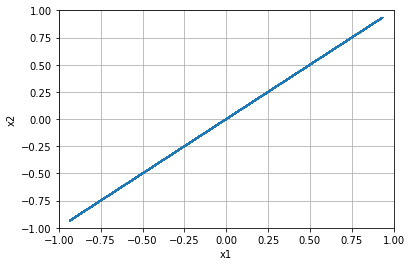


=================== Rollout 1378 =====================
x_init [[ 0.08]
 [-0.96]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.08 -0.96]
xx [ 0.08 -0.96]
xxx [ 0.08 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.96]


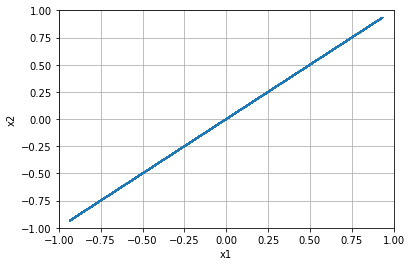


=================== Rollout 1379 =====================
x_init [[ 0.08]
 [-0.92]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.08 -0.92]
xx [ 0.08 -0.92]
xxx [ 0.08 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.92]


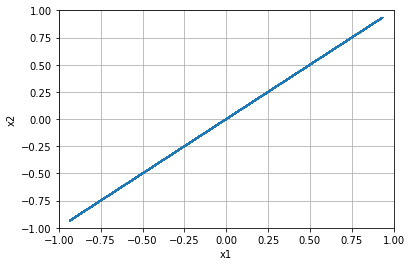


=================== Rollout 1380 =====================
x_init [[ 0.08]
 [-0.88]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.08 -0.88]
xx [ 0.08 -0.88]
xxx [ 0.08 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.88]


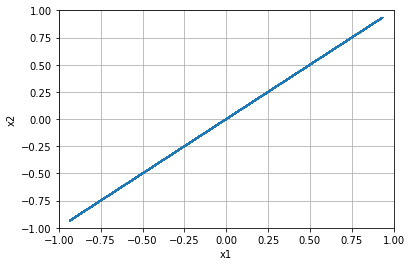


=================== Rollout 1381 =====================
x_init [[ 0.08]
 [-0.84]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.08 -0.84]
xx [ 0.08 -0.84]
xxx [ 0.08 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.84]


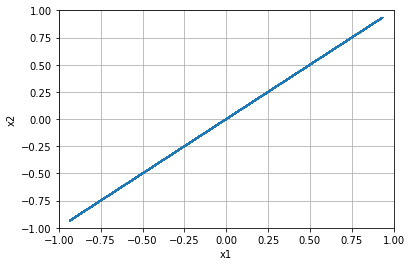


=================== Rollout 1382 =====================
x_init [[ 0.08]
 [-0.8 ]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.08 -0.8 ]
xx [ 0.08 -0.8 ]
xxx [ 0.08 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.8]


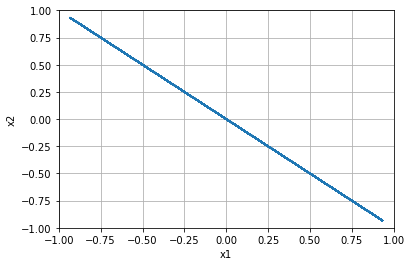


=================== Rollout 1383 =====================
x_init [[ 0.08]
 [-0.76]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.08 -0.76]
xx [ 0.08 -0.76]
xxx [ 0.08 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.76]


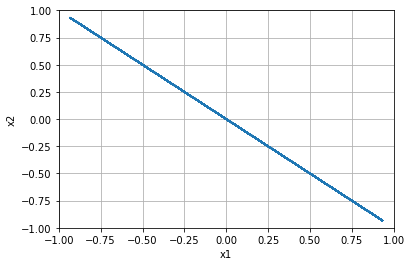


=================== Rollout 1384 =====================
x_init [[ 0.08]
 [-0.72]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.08 -0.72]
xx [ 0.08 -0.72]
xxx [ 0.08 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.72]


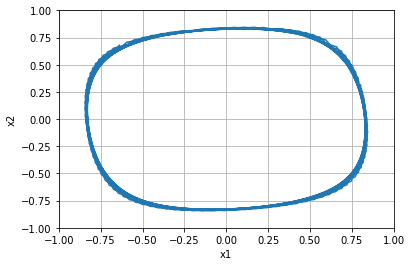


=================== Rollout 1385 =====================
x_init [[ 0.08]
 [-0.68]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.08 -0.68]
xx [ 0.08 -0.68]
xxx [ 0.08 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.6799999999999999]


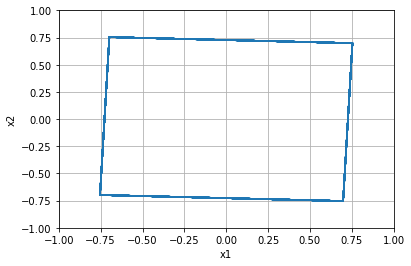


=================== Rollout 1386 =====================
x_init [[ 0.08]
 [-0.64]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.08 -0.64]
xx [ 0.08 -0.64]
xxx [ 0.08 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.64]


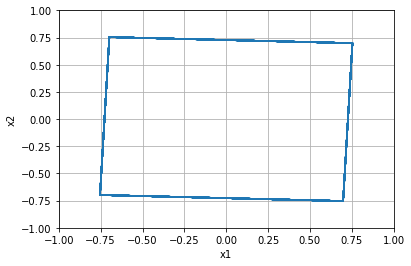


=================== Rollout 1387 =====================
x_init [[ 0.08]
 [-0.6 ]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.08 -0.6 ]
xx [ 0.08 -0.6 ]
xxx [ 0.08 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.6]


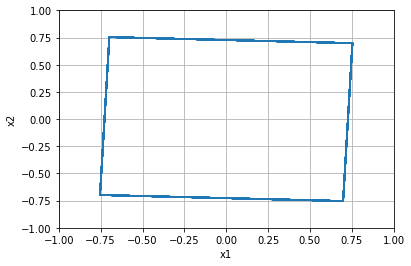


=================== Rollout 1388 =====================
x_init [[ 0.08]
 [-0.56]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.08 -0.56]
xx [ 0.08 -0.56]
xxx [ 0.08 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.56]


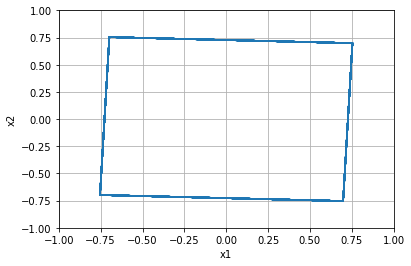


=================== Rollout 1389 =====================
x_init [[ 0.08]
 [-0.52]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.08 -0.52]
xx [ 0.08 -0.52]
xxx [ 0.08 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.52]


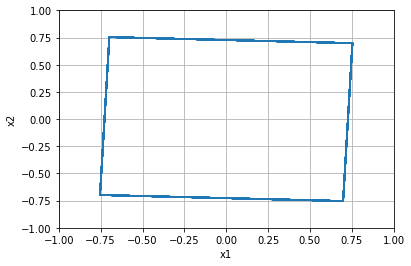


=================== Rollout 1390 =====================
x_init [[ 0.08]
 [-0.48]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.08 -0.48]
xx [ 0.08 -0.48]
xxx [ 0.08 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.48]


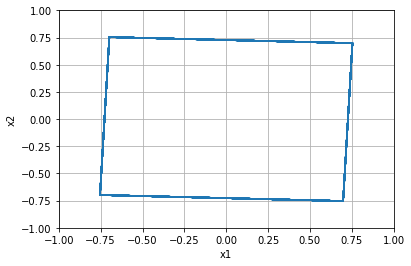


=================== Rollout 1391 =====================
x_init [[ 0.08]
 [-0.44]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.08 -0.44]
xx [ 0.08 -0.44]
xxx [ 0.08 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.43999999999999995]


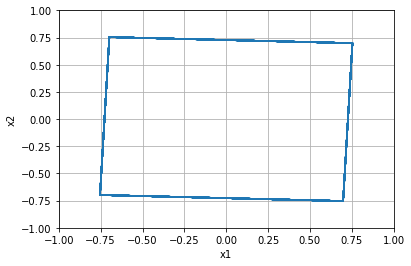


=================== Rollout 1392 =====================
x_init [[ 0.08]
 [-0.4 ]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.08 -0.4 ]
xx [ 0.08 -0.4 ]
xxx [ 0.08 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.4]


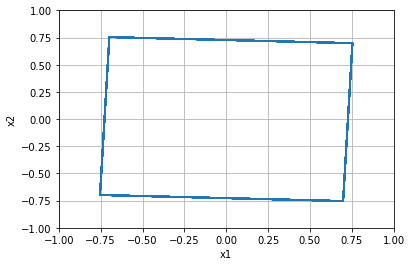


=================== Rollout 1393 =====================
x_init [[ 0.08]
 [-0.36]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.08 -0.36]
xx [ 0.08 -0.36]
xxx [ 0.08 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.36]


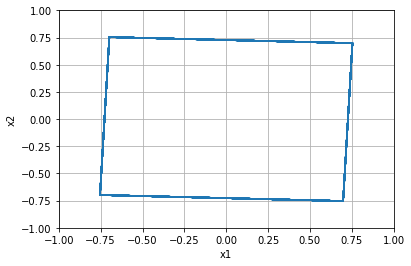


=================== Rollout 1394 =====================
x_init [[ 0.08]
 [-0.32]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.08 -0.32]
xx [ 0.08 -0.32]
xxx [ 0.08 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.31999999999999995]


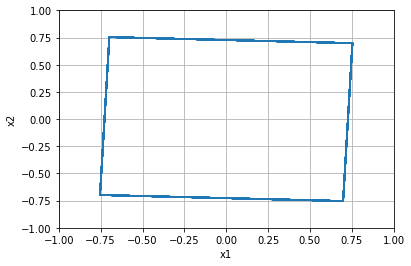


=================== Rollout 1395 =====================
x_init [[ 0.08]
 [-0.28]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.08 -0.28]
xx [ 0.08 -0.28]
xxx [ 0.08 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.28]


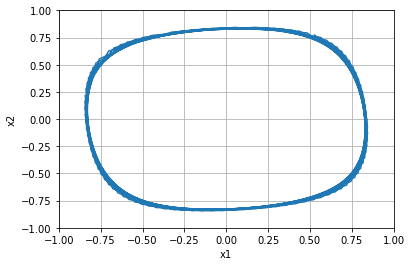


=================== Rollout 1396 =====================
x_init [[ 0.08]
 [-0.24]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.08 -0.24]
xx [ 0.08 -0.24]
xxx [ 0.08 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.24]


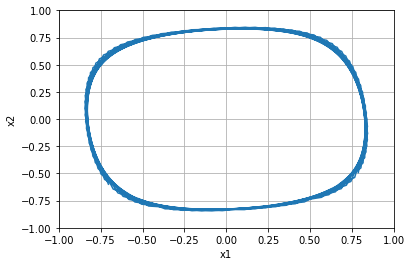


=================== Rollout 1397 =====================
x_init [[ 0.08]
 [-0.2 ]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.08 -0.2 ]
xx [ 0.08 -0.2 ]
xxx [ 0.08 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.19999999999999996]


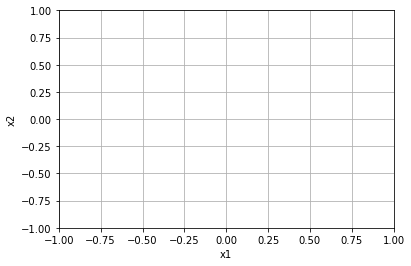


=================== Rollout 1398 =====================
x_init [[ 0.08]
 [-0.16]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.08 -0.16]
xx [ 0.08 -0.16]
xxx [ 0.08 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.16000000000000003]


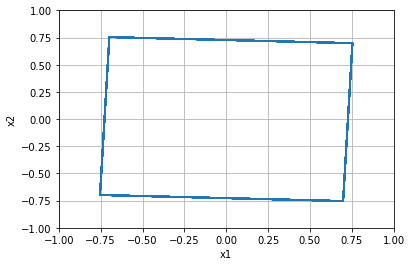


=================== Rollout 1399 =====================
x_init [[ 0.08]
 [-0.12]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.08 -0.12]
xx [ 0.08 -0.12]
xxx [ 0.08 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.12]


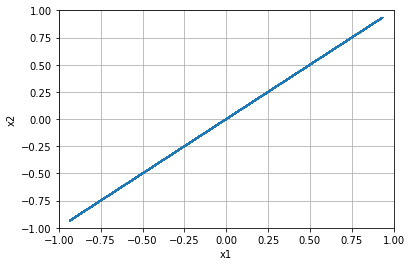


=================== Rollout 1400 =====================
x_init [[ 0.08]
 [-0.08]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.08 -0.08]
xx [ 0.08 -0.08]
xxx [ 0.08 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.07999999999999996]


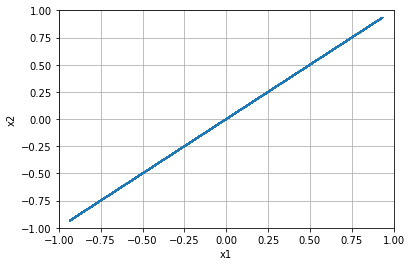


=================== Rollout 1401 =====================
x_init [[ 0.08]
 [-0.04]]
x_buffer [[ 0.08  0.08  0.08  0.08  0.08]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.08 -0.04]
xx [ 0.08 -0.04]
xxx [ 0.08 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, -0.040000000000000036]


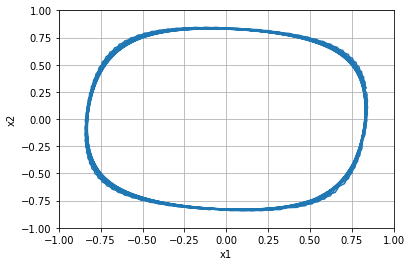


=================== Rollout 1402 =====================
x_init [[0.08]
 [0.  ]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.   0.   0.   0.   0.  ]]
x [0.08 0.  ]
xx [0.08 0.  ]
xxx [0.08 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.0]


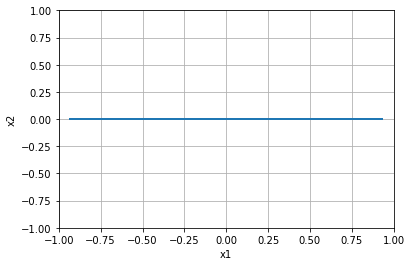


=================== Rollout 1403 =====================
x_init [[0.08]
 [0.04]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.08 0.04]
xx [0.08 0.04]
xxx [0.08 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.040000000000000036]


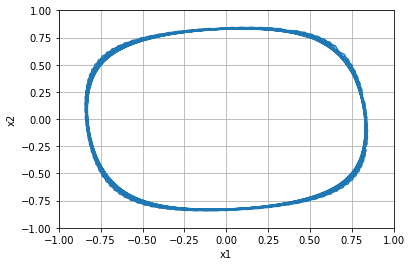


=================== Rollout 1404 =====================
x_init [[0.08]
 [0.08]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.08 0.08]
xx [0.08 0.08]
xxx [0.08 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.08000000000000007]


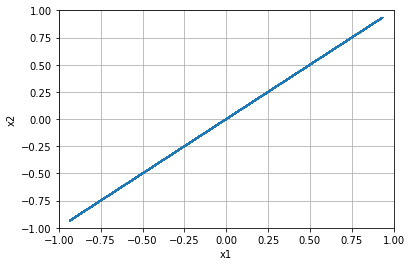


=================== Rollout 1405 =====================
x_init [[0.08]
 [0.12]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.08 0.12]
xx [0.08 0.12]
xxx [0.08 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.1200000000000001]


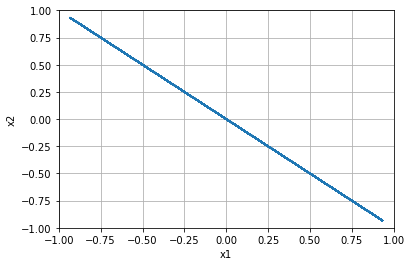


=================== Rollout 1406 =====================
x_init [[0.08]
 [0.16]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.08 0.16]
xx [0.08 0.16]
xxx [0.08 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.15999999999999992]


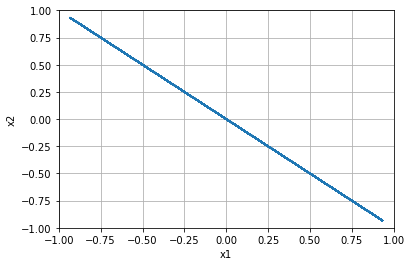


=================== Rollout 1407 =====================
x_init [[0.08]
 [0.2 ]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.08 0.2 ]
xx [0.08 0.2 ]
xxx [0.08 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.19999999999999996]


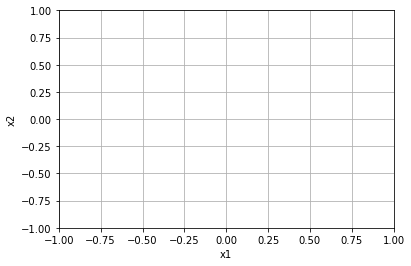


=================== Rollout 1408 =====================
x_init [[0.08]
 [0.24]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.08 0.24]
xx [0.08 0.24]
xxx [0.08 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.24]


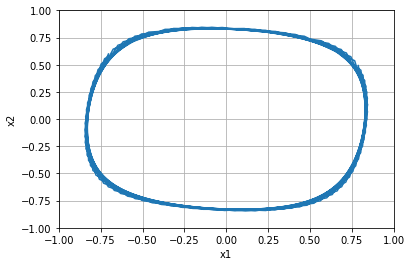


=================== Rollout 1409 =====================
x_init [[0.08]
 [0.28]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.08 0.28]
xx [0.08 0.28]
xxx [0.08 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.28]


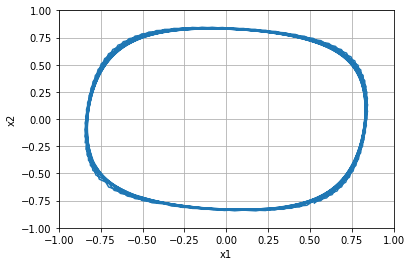


=================== Rollout 1410 =====================
x_init [[0.08]
 [0.32]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.08 0.32]
xx [0.08 0.32]
xxx [0.08 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.32000000000000006]


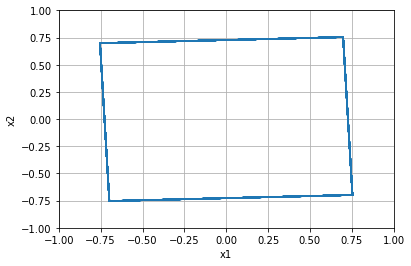


=================== Rollout 1411 =====================
x_init [[0.08]
 [0.36]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.08 0.36]
xx [0.08 0.36]
xxx [0.08 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.3600000000000001]


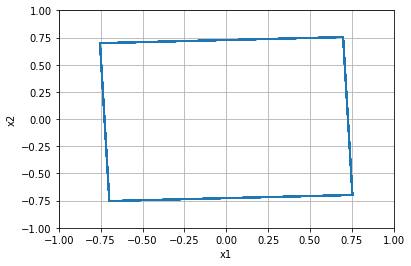


=================== Rollout 1412 =====================
x_init [[0.08]
 [0.4 ]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.08 0.4 ]
xx [0.08 0.4 ]
xxx [0.08 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.40000000000000013]


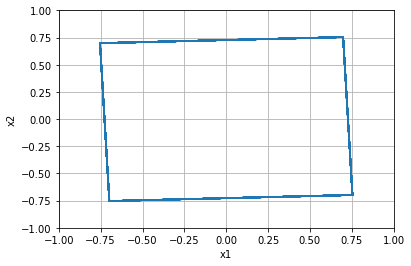


=================== Rollout 1413 =====================
x_init [[0.08]
 [0.44]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.08 0.44]
xx [0.08 0.44]
xxx [0.08 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.43999999999999995]


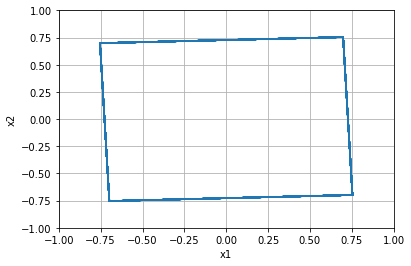


=================== Rollout 1414 =====================
x_init [[0.08]
 [0.48]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.08 0.48]
xx [0.08 0.48]
xxx [0.08 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.48]


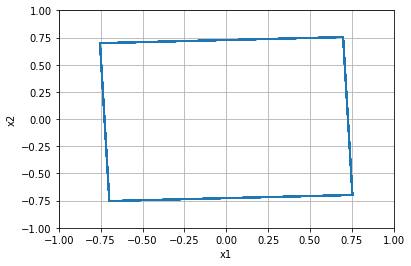


=================== Rollout 1415 =====================
x_init [[0.08]
 [0.52]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.08 0.52]
xx [0.08 0.52]
xxx [0.08 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.52]


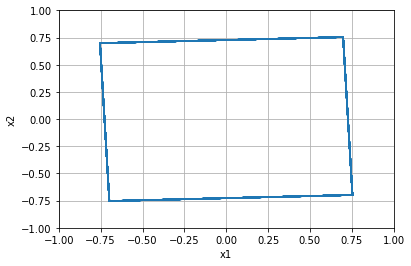


=================== Rollout 1416 =====================
x_init [[0.08]
 [0.56]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.08 0.56]
xx [0.08 0.56]
xxx [0.08 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.56]


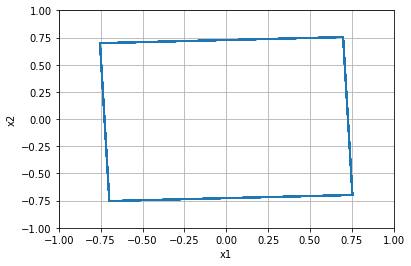


=================== Rollout 1417 =====================
x_init [[0.08]
 [0.6 ]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.08 0.6 ]
xx [0.08 0.6 ]
xxx [0.08 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.6000000000000001]


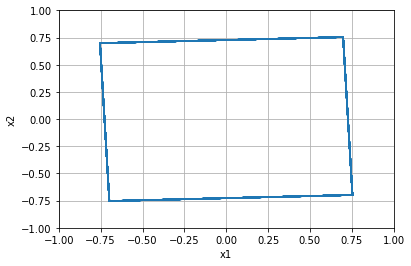


=================== Rollout 1418 =====================
x_init [[0.08]
 [0.64]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.08 0.64]
xx [0.08 0.64]
xxx [0.08 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.6400000000000001]


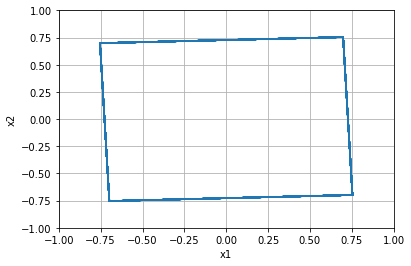


=================== Rollout 1419 =====================
x_init [[0.08]
 [0.68]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.08 0.68]
xx [0.08 0.68]
xxx [0.08 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.6799999999999999]


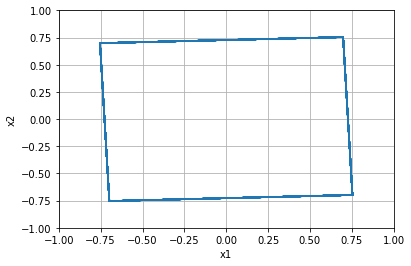


=================== Rollout 1420 =====================
x_init [[0.08]
 [0.72]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.08 0.72]
xx [0.08 0.72]
xxx [0.08 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.72]


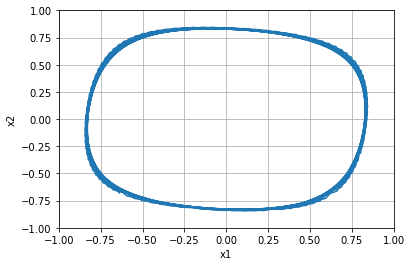


=================== Rollout 1421 =====================
x_init [[0.08]
 [0.76]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.08 0.76]
xx [0.08 0.76]
xxx [0.08 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.76]


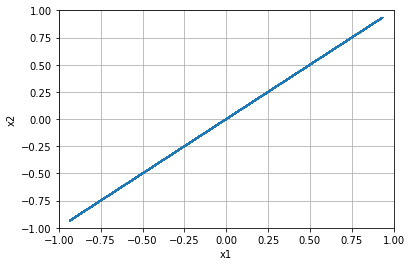


=================== Rollout 1422 =====================
x_init [[0.08]
 [0.8 ]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.08 0.8 ]
xx [0.08 0.8 ]
xxx [0.08 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.8]


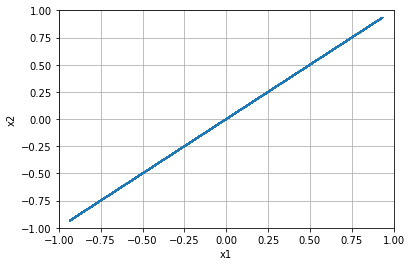


=================== Rollout 1423 =====================
x_init [[0.08]
 [0.84]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.08 0.84]
xx [0.08 0.84]
xxx [0.08 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.8400000000000001]


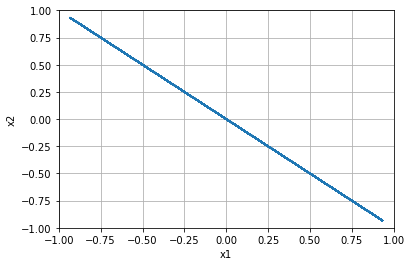


=================== Rollout 1424 =====================
x_init [[0.08]
 [0.88]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.08 0.88]
xx [0.08 0.88]
xxx [0.08 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.8800000000000001]


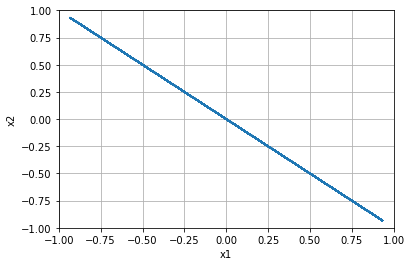


=================== Rollout 1425 =====================
x_init [[0.08]
 [0.92]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.08 0.92]
xx [0.08 0.92]
xxx [0.08 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.9199999999999999]


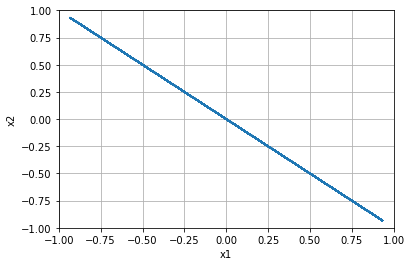


=================== Rollout 1426 =====================
x_init [[0.08]
 [0.96]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.08 0.96]
xx [0.08 0.96]
xxx [0.08 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 0.96]


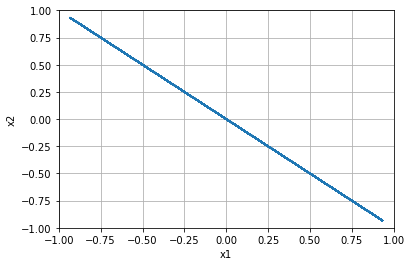


=================== Rollout 1427 =====================
x_init [[0.08]
 [1.  ]]
x_buffer [[0.08 0.08 0.08 0.08 0.08]
 [1.   1.   1.   1.   1.  ]]
x [0.08 1.  ]
xx [0.08 1.  ]
xxx [0.08 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.08000000000000007, 1.0]


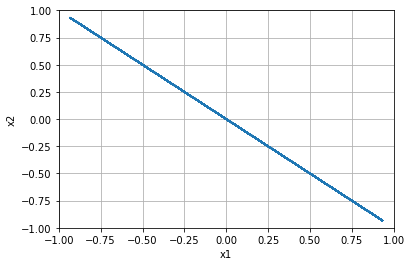


=================== Rollout 1428 =====================
x_init [[ 0.12]
 [-1.  ]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.12 -1.  ]
xx [ 0.12 -1.  ]
xxx [ 0.12 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -1.0]


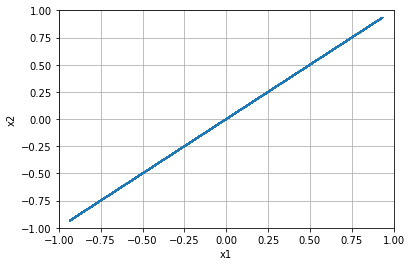


=================== Rollout 1429 =====================
x_init [[ 0.12]
 [-0.96]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.12 -0.96]
xx [ 0.12 -0.96]
xxx [ 0.12 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.96]


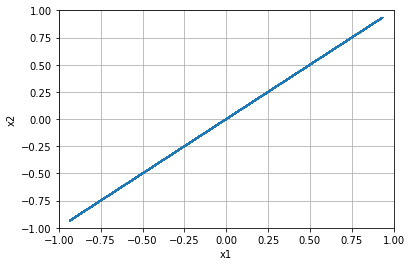


=================== Rollout 1430 =====================
x_init [[ 0.12]
 [-0.92]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.12 -0.92]
xx [ 0.12 -0.92]
xxx [ 0.12 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.92]


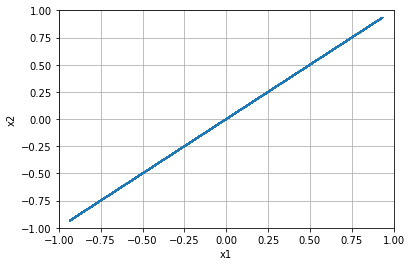


=================== Rollout 1431 =====================
x_init [[ 0.12]
 [-0.88]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.12 -0.88]
xx [ 0.12 -0.88]
xxx [ 0.12 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.88]


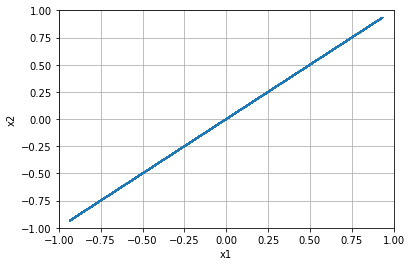


=================== Rollout 1432 =====================
x_init [[ 0.12]
 [-0.84]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.12 -0.84]
xx [ 0.12 -0.84]
xxx [ 0.12 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.84]


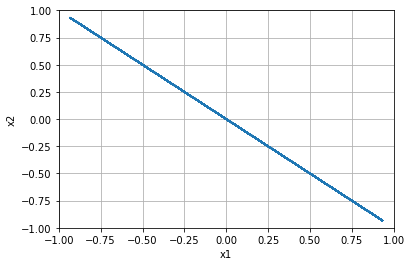


=================== Rollout 1433 =====================
x_init [[ 0.12]
 [-0.8 ]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.12 -0.8 ]
xx [ 0.12 -0.8 ]
xxx [ 0.12 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.8]


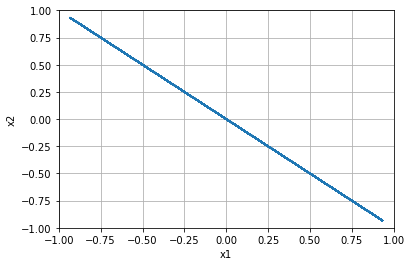


=================== Rollout 1434 =====================
x_init [[ 0.12]
 [-0.76]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.12 -0.76]
xx [ 0.12 -0.76]
xxx [ 0.12 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.76]


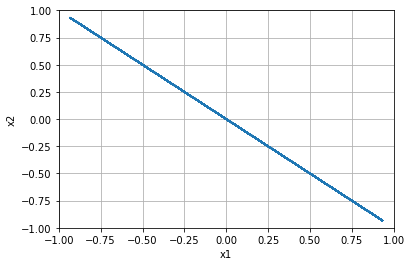


=================== Rollout 1435 =====================
x_init [[ 0.12]
 [-0.72]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.12 -0.72]
xx [ 0.12 -0.72]
xxx [ 0.12 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.72]


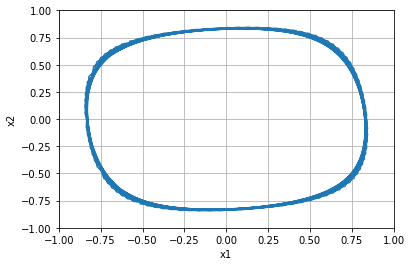


=================== Rollout 1436 =====================
x_init [[ 0.12]
 [-0.68]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.12 -0.68]
xx [ 0.12 -0.68]
xxx [ 0.12 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.6799999999999999]


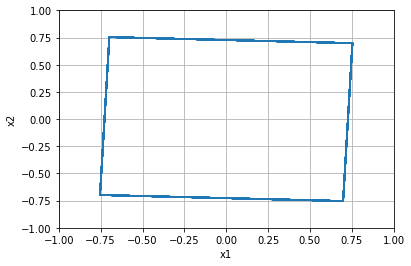


=================== Rollout 1437 =====================
x_init [[ 0.12]
 [-0.64]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.12 -0.64]
xx [ 0.12 -0.64]
xxx [ 0.12 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.64]


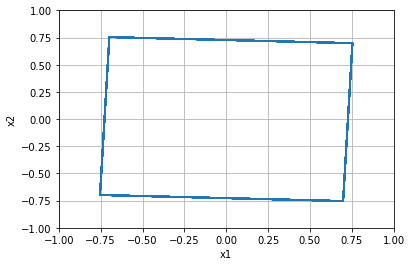


=================== Rollout 1438 =====================
x_init [[ 0.12]
 [-0.6 ]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.12 -0.6 ]
xx [ 0.12 -0.6 ]
xxx [ 0.12 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.6]


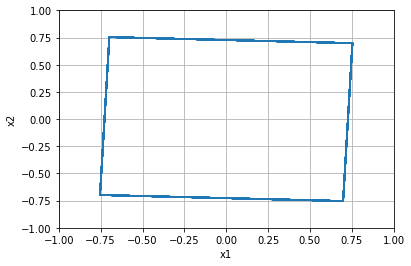


=================== Rollout 1439 =====================
x_init [[ 0.12]
 [-0.56]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.12 -0.56]
xx [ 0.12 -0.56]
xxx [ 0.12 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.56]


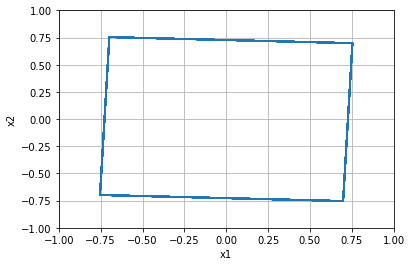


=================== Rollout 1440 =====================
x_init [[ 0.12]
 [-0.52]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.12 -0.52]
xx [ 0.12 -0.52]
xxx [ 0.12 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.52]


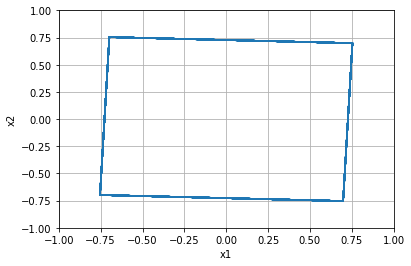


=================== Rollout 1441 =====================
x_init [[ 0.12]
 [-0.48]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.12 -0.48]
xx [ 0.12 -0.48]
xxx [ 0.12 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.48]


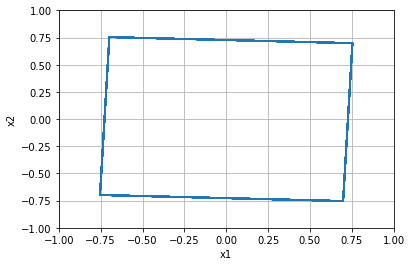


=================== Rollout 1442 =====================
x_init [[ 0.12]
 [-0.44]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.12 -0.44]
xx [ 0.12 -0.44]
xxx [ 0.12 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.43999999999999995]


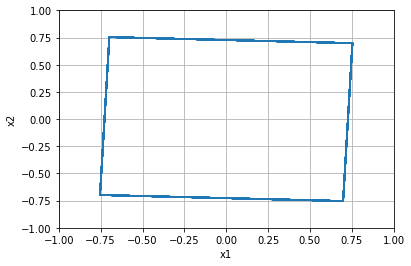


=================== Rollout 1443 =====================
x_init [[ 0.12]
 [-0.4 ]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.12 -0.4 ]
xx [ 0.12 -0.4 ]
xxx [ 0.12 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.4]


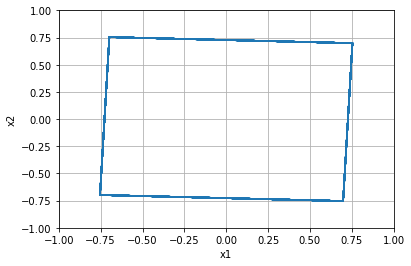


=================== Rollout 1444 =====================
x_init [[ 0.12]
 [-0.36]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.12 -0.36]
xx [ 0.12 -0.36]
xxx [ 0.12 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.36]


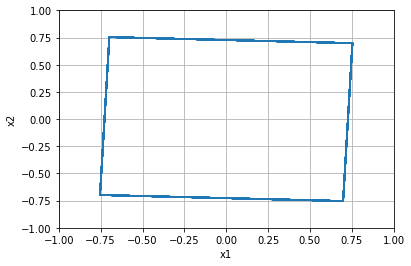


=================== Rollout 1445 =====================
x_init [[ 0.12]
 [-0.32]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.12 -0.32]
xx [ 0.12 -0.32]
xxx [ 0.12 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.31999999999999995]


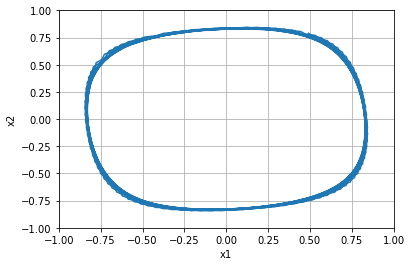


=================== Rollout 1446 =====================
x_init [[ 0.12]
 [-0.28]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.12 -0.28]
xx [ 0.12 -0.28]
xxx [ 0.12 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.28]


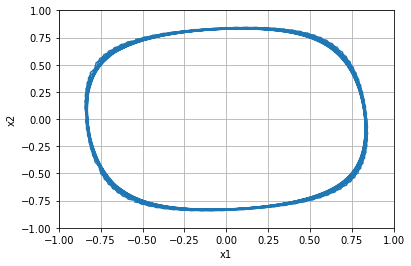


=================== Rollout 1447 =====================
x_init [[ 0.12]
 [-0.24]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.12 -0.24]
xx [ 0.12 -0.24]
xxx [ 0.12 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.24]


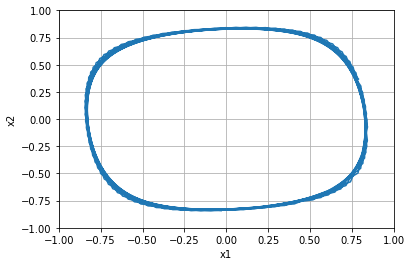


=================== Rollout 1448 =====================
x_init [[ 0.12]
 [-0.2 ]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.12 -0.2 ]
xx [ 0.12 -0.2 ]
xxx [ 0.12 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.19999999999999996]


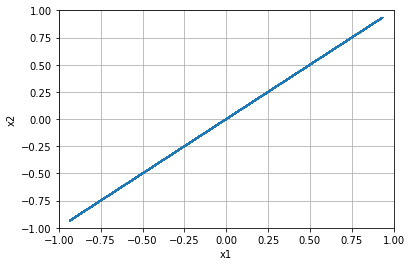


=================== Rollout 1449 =====================
x_init [[ 0.12]
 [-0.16]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.12 -0.16]
xx [ 0.12 -0.16]
xxx [ 0.12 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.16000000000000003]


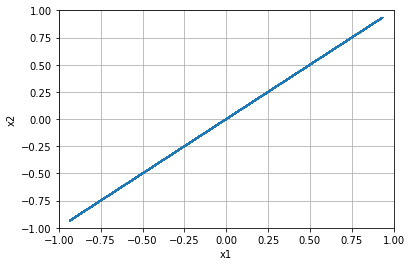


=================== Rollout 1450 =====================
x_init [[ 0.12]
 [-0.12]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.12 -0.12]
xx [ 0.12 -0.12]
xxx [ 0.12 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.12]


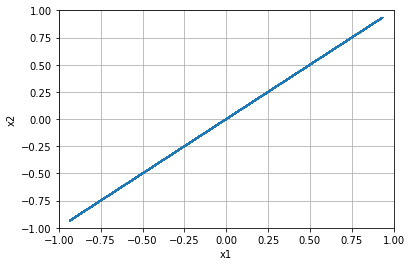


=================== Rollout 1451 =====================
x_init [[ 0.12]
 [-0.08]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.12 -0.08]
xx [ 0.12 -0.08]
xxx [ 0.12 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.07999999999999996]


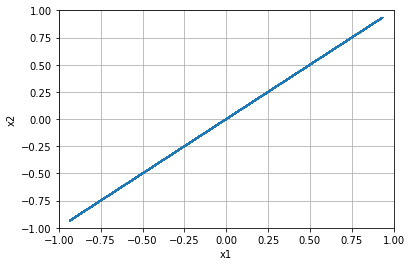


=================== Rollout 1452 =====================
x_init [[ 0.12]
 [-0.04]]
x_buffer [[ 0.12  0.12  0.12  0.12  0.12]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.12 -0.04]
xx [ 0.12 -0.04]
xxx [ 0.12 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, -0.040000000000000036]


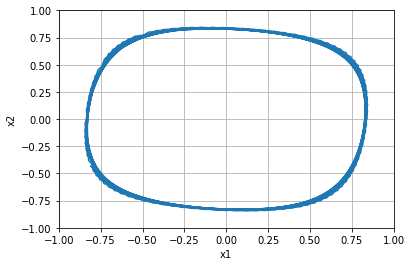


=================== Rollout 1453 =====================
x_init [[0.12]
 [0.  ]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.   0.   0.   0.   0.  ]]
x [0.12 0.  ]
xx [0.12 0.  ]
xxx [0.12 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.0]


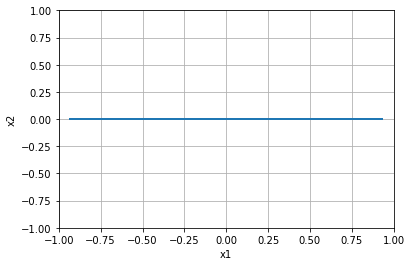


=================== Rollout 1454 =====================
x_init [[0.12]
 [0.04]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.12 0.04]
xx [0.12 0.04]
xxx [0.12 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.040000000000000036]


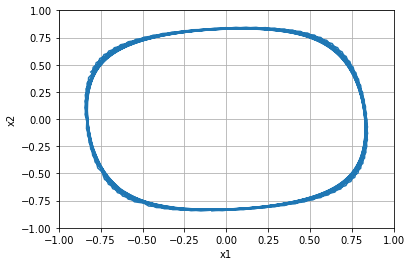


=================== Rollout 1455 =====================
x_init [[0.12]
 [0.08]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.12 0.08]
xx [0.12 0.08]
xxx [0.12 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.08000000000000007]


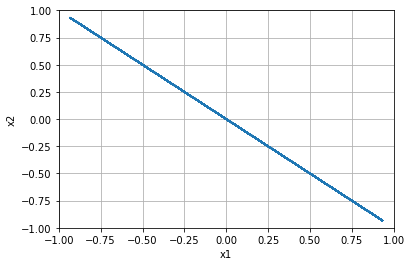


=================== Rollout 1456 =====================
x_init [[0.12]
 [0.12]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.12 0.12]
xx [0.12 0.12]
xxx [0.12 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.1200000000000001]


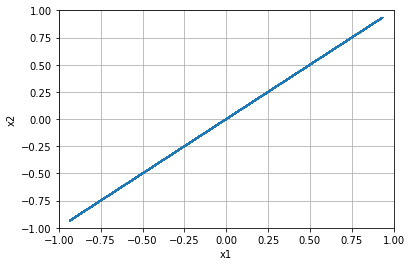


=================== Rollout 1457 =====================
x_init [[0.12]
 [0.16]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.12 0.16]
xx [0.12 0.16]
xxx [0.12 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.15999999999999992]


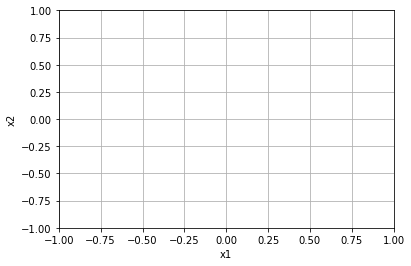


=================== Rollout 1458 =====================
x_init [[0.12]
 [0.2 ]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.12 0.2 ]
xx [0.12 0.2 ]
xxx [0.12 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.19999999999999996]


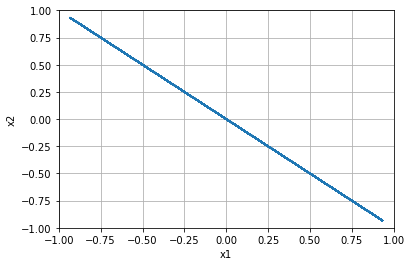


=================== Rollout 1459 =====================
x_init [[0.12]
 [0.24]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.12 0.24]
xx [0.12 0.24]
xxx [0.12 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.24]


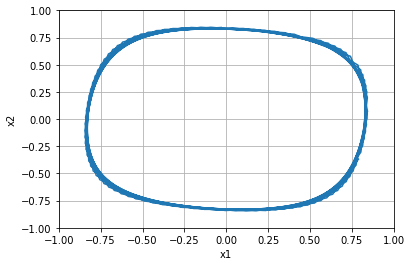


=================== Rollout 1460 =====================
x_init [[0.12]
 [0.28]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.12 0.28]
xx [0.12 0.28]
xxx [0.12 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.28]


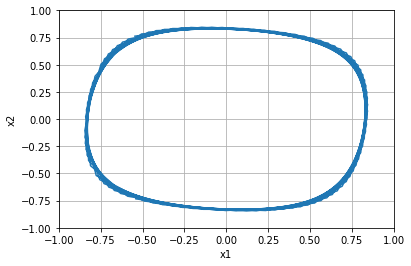


=================== Rollout 1461 =====================
x_init [[0.12]
 [0.32]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.12 0.32]
xx [0.12 0.32]
xxx [0.12 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.32000000000000006]


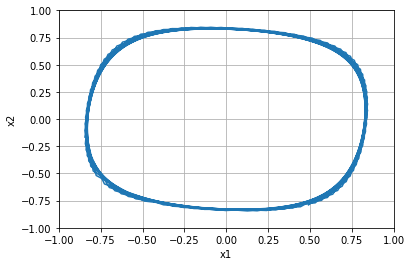


=================== Rollout 1462 =====================
x_init [[0.12]
 [0.36]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.12 0.36]
xx [0.12 0.36]
xxx [0.12 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.3600000000000001]


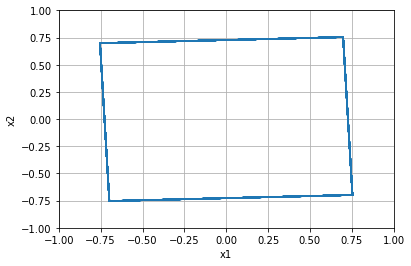


=================== Rollout 1463 =====================
x_init [[0.12]
 [0.4 ]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.12 0.4 ]
xx [0.12 0.4 ]
xxx [0.12 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.40000000000000013]


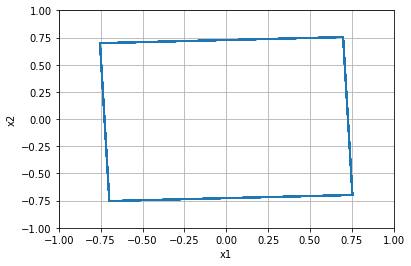


=================== Rollout 1464 =====================
x_init [[0.12]
 [0.44]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.12 0.44]
xx [0.12 0.44]
xxx [0.12 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.43999999999999995]


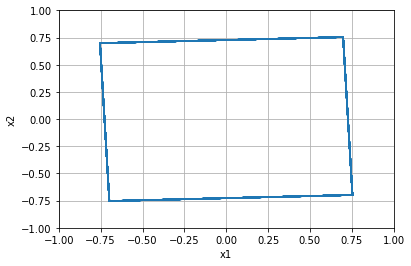


=================== Rollout 1465 =====================
x_init [[0.12]
 [0.48]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.12 0.48]
xx [0.12 0.48]
xxx [0.12 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.48]


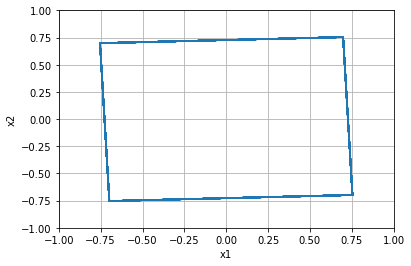


=================== Rollout 1466 =====================
x_init [[0.12]
 [0.52]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.12 0.52]
xx [0.12 0.52]
xxx [0.12 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.52]


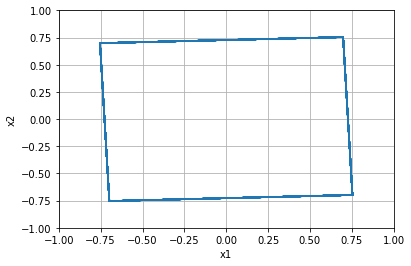


=================== Rollout 1467 =====================
x_init [[0.12]
 [0.56]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.12 0.56]
xx [0.12 0.56]
xxx [0.12 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.56]


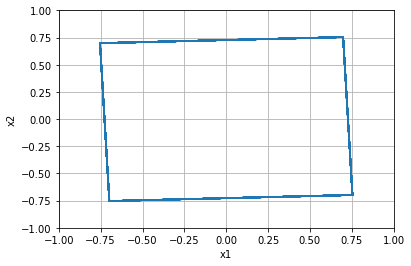


=================== Rollout 1468 =====================
x_init [[0.12]
 [0.6 ]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.12 0.6 ]
xx [0.12 0.6 ]
xxx [0.12 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.6000000000000001]


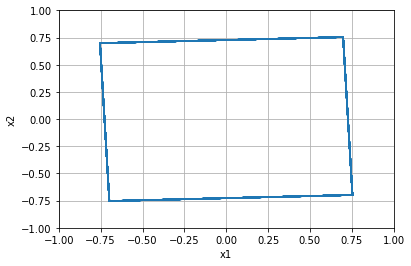


=================== Rollout 1469 =====================
x_init [[0.12]
 [0.64]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.12 0.64]
xx [0.12 0.64]
xxx [0.12 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.6400000000000001]


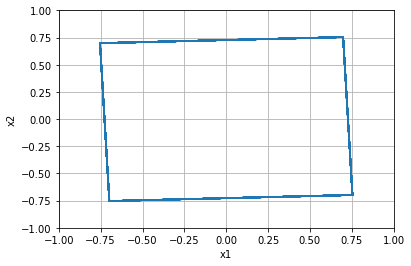


=================== Rollout 1470 =====================
x_init [[0.12]
 [0.68]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.12 0.68]
xx [0.12 0.68]
xxx [0.12 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.6799999999999999]


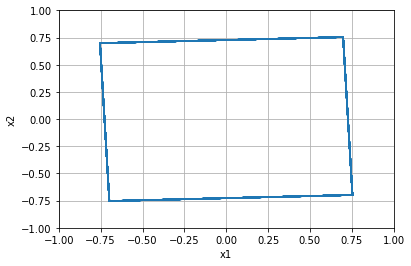


=================== Rollout 1471 =====================
x_init [[0.12]
 [0.72]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.12 0.72]
xx [0.12 0.72]
xxx [0.12 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.72]


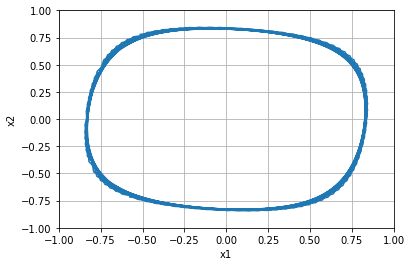


=================== Rollout 1472 =====================
x_init [[0.12]
 [0.76]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.12 0.76]
xx [0.12 0.76]
xxx [0.12 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.76]


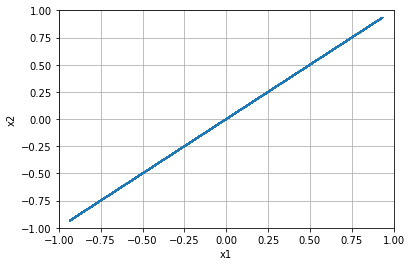


=================== Rollout 1473 =====================
x_init [[0.12]
 [0.8 ]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.12 0.8 ]
xx [0.12 0.8 ]
xxx [0.12 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.8]


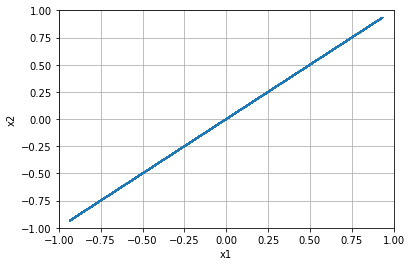


=================== Rollout 1474 =====================
x_init [[0.12]
 [0.84]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.12 0.84]
xx [0.12 0.84]
xxx [0.12 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.8400000000000001]


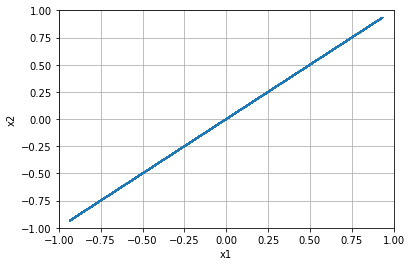


=================== Rollout 1475 =====================
x_init [[0.12]
 [0.88]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.12 0.88]
xx [0.12 0.88]
xxx [0.12 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.8800000000000001]


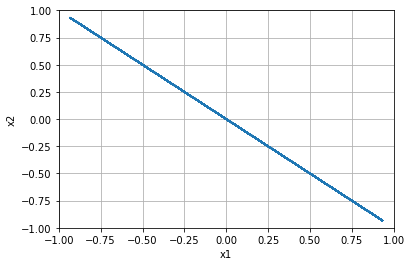


=================== Rollout 1476 =====================
x_init [[0.12]
 [0.92]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.12 0.92]
xx [0.12 0.92]
xxx [0.12 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.9199999999999999]


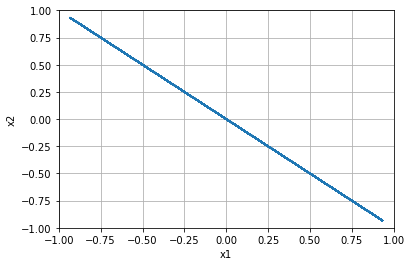


=================== Rollout 1477 =====================
x_init [[0.12]
 [0.96]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.12 0.96]
xx [0.12 0.96]
xxx [0.12 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 0.96]


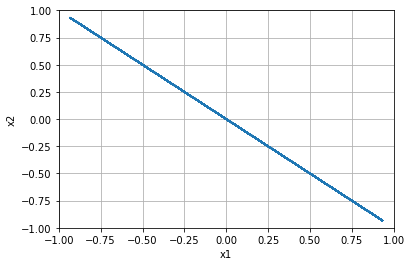


=================== Rollout 1478 =====================
x_init [[0.12]
 [1.  ]]
x_buffer [[0.12 0.12 0.12 0.12 0.12]
 [1.   1.   1.   1.   1.  ]]
x [0.12 1.  ]
xx [0.12 1.  ]
xxx [0.12 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.1200000000000001, 1.0]


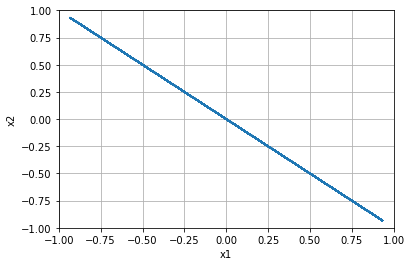


=================== Rollout 1479 =====================
x_init [[ 0.16]
 [-1.  ]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.16 -1.  ]
xx [ 0.16 -1.  ]
xxx [ 0.16 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -1.0]


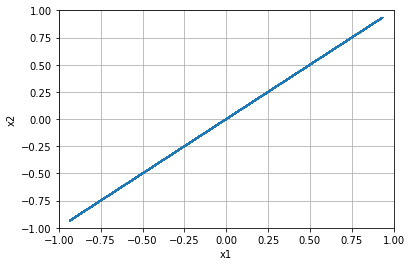


=================== Rollout 1480 =====================
x_init [[ 0.16]
 [-0.96]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.16 -0.96]
xx [ 0.16 -0.96]
xxx [ 0.16 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.96]


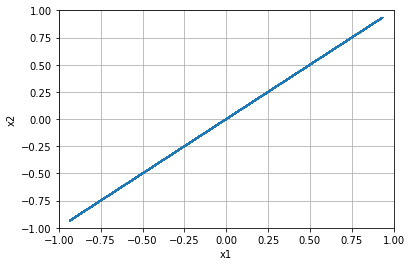


=================== Rollout 1481 =====================
x_init [[ 0.16]
 [-0.92]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.16 -0.92]
xx [ 0.16 -0.92]
xxx [ 0.16 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.92]


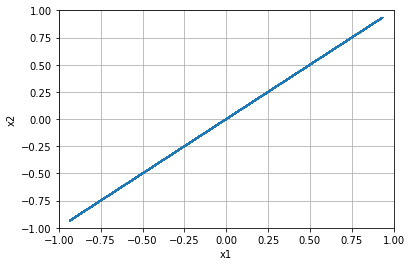


=================== Rollout 1482 =====================
x_init [[ 0.16]
 [-0.88]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.16 -0.88]
xx [ 0.16 -0.88]
xxx [ 0.16 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.88]


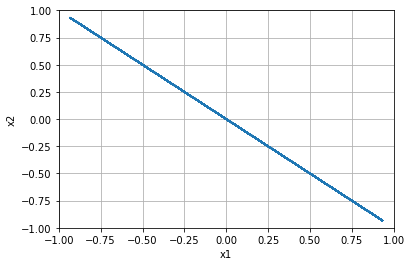


=================== Rollout 1483 =====================
x_init [[ 0.16]
 [-0.84]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.16 -0.84]
xx [ 0.16 -0.84]
xxx [ 0.16 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.84]


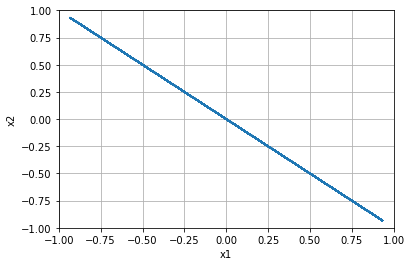


=================== Rollout 1484 =====================
x_init [[ 0.16]
 [-0.8 ]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.16 -0.8 ]
xx [ 0.16 -0.8 ]
xxx [ 0.16 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.8]


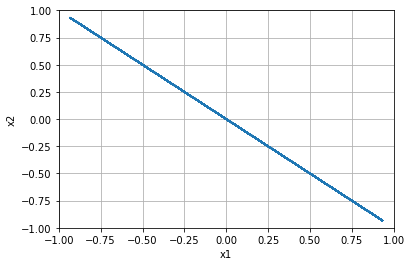


=================== Rollout 1485 =====================
x_init [[ 0.16]
 [-0.76]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.16 -0.76]
xx [ 0.16 -0.76]
xxx [ 0.16 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.76]


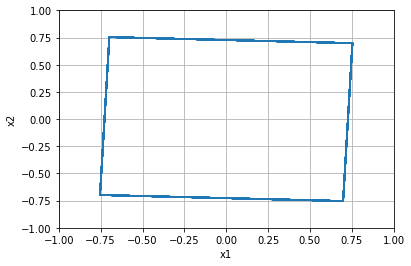


=================== Rollout 1486 =====================
x_init [[ 0.16]
 [-0.72]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.16 -0.72]
xx [ 0.16 -0.72]
xxx [ 0.16 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.72]


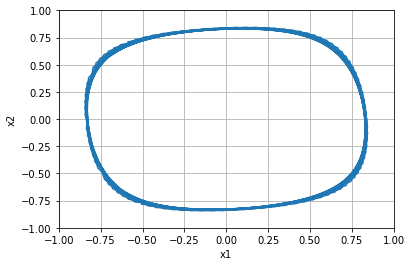


=================== Rollout 1487 =====================
x_init [[ 0.16]
 [-0.68]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.16 -0.68]
xx [ 0.16 -0.68]
xxx [ 0.16 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.6799999999999999]


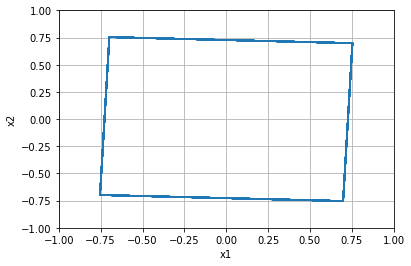


=================== Rollout 1488 =====================
x_init [[ 0.16]
 [-0.64]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.16 -0.64]
xx [ 0.16 -0.64]
xxx [ 0.16 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.64]


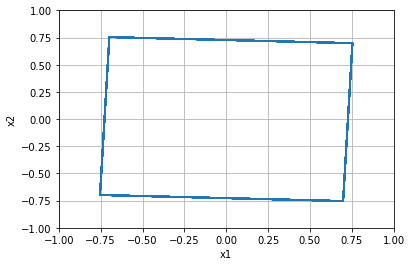


=================== Rollout 1489 =====================
x_init [[ 0.16]
 [-0.6 ]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.16 -0.6 ]
xx [ 0.16 -0.6 ]
xxx [ 0.16 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.6]


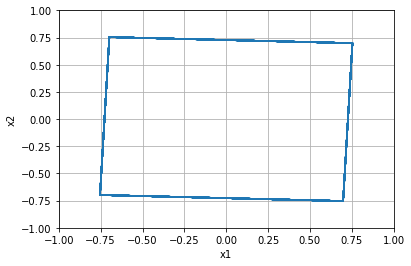


=================== Rollout 1490 =====================
x_init [[ 0.16]
 [-0.56]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.16 -0.56]
xx [ 0.16 -0.56]
xxx [ 0.16 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.56]


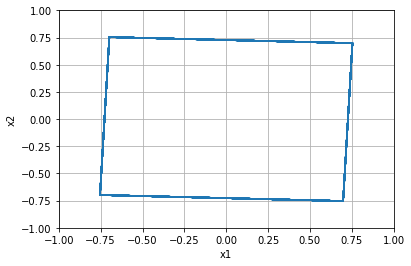


=================== Rollout 1491 =====================
x_init [[ 0.16]
 [-0.52]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.16 -0.52]
xx [ 0.16 -0.52]
xxx [ 0.16 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.52]


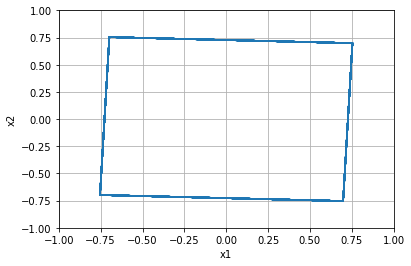


=================== Rollout 1492 =====================
x_init [[ 0.16]
 [-0.48]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.16 -0.48]
xx [ 0.16 -0.48]
xxx [ 0.16 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.48]


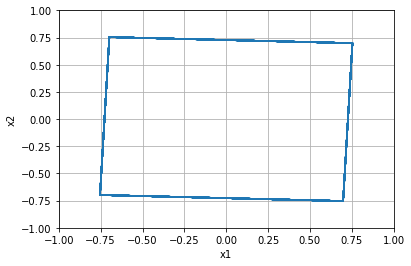


=================== Rollout 1493 =====================
x_init [[ 0.16]
 [-0.44]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.16 -0.44]
xx [ 0.16 -0.44]
xxx [ 0.16 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.43999999999999995]


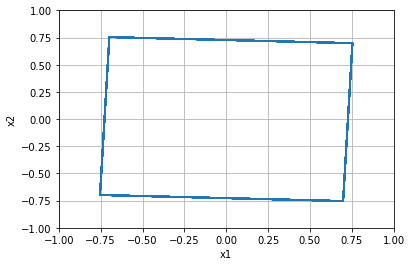


=================== Rollout 1494 =====================
x_init [[ 0.16]
 [-0.4 ]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.16 -0.4 ]
xx [ 0.16 -0.4 ]
xxx [ 0.16 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.4]


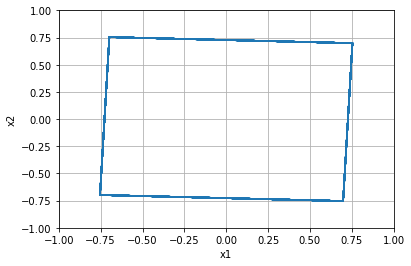


=================== Rollout 1495 =====================
x_init [[ 0.16]
 [-0.36]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.16 -0.36]
xx [ 0.16 -0.36]
xxx [ 0.16 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.36]


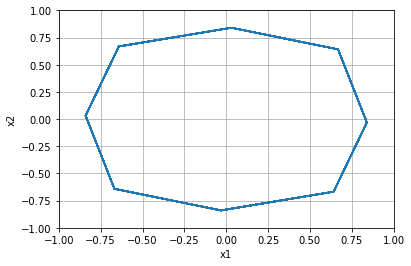


=================== Rollout 1496 =====================
x_init [[ 0.16]
 [-0.32]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.16 -0.32]
xx [ 0.16 -0.32]
xxx [ 0.16 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.31999999999999995]


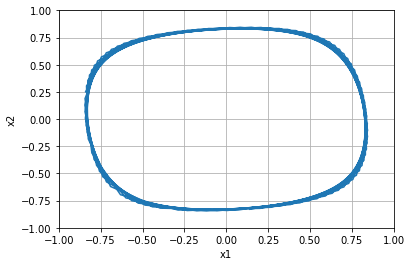


=================== Rollout 1497 =====================
x_init [[ 0.16]
 [-0.28]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.16 -0.28]
xx [ 0.16 -0.28]
xxx [ 0.16 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.28]


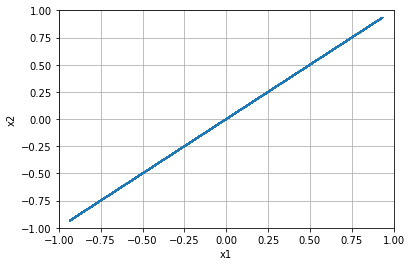


=================== Rollout 1498 =====================
x_init [[ 0.16]
 [-0.24]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.16 -0.24]
xx [ 0.16 -0.24]
xxx [ 0.16 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.24]


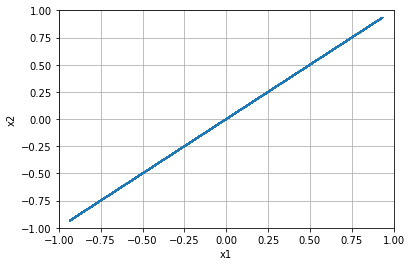


=================== Rollout 1499 =====================
x_init [[ 0.16]
 [-0.2 ]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.16 -0.2 ]
xx [ 0.16 -0.2 ]
xxx [ 0.16 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.19999999999999996]


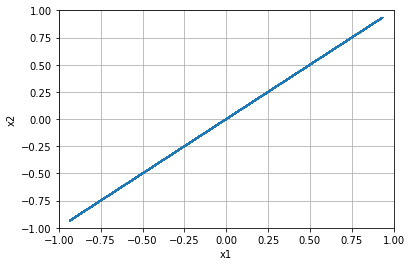


=================== Rollout 1500 =====================
x_init [[ 0.16]
 [-0.16]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.16 -0.16]
xx [ 0.16 -0.16]
xxx [ 0.16 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.16000000000000003]


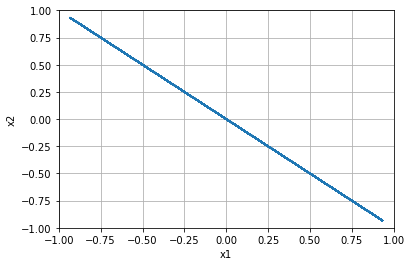


=================== Rollout 1501 =====================
x_init [[ 0.16]
 [-0.12]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.16 -0.12]
xx [ 0.16 -0.12]
xxx [ 0.16 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.12]


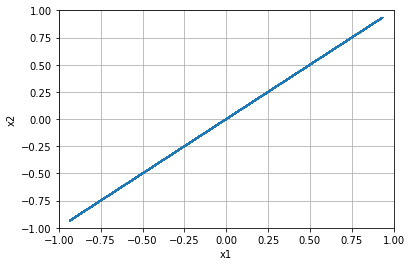


=================== Rollout 1502 =====================
x_init [[ 0.16]
 [-0.08]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.16 -0.08]
xx [ 0.16 -0.08]
xxx [ 0.16 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.07999999999999996]


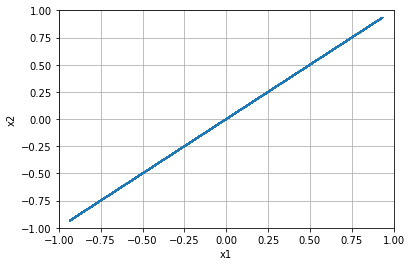


=================== Rollout 1503 =====================
x_init [[ 0.16]
 [-0.04]]
x_buffer [[ 0.16  0.16  0.16  0.16  0.16]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.16 -0.04]
xx [ 0.16 -0.04]
xxx [ 0.16 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, -0.040000000000000036]


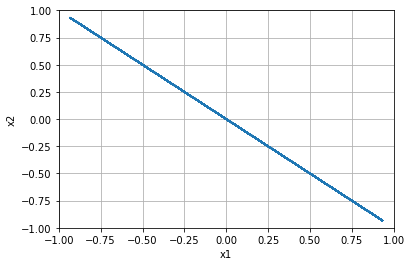


=================== Rollout 1504 =====================
x_init [[0.16]
 [0.  ]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.   0.   0.   0.   0.  ]]
x [0.16 0.  ]
xx [0.16 0.  ]
xxx [0.16 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.0]


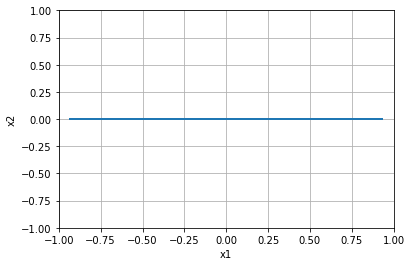


=================== Rollout 1505 =====================
x_init [[0.16]
 [0.04]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.16 0.04]
xx [0.16 0.04]
xxx [0.16 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.040000000000000036]


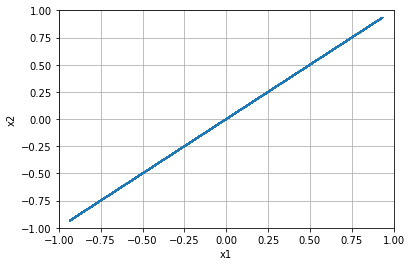


=================== Rollout 1506 =====================
x_init [[0.16]
 [0.08]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.16 0.08]
xx [0.16 0.08]
xxx [0.16 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.08000000000000007]


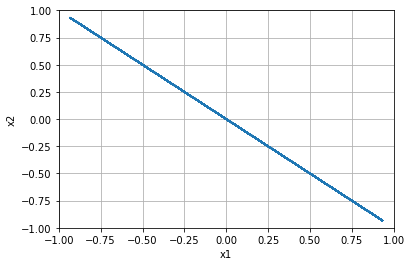


=================== Rollout 1507 =====================
x_init [[0.16]
 [0.12]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.16 0.12]
xx [0.16 0.12]
xxx [0.16 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.1200000000000001]


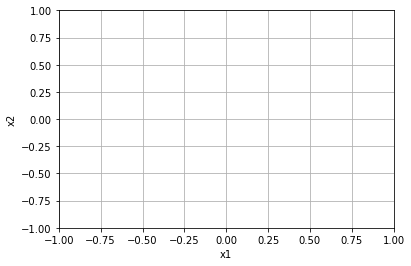


=================== Rollout 1508 =====================
x_init [[0.16]
 [0.16]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.16 0.16]
xx [0.16 0.16]
xxx [0.16 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.15999999999999992]


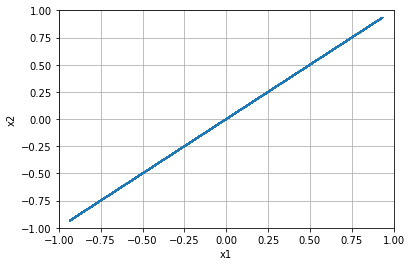


=================== Rollout 1509 =====================
x_init [[0.16]
 [0.2 ]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.16 0.2 ]
xx [0.16 0.2 ]
xxx [0.16 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.19999999999999996]


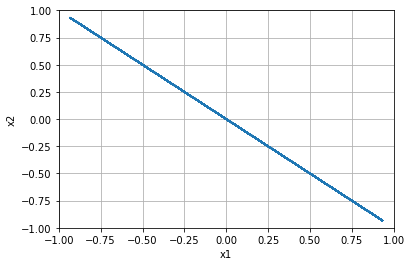


=================== Rollout 1510 =====================
x_init [[0.16]
 [0.24]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.16 0.24]
xx [0.16 0.24]
xxx [0.16 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.24]


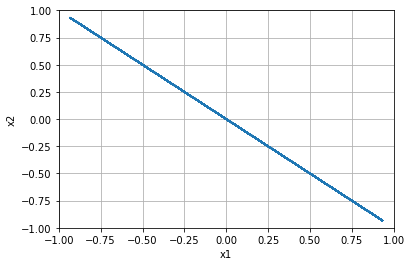


=================== Rollout 1511 =====================
x_init [[0.16]
 [0.28]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.16 0.28]
xx [0.16 0.28]
xxx [0.16 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.28]


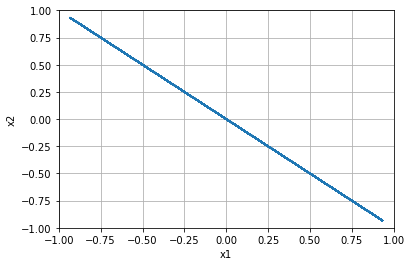


=================== Rollout 1512 =====================
x_init [[0.16]
 [0.32]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.16 0.32]
xx [0.16 0.32]
xxx [0.16 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.32000000000000006]


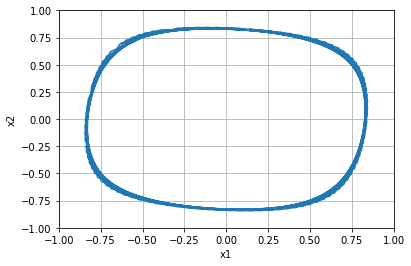


=================== Rollout 1513 =====================
x_init [[0.16]
 [0.36]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.16 0.36]
xx [0.16 0.36]
xxx [0.16 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.3600000000000001]


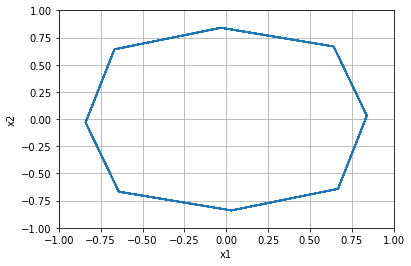


=================== Rollout 1514 =====================
x_init [[0.16]
 [0.4 ]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.16 0.4 ]
xx [0.16 0.4 ]
xxx [0.16 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.40000000000000013]


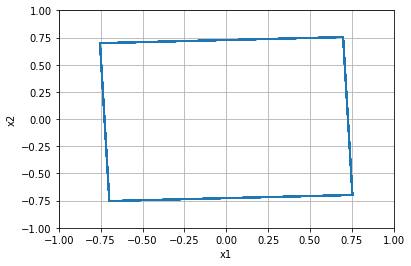


=================== Rollout 1515 =====================
x_init [[0.16]
 [0.44]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.16 0.44]
xx [0.16 0.44]
xxx [0.16 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.43999999999999995]


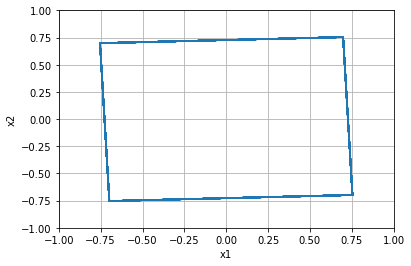


=================== Rollout 1516 =====================
x_init [[0.16]
 [0.48]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.16 0.48]
xx [0.16 0.48]
xxx [0.16 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.48]


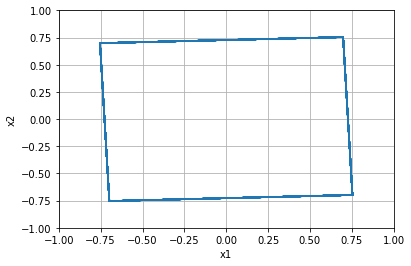


=================== Rollout 1517 =====================
x_init [[0.16]
 [0.52]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.16 0.52]
xx [0.16 0.52]
xxx [0.16 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.52]


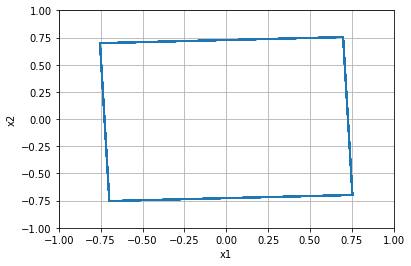


=================== Rollout 1518 =====================
x_init [[0.16]
 [0.56]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.16 0.56]
xx [0.16 0.56]
xxx [0.16 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.56]


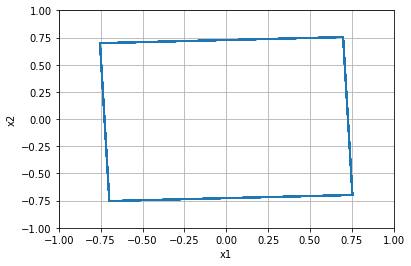


=================== Rollout 1519 =====================
x_init [[0.16]
 [0.6 ]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.16 0.6 ]
xx [0.16 0.6 ]
xxx [0.16 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.6000000000000001]


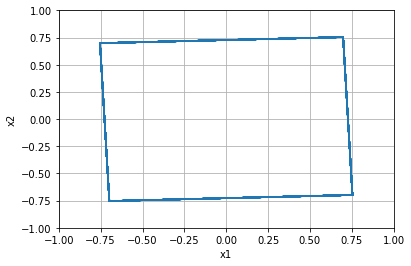


=================== Rollout 1520 =====================
x_init [[0.16]
 [0.64]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.16 0.64]
xx [0.16 0.64]
xxx [0.16 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.6400000000000001]


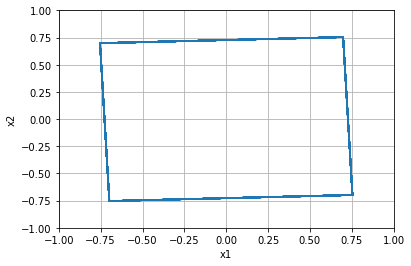


=================== Rollout 1521 =====================
x_init [[0.16]
 [0.68]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.16 0.68]
xx [0.16 0.68]
xxx [0.16 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.6799999999999999]


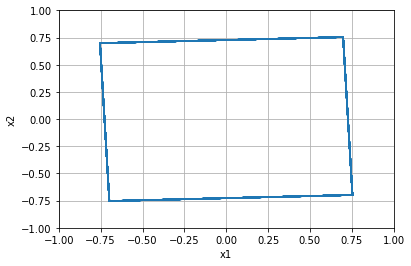


=================== Rollout 1522 =====================
x_init [[0.16]
 [0.72]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.16 0.72]
xx [0.16 0.72]
xxx [0.16 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.72]


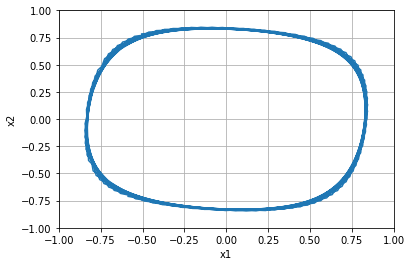


=================== Rollout 1523 =====================
x_init [[0.16]
 [0.76]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.16 0.76]
xx [0.16 0.76]
xxx [0.16 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.76]


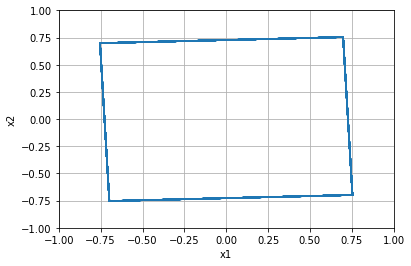


=================== Rollout 1524 =====================
x_init [[0.16]
 [0.8 ]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.16 0.8 ]
xx [0.16 0.8 ]
xxx [0.16 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.8]


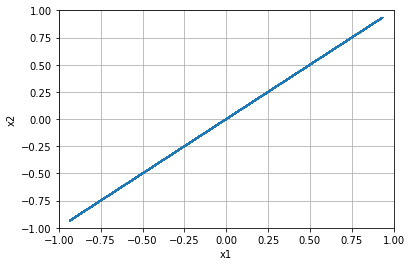


=================== Rollout 1525 =====================
x_init [[0.16]
 [0.84]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.16 0.84]
xx [0.16 0.84]
xxx [0.16 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.8400000000000001]


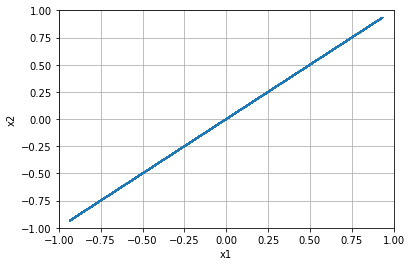


=================== Rollout 1526 =====================
x_init [[0.16]
 [0.88]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.16 0.88]
xx [0.16 0.88]
xxx [0.16 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.8800000000000001]


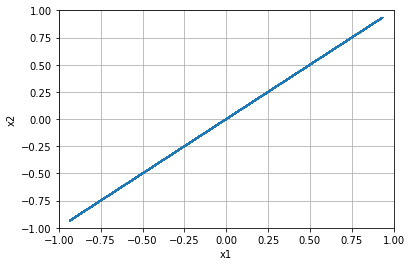


=================== Rollout 1527 =====================
x_init [[0.16]
 [0.92]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.16 0.92]
xx [0.16 0.92]
xxx [0.16 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.9199999999999999]


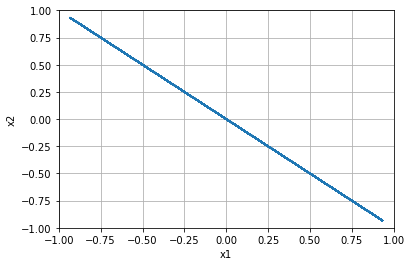


=================== Rollout 1528 =====================
x_init [[0.16]
 [0.96]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.16 0.96]
xx [0.16 0.96]
xxx [0.16 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 0.96]


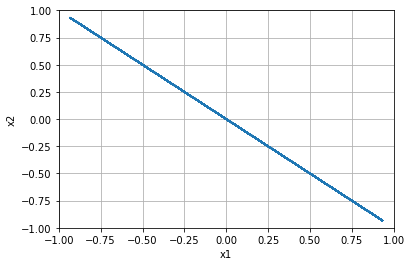


=================== Rollout 1529 =====================
x_init [[0.16]
 [1.  ]]
x_buffer [[0.16 0.16 0.16 0.16 0.16]
 [1.   1.   1.   1.   1.  ]]
x [0.16 1.  ]
xx [0.16 1.  ]
xxx [0.16 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.15999999999999992, 1.0]


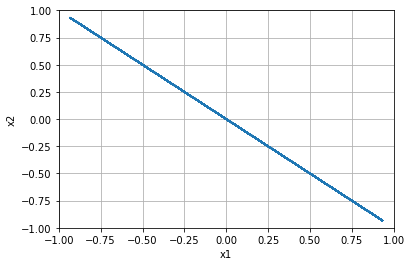


=================== Rollout 1530 =====================
x_init [[ 0.2]
 [-1. ]]
x_buffer [[ 0.2  0.2  0.2  0.2  0.2]
 [-1.  -1.  -1.  -1.  -1. ]]
x [ 0.2 -1. ]
xx [ 0.2 -1. ]
xxx [ 0.2 -1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -1.0]


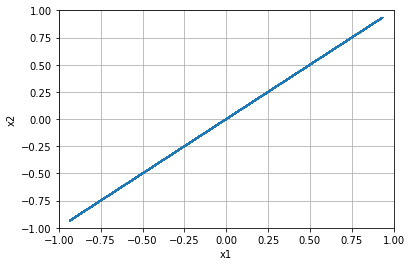


=================== Rollout 1531 =====================
x_init [[ 0.2 ]
 [-0.96]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.2  -0.96]
xx [ 0.2  -0.96]
xxx [ 0.2  -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.96]


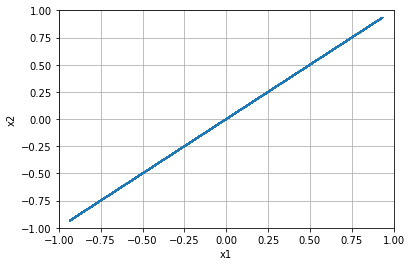


=================== Rollout 1532 =====================
x_init [[ 0.2 ]
 [-0.92]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.2  -0.92]
xx [ 0.2  -0.92]
xxx [ 0.2  -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.92]


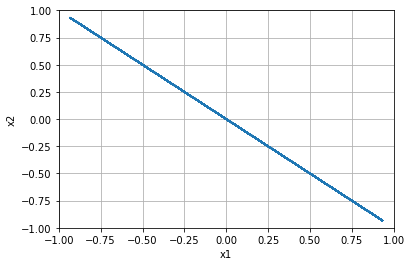


=================== Rollout 1533 =====================
x_init [[ 0.2 ]
 [-0.88]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.2  -0.88]
xx [ 0.2  -0.88]
xxx [ 0.2  -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.88]


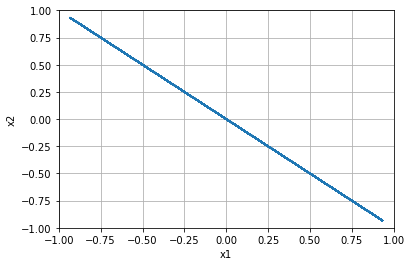


=================== Rollout 1534 =====================
x_init [[ 0.2 ]
 [-0.84]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.2  -0.84]
xx [ 0.2  -0.84]
xxx [ 0.2  -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.84]


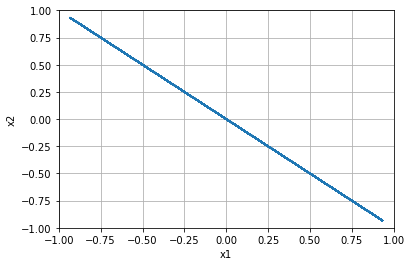


=================== Rollout 1535 =====================
x_init [[ 0.2]
 [-0.8]]
x_buffer [[ 0.2  0.2  0.2  0.2  0.2]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [ 0.2 -0.8]
xx [ 0.2 -0.8]
xxx [ 0.2 -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.8]


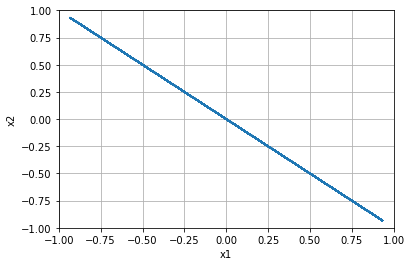


=================== Rollout 1536 =====================
x_init [[ 0.2 ]
 [-0.76]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.2  -0.76]
xx [ 0.2  -0.76]
xxx [ 0.2  -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.76]


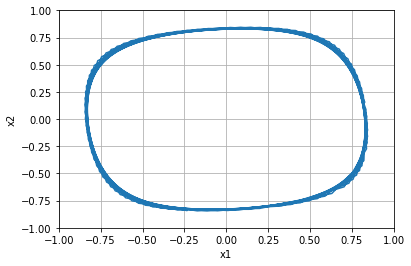


=================== Rollout 1537 =====================
x_init [[ 0.2 ]
 [-0.72]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.2  -0.72]
xx [ 0.2  -0.72]
xxx [ 0.2  -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.72]


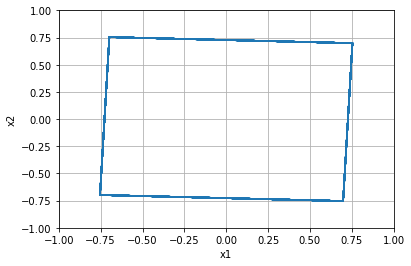


=================== Rollout 1538 =====================
x_init [[ 0.2 ]
 [-0.68]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.2  -0.68]
xx [ 0.2  -0.68]
xxx [ 0.2  -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.6799999999999999]


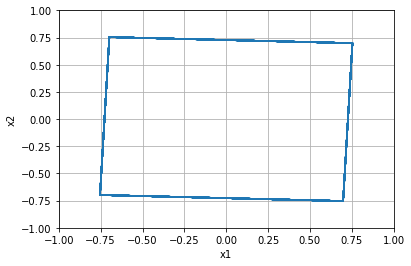


=================== Rollout 1539 =====================
x_init [[ 0.2 ]
 [-0.64]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.2  -0.64]
xx [ 0.2  -0.64]
xxx [ 0.2  -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.64]


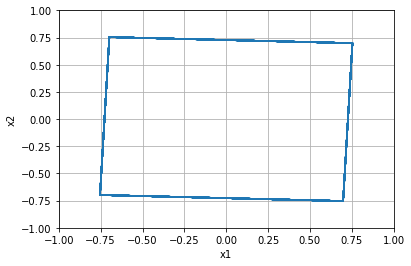


=================== Rollout 1540 =====================
x_init [[ 0.2]
 [-0.6]]
x_buffer [[ 0.2  0.2  0.2  0.2  0.2]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [ 0.2 -0.6]
xx [ 0.2 -0.6]
xxx [ 0.2 -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.6]


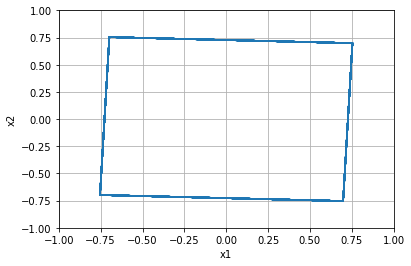


=================== Rollout 1541 =====================
x_init [[ 0.2 ]
 [-0.56]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.2  -0.56]
xx [ 0.2  -0.56]
xxx [ 0.2  -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.56]


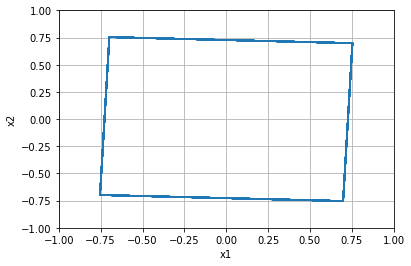


=================== Rollout 1542 =====================
x_init [[ 0.2 ]
 [-0.52]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.2  -0.52]
xx [ 0.2  -0.52]
xxx [ 0.2  -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.52]


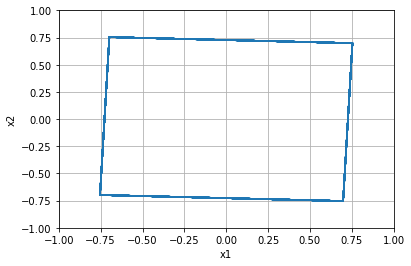


=================== Rollout 1543 =====================
x_init [[ 0.2 ]
 [-0.48]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.2  -0.48]
xx [ 0.2  -0.48]
xxx [ 0.2  -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.48]


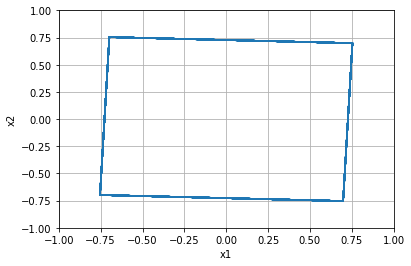


=================== Rollout 1544 =====================
x_init [[ 0.2 ]
 [-0.44]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.2  -0.44]
xx [ 0.2  -0.44]
xxx [ 0.2  -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.43999999999999995]


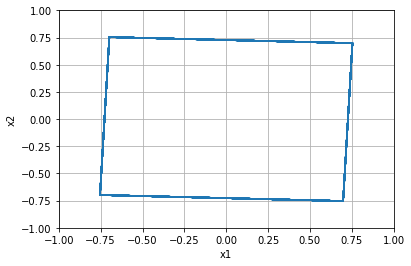


=================== Rollout 1545 =====================
x_init [[ 0.2]
 [-0.4]]
x_buffer [[ 0.2  0.2  0.2  0.2  0.2]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [ 0.2 -0.4]
xx [ 0.2 -0.4]
xxx [ 0.2 -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.4]


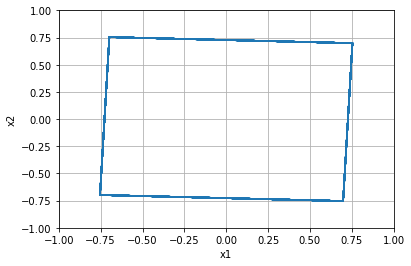


=================== Rollout 1546 =====================
x_init [[ 0.2 ]
 [-0.36]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.2  -0.36]
xx [ 0.2  -0.36]
xxx [ 0.2  -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.36]


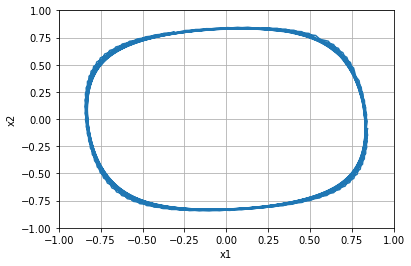


=================== Rollout 1547 =====================
x_init [[ 0.2 ]
 [-0.32]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.2  -0.32]
xx [ 0.2  -0.32]
xxx [ 0.2  -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.31999999999999995]


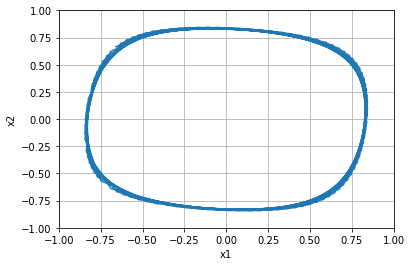


=================== Rollout 1548 =====================
x_init [[ 0.2 ]
 [-0.28]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.2  -0.28]
xx [ 0.2  -0.28]
xxx [ 0.2  -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.28]


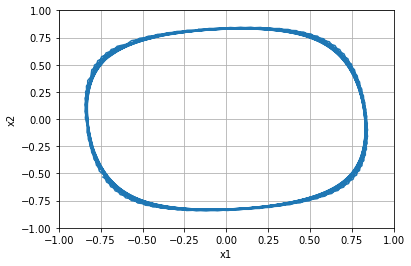


=================== Rollout 1549 =====================
x_init [[ 0.2 ]
 [-0.24]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.2  -0.24]
xx [ 0.2  -0.24]
xxx [ 0.2  -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.24]


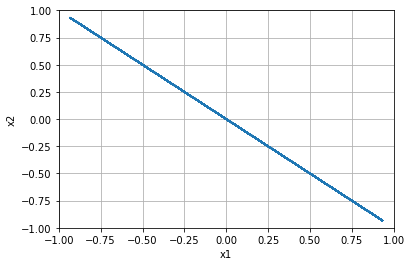


=================== Rollout 1550 =====================
x_init [[ 0.2]
 [-0.2]]
x_buffer [[ 0.2  0.2  0.2  0.2  0.2]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [ 0.2 -0.2]
xx [ 0.2 -0.2]
xxx [ 0.2 -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.19999999999999996]


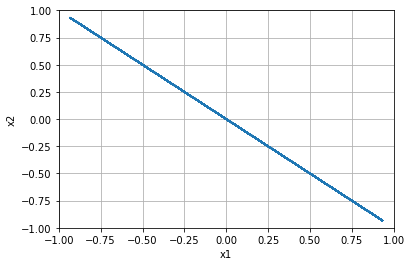


=================== Rollout 1551 =====================
x_init [[ 0.2 ]
 [-0.16]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.2  -0.16]
xx [ 0.2  -0.16]
xxx [ 0.2  -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.16000000000000003]


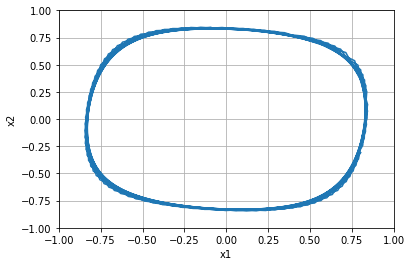


=================== Rollout 1552 =====================
x_init [[ 0.2 ]
 [-0.12]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.2  -0.12]
xx [ 0.2  -0.12]
xxx [ 0.2  -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.12]


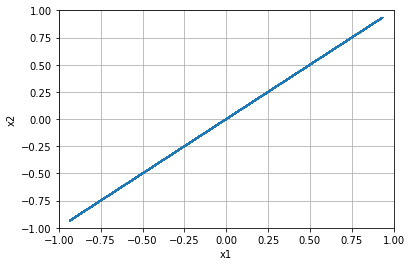


=================== Rollout 1553 =====================
x_init [[ 0.2 ]
 [-0.08]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.2  -0.08]
xx [ 0.2  -0.08]
xxx [ 0.2  -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.07999999999999996]


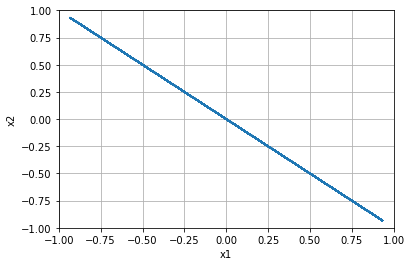


=================== Rollout 1554 =====================
x_init [[ 0.2 ]
 [-0.04]]
x_buffer [[ 0.2   0.2   0.2   0.2   0.2 ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.2  -0.04]
xx [ 0.2  -0.04]
xxx [ 0.2  -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, -0.040000000000000036]


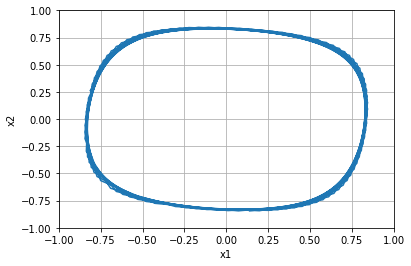


=================== Rollout 1555 =====================
x_init [[0.2]
 [0. ]]
x_buffer [[0.2 0.2 0.2 0.2 0.2]
 [0.  0.  0.  0.  0. ]]
x [0.2 0. ]
xx [0.2 0. ]
xxx [0.2 0. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.0]


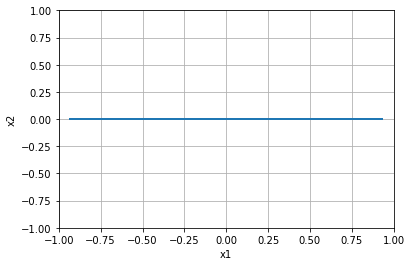


=================== Rollout 1556 =====================
x_init [[0.2 ]
 [0.04]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.2  0.04]
xx [0.2  0.04]
xxx [0.2  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.040000000000000036]


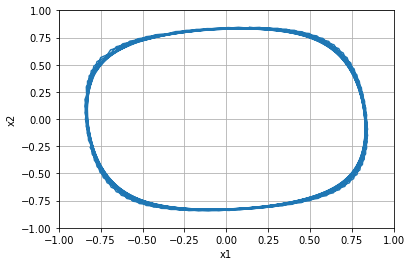


=================== Rollout 1557 =====================
x_init [[0.2 ]
 [0.08]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.2  0.08]
xx [0.2  0.08]
xxx [0.2  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.08000000000000007]


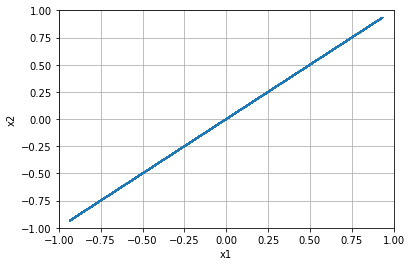


=================== Rollout 1558 =====================
x_init [[0.2 ]
 [0.12]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.2  0.12]
xx [0.2  0.12]
xxx [0.2  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.1200000000000001]


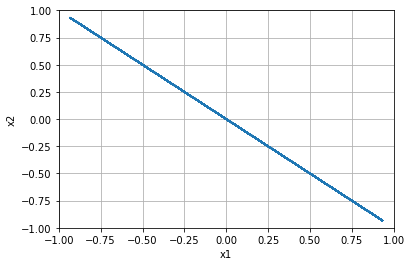


=================== Rollout 1559 =====================
x_init [[0.2 ]
 [0.16]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.2  0.16]
xx [0.2  0.16]
xxx [0.2  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.15999999999999992]


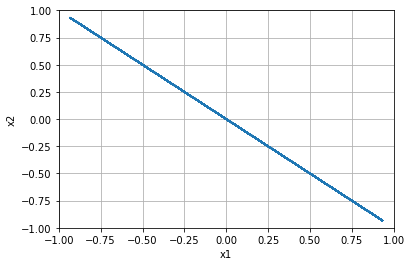


=================== Rollout 1560 =====================
x_init [[0.2]
 [0.2]]
x_buffer [[0.2 0.2 0.2 0.2 0.2]
 [0.2 0.2 0.2 0.2 0.2]]
x [0.2 0.2]
xx [0.2 0.2]
xxx [0.2 0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.19999999999999996]


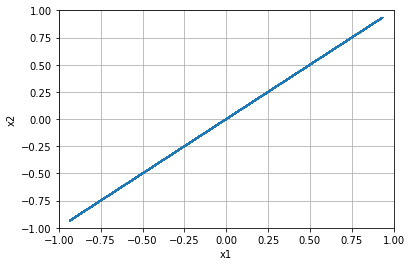


=================== Rollout 1561 =====================
x_init [[0.2 ]
 [0.24]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.2  0.24]
xx [0.2  0.24]
xxx [0.2  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.24]


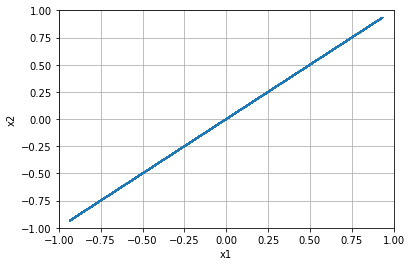


=================== Rollout 1562 =====================
x_init [[0.2 ]
 [0.28]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.2  0.28]
xx [0.2  0.28]
xxx [0.2  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.28]


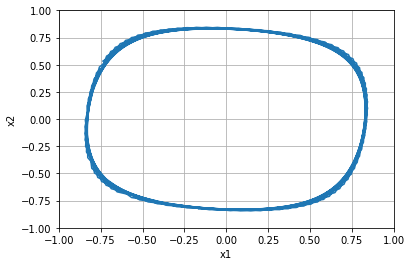


=================== Rollout 1563 =====================
x_init [[0.2 ]
 [0.32]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.2  0.32]
xx [0.2  0.32]
xxx [0.2  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.32000000000000006]


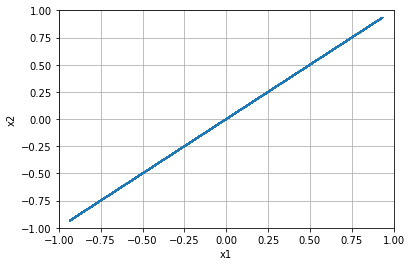


=================== Rollout 1564 =====================
x_init [[0.2 ]
 [0.36]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.2  0.36]
xx [0.2  0.36]
xxx [0.2  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.3600000000000001]


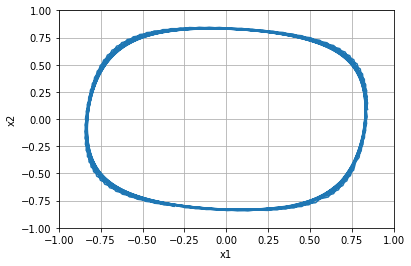


=================== Rollout 1565 =====================
x_init [[0.2]
 [0.4]]
x_buffer [[0.2 0.2 0.2 0.2 0.2]
 [0.4 0.4 0.4 0.4 0.4]]
x [0.2 0.4]
xx [0.2 0.4]
xxx [0.2 0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.40000000000000013]


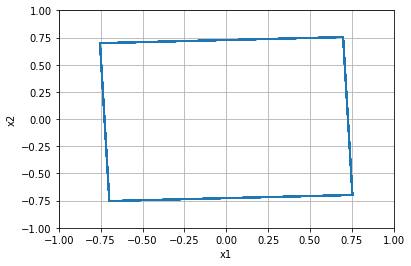


=================== Rollout 1566 =====================
x_init [[0.2 ]
 [0.44]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.2  0.44]
xx [0.2  0.44]
xxx [0.2  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.43999999999999995]


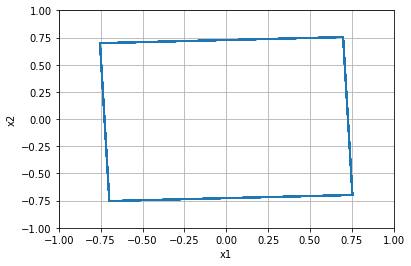


=================== Rollout 1567 =====================
x_init [[0.2 ]
 [0.48]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.2  0.48]
xx [0.2  0.48]
xxx [0.2  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.48]


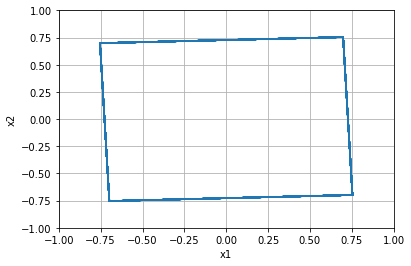


=================== Rollout 1568 =====================
x_init [[0.2 ]
 [0.52]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.2  0.52]
xx [0.2  0.52]
xxx [0.2  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.52]


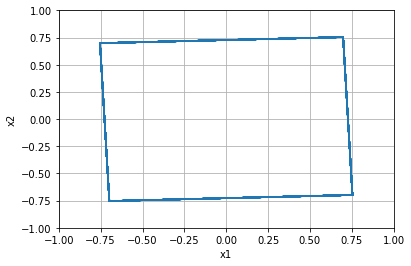


=================== Rollout 1569 =====================
x_init [[0.2 ]
 [0.56]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.2  0.56]
xx [0.2  0.56]
xxx [0.2  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.56]


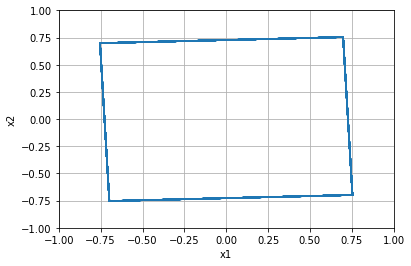


=================== Rollout 1570 =====================
x_init [[0.2]
 [0.6]]
x_buffer [[0.2 0.2 0.2 0.2 0.2]
 [0.6 0.6 0.6 0.6 0.6]]
x [0.2 0.6]
xx [0.2 0.6]
xxx [0.2 0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.6000000000000001]


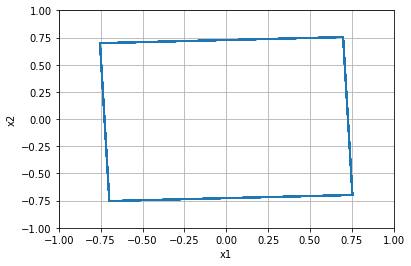


=================== Rollout 1571 =====================
x_init [[0.2 ]
 [0.64]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.2  0.64]
xx [0.2  0.64]
xxx [0.2  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.6400000000000001]


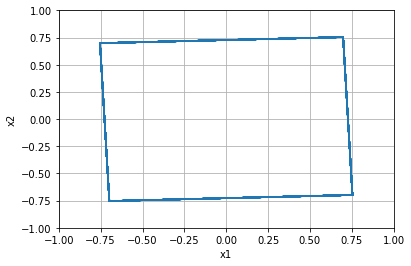


=================== Rollout 1572 =====================
x_init [[0.2 ]
 [0.68]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.2  0.68]
xx [0.2  0.68]
xxx [0.2  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.6799999999999999]


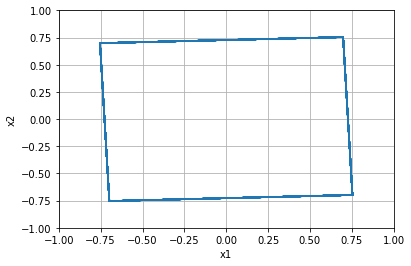


=================== Rollout 1573 =====================
x_init [[0.2 ]
 [0.72]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.2  0.72]
xx [0.2  0.72]
xxx [0.2  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.72]


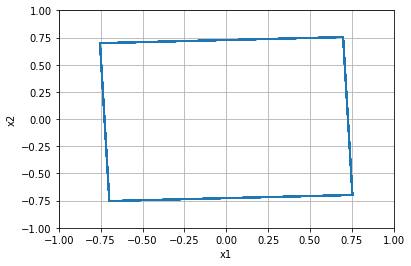


=================== Rollout 1574 =====================
x_init [[0.2 ]
 [0.76]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.2  0.76]
xx [0.2  0.76]
xxx [0.2  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.76]


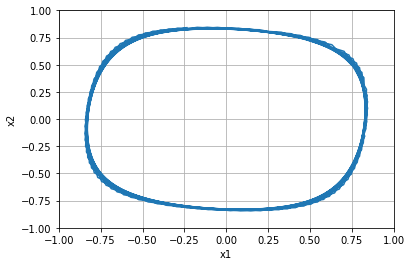


=================== Rollout 1575 =====================
x_init [[0.2]
 [0.8]]
x_buffer [[0.2 0.2 0.2 0.2 0.2]
 [0.8 0.8 0.8 0.8 0.8]]
x [0.2 0.8]
xx [0.2 0.8]
xxx [0.2 0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.8]


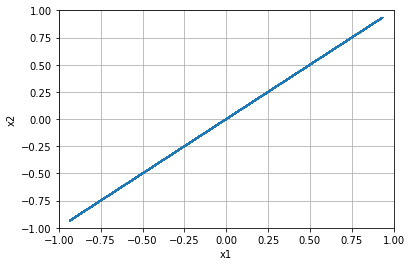


=================== Rollout 1576 =====================
x_init [[0.2 ]
 [0.84]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.2  0.84]
xx [0.2  0.84]
xxx [0.2  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.8400000000000001]


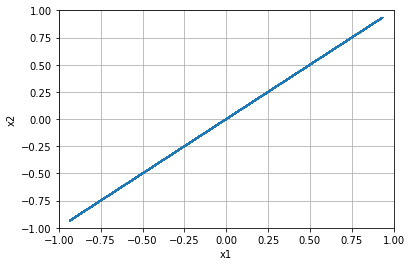


=================== Rollout 1577 =====================
x_init [[0.2 ]
 [0.88]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.2  0.88]
xx [0.2  0.88]
xxx [0.2  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.8800000000000001]


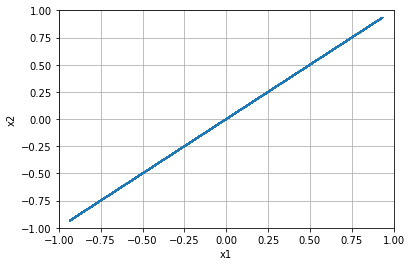


=================== Rollout 1578 =====================
x_init [[0.2 ]
 [0.92]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.2  0.92]
xx [0.2  0.92]
xxx [0.2  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.9199999999999999]


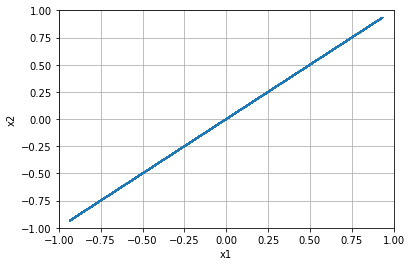


=================== Rollout 1579 =====================
x_init [[0.2 ]
 [0.96]]
x_buffer [[0.2  0.2  0.2  0.2  0.2 ]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.2  0.96]
xx [0.2  0.96]
xxx [0.2  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 0.96]


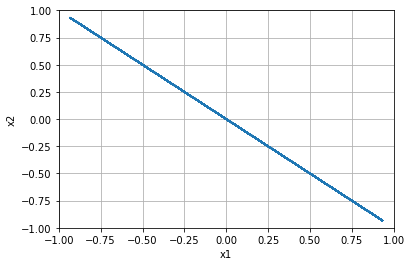


=================== Rollout 1580 =====================
x_init [[0.2]
 [1. ]]
x_buffer [[0.2 0.2 0.2 0.2 0.2]
 [1.  1.  1.  1.  1. ]]
x [0.2 1. ]
xx [0.2 1. ]
xxx [0.2 1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.19999999999999996, 1.0]


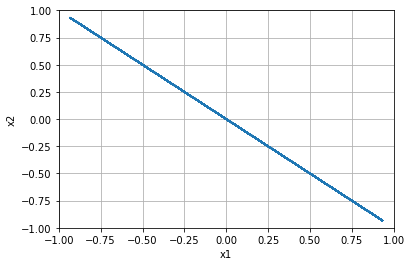


=================== Rollout 1581 =====================
x_init [[ 0.24]
 [-1.  ]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.24 -1.  ]
xx [ 0.24 -1.  ]
xxx [ 0.24 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -1.0]


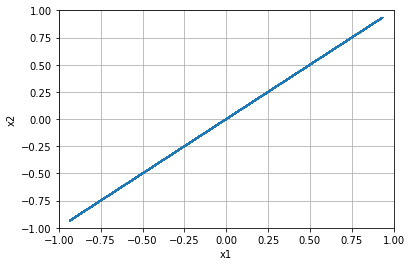


=================== Rollout 1582 =====================
x_init [[ 0.24]
 [-0.96]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.24 -0.96]
xx [ 0.24 -0.96]
xxx [ 0.24 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.96]


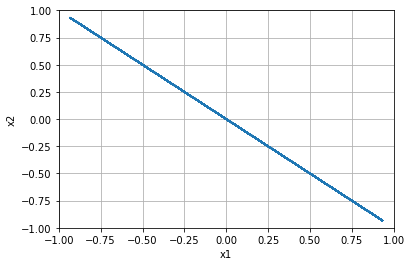


=================== Rollout 1583 =====================
x_init [[ 0.24]
 [-0.92]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.24 -0.92]
xx [ 0.24 -0.92]
xxx [ 0.24 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.92]


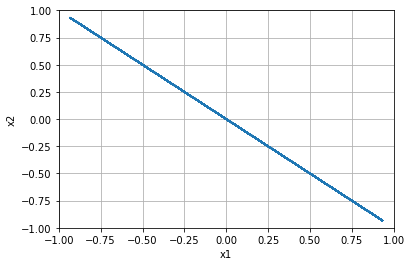


=================== Rollout 1584 =====================
x_init [[ 0.24]
 [-0.88]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.24 -0.88]
xx [ 0.24 -0.88]
xxx [ 0.24 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.88]


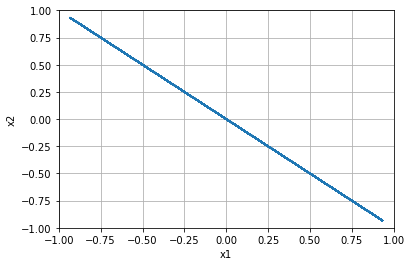


=================== Rollout 1585 =====================
x_init [[ 0.24]
 [-0.84]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.24 -0.84]
xx [ 0.24 -0.84]
xxx [ 0.24 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.84]


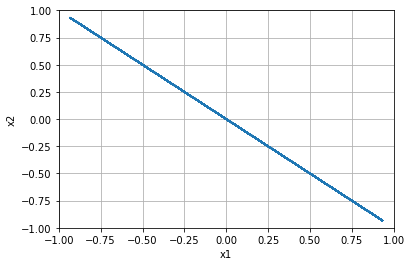


=================== Rollout 1586 =====================
x_init [[ 0.24]
 [-0.8 ]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.24 -0.8 ]
xx [ 0.24 -0.8 ]
xxx [ 0.24 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.8]


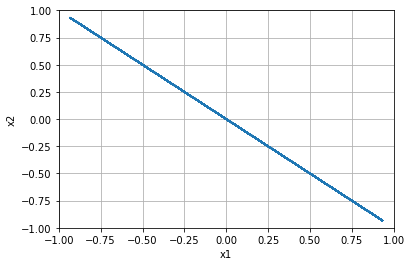


=================== Rollout 1587 =====================
x_init [[ 0.24]
 [-0.76]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.24 -0.76]
xx [ 0.24 -0.76]
xxx [ 0.24 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.76]


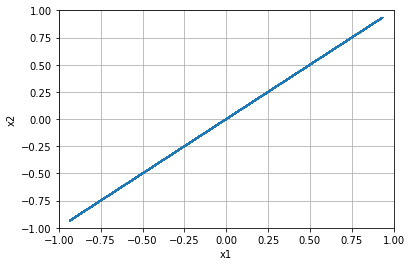


=================== Rollout 1588 =====================
x_init [[ 0.24]
 [-0.72]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.24 -0.72]
xx [ 0.24 -0.72]
xxx [ 0.24 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.72]


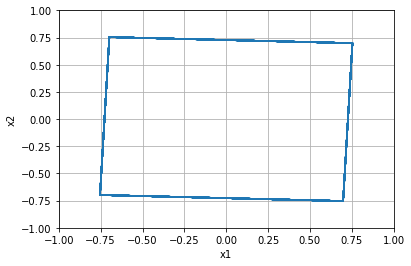


=================== Rollout 1589 =====================
x_init [[ 0.24]
 [-0.68]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.24 -0.68]
xx [ 0.24 -0.68]
xxx [ 0.24 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.6799999999999999]


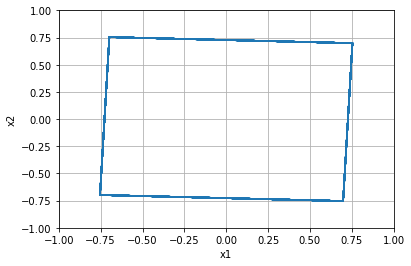


=================== Rollout 1590 =====================
x_init [[ 0.24]
 [-0.64]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.24 -0.64]
xx [ 0.24 -0.64]
xxx [ 0.24 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.64]


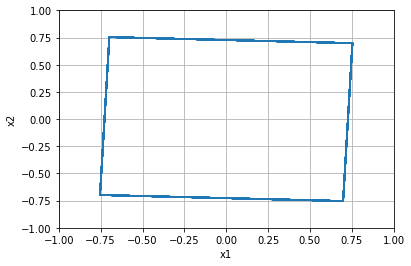


=================== Rollout 1591 =====================
x_init [[ 0.24]
 [-0.6 ]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.24 -0.6 ]
xx [ 0.24 -0.6 ]
xxx [ 0.24 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.6]


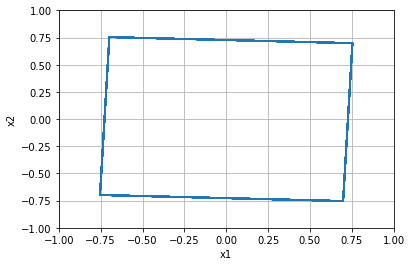


=================== Rollout 1592 =====================
x_init [[ 0.24]
 [-0.56]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.24 -0.56]
xx [ 0.24 -0.56]
xxx [ 0.24 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.56]


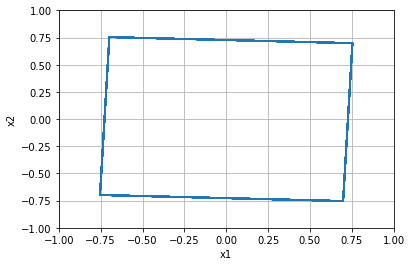


=================== Rollout 1593 =====================
x_init [[ 0.24]
 [-0.52]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.24 -0.52]
xx [ 0.24 -0.52]
xxx [ 0.24 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.52]


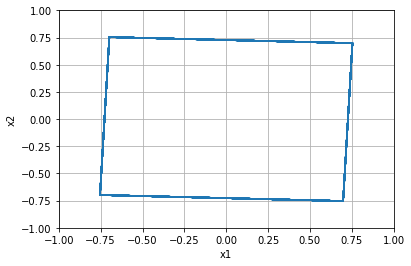


=================== Rollout 1594 =====================
x_init [[ 0.24]
 [-0.48]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.24 -0.48]
xx [ 0.24 -0.48]
xxx [ 0.24 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.48]


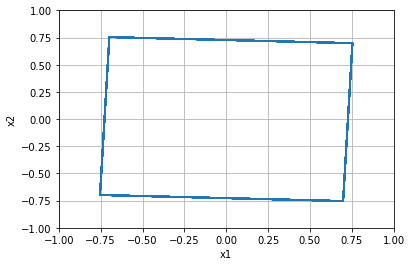


=================== Rollout 1595 =====================
x_init [[ 0.24]
 [-0.44]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.24 -0.44]
xx [ 0.24 -0.44]
xxx [ 0.24 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.43999999999999995]


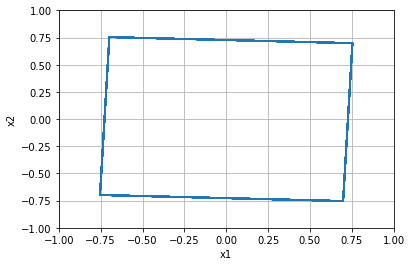


=================== Rollout 1596 =====================
x_init [[ 0.24]
 [-0.4 ]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.24 -0.4 ]
xx [ 0.24 -0.4 ]
xxx [ 0.24 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.4]


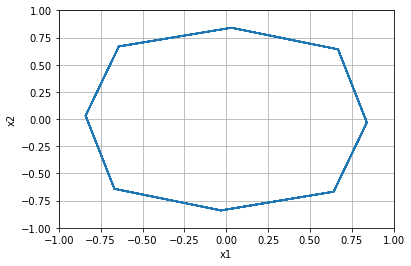


=================== Rollout 1597 =====================
x_init [[ 0.24]
 [-0.36]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.24 -0.36]
xx [ 0.24 -0.36]
xxx [ 0.24 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.36]


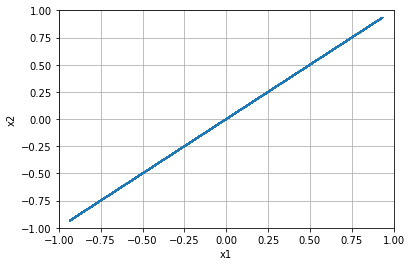


=================== Rollout 1598 =====================
x_init [[ 0.24]
 [-0.32]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.24 -0.32]
xx [ 0.24 -0.32]
xxx [ 0.24 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.31999999999999995]


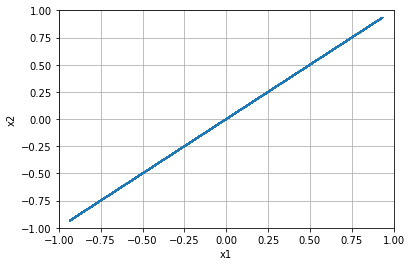


=================== Rollout 1599 =====================
x_init [[ 0.24]
 [-0.28]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.24 -0.28]
xx [ 0.24 -0.28]
xxx [ 0.24 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.28]


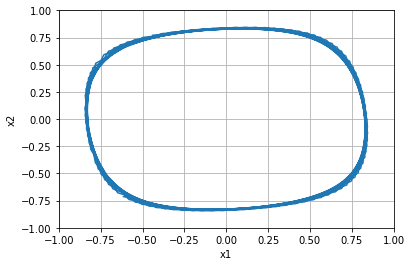


=================== Rollout 1600 =====================
x_init [[ 0.24]
 [-0.24]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.24 -0.24]
xx [ 0.24 -0.24]
xxx [ 0.24 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.24]


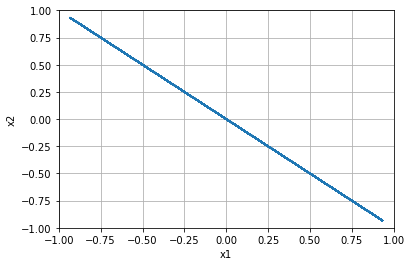


=================== Rollout 1601 =====================
x_init [[ 0.24]
 [-0.2 ]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.24 -0.2 ]
xx [ 0.24 -0.2 ]
xxx [ 0.24 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.19999999999999996]


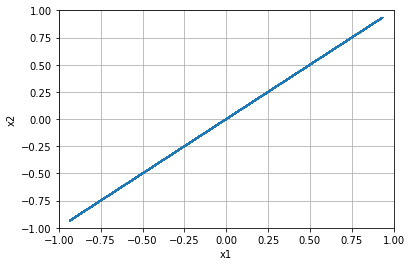


=================== Rollout 1602 =====================
x_init [[ 0.24]
 [-0.16]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.24 -0.16]
xx [ 0.24 -0.16]
xxx [ 0.24 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.16000000000000003]


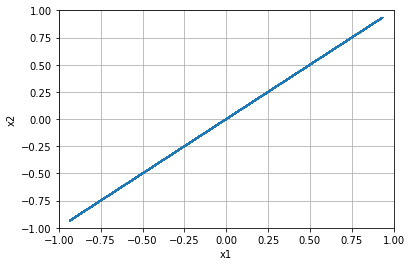


=================== Rollout 1603 =====================
x_init [[ 0.24]
 [-0.12]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.24 -0.12]
xx [ 0.24 -0.12]
xxx [ 0.24 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.12]


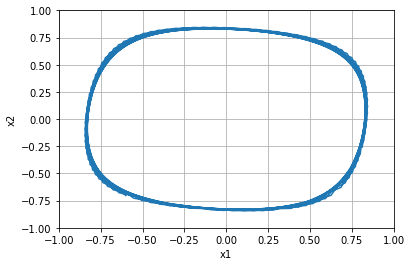


=================== Rollout 1604 =====================
x_init [[ 0.24]
 [-0.08]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.24 -0.08]
xx [ 0.24 -0.08]
xxx [ 0.24 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.07999999999999996]


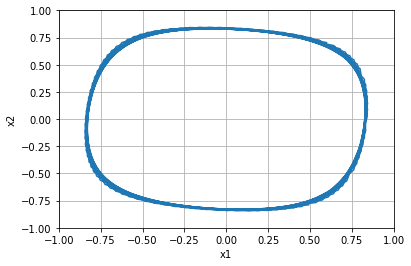


=================== Rollout 1605 =====================
x_init [[ 0.24]
 [-0.04]]
x_buffer [[ 0.24  0.24  0.24  0.24  0.24]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.24 -0.04]
xx [ 0.24 -0.04]
xxx [ 0.24 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, -0.040000000000000036]


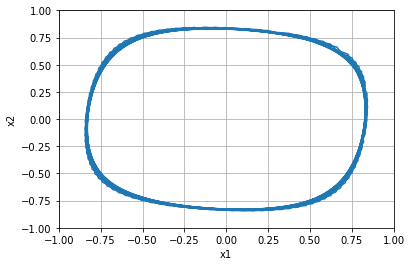


=================== Rollout 1606 =====================
x_init [[0.24]
 [0.  ]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.   0.   0.   0.   0.  ]]
x [0.24 0.  ]
xx [0.24 0.  ]
xxx [0.24 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.0]


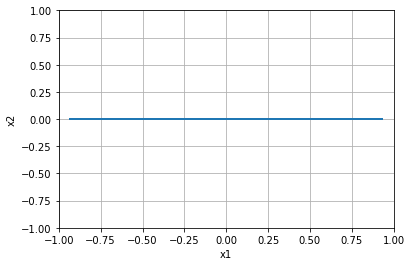


=================== Rollout 1607 =====================
x_init [[0.24]
 [0.04]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.24 0.04]
xx [0.24 0.04]
xxx [0.24 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.040000000000000036]


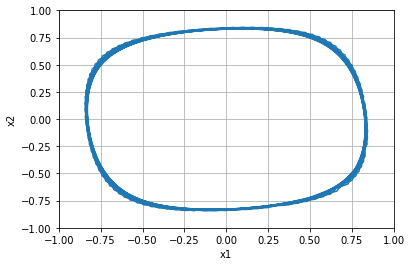


=================== Rollout 1608 =====================
x_init [[0.24]
 [0.08]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.24 0.08]
xx [0.24 0.08]
xxx [0.24 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.08000000000000007]


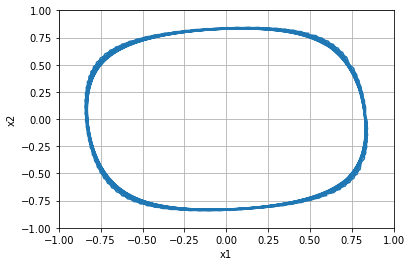


=================== Rollout 1609 =====================
x_init [[0.24]
 [0.12]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.24 0.12]
xx [0.24 0.12]
xxx [0.24 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.1200000000000001]


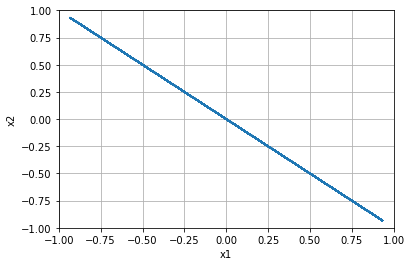


=================== Rollout 1610 =====================
x_init [[0.24]
 [0.16]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.24 0.16]
xx [0.24 0.16]
xxx [0.24 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.15999999999999992]


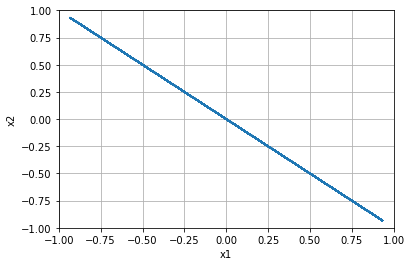


=================== Rollout 1611 =====================
x_init [[0.24]
 [0.2 ]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.24 0.2 ]
xx [0.24 0.2 ]
xxx [0.24 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.19999999999999996]


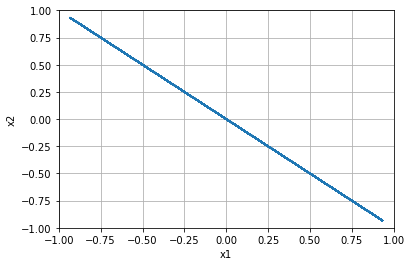


=================== Rollout 1612 =====================
x_init [[0.24]
 [0.24]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.24 0.24]
xx [0.24 0.24]
xxx [0.24 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.24]


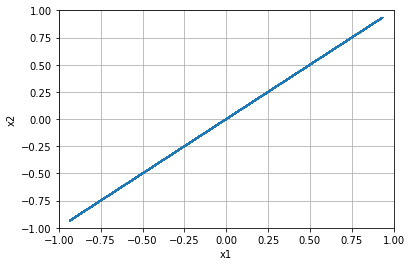


=================== Rollout 1613 =====================
x_init [[0.24]
 [0.28]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.24 0.28]
xx [0.24 0.28]
xxx [0.24 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.28]


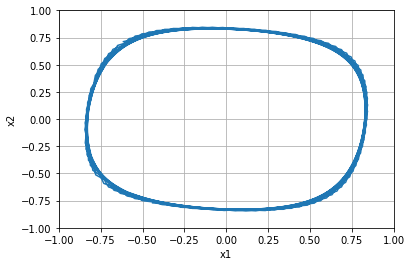


=================== Rollout 1614 =====================
x_init [[0.24]
 [0.32]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.24 0.32]
xx [0.24 0.32]
xxx [0.24 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.32000000000000006]


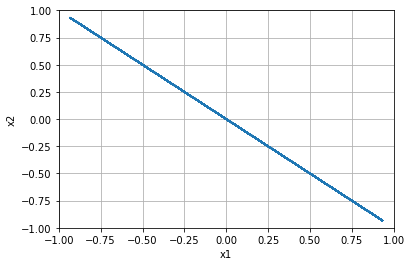


=================== Rollout 1615 =====================
x_init [[0.24]
 [0.36]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.24 0.36]
xx [0.24 0.36]
xxx [0.24 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.3600000000000001]


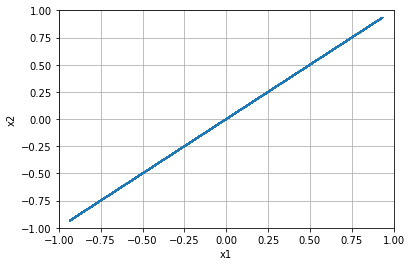


=================== Rollout 1616 =====================
x_init [[0.24]
 [0.4 ]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.24 0.4 ]
xx [0.24 0.4 ]
xxx [0.24 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.40000000000000013]


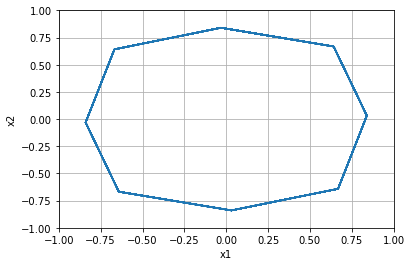


=================== Rollout 1617 =====================
x_init [[0.24]
 [0.44]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.24 0.44]
xx [0.24 0.44]
xxx [0.24 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.43999999999999995]


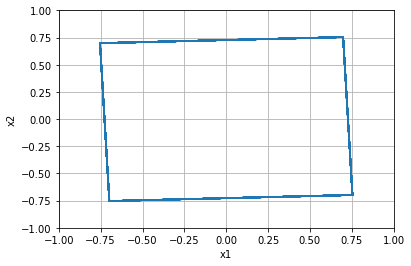


=================== Rollout 1618 =====================
x_init [[0.24]
 [0.48]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.24 0.48]
xx [0.24 0.48]
xxx [0.24 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.48]


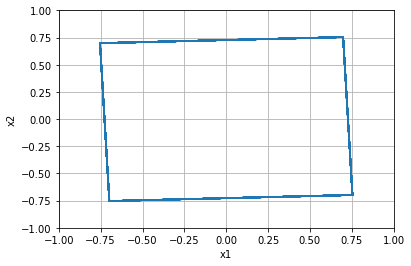


=================== Rollout 1619 =====================
x_init [[0.24]
 [0.52]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.24 0.52]
xx [0.24 0.52]
xxx [0.24 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.52]


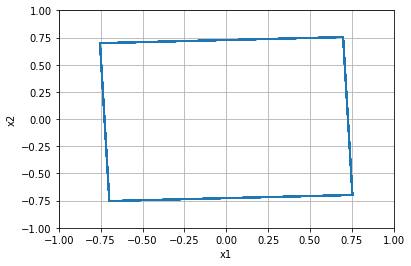


=================== Rollout 1620 =====================
x_init [[0.24]
 [0.56]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.24 0.56]
xx [0.24 0.56]
xxx [0.24 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.56]


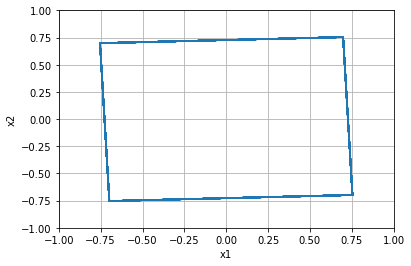


=================== Rollout 1621 =====================
x_init [[0.24]
 [0.6 ]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.24 0.6 ]
xx [0.24 0.6 ]
xxx [0.24 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.6000000000000001]


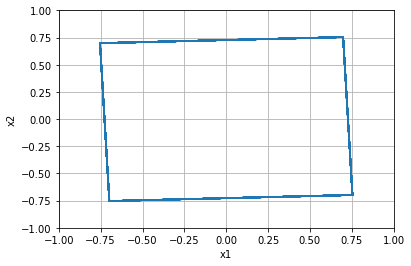


=================== Rollout 1622 =====================
x_init [[0.24]
 [0.64]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.24 0.64]
xx [0.24 0.64]
xxx [0.24 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.6400000000000001]


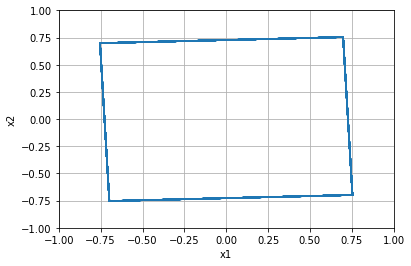


=================== Rollout 1623 =====================
x_init [[0.24]
 [0.68]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.24 0.68]
xx [0.24 0.68]
xxx [0.24 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.6799999999999999]


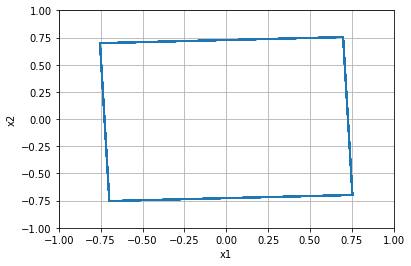


=================== Rollout 1624 =====================
x_init [[0.24]
 [0.72]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.24 0.72]
xx [0.24 0.72]
xxx [0.24 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.72]


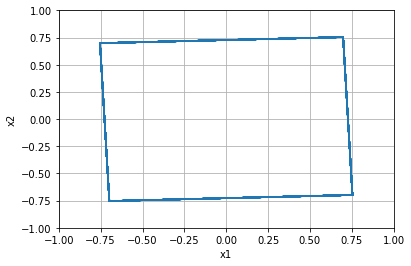


=================== Rollout 1625 =====================
x_init [[0.24]
 [0.76]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.24 0.76]
xx [0.24 0.76]
xxx [0.24 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.76]


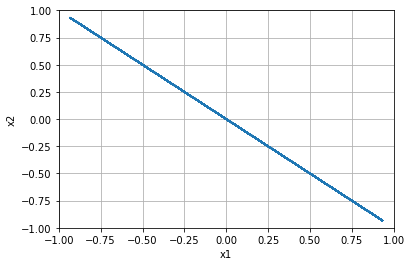


=================== Rollout 1626 =====================
x_init [[0.24]
 [0.8 ]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.24 0.8 ]
xx [0.24 0.8 ]
xxx [0.24 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.8]


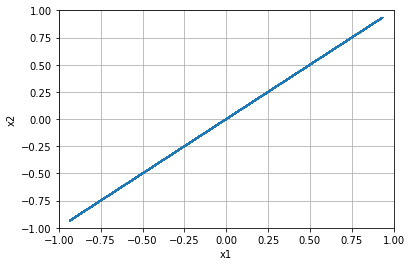


=================== Rollout 1627 =====================
x_init [[0.24]
 [0.84]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.24 0.84]
xx [0.24 0.84]
xxx [0.24 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.8400000000000001]


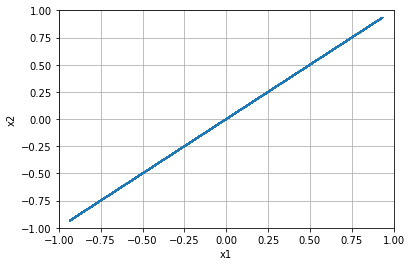


=================== Rollout 1628 =====================
x_init [[0.24]
 [0.88]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.24 0.88]
xx [0.24 0.88]
xxx [0.24 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.8800000000000001]


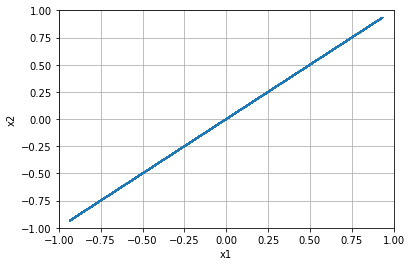


=================== Rollout 1629 =====================
x_init [[0.24]
 [0.92]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.24 0.92]
xx [0.24 0.92]
xxx [0.24 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.9199999999999999]


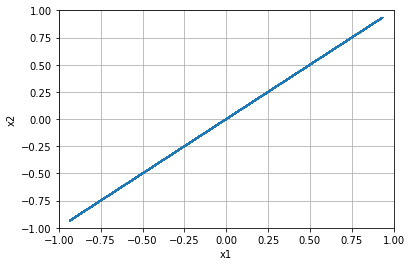


=================== Rollout 1630 =====================
x_init [[0.24]
 [0.96]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.24 0.96]
xx [0.24 0.96]
xxx [0.24 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 0.96]


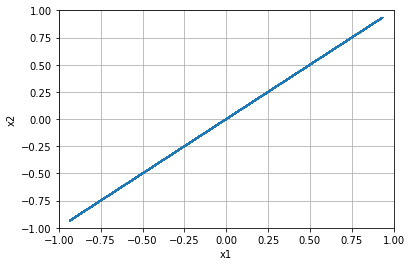


=================== Rollout 1631 =====================
x_init [[0.24]
 [1.  ]]
x_buffer [[0.24 0.24 0.24 0.24 0.24]
 [1.   1.   1.   1.   1.  ]]
x [0.24 1.  ]
xx [0.24 1.  ]
xxx [0.24 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.24, 1.0]


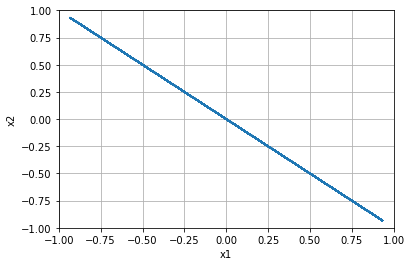


=================== Rollout 1632 =====================
x_init [[ 0.28]
 [-1.  ]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.28 -1.  ]
xx [ 0.28 -1.  ]
xxx [ 0.28 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -1.0]


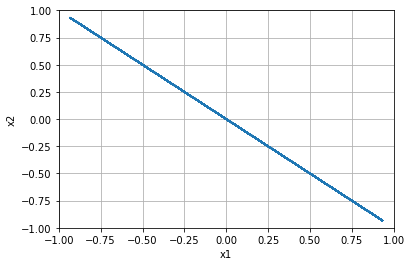


=================== Rollout 1633 =====================
x_init [[ 0.28]
 [-0.96]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.28 -0.96]
xx [ 0.28 -0.96]
xxx [ 0.28 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.96]


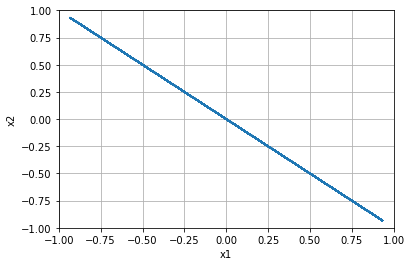


=================== Rollout 1634 =====================
x_init [[ 0.28]
 [-0.92]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.28 -0.92]
xx [ 0.28 -0.92]
xxx [ 0.28 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.92]


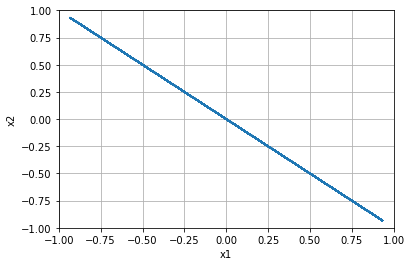


=================== Rollout 1635 =====================
x_init [[ 0.28]
 [-0.88]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.28 -0.88]
xx [ 0.28 -0.88]
xxx [ 0.28 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.88]


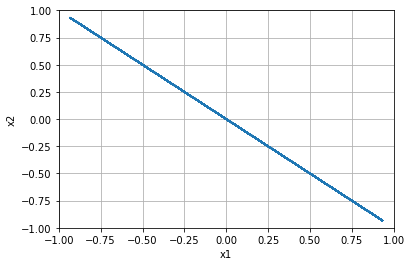


=================== Rollout 1636 =====================
x_init [[ 0.28]
 [-0.84]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.28 -0.84]
xx [ 0.28 -0.84]
xxx [ 0.28 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.84]


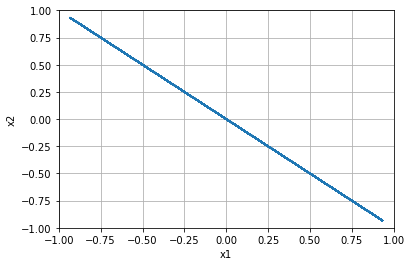


=================== Rollout 1637 =====================
x_init [[ 0.28]
 [-0.8 ]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.28 -0.8 ]
xx [ 0.28 -0.8 ]
xxx [ 0.28 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.8]


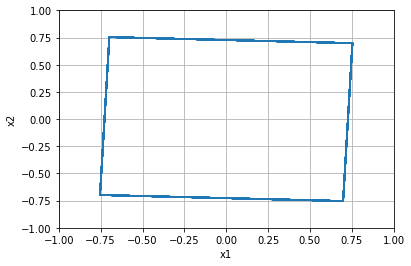


=================== Rollout 1638 =====================
x_init [[ 0.28]
 [-0.76]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.28 -0.76]
xx [ 0.28 -0.76]
xxx [ 0.28 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.76]


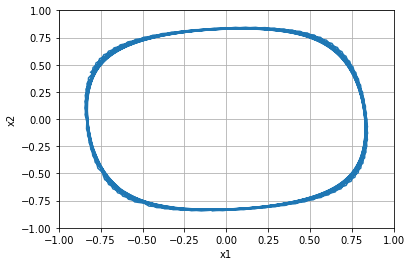


=================== Rollout 1639 =====================
x_init [[ 0.28]
 [-0.72]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.28 -0.72]
xx [ 0.28 -0.72]
xxx [ 0.28 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.72]


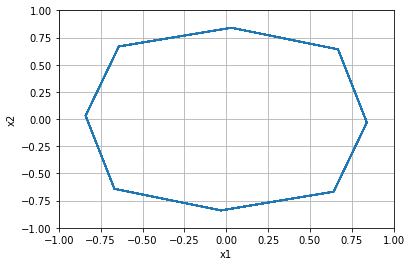


=================== Rollout 1640 =====================
x_init [[ 0.28]
 [-0.68]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.28 -0.68]
xx [ 0.28 -0.68]
xxx [ 0.28 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.6799999999999999]


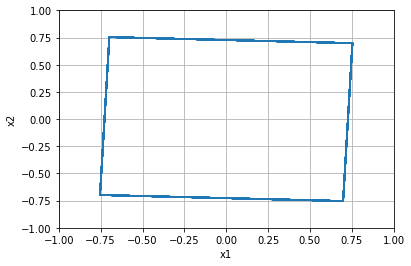


=================== Rollout 1641 =====================
x_init [[ 0.28]
 [-0.64]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.28 -0.64]
xx [ 0.28 -0.64]
xxx [ 0.28 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.64]


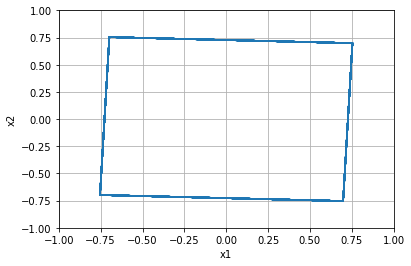


=================== Rollout 1642 =====================
x_init [[ 0.28]
 [-0.6 ]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.28 -0.6 ]
xx [ 0.28 -0.6 ]
xxx [ 0.28 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.6]


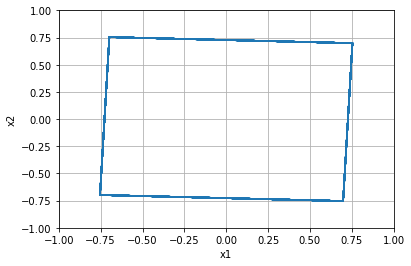


=================== Rollout 1643 =====================
x_init [[ 0.28]
 [-0.56]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.28 -0.56]
xx [ 0.28 -0.56]
xxx [ 0.28 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.56]


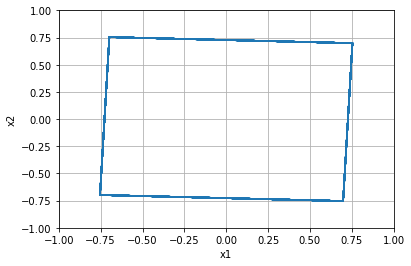


=================== Rollout 1644 =====================
x_init [[ 0.28]
 [-0.52]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.28 -0.52]
xx [ 0.28 -0.52]
xxx [ 0.28 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.52]


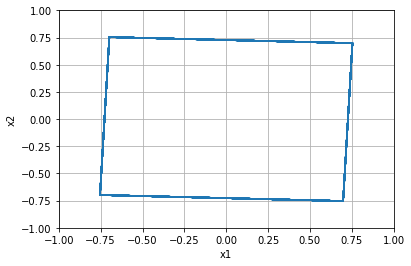


=================== Rollout 1645 =====================
x_init [[ 0.28]
 [-0.48]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.28 -0.48]
xx [ 0.28 -0.48]
xxx [ 0.28 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.48]


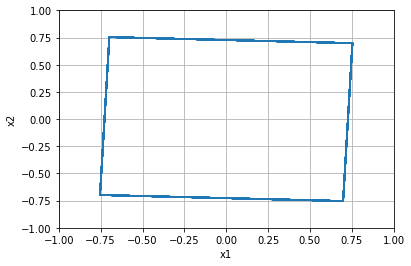


=================== Rollout 1646 =====================
x_init [[ 0.28]
 [-0.44]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.28 -0.44]
xx [ 0.28 -0.44]
xxx [ 0.28 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.43999999999999995]


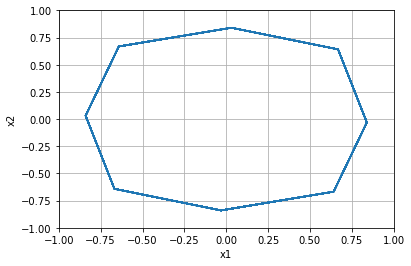


=================== Rollout 1647 =====================
x_init [[ 0.28]
 [-0.4 ]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.28 -0.4 ]
xx [ 0.28 -0.4 ]
xxx [ 0.28 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.4]


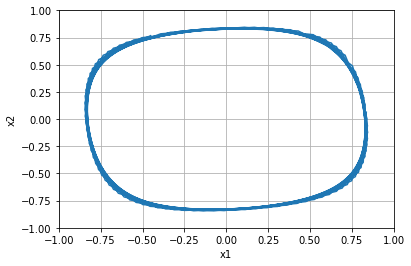


=================== Rollout 1648 =====================
x_init [[ 0.28]
 [-0.36]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.28 -0.36]
xx [ 0.28 -0.36]
xxx [ 0.28 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.36]


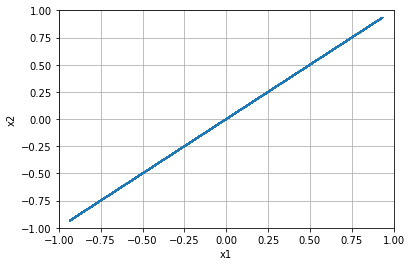


=================== Rollout 1649 =====================
x_init [[ 0.28]
 [-0.32]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.28 -0.32]
xx [ 0.28 -0.32]
xxx [ 0.28 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.31999999999999995]


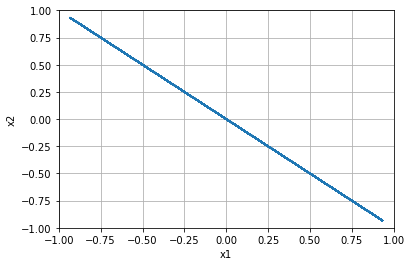


=================== Rollout 1650 =====================
x_init [[ 0.28]
 [-0.28]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.28 -0.28]
xx [ 0.28 -0.28]
xxx [ 0.28 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.28]


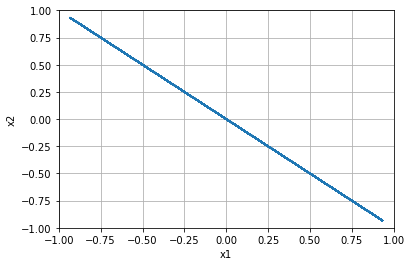


=================== Rollout 1651 =====================
x_init [[ 0.28]
 [-0.24]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.28 -0.24]
xx [ 0.28 -0.24]
xxx [ 0.28 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.24]


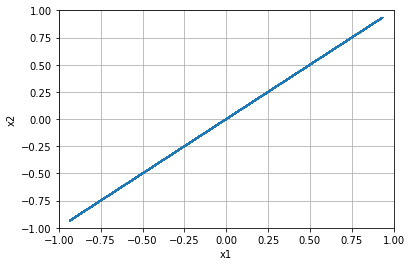


=================== Rollout 1652 =====================
x_init [[ 0.28]
 [-0.2 ]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.28 -0.2 ]
xx [ 0.28 -0.2 ]
xxx [ 0.28 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.19999999999999996]


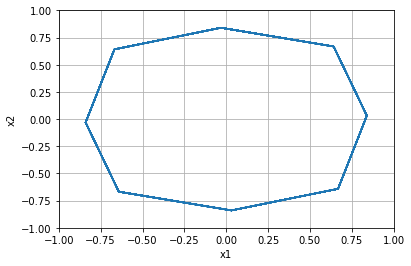


=================== Rollout 1653 =====================
x_init [[ 0.28]
 [-0.16]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.28 -0.16]
xx [ 0.28 -0.16]
xxx [ 0.28 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.16000000000000003]


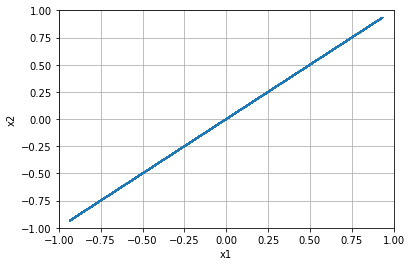


=================== Rollout 1654 =====================
x_init [[ 0.28]
 [-0.12]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.28 -0.12]
xx [ 0.28 -0.12]
xxx [ 0.28 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.12]


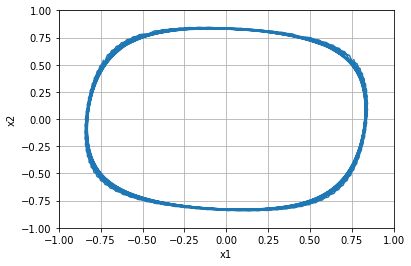


=================== Rollout 1655 =====================
x_init [[ 0.28]
 [-0.08]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.28 -0.08]
xx [ 0.28 -0.08]
xxx [ 0.28 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.07999999999999996]


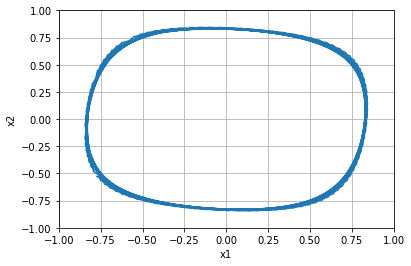


=================== Rollout 1656 =====================
x_init [[ 0.28]
 [-0.04]]
x_buffer [[ 0.28  0.28  0.28  0.28  0.28]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.28 -0.04]
xx [ 0.28 -0.04]
xxx [ 0.28 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, -0.040000000000000036]


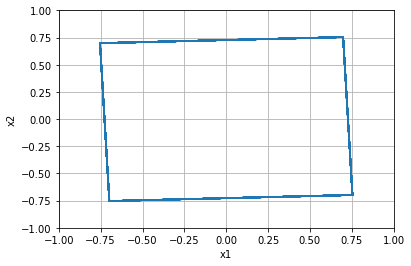


=================== Rollout 1657 =====================
x_init [[0.28]
 [0.  ]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.   0.   0.   0.   0.  ]]
x [0.28 0.  ]
xx [0.28 0.  ]
xxx [0.28 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.0]


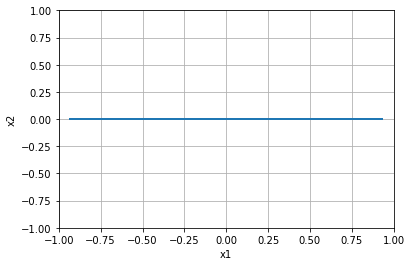


=================== Rollout 1658 =====================
x_init [[0.28]
 [0.04]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.28 0.04]
xx [0.28 0.04]
xxx [0.28 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.040000000000000036]


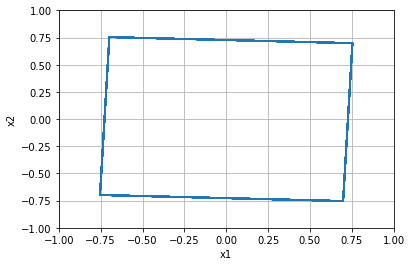


=================== Rollout 1659 =====================
x_init [[0.28]
 [0.08]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.28 0.08]
xx [0.28 0.08]
xxx [0.28 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.08000000000000007]


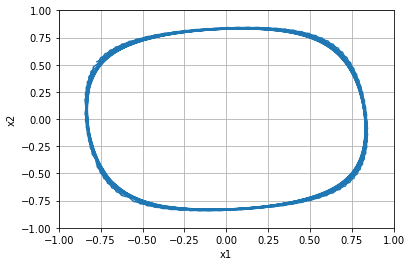


=================== Rollout 1660 =====================
x_init [[0.28]
 [0.12]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.28 0.12]
xx [0.28 0.12]
xxx [0.28 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.1200000000000001]


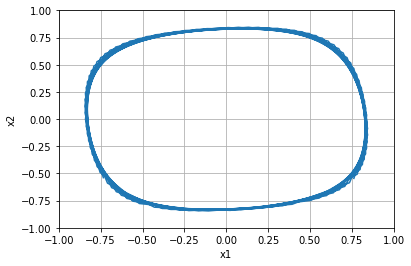


=================== Rollout 1661 =====================
x_init [[0.28]
 [0.16]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.28 0.16]
xx [0.28 0.16]
xxx [0.28 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.15999999999999992]


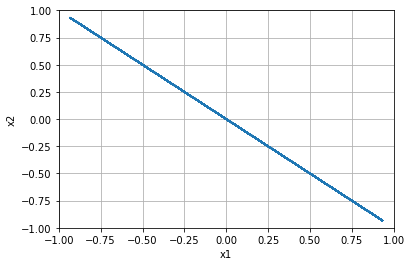


=================== Rollout 1662 =====================
x_init [[0.28]
 [0.2 ]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.28 0.2 ]
xx [0.28 0.2 ]
xxx [0.28 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.19999999999999996]


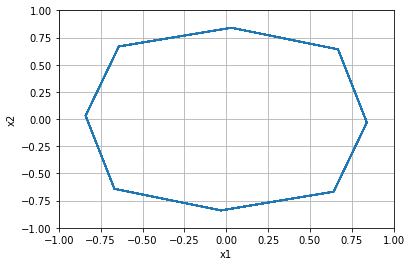


=================== Rollout 1663 =====================
x_init [[0.28]
 [0.24]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.28 0.24]
xx [0.28 0.24]
xxx [0.28 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.24]


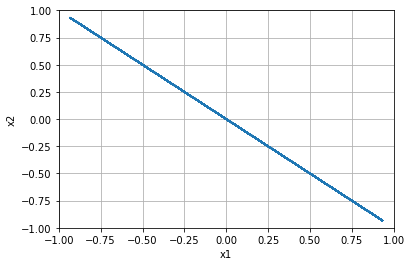


=================== Rollout 1664 =====================
x_init [[0.28]
 [0.28]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.28 0.28]
xx [0.28 0.28]
xxx [0.28 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.28]


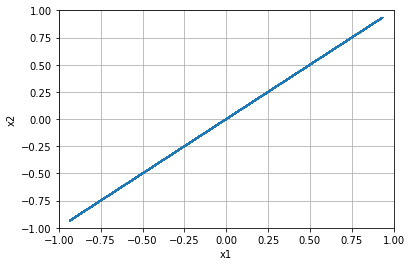


=================== Rollout 1665 =====================
x_init [[0.28]
 [0.32]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.28 0.32]
xx [0.28 0.32]
xxx [0.28 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.32000000000000006]


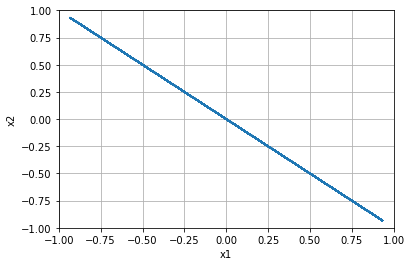


=================== Rollout 1666 =====================
x_init [[0.28]
 [0.36]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.28 0.36]
xx [0.28 0.36]
xxx [0.28 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.3600000000000001]


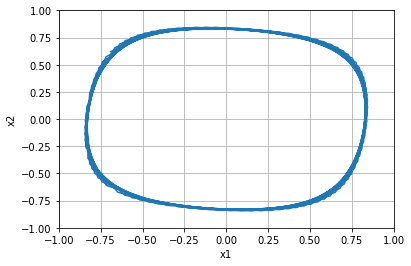


=================== Rollout 1667 =====================
x_init [[0.28]
 [0.4 ]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.28 0.4 ]
xx [0.28 0.4 ]
xxx [0.28 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.40000000000000013]


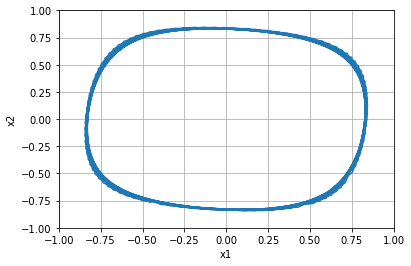


=================== Rollout 1668 =====================
x_init [[0.28]
 [0.44]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.28 0.44]
xx [0.28 0.44]
xxx [0.28 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.43999999999999995]


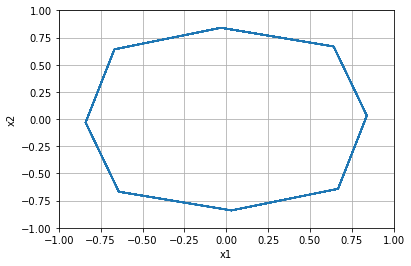


=================== Rollout 1669 =====================
x_init [[0.28]
 [0.48]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.28 0.48]
xx [0.28 0.48]
xxx [0.28 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.48]


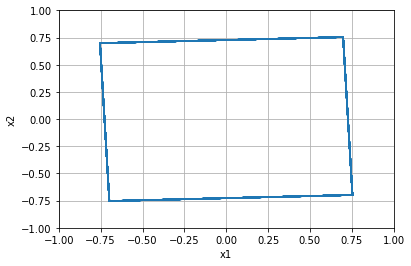


=================== Rollout 1670 =====================
x_init [[0.28]
 [0.52]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.28 0.52]
xx [0.28 0.52]
xxx [0.28 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.52]


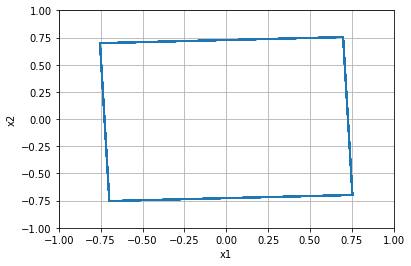


=================== Rollout 1671 =====================
x_init [[0.28]
 [0.56]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.28 0.56]
xx [0.28 0.56]
xxx [0.28 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.56]


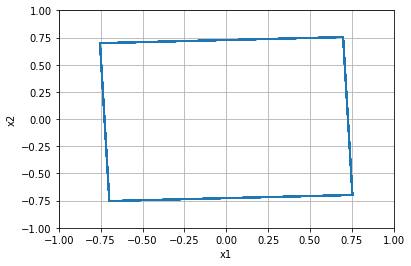


=================== Rollout 1672 =====================
x_init [[0.28]
 [0.6 ]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.28 0.6 ]
xx [0.28 0.6 ]
xxx [0.28 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.6000000000000001]


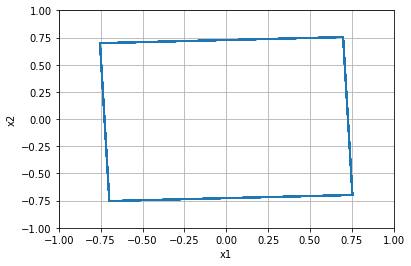


=================== Rollout 1673 =====================
x_init [[0.28]
 [0.64]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.28 0.64]
xx [0.28 0.64]
xxx [0.28 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.6400000000000001]


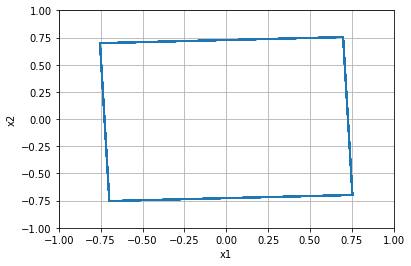


=================== Rollout 1674 =====================
x_init [[0.28]
 [0.68]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.28 0.68]
xx [0.28 0.68]
xxx [0.28 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.6799999999999999]


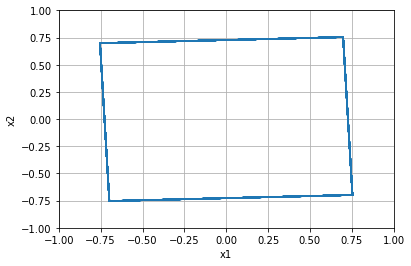


=================== Rollout 1675 =====================
x_init [[0.28]
 [0.72]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.28 0.72]
xx [0.28 0.72]
xxx [0.28 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.72]


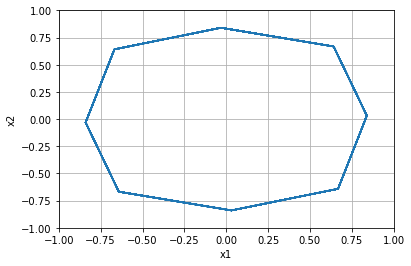


=================== Rollout 1676 =====================
x_init [[0.28]
 [0.76]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.28 0.76]
xx [0.28 0.76]
xxx [0.28 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.76]


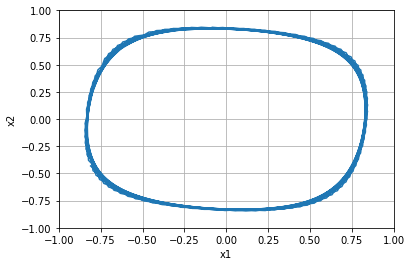


=================== Rollout 1677 =====================
x_init [[0.28]
 [0.8 ]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.28 0.8 ]
xx [0.28 0.8 ]
xxx [0.28 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.8]


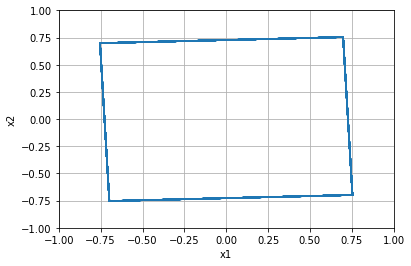


=================== Rollout 1678 =====================
x_init [[0.28]
 [0.84]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.28 0.84]
xx [0.28 0.84]
xxx [0.28 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.8400000000000001]


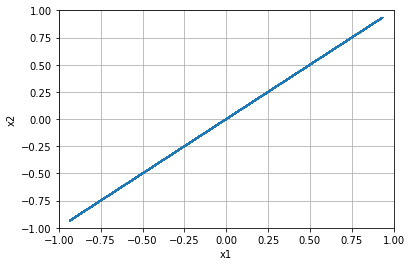


=================== Rollout 1679 =====================
x_init [[0.28]
 [0.88]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.28 0.88]
xx [0.28 0.88]
xxx [0.28 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.8800000000000001]


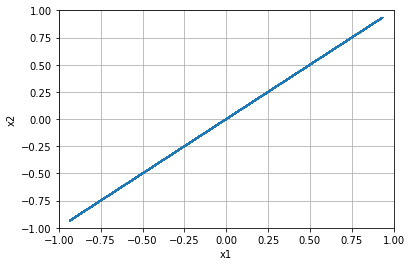


=================== Rollout 1680 =====================
x_init [[0.28]
 [0.92]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.28 0.92]
xx [0.28 0.92]
xxx [0.28 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.9199999999999999]


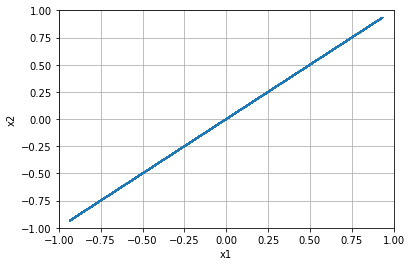


=================== Rollout 1681 =====================
x_init [[0.28]
 [0.96]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.28 0.96]
xx [0.28 0.96]
xxx [0.28 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 0.96]


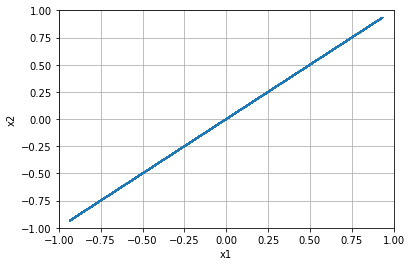


=================== Rollout 1682 =====================
x_init [[0.28]
 [1.  ]]
x_buffer [[0.28 0.28 0.28 0.28 0.28]
 [1.   1.   1.   1.   1.  ]]
x [0.28 1.  ]
xx [0.28 1.  ]
xxx [0.28 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.28, 1.0]


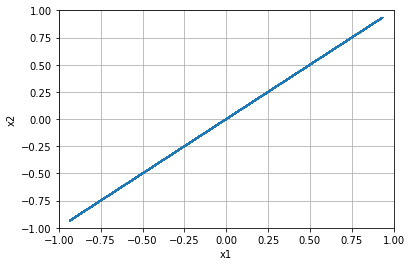


=================== Rollout 1683 =====================
x_init [[ 0.32]
 [-1.  ]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.32 -1.  ]
xx [ 0.32 -1.  ]
xxx [ 0.32 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -1.0]


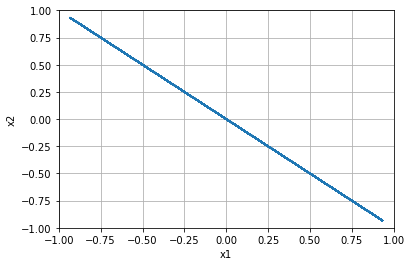


=================== Rollout 1684 =====================
x_init [[ 0.32]
 [-0.96]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.32 -0.96]
xx [ 0.32 -0.96]
xxx [ 0.32 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.96]


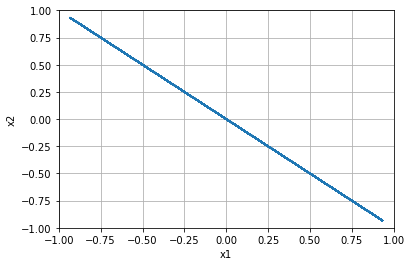


=================== Rollout 1685 =====================
x_init [[ 0.32]
 [-0.92]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.32 -0.92]
xx [ 0.32 -0.92]
xxx [ 0.32 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.92]


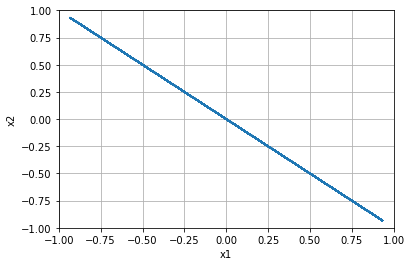


=================== Rollout 1686 =====================
x_init [[ 0.32]
 [-0.88]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.32 -0.88]
xx [ 0.32 -0.88]
xxx [ 0.32 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.88]


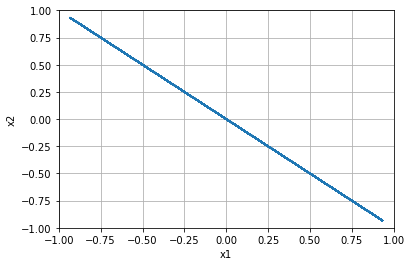


=================== Rollout 1687 =====================
x_init [[ 0.32]
 [-0.84]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.32 -0.84]
xx [ 0.32 -0.84]
xxx [ 0.32 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.84]


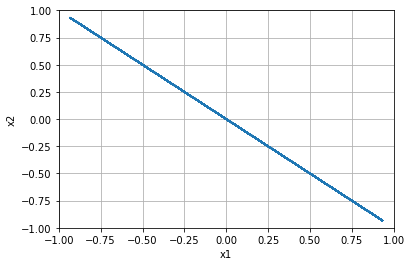


=================== Rollout 1688 =====================
x_init [[ 0.32]
 [-0.8 ]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.32 -0.8 ]
xx [ 0.32 -0.8 ]
xxx [ 0.32 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.8]


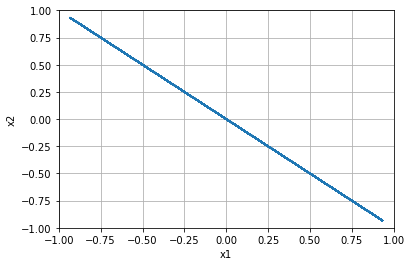


=================== Rollout 1689 =====================
x_init [[ 0.32]
 [-0.76]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.32 -0.76]
xx [ 0.32 -0.76]
xxx [ 0.32 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.76]


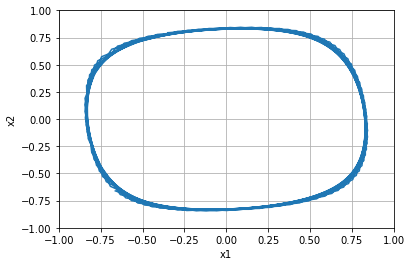


=================== Rollout 1690 =====================
x_init [[ 0.32]
 [-0.72]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.32 -0.72]
xx [ 0.32 -0.72]
xxx [ 0.32 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.72]


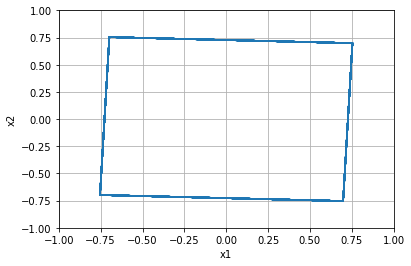


=================== Rollout 1691 =====================
x_init [[ 0.32]
 [-0.68]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.32 -0.68]
xx [ 0.32 -0.68]
xxx [ 0.32 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.6799999999999999]


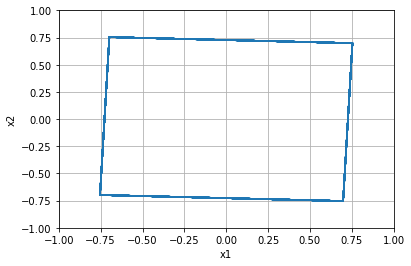


=================== Rollout 1692 =====================
x_init [[ 0.32]
 [-0.64]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.32 -0.64]
xx [ 0.32 -0.64]
xxx [ 0.32 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.64]


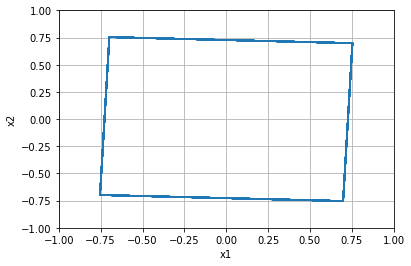


=================== Rollout 1693 =====================
x_init [[ 0.32]
 [-0.6 ]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.32 -0.6 ]
xx [ 0.32 -0.6 ]
xxx [ 0.32 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.6]


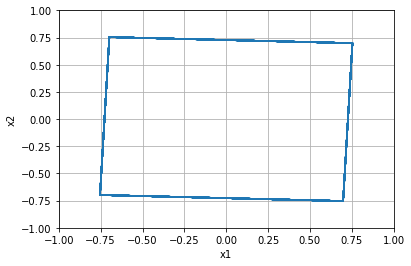


=================== Rollout 1694 =====================
x_init [[ 0.32]
 [-0.56]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.32 -0.56]
xx [ 0.32 -0.56]
xxx [ 0.32 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.56]


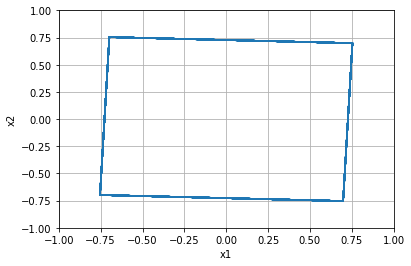


=================== Rollout 1695 =====================
x_init [[ 0.32]
 [-0.52]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.32 -0.52]
xx [ 0.32 -0.52]
xxx [ 0.32 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.52]


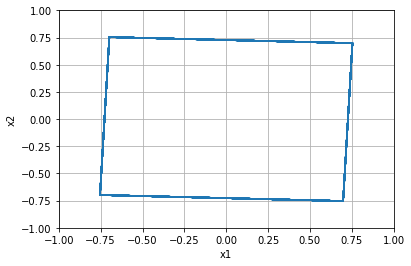


=================== Rollout 1696 =====================
x_init [[ 0.32]
 [-0.48]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.32 -0.48]
xx [ 0.32 -0.48]
xxx [ 0.32 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.48]


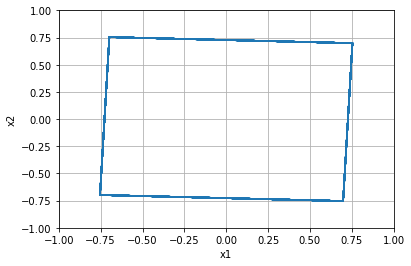


=================== Rollout 1697 =====================
x_init [[ 0.32]
 [-0.44]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.32 -0.44]
xx [ 0.32 -0.44]
xxx [ 0.32 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.43999999999999995]


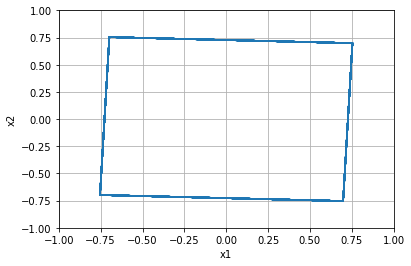


=================== Rollout 1698 =====================
x_init [[ 0.32]
 [-0.4 ]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.32 -0.4 ]
xx [ 0.32 -0.4 ]
xxx [ 0.32 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.4]


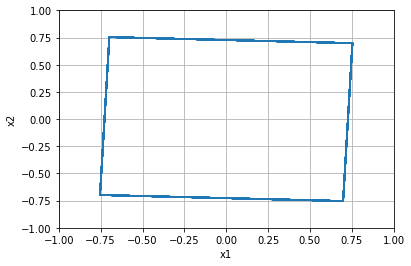


=================== Rollout 1699 =====================
x_init [[ 0.32]
 [-0.36]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.32 -0.36]
xx [ 0.32 -0.36]
xxx [ 0.32 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.36]


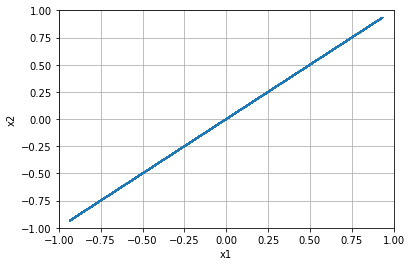


=================== Rollout 1700 =====================
x_init [[ 0.32]
 [-0.32]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.32 -0.32]
xx [ 0.32 -0.32]
xxx [ 0.32 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.31999999999999995]


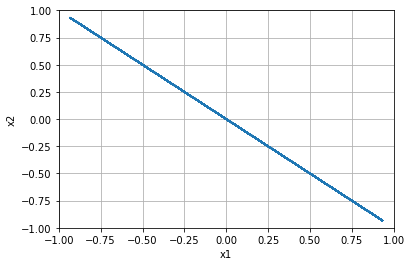


=================== Rollout 1701 =====================
x_init [[ 0.32]
 [-0.28]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.32 -0.28]
xx [ 0.32 -0.28]
xxx [ 0.32 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.28]


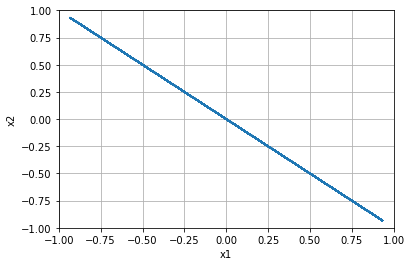


=================== Rollout 1702 =====================
x_init [[ 0.32]
 [-0.24]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.32 -0.24]
xx [ 0.32 -0.24]
xxx [ 0.32 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.24]


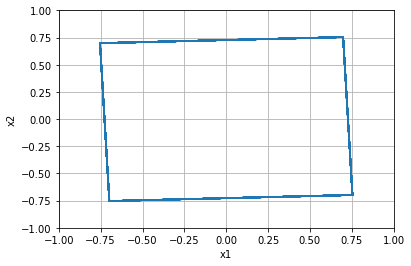


=================== Rollout 1703 =====================
x_init [[ 0.32]
 [-0.2 ]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.32 -0.2 ]
xx [ 0.32 -0.2 ]
xxx [ 0.32 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.19999999999999996]


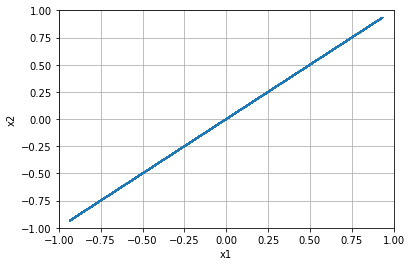


=================== Rollout 1704 =====================
x_init [[ 0.32]
 [-0.16]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.32 -0.16]
xx [ 0.32 -0.16]
xxx [ 0.32 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.16000000000000003]


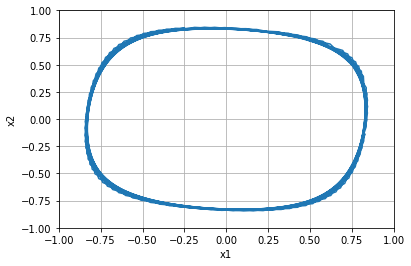


=================== Rollout 1705 =====================
x_init [[ 0.32]
 [-0.12]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.32 -0.12]
xx [ 0.32 -0.12]
xxx [ 0.32 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.12]


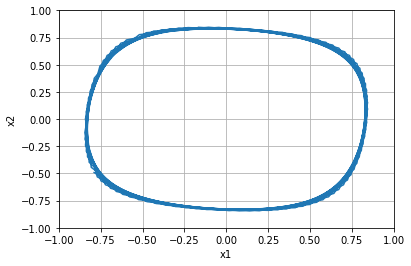


=================== Rollout 1706 =====================
x_init [[ 0.32]
 [-0.08]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.32 -0.08]
xx [ 0.32 -0.08]
xxx [ 0.32 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.07999999999999996]


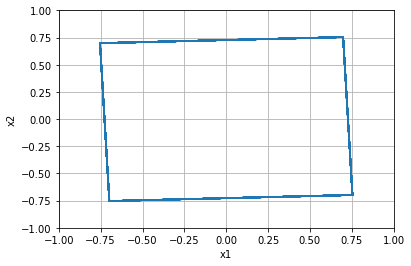


=================== Rollout 1707 =====================
x_init [[ 0.32]
 [-0.04]]
x_buffer [[ 0.32  0.32  0.32  0.32  0.32]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.32 -0.04]
xx [ 0.32 -0.04]
xxx [ 0.32 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, -0.040000000000000036]


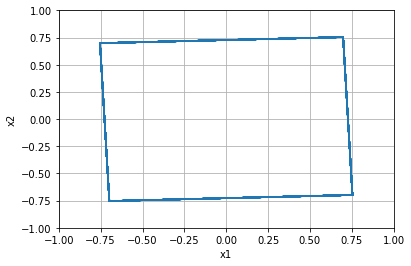


=================== Rollout 1708 =====================
x_init [[0.32]
 [0.  ]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.   0.   0.   0.   0.  ]]
x [0.32 0.  ]
xx [0.32 0.  ]
xxx [0.32 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.0]


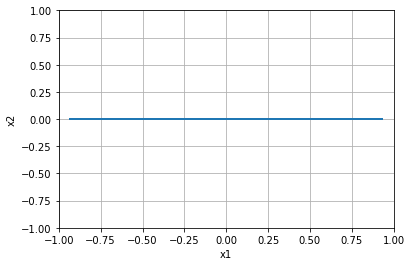


=================== Rollout 1709 =====================
x_init [[0.32]
 [0.04]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.32 0.04]
xx [0.32 0.04]
xxx [0.32 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.040000000000000036]


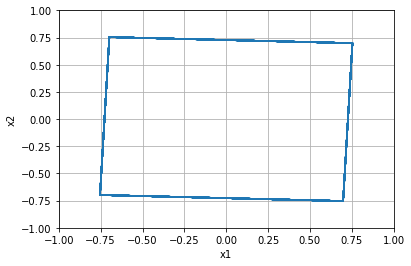


=================== Rollout 1710 =====================
x_init [[0.32]
 [0.08]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.32 0.08]
xx [0.32 0.08]
xxx [0.32 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.08000000000000007]


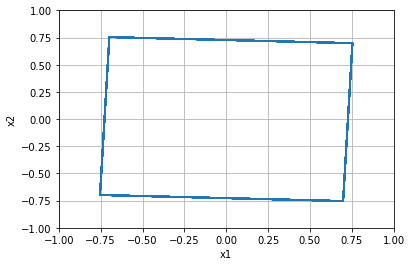


=================== Rollout 1711 =====================
x_init [[0.32]
 [0.12]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.32 0.12]
xx [0.32 0.12]
xxx [0.32 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.1200000000000001]


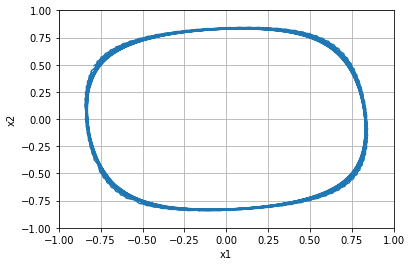


=================== Rollout 1712 =====================
x_init [[0.32]
 [0.16]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.32 0.16]
xx [0.32 0.16]
xxx [0.32 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.15999999999999992]


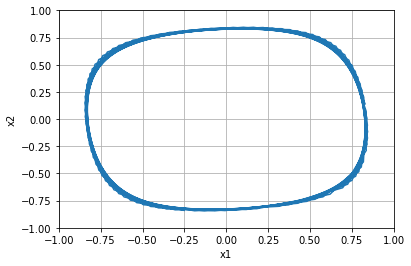


=================== Rollout 1713 =====================
x_init [[0.32]
 [0.2 ]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.32 0.2 ]
xx [0.32 0.2 ]
xxx [0.32 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.19999999999999996]


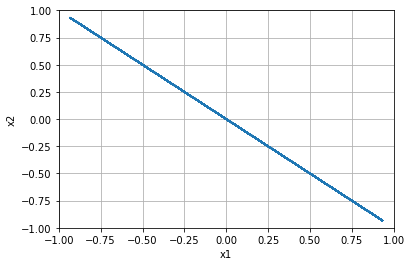


=================== Rollout 1714 =====================
x_init [[0.32]
 [0.24]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.32 0.24]
xx [0.32 0.24]
xxx [0.32 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.24]


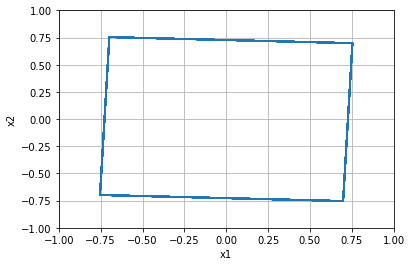


=================== Rollout 1715 =====================
x_init [[0.32]
 [0.28]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.32 0.28]
xx [0.32 0.28]
xxx [0.32 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.28]


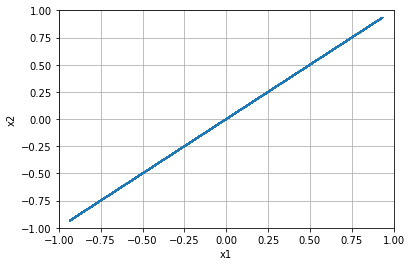


=================== Rollout 1716 =====================
x_init [[0.32]
 [0.32]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.32 0.32]
xx [0.32 0.32]
xxx [0.32 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.32000000000000006]


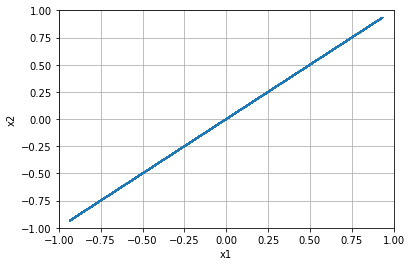


=================== Rollout 1717 =====================
x_init [[0.32]
 [0.36]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.32 0.36]
xx [0.32 0.36]
xxx [0.32 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.3600000000000001]


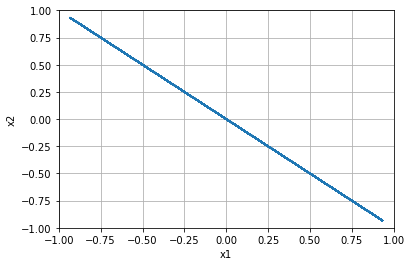


=================== Rollout 1718 =====================
x_init [[0.32]
 [0.4 ]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.32 0.4 ]
xx [0.32 0.4 ]
xxx [0.32 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.40000000000000013]


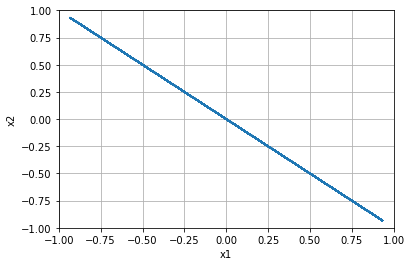


=================== Rollout 1719 =====================
x_init [[0.32]
 [0.44]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.32 0.44]
xx [0.32 0.44]
xxx [0.32 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.43999999999999995]


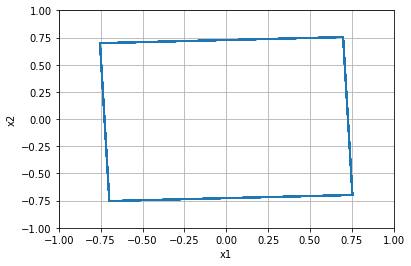


=================== Rollout 1720 =====================
x_init [[0.32]
 [0.48]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.32 0.48]
xx [0.32 0.48]
xxx [0.32 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.48]


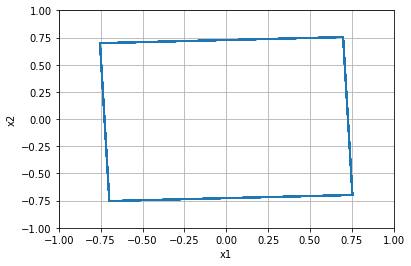


=================== Rollout 1721 =====================
x_init [[0.32]
 [0.52]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.32 0.52]
xx [0.32 0.52]
xxx [0.32 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.52]


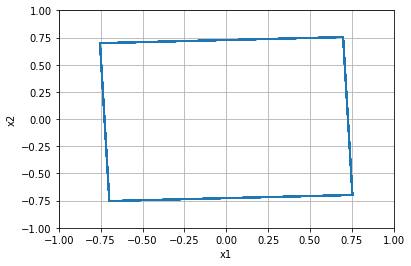


=================== Rollout 1722 =====================
x_init [[0.32]
 [0.56]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.32 0.56]
xx [0.32 0.56]
xxx [0.32 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.56]


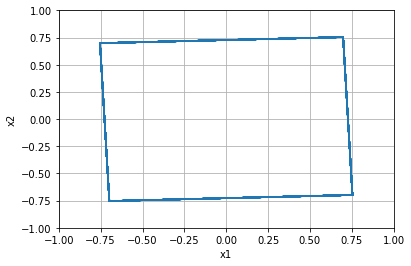


=================== Rollout 1723 =====================
x_init [[0.32]
 [0.6 ]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.32 0.6 ]
xx [0.32 0.6 ]
xxx [0.32 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.6000000000000001]


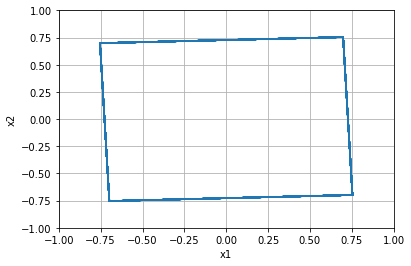


=================== Rollout 1724 =====================
x_init [[0.32]
 [0.64]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.32 0.64]
xx [0.32 0.64]
xxx [0.32 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.6400000000000001]


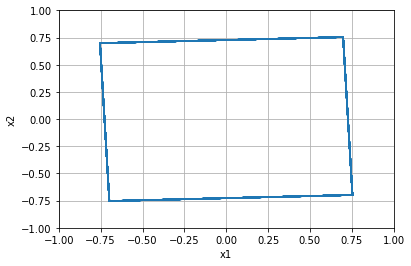


=================== Rollout 1725 =====================
x_init [[0.32]
 [0.68]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.32 0.68]
xx [0.32 0.68]
xxx [0.32 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.6799999999999999]


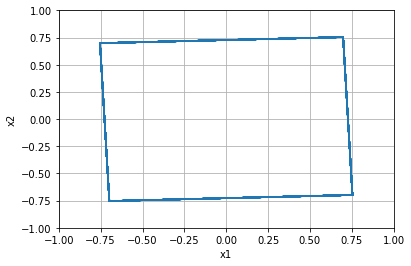


=================== Rollout 1726 =====================
x_init [[0.32]
 [0.72]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.32 0.72]
xx [0.32 0.72]
xxx [0.32 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.72]


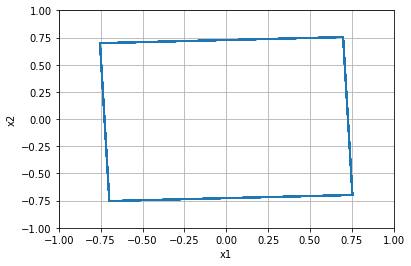


=================== Rollout 1727 =====================
x_init [[0.32]
 [0.76]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.32 0.76]
xx [0.32 0.76]
xxx [0.32 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.76]


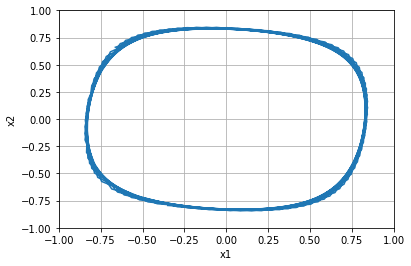


=================== Rollout 1728 =====================
x_init [[0.32]
 [0.8 ]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.32 0.8 ]
xx [0.32 0.8 ]
xxx [0.32 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.8]


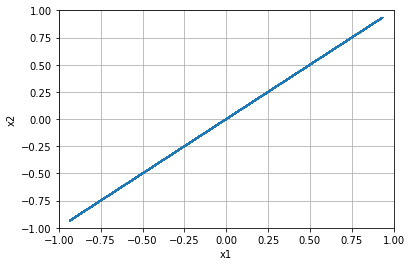


=================== Rollout 1729 =====================
x_init [[0.32]
 [0.84]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.32 0.84]
xx [0.32 0.84]
xxx [0.32 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.8400000000000001]


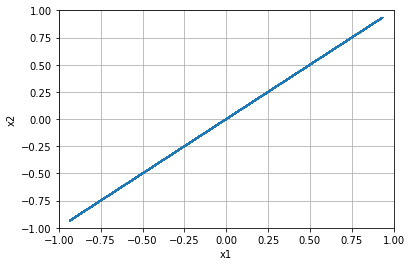


=================== Rollout 1730 =====================
x_init [[0.32]
 [0.88]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.32 0.88]
xx [0.32 0.88]
xxx [0.32 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.8800000000000001]


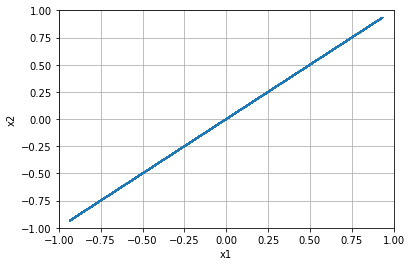


=================== Rollout 1731 =====================
x_init [[0.32]
 [0.92]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.32 0.92]
xx [0.32 0.92]
xxx [0.32 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.9199999999999999]


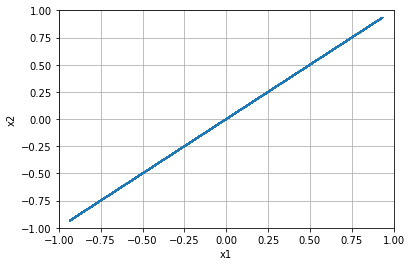


=================== Rollout 1732 =====================
x_init [[0.32]
 [0.96]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.32 0.96]
xx [0.32 0.96]
xxx [0.32 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 0.96]


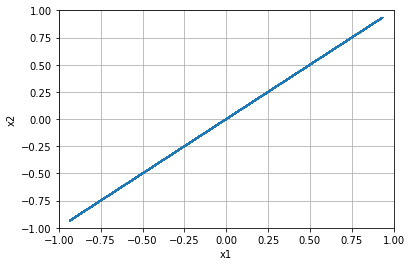


=================== Rollout 1733 =====================
x_init [[0.32]
 [1.  ]]
x_buffer [[0.32 0.32 0.32 0.32 0.32]
 [1.   1.   1.   1.   1.  ]]
x [0.32 1.  ]
xx [0.32 1.  ]
xxx [0.32 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.32000000000000006, 1.0]


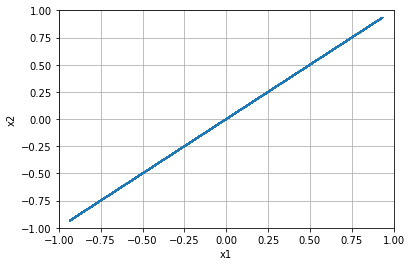


=================== Rollout 1734 =====================
x_init [[ 0.36]
 [-1.  ]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.36 -1.  ]
xx [ 0.36 -1.  ]
xxx [ 0.36 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -1.0]


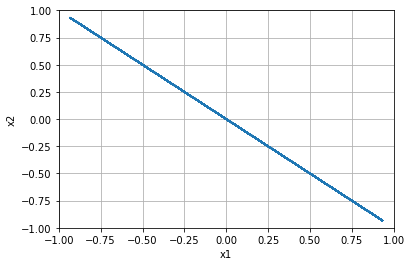


=================== Rollout 1735 =====================
x_init [[ 0.36]
 [-0.96]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.36 -0.96]
xx [ 0.36 -0.96]
xxx [ 0.36 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.96]


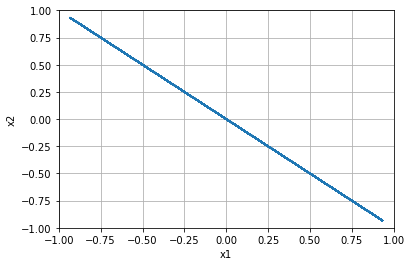


=================== Rollout 1736 =====================
x_init [[ 0.36]
 [-0.92]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.36 -0.92]
xx [ 0.36 -0.92]
xxx [ 0.36 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.92]


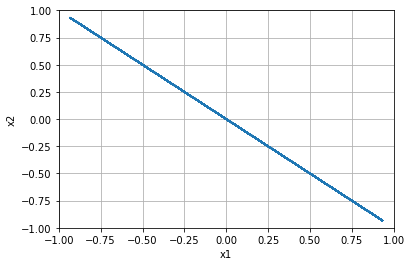


=================== Rollout 1737 =====================
x_init [[ 0.36]
 [-0.88]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.36 -0.88]
xx [ 0.36 -0.88]
xxx [ 0.36 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.88]


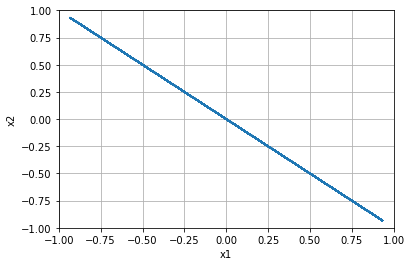


=================== Rollout 1738 =====================
x_init [[ 0.36]
 [-0.84]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.36 -0.84]
xx [ 0.36 -0.84]
xxx [ 0.36 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.84]


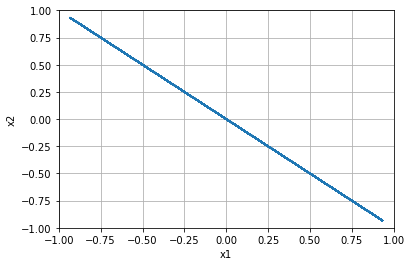


=================== Rollout 1739 =====================
x_init [[ 0.36]
 [-0.8 ]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.36 -0.8 ]
xx [ 0.36 -0.8 ]
xxx [ 0.36 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.8]


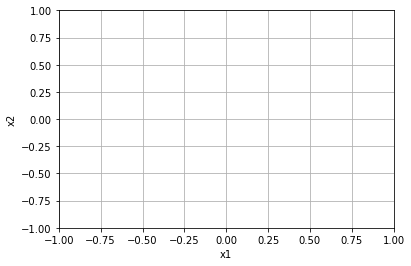


=================== Rollout 1740 =====================
x_init [[ 0.36]
 [-0.76]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.36 -0.76]
xx [ 0.36 -0.76]
xxx [ 0.36 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.76]


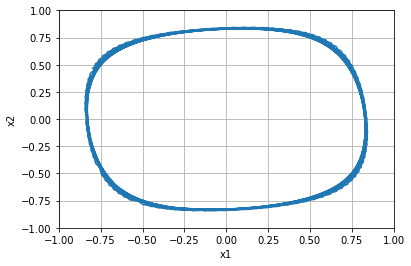


=================== Rollout 1741 =====================
x_init [[ 0.36]
 [-0.72]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.36 -0.72]
xx [ 0.36 -0.72]
xxx [ 0.36 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.72]


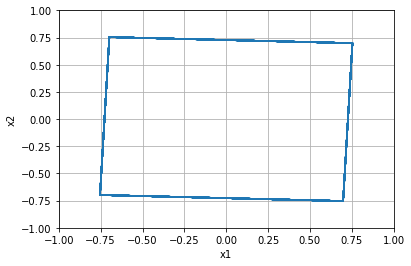


=================== Rollout 1742 =====================
x_init [[ 0.36]
 [-0.68]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.36 -0.68]
xx [ 0.36 -0.68]
xxx [ 0.36 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.6799999999999999]


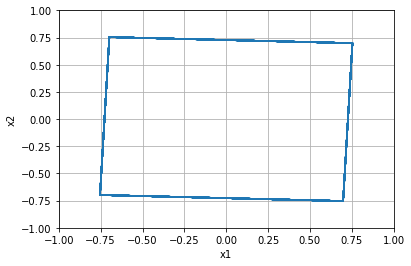


=================== Rollout 1743 =====================
x_init [[ 0.36]
 [-0.64]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.36 -0.64]
xx [ 0.36 -0.64]
xxx [ 0.36 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.64]


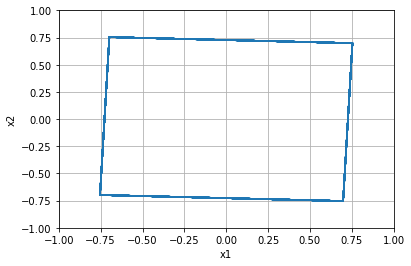


=================== Rollout 1744 =====================
x_init [[ 0.36]
 [-0.6 ]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.36 -0.6 ]
xx [ 0.36 -0.6 ]
xxx [ 0.36 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.6]


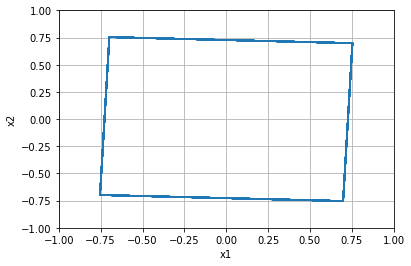


=================== Rollout 1745 =====================
x_init [[ 0.36]
 [-0.56]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.36 -0.56]
xx [ 0.36 -0.56]
xxx [ 0.36 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.56]


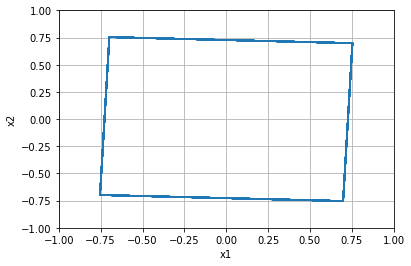


=================== Rollout 1746 =====================
x_init [[ 0.36]
 [-0.52]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.36 -0.52]
xx [ 0.36 -0.52]
xxx [ 0.36 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.52]


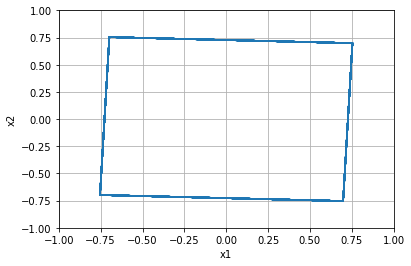


=================== Rollout 1747 =====================
x_init [[ 0.36]
 [-0.48]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.36 -0.48]
xx [ 0.36 -0.48]
xxx [ 0.36 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.48]


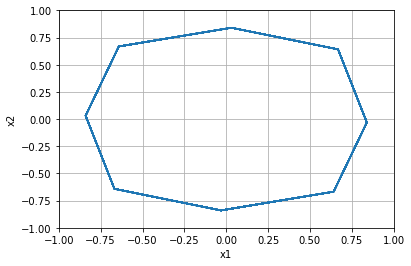


=================== Rollout 1748 =====================
x_init [[ 0.36]
 [-0.44]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.36 -0.44]
xx [ 0.36 -0.44]
xxx [ 0.36 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.43999999999999995]


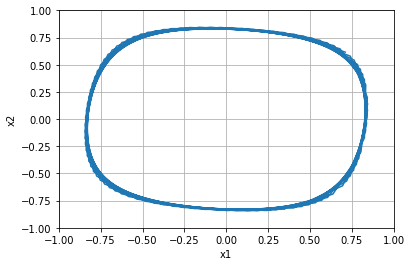


=================== Rollout 1749 =====================
x_init [[ 0.36]
 [-0.4 ]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.36 -0.4 ]
xx [ 0.36 -0.4 ]
xxx [ 0.36 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.4]


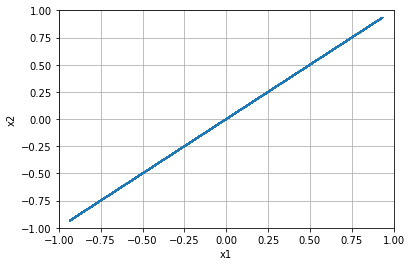


=================== Rollout 1750 =====================
x_init [[ 0.36]
 [-0.36]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.36 -0.36]
xx [ 0.36 -0.36]
xxx [ 0.36 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.36]


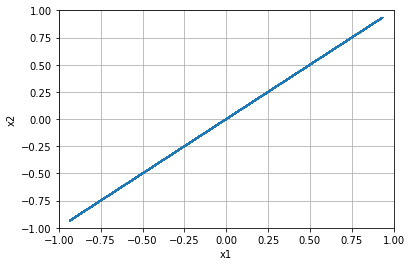


=================== Rollout 1751 =====================
x_init [[ 0.36]
 [-0.32]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.36 -0.32]
xx [ 0.36 -0.32]
xxx [ 0.36 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.31999999999999995]


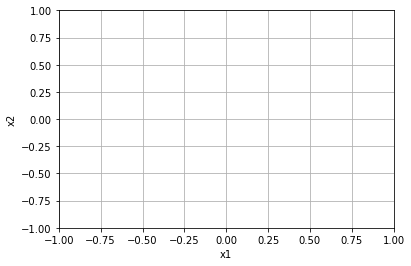


=================== Rollout 1752 =====================
x_init [[ 0.36]
 [-0.28]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.36 -0.28]
xx [ 0.36 -0.28]
xxx [ 0.36 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.28]


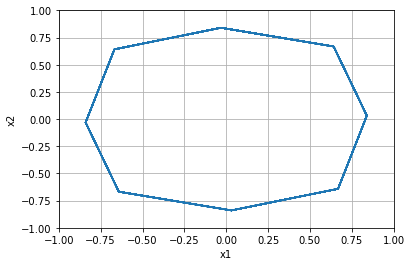


=================== Rollout 1753 =====================
x_init [[ 0.36]
 [-0.24]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.36 -0.24]
xx [ 0.36 -0.24]
xxx [ 0.36 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.24]


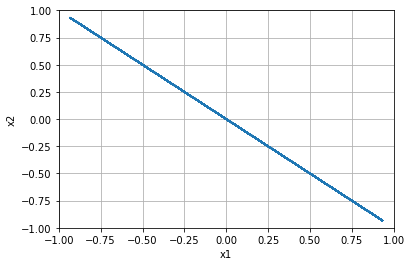


=================== Rollout 1754 =====================
x_init [[ 0.36]
 [-0.2 ]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.36 -0.2 ]
xx [ 0.36 -0.2 ]
xxx [ 0.36 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.19999999999999996]


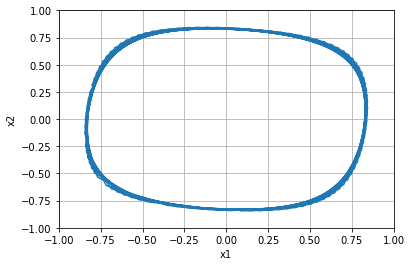


=================== Rollout 1755 =====================
x_init [[ 0.36]
 [-0.16]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.36 -0.16]
xx [ 0.36 -0.16]
xxx [ 0.36 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.16000000000000003]


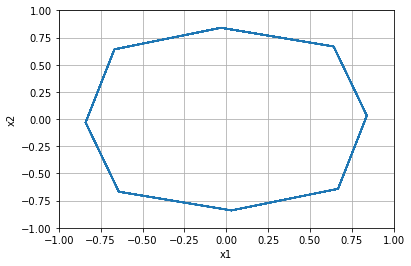


=================== Rollout 1756 =====================
x_init [[ 0.36]
 [-0.12]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.36 -0.12]
xx [ 0.36 -0.12]
xxx [ 0.36 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.12]


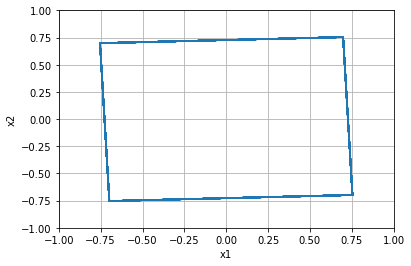


=================== Rollout 1757 =====================
x_init [[ 0.36]
 [-0.08]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.36 -0.08]
xx [ 0.36 -0.08]
xxx [ 0.36 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.07999999999999996]


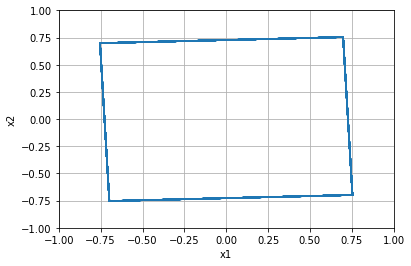


=================== Rollout 1758 =====================
x_init [[ 0.36]
 [-0.04]]
x_buffer [[ 0.36  0.36  0.36  0.36  0.36]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.36 -0.04]
xx [ 0.36 -0.04]
xxx [ 0.36 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, -0.040000000000000036]


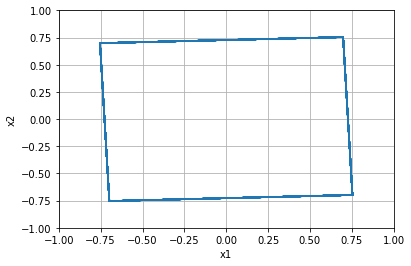


=================== Rollout 1759 =====================
x_init [[0.36]
 [0.  ]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.   0.   0.   0.   0.  ]]
x [0.36 0.  ]
xx [0.36 0.  ]
xxx [0.36 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.0]


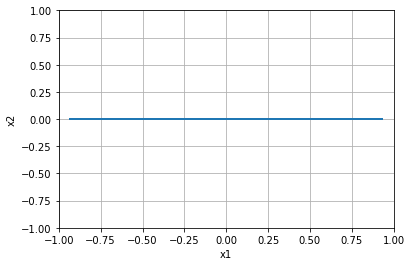


=================== Rollout 1760 =====================
x_init [[0.36]
 [0.04]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.36 0.04]
xx [0.36 0.04]
xxx [0.36 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.040000000000000036]


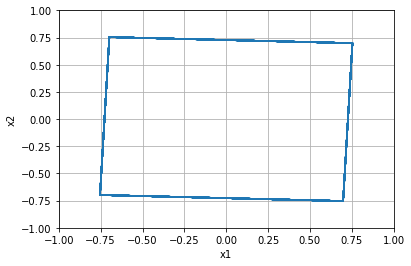


=================== Rollout 1761 =====================
x_init [[0.36]
 [0.08]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.36 0.08]
xx [0.36 0.08]
xxx [0.36 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.08000000000000007]


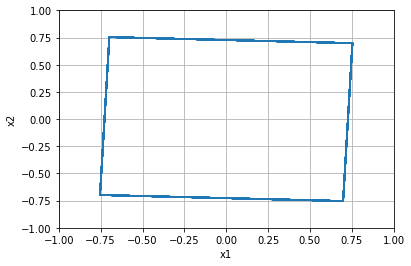


=================== Rollout 1762 =====================
x_init [[0.36]
 [0.12]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.36 0.12]
xx [0.36 0.12]
xxx [0.36 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.1200000000000001]


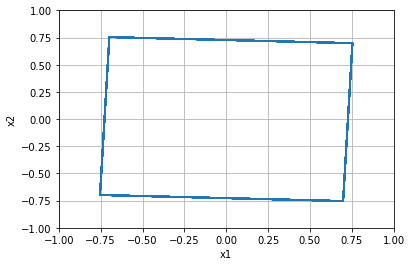


=================== Rollout 1763 =====================
x_init [[0.36]
 [0.16]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.36 0.16]
xx [0.36 0.16]
xxx [0.36 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.15999999999999992]


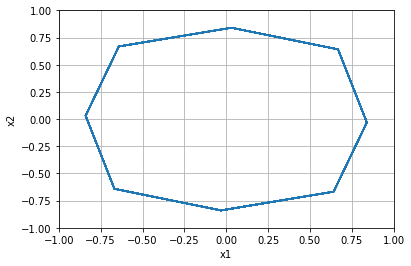


=================== Rollout 1764 =====================
x_init [[0.36]
 [0.2 ]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.36 0.2 ]
xx [0.36 0.2 ]
xxx [0.36 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.19999999999999996]


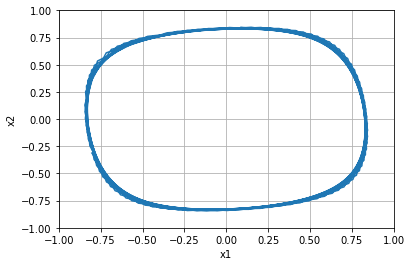


=================== Rollout 1765 =====================
x_init [[0.36]
 [0.24]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.36 0.24]
xx [0.36 0.24]
xxx [0.36 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.24]


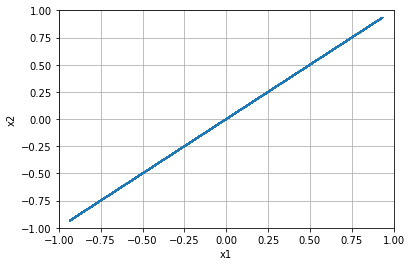


=================== Rollout 1766 =====================
x_init [[0.36]
 [0.28]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.36 0.28]
xx [0.36 0.28]
xxx [0.36 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.28]


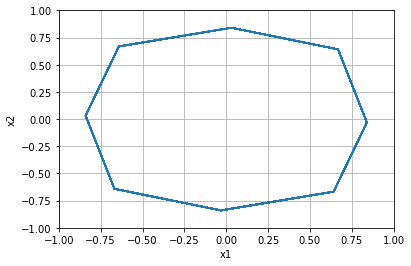


=================== Rollout 1767 =====================
x_init [[0.36]
 [0.32]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.36 0.32]
xx [0.36 0.32]
xxx [0.36 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.32000000000000006]


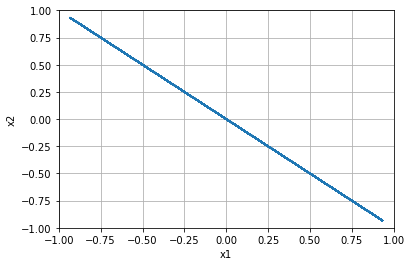


=================== Rollout 1768 =====================
x_init [[0.36]
 [0.36]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.36 0.36]
xx [0.36 0.36]
xxx [0.36 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.3600000000000001]


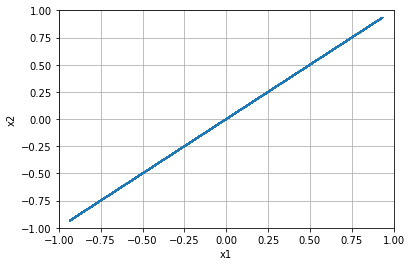


=================== Rollout 1769 =====================
x_init [[0.36]
 [0.4 ]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.36 0.4 ]
xx [0.36 0.4 ]
xxx [0.36 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.40000000000000013]


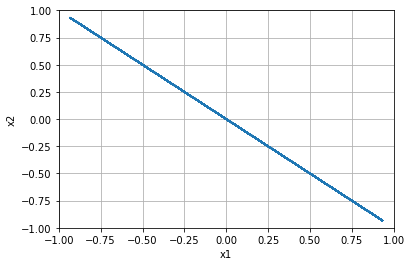


=================== Rollout 1770 =====================
x_init [[0.36]
 [0.44]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.36 0.44]
xx [0.36 0.44]
xxx [0.36 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.43999999999999995]


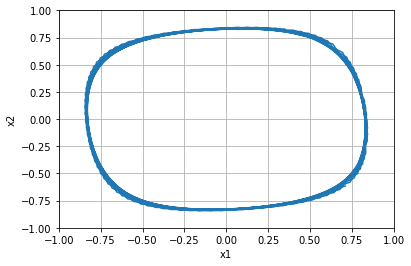


=================== Rollout 1771 =====================
x_init [[0.36]
 [0.48]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.36 0.48]
xx [0.36 0.48]
xxx [0.36 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.48]


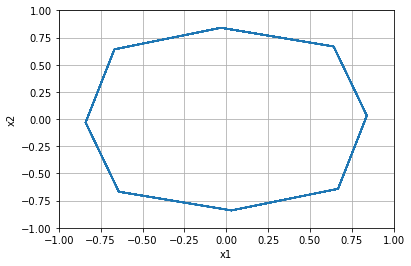


=================== Rollout 1772 =====================
x_init [[0.36]
 [0.52]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.36 0.52]
xx [0.36 0.52]
xxx [0.36 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.52]


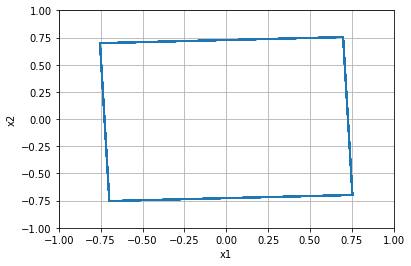


=================== Rollout 1773 =====================
x_init [[0.36]
 [0.56]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.36 0.56]
xx [0.36 0.56]
xxx [0.36 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.56]


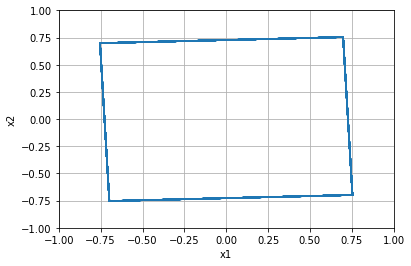


=================== Rollout 1774 =====================
x_init [[0.36]
 [0.6 ]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.36 0.6 ]
xx [0.36 0.6 ]
xxx [0.36 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.6000000000000001]


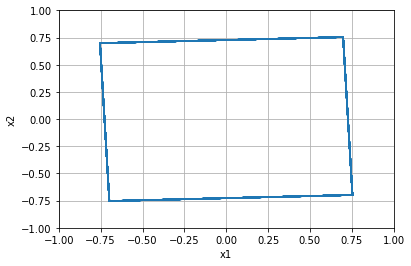


=================== Rollout 1775 =====================
x_init [[0.36]
 [0.64]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.36 0.64]
xx [0.36 0.64]
xxx [0.36 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.6400000000000001]


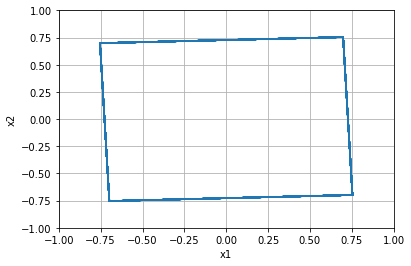


=================== Rollout 1776 =====================
x_init [[0.36]
 [0.68]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.36 0.68]
xx [0.36 0.68]
xxx [0.36 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.6799999999999999]


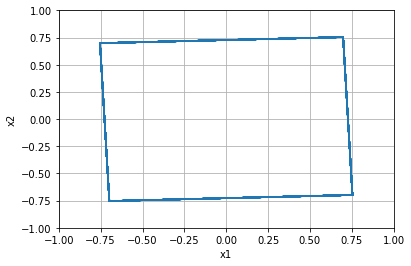


=================== Rollout 1777 =====================
x_init [[0.36]
 [0.72]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.36 0.72]
xx [0.36 0.72]
xxx [0.36 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.72]


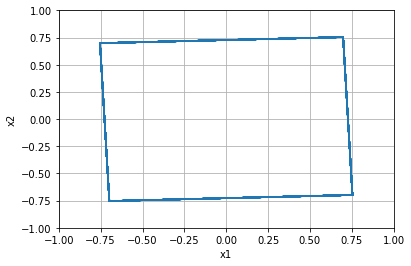


=================== Rollout 1778 =====================
x_init [[0.36]
 [0.76]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.36 0.76]
xx [0.36 0.76]
xxx [0.36 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.76]


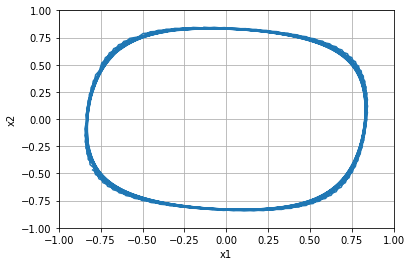


=================== Rollout 1779 =====================
x_init [[0.36]
 [0.8 ]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.36 0.8 ]
xx [0.36 0.8 ]
xxx [0.36 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.8]


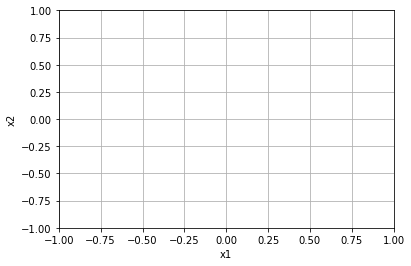


=================== Rollout 1780 =====================
x_init [[0.36]
 [0.84]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.36 0.84]
xx [0.36 0.84]
xxx [0.36 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.8400000000000001]


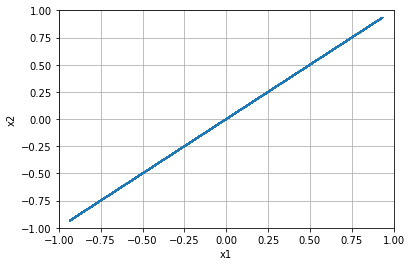


=================== Rollout 1781 =====================
x_init [[0.36]
 [0.88]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.36 0.88]
xx [0.36 0.88]
xxx [0.36 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.8800000000000001]


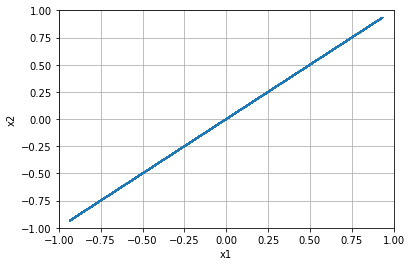


=================== Rollout 1782 =====================
x_init [[0.36]
 [0.92]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.36 0.92]
xx [0.36 0.92]
xxx [0.36 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.9199999999999999]


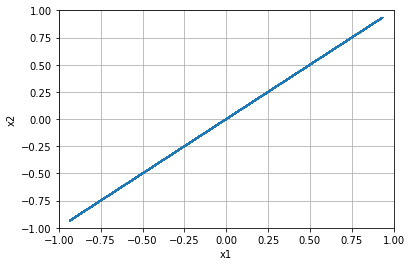


=================== Rollout 1783 =====================
x_init [[0.36]
 [0.96]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.36 0.96]
xx [0.36 0.96]
xxx [0.36 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 0.96]


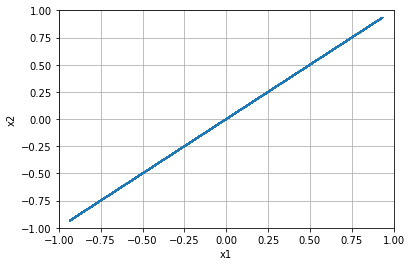


=================== Rollout 1784 =====================
x_init [[0.36]
 [1.  ]]
x_buffer [[0.36 0.36 0.36 0.36 0.36]
 [1.   1.   1.   1.   1.  ]]
x [0.36 1.  ]
xx [0.36 1.  ]
xxx [0.36 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.3600000000000001, 1.0]


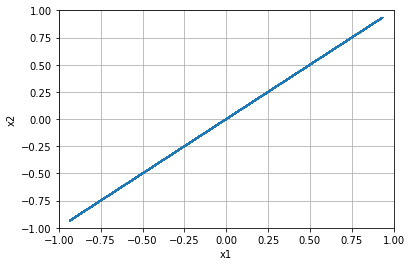


=================== Rollout 1785 =====================
x_init [[ 0.4]
 [-1. ]]
x_buffer [[ 0.4  0.4  0.4  0.4  0.4]
 [-1.  -1.  -1.  -1.  -1. ]]
x [ 0.4 -1. ]
xx [ 0.4 -1. ]
xxx [ 0.4 -1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -1.0]


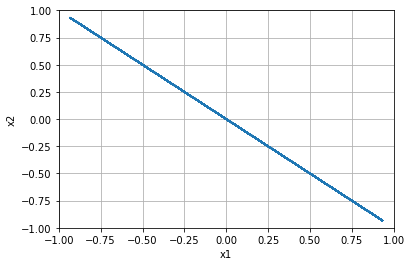


=================== Rollout 1786 =====================
x_init [[ 0.4 ]
 [-0.96]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.4  -0.96]
xx [ 0.4  -0.96]
xxx [ 0.4  -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.96]


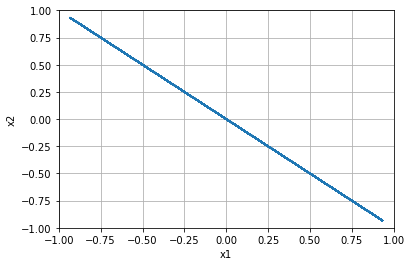


=================== Rollout 1787 =====================
x_init [[ 0.4 ]
 [-0.92]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.4  -0.92]
xx [ 0.4  -0.92]
xxx [ 0.4  -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.92]


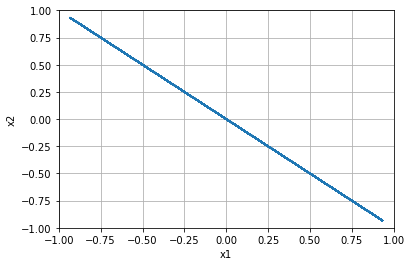


=================== Rollout 1788 =====================
x_init [[ 0.4 ]
 [-0.88]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.4  -0.88]
xx [ 0.4  -0.88]
xxx [ 0.4  -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.88]


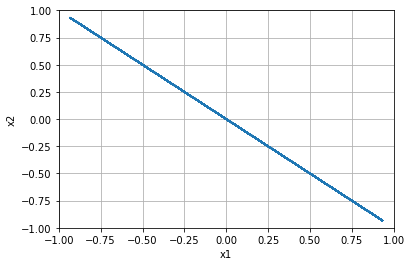


=================== Rollout 1789 =====================
x_init [[ 0.4 ]
 [-0.84]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.4  -0.84]
xx [ 0.4  -0.84]
xxx [ 0.4  -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.84]


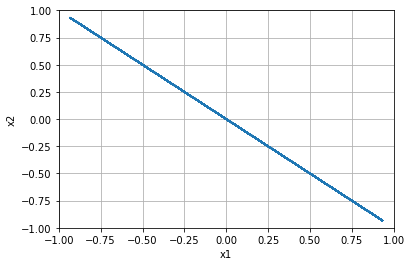


=================== Rollout 1790 =====================
x_init [[ 0.4]
 [-0.8]]
x_buffer [[ 0.4  0.4  0.4  0.4  0.4]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [ 0.4 -0.8]
xx [ 0.4 -0.8]
xxx [ 0.4 -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.8]


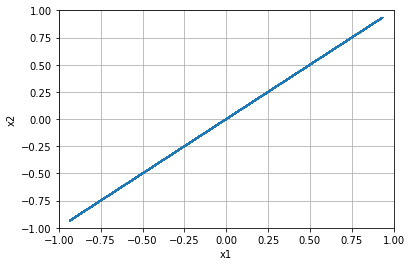


=================== Rollout 1791 =====================
x_init [[ 0.4 ]
 [-0.76]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.4  -0.76]
xx [ 0.4  -0.76]
xxx [ 0.4  -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.76]


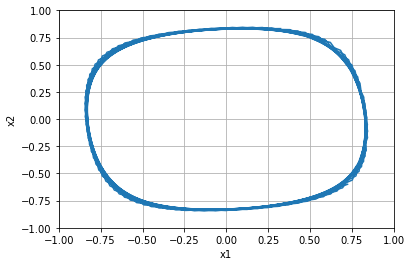


=================== Rollout 1792 =====================
x_init [[ 0.4 ]
 [-0.72]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.4  -0.72]
xx [ 0.4  -0.72]
xxx [ 0.4  -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.72]


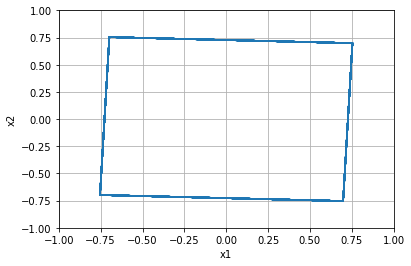


=================== Rollout 1793 =====================
x_init [[ 0.4 ]
 [-0.68]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.4  -0.68]
xx [ 0.4  -0.68]
xxx [ 0.4  -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.6799999999999999]


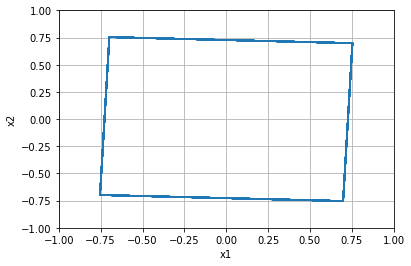


=================== Rollout 1794 =====================
x_init [[ 0.4 ]
 [-0.64]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.4  -0.64]
xx [ 0.4  -0.64]
xxx [ 0.4  -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.64]


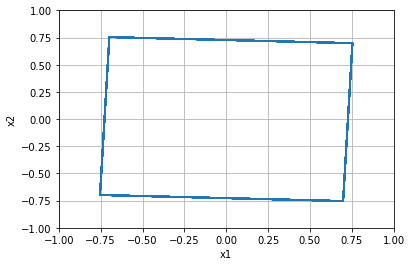


=================== Rollout 1795 =====================
x_init [[ 0.4]
 [-0.6]]
x_buffer [[ 0.4  0.4  0.4  0.4  0.4]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [ 0.4 -0.6]
xx [ 0.4 -0.6]
xxx [ 0.4 -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.6]


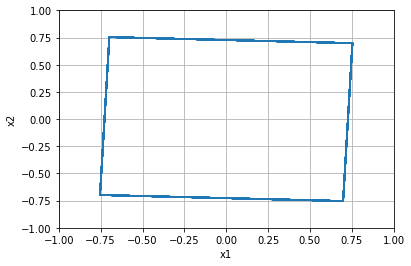


=================== Rollout 1796 =====================
x_init [[ 0.4 ]
 [-0.56]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.4  -0.56]
xx [ 0.4  -0.56]
xxx [ 0.4  -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.56]


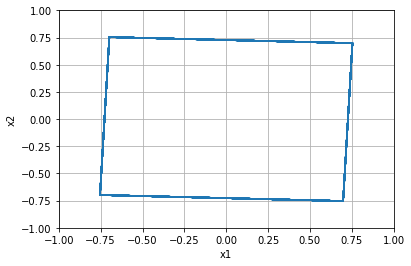


=================== Rollout 1797 =====================
x_init [[ 0.4 ]
 [-0.52]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.4  -0.52]
xx [ 0.4  -0.52]
xxx [ 0.4  -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.52]


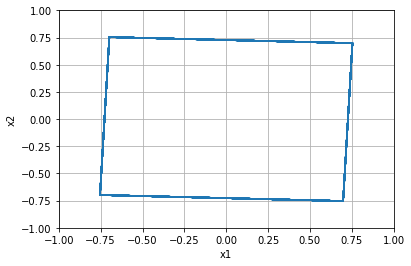


=================== Rollout 1798 =====================
x_init [[ 0.4 ]
 [-0.48]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.4  -0.48]
xx [ 0.4  -0.48]
xxx [ 0.4  -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.48]


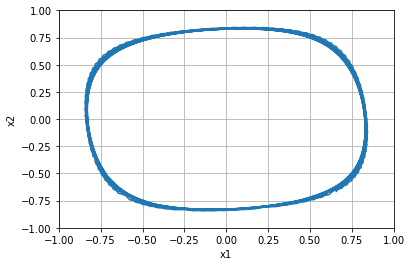


=================== Rollout 1799 =====================
x_init [[ 0.4 ]
 [-0.44]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.4  -0.44]
xx [ 0.4  -0.44]
xxx [ 0.4  -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.43999999999999995]


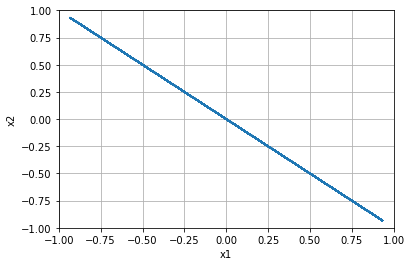


=================== Rollout 1800 =====================
x_init [[ 0.4]
 [-0.4]]
x_buffer [[ 0.4  0.4  0.4  0.4  0.4]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [ 0.4 -0.4]
xx [ 0.4 -0.4]
xxx [ 0.4 -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.4]


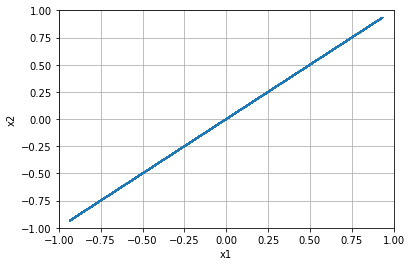


=================== Rollout 1801 =====================
x_init [[ 0.4 ]
 [-0.36]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.4  -0.36]
xx [ 0.4  -0.36]
xxx [ 0.4  -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.36]


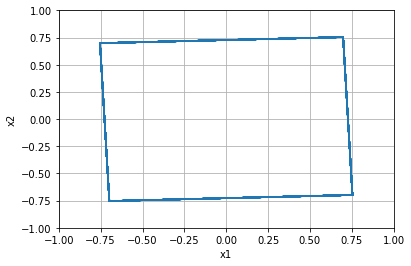


=================== Rollout 1802 =====================
x_init [[ 0.4 ]
 [-0.32]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.4  -0.32]
xx [ 0.4  -0.32]
xxx [ 0.4  -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.31999999999999995]


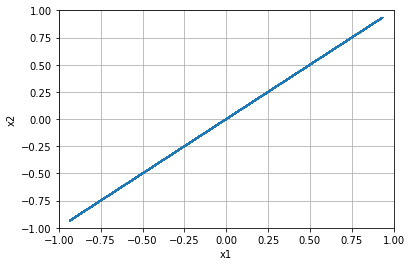


=================== Rollout 1803 =====================
x_init [[ 0.4 ]
 [-0.28]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.4  -0.28]
xx [ 0.4  -0.28]
xxx [ 0.4  -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.28]


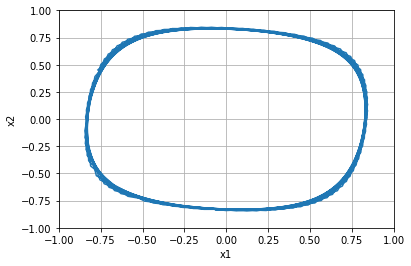


=================== Rollout 1804 =====================
x_init [[ 0.4 ]
 [-0.24]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.4  -0.24]
xx [ 0.4  -0.24]
xxx [ 0.4  -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.24]


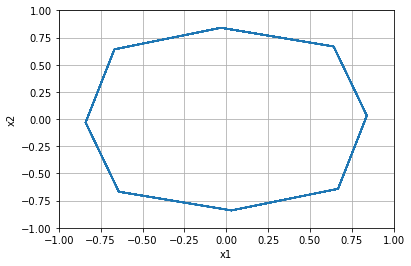


=================== Rollout 1805 =====================
x_init [[ 0.4]
 [-0.2]]
x_buffer [[ 0.4  0.4  0.4  0.4  0.4]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [ 0.4 -0.2]
xx [ 0.4 -0.2]
xxx [ 0.4 -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.19999999999999996]


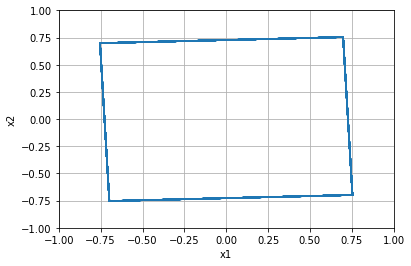


=================== Rollout 1806 =====================
x_init [[ 0.4 ]
 [-0.16]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.4  -0.16]
xx [ 0.4  -0.16]
xxx [ 0.4  -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.16000000000000003]


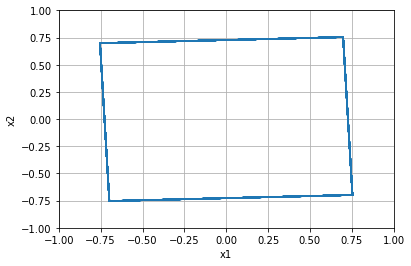


=================== Rollout 1807 =====================
x_init [[ 0.4 ]
 [-0.12]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.4  -0.12]
xx [ 0.4  -0.12]
xxx [ 0.4  -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.12]


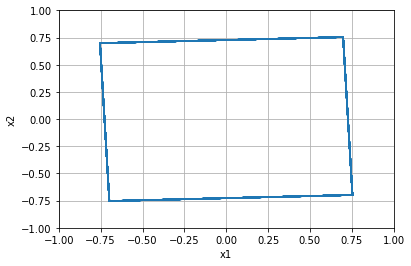


=================== Rollout 1808 =====================
x_init [[ 0.4 ]
 [-0.08]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.4  -0.08]
xx [ 0.4  -0.08]
xxx [ 0.4  -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.07999999999999996]


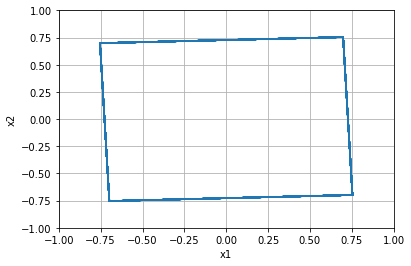


=================== Rollout 1809 =====================
x_init [[ 0.4 ]
 [-0.04]]
x_buffer [[ 0.4   0.4   0.4   0.4   0.4 ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.4  -0.04]
xx [ 0.4  -0.04]
xxx [ 0.4  -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, -0.040000000000000036]


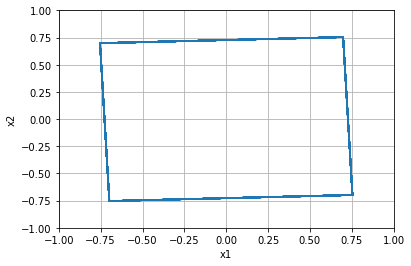


=================== Rollout 1810 =====================
x_init [[0.4]
 [0. ]]
x_buffer [[0.4 0.4 0.4 0.4 0.4]
 [0.  0.  0.  0.  0. ]]
x [0.4 0. ]
xx [0.4 0. ]
xxx [0.4 0. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.0]


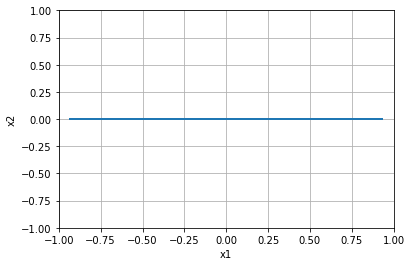


=================== Rollout 1811 =====================
x_init [[0.4 ]
 [0.04]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.4  0.04]
xx [0.4  0.04]
xxx [0.4  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.040000000000000036]


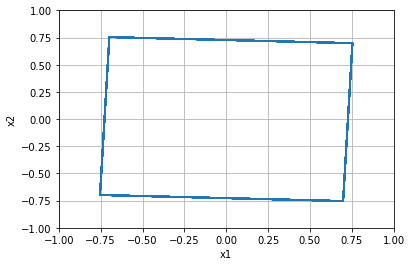


=================== Rollout 1812 =====================
x_init [[0.4 ]
 [0.08]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.4  0.08]
xx [0.4  0.08]
xxx [0.4  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.08000000000000007]


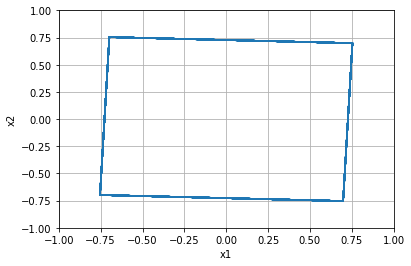


=================== Rollout 1813 =====================
x_init [[0.4 ]
 [0.12]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.4  0.12]
xx [0.4  0.12]
xxx [0.4  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.1200000000000001]


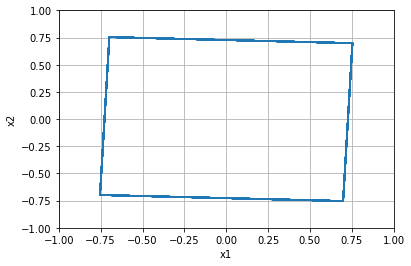


=================== Rollout 1814 =====================
x_init [[0.4 ]
 [0.16]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.4  0.16]
xx [0.4  0.16]
xxx [0.4  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.15999999999999992]


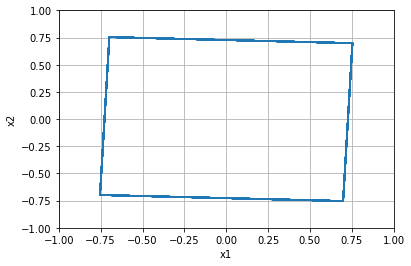


=================== Rollout 1815 =====================
x_init [[0.4]
 [0.2]]
x_buffer [[0.4 0.4 0.4 0.4 0.4]
 [0.2 0.2 0.2 0.2 0.2]]
x [0.4 0.2]
xx [0.4 0.2]
xxx [0.4 0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.19999999999999996]


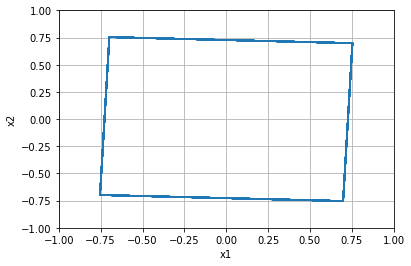


=================== Rollout 1816 =====================
x_init [[0.4 ]
 [0.24]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.4  0.24]
xx [0.4  0.24]
xxx [0.4  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.24]


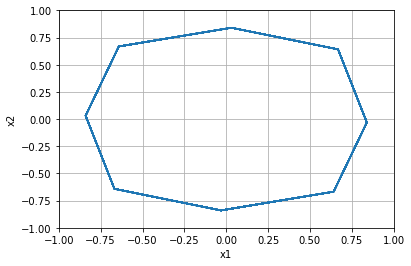


=================== Rollout 1817 =====================
x_init [[0.4 ]
 [0.28]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.4  0.28]
xx [0.4  0.28]
xxx [0.4  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.28]


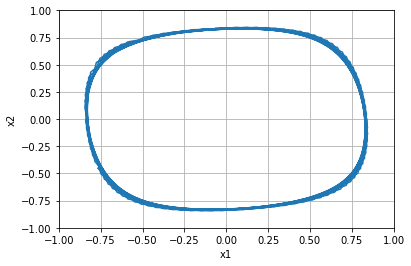


=================== Rollout 1818 =====================
x_init [[0.4 ]
 [0.32]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.4  0.32]
xx [0.4  0.32]
xxx [0.4  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.32000000000000006]


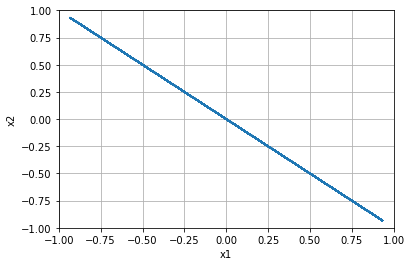


=================== Rollout 1819 =====================
x_init [[0.4 ]
 [0.36]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.4  0.36]
xx [0.4  0.36]
xxx [0.4  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.3600000000000001]


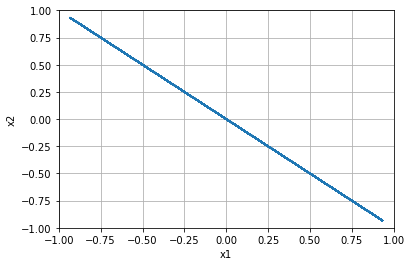


=================== Rollout 1820 =====================
x_init [[0.4]
 [0.4]]
x_buffer [[0.4 0.4 0.4 0.4 0.4]
 [0.4 0.4 0.4 0.4 0.4]]
x [0.4 0.4]
xx [0.4 0.4]
xxx [0.4 0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.40000000000000013]


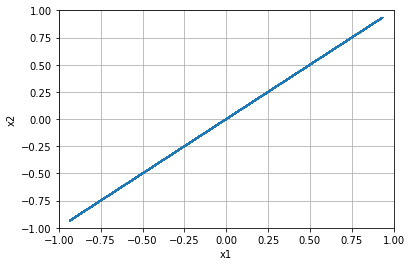


=================== Rollout 1821 =====================
x_init [[0.4 ]
 [0.44]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.4  0.44]
xx [0.4  0.44]
xxx [0.4  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.43999999999999995]


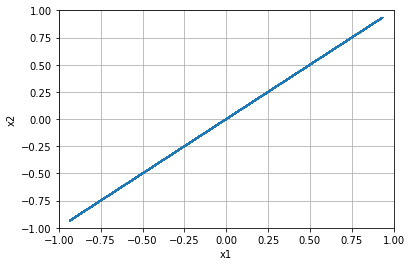


=================== Rollout 1822 =====================
x_init [[0.4 ]
 [0.48]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.4  0.48]
xx [0.4  0.48]
xxx [0.4  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.48]


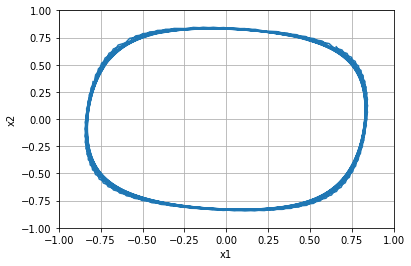


=================== Rollout 1823 =====================
x_init [[0.4 ]
 [0.52]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.4  0.52]
xx [0.4  0.52]
xxx [0.4  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.52]


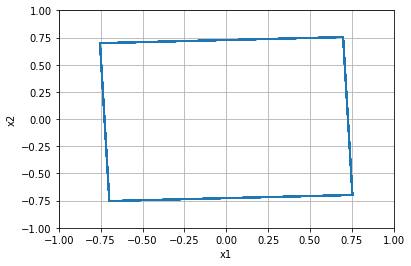


=================== Rollout 1824 =====================
x_init [[0.4 ]
 [0.56]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.4  0.56]
xx [0.4  0.56]
xxx [0.4  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.56]


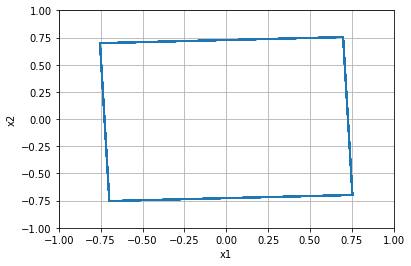


=================== Rollout 1825 =====================
x_init [[0.4]
 [0.6]]
x_buffer [[0.4 0.4 0.4 0.4 0.4]
 [0.6 0.6 0.6 0.6 0.6]]
x [0.4 0.6]
xx [0.4 0.6]
xxx [0.4 0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.6000000000000001]


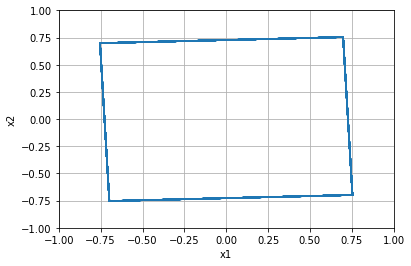


=================== Rollout 1826 =====================
x_init [[0.4 ]
 [0.64]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.4  0.64]
xx [0.4  0.64]
xxx [0.4  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.6400000000000001]


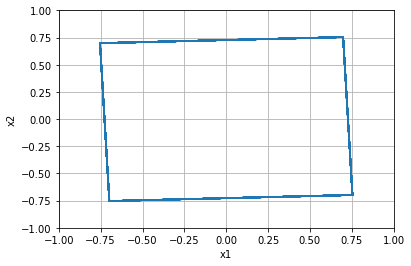


=================== Rollout 1827 =====================
x_init [[0.4 ]
 [0.68]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.4  0.68]
xx [0.4  0.68]
xxx [0.4  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.6799999999999999]


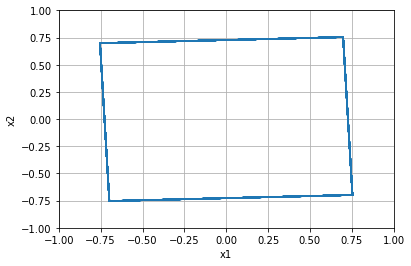


=================== Rollout 1828 =====================
x_init [[0.4 ]
 [0.72]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.4  0.72]
xx [0.4  0.72]
xxx [0.4  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.72]


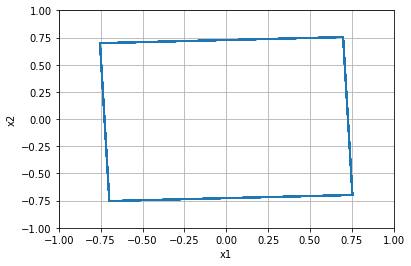


=================== Rollout 1829 =====================
x_init [[0.4 ]
 [0.76]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.4  0.76]
xx [0.4  0.76]
xxx [0.4  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.76]


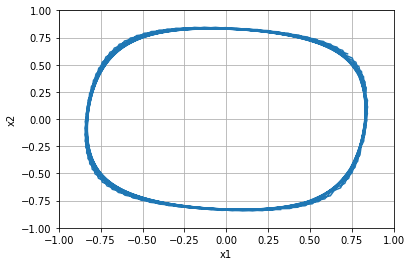


=================== Rollout 1830 =====================
x_init [[0.4]
 [0.8]]
x_buffer [[0.4 0.4 0.4 0.4 0.4]
 [0.8 0.8 0.8 0.8 0.8]]
x [0.4 0.8]
xx [0.4 0.8]
xxx [0.4 0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.8]


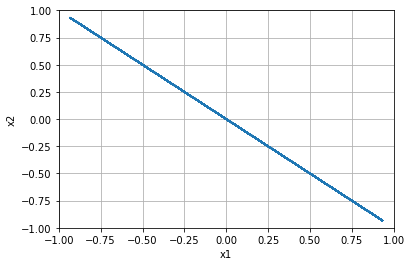


=================== Rollout 1831 =====================
x_init [[0.4 ]
 [0.84]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.4  0.84]
xx [0.4  0.84]
xxx [0.4  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.8400000000000001]


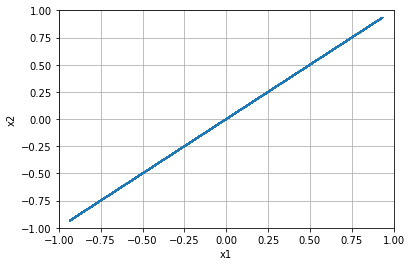


=================== Rollout 1832 =====================
x_init [[0.4 ]
 [0.88]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.4  0.88]
xx [0.4  0.88]
xxx [0.4  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.8800000000000001]


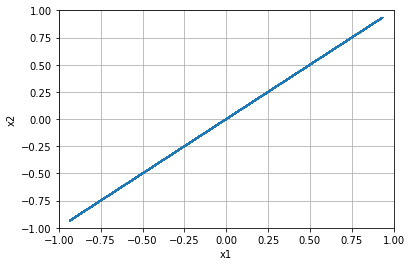


=================== Rollout 1833 =====================
x_init [[0.4 ]
 [0.92]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.4  0.92]
xx [0.4  0.92]
xxx [0.4  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.9199999999999999]


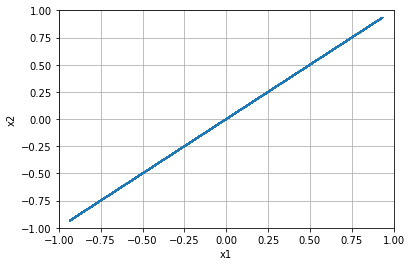


=================== Rollout 1834 =====================
x_init [[0.4 ]
 [0.96]]
x_buffer [[0.4  0.4  0.4  0.4  0.4 ]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.4  0.96]
xx [0.4  0.96]
xxx [0.4  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 0.96]


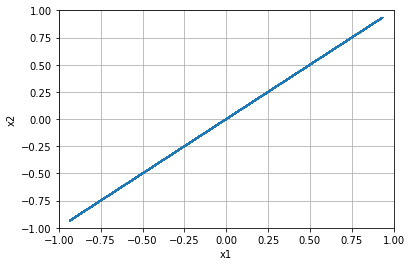


=================== Rollout 1835 =====================
x_init [[0.4]
 [1. ]]
x_buffer [[0.4 0.4 0.4 0.4 0.4]
 [1.  1.  1.  1.  1. ]]
x [0.4 1. ]
xx [0.4 1. ]
xxx [0.4 1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.40000000000000013, 1.0]


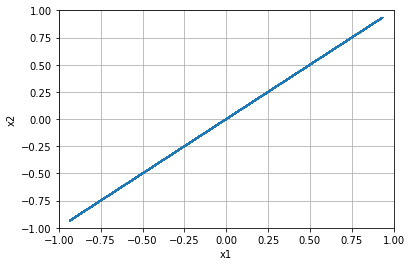


=================== Rollout 1836 =====================
x_init [[ 0.44]
 [-1.  ]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.44 -1.  ]
xx [ 0.44 -1.  ]
xxx [ 0.44 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -1.0]


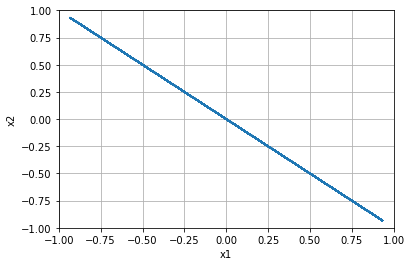


=================== Rollout 1837 =====================
x_init [[ 0.44]
 [-0.96]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.44 -0.96]
xx [ 0.44 -0.96]
xxx [ 0.44 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.96]


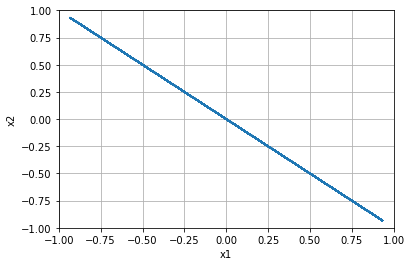


=================== Rollout 1838 =====================
x_init [[ 0.44]
 [-0.92]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.44 -0.92]
xx [ 0.44 -0.92]
xxx [ 0.44 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.92]


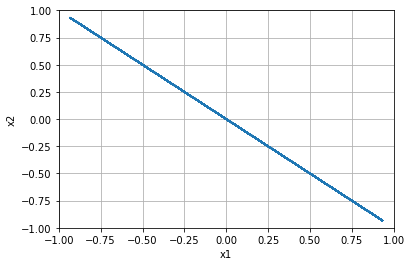


=================== Rollout 1839 =====================
x_init [[ 0.44]
 [-0.88]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.44 -0.88]
xx [ 0.44 -0.88]
xxx [ 0.44 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.88]


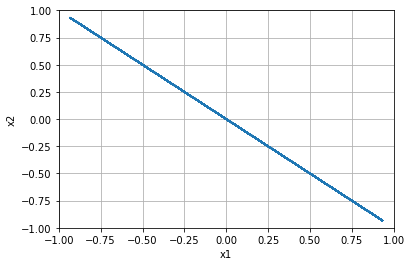


=================== Rollout 1840 =====================
x_init [[ 0.44]
 [-0.84]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.44 -0.84]
xx [ 0.44 -0.84]
xxx [ 0.44 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.84]


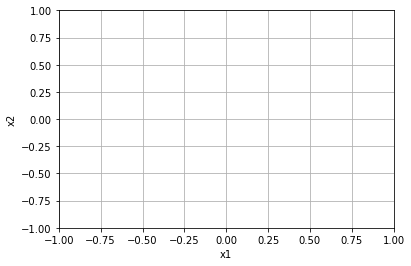


=================== Rollout 1841 =====================
x_init [[ 0.44]
 [-0.8 ]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.44 -0.8 ]
xx [ 0.44 -0.8 ]
xxx [ 0.44 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.8]


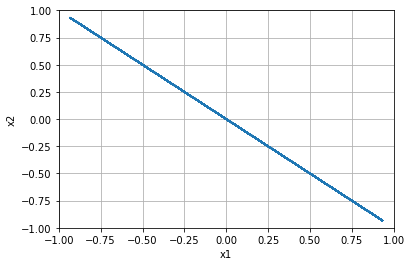


=================== Rollout 1842 =====================
x_init [[ 0.44]
 [-0.76]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.44 -0.76]
xx [ 0.44 -0.76]
xxx [ 0.44 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.76]


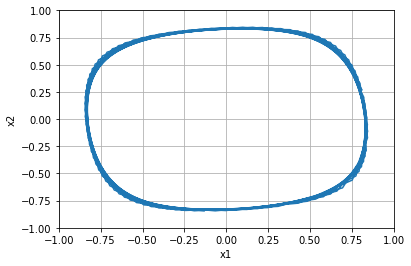


=================== Rollout 1843 =====================
x_init [[ 0.44]
 [-0.72]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.44 -0.72]
xx [ 0.44 -0.72]
xxx [ 0.44 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.72]


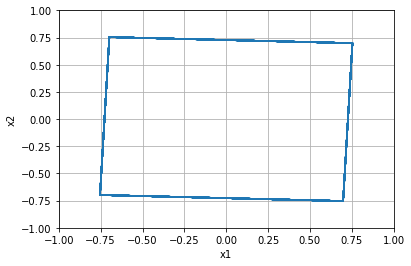


=================== Rollout 1844 =====================
x_init [[ 0.44]
 [-0.68]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.44 -0.68]
xx [ 0.44 -0.68]
xxx [ 0.44 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.6799999999999999]


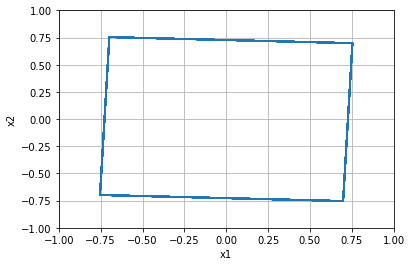


=================== Rollout 1845 =====================
x_init [[ 0.44]
 [-0.64]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.44 -0.64]
xx [ 0.44 -0.64]
xxx [ 0.44 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.64]


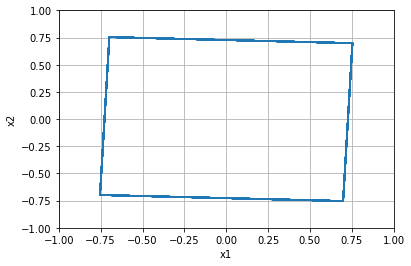


=================== Rollout 1846 =====================
x_init [[ 0.44]
 [-0.6 ]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.44 -0.6 ]
xx [ 0.44 -0.6 ]
xxx [ 0.44 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.6]


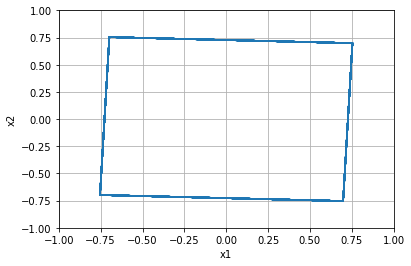


=================== Rollout 1847 =====================
x_init [[ 0.44]
 [-0.56]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.44 -0.56]
xx [ 0.44 -0.56]
xxx [ 0.44 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.56]


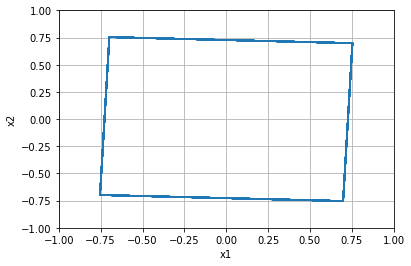


=================== Rollout 1848 =====================
x_init [[ 0.44]
 [-0.52]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.44 -0.52]
xx [ 0.44 -0.52]
xxx [ 0.44 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.52]


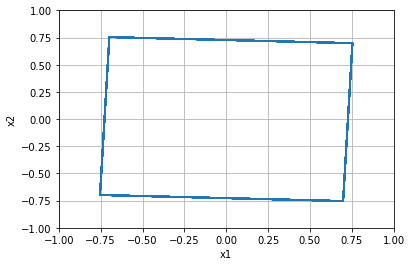


=================== Rollout 1849 =====================
x_init [[ 0.44]
 [-0.48]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.44 -0.48]
xx [ 0.44 -0.48]
xxx [ 0.44 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.48]


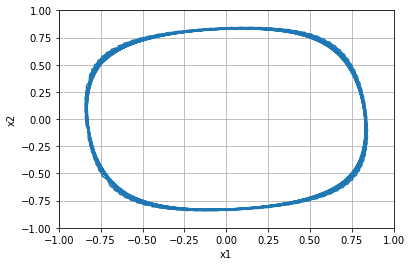


=================== Rollout 1850 =====================
x_init [[ 0.44]
 [-0.44]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.44 -0.44]
xx [ 0.44 -0.44]
xxx [ 0.44 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.43999999999999995]


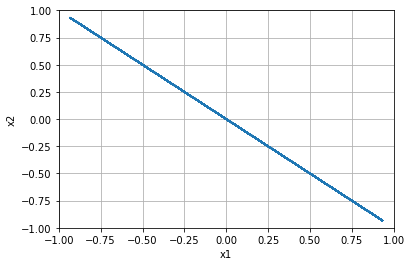


=================== Rollout 1851 =====================
x_init [[ 0.44]
 [-0.4 ]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.44 -0.4 ]
xx [ 0.44 -0.4 ]
xxx [ 0.44 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.4]


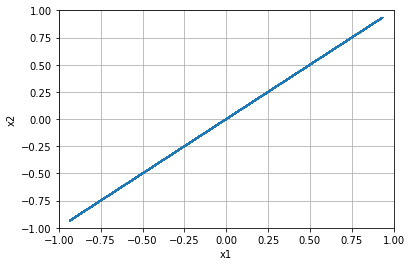


=================== Rollout 1852 =====================
x_init [[ 0.44]
 [-0.36]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.44 -0.36]
xx [ 0.44 -0.36]
xxx [ 0.44 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.36]


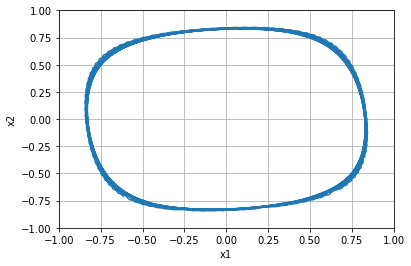


=================== Rollout 1853 =====================
x_init [[ 0.44]
 [-0.32]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.44 -0.32]
xx [ 0.44 -0.32]
xxx [ 0.44 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.31999999999999995]


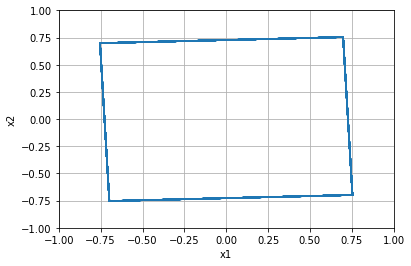


=================== Rollout 1854 =====================
x_init [[ 0.44]
 [-0.28]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.44 -0.28]
xx [ 0.44 -0.28]
xxx [ 0.44 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.28]


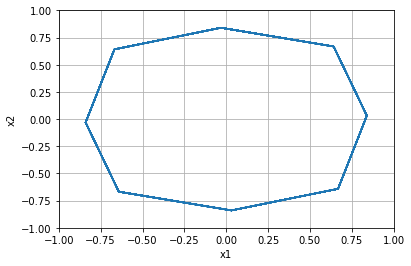


=================== Rollout 1855 =====================
x_init [[ 0.44]
 [-0.24]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.44 -0.24]
xx [ 0.44 -0.24]
xxx [ 0.44 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.24]


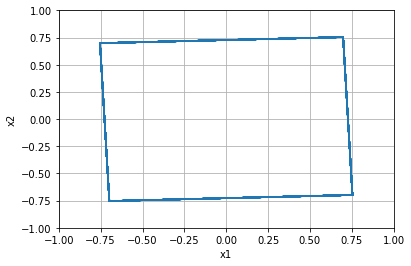


=================== Rollout 1856 =====================
x_init [[ 0.44]
 [-0.2 ]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.44 -0.2 ]
xx [ 0.44 -0.2 ]
xxx [ 0.44 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.19999999999999996]


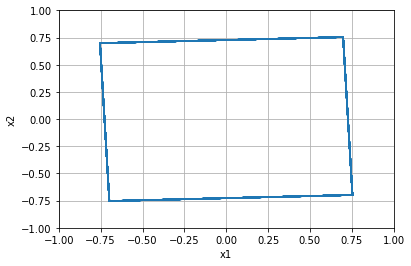


=================== Rollout 1857 =====================
x_init [[ 0.44]
 [-0.16]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.44 -0.16]
xx [ 0.44 -0.16]
xxx [ 0.44 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.16000000000000003]


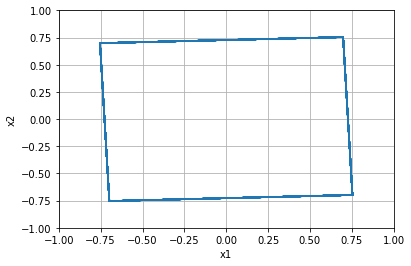


=================== Rollout 1858 =====================
x_init [[ 0.44]
 [-0.12]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.44 -0.12]
xx [ 0.44 -0.12]
xxx [ 0.44 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.12]


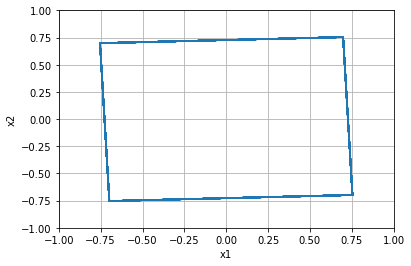


=================== Rollout 1859 =====================
x_init [[ 0.44]
 [-0.08]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.44 -0.08]
xx [ 0.44 -0.08]
xxx [ 0.44 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.07999999999999996]


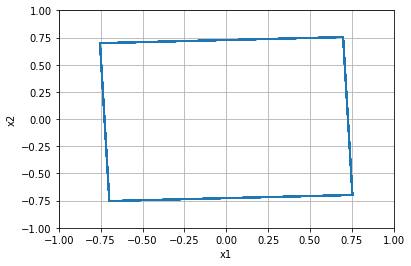


=================== Rollout 1860 =====================
x_init [[ 0.44]
 [-0.04]]
x_buffer [[ 0.44  0.44  0.44  0.44  0.44]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.44 -0.04]
xx [ 0.44 -0.04]
xxx [ 0.44 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, -0.040000000000000036]


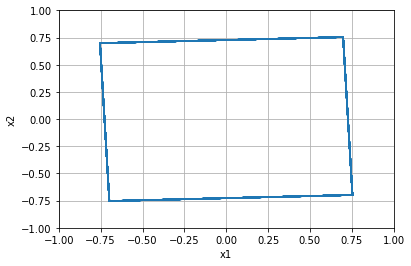


=================== Rollout 1861 =====================
x_init [[0.44]
 [0.  ]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.   0.   0.   0.   0.  ]]
x [0.44 0.  ]
xx [0.44 0.  ]
xxx [0.44 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.0]


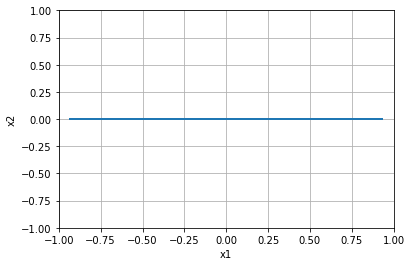


=================== Rollout 1862 =====================
x_init [[0.44]
 [0.04]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.44 0.04]
xx [0.44 0.04]
xxx [0.44 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.040000000000000036]


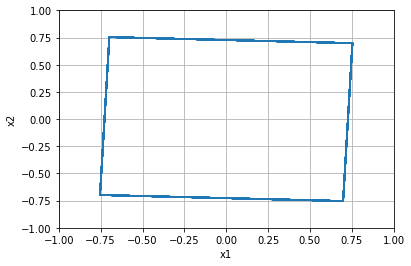


=================== Rollout 1863 =====================
x_init [[0.44]
 [0.08]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.44 0.08]
xx [0.44 0.08]
xxx [0.44 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.08000000000000007]


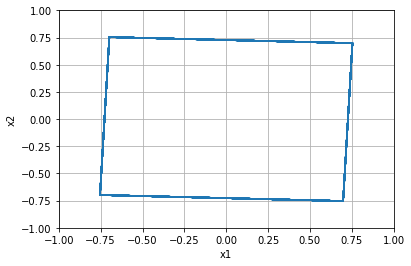


=================== Rollout 1864 =====================
x_init [[0.44]
 [0.12]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.44 0.12]
xx [0.44 0.12]
xxx [0.44 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.1200000000000001]


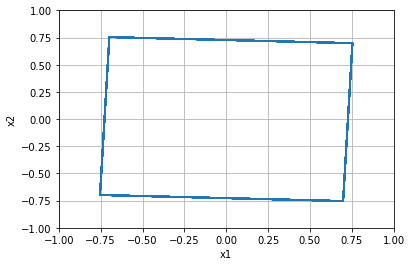


=================== Rollout 1865 =====================
x_init [[0.44]
 [0.16]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.44 0.16]
xx [0.44 0.16]
xxx [0.44 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.15999999999999992]


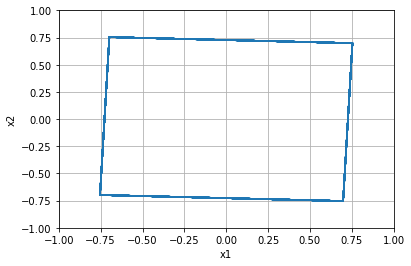


=================== Rollout 1866 =====================
x_init [[0.44]
 [0.2 ]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.44 0.2 ]
xx [0.44 0.2 ]
xxx [0.44 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.19999999999999996]


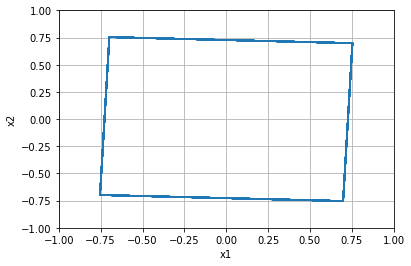


=================== Rollout 1867 =====================
x_init [[0.44]
 [0.24]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.44 0.24]
xx [0.44 0.24]
xxx [0.44 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.24]


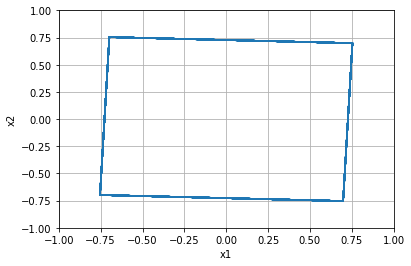


=================== Rollout 1868 =====================
x_init [[0.44]
 [0.28]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.44 0.28]
xx [0.44 0.28]
xxx [0.44 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.28]


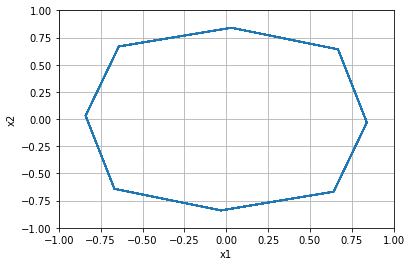


=================== Rollout 1869 =====================
x_init [[0.44]
 [0.32]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.44 0.32]
xx [0.44 0.32]
xxx [0.44 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.32000000000000006]


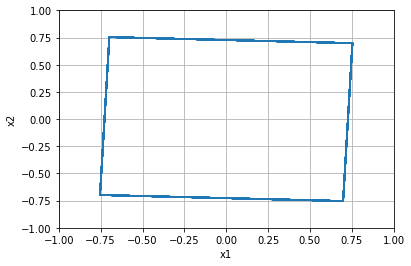


=================== Rollout 1870 =====================
x_init [[0.44]
 [0.36]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.44 0.36]
xx [0.44 0.36]
xxx [0.44 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.3600000000000001]


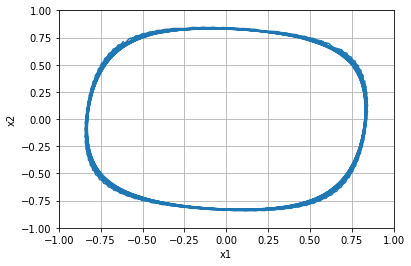


=================== Rollout 1871 =====================
x_init [[0.44]
 [0.4 ]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.44 0.4 ]
xx [0.44 0.4 ]
xxx [0.44 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.40000000000000013]


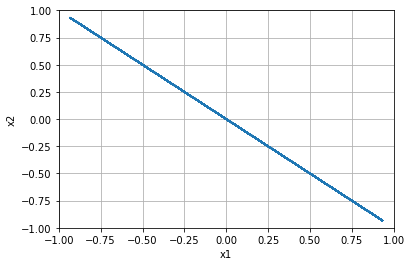


=================== Rollout 1872 =====================
x_init [[0.44]
 [0.44]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.44 0.44]
xx [0.44 0.44]
xxx [0.44 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.43999999999999995]


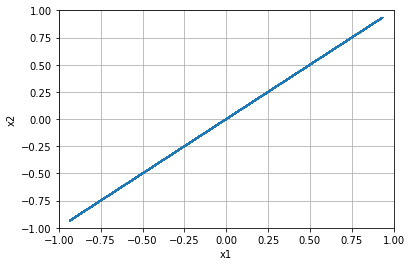


=================== Rollout 1873 =====================
x_init [[0.44]
 [0.48]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.44 0.48]
xx [0.44 0.48]
xxx [0.44 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.48]


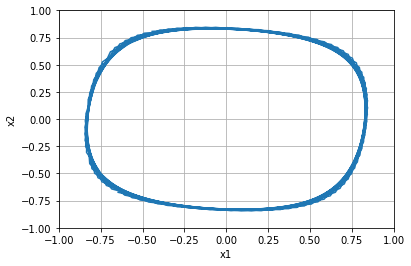


=================== Rollout 1874 =====================
x_init [[0.44]
 [0.52]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.44 0.52]
xx [0.44 0.52]
xxx [0.44 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.52]


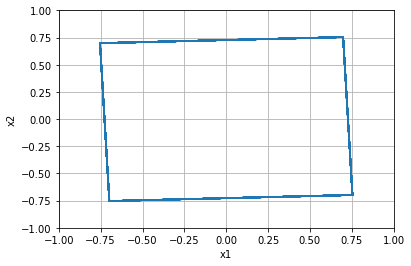


=================== Rollout 1875 =====================
x_init [[0.44]
 [0.56]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.44 0.56]
xx [0.44 0.56]
xxx [0.44 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.56]


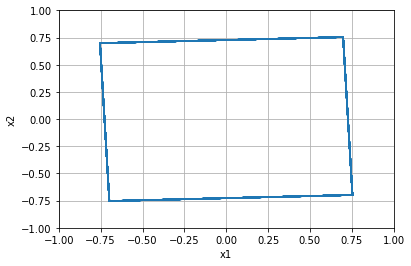


=================== Rollout 1876 =====================
x_init [[0.44]
 [0.6 ]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.44 0.6 ]
xx [0.44 0.6 ]
xxx [0.44 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.6000000000000001]


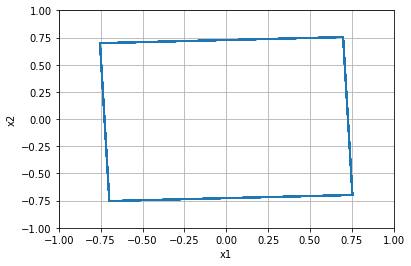


=================== Rollout 1877 =====================
x_init [[0.44]
 [0.64]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.44 0.64]
xx [0.44 0.64]
xxx [0.44 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.6400000000000001]


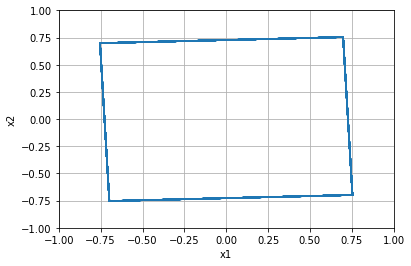


=================== Rollout 1878 =====================
x_init [[0.44]
 [0.68]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.44 0.68]
xx [0.44 0.68]
xxx [0.44 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.6799999999999999]


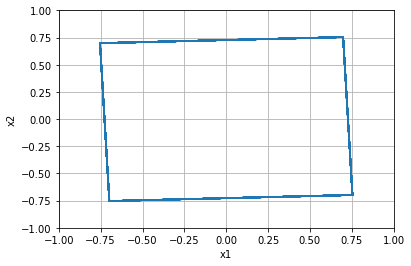


=================== Rollout 1879 =====================
x_init [[0.44]
 [0.72]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.44 0.72]
xx [0.44 0.72]
xxx [0.44 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.72]


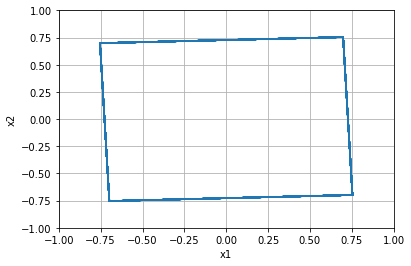


=================== Rollout 1880 =====================
x_init [[0.44]
 [0.76]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.44 0.76]
xx [0.44 0.76]
xxx [0.44 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.76]


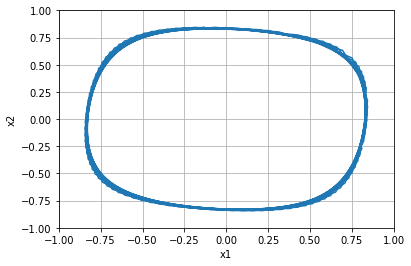


=================== Rollout 1881 =====================
x_init [[0.44]
 [0.8 ]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.44 0.8 ]
xx [0.44 0.8 ]
xxx [0.44 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.8]


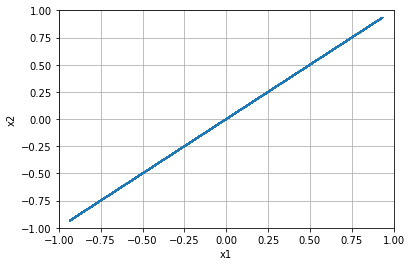


=================== Rollout 1882 =====================
x_init [[0.44]
 [0.84]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.44 0.84]
xx [0.44 0.84]
xxx [0.44 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.8400000000000001]


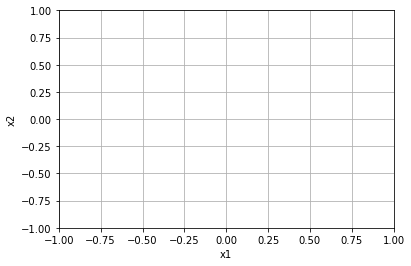


=================== Rollout 1883 =====================
x_init [[0.44]
 [0.88]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.44 0.88]
xx [0.44 0.88]
xxx [0.44 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.8800000000000001]


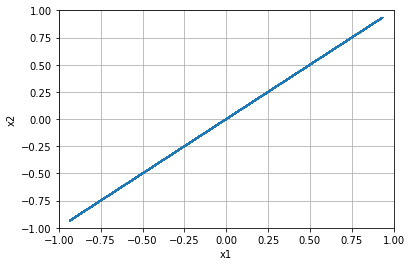


=================== Rollout 1884 =====================
x_init [[0.44]
 [0.92]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.44 0.92]
xx [0.44 0.92]
xxx [0.44 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.9199999999999999]


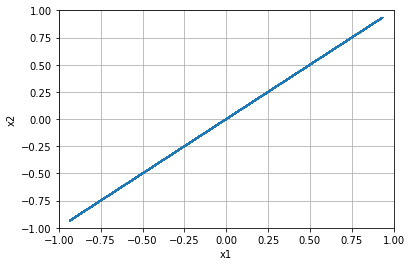


=================== Rollout 1885 =====================
x_init [[0.44]
 [0.96]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.44 0.96]
xx [0.44 0.96]
xxx [0.44 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 0.96]


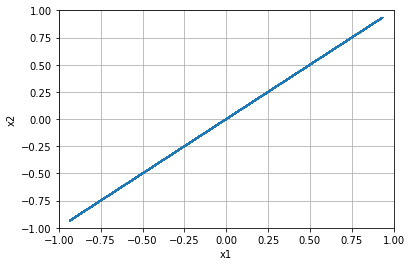


=================== Rollout 1886 =====================
x_init [[0.44]
 [1.  ]]
x_buffer [[0.44 0.44 0.44 0.44 0.44]
 [1.   1.   1.   1.   1.  ]]
x [0.44 1.  ]
xx [0.44 1.  ]
xxx [0.44 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.43999999999999995, 1.0]


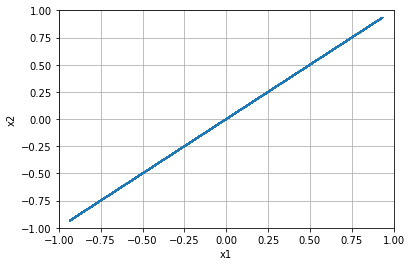


=================== Rollout 1887 =====================
x_init [[ 0.48]
 [-1.  ]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.48 -1.  ]
xx [ 0.48 -1.  ]
xxx [ 0.48 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -1.0]


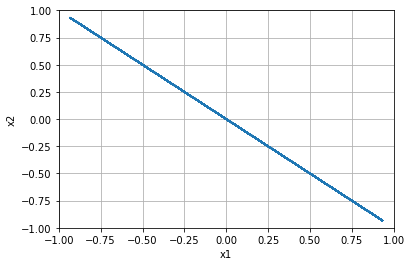


=================== Rollout 1888 =====================
x_init [[ 0.48]
 [-0.96]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.48 -0.96]
xx [ 0.48 -0.96]
xxx [ 0.48 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.96]


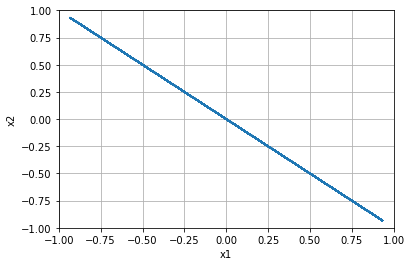


=================== Rollout 1889 =====================
x_init [[ 0.48]
 [-0.92]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.48 -0.92]
xx [ 0.48 -0.92]
xxx [ 0.48 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.92]


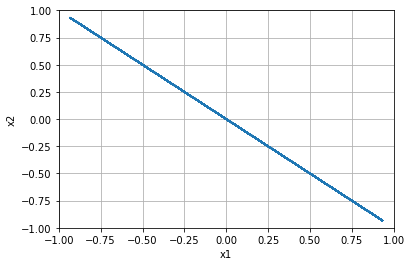


=================== Rollout 1890 =====================
x_init [[ 0.48]
 [-0.88]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.48 -0.88]
xx [ 0.48 -0.88]
xxx [ 0.48 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.88]


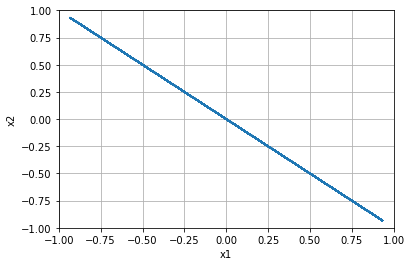


=================== Rollout 1891 =====================
x_init [[ 0.48]
 [-0.84]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.48 -0.84]
xx [ 0.48 -0.84]
xxx [ 0.48 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.84]


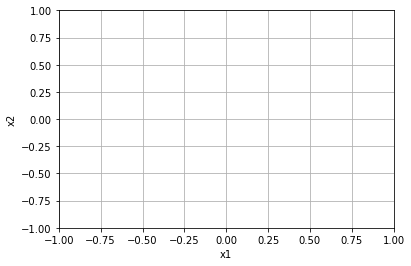


=================== Rollout 1892 =====================
x_init [[ 0.48]
 [-0.8 ]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.48 -0.8 ]
xx [ 0.48 -0.8 ]
xxx [ 0.48 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.8]


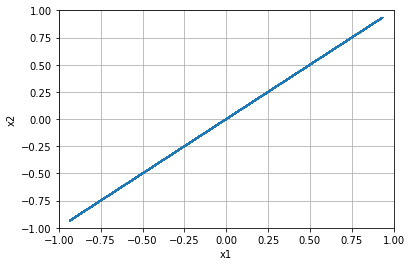


=================== Rollout 1893 =====================
x_init [[ 0.48]
 [-0.76]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.48 -0.76]
xx [ 0.48 -0.76]
xxx [ 0.48 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.76]


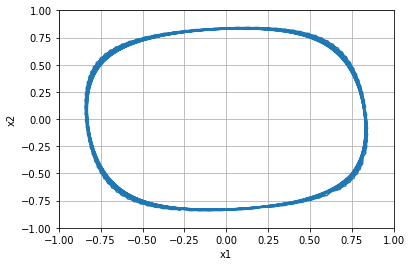


=================== Rollout 1894 =====================
x_init [[ 0.48]
 [-0.72]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.48 -0.72]
xx [ 0.48 -0.72]
xxx [ 0.48 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.72]


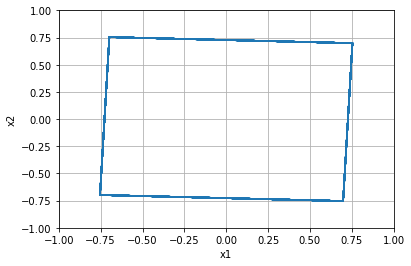


=================== Rollout 1895 =====================
x_init [[ 0.48]
 [-0.68]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.48 -0.68]
xx [ 0.48 -0.68]
xxx [ 0.48 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.6799999999999999]


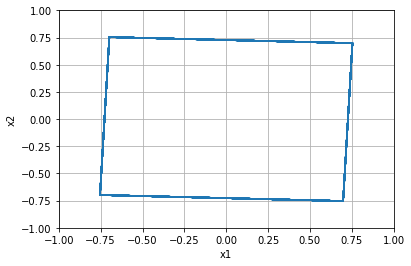


=================== Rollout 1896 =====================
x_init [[ 0.48]
 [-0.64]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.48 -0.64]
xx [ 0.48 -0.64]
xxx [ 0.48 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.64]


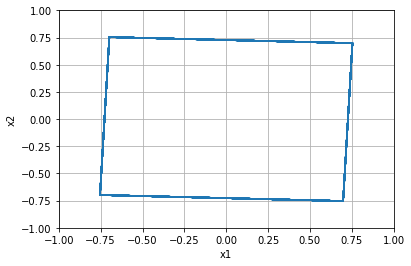


=================== Rollout 1897 =====================
x_init [[ 0.48]
 [-0.6 ]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.48 -0.6 ]
xx [ 0.48 -0.6 ]
xxx [ 0.48 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.6]


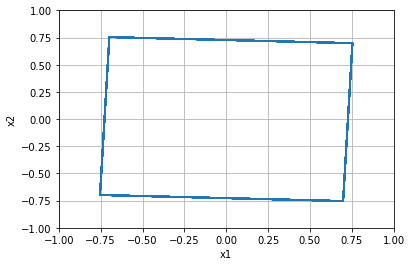


=================== Rollout 1898 =====================
x_init [[ 0.48]
 [-0.56]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.48 -0.56]
xx [ 0.48 -0.56]
xxx [ 0.48 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.56]


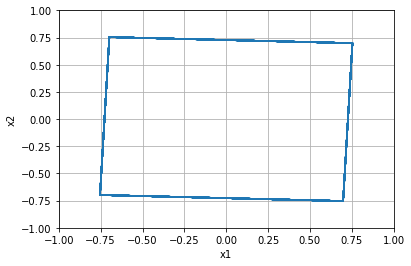


=================== Rollout 1899 =====================
x_init [[ 0.48]
 [-0.52]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.48 -0.52]
xx [ 0.48 -0.52]
xxx [ 0.48 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.52]


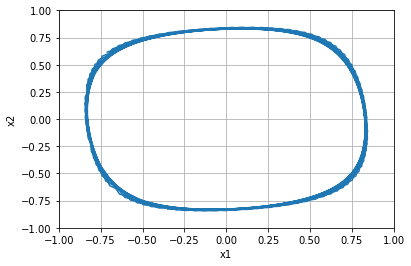


=================== Rollout 1900 =====================
x_init [[ 0.48]
 [-0.48]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.48 -0.48]
xx [ 0.48 -0.48]
xxx [ 0.48 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.48]


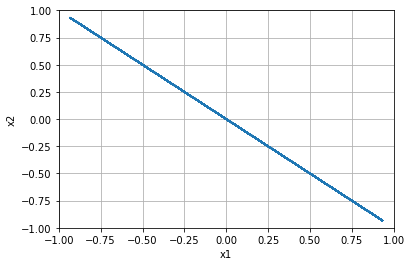


=================== Rollout 1901 =====================
x_init [[ 0.48]
 [-0.44]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.48 -0.44]
xx [ 0.48 -0.44]
xxx [ 0.48 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.43999999999999995]


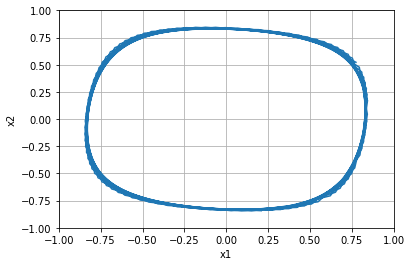


=================== Rollout 1902 =====================
x_init [[ 0.48]
 [-0.4 ]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.48 -0.4 ]
xx [ 0.48 -0.4 ]
xxx [ 0.48 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.4]


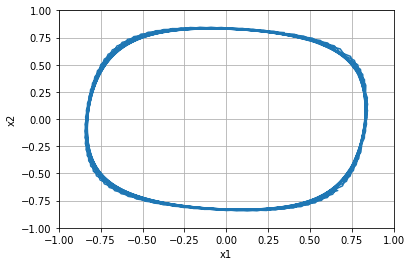


=================== Rollout 1903 =====================
x_init [[ 0.48]
 [-0.36]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.48 -0.36]
xx [ 0.48 -0.36]
xxx [ 0.48 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.36]


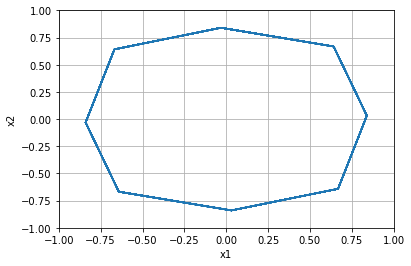


=================== Rollout 1904 =====================
x_init [[ 0.48]
 [-0.32]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.48 -0.32]
xx [ 0.48 -0.32]
xxx [ 0.48 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.31999999999999995]


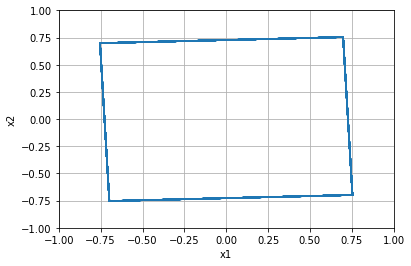


=================== Rollout 1905 =====================
x_init [[ 0.48]
 [-0.28]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.48 -0.28]
xx [ 0.48 -0.28]
xxx [ 0.48 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.28]


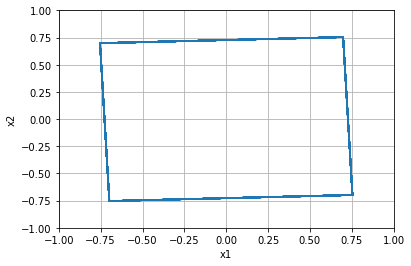


=================== Rollout 1906 =====================
x_init [[ 0.48]
 [-0.24]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.48 -0.24]
xx [ 0.48 -0.24]
xxx [ 0.48 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.24]


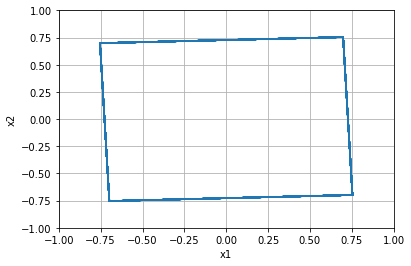


=================== Rollout 1907 =====================
x_init [[ 0.48]
 [-0.2 ]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.48 -0.2 ]
xx [ 0.48 -0.2 ]
xxx [ 0.48 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.19999999999999996]


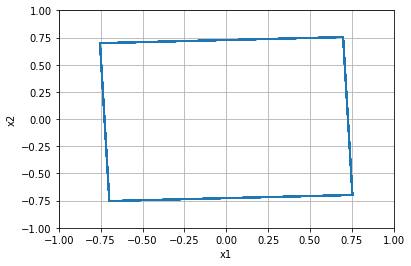


=================== Rollout 1908 =====================
x_init [[ 0.48]
 [-0.16]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.48 -0.16]
xx [ 0.48 -0.16]
xxx [ 0.48 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.16000000000000003]


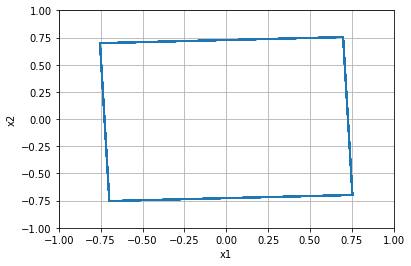


=================== Rollout 1909 =====================
x_init [[ 0.48]
 [-0.12]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.48 -0.12]
xx [ 0.48 -0.12]
xxx [ 0.48 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.12]


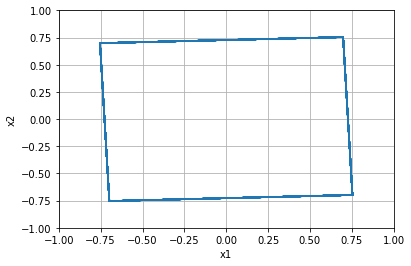


=================== Rollout 1910 =====================
x_init [[ 0.48]
 [-0.08]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.48 -0.08]
xx [ 0.48 -0.08]
xxx [ 0.48 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.07999999999999996]


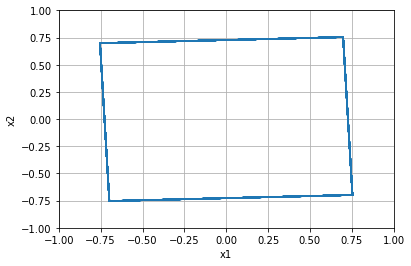


=================== Rollout 1911 =====================
x_init [[ 0.48]
 [-0.04]]
x_buffer [[ 0.48  0.48  0.48  0.48  0.48]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.48 -0.04]
xx [ 0.48 -0.04]
xxx [ 0.48 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, -0.040000000000000036]


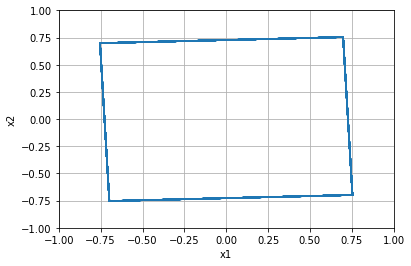


=================== Rollout 1912 =====================
x_init [[0.48]
 [0.  ]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.   0.   0.   0.   0.  ]]
x [0.48 0.  ]
xx [0.48 0.  ]
xxx [0.48 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.0]


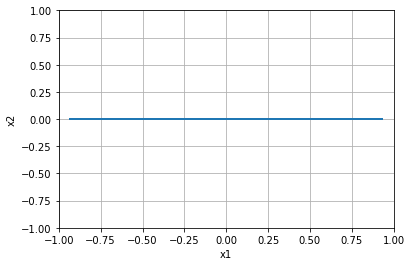


=================== Rollout 1913 =====================
x_init [[0.48]
 [0.04]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.48 0.04]
xx [0.48 0.04]
xxx [0.48 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.040000000000000036]


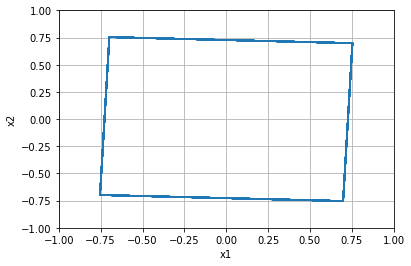


=================== Rollout 1914 =====================
x_init [[0.48]
 [0.08]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.48 0.08]
xx [0.48 0.08]
xxx [0.48 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.08000000000000007]


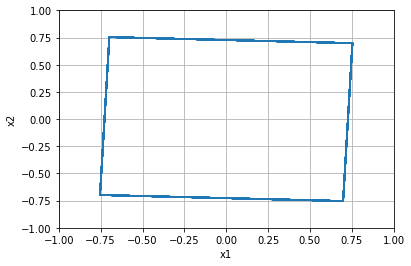


=================== Rollout 1915 =====================
x_init [[0.48]
 [0.12]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.48 0.12]
xx [0.48 0.12]
xxx [0.48 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.1200000000000001]


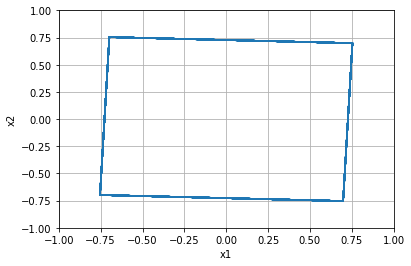


=================== Rollout 1916 =====================
x_init [[0.48]
 [0.16]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.48 0.16]
xx [0.48 0.16]
xxx [0.48 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.15999999999999992]


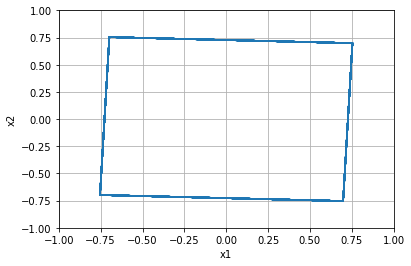


=================== Rollout 1917 =====================
x_init [[0.48]
 [0.2 ]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.48 0.2 ]
xx [0.48 0.2 ]
xxx [0.48 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.19999999999999996]


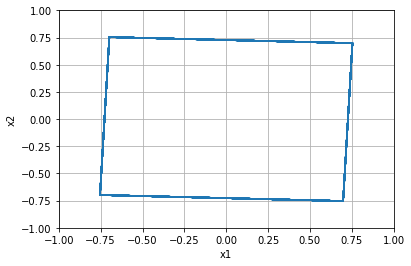


=================== Rollout 1918 =====================
x_init [[0.48]
 [0.24]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.48 0.24]
xx [0.48 0.24]
xxx [0.48 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.24]


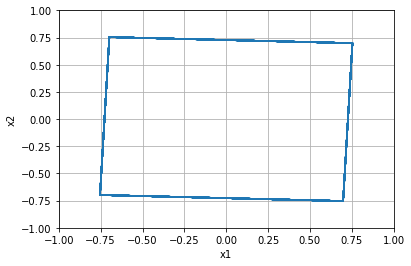


=================== Rollout 1919 =====================
x_init [[0.48]
 [0.28]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.48 0.28]
xx [0.48 0.28]
xxx [0.48 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.28]


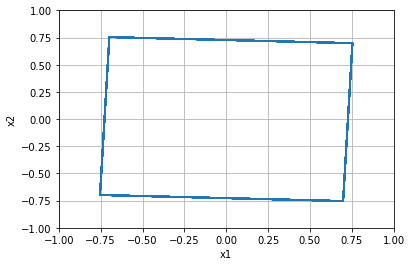


=================== Rollout 1920 =====================
x_init [[0.48]
 [0.32]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.48 0.32]
xx [0.48 0.32]
xxx [0.48 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.32000000000000006]


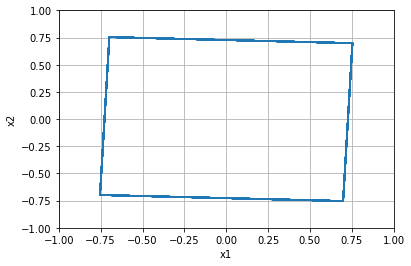


=================== Rollout 1921 =====================
x_init [[0.48]
 [0.36]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.48 0.36]
xx [0.48 0.36]
xxx [0.48 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.3600000000000001]


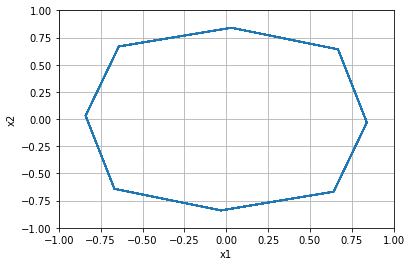


=================== Rollout 1922 =====================
x_init [[0.48]
 [0.4 ]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.48 0.4 ]
xx [0.48 0.4 ]
xxx [0.48 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.40000000000000013]


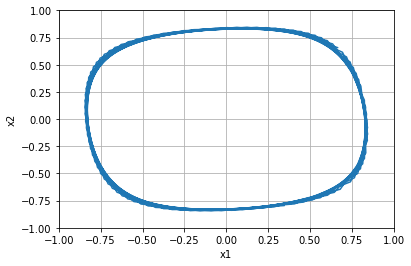


=================== Rollout 1923 =====================
x_init [[0.48]
 [0.44]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.48 0.44]
xx [0.48 0.44]
xxx [0.48 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.43999999999999995]


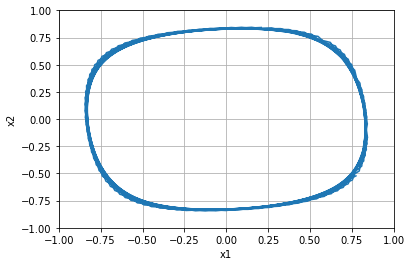


=================== Rollout 1924 =====================
x_init [[0.48]
 [0.48]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.48 0.48]
xx [0.48 0.48]
xxx [0.48 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.48]


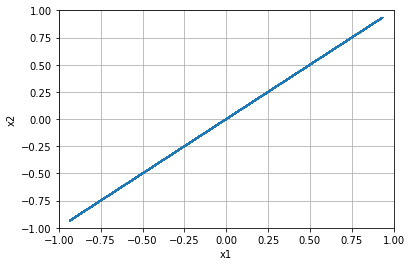


=================== Rollout 1925 =====================
x_init [[0.48]
 [0.52]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.48 0.52]
xx [0.48 0.52]
xxx [0.48 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.52]


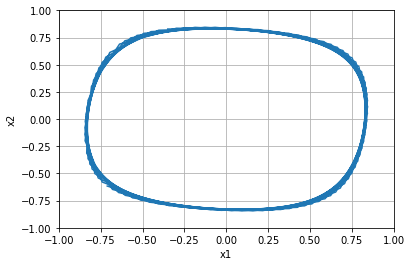


=================== Rollout 1926 =====================
x_init [[0.48]
 [0.56]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.48 0.56]
xx [0.48 0.56]
xxx [0.48 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.56]


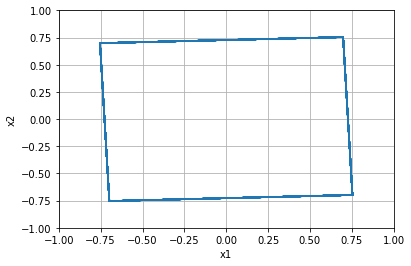


=================== Rollout 1927 =====================
x_init [[0.48]
 [0.6 ]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.48 0.6 ]
xx [0.48 0.6 ]
xxx [0.48 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.6000000000000001]


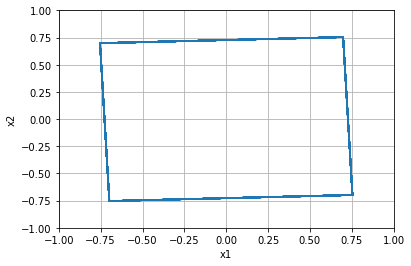


=================== Rollout 1928 =====================
x_init [[0.48]
 [0.64]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.48 0.64]
xx [0.48 0.64]
xxx [0.48 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.6400000000000001]


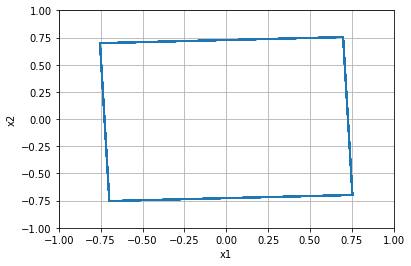


=================== Rollout 1929 =====================
x_init [[0.48]
 [0.68]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.48 0.68]
xx [0.48 0.68]
xxx [0.48 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.6799999999999999]


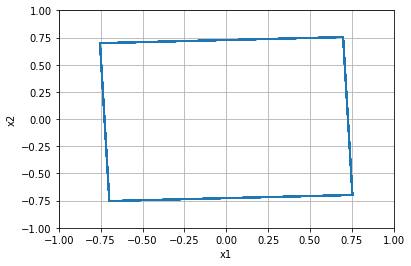


=================== Rollout 1930 =====================
x_init [[0.48]
 [0.72]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.48 0.72]
xx [0.48 0.72]
xxx [0.48 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.72]


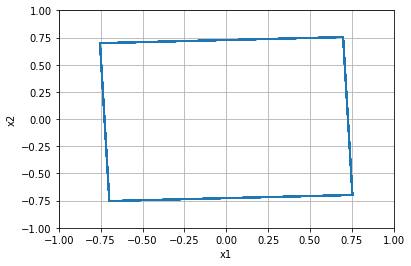


=================== Rollout 1931 =====================
x_init [[0.48]
 [0.76]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.48 0.76]
xx [0.48 0.76]
xxx [0.48 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.76]


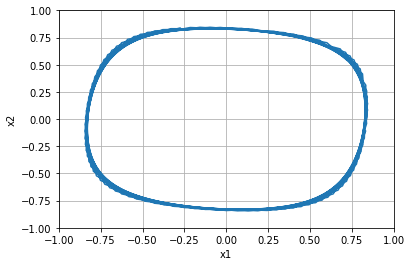


=================== Rollout 1932 =====================
x_init [[0.48]
 [0.8 ]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.48 0.8 ]
xx [0.48 0.8 ]
xxx [0.48 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.8]


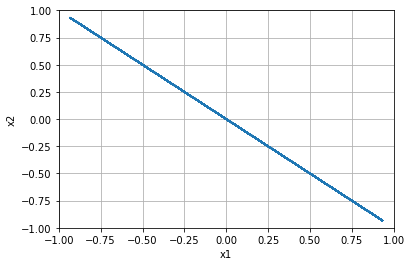


=================== Rollout 1933 =====================
x_init [[0.48]
 [0.84]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.48 0.84]
xx [0.48 0.84]
xxx [0.48 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.8400000000000001]


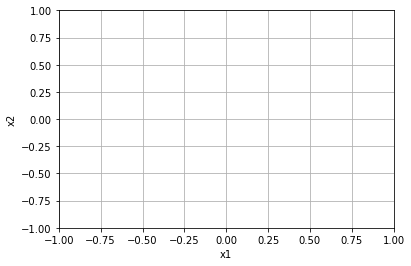


=================== Rollout 1934 =====================
x_init [[0.48]
 [0.88]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.48 0.88]
xx [0.48 0.88]
xxx [0.48 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.8800000000000001]


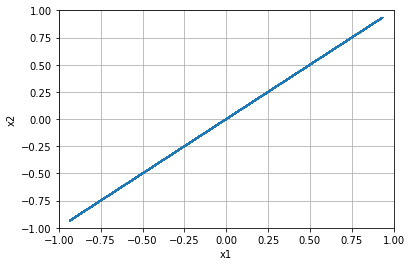


=================== Rollout 1935 =====================
x_init [[0.48]
 [0.92]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.48 0.92]
xx [0.48 0.92]
xxx [0.48 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.9199999999999999]


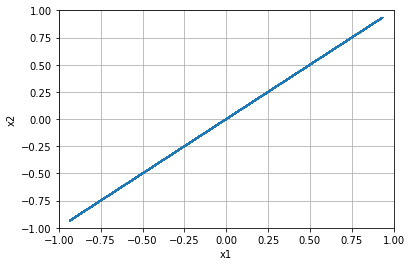


=================== Rollout 1936 =====================
x_init [[0.48]
 [0.96]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.48 0.96]
xx [0.48 0.96]
xxx [0.48 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 0.96]


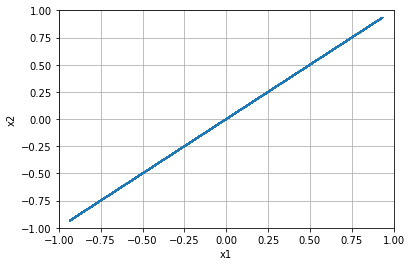


=================== Rollout 1937 =====================
x_init [[0.48]
 [1.  ]]
x_buffer [[0.48 0.48 0.48 0.48 0.48]
 [1.   1.   1.   1.   1.  ]]
x [0.48 1.  ]
xx [0.48 1.  ]
xxx [0.48 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.48, 1.0]


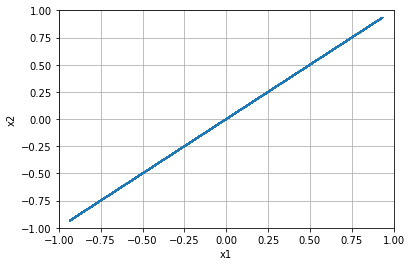


=================== Rollout 1938 =====================
x_init [[ 0.52]
 [-1.  ]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.52 -1.  ]
xx [ 0.52 -1.  ]
xxx [ 0.52 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -1.0]


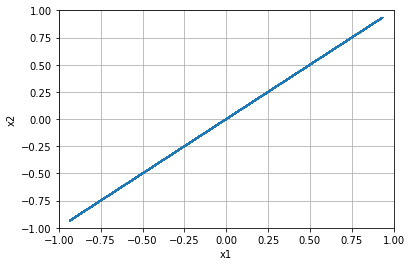


=================== Rollout 1939 =====================
x_init [[ 0.52]
 [-0.96]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.52 -0.96]
xx [ 0.52 -0.96]
xxx [ 0.52 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.96]


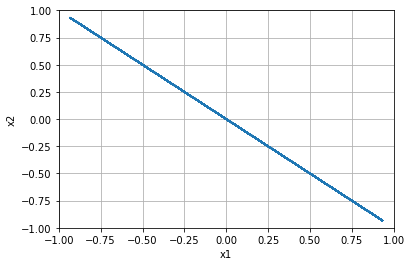


=================== Rollout 1940 =====================
x_init [[ 0.52]
 [-0.92]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.52 -0.92]
xx [ 0.52 -0.92]
xxx [ 0.52 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.92]


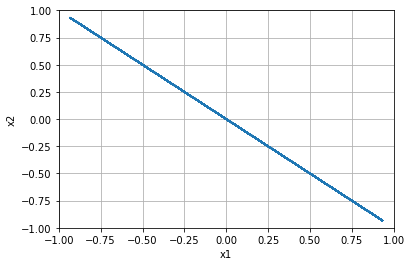


=================== Rollout 1941 =====================
x_init [[ 0.52]
 [-0.88]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.52 -0.88]
xx [ 0.52 -0.88]
xxx [ 0.52 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.88]


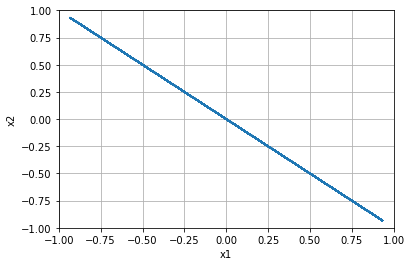


=================== Rollout 1942 =====================
x_init [[ 0.52]
 [-0.84]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.52 -0.84]
xx [ 0.52 -0.84]
xxx [ 0.52 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.84]


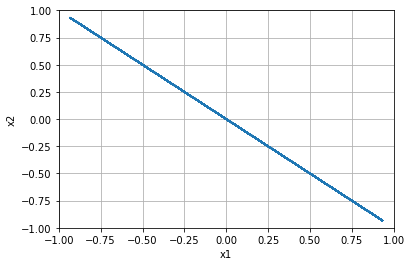


=================== Rollout 1943 =====================
x_init [[ 0.52]
 [-0.8 ]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.52 -0.8 ]
xx [ 0.52 -0.8 ]
xxx [ 0.52 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.8]


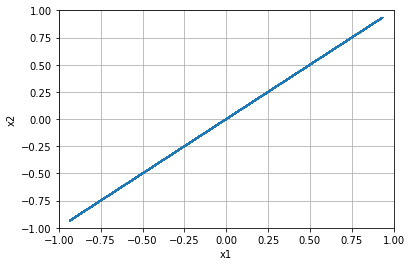


=================== Rollout 1944 =====================
x_init [[ 0.52]
 [-0.76]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.52 -0.76]
xx [ 0.52 -0.76]
xxx [ 0.52 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.76]


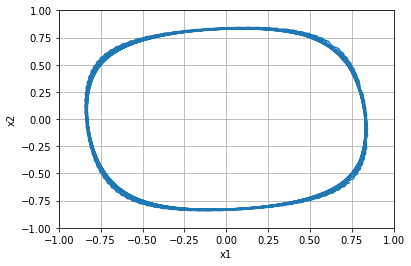


=================== Rollout 1945 =====================
x_init [[ 0.52]
 [-0.72]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.52 -0.72]
xx [ 0.52 -0.72]
xxx [ 0.52 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.72]


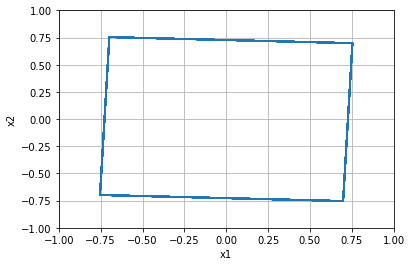


=================== Rollout 1946 =====================
x_init [[ 0.52]
 [-0.68]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.52 -0.68]
xx [ 0.52 -0.68]
xxx [ 0.52 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.6799999999999999]


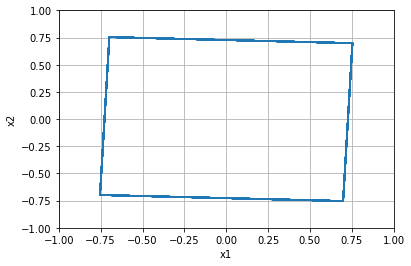


=================== Rollout 1947 =====================
x_init [[ 0.52]
 [-0.64]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.52 -0.64]
xx [ 0.52 -0.64]
xxx [ 0.52 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.64]


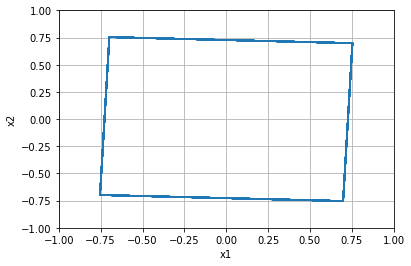


=================== Rollout 1948 =====================
x_init [[ 0.52]
 [-0.6 ]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.52 -0.6 ]
xx [ 0.52 -0.6 ]
xxx [ 0.52 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.6]


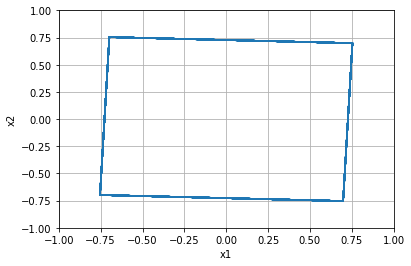


=================== Rollout 1949 =====================
x_init [[ 0.52]
 [-0.56]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.52 -0.56]
xx [ 0.52 -0.56]
xxx [ 0.52 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.56]


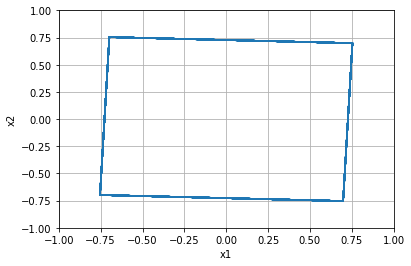


=================== Rollout 1950 =====================
x_init [[ 0.52]
 [-0.52]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.52 -0.52]
xx [ 0.52 -0.52]
xxx [ 0.52 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.52]


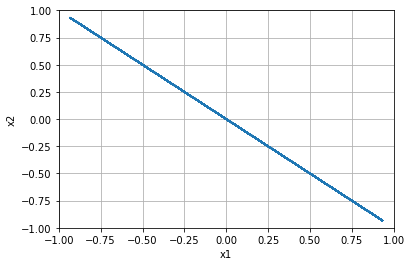


=================== Rollout 1951 =====================
x_init [[ 0.52]
 [-0.48]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.52 -0.48]
xx [ 0.52 -0.48]
xxx [ 0.52 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.48]


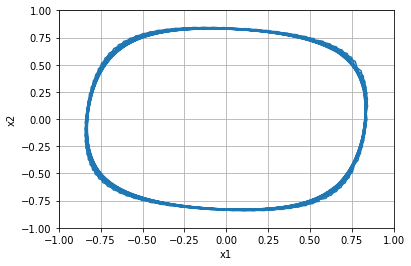


=================== Rollout 1952 =====================
x_init [[ 0.52]
 [-0.44]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.52 -0.44]
xx [ 0.52 -0.44]
xxx [ 0.52 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.43999999999999995]


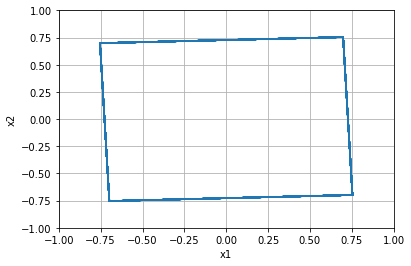


=================== Rollout 1953 =====================
x_init [[ 0.52]
 [-0.4 ]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.52 -0.4 ]
xx [ 0.52 -0.4 ]
xxx [ 0.52 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.4]


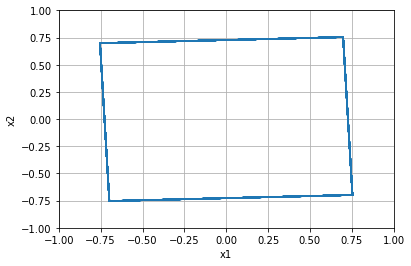


=================== Rollout 1954 =====================
x_init [[ 0.52]
 [-0.36]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.52 -0.36]
xx [ 0.52 -0.36]
xxx [ 0.52 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.36]


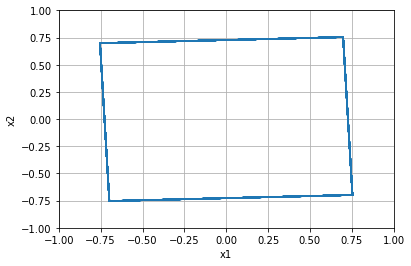


=================== Rollout 1955 =====================
x_init [[ 0.52]
 [-0.32]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.52 -0.32]
xx [ 0.52 -0.32]
xxx [ 0.52 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.31999999999999995]


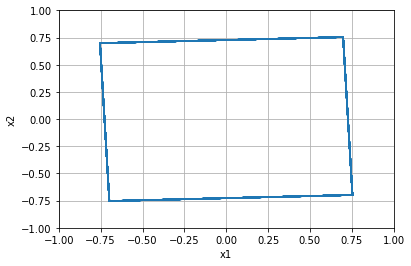


=================== Rollout 1956 =====================
x_init [[ 0.52]
 [-0.28]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.52 -0.28]
xx [ 0.52 -0.28]
xxx [ 0.52 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.28]


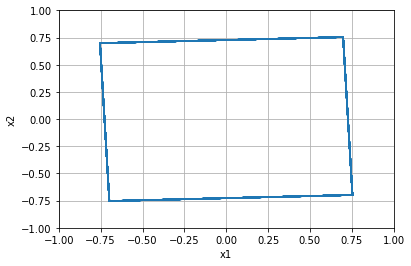


=================== Rollout 1957 =====================
x_init [[ 0.52]
 [-0.24]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.52 -0.24]
xx [ 0.52 -0.24]
xxx [ 0.52 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.24]


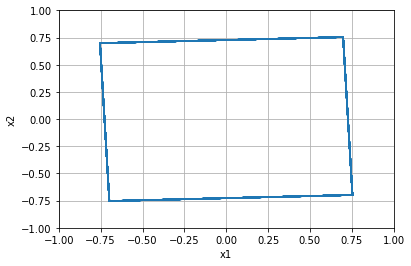


=================== Rollout 1958 =====================
x_init [[ 0.52]
 [-0.2 ]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.52 -0.2 ]
xx [ 0.52 -0.2 ]
xxx [ 0.52 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.19999999999999996]


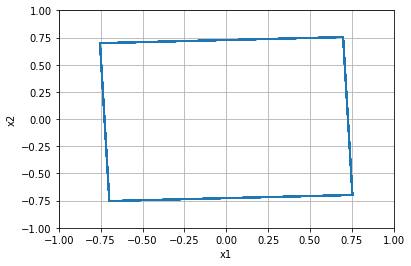


=================== Rollout 1959 =====================
x_init [[ 0.52]
 [-0.16]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.52 -0.16]
xx [ 0.52 -0.16]
xxx [ 0.52 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.16000000000000003]


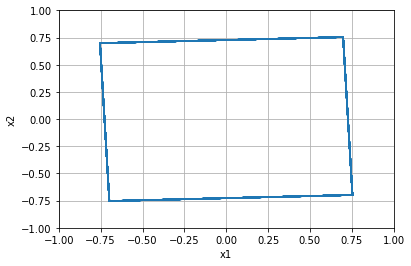


=================== Rollout 1960 =====================
x_init [[ 0.52]
 [-0.12]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.52 -0.12]
xx [ 0.52 -0.12]
xxx [ 0.52 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.12]


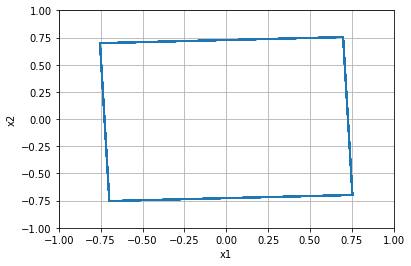


=================== Rollout 1961 =====================
x_init [[ 0.52]
 [-0.08]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.52 -0.08]
xx [ 0.52 -0.08]
xxx [ 0.52 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.07999999999999996]


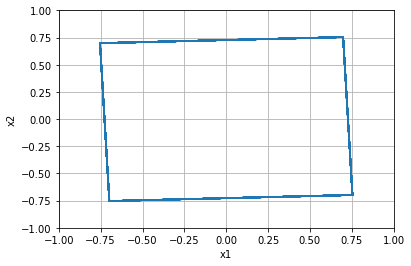


=================== Rollout 1962 =====================
x_init [[ 0.52]
 [-0.04]]
x_buffer [[ 0.52  0.52  0.52  0.52  0.52]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.52 -0.04]
xx [ 0.52 -0.04]
xxx [ 0.52 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, -0.040000000000000036]


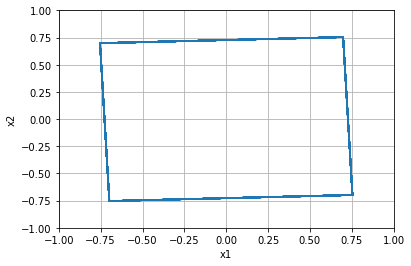


=================== Rollout 1963 =====================
x_init [[0.52]
 [0.  ]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.   0.   0.   0.   0.  ]]
x [0.52 0.  ]
xx [0.52 0.  ]
xxx [0.52 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.0]


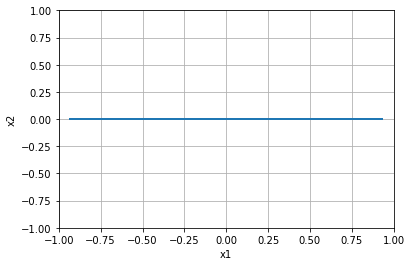


=================== Rollout 1964 =====================
x_init [[0.52]
 [0.04]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.52 0.04]
xx [0.52 0.04]
xxx [0.52 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.040000000000000036]


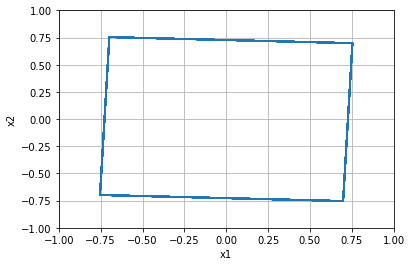


=================== Rollout 1965 =====================
x_init [[0.52]
 [0.08]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.52 0.08]
xx [0.52 0.08]
xxx [0.52 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.08000000000000007]


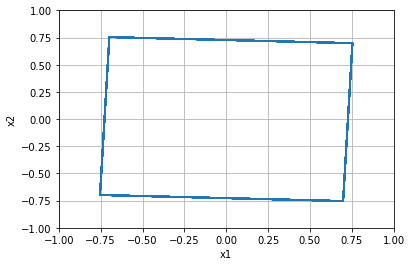


=================== Rollout 1966 =====================
x_init [[0.52]
 [0.12]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.52 0.12]
xx [0.52 0.12]
xxx [0.52 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.1200000000000001]


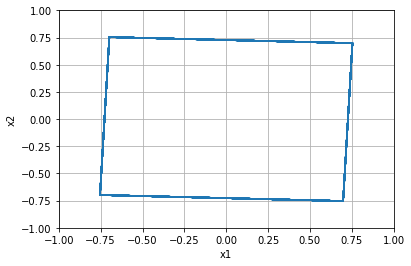


=================== Rollout 1967 =====================
x_init [[0.52]
 [0.16]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.52 0.16]
xx [0.52 0.16]
xxx [0.52 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.15999999999999992]


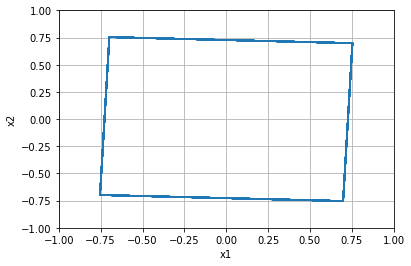


=================== Rollout 1968 =====================
x_init [[0.52]
 [0.2 ]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.52 0.2 ]
xx [0.52 0.2 ]
xxx [0.52 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.19999999999999996]


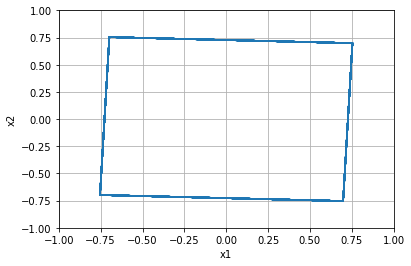


=================== Rollout 1969 =====================
x_init [[0.52]
 [0.24]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.52 0.24]
xx [0.52 0.24]
xxx [0.52 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.24]


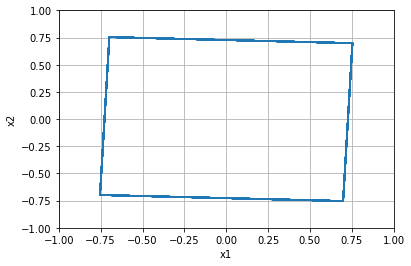


=================== Rollout 1970 =====================
x_init [[0.52]
 [0.28]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.52 0.28]
xx [0.52 0.28]
xxx [0.52 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.28]


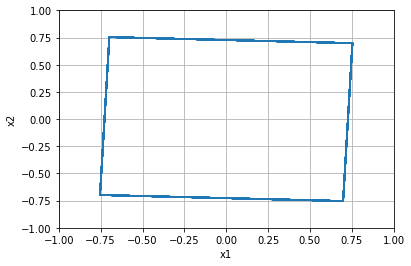


=================== Rollout 1971 =====================
x_init [[0.52]
 [0.32]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.52 0.32]
xx [0.52 0.32]
xxx [0.52 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.32000000000000006]


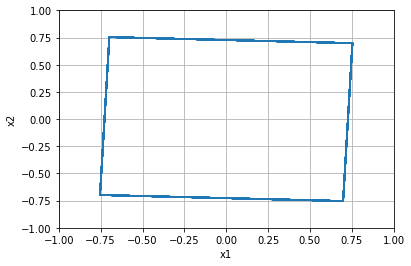


=================== Rollout 1972 =====================
x_init [[0.52]
 [0.36]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.52 0.36]
xx [0.52 0.36]
xxx [0.52 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.3600000000000001]


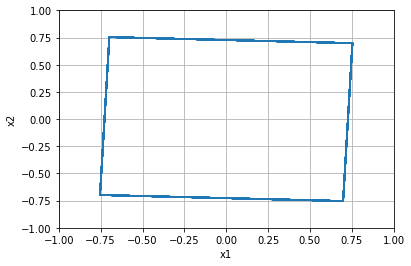


=================== Rollout 1973 =====================
x_init [[0.52]
 [0.4 ]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.52 0.4 ]
xx [0.52 0.4 ]
xxx [0.52 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.40000000000000013]


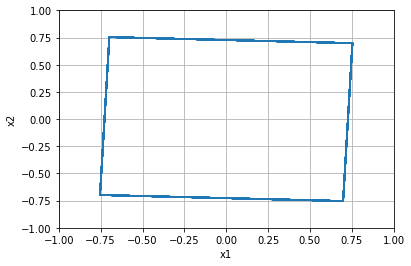


=================== Rollout 1974 =====================
x_init [[0.52]
 [0.44]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.52 0.44]
xx [0.52 0.44]
xxx [0.52 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.43999999999999995]


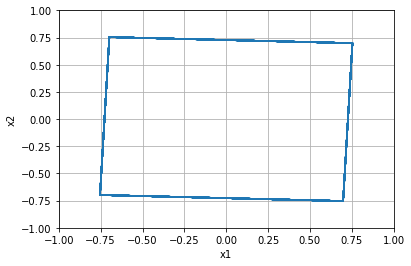


=================== Rollout 1975 =====================
x_init [[0.52]
 [0.48]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.52 0.48]
xx [0.52 0.48]
xxx [0.52 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.48]


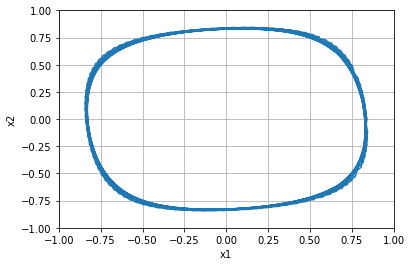


=================== Rollout 1976 =====================
x_init [[0.52]
 [0.52]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.52 0.52]
xx [0.52 0.52]
xxx [0.52 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.52]


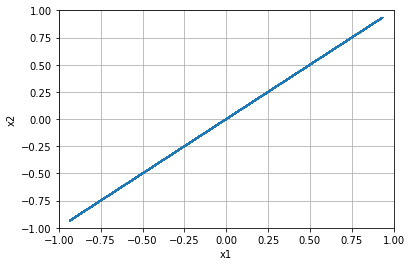


=================== Rollout 1977 =====================
x_init [[0.52]
 [0.56]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.52 0.56]
xx [0.52 0.56]
xxx [0.52 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.56]


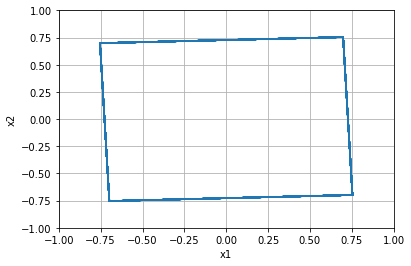


=================== Rollout 1978 =====================
x_init [[0.52]
 [0.6 ]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.52 0.6 ]
xx [0.52 0.6 ]
xxx [0.52 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.6000000000000001]


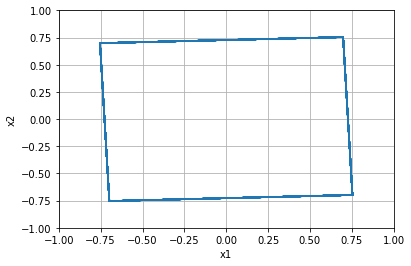


=================== Rollout 1979 =====================
x_init [[0.52]
 [0.64]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.52 0.64]
xx [0.52 0.64]
xxx [0.52 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.6400000000000001]


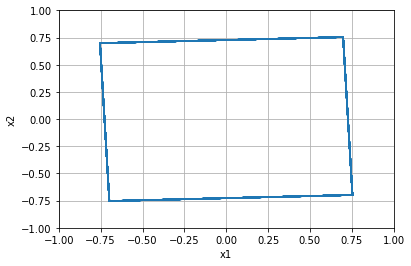


=================== Rollout 1980 =====================
x_init [[0.52]
 [0.68]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.52 0.68]
xx [0.52 0.68]
xxx [0.52 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.6799999999999999]


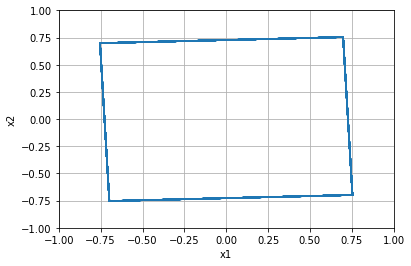


=================== Rollout 1981 =====================
x_init [[0.52]
 [0.72]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.52 0.72]
xx [0.52 0.72]
xxx [0.52 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.72]


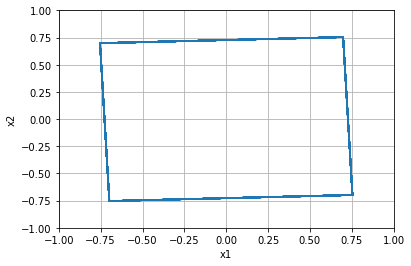


=================== Rollout 1982 =====================
x_init [[0.52]
 [0.76]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.52 0.76]
xx [0.52 0.76]
xxx [0.52 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.76]


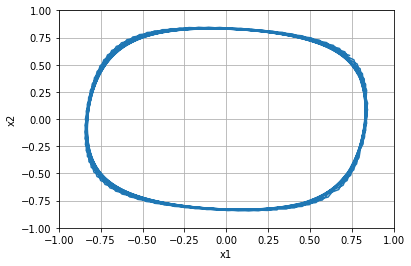


=================== Rollout 1983 =====================
x_init [[0.52]
 [0.8 ]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.52 0.8 ]
xx [0.52 0.8 ]
xxx [0.52 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.8]


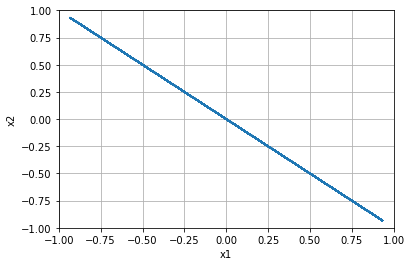


=================== Rollout 1984 =====================
x_init [[0.52]
 [0.84]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.52 0.84]
xx [0.52 0.84]
xxx [0.52 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.8400000000000001]


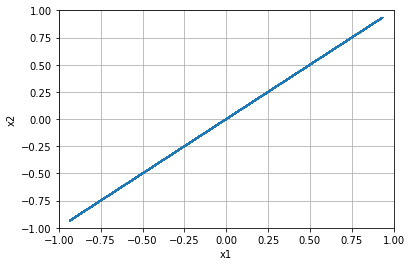


=================== Rollout 1985 =====================
x_init [[0.52]
 [0.88]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.52 0.88]
xx [0.52 0.88]
xxx [0.52 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.8800000000000001]


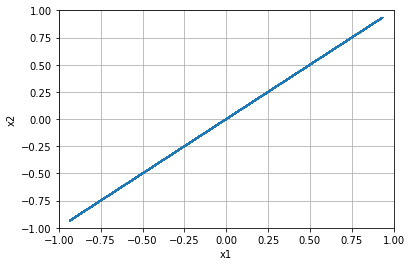


=================== Rollout 1986 =====================
x_init [[0.52]
 [0.92]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.52 0.92]
xx [0.52 0.92]
xxx [0.52 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.9199999999999999]


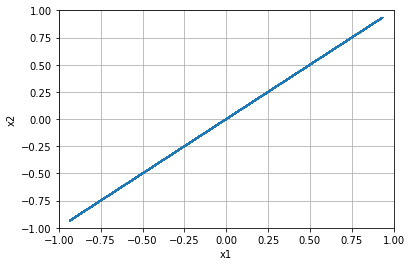


=================== Rollout 1987 =====================
x_init [[0.52]
 [0.96]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.52 0.96]
xx [0.52 0.96]
xxx [0.52 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 0.96]


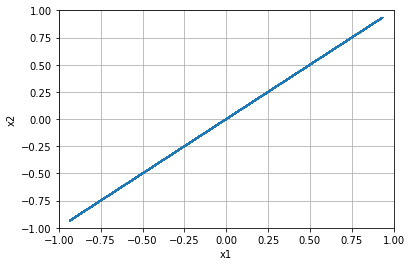


=================== Rollout 1988 =====================
x_init [[0.52]
 [1.  ]]
x_buffer [[0.52 0.52 0.52 0.52 0.52]
 [1.   1.   1.   1.   1.  ]]
x [0.52 1.  ]
xx [0.52 1.  ]
xxx [0.52 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.52, 1.0]


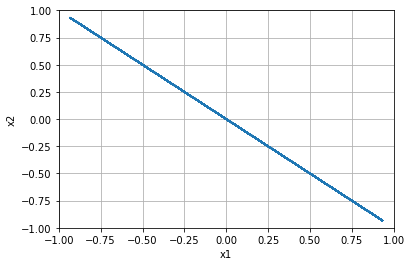


=================== Rollout 1989 =====================
x_init [[ 0.56]
 [-1.  ]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.56 -1.  ]
xx [ 0.56 -1.  ]
xxx [ 0.56 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -1.0]


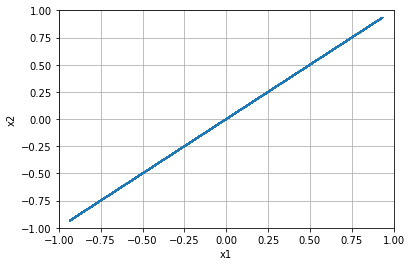


=================== Rollout 1990 =====================
x_init [[ 0.56]
 [-0.96]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.56 -0.96]
xx [ 0.56 -0.96]
xxx [ 0.56 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.96]


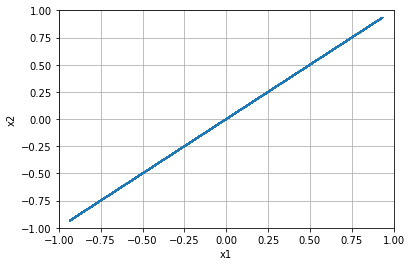


=================== Rollout 1991 =====================
x_init [[ 0.56]
 [-0.92]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.56 -0.92]
xx [ 0.56 -0.92]
xxx [ 0.56 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.92]


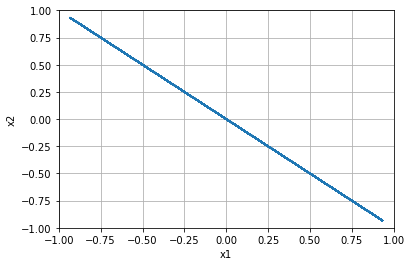


=================== Rollout 1992 =====================
x_init [[ 0.56]
 [-0.88]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.56 -0.88]
xx [ 0.56 -0.88]
xxx [ 0.56 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.88]


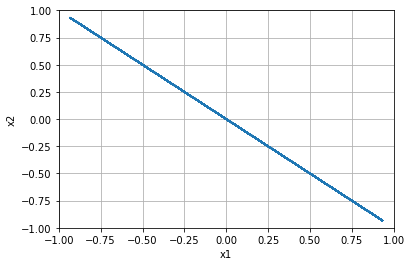


=================== Rollout 1993 =====================
x_init [[ 0.56]
 [-0.84]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.56 -0.84]
xx [ 0.56 -0.84]
xxx [ 0.56 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.84]


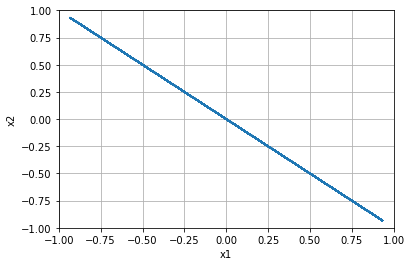


=================== Rollout 1994 =====================
x_init [[ 0.56]
 [-0.8 ]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.56 -0.8 ]
xx [ 0.56 -0.8 ]
xxx [ 0.56 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.8]


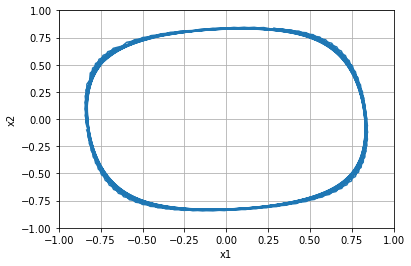


=================== Rollout 1995 =====================
x_init [[ 0.56]
 [-0.76]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.56 -0.76]
xx [ 0.56 -0.76]
xxx [ 0.56 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.76]


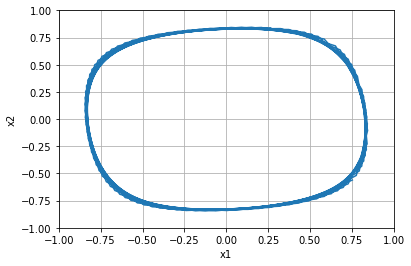


=================== Rollout 1996 =====================
x_init [[ 0.56]
 [-0.72]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.56 -0.72]
xx [ 0.56 -0.72]
xxx [ 0.56 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.72]


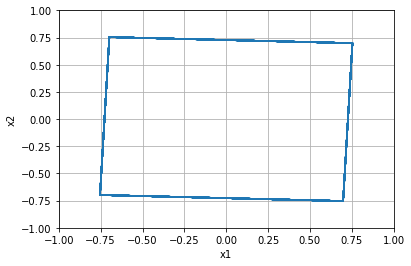


=================== Rollout 1997 =====================
x_init [[ 0.56]
 [-0.68]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.56 -0.68]
xx [ 0.56 -0.68]
xxx [ 0.56 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.6799999999999999]


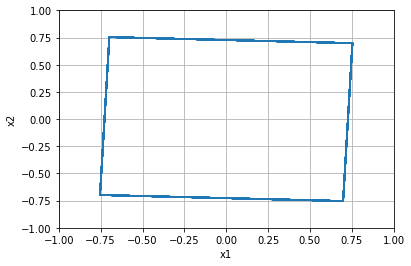


=================== Rollout 1998 =====================
x_init [[ 0.56]
 [-0.64]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.56 -0.64]
xx [ 0.56 -0.64]
xxx [ 0.56 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.64]


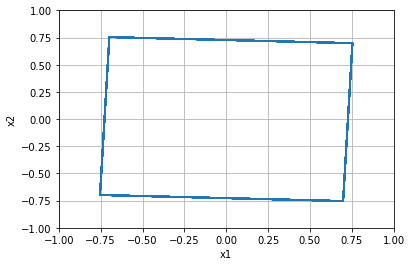


=================== Rollout 1999 =====================
x_init [[ 0.56]
 [-0.6 ]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.56 -0.6 ]
xx [ 0.56 -0.6 ]
xxx [ 0.56 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.6]


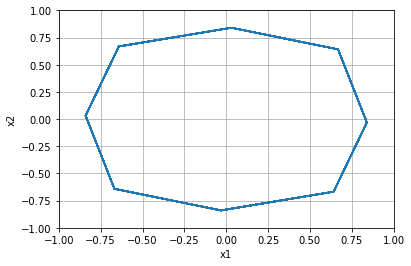


=================== Rollout 2000 =====================
x_init [[ 0.56]
 [-0.56]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.56 -0.56]
xx [ 0.56 -0.56]
xxx [ 0.56 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.56]


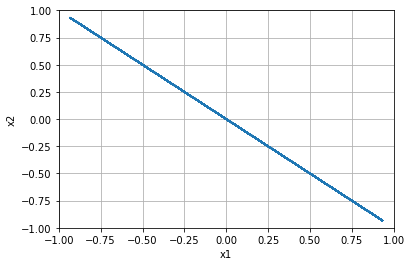


=================== Rollout 2001 =====================
x_init [[ 0.56]
 [-0.52]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.56 -0.52]
xx [ 0.56 -0.52]
xxx [ 0.56 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.52]


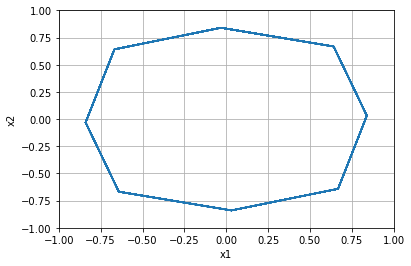


=================== Rollout 2002 =====================
x_init [[ 0.56]
 [-0.48]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.56 -0.48]
xx [ 0.56 -0.48]
xxx [ 0.56 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.48]


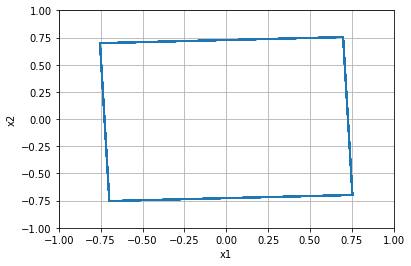


=================== Rollout 2003 =====================
x_init [[ 0.56]
 [-0.44]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.56 -0.44]
xx [ 0.56 -0.44]
xxx [ 0.56 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.43999999999999995]


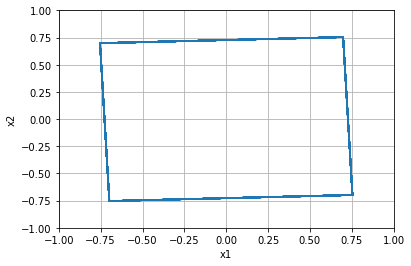


=================== Rollout 2004 =====================
x_init [[ 0.56]
 [-0.4 ]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.56 -0.4 ]
xx [ 0.56 -0.4 ]
xxx [ 0.56 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.4]


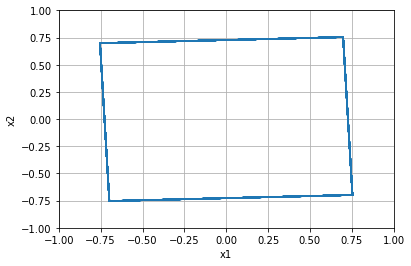


=================== Rollout 2005 =====================
x_init [[ 0.56]
 [-0.36]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.56 -0.36]
xx [ 0.56 -0.36]
xxx [ 0.56 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.36]


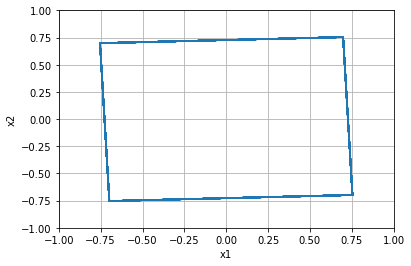


=================== Rollout 2006 =====================
x_init [[ 0.56]
 [-0.32]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.56 -0.32]
xx [ 0.56 -0.32]
xxx [ 0.56 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.31999999999999995]


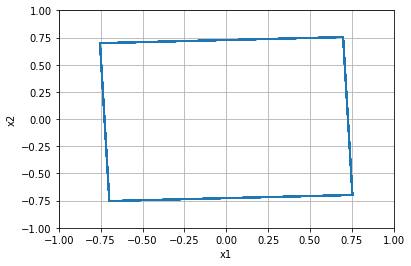


=================== Rollout 2007 =====================
x_init [[ 0.56]
 [-0.28]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.56 -0.28]
xx [ 0.56 -0.28]
xxx [ 0.56 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.28]


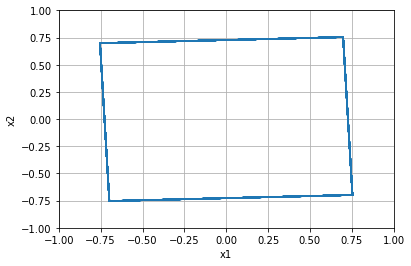


=================== Rollout 2008 =====================
x_init [[ 0.56]
 [-0.24]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.56 -0.24]
xx [ 0.56 -0.24]
xxx [ 0.56 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.24]


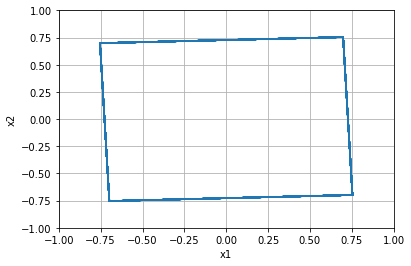


=================== Rollout 2009 =====================
x_init [[ 0.56]
 [-0.2 ]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.56 -0.2 ]
xx [ 0.56 -0.2 ]
xxx [ 0.56 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.19999999999999996]


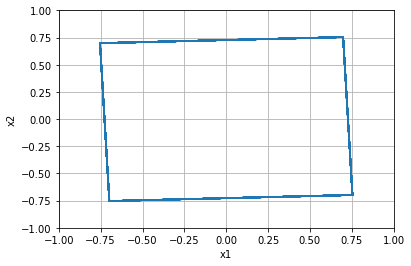


=================== Rollout 2010 =====================
x_init [[ 0.56]
 [-0.16]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.56 -0.16]
xx [ 0.56 -0.16]
xxx [ 0.56 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.16000000000000003]


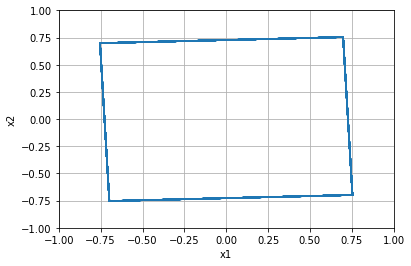


=================== Rollout 2011 =====================
x_init [[ 0.56]
 [-0.12]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.56 -0.12]
xx [ 0.56 -0.12]
xxx [ 0.56 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.12]


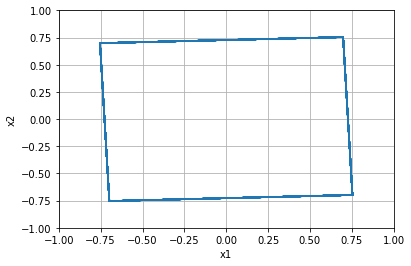


=================== Rollout 2012 =====================
x_init [[ 0.56]
 [-0.08]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.56 -0.08]
xx [ 0.56 -0.08]
xxx [ 0.56 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.07999999999999996]


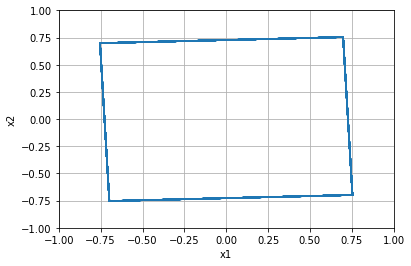


=================== Rollout 2013 =====================
x_init [[ 0.56]
 [-0.04]]
x_buffer [[ 0.56  0.56  0.56  0.56  0.56]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.56 -0.04]
xx [ 0.56 -0.04]
xxx [ 0.56 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, -0.040000000000000036]


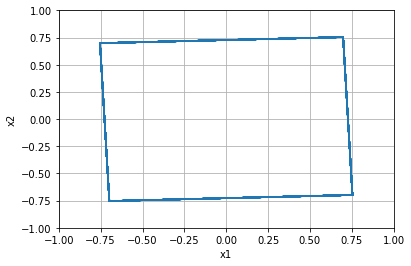


=================== Rollout 2014 =====================
x_init [[0.56]
 [0.  ]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.   0.   0.   0.   0.  ]]
x [0.56 0.  ]
xx [0.56 0.  ]
xxx [0.56 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.0]


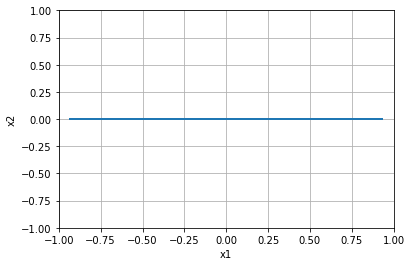


=================== Rollout 2015 =====================
x_init [[0.56]
 [0.04]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.56 0.04]
xx [0.56 0.04]
xxx [0.56 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.040000000000000036]


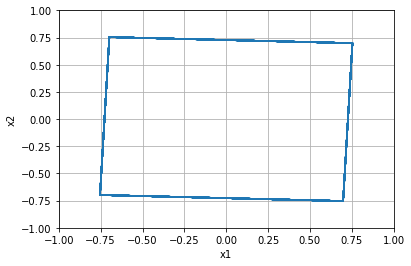


=================== Rollout 2016 =====================
x_init [[0.56]
 [0.08]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.56 0.08]
xx [0.56 0.08]
xxx [0.56 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.08000000000000007]


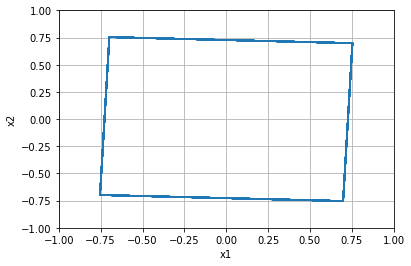


=================== Rollout 2017 =====================
x_init [[0.56]
 [0.12]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.56 0.12]
xx [0.56 0.12]
xxx [0.56 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.1200000000000001]


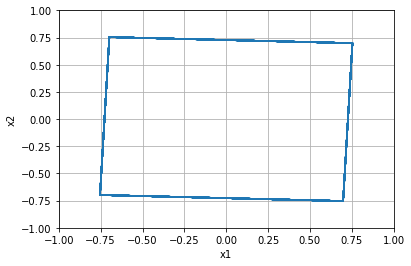


=================== Rollout 2018 =====================
x_init [[0.56]
 [0.16]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.56 0.16]
xx [0.56 0.16]
xxx [0.56 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.15999999999999992]


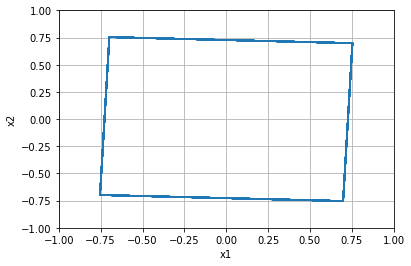


=================== Rollout 2019 =====================
x_init [[0.56]
 [0.2 ]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.56 0.2 ]
xx [0.56 0.2 ]
xxx [0.56 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.19999999999999996]


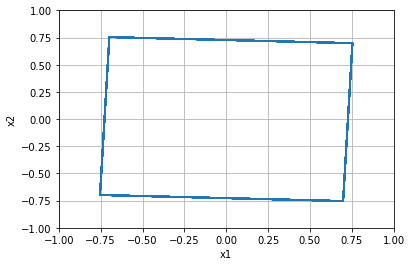


=================== Rollout 2020 =====================
x_init [[0.56]
 [0.24]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.56 0.24]
xx [0.56 0.24]
xxx [0.56 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.24]


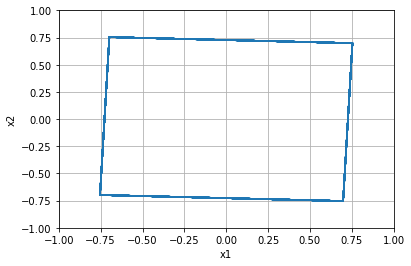


=================== Rollout 2021 =====================
x_init [[0.56]
 [0.28]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.56 0.28]
xx [0.56 0.28]
xxx [0.56 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.28]


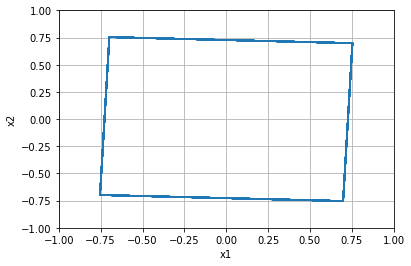


=================== Rollout 2022 =====================
x_init [[0.56]
 [0.32]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.56 0.32]
xx [0.56 0.32]
xxx [0.56 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.32000000000000006]


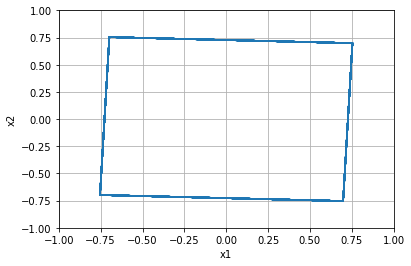


=================== Rollout 2023 =====================
x_init [[0.56]
 [0.36]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.56 0.36]
xx [0.56 0.36]
xxx [0.56 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.3600000000000001]


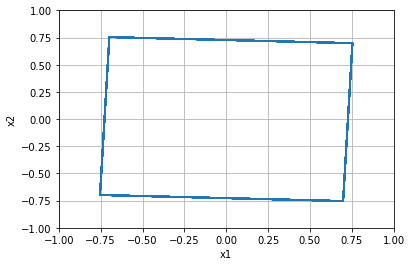


=================== Rollout 2024 =====================
x_init [[0.56]
 [0.4 ]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.56 0.4 ]
xx [0.56 0.4 ]
xxx [0.56 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.40000000000000013]


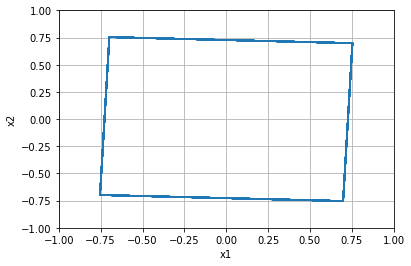


=================== Rollout 2025 =====================
x_init [[0.56]
 [0.44]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.56 0.44]
xx [0.56 0.44]
xxx [0.56 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.43999999999999995]


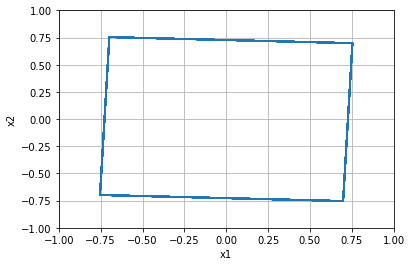


=================== Rollout 2026 =====================
x_init [[0.56]
 [0.48]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.56 0.48]
xx [0.56 0.48]
xxx [0.56 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.48]


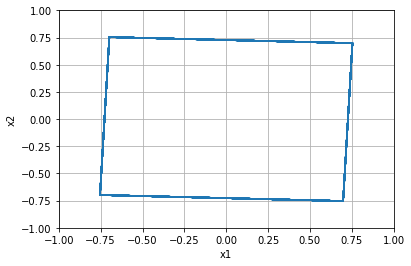


=================== Rollout 2027 =====================
x_init [[0.56]
 [0.52]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.56 0.52]
xx [0.56 0.52]
xxx [0.56 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.52]


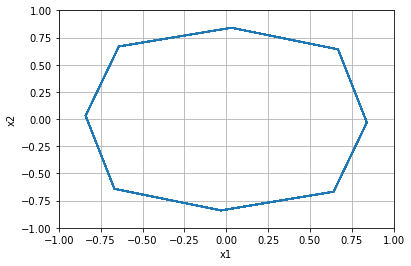


=================== Rollout 2028 =====================
x_init [[0.56]
 [0.56]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.56 0.56]
xx [0.56 0.56]
xxx [0.56 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.56]


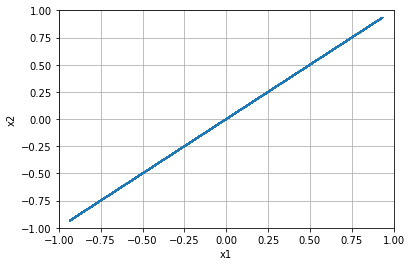


=================== Rollout 2029 =====================
x_init [[0.56]
 [0.6 ]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.56 0.6 ]
xx [0.56 0.6 ]
xxx [0.56 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.6000000000000001]


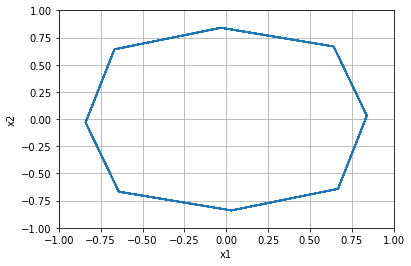


=================== Rollout 2030 =====================
x_init [[0.56]
 [0.64]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.56 0.64]
xx [0.56 0.64]
xxx [0.56 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.6400000000000001]


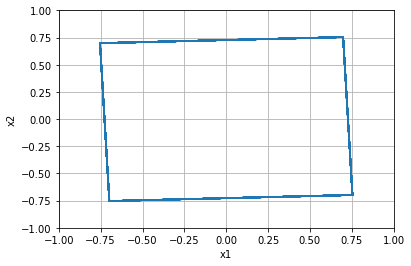


=================== Rollout 2031 =====================
x_init [[0.56]
 [0.68]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.56 0.68]
xx [0.56 0.68]
xxx [0.56 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.6799999999999999]


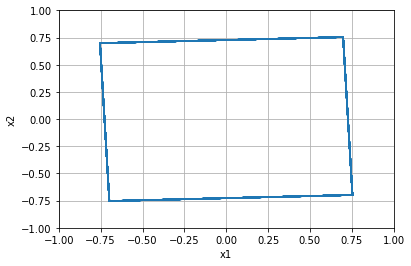


=================== Rollout 2032 =====================
x_init [[0.56]
 [0.72]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.56 0.72]
xx [0.56 0.72]
xxx [0.56 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.72]


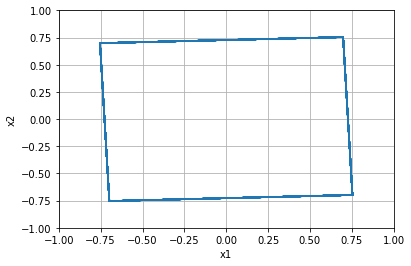


=================== Rollout 2033 =====================
x_init [[0.56]
 [0.76]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.56 0.76]
xx [0.56 0.76]
xxx [0.56 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.76]


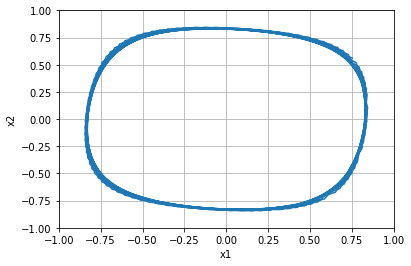


=================== Rollout 2034 =====================
x_init [[0.56]
 [0.8 ]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.56 0.8 ]
xx [0.56 0.8 ]
xxx [0.56 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.8]


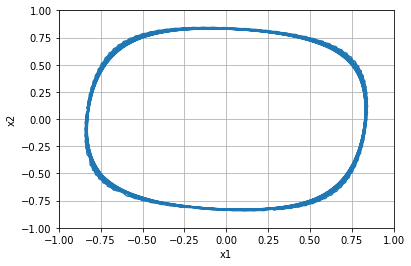


=================== Rollout 2035 =====================
x_init [[0.56]
 [0.84]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.56 0.84]
xx [0.56 0.84]
xxx [0.56 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.8400000000000001]


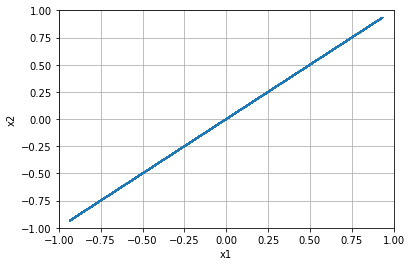


=================== Rollout 2036 =====================
x_init [[0.56]
 [0.88]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.56 0.88]
xx [0.56 0.88]
xxx [0.56 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.8800000000000001]


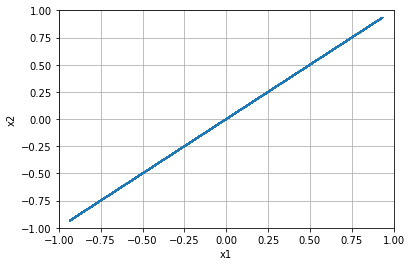


=================== Rollout 2037 =====================
x_init [[0.56]
 [0.92]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.56 0.92]
xx [0.56 0.92]
xxx [0.56 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.9199999999999999]


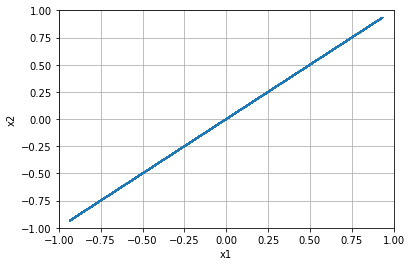


=================== Rollout 2038 =====================
x_init [[0.56]
 [0.96]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.56 0.96]
xx [0.56 0.96]
xxx [0.56 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 0.96]


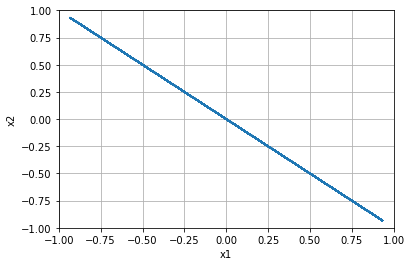


=================== Rollout 2039 =====================
x_init [[0.56]
 [1.  ]]
x_buffer [[0.56 0.56 0.56 0.56 0.56]
 [1.   1.   1.   1.   1.  ]]
x [0.56 1.  ]
xx [0.56 1.  ]
xxx [0.56 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.56, 1.0]


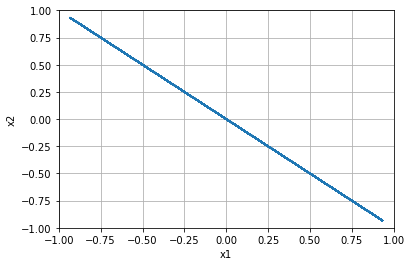


=================== Rollout 2040 =====================
x_init [[ 0.6]
 [-1. ]]
x_buffer [[ 0.6  0.6  0.6  0.6  0.6]
 [-1.  -1.  -1.  -1.  -1. ]]
x [ 0.6 -1. ]
xx [ 0.6 -1. ]
xxx [ 0.6 -1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -1.0]


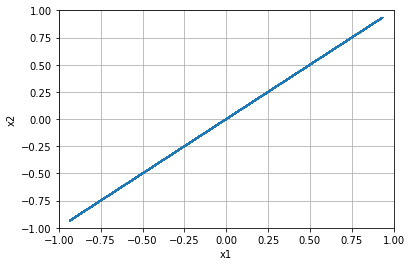


=================== Rollout 2041 =====================
x_init [[ 0.6 ]
 [-0.96]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.6  -0.96]
xx [ 0.6  -0.96]
xxx [ 0.6  -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.96]


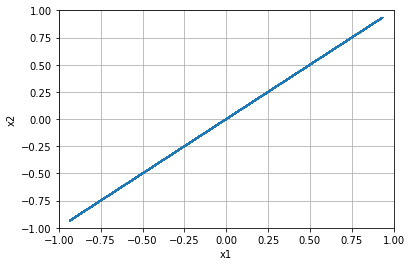


=================== Rollout 2042 =====================
x_init [[ 0.6 ]
 [-0.92]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.6  -0.92]
xx [ 0.6  -0.92]
xxx [ 0.6  -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.92]


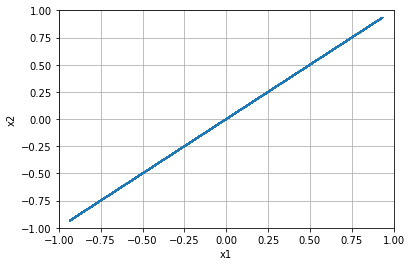


=================== Rollout 2043 =====================
x_init [[ 0.6 ]
 [-0.88]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.6  -0.88]
xx [ 0.6  -0.88]
xxx [ 0.6  -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.88]


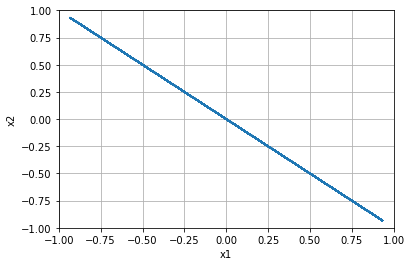


=================== Rollout 2044 =====================
x_init [[ 0.6 ]
 [-0.84]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.6  -0.84]
xx [ 0.6  -0.84]
xxx [ 0.6  -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.84]


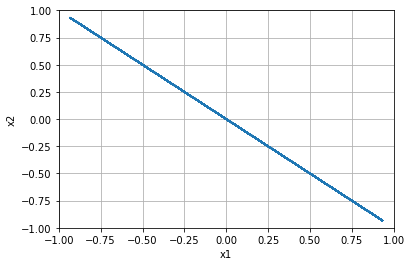


=================== Rollout 2045 =====================
x_init [[ 0.6]
 [-0.8]]
x_buffer [[ 0.6  0.6  0.6  0.6  0.6]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [ 0.6 -0.8]
xx [ 0.6 -0.8]
xxx [ 0.6 -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.8]


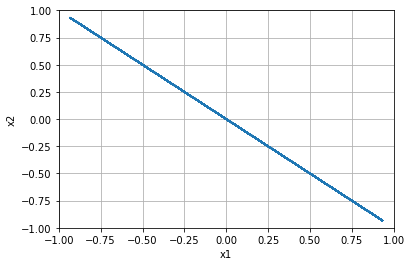


=================== Rollout 2046 =====================
x_init [[ 0.6 ]
 [-0.76]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.6  -0.76]
xx [ 0.6  -0.76]
xxx [ 0.6  -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.76]


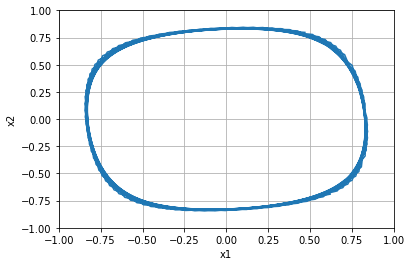


=================== Rollout 2047 =====================
x_init [[ 0.6 ]
 [-0.72]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.6  -0.72]
xx [ 0.6  -0.72]
xxx [ 0.6  -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.72]


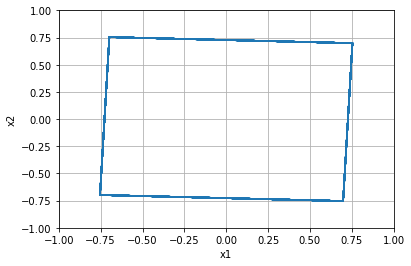


=================== Rollout 2048 =====================
x_init [[ 0.6 ]
 [-0.68]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.6  -0.68]
xx [ 0.6  -0.68]
xxx [ 0.6  -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.6799999999999999]


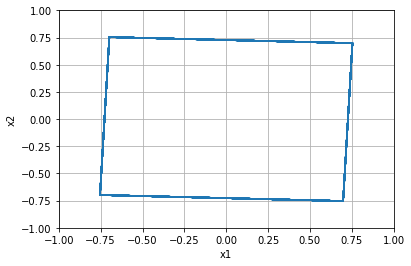


=================== Rollout 2049 =====================
x_init [[ 0.6 ]
 [-0.64]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.6  -0.64]
xx [ 0.6  -0.64]
xxx [ 0.6  -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.64]


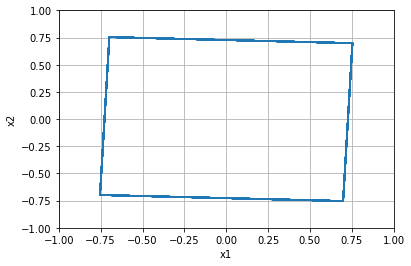


=================== Rollout 2050 =====================
x_init [[ 0.6]
 [-0.6]]
x_buffer [[ 0.6  0.6  0.6  0.6  0.6]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [ 0.6 -0.6]
xx [ 0.6 -0.6]
xxx [ 0.6 -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.6]


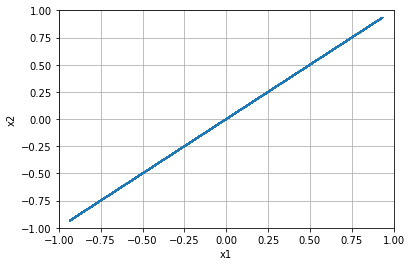


=================== Rollout 2051 =====================
x_init [[ 0.6 ]
 [-0.56]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.6  -0.56]
xx [ 0.6  -0.56]
xxx [ 0.6  -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.56]


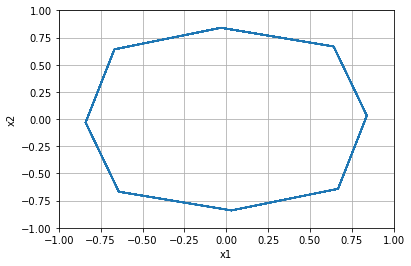


=================== Rollout 2052 =====================
x_init [[ 0.6 ]
 [-0.52]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.6  -0.52]
xx [ 0.6  -0.52]
xxx [ 0.6  -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.52]


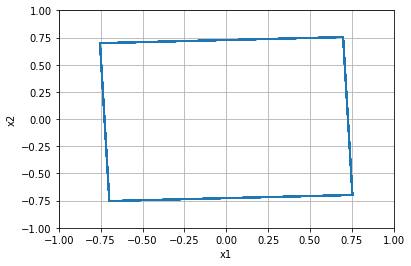


=================== Rollout 2053 =====================
x_init [[ 0.6 ]
 [-0.48]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.6  -0.48]
xx [ 0.6  -0.48]
xxx [ 0.6  -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.48]


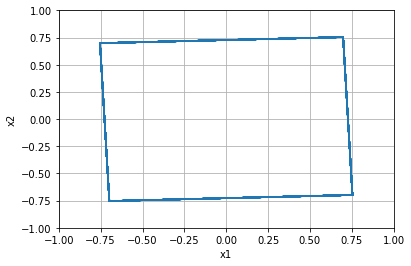


=================== Rollout 2054 =====================
x_init [[ 0.6 ]
 [-0.44]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.6  -0.44]
xx [ 0.6  -0.44]
xxx [ 0.6  -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.43999999999999995]


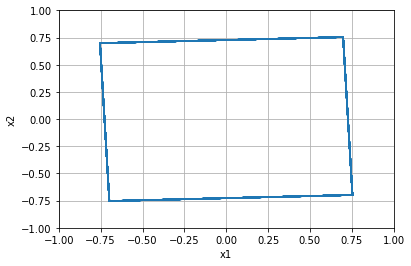


=================== Rollout 2055 =====================
x_init [[ 0.6]
 [-0.4]]
x_buffer [[ 0.6  0.6  0.6  0.6  0.6]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [ 0.6 -0.4]
xx [ 0.6 -0.4]
xxx [ 0.6 -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.4]


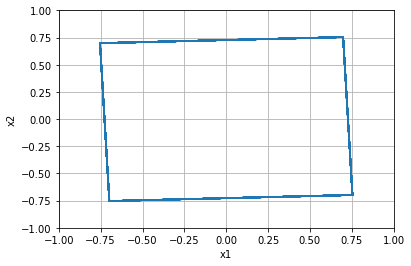


=================== Rollout 2056 =====================
x_init [[ 0.6 ]
 [-0.36]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.6  -0.36]
xx [ 0.6  -0.36]
xxx [ 0.6  -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.36]


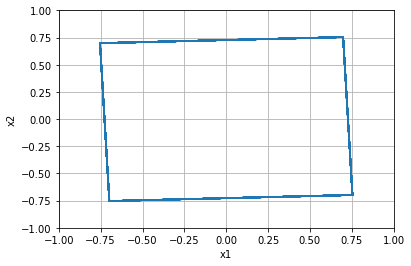


=================== Rollout 2057 =====================
x_init [[ 0.6 ]
 [-0.32]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.6  -0.32]
xx [ 0.6  -0.32]
xxx [ 0.6  -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.31999999999999995]


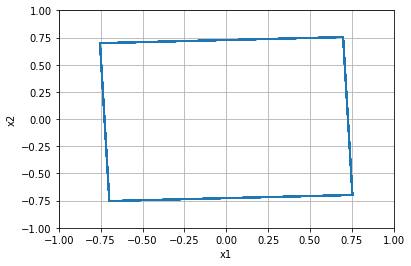


=================== Rollout 2058 =====================
x_init [[ 0.6 ]
 [-0.28]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.6  -0.28]
xx [ 0.6  -0.28]
xxx [ 0.6  -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.28]


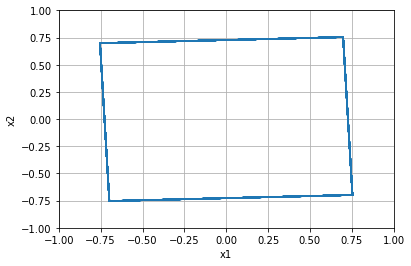


=================== Rollout 2059 =====================
x_init [[ 0.6 ]
 [-0.24]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.6  -0.24]
xx [ 0.6  -0.24]
xxx [ 0.6  -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.24]


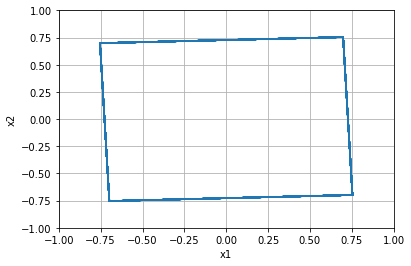


=================== Rollout 2060 =====================
x_init [[ 0.6]
 [-0.2]]
x_buffer [[ 0.6  0.6  0.6  0.6  0.6]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [ 0.6 -0.2]
xx [ 0.6 -0.2]
xxx [ 0.6 -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.19999999999999996]


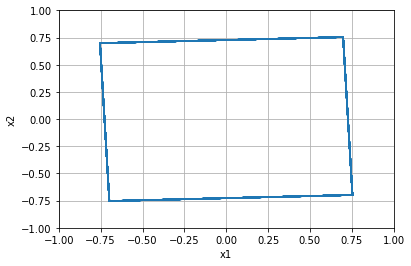


=================== Rollout 2061 =====================
x_init [[ 0.6 ]
 [-0.16]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.6  -0.16]
xx [ 0.6  -0.16]
xxx [ 0.6  -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.16000000000000003]


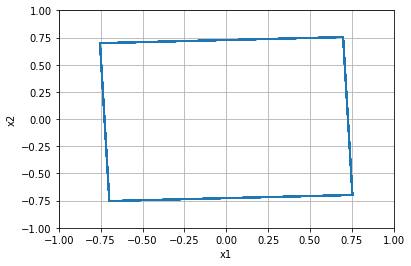


=================== Rollout 2062 =====================
x_init [[ 0.6 ]
 [-0.12]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.6  -0.12]
xx [ 0.6  -0.12]
xxx [ 0.6  -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.12]


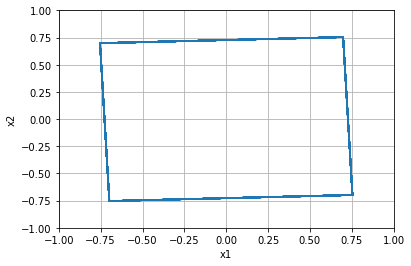


=================== Rollout 2063 =====================
x_init [[ 0.6 ]
 [-0.08]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.6  -0.08]
xx [ 0.6  -0.08]
xxx [ 0.6  -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.07999999999999996]


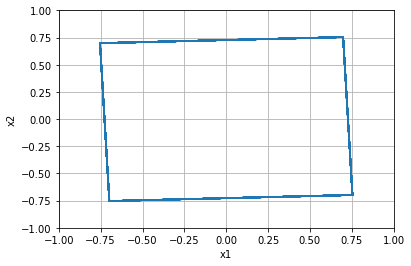


=================== Rollout 2064 =====================
x_init [[ 0.6 ]
 [-0.04]]
x_buffer [[ 0.6   0.6   0.6   0.6   0.6 ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.6  -0.04]
xx [ 0.6  -0.04]
xxx [ 0.6  -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, -0.040000000000000036]


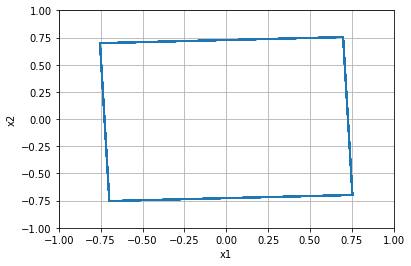


=================== Rollout 2065 =====================
x_init [[0.6]
 [0. ]]
x_buffer [[0.6 0.6 0.6 0.6 0.6]
 [0.  0.  0.  0.  0. ]]
x [0.6 0. ]
xx [0.6 0. ]
xxx [0.6 0. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.0]


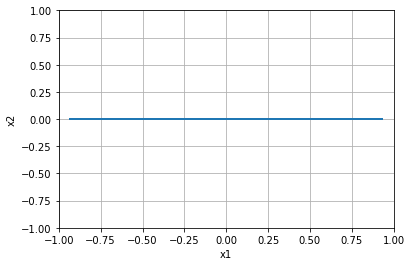


=================== Rollout 2066 =====================
x_init [[0.6 ]
 [0.04]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.6  0.04]
xx [0.6  0.04]
xxx [0.6  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.040000000000000036]


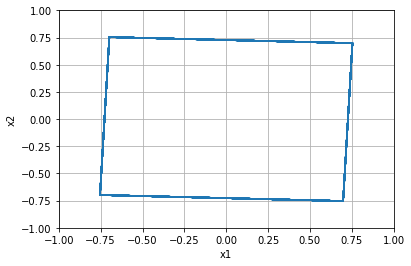


=================== Rollout 2067 =====================
x_init [[0.6 ]
 [0.08]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.6  0.08]
xx [0.6  0.08]
xxx [0.6  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.08000000000000007]


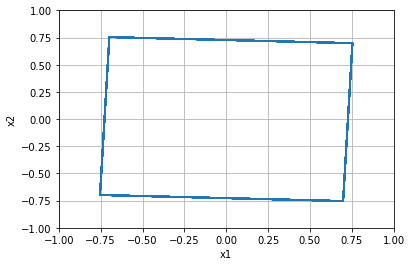


=================== Rollout 2068 =====================
x_init [[0.6 ]
 [0.12]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.6  0.12]
xx [0.6  0.12]
xxx [0.6  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.1200000000000001]


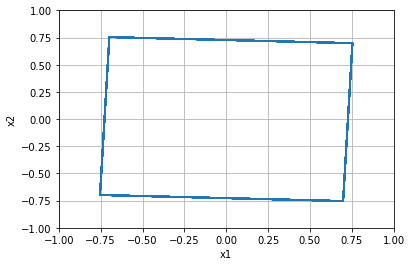


=================== Rollout 2069 =====================
x_init [[0.6 ]
 [0.16]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.6  0.16]
xx [0.6  0.16]
xxx [0.6  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.15999999999999992]


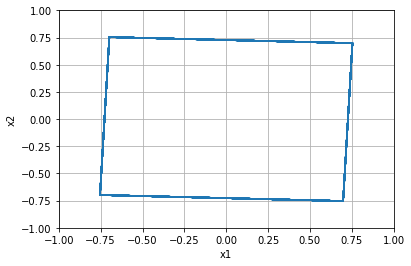


=================== Rollout 2070 =====================
x_init [[0.6]
 [0.2]]
x_buffer [[0.6 0.6 0.6 0.6 0.6]
 [0.2 0.2 0.2 0.2 0.2]]
x [0.6 0.2]
xx [0.6 0.2]
xxx [0.6 0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.19999999999999996]


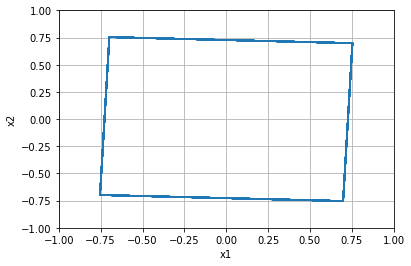


=================== Rollout 2071 =====================
x_init [[0.6 ]
 [0.24]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.6  0.24]
xx [0.6  0.24]
xxx [0.6  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.24]


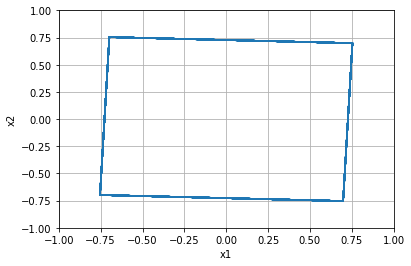


=================== Rollout 2072 =====================
x_init [[0.6 ]
 [0.28]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.6  0.28]
xx [0.6  0.28]
xxx [0.6  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.28]


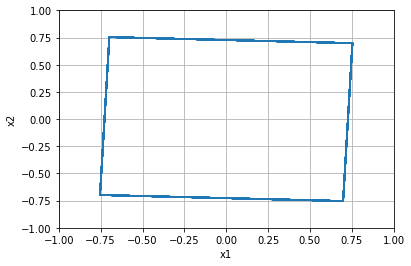


=================== Rollout 2073 =====================
x_init [[0.6 ]
 [0.32]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.6  0.32]
xx [0.6  0.32]
xxx [0.6  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.32000000000000006]


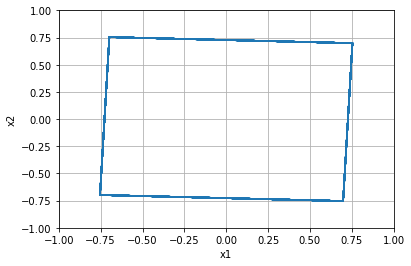


=================== Rollout 2074 =====================
x_init [[0.6 ]
 [0.36]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.6  0.36]
xx [0.6  0.36]
xxx [0.6  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.3600000000000001]


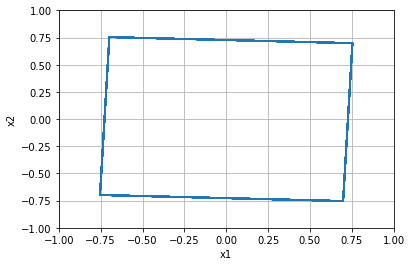


=================== Rollout 2075 =====================
x_init [[0.6]
 [0.4]]
x_buffer [[0.6 0.6 0.6 0.6 0.6]
 [0.4 0.4 0.4 0.4 0.4]]
x [0.6 0.4]
xx [0.6 0.4]
xxx [0.6 0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.40000000000000013]


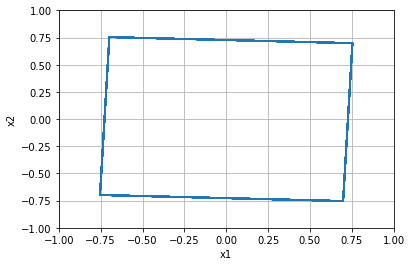


=================== Rollout 2076 =====================
x_init [[0.6 ]
 [0.44]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.6  0.44]
xx [0.6  0.44]
xxx [0.6  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.43999999999999995]


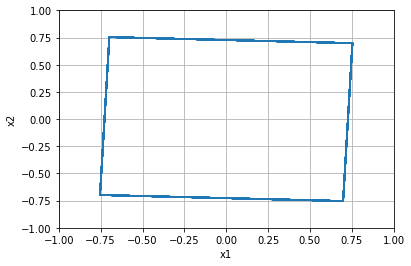


=================== Rollout 2077 =====================
x_init [[0.6 ]
 [0.48]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.6  0.48]
xx [0.6  0.48]
xxx [0.6  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.48]


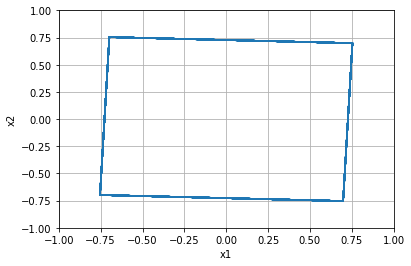


=================== Rollout 2078 =====================
x_init [[0.6 ]
 [0.52]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.6  0.52]
xx [0.6  0.52]
xxx [0.6  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.52]


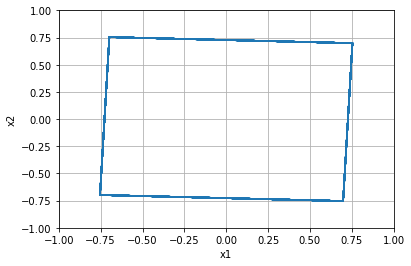


=================== Rollout 2079 =====================
x_init [[0.6 ]
 [0.56]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.6  0.56]
xx [0.6  0.56]
xxx [0.6  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.56]


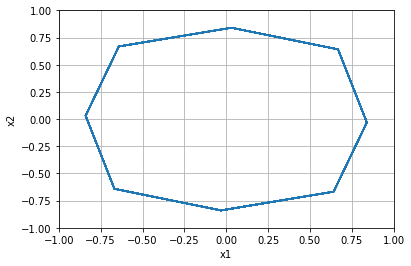


=================== Rollout 2080 =====================
x_init [[0.6]
 [0.6]]
x_buffer [[0.6 0.6 0.6 0.6 0.6]
 [0.6 0.6 0.6 0.6 0.6]]
x [0.6 0.6]
xx [0.6 0.6]
xxx [0.6 0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.6000000000000001]


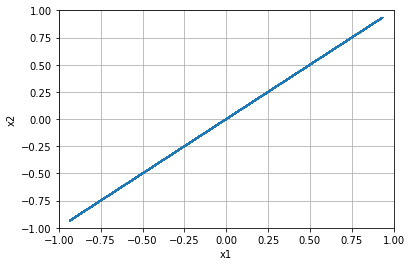


=================== Rollout 2081 =====================
x_init [[0.6 ]
 [0.64]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.6  0.64]
xx [0.6  0.64]
xxx [0.6  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.6400000000000001]


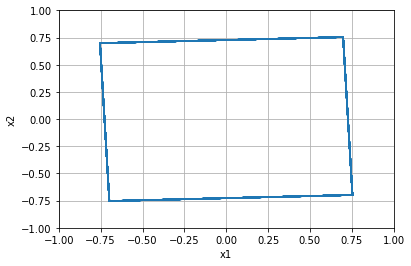


=================== Rollout 2082 =====================
x_init [[0.6 ]
 [0.68]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.6  0.68]
xx [0.6  0.68]
xxx [0.6  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.6799999999999999]


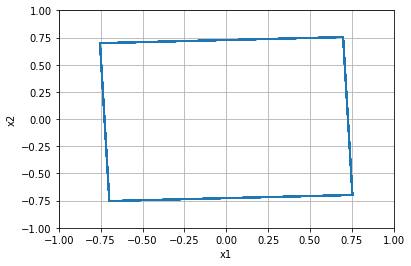


=================== Rollout 2083 =====================
x_init [[0.6 ]
 [0.72]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.6  0.72]
xx [0.6  0.72]
xxx [0.6  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.72]


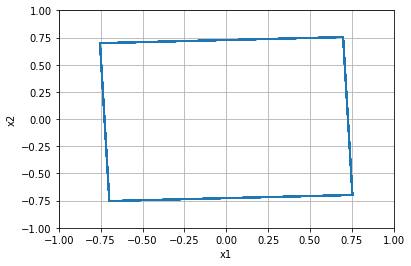


=================== Rollout 2084 =====================
x_init [[0.6 ]
 [0.76]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.6  0.76]
xx [0.6  0.76]
xxx [0.6  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.76]


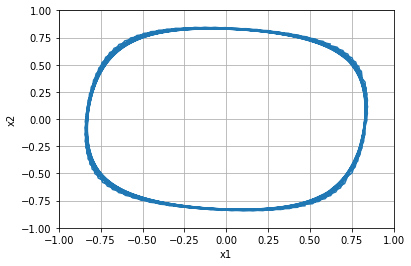


=================== Rollout 2085 =====================
x_init [[0.6]
 [0.8]]
x_buffer [[0.6 0.6 0.6 0.6 0.6]
 [0.8 0.8 0.8 0.8 0.8]]
x [0.6 0.8]
xx [0.6 0.8]
xxx [0.6 0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.8]


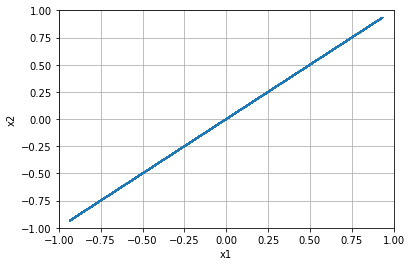


=================== Rollout 2086 =====================
x_init [[0.6 ]
 [0.84]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.6  0.84]
xx [0.6  0.84]
xxx [0.6  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.8400000000000001]


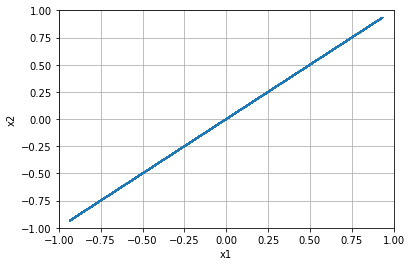


=================== Rollout 2087 =====================
x_init [[0.6 ]
 [0.88]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.6  0.88]
xx [0.6  0.88]
xxx [0.6  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.8800000000000001]


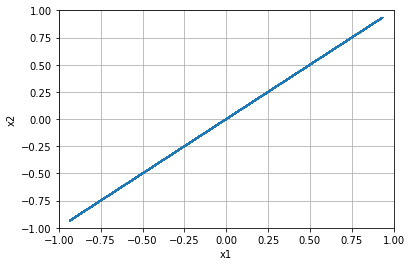


=================== Rollout 2088 =====================
x_init [[0.6 ]
 [0.92]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.6  0.92]
xx [0.6  0.92]
xxx [0.6  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.9199999999999999]


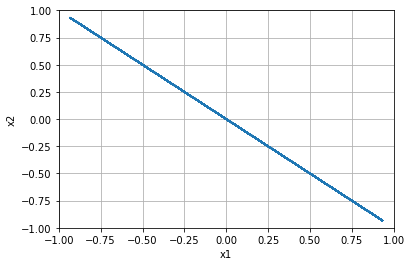


=================== Rollout 2089 =====================
x_init [[0.6 ]
 [0.96]]
x_buffer [[0.6  0.6  0.6  0.6  0.6 ]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.6  0.96]
xx [0.6  0.96]
xxx [0.6  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 0.96]


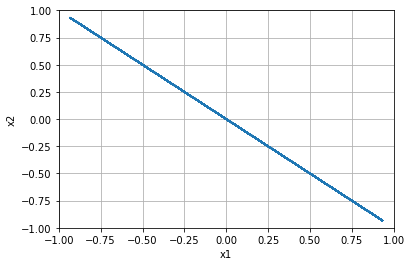


=================== Rollout 2090 =====================
x_init [[0.6]
 [1. ]]
x_buffer [[0.6 0.6 0.6 0.6 0.6]
 [1.  1.  1.  1.  1. ]]
x [0.6 1. ]
xx [0.6 1. ]
xxx [0.6 1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6000000000000001, 1.0]


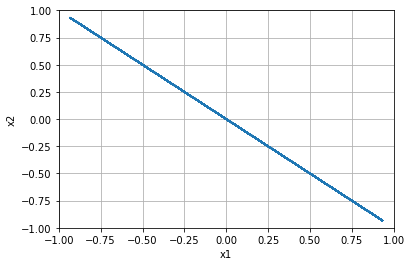


=================== Rollout 2091 =====================
x_init [[ 0.64]
 [-1.  ]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.64 -1.  ]
xx [ 0.64 -1.  ]
xxx [ 0.64 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -1.0]


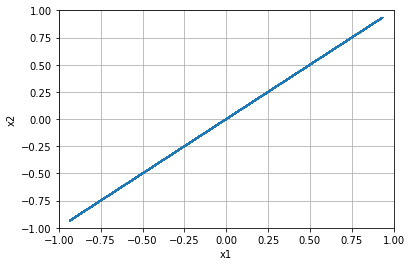


=================== Rollout 2092 =====================
x_init [[ 0.64]
 [-0.96]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.64 -0.96]
xx [ 0.64 -0.96]
xxx [ 0.64 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.96]


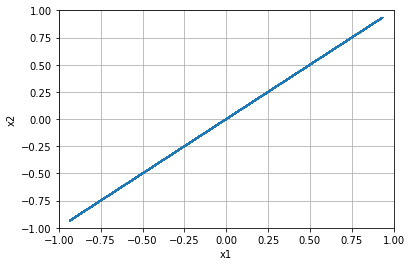


=================== Rollout 2093 =====================
x_init [[ 0.64]
 [-0.92]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.64 -0.92]
xx [ 0.64 -0.92]
xxx [ 0.64 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.92]


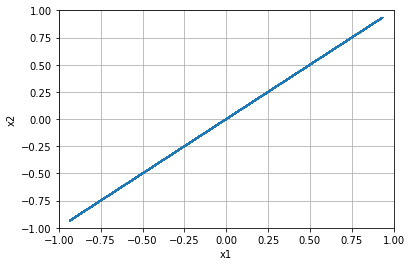


=================== Rollout 2094 =====================
x_init [[ 0.64]
 [-0.88]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.64 -0.88]
xx [ 0.64 -0.88]
xxx [ 0.64 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.88]


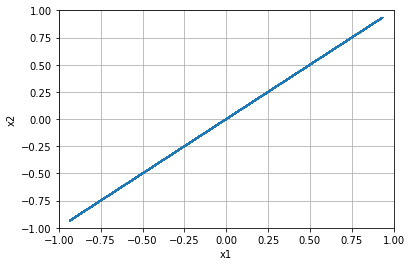


=================== Rollout 2095 =====================
x_init [[ 0.64]
 [-0.84]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.64 -0.84]
xx [ 0.64 -0.84]
xxx [ 0.64 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.84]


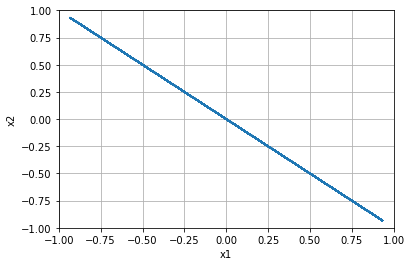


=================== Rollout 2096 =====================
x_init [[ 0.64]
 [-0.8 ]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.64 -0.8 ]
xx [ 0.64 -0.8 ]
xxx [ 0.64 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.8]


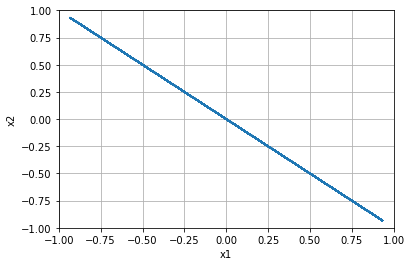


=================== Rollout 2097 =====================
x_init [[ 0.64]
 [-0.76]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.64 -0.76]
xx [ 0.64 -0.76]
xxx [ 0.64 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.76]


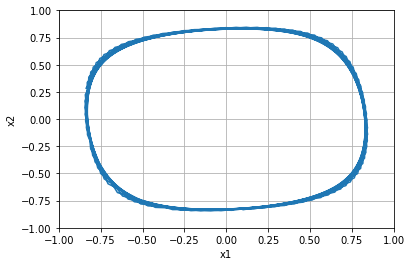


=================== Rollout 2098 =====================
x_init [[ 0.64]
 [-0.72]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.64 -0.72]
xx [ 0.64 -0.72]
xxx [ 0.64 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.72]


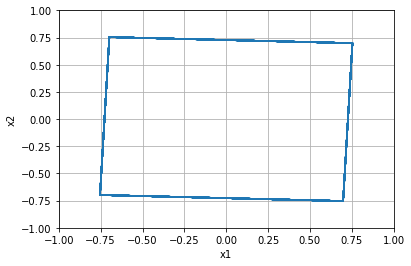


=================== Rollout 2099 =====================
x_init [[ 0.64]
 [-0.68]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.64 -0.68]
xx [ 0.64 -0.68]
xxx [ 0.64 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.6799999999999999]


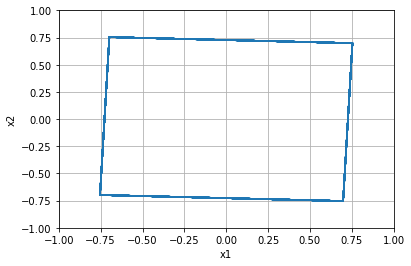


=================== Rollout 2100 =====================
x_init [[ 0.64]
 [-0.64]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.64 -0.64]
xx [ 0.64 -0.64]
xxx [ 0.64 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.64]


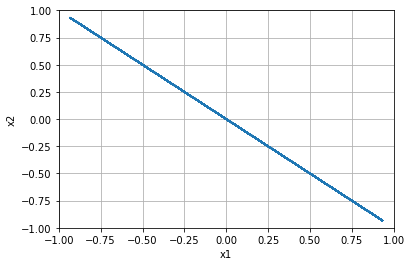


=================== Rollout 2101 =====================
x_init [[ 0.64]
 [-0.6 ]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.64 -0.6 ]
xx [ 0.64 -0.6 ]
xxx [ 0.64 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.6]


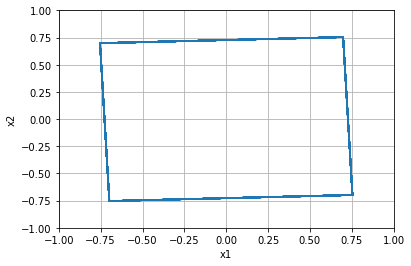


=================== Rollout 2102 =====================
x_init [[ 0.64]
 [-0.56]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.64 -0.56]
xx [ 0.64 -0.56]
xxx [ 0.64 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.56]


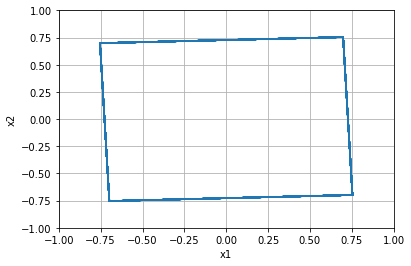


=================== Rollout 2103 =====================
x_init [[ 0.64]
 [-0.52]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.64 -0.52]
xx [ 0.64 -0.52]
xxx [ 0.64 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.52]


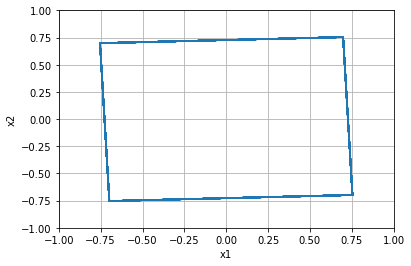


=================== Rollout 2104 =====================
x_init [[ 0.64]
 [-0.48]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.64 -0.48]
xx [ 0.64 -0.48]
xxx [ 0.64 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.48]


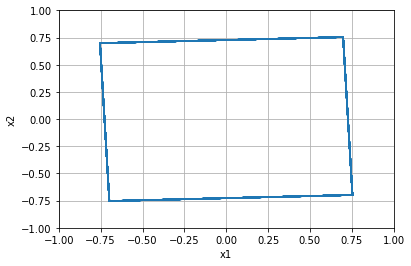


=================== Rollout 2105 =====================
x_init [[ 0.64]
 [-0.44]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.64 -0.44]
xx [ 0.64 -0.44]
xxx [ 0.64 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.43999999999999995]


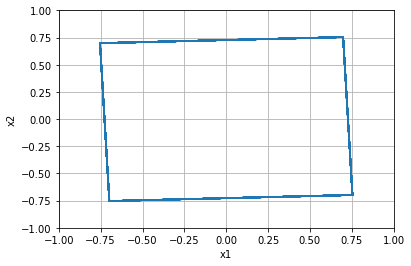


=================== Rollout 2106 =====================
x_init [[ 0.64]
 [-0.4 ]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.64 -0.4 ]
xx [ 0.64 -0.4 ]
xxx [ 0.64 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.4]


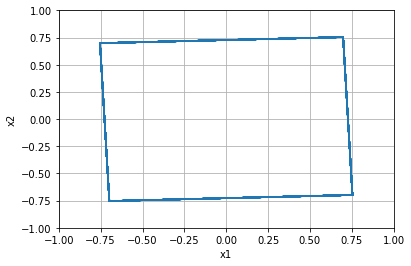


=================== Rollout 2107 =====================
x_init [[ 0.64]
 [-0.36]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.64 -0.36]
xx [ 0.64 -0.36]
xxx [ 0.64 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.36]


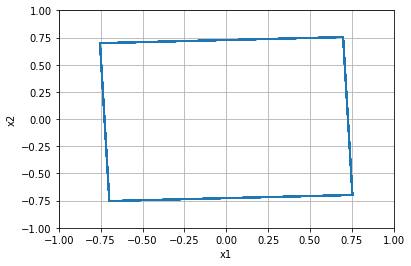


=================== Rollout 2108 =====================
x_init [[ 0.64]
 [-0.32]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.64 -0.32]
xx [ 0.64 -0.32]
xxx [ 0.64 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.31999999999999995]


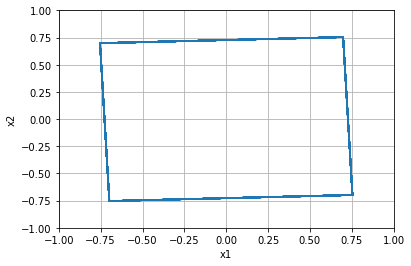


=================== Rollout 2109 =====================
x_init [[ 0.64]
 [-0.28]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.64 -0.28]
xx [ 0.64 -0.28]
xxx [ 0.64 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.28]


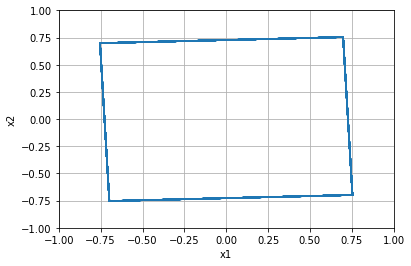


=================== Rollout 2110 =====================
x_init [[ 0.64]
 [-0.24]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.64 -0.24]
xx [ 0.64 -0.24]
xxx [ 0.64 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.24]


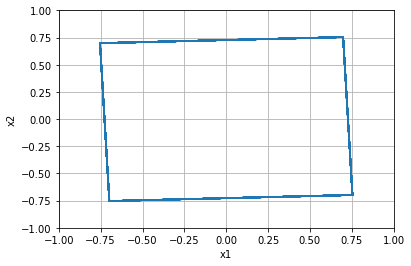


=================== Rollout 2111 =====================
x_init [[ 0.64]
 [-0.2 ]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.64 -0.2 ]
xx [ 0.64 -0.2 ]
xxx [ 0.64 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.19999999999999996]


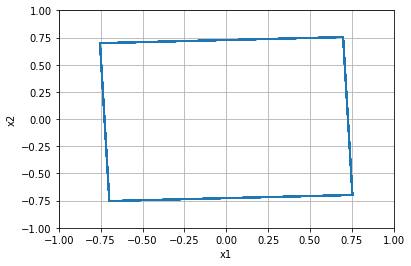


=================== Rollout 2112 =====================
x_init [[ 0.64]
 [-0.16]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.64 -0.16]
xx [ 0.64 -0.16]
xxx [ 0.64 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.16000000000000003]


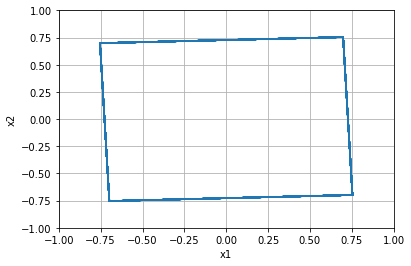


=================== Rollout 2113 =====================
x_init [[ 0.64]
 [-0.12]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.64 -0.12]
xx [ 0.64 -0.12]
xxx [ 0.64 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.12]


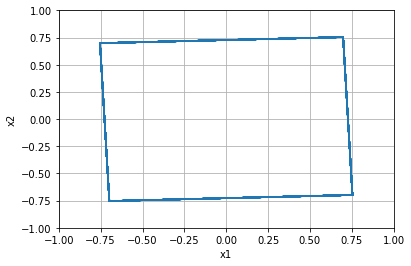


=================== Rollout 2114 =====================
x_init [[ 0.64]
 [-0.08]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.64 -0.08]
xx [ 0.64 -0.08]
xxx [ 0.64 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.07999999999999996]


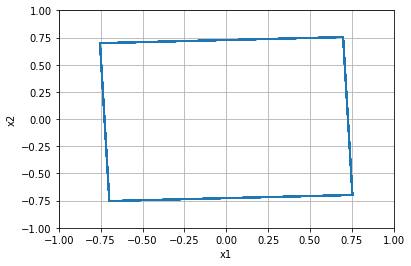


=================== Rollout 2115 =====================
x_init [[ 0.64]
 [-0.04]]
x_buffer [[ 0.64  0.64  0.64  0.64  0.64]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.64 -0.04]
xx [ 0.64 -0.04]
xxx [ 0.64 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, -0.040000000000000036]


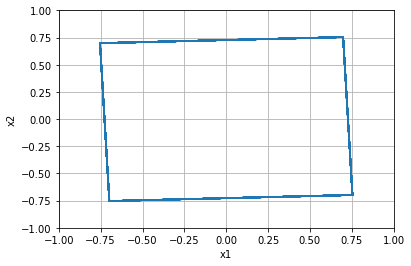


=================== Rollout 2116 =====================
x_init [[0.64]
 [0.  ]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.   0.   0.   0.   0.  ]]
x [0.64 0.  ]
xx [0.64 0.  ]
xxx [0.64 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.0]


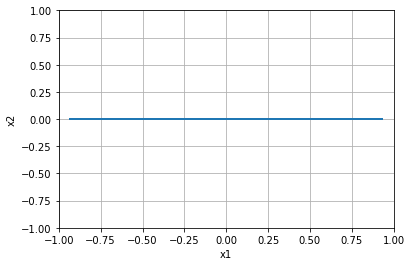


=================== Rollout 2117 =====================
x_init [[0.64]
 [0.04]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.64 0.04]
xx [0.64 0.04]
xxx [0.64 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.040000000000000036]


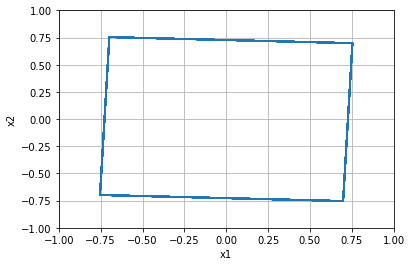


=================== Rollout 2118 =====================
x_init [[0.64]
 [0.08]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.64 0.08]
xx [0.64 0.08]
xxx [0.64 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.08000000000000007]


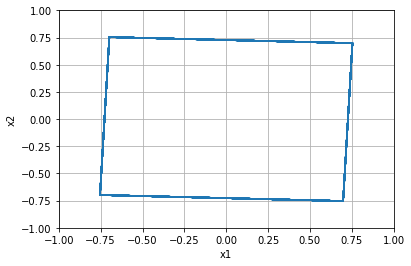


=================== Rollout 2119 =====================
x_init [[0.64]
 [0.12]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.64 0.12]
xx [0.64 0.12]
xxx [0.64 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.1200000000000001]


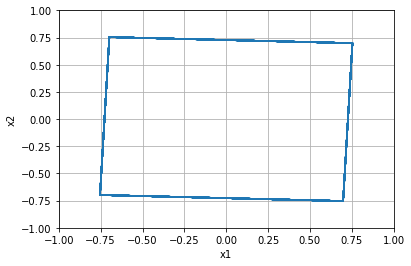


=================== Rollout 2120 =====================
x_init [[0.64]
 [0.16]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.64 0.16]
xx [0.64 0.16]
xxx [0.64 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.15999999999999992]


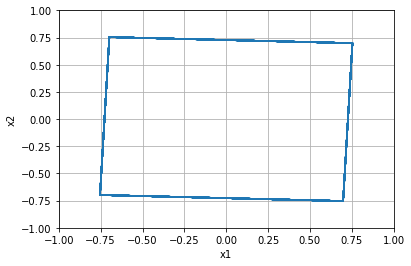


=================== Rollout 2121 =====================
x_init [[0.64]
 [0.2 ]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.64 0.2 ]
xx [0.64 0.2 ]
xxx [0.64 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.19999999999999996]


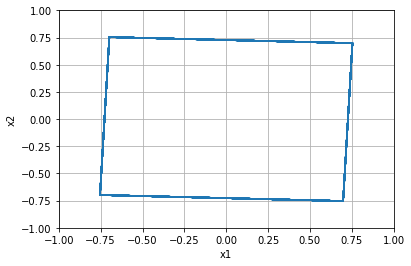


=================== Rollout 2122 =====================
x_init [[0.64]
 [0.24]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.64 0.24]
xx [0.64 0.24]
xxx [0.64 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.24]


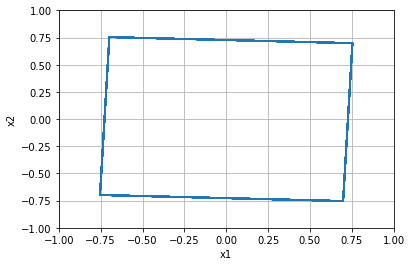


=================== Rollout 2123 =====================
x_init [[0.64]
 [0.28]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.64 0.28]
xx [0.64 0.28]
xxx [0.64 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.28]


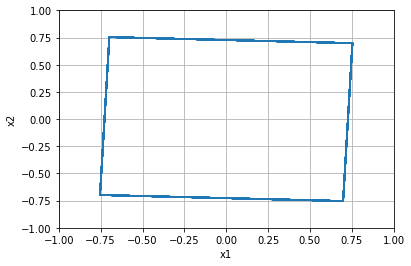


=================== Rollout 2124 =====================
x_init [[0.64]
 [0.32]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.64 0.32]
xx [0.64 0.32]
xxx [0.64 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.32000000000000006]


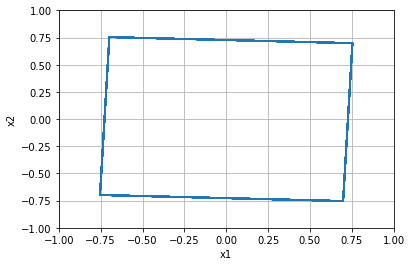


=================== Rollout 2125 =====================
x_init [[0.64]
 [0.36]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.64 0.36]
xx [0.64 0.36]
xxx [0.64 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.3600000000000001]


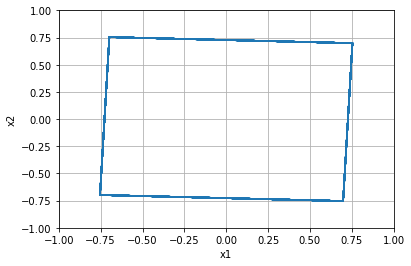


=================== Rollout 2126 =====================
x_init [[0.64]
 [0.4 ]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.64 0.4 ]
xx [0.64 0.4 ]
xxx [0.64 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.40000000000000013]


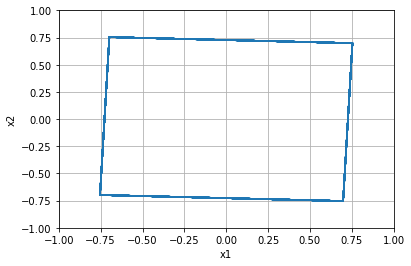


=================== Rollout 2127 =====================
x_init [[0.64]
 [0.44]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.64 0.44]
xx [0.64 0.44]
xxx [0.64 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.43999999999999995]


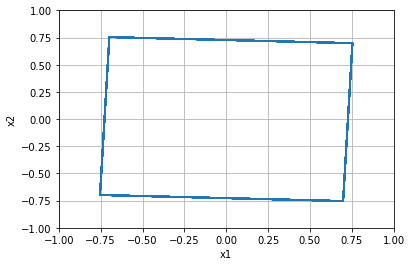


=================== Rollout 2128 =====================
x_init [[0.64]
 [0.48]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.64 0.48]
xx [0.64 0.48]
xxx [0.64 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.48]


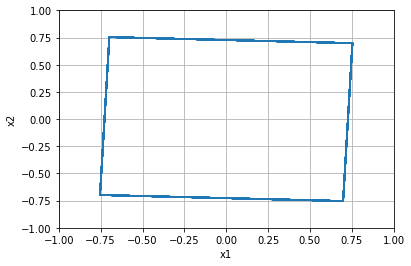


=================== Rollout 2129 =====================
x_init [[0.64]
 [0.52]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.64 0.52]
xx [0.64 0.52]
xxx [0.64 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.52]


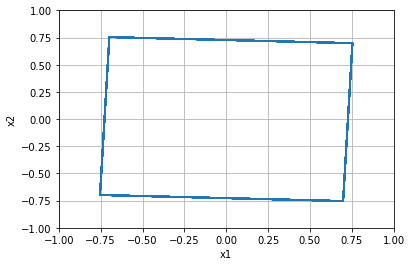


=================== Rollout 2130 =====================
x_init [[0.64]
 [0.56]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.64 0.56]
xx [0.64 0.56]
xxx [0.64 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.56]


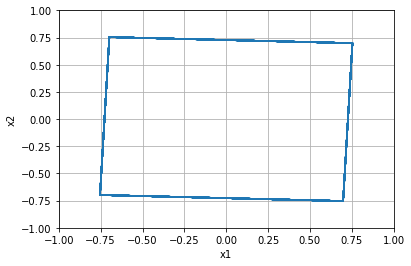


=================== Rollout 2131 =====================
x_init [[0.64]
 [0.6 ]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.64 0.6 ]
xx [0.64 0.6 ]
xxx [0.64 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.6000000000000001]


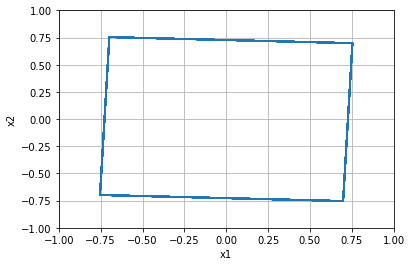


=================== Rollout 2132 =====================
x_init [[0.64]
 [0.64]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.64 0.64]
xx [0.64 0.64]
xxx [0.64 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.6400000000000001]


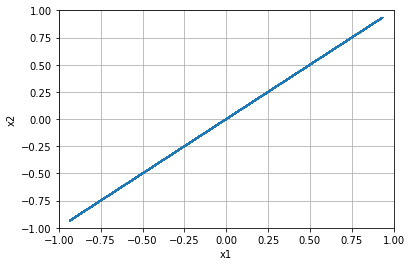


=================== Rollout 2133 =====================
x_init [[0.64]
 [0.68]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.64 0.68]
xx [0.64 0.68]
xxx [0.64 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.6799999999999999]


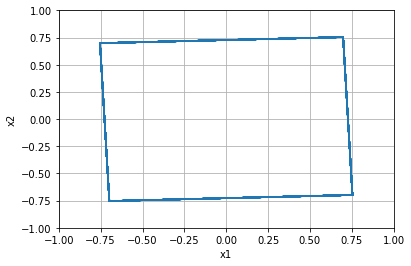


=================== Rollout 2134 =====================
x_init [[0.64]
 [0.72]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.64 0.72]
xx [0.64 0.72]
xxx [0.64 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.72]


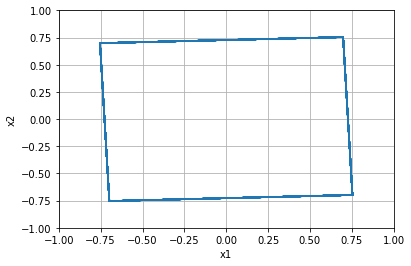


=================== Rollout 2135 =====================
x_init [[0.64]
 [0.76]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.64 0.76]
xx [0.64 0.76]
xxx [0.64 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.76]


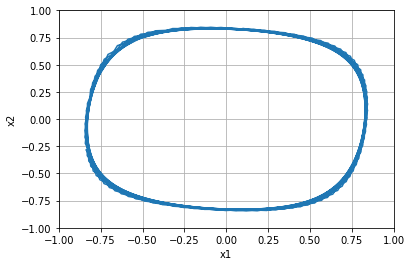


=================== Rollout 2136 =====================
x_init [[0.64]
 [0.8 ]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.64 0.8 ]
xx [0.64 0.8 ]
xxx [0.64 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.8]


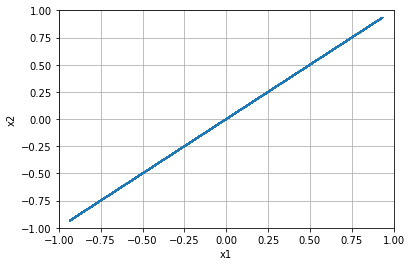


=================== Rollout 2137 =====================
x_init [[0.64]
 [0.84]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.64 0.84]
xx [0.64 0.84]
xxx [0.64 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.8400000000000001]


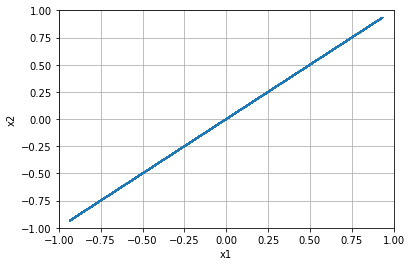


=================== Rollout 2138 =====================
x_init [[0.64]
 [0.88]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.64 0.88]
xx [0.64 0.88]
xxx [0.64 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.8800000000000001]


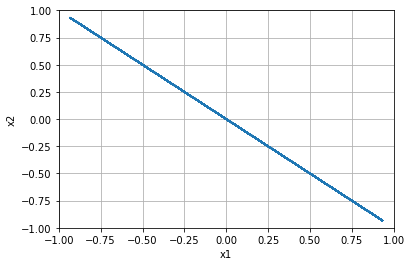


=================== Rollout 2139 =====================
x_init [[0.64]
 [0.92]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.64 0.92]
xx [0.64 0.92]
xxx [0.64 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.9199999999999999]


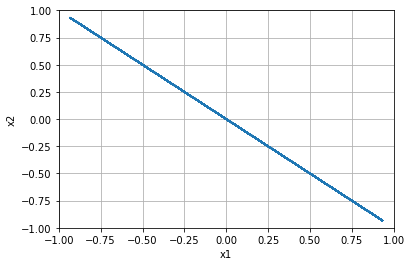


=================== Rollout 2140 =====================
x_init [[0.64]
 [0.96]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.64 0.96]
xx [0.64 0.96]
xxx [0.64 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 0.96]


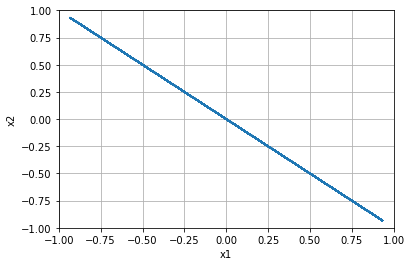


=================== Rollout 2141 =====================
x_init [[0.64]
 [1.  ]]
x_buffer [[0.64 0.64 0.64 0.64 0.64]
 [1.   1.   1.   1.   1.  ]]
x [0.64 1.  ]
xx [0.64 1.  ]
xxx [0.64 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6400000000000001, 1.0]


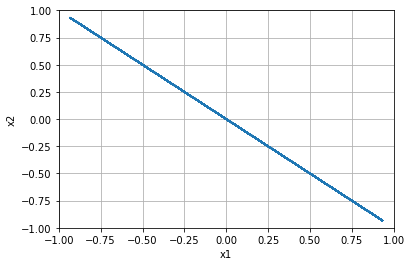


=================== Rollout 2142 =====================
x_init [[ 0.68]
 [-1.  ]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.68 -1.  ]
xx [ 0.68 -1.  ]
xxx [ 0.68 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -1.0]


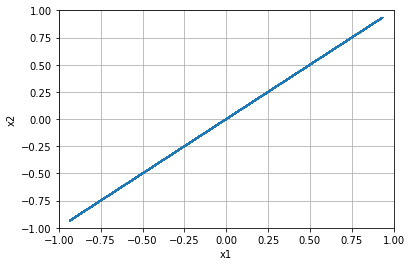


=================== Rollout 2143 =====================
x_init [[ 0.68]
 [-0.96]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.68 -0.96]
xx [ 0.68 -0.96]
xxx [ 0.68 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.96]


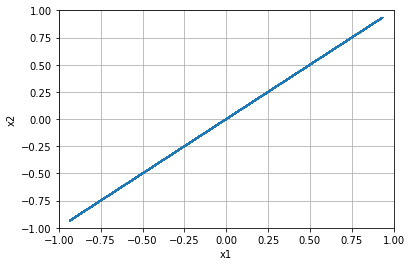


=================== Rollout 2144 =====================
x_init [[ 0.68]
 [-0.92]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.68 -0.92]
xx [ 0.68 -0.92]
xxx [ 0.68 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.92]


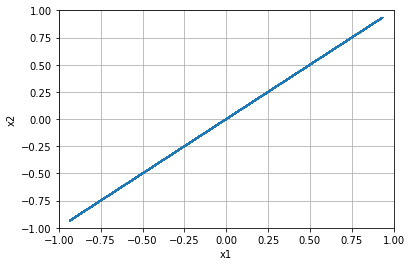


=================== Rollout 2145 =====================
x_init [[ 0.68]
 [-0.88]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.68 -0.88]
xx [ 0.68 -0.88]
xxx [ 0.68 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.88]


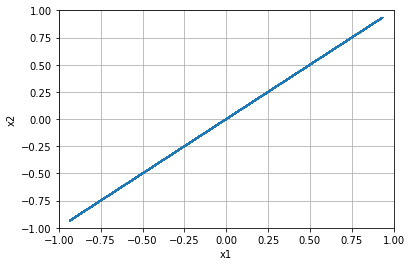


=================== Rollout 2146 =====================
x_init [[ 0.68]
 [-0.84]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.68 -0.84]
xx [ 0.68 -0.84]
xxx [ 0.68 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.84]


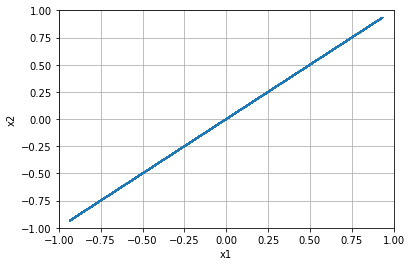


=================== Rollout 2147 =====================
x_init [[ 0.68]
 [-0.8 ]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.68 -0.8 ]
xx [ 0.68 -0.8 ]
xxx [ 0.68 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.8]


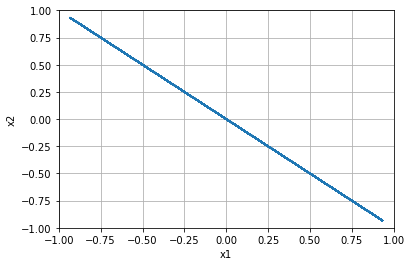


=================== Rollout 2148 =====================
x_init [[ 0.68]
 [-0.76]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.68 -0.76]
xx [ 0.68 -0.76]
xxx [ 0.68 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.76]


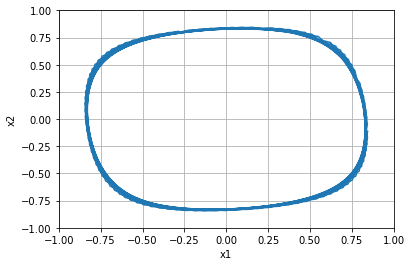


=================== Rollout 2149 =====================
x_init [[ 0.68]
 [-0.72]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.68 -0.72]
xx [ 0.68 -0.72]
xxx [ 0.68 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.72]


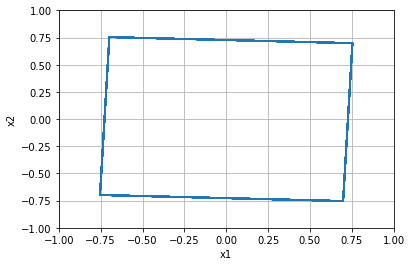


=================== Rollout 2150 =====================
x_init [[ 0.68]
 [-0.68]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.68 -0.68]
xx [ 0.68 -0.68]
xxx [ 0.68 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.6799999999999999]


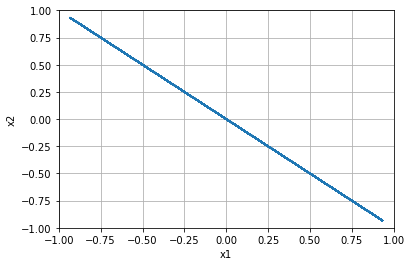


=================== Rollout 2151 =====================
x_init [[ 0.68]
 [-0.64]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.68 -0.64]
xx [ 0.68 -0.64]
xxx [ 0.68 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.64]


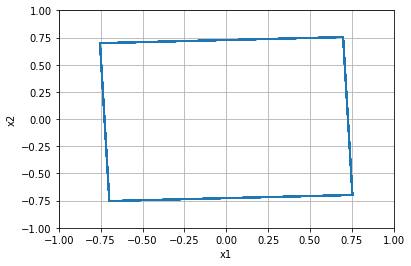


=================== Rollout 2152 =====================
x_init [[ 0.68]
 [-0.6 ]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.68 -0.6 ]
xx [ 0.68 -0.6 ]
xxx [ 0.68 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.6]


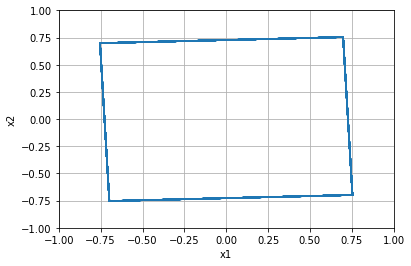


=================== Rollout 2153 =====================
x_init [[ 0.68]
 [-0.56]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.68 -0.56]
xx [ 0.68 -0.56]
xxx [ 0.68 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.56]


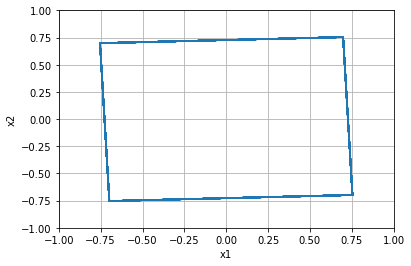


=================== Rollout 2154 =====================
x_init [[ 0.68]
 [-0.52]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.68 -0.52]
xx [ 0.68 -0.52]
xxx [ 0.68 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.52]


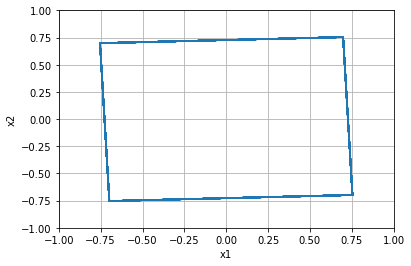


=================== Rollout 2155 =====================
x_init [[ 0.68]
 [-0.48]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.68 -0.48]
xx [ 0.68 -0.48]
xxx [ 0.68 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.48]


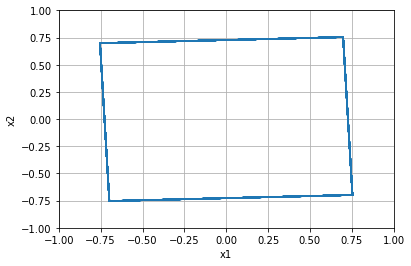


=================== Rollout 2156 =====================
x_init [[ 0.68]
 [-0.44]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.68 -0.44]
xx [ 0.68 -0.44]
xxx [ 0.68 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.43999999999999995]


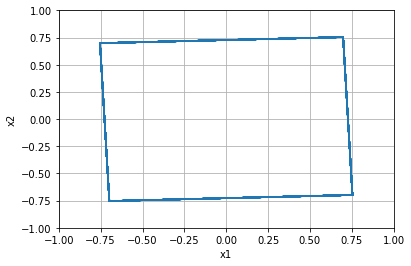


=================== Rollout 2157 =====================
x_init [[ 0.68]
 [-0.4 ]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.68 -0.4 ]
xx [ 0.68 -0.4 ]
xxx [ 0.68 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.4]


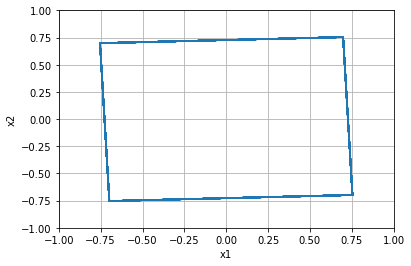


=================== Rollout 2158 =====================
x_init [[ 0.68]
 [-0.36]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.68 -0.36]
xx [ 0.68 -0.36]
xxx [ 0.68 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.36]


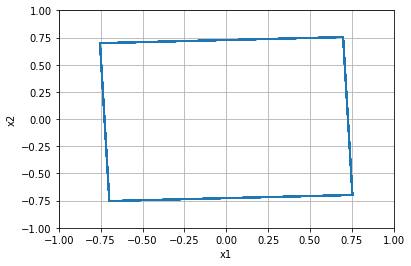


=================== Rollout 2159 =====================
x_init [[ 0.68]
 [-0.32]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.68 -0.32]
xx [ 0.68 -0.32]
xxx [ 0.68 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.31999999999999995]


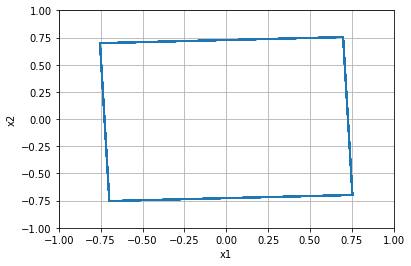


=================== Rollout 2160 =====================
x_init [[ 0.68]
 [-0.28]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.68 -0.28]
xx [ 0.68 -0.28]
xxx [ 0.68 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.28]


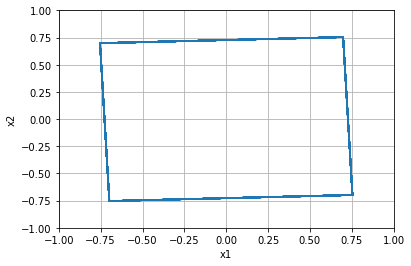


=================== Rollout 2161 =====================
x_init [[ 0.68]
 [-0.24]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.68 -0.24]
xx [ 0.68 -0.24]
xxx [ 0.68 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.24]


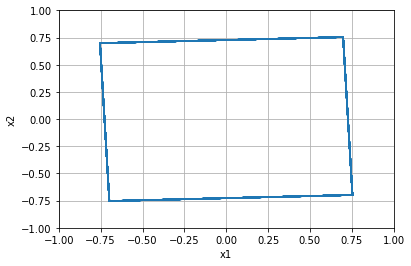


=================== Rollout 2162 =====================
x_init [[ 0.68]
 [-0.2 ]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.68 -0.2 ]
xx [ 0.68 -0.2 ]
xxx [ 0.68 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.19999999999999996]


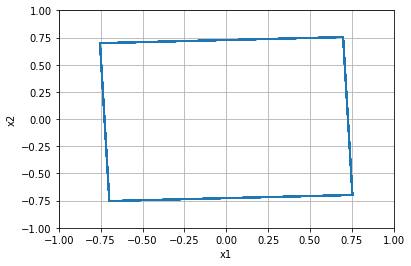


=================== Rollout 2163 =====================
x_init [[ 0.68]
 [-0.16]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.68 -0.16]
xx [ 0.68 -0.16]
xxx [ 0.68 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.16000000000000003]


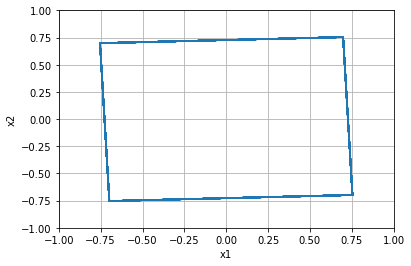


=================== Rollout 2164 =====================
x_init [[ 0.68]
 [-0.12]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.68 -0.12]
xx [ 0.68 -0.12]
xxx [ 0.68 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.12]


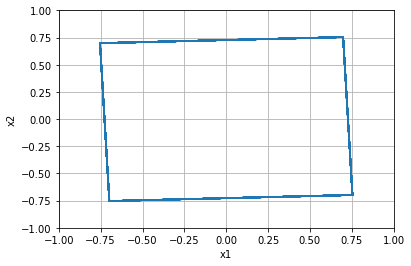


=================== Rollout 2165 =====================
x_init [[ 0.68]
 [-0.08]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.68 -0.08]
xx [ 0.68 -0.08]
xxx [ 0.68 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.07999999999999996]


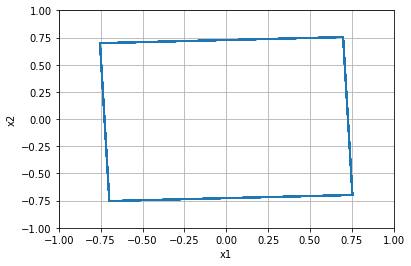


=================== Rollout 2166 =====================
x_init [[ 0.68]
 [-0.04]]
x_buffer [[ 0.68  0.68  0.68  0.68  0.68]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.68 -0.04]
xx [ 0.68 -0.04]
xxx [ 0.68 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, -0.040000000000000036]


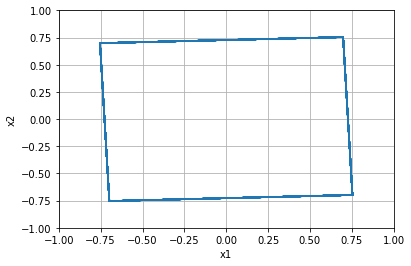


=================== Rollout 2167 =====================
x_init [[0.68]
 [0.  ]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.   0.   0.   0.   0.  ]]
x [0.68 0.  ]
xx [0.68 0.  ]
xxx [0.68 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.0]


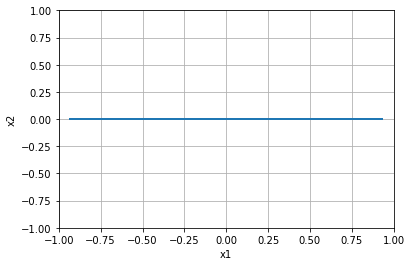


=================== Rollout 2168 =====================
x_init [[0.68]
 [0.04]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.68 0.04]
xx [0.68 0.04]
xxx [0.68 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.040000000000000036]


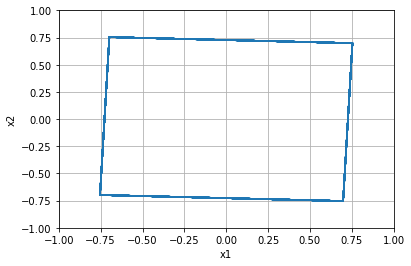


=================== Rollout 2169 =====================
x_init [[0.68]
 [0.08]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.68 0.08]
xx [0.68 0.08]
xxx [0.68 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.08000000000000007]


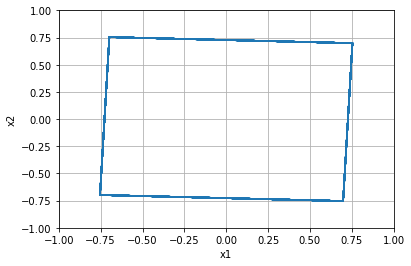


=================== Rollout 2170 =====================
x_init [[0.68]
 [0.12]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.68 0.12]
xx [0.68 0.12]
xxx [0.68 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.1200000000000001]


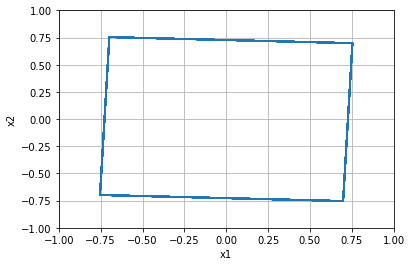


=================== Rollout 2171 =====================
x_init [[0.68]
 [0.16]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.68 0.16]
xx [0.68 0.16]
xxx [0.68 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.15999999999999992]


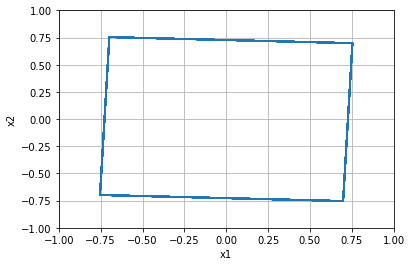


=================== Rollout 2172 =====================
x_init [[0.68]
 [0.2 ]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.68 0.2 ]
xx [0.68 0.2 ]
xxx [0.68 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.19999999999999996]


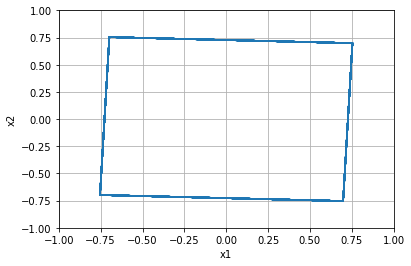


=================== Rollout 2173 =====================
x_init [[0.68]
 [0.24]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.68 0.24]
xx [0.68 0.24]
xxx [0.68 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.24]


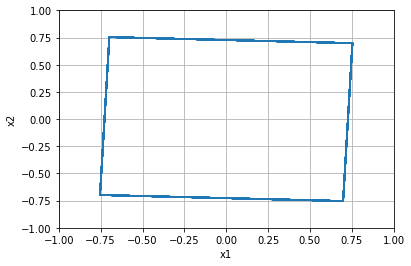


=================== Rollout 2174 =====================
x_init [[0.68]
 [0.28]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.68 0.28]
xx [0.68 0.28]
xxx [0.68 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.28]


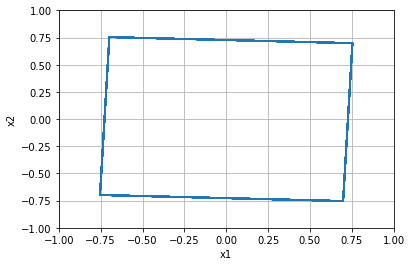


=================== Rollout 2175 =====================
x_init [[0.68]
 [0.32]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.68 0.32]
xx [0.68 0.32]
xxx [0.68 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.32000000000000006]


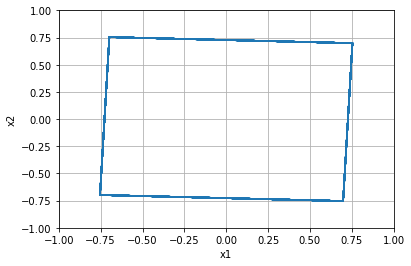


=================== Rollout 2176 =====================
x_init [[0.68]
 [0.36]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.68 0.36]
xx [0.68 0.36]
xxx [0.68 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.3600000000000001]


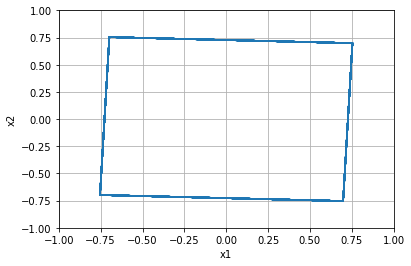


=================== Rollout 2177 =====================
x_init [[0.68]
 [0.4 ]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.68 0.4 ]
xx [0.68 0.4 ]
xxx [0.68 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.40000000000000013]


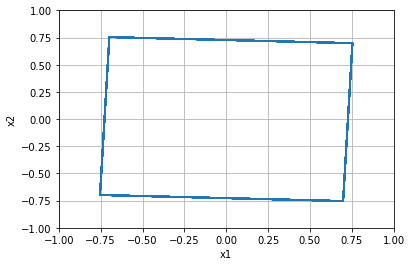


=================== Rollout 2178 =====================
x_init [[0.68]
 [0.44]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.68 0.44]
xx [0.68 0.44]
xxx [0.68 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.43999999999999995]


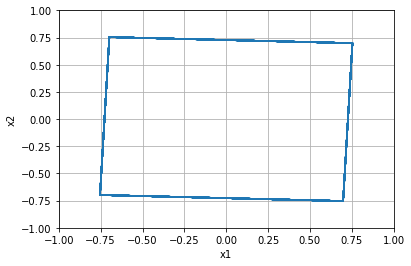


=================== Rollout 2179 =====================
x_init [[0.68]
 [0.48]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.68 0.48]
xx [0.68 0.48]
xxx [0.68 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.48]


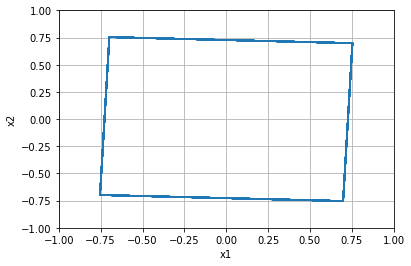


=================== Rollout 2180 =====================
x_init [[0.68]
 [0.52]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.68 0.52]
xx [0.68 0.52]
xxx [0.68 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.52]


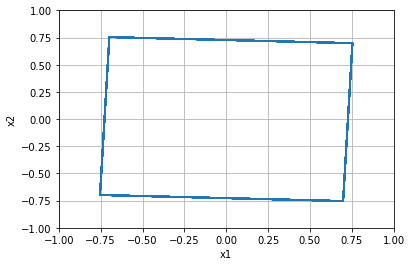


=================== Rollout 2181 =====================
x_init [[0.68]
 [0.56]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.68 0.56]
xx [0.68 0.56]
xxx [0.68 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.56]


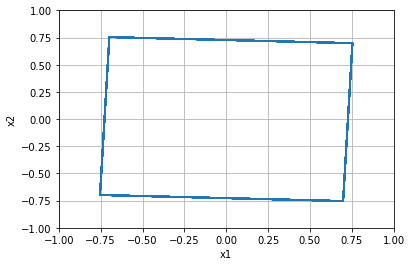


=================== Rollout 2182 =====================
x_init [[0.68]
 [0.6 ]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.68 0.6 ]
xx [0.68 0.6 ]
xxx [0.68 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.6000000000000001]


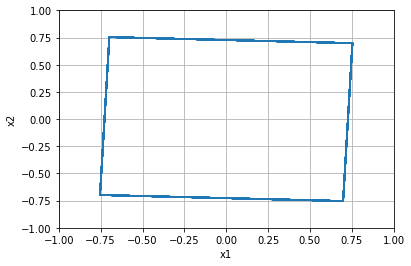


=================== Rollout 2183 =====================
x_init [[0.68]
 [0.64]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.68 0.64]
xx [0.68 0.64]
xxx [0.68 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.6400000000000001]


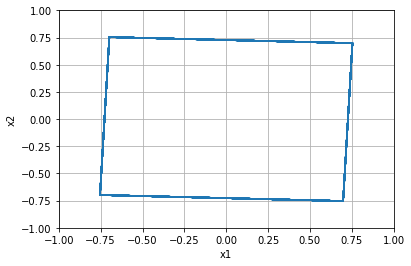


=================== Rollout 2184 =====================
x_init [[0.68]
 [0.68]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.68 0.68]
xx [0.68 0.68]
xxx [0.68 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.6799999999999999]


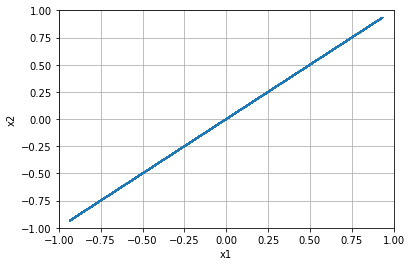


=================== Rollout 2185 =====================
x_init [[0.68]
 [0.72]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.68 0.72]
xx [0.68 0.72]
xxx [0.68 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.72]


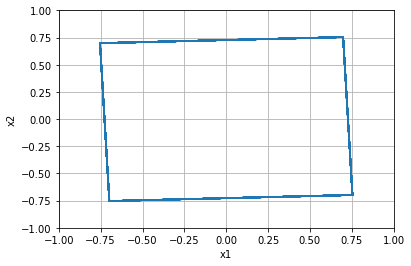


=================== Rollout 2186 =====================
x_init [[0.68]
 [0.76]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.68 0.76]
xx [0.68 0.76]
xxx [0.68 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.76]


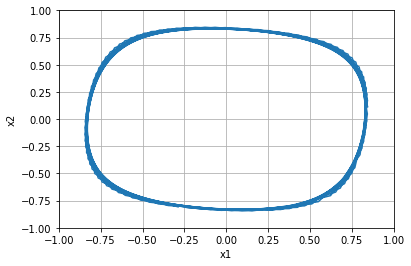


=================== Rollout 2187 =====================
x_init [[0.68]
 [0.8 ]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.68 0.8 ]
xx [0.68 0.8 ]
xxx [0.68 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.8]


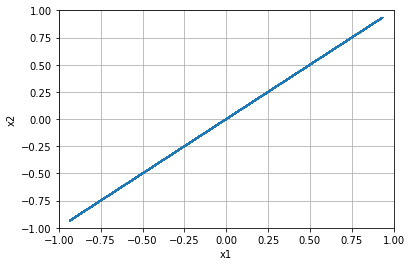


=================== Rollout 2188 =====================
x_init [[0.68]
 [0.84]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.68 0.84]
xx [0.68 0.84]
xxx [0.68 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.8400000000000001]


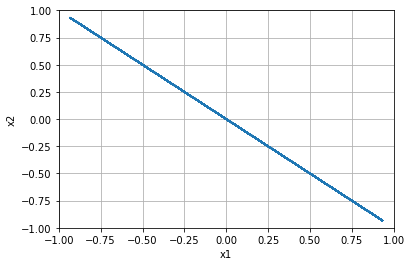


=================== Rollout 2189 =====================
x_init [[0.68]
 [0.88]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.68 0.88]
xx [0.68 0.88]
xxx [0.68 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.8800000000000001]


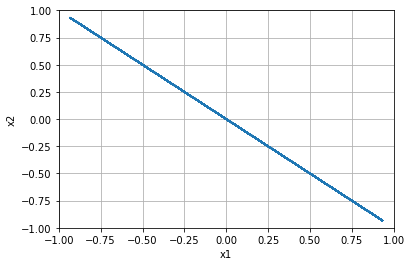


=================== Rollout 2190 =====================
x_init [[0.68]
 [0.92]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.68 0.92]
xx [0.68 0.92]
xxx [0.68 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.9199999999999999]


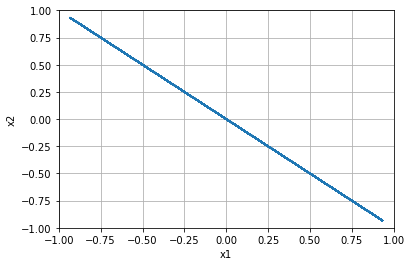


=================== Rollout 2191 =====================
x_init [[0.68]
 [0.96]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.68 0.96]
xx [0.68 0.96]
xxx [0.68 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 0.96]


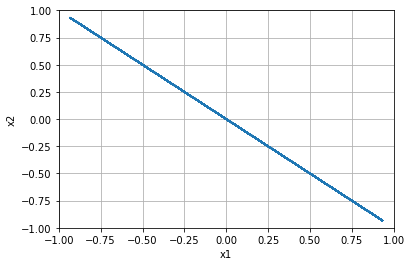


=================== Rollout 2192 =====================
x_init [[0.68]
 [1.  ]]
x_buffer [[0.68 0.68 0.68 0.68 0.68]
 [1.   1.   1.   1.   1.  ]]
x [0.68 1.  ]
xx [0.68 1.  ]
xxx [0.68 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.6799999999999999, 1.0]


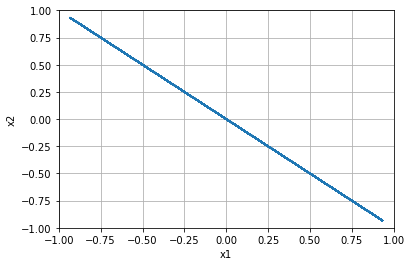


=================== Rollout 2193 =====================
x_init [[ 0.72]
 [-1.  ]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.72 -1.  ]
xx [ 0.72 -1.  ]
xxx [ 0.72 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -1.0]


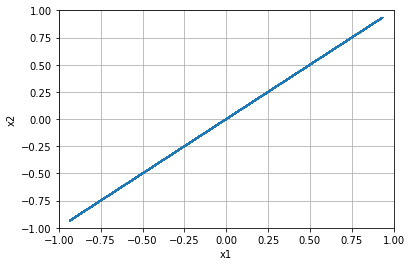


=================== Rollout 2194 =====================
x_init [[ 0.72]
 [-0.96]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.72 -0.96]
xx [ 0.72 -0.96]
xxx [ 0.72 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.96]


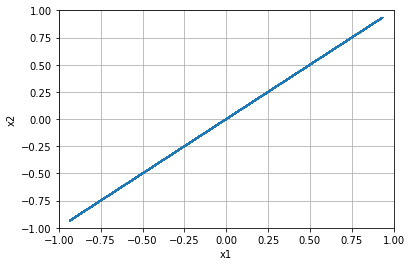


=================== Rollout 2195 =====================
x_init [[ 0.72]
 [-0.92]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.72 -0.92]
xx [ 0.72 -0.92]
xxx [ 0.72 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.92]


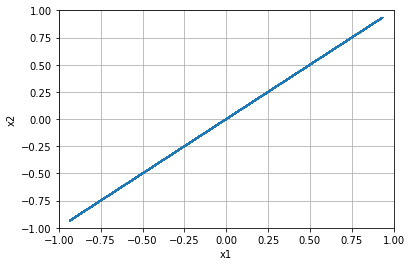


=================== Rollout 2196 =====================
x_init [[ 0.72]
 [-0.88]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.72 -0.88]
xx [ 0.72 -0.88]
xxx [ 0.72 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.88]


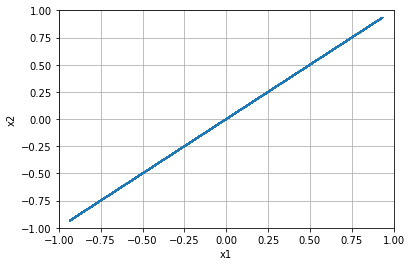


=================== Rollout 2197 =====================
x_init [[ 0.72]
 [-0.84]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.72 -0.84]
xx [ 0.72 -0.84]
xxx [ 0.72 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.84]


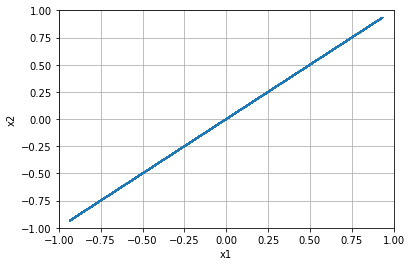


=================== Rollout 2198 =====================
x_init [[ 0.72]
 [-0.8 ]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.72 -0.8 ]
xx [ 0.72 -0.8 ]
xxx [ 0.72 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.8]


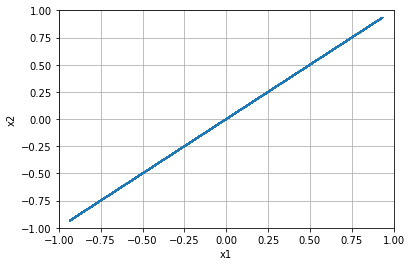


=================== Rollout 2199 =====================
x_init [[ 0.72]
 [-0.76]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.72 -0.76]
xx [ 0.72 -0.76]
xxx [ 0.72 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.76]


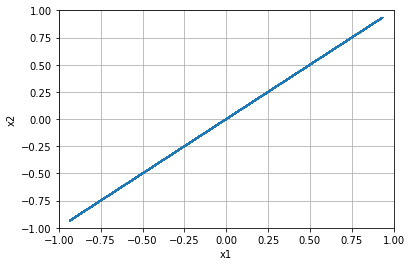


=================== Rollout 2200 =====================
x_init [[ 0.72]
 [-0.72]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.72 -0.72]
xx [ 0.72 -0.72]
xxx [ 0.72 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.72]


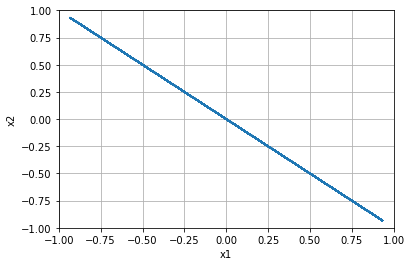


=================== Rollout 2201 =====================
x_init [[ 0.72]
 [-0.68]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.72 -0.68]
xx [ 0.72 -0.68]
xxx [ 0.72 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.6799999999999999]


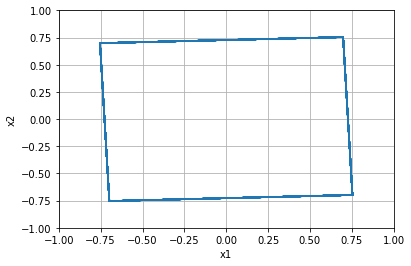


=================== Rollout 2202 =====================
x_init [[ 0.72]
 [-0.64]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.72 -0.64]
xx [ 0.72 -0.64]
xxx [ 0.72 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.64]


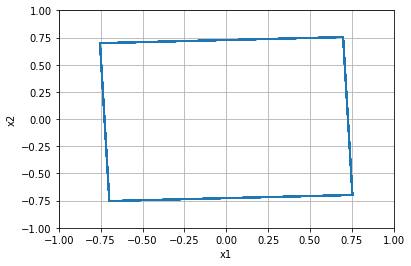


=================== Rollout 2203 =====================
x_init [[ 0.72]
 [-0.6 ]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.72 -0.6 ]
xx [ 0.72 -0.6 ]
xxx [ 0.72 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.6]


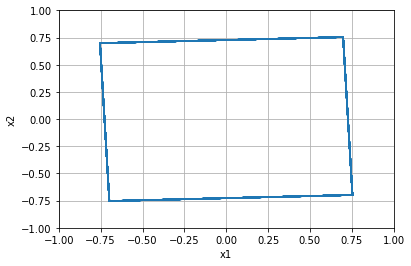


=================== Rollout 2204 =====================
x_init [[ 0.72]
 [-0.56]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.72 -0.56]
xx [ 0.72 -0.56]
xxx [ 0.72 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.56]


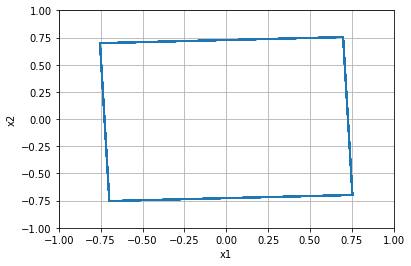


=================== Rollout 2205 =====================
x_init [[ 0.72]
 [-0.52]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.72 -0.52]
xx [ 0.72 -0.52]
xxx [ 0.72 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.52]


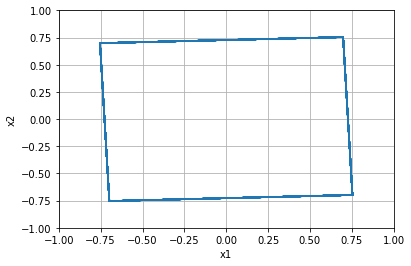


=================== Rollout 2206 =====================
x_init [[ 0.72]
 [-0.48]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.72 -0.48]
xx [ 0.72 -0.48]
xxx [ 0.72 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.48]


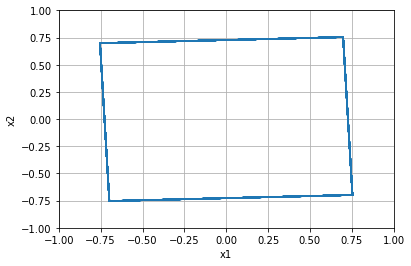


=================== Rollout 2207 =====================
x_init [[ 0.72]
 [-0.44]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.72 -0.44]
xx [ 0.72 -0.44]
xxx [ 0.72 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.43999999999999995]


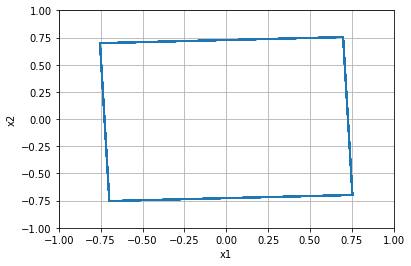


=================== Rollout 2208 =====================
x_init [[ 0.72]
 [-0.4 ]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.72 -0.4 ]
xx [ 0.72 -0.4 ]
xxx [ 0.72 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.4]


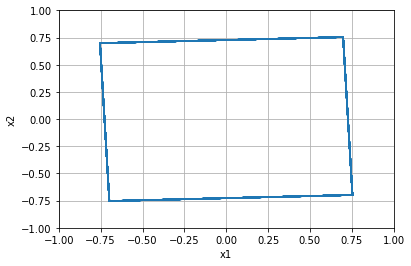


=================== Rollout 2209 =====================
x_init [[ 0.72]
 [-0.36]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.72 -0.36]
xx [ 0.72 -0.36]
xxx [ 0.72 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.36]


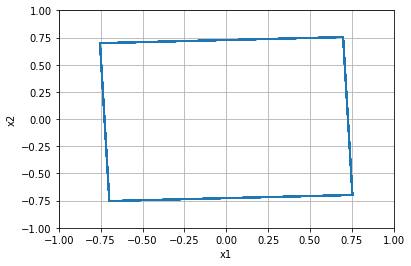


=================== Rollout 2210 =====================
x_init [[ 0.72]
 [-0.32]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.72 -0.32]
xx [ 0.72 -0.32]
xxx [ 0.72 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.31999999999999995]


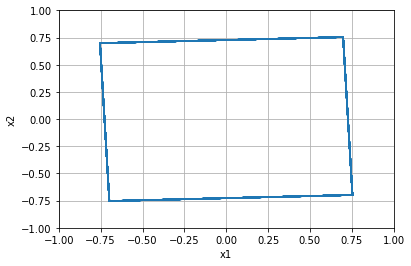


=================== Rollout 2211 =====================
x_init [[ 0.72]
 [-0.28]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.72 -0.28]
xx [ 0.72 -0.28]
xxx [ 0.72 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.28]


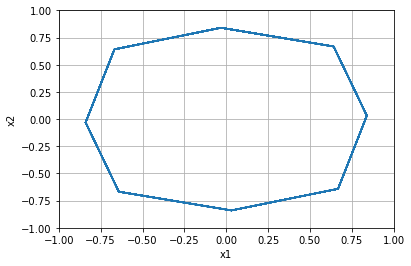


=================== Rollout 2212 =====================
x_init [[ 0.72]
 [-0.24]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.72 -0.24]
xx [ 0.72 -0.24]
xxx [ 0.72 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.24]


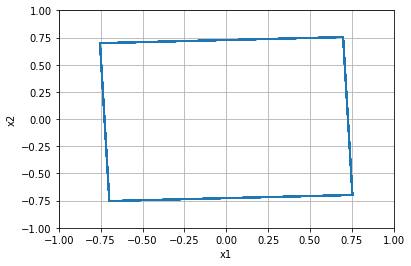


=================== Rollout 2213 =====================
x_init [[ 0.72]
 [-0.2 ]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.72 -0.2 ]
xx [ 0.72 -0.2 ]
xxx [ 0.72 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.19999999999999996]


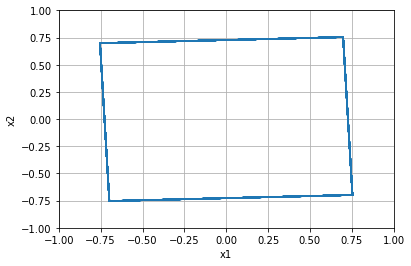


=================== Rollout 2214 =====================
x_init [[ 0.72]
 [-0.16]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.72 -0.16]
xx [ 0.72 -0.16]
xxx [ 0.72 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.16000000000000003]


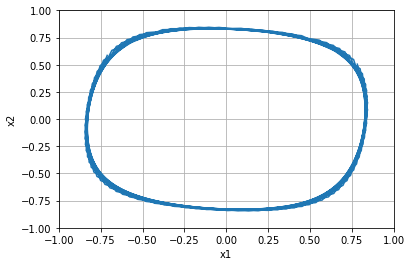


=================== Rollout 2215 =====================
x_init [[ 0.72]
 [-0.12]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.72 -0.12]
xx [ 0.72 -0.12]
xxx [ 0.72 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.12]


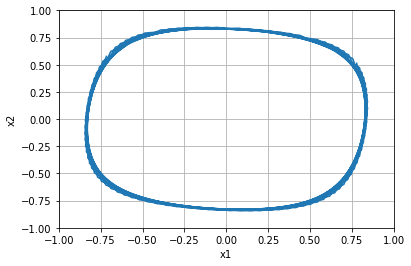


=================== Rollout 2216 =====================
x_init [[ 0.72]
 [-0.08]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.72 -0.08]
xx [ 0.72 -0.08]
xxx [ 0.72 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.07999999999999996]


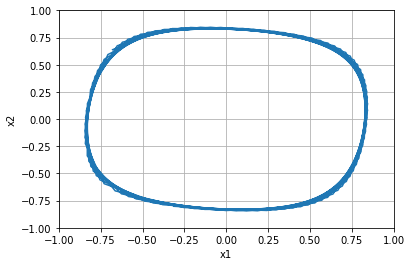


=================== Rollout 2217 =====================
x_init [[ 0.72]
 [-0.04]]
x_buffer [[ 0.72  0.72  0.72  0.72  0.72]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.72 -0.04]
xx [ 0.72 -0.04]
xxx [ 0.72 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, -0.040000000000000036]


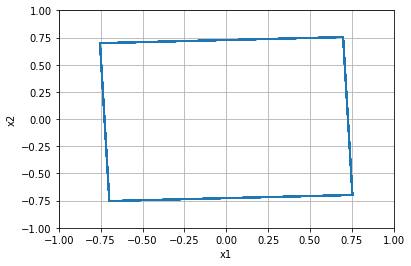


=================== Rollout 2218 =====================
x_init [[0.72]
 [0.  ]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.   0.   0.   0.   0.  ]]
x [0.72 0.  ]
xx [0.72 0.  ]
xxx [0.72 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.0]


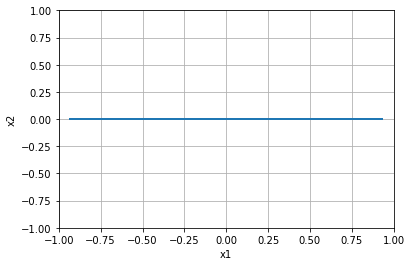


=================== Rollout 2219 =====================
x_init [[0.72]
 [0.04]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.72 0.04]
xx [0.72 0.04]
xxx [0.72 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.040000000000000036]


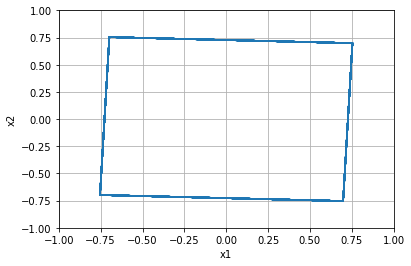


=================== Rollout 2220 =====================
x_init [[0.72]
 [0.08]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.72 0.08]
xx [0.72 0.08]
xxx [0.72 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.08000000000000007]


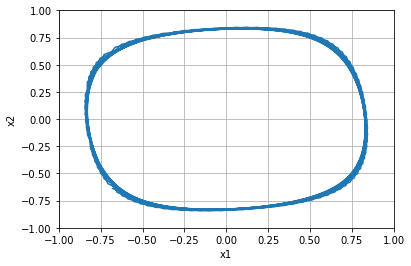


=================== Rollout 2221 =====================
x_init [[0.72]
 [0.12]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.72 0.12]
xx [0.72 0.12]
xxx [0.72 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.1200000000000001]


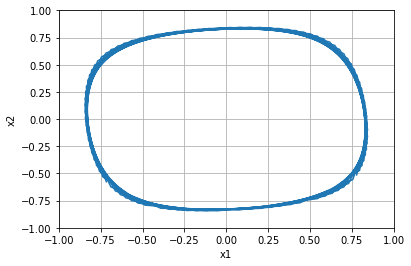


=================== Rollout 2222 =====================
x_init [[0.72]
 [0.16]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.72 0.16]
xx [0.72 0.16]
xxx [0.72 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.15999999999999992]


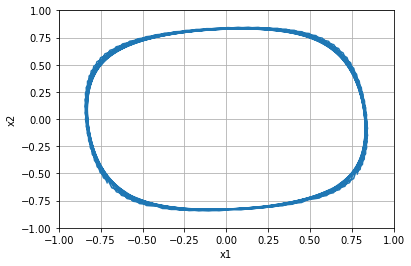


=================== Rollout 2223 =====================
x_init [[0.72]
 [0.2 ]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.72 0.2 ]
xx [0.72 0.2 ]
xxx [0.72 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.19999999999999996]


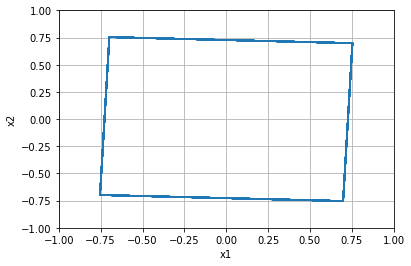


=================== Rollout 2224 =====================
x_init [[0.72]
 [0.24]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.72 0.24]
xx [0.72 0.24]
xxx [0.72 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.24]


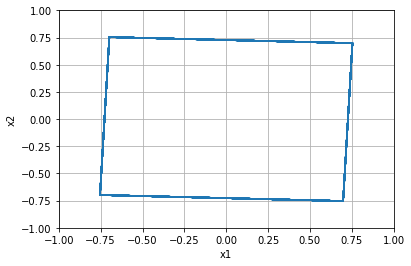


=================== Rollout 2225 =====================
x_init [[0.72]
 [0.28]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.72 0.28]
xx [0.72 0.28]
xxx [0.72 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.28]


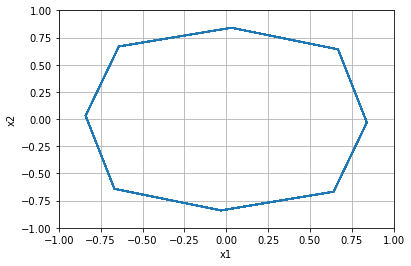


=================== Rollout 2226 =====================
x_init [[0.72]
 [0.32]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.72 0.32]
xx [0.72 0.32]
xxx [0.72 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.32000000000000006]


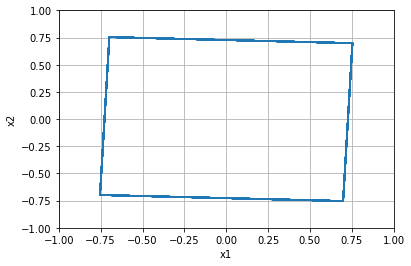


=================== Rollout 2227 =====================
x_init [[0.72]
 [0.36]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.72 0.36]
xx [0.72 0.36]
xxx [0.72 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.3600000000000001]


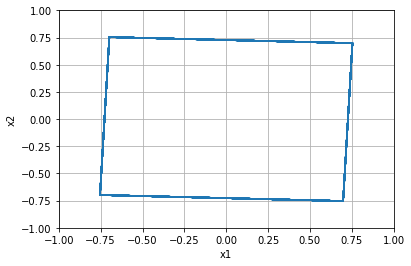


=================== Rollout 2228 =====================
x_init [[0.72]
 [0.4 ]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.72 0.4 ]
xx [0.72 0.4 ]
xxx [0.72 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.40000000000000013]


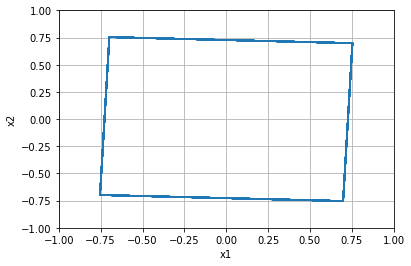


=================== Rollout 2229 =====================
x_init [[0.72]
 [0.44]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.72 0.44]
xx [0.72 0.44]
xxx [0.72 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.43999999999999995]


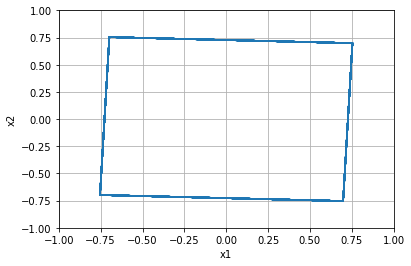


=================== Rollout 2230 =====================
x_init [[0.72]
 [0.48]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.72 0.48]
xx [0.72 0.48]
xxx [0.72 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.48]


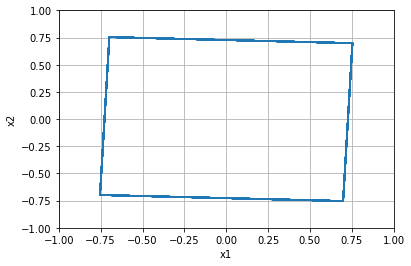


=================== Rollout 2231 =====================
x_init [[0.72]
 [0.52]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.72 0.52]
xx [0.72 0.52]
xxx [0.72 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.52]


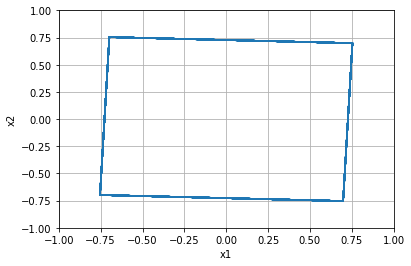


=================== Rollout 2232 =====================
x_init [[0.72]
 [0.56]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.72 0.56]
xx [0.72 0.56]
xxx [0.72 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.56]


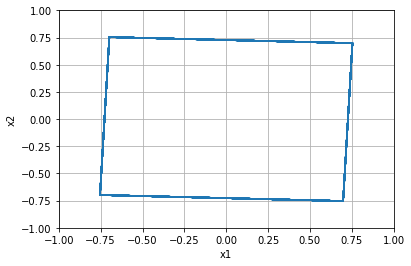


=================== Rollout 2233 =====================
x_init [[0.72]
 [0.6 ]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.72 0.6 ]
xx [0.72 0.6 ]
xxx [0.72 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.6000000000000001]


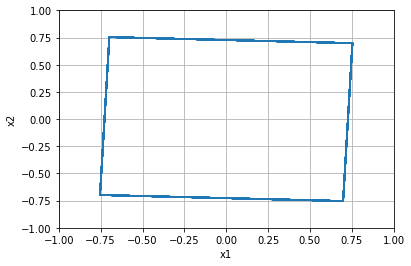


=================== Rollout 2234 =====================
x_init [[0.72]
 [0.64]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.72 0.64]
xx [0.72 0.64]
xxx [0.72 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.6400000000000001]


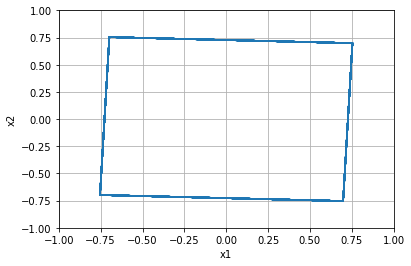


=================== Rollout 2235 =====================
x_init [[0.72]
 [0.68]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.72 0.68]
xx [0.72 0.68]
xxx [0.72 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.6799999999999999]


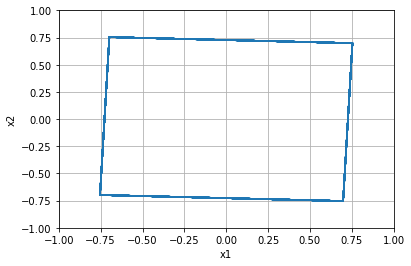


=================== Rollout 2236 =====================
x_init [[0.72]
 [0.72]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.72 0.72]
xx [0.72 0.72]
xxx [0.72 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.72]


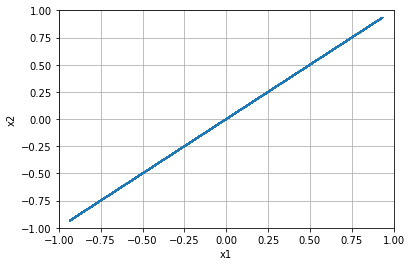


=================== Rollout 2237 =====================
x_init [[0.72]
 [0.76]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.72 0.76]
xx [0.72 0.76]
xxx [0.72 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.76]


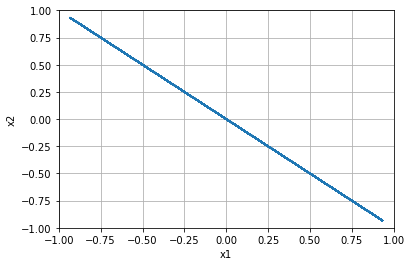


=================== Rollout 2238 =====================
x_init [[0.72]
 [0.8 ]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.72 0.8 ]
xx [0.72 0.8 ]
xxx [0.72 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.8]


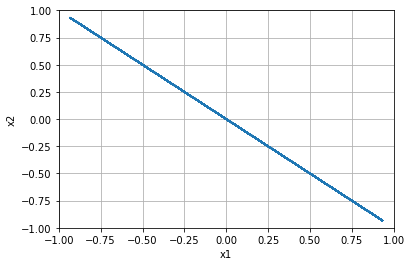


=================== Rollout 2239 =====================
x_init [[0.72]
 [0.84]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.72 0.84]
xx [0.72 0.84]
xxx [0.72 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.8400000000000001]


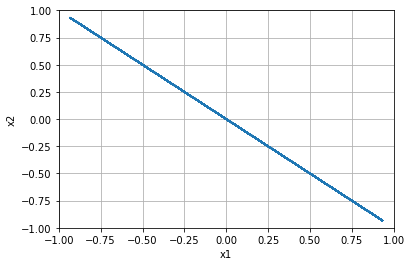


=================== Rollout 2240 =====================
x_init [[0.72]
 [0.88]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.72 0.88]
xx [0.72 0.88]
xxx [0.72 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.8800000000000001]


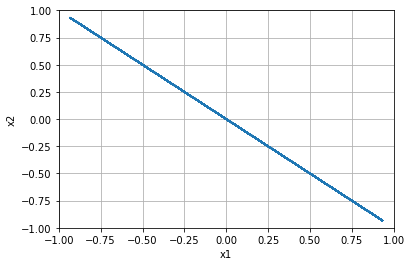


=================== Rollout 2241 =====================
x_init [[0.72]
 [0.92]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.72 0.92]
xx [0.72 0.92]
xxx [0.72 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.9199999999999999]


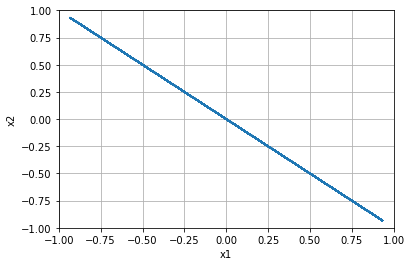


=================== Rollout 2242 =====================
x_init [[0.72]
 [0.96]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.72 0.96]
xx [0.72 0.96]
xxx [0.72 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 0.96]


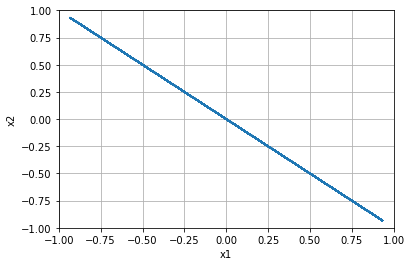


=================== Rollout 2243 =====================
x_init [[0.72]
 [1.  ]]
x_buffer [[0.72 0.72 0.72 0.72 0.72]
 [1.   1.   1.   1.   1.  ]]
x [0.72 1.  ]
xx [0.72 1.  ]
xxx [0.72 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.72, 1.0]


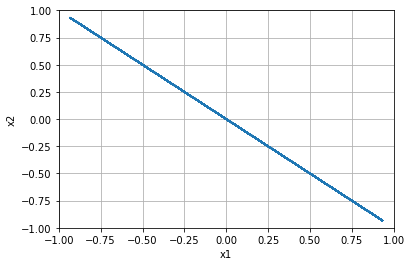


=================== Rollout 2244 =====================
x_init [[ 0.76]
 [-1.  ]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.76 -1.  ]
xx [ 0.76 -1.  ]
xxx [ 0.76 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -1.0]


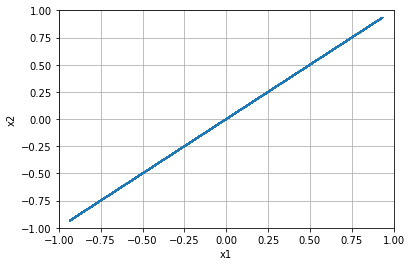


=================== Rollout 2245 =====================
x_init [[ 0.76]
 [-0.96]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.76 -0.96]
xx [ 0.76 -0.96]
xxx [ 0.76 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.96]


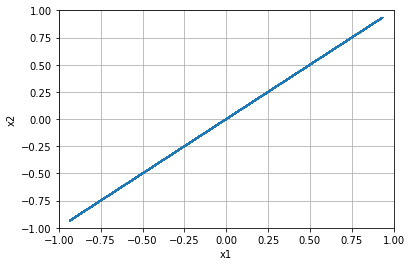


=================== Rollout 2246 =====================
x_init [[ 0.76]
 [-0.92]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.76 -0.92]
xx [ 0.76 -0.92]
xxx [ 0.76 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.92]


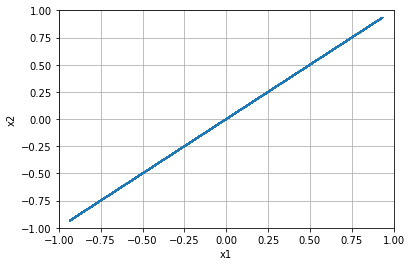


=================== Rollout 2247 =====================
x_init [[ 0.76]
 [-0.88]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.76 -0.88]
xx [ 0.76 -0.88]
xxx [ 0.76 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.88]


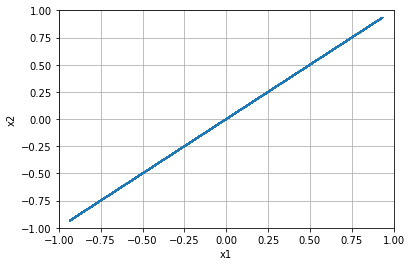


=================== Rollout 2248 =====================
x_init [[ 0.76]
 [-0.84]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.76 -0.84]
xx [ 0.76 -0.84]
xxx [ 0.76 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.84]


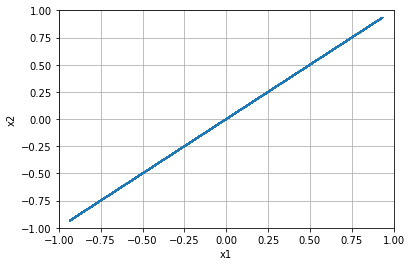


=================== Rollout 2249 =====================
x_init [[ 0.76]
 [-0.8 ]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.76 -0.8 ]
xx [ 0.76 -0.8 ]
xxx [ 0.76 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.8]


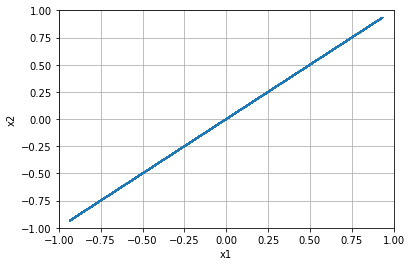


=================== Rollout 2250 =====================
x_init [[ 0.76]
 [-0.76]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.76 -0.76]
xx [ 0.76 -0.76]
xxx [ 0.76 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.76]


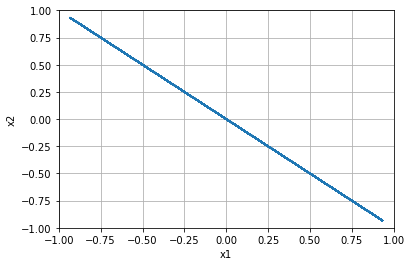


=================== Rollout 2251 =====================
x_init [[ 0.76]
 [-0.72]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.76 -0.72]
xx [ 0.76 -0.72]
xxx [ 0.76 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.72]


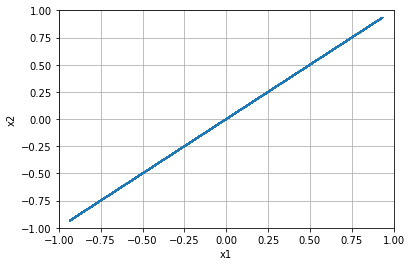


=================== Rollout 2252 =====================
x_init [[ 0.76]
 [-0.68]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.76 -0.68]
xx [ 0.76 -0.68]
xxx [ 0.76 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.6799999999999999]


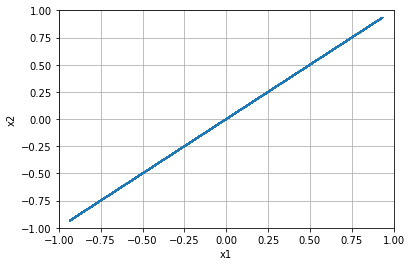


=================== Rollout 2253 =====================
x_init [[ 0.76]
 [-0.64]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.76 -0.64]
xx [ 0.76 -0.64]
xxx [ 0.76 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.64]


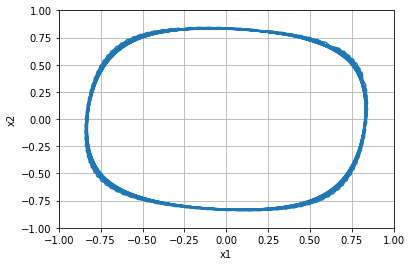


=================== Rollout 2254 =====================
x_init [[ 0.76]
 [-0.6 ]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.76 -0.6 ]
xx [ 0.76 -0.6 ]
xxx [ 0.76 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.6]


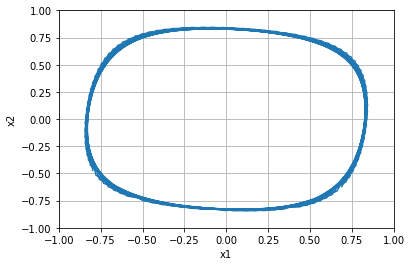


=================== Rollout 2255 =====================
x_init [[ 0.76]
 [-0.56]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.76 -0.56]
xx [ 0.76 -0.56]
xxx [ 0.76 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.56]


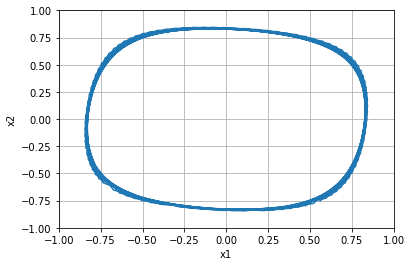


=================== Rollout 2256 =====================
x_init [[ 0.76]
 [-0.52]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.76 -0.52]
xx [ 0.76 -0.52]
xxx [ 0.76 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.52]


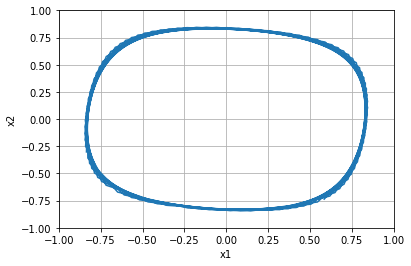


=================== Rollout 2257 =====================
x_init [[ 0.76]
 [-0.48]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.76 -0.48]
xx [ 0.76 -0.48]
xxx [ 0.76 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.48]


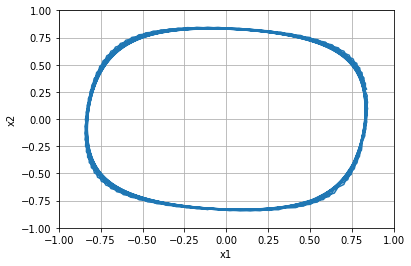


=================== Rollout 2258 =====================
x_init [[ 0.76]
 [-0.44]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.76 -0.44]
xx [ 0.76 -0.44]
xxx [ 0.76 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.43999999999999995]


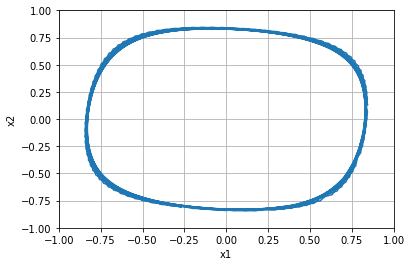


=================== Rollout 2259 =====================
x_init [[ 0.76]
 [-0.4 ]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.76 -0.4 ]
xx [ 0.76 -0.4 ]
xxx [ 0.76 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.4]


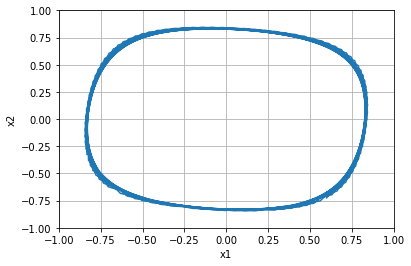


=================== Rollout 2260 =====================
x_init [[ 0.76]
 [-0.36]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.76 -0.36]
xx [ 0.76 -0.36]
xxx [ 0.76 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.36]


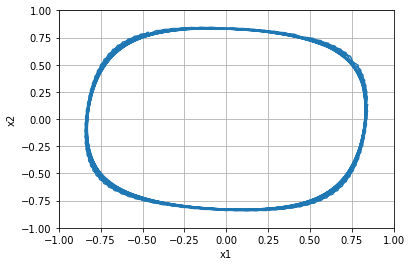


=================== Rollout 2261 =====================
x_init [[ 0.76]
 [-0.32]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.76 -0.32]
xx [ 0.76 -0.32]
xxx [ 0.76 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.31999999999999995]


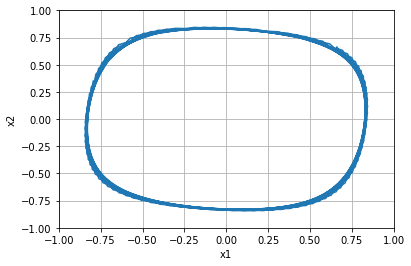


=================== Rollout 2262 =====================
x_init [[ 0.76]
 [-0.28]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.76 -0.28]
xx [ 0.76 -0.28]
xxx [ 0.76 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.28]


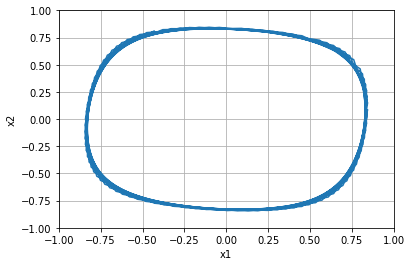


=================== Rollout 2263 =====================
x_init [[ 0.76]
 [-0.24]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.76 -0.24]
xx [ 0.76 -0.24]
xxx [ 0.76 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.24]


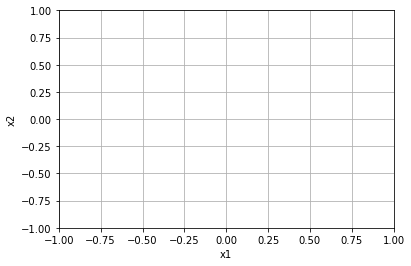


=================== Rollout 2264 =====================
x_init [[ 0.76]
 [-0.2 ]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.76 -0.2 ]
xx [ 0.76 -0.2 ]
xxx [ 0.76 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.19999999999999996]


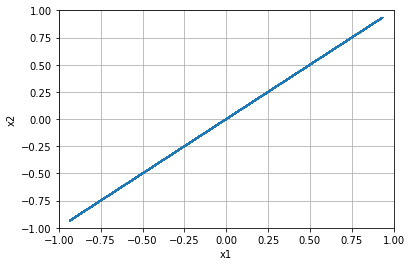


=================== Rollout 2265 =====================
x_init [[ 0.76]
 [-0.16]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.76 -0.16]
xx [ 0.76 -0.16]
xxx [ 0.76 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.16000000000000003]


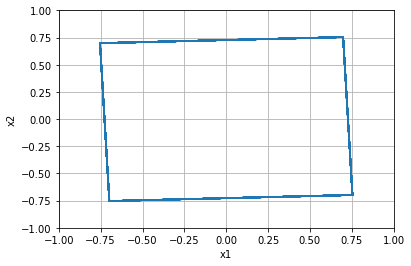


=================== Rollout 2266 =====================
x_init [[ 0.76]
 [-0.12]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.76 -0.12]
xx [ 0.76 -0.12]
xxx [ 0.76 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.12]


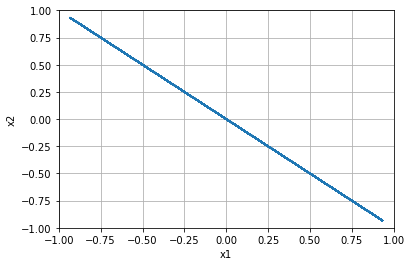


=================== Rollout 2267 =====================
x_init [[ 0.76]
 [-0.08]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.76 -0.08]
xx [ 0.76 -0.08]
xxx [ 0.76 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.07999999999999996]


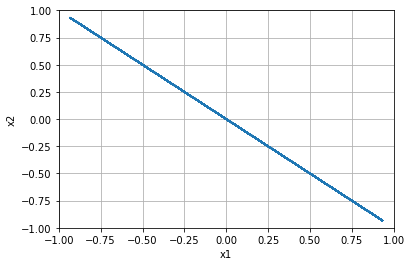


=================== Rollout 2268 =====================
x_init [[ 0.76]
 [-0.04]]
x_buffer [[ 0.76  0.76  0.76  0.76  0.76]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.76 -0.04]
xx [ 0.76 -0.04]
xxx [ 0.76 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, -0.040000000000000036]


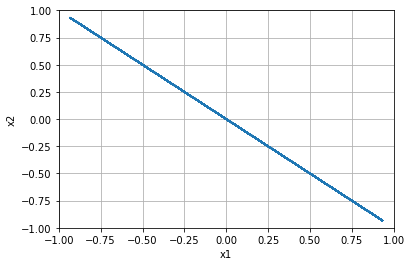


=================== Rollout 2269 =====================
x_init [[0.76]
 [0.  ]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.   0.   0.   0.   0.  ]]
x [0.76 0.  ]
xx [0.76 0.  ]
xxx [0.76 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.0]


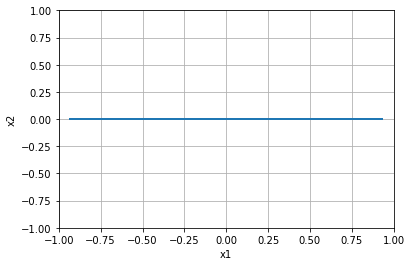


=================== Rollout 2270 =====================
x_init [[0.76]
 [0.04]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.76 0.04]
xx [0.76 0.04]
xxx [0.76 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.040000000000000036]


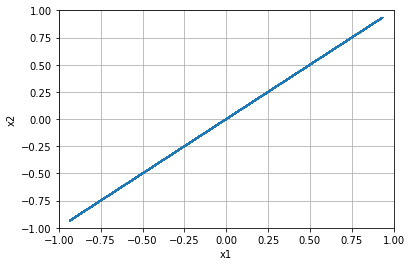


=================== Rollout 2271 =====================
x_init [[0.76]
 [0.08]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.76 0.08]
xx [0.76 0.08]
xxx [0.76 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.08000000000000007]


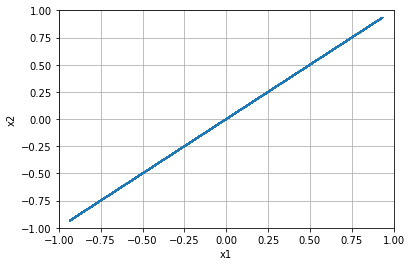


=================== Rollout 2272 =====================
x_init [[0.76]
 [0.12]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.76 0.12]
xx [0.76 0.12]
xxx [0.76 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.1200000000000001]


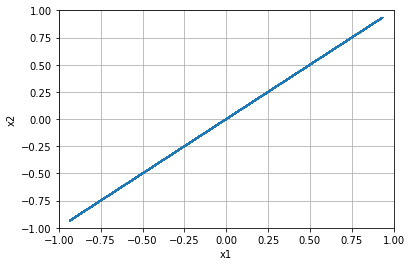


=================== Rollout 2273 =====================
x_init [[0.76]
 [0.16]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.76 0.16]
xx [0.76 0.16]
xxx [0.76 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.15999999999999992]


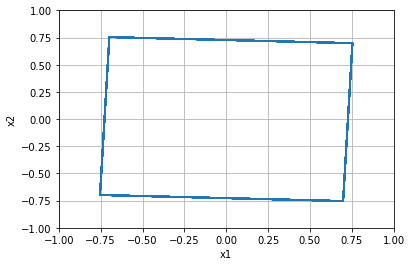


=================== Rollout 2274 =====================
x_init [[0.76]
 [0.2 ]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.76 0.2 ]
xx [0.76 0.2 ]
xxx [0.76 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.19999999999999996]


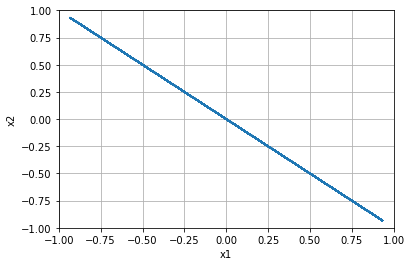


=================== Rollout 2275 =====================
x_init [[0.76]
 [0.24]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.76 0.24]
xx [0.76 0.24]
xxx [0.76 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.24]


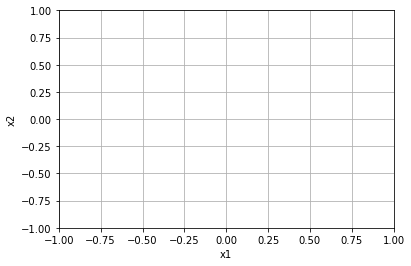


=================== Rollout 2276 =====================
x_init [[0.76]
 [0.28]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.76 0.28]
xx [0.76 0.28]
xxx [0.76 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.28]


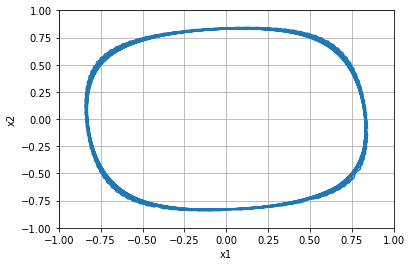


=================== Rollout 2277 =====================
x_init [[0.76]
 [0.32]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.76 0.32]
xx [0.76 0.32]
xxx [0.76 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.32000000000000006]


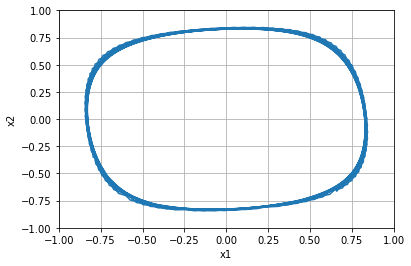


=================== Rollout 2278 =====================
x_init [[0.76]
 [0.36]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.76 0.36]
xx [0.76 0.36]
xxx [0.76 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.3600000000000001]


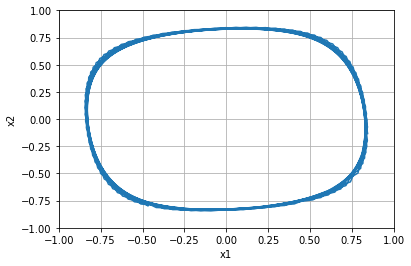


=================== Rollout 2279 =====================
x_init [[0.76]
 [0.4 ]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.76 0.4 ]
xx [0.76 0.4 ]
xxx [0.76 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.40000000000000013]


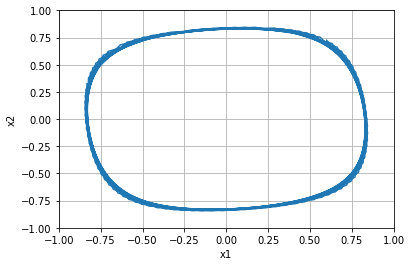


=================== Rollout 2280 =====================
x_init [[0.76]
 [0.44]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.76 0.44]
xx [0.76 0.44]
xxx [0.76 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.43999999999999995]


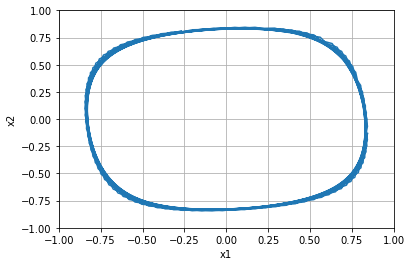


=================== Rollout 2281 =====================
x_init [[0.76]
 [0.48]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.76 0.48]
xx [0.76 0.48]
xxx [0.76 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.48]


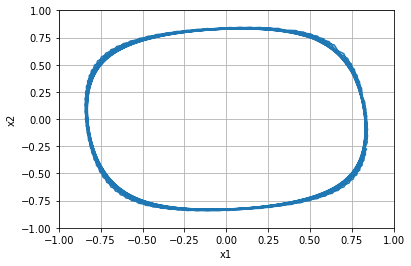


=================== Rollout 2282 =====================
x_init [[0.76]
 [0.52]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.76 0.52]
xx [0.76 0.52]
xxx [0.76 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.52]


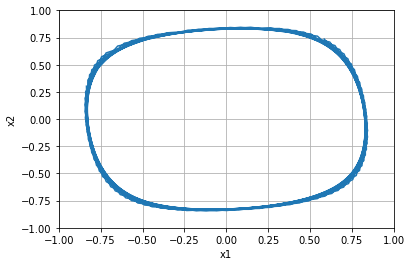


=================== Rollout 2283 =====================
x_init [[0.76]
 [0.56]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.76 0.56]
xx [0.76 0.56]
xxx [0.76 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.56]


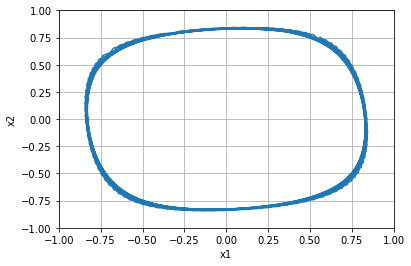


=================== Rollout 2284 =====================
x_init [[0.76]
 [0.6 ]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.76 0.6 ]
xx [0.76 0.6 ]
xxx [0.76 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.6000000000000001]


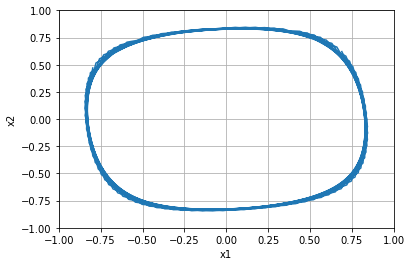


=================== Rollout 2285 =====================
x_init [[0.76]
 [0.64]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.76 0.64]
xx [0.76 0.64]
xxx [0.76 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.6400000000000001]


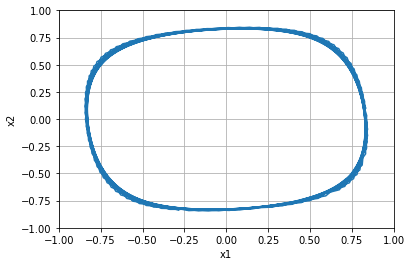


=================== Rollout 2286 =====================
x_init [[0.76]
 [0.68]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.76 0.68]
xx [0.76 0.68]
xxx [0.76 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.6799999999999999]


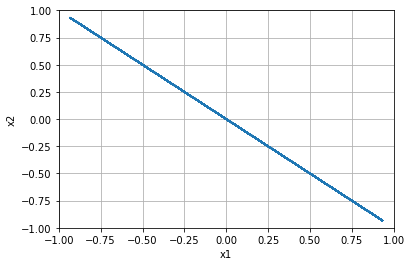


=================== Rollout 2287 =====================
x_init [[0.76]
 [0.72]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.76 0.72]
xx [0.76 0.72]
xxx [0.76 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.72]


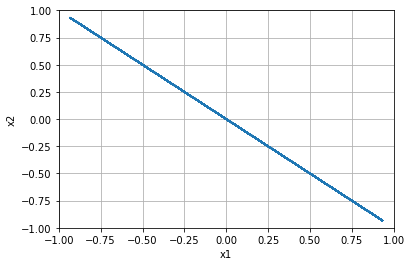


=================== Rollout 2288 =====================
x_init [[0.76]
 [0.76]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.76 0.76]
xx [0.76 0.76]
xxx [0.76 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.76]


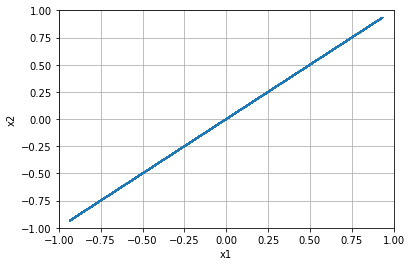


=================== Rollout 2289 =====================
x_init [[0.76]
 [0.8 ]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.76 0.8 ]
xx [0.76 0.8 ]
xxx [0.76 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.8]


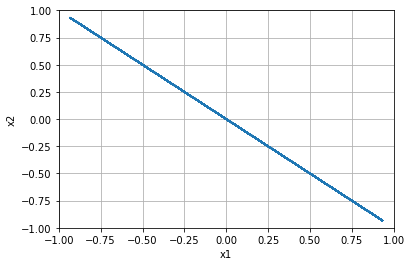


=================== Rollout 2290 =====================
x_init [[0.76]
 [0.84]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.76 0.84]
xx [0.76 0.84]
xxx [0.76 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.8400000000000001]


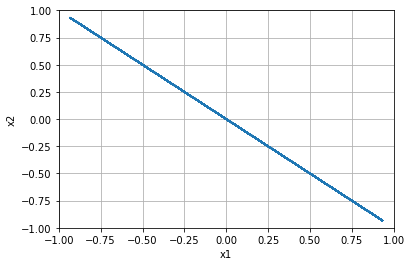


=================== Rollout 2291 =====================
x_init [[0.76]
 [0.88]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.76 0.88]
xx [0.76 0.88]
xxx [0.76 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.8800000000000001]


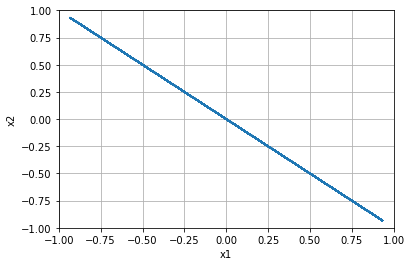


=================== Rollout 2292 =====================
x_init [[0.76]
 [0.92]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.76 0.92]
xx [0.76 0.92]
xxx [0.76 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.9199999999999999]


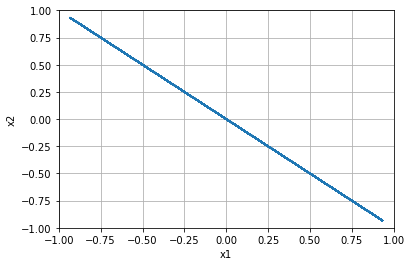


=================== Rollout 2293 =====================
x_init [[0.76]
 [0.96]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.76 0.96]
xx [0.76 0.96]
xxx [0.76 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 0.96]


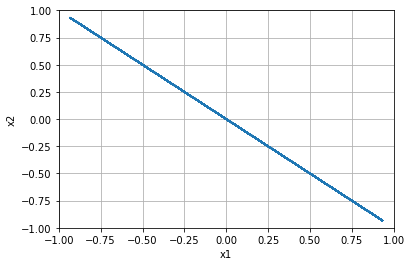


=================== Rollout 2294 =====================
x_init [[0.76]
 [1.  ]]
x_buffer [[0.76 0.76 0.76 0.76 0.76]
 [1.   1.   1.   1.   1.  ]]
x [0.76 1.  ]
xx [0.76 1.  ]
xxx [0.76 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.76, 1.0]


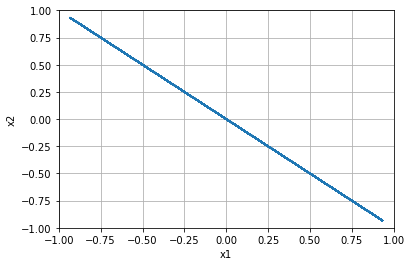


=================== Rollout 2295 =====================
x_init [[ 0.8]
 [-1. ]]
x_buffer [[ 0.8  0.8  0.8  0.8  0.8]
 [-1.  -1.  -1.  -1.  -1. ]]
x [ 0.8 -1. ]
xx [ 0.8 -1. ]
xxx [ 0.8 -1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -1.0]


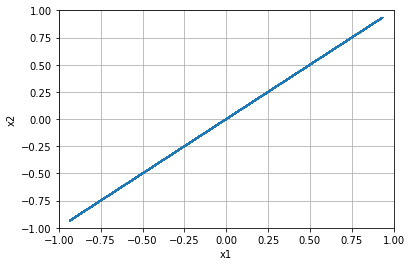


=================== Rollout 2296 =====================
x_init [[ 0.8 ]
 [-0.96]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.8  -0.96]
xx [ 0.8  -0.96]
xxx [ 0.8  -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.96]


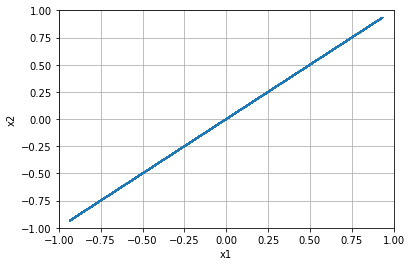


=================== Rollout 2297 =====================
x_init [[ 0.8 ]
 [-0.92]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.8  -0.92]
xx [ 0.8  -0.92]
xxx [ 0.8  -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.92]


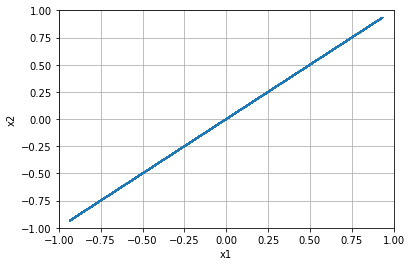


=================== Rollout 2298 =====================
x_init [[ 0.8 ]
 [-0.88]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.8  -0.88]
xx [ 0.8  -0.88]
xxx [ 0.8  -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.88]


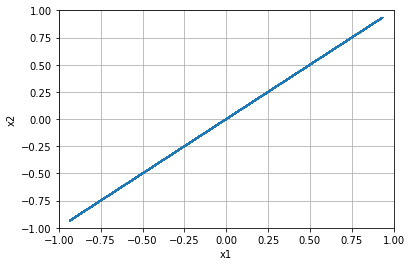


=================== Rollout 2299 =====================
x_init [[ 0.8 ]
 [-0.84]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.8  -0.84]
xx [ 0.8  -0.84]
xxx [ 0.8  -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.84]


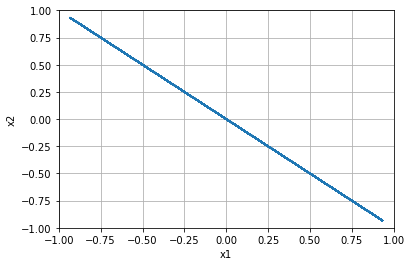


=================== Rollout 2300 =====================
x_init [[ 0.8]
 [-0.8]]
x_buffer [[ 0.8  0.8  0.8  0.8  0.8]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [ 0.8 -0.8]
xx [ 0.8 -0.8]
xxx [ 0.8 -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.8]


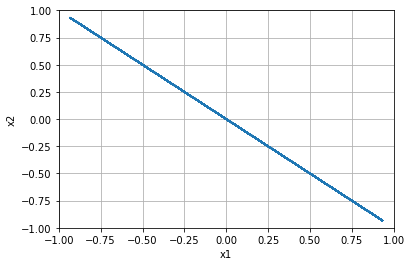


=================== Rollout 2301 =====================
x_init [[ 0.8 ]
 [-0.76]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.8  -0.76]
xx [ 0.8  -0.76]
xxx [ 0.8  -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.76]


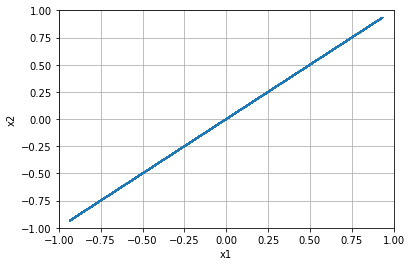


=================== Rollout 2302 =====================
x_init [[ 0.8 ]
 [-0.72]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.8  -0.72]
xx [ 0.8  -0.72]
xxx [ 0.8  -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.72]


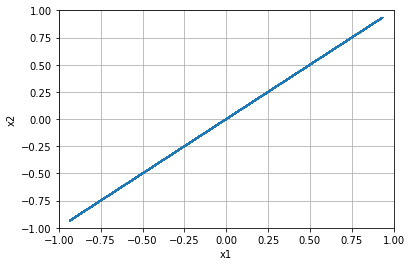


=================== Rollout 2303 =====================
x_init [[ 0.8 ]
 [-0.68]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.8  -0.68]
xx [ 0.8  -0.68]
xxx [ 0.8  -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.6799999999999999]


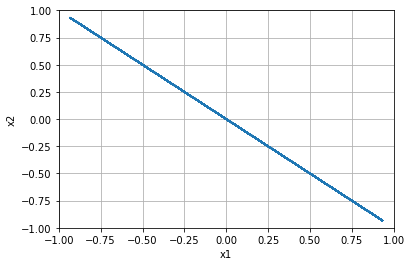


=================== Rollout 2304 =====================
x_init [[ 0.8 ]
 [-0.64]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.8  -0.64]
xx [ 0.8  -0.64]
xxx [ 0.8  -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.64]


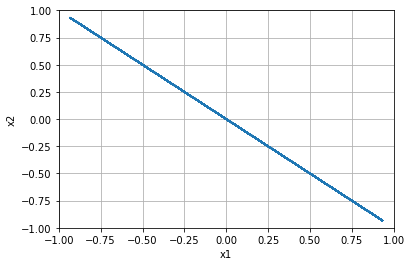


=================== Rollout 2305 =====================
x_init [[ 0.8]
 [-0.6]]
x_buffer [[ 0.8  0.8  0.8  0.8  0.8]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [ 0.8 -0.6]
xx [ 0.8 -0.6]
xxx [ 0.8 -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.6]


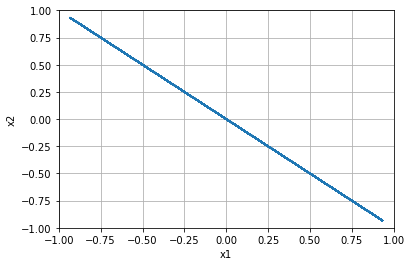


=================== Rollout 2306 =====================
x_init [[ 0.8 ]
 [-0.56]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.8  -0.56]
xx [ 0.8  -0.56]
xxx [ 0.8  -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.56]


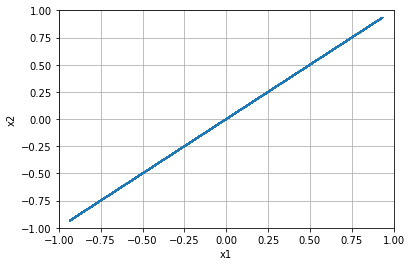


=================== Rollout 2307 =====================
x_init [[ 0.8 ]
 [-0.52]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.8  -0.52]
xx [ 0.8  -0.52]
xxx [ 0.8  -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.52]


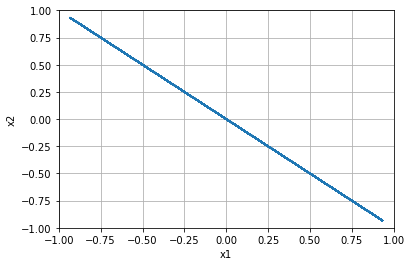


=================== Rollout 2308 =====================
x_init [[ 0.8 ]
 [-0.48]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.8  -0.48]
xx [ 0.8  -0.48]
xxx [ 0.8  -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.48]


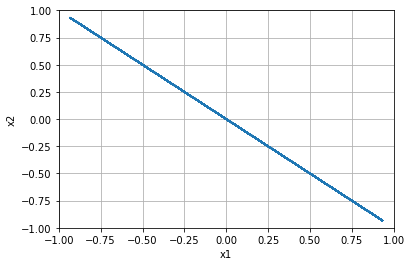


=================== Rollout 2309 =====================
x_init [[ 0.8 ]
 [-0.44]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.8  -0.44]
xx [ 0.8  -0.44]
xxx [ 0.8  -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.43999999999999995]


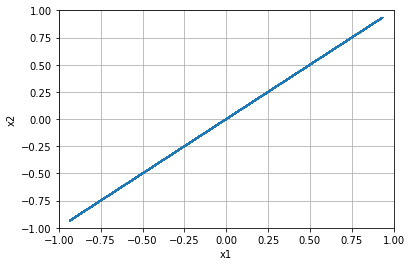


=================== Rollout 2310 =====================
x_init [[ 0.8]
 [-0.4]]
x_buffer [[ 0.8  0.8  0.8  0.8  0.8]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [ 0.8 -0.4]
xx [ 0.8 -0.4]
xxx [ 0.8 -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.4]


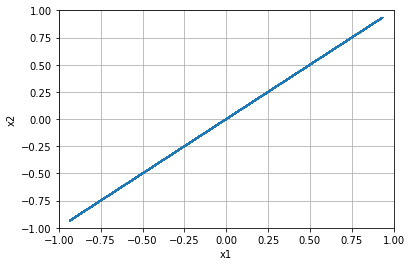


=================== Rollout 2311 =====================
x_init [[ 0.8 ]
 [-0.36]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.8  -0.36]
xx [ 0.8  -0.36]
xxx [ 0.8  -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.36]


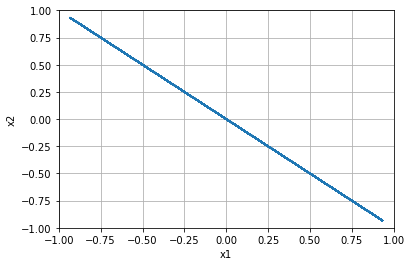


=================== Rollout 2312 =====================
x_init [[ 0.8 ]
 [-0.32]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.8  -0.32]
xx [ 0.8  -0.32]
xxx [ 0.8  -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.31999999999999995]


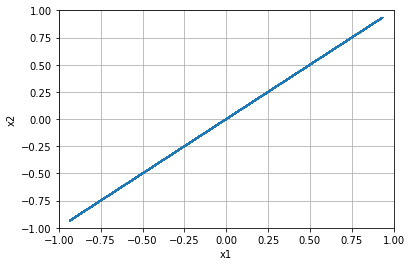


=================== Rollout 2313 =====================
x_init [[ 0.8 ]
 [-0.28]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.8  -0.28]
xx [ 0.8  -0.28]
xxx [ 0.8  -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.28]


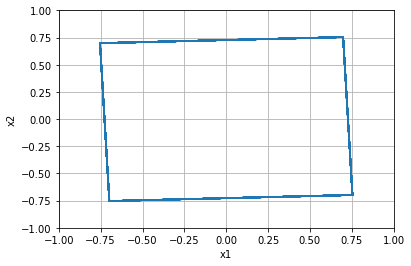


=================== Rollout 2314 =====================
x_init [[ 0.8 ]
 [-0.24]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.8  -0.24]
xx [ 0.8  -0.24]
xxx [ 0.8  -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.24]


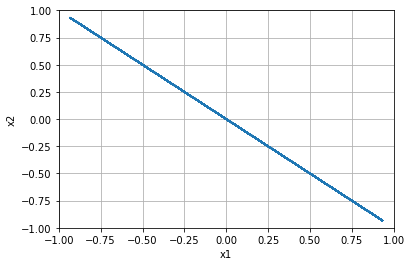


=================== Rollout 2315 =====================
x_init [[ 0.8]
 [-0.2]]
x_buffer [[ 0.8  0.8  0.8  0.8  0.8]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [ 0.8 -0.2]
xx [ 0.8 -0.2]
xxx [ 0.8 -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.19999999999999996]


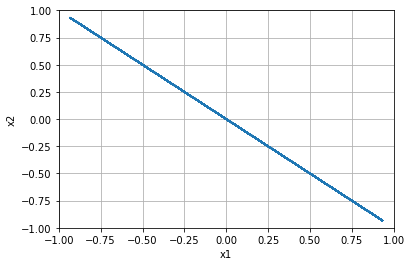


=================== Rollout 2316 =====================
x_init [[ 0.8 ]
 [-0.16]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.8  -0.16]
xx [ 0.8  -0.16]
xxx [ 0.8  -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.16000000000000003]


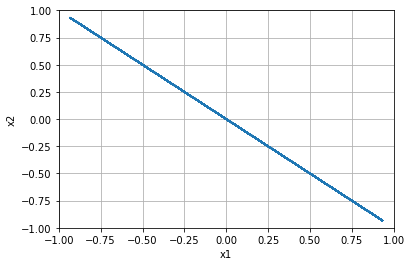


=================== Rollout 2317 =====================
x_init [[ 0.8 ]
 [-0.12]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.8  -0.12]
xx [ 0.8  -0.12]
xxx [ 0.8  -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.12]


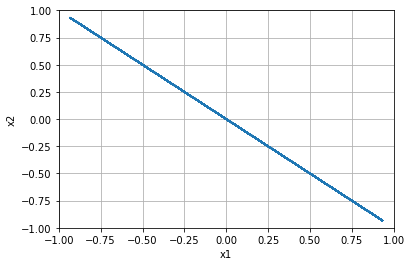


=================== Rollout 2318 =====================
x_init [[ 0.8 ]
 [-0.08]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.8  -0.08]
xx [ 0.8  -0.08]
xxx [ 0.8  -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.07999999999999996]


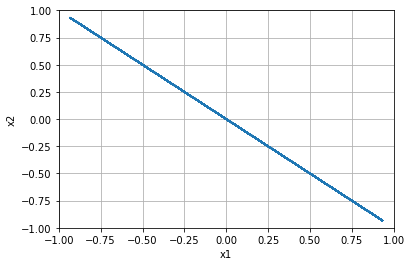


=================== Rollout 2319 =====================
x_init [[ 0.8 ]
 [-0.04]]
x_buffer [[ 0.8   0.8   0.8   0.8   0.8 ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.8  -0.04]
xx [ 0.8  -0.04]
xxx [ 0.8  -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, -0.040000000000000036]


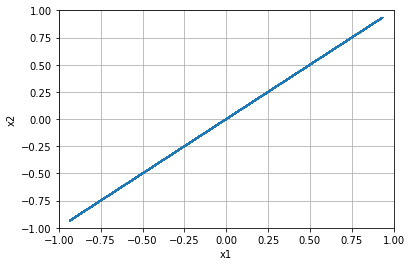


=================== Rollout 2320 =====================
x_init [[0.8]
 [0. ]]
x_buffer [[0.8 0.8 0.8 0.8 0.8]
 [0.  0.  0.  0.  0. ]]
x [0.8 0. ]
xx [0.8 0. ]
xxx [0.8 0. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.0]


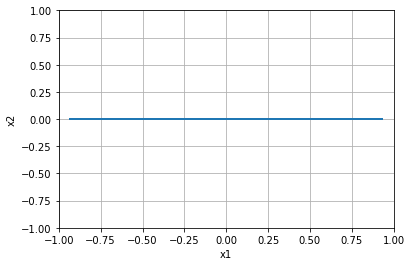


=================== Rollout 2321 =====================
x_init [[0.8 ]
 [0.04]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.8  0.04]
xx [0.8  0.04]
xxx [0.8  0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.040000000000000036]


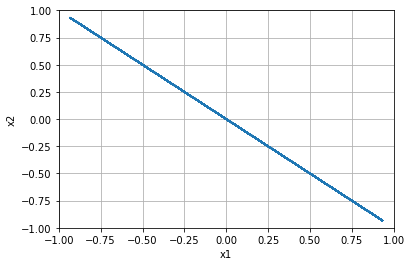


=================== Rollout 2322 =====================
x_init [[0.8 ]
 [0.08]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.8  0.08]
xx [0.8  0.08]
xxx [0.8  0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.08000000000000007]


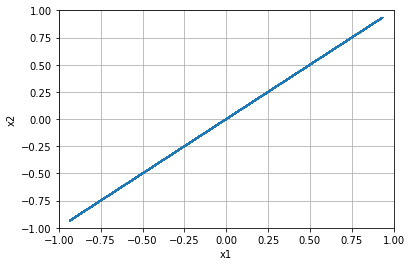


=================== Rollout 2323 =====================
x_init [[0.8 ]
 [0.12]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.8  0.12]
xx [0.8  0.12]
xxx [0.8  0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.1200000000000001]


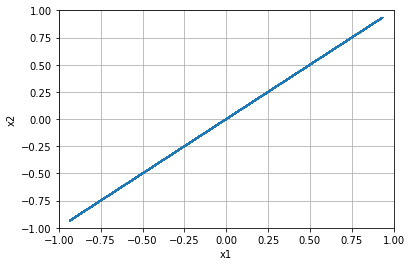


=================== Rollout 2324 =====================
x_init [[0.8 ]
 [0.16]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.8  0.16]
xx [0.8  0.16]
xxx [0.8  0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.15999999999999992]


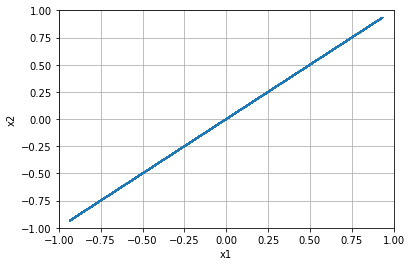


=================== Rollout 2325 =====================
x_init [[0.8]
 [0.2]]
x_buffer [[0.8 0.8 0.8 0.8 0.8]
 [0.2 0.2 0.2 0.2 0.2]]
x [0.8 0.2]
xx [0.8 0.2]
xxx [0.8 0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.19999999999999996]


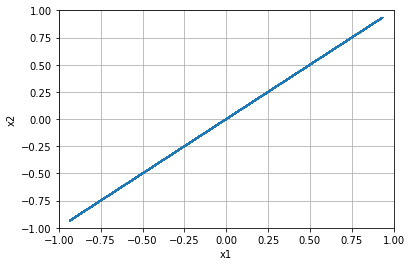


=================== Rollout 2326 =====================
x_init [[0.8 ]
 [0.24]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.8  0.24]
xx [0.8  0.24]
xxx [0.8  0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.24]


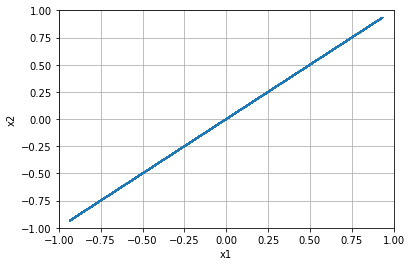


=================== Rollout 2327 =====================
x_init [[0.8 ]
 [0.28]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.8  0.28]
xx [0.8  0.28]
xxx [0.8  0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.28]


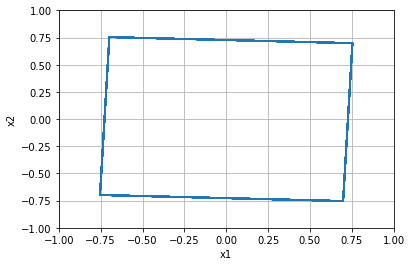


=================== Rollout 2328 =====================
x_init [[0.8 ]
 [0.32]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.8  0.32]
xx [0.8  0.32]
xxx [0.8  0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.32000000000000006]


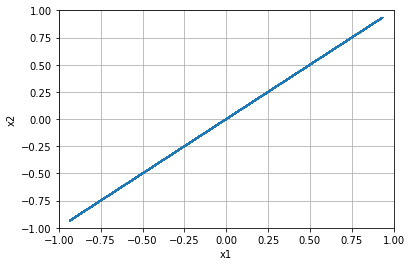


=================== Rollout 2329 =====================
x_init [[0.8 ]
 [0.36]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.8  0.36]
xx [0.8  0.36]
xxx [0.8  0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.3600000000000001]


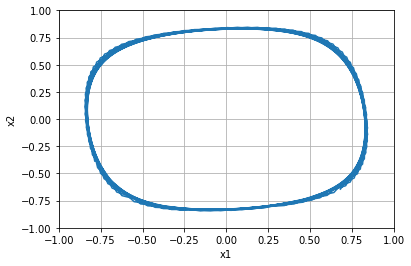


=================== Rollout 2330 =====================
x_init [[0.8]
 [0.4]]
x_buffer [[0.8 0.8 0.8 0.8 0.8]
 [0.4 0.4 0.4 0.4 0.4]]
x [0.8 0.4]
xx [0.8 0.4]
xxx [0.8 0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.40000000000000013]


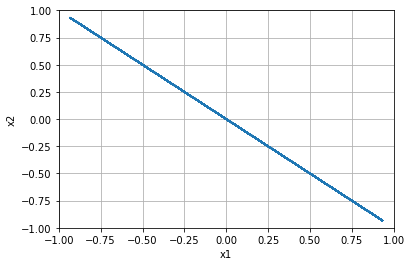


=================== Rollout 2331 =====================
x_init [[0.8 ]
 [0.44]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.8  0.44]
xx [0.8  0.44]
xxx [0.8  0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.43999999999999995]


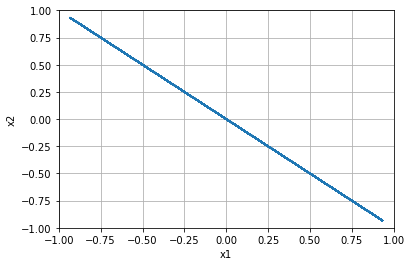


=================== Rollout 2332 =====================
x_init [[0.8 ]
 [0.48]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.8  0.48]
xx [0.8  0.48]
xxx [0.8  0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.48]


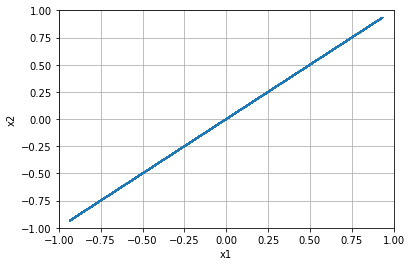


=================== Rollout 2333 =====================
x_init [[0.8 ]
 [0.52]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.8  0.52]
xx [0.8  0.52]
xxx [0.8  0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.52]


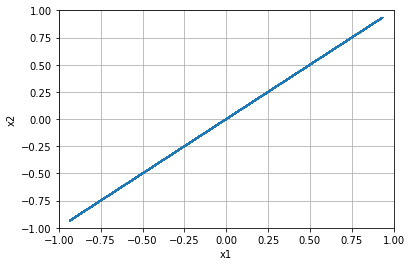


=================== Rollout 2334 =====================
x_init [[0.8 ]
 [0.56]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.8  0.56]
xx [0.8  0.56]
xxx [0.8  0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.56]


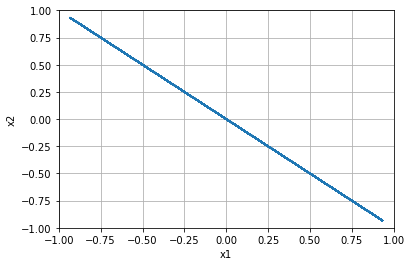


=================== Rollout 2335 =====================
x_init [[0.8]
 [0.6]]
x_buffer [[0.8 0.8 0.8 0.8 0.8]
 [0.6 0.6 0.6 0.6 0.6]]
x [0.8 0.6]
xx [0.8 0.6]
xxx [0.8 0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.6000000000000001]


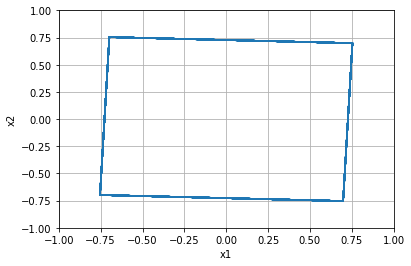


=================== Rollout 2336 =====================
x_init [[0.8 ]
 [0.64]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.8  0.64]
xx [0.8  0.64]
xxx [0.8  0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.6400000000000001]


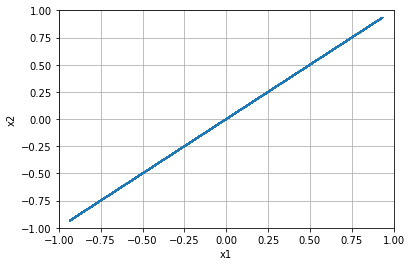


=================== Rollout 2337 =====================
x_init [[0.8 ]
 [0.68]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.8  0.68]
xx [0.8  0.68]
xxx [0.8  0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.6799999999999999]


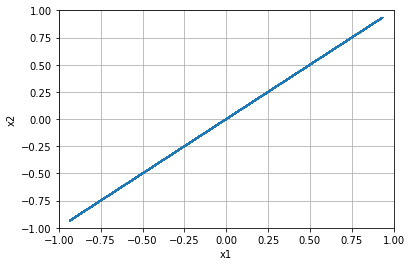


=================== Rollout 2338 =====================
x_init [[0.8 ]
 [0.72]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.8  0.72]
xx [0.8  0.72]
xxx [0.8  0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.72]


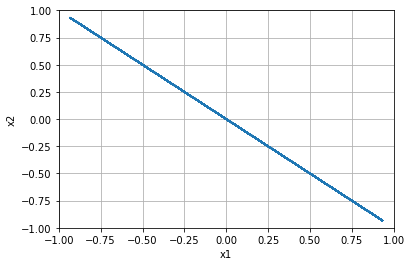


=================== Rollout 2339 =====================
x_init [[0.8 ]
 [0.76]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.8  0.76]
xx [0.8  0.76]
xxx [0.8  0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.76]


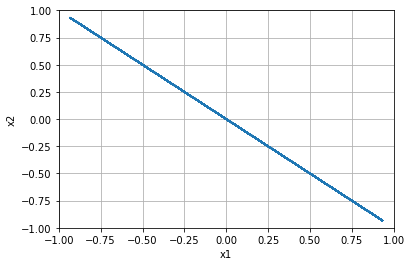


=================== Rollout 2340 =====================
x_init [[0.8]
 [0.8]]
x_buffer [[0.8 0.8 0.8 0.8 0.8]
 [0.8 0.8 0.8 0.8 0.8]]
x [0.8 0.8]
xx [0.8 0.8]
xxx [0.8 0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.8]


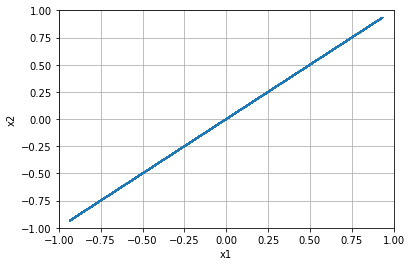


=================== Rollout 2341 =====================
x_init [[0.8 ]
 [0.84]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.8  0.84]
xx [0.8  0.84]
xxx [0.8  0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.8400000000000001]


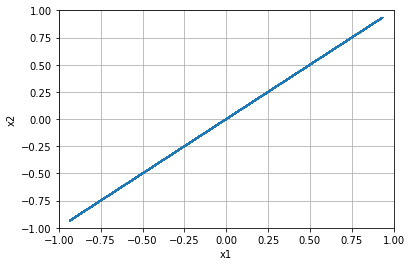


=================== Rollout 2342 =====================
x_init [[0.8 ]
 [0.88]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.8  0.88]
xx [0.8  0.88]
xxx [0.8  0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.8800000000000001]


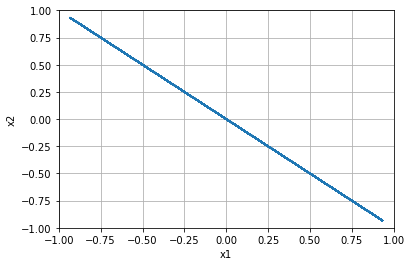


=================== Rollout 2343 =====================
x_init [[0.8 ]
 [0.92]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.8  0.92]
xx [0.8  0.92]
xxx [0.8  0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.9199999999999999]


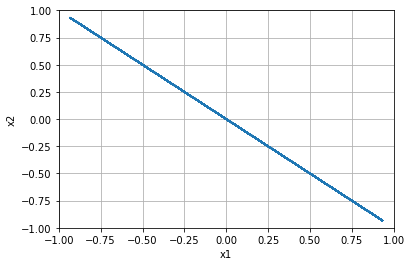


=================== Rollout 2344 =====================
x_init [[0.8 ]
 [0.96]]
x_buffer [[0.8  0.8  0.8  0.8  0.8 ]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.8  0.96]
xx [0.8  0.96]
xxx [0.8  0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 0.96]


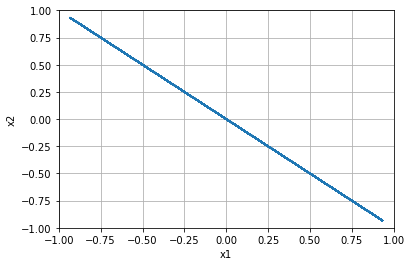


=================== Rollout 2345 =====================
x_init [[0.8]
 [1. ]]
x_buffer [[0.8 0.8 0.8 0.8 0.8]
 [1.  1.  1.  1.  1. ]]
x [0.8 1. ]
xx [0.8 1. ]
xxx [0.8 1. ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8, 1.0]


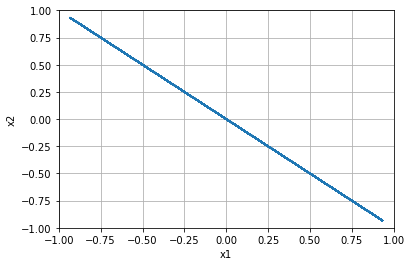


=================== Rollout 2346 =====================
x_init [[ 0.84]
 [-1.  ]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.84 -1.  ]
xx [ 0.84 -1.  ]
xxx [ 0.84 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -1.0]


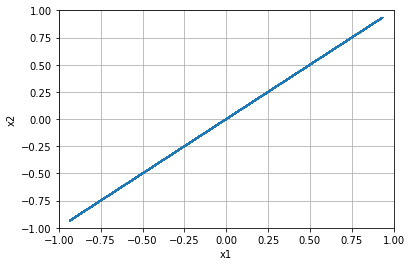


=================== Rollout 2347 =====================
x_init [[ 0.84]
 [-0.96]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.84 -0.96]
xx [ 0.84 -0.96]
xxx [ 0.84 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.96]


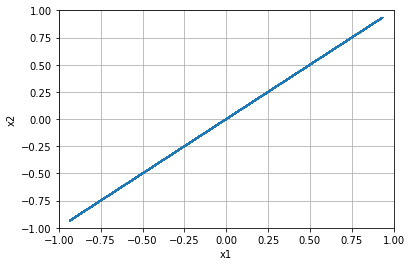


=================== Rollout 2348 =====================
x_init [[ 0.84]
 [-0.92]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.84 -0.92]
xx [ 0.84 -0.92]
xxx [ 0.84 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.92]


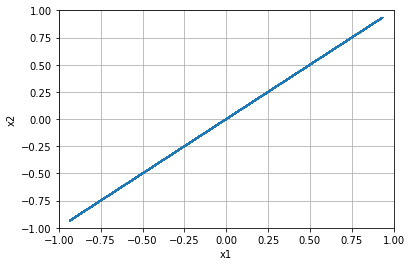


=================== Rollout 2349 =====================
x_init [[ 0.84]
 [-0.88]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.84 -0.88]
xx [ 0.84 -0.88]
xxx [ 0.84 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.88]


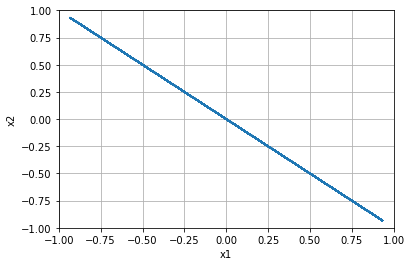


=================== Rollout 2350 =====================
x_init [[ 0.84]
 [-0.84]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.84 -0.84]
xx [ 0.84 -0.84]
xxx [ 0.84 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.84]


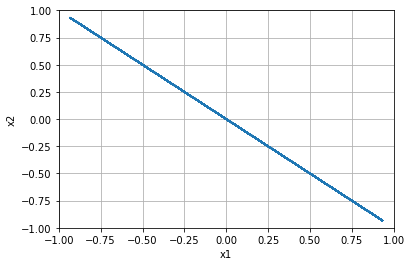


=================== Rollout 2351 =====================
x_init [[ 0.84]
 [-0.8 ]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.84 -0.8 ]
xx [ 0.84 -0.8 ]
xxx [ 0.84 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.8]


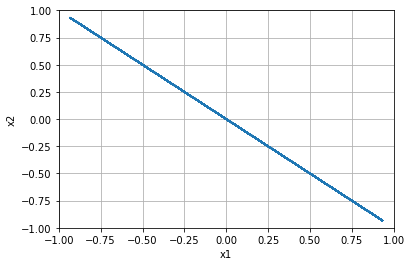


=================== Rollout 2352 =====================
x_init [[ 0.84]
 [-0.76]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.84 -0.76]
xx [ 0.84 -0.76]
xxx [ 0.84 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.76]


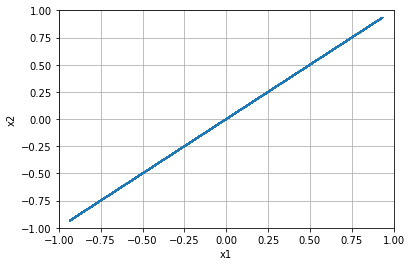


=================== Rollout 2353 =====================
x_init [[ 0.84]
 [-0.72]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.84 -0.72]
xx [ 0.84 -0.72]
xxx [ 0.84 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.72]


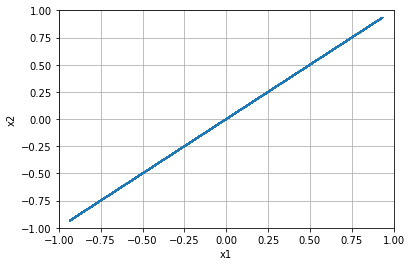


=================== Rollout 2354 =====================
x_init [[ 0.84]
 [-0.68]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.84 -0.68]
xx [ 0.84 -0.68]
xxx [ 0.84 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.6799999999999999]


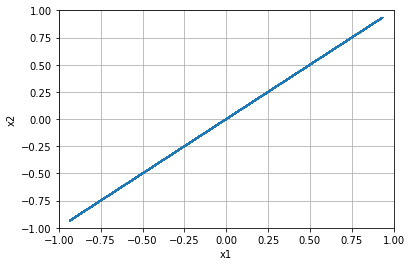


=================== Rollout 2355 =====================
x_init [[ 0.84]
 [-0.64]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.84 -0.64]
xx [ 0.84 -0.64]
xxx [ 0.84 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.64]


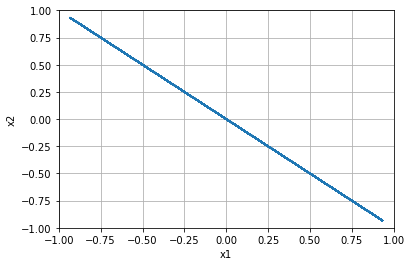


=================== Rollout 2356 =====================
x_init [[ 0.84]
 [-0.6 ]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.84 -0.6 ]
xx [ 0.84 -0.6 ]
xxx [ 0.84 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.6]


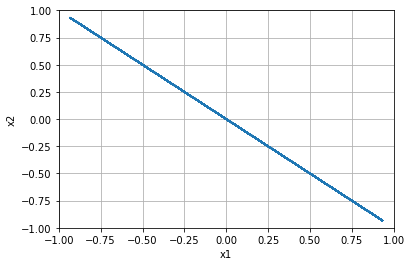


=================== Rollout 2357 =====================
x_init [[ 0.84]
 [-0.56]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.84 -0.56]
xx [ 0.84 -0.56]
xxx [ 0.84 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.56]


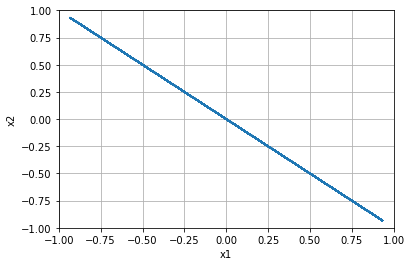


=================== Rollout 2358 =====================
x_init [[ 0.84]
 [-0.52]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.84 -0.52]
xx [ 0.84 -0.52]
xxx [ 0.84 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.52]


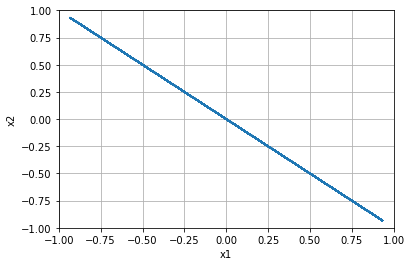


=================== Rollout 2359 =====================
x_init [[ 0.84]
 [-0.48]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.84 -0.48]
xx [ 0.84 -0.48]
xxx [ 0.84 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.48]


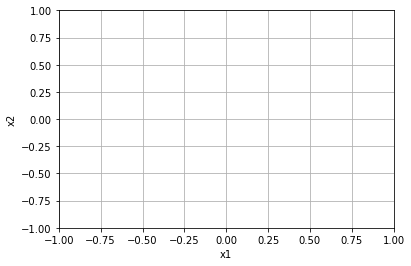


=================== Rollout 2360 =====================
x_init [[ 0.84]
 [-0.44]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.84 -0.44]
xx [ 0.84 -0.44]
xxx [ 0.84 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.43999999999999995]


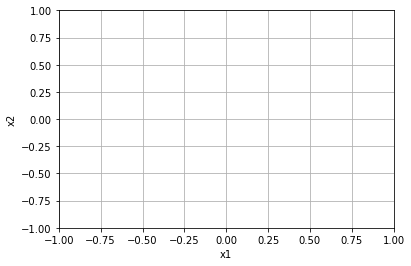


=================== Rollout 2361 =====================
x_init [[ 0.84]
 [-0.4 ]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.84 -0.4 ]
xx [ 0.84 -0.4 ]
xxx [ 0.84 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.4]


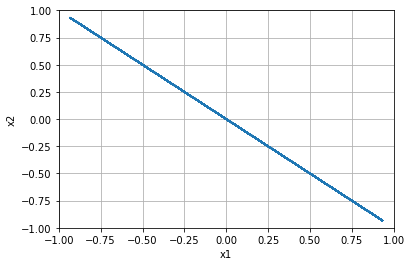


=================== Rollout 2362 =====================
x_init [[ 0.84]
 [-0.36]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.84 -0.36]
xx [ 0.84 -0.36]
xxx [ 0.84 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.36]


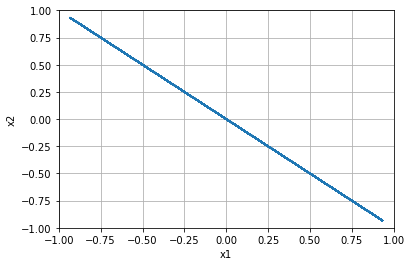


=================== Rollout 2363 =====================
x_init [[ 0.84]
 [-0.32]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.84 -0.32]
xx [ 0.84 -0.32]
xxx [ 0.84 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.31999999999999995]


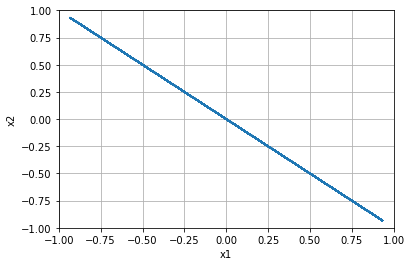


=================== Rollout 2364 =====================
x_init [[ 0.84]
 [-0.28]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.84 -0.28]
xx [ 0.84 -0.28]
xxx [ 0.84 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.28]


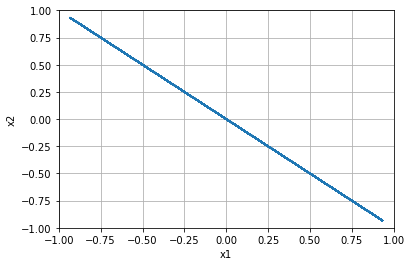


=================== Rollout 2365 =====================
x_init [[ 0.84]
 [-0.24]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.84 -0.24]
xx [ 0.84 -0.24]
xxx [ 0.84 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.24]


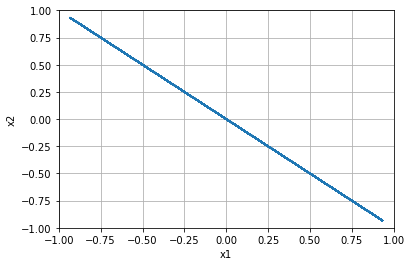


=================== Rollout 2366 =====================
x_init [[ 0.84]
 [-0.2 ]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.84 -0.2 ]
xx [ 0.84 -0.2 ]
xxx [ 0.84 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.19999999999999996]


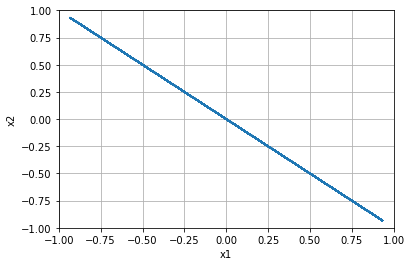


=================== Rollout 2367 =====================
x_init [[ 0.84]
 [-0.16]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.84 -0.16]
xx [ 0.84 -0.16]
xxx [ 0.84 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.16000000000000003]


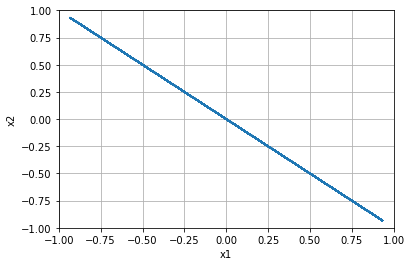


=================== Rollout 2368 =====================
x_init [[ 0.84]
 [-0.12]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.84 -0.12]
xx [ 0.84 -0.12]
xxx [ 0.84 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.12]


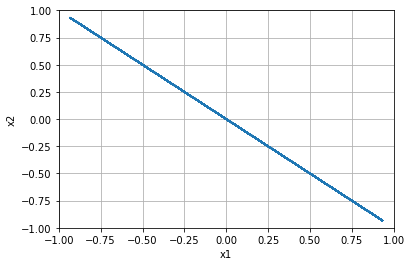


=================== Rollout 2369 =====================
x_init [[ 0.84]
 [-0.08]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.84 -0.08]
xx [ 0.84 -0.08]
xxx [ 0.84 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.07999999999999996]


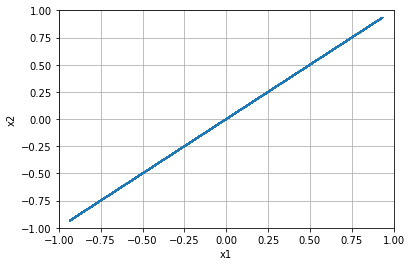


=================== Rollout 2370 =====================
x_init [[ 0.84]
 [-0.04]]
x_buffer [[ 0.84  0.84  0.84  0.84  0.84]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.84 -0.04]
xx [ 0.84 -0.04]
xxx [ 0.84 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, -0.040000000000000036]


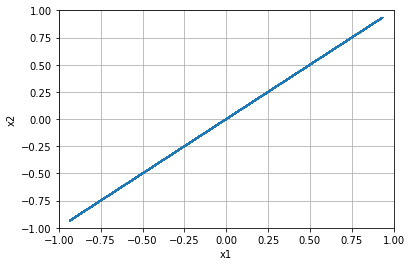


=================== Rollout 2371 =====================
x_init [[0.84]
 [0.  ]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.   0.   0.   0.   0.  ]]
x [0.84 0.  ]
xx [0.84 0.  ]
xxx [0.84 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.0]


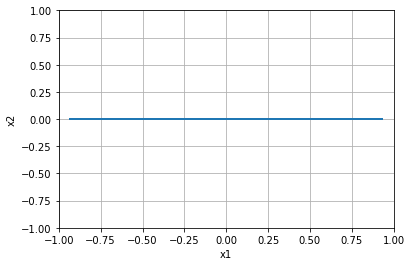


=================== Rollout 2372 =====================
x_init [[0.84]
 [0.04]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.84 0.04]
xx [0.84 0.04]
xxx [0.84 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.040000000000000036]


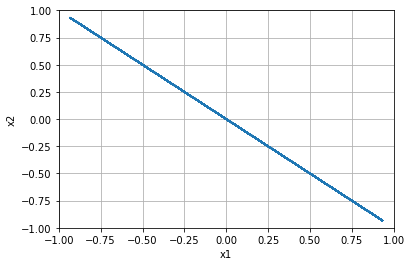


=================== Rollout 2373 =====================
x_init [[0.84]
 [0.08]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.84 0.08]
xx [0.84 0.08]
xxx [0.84 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.08000000000000007]


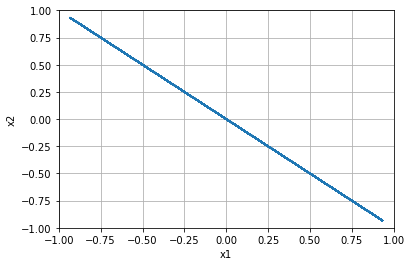


=================== Rollout 2374 =====================
x_init [[0.84]
 [0.12]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.84 0.12]
xx [0.84 0.12]
xxx [0.84 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.1200000000000001]


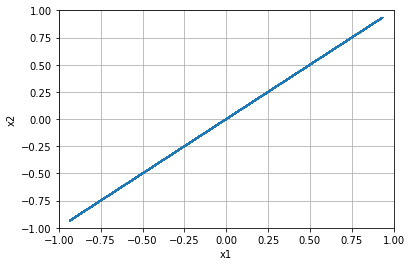


=================== Rollout 2375 =====================
x_init [[0.84]
 [0.16]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.84 0.16]
xx [0.84 0.16]
xxx [0.84 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.15999999999999992]


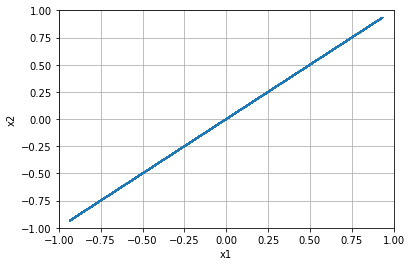


=================== Rollout 2376 =====================
x_init [[0.84]
 [0.2 ]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.84 0.2 ]
xx [0.84 0.2 ]
xxx [0.84 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.19999999999999996]


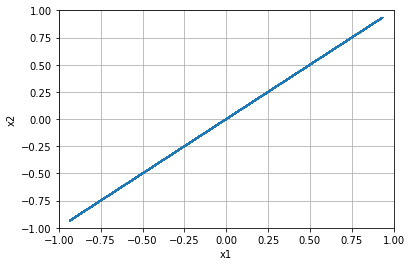


=================== Rollout 2377 =====================
x_init [[0.84]
 [0.24]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.84 0.24]
xx [0.84 0.24]
xxx [0.84 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.24]


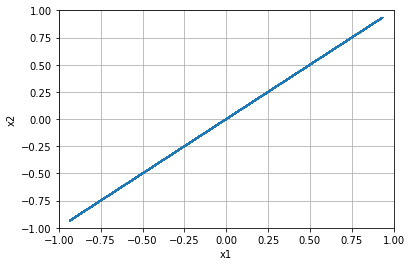


=================== Rollout 2378 =====================
x_init [[0.84]
 [0.28]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.84 0.28]
xx [0.84 0.28]
xxx [0.84 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.28]


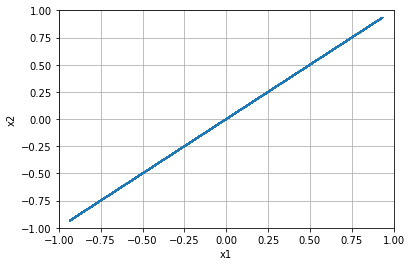


=================== Rollout 2379 =====================
x_init [[0.84]
 [0.32]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.84 0.32]
xx [0.84 0.32]
xxx [0.84 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.32000000000000006]


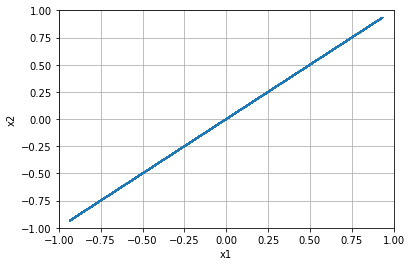


=================== Rollout 2380 =====================
x_init [[0.84]
 [0.36]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.84 0.36]
xx [0.84 0.36]
xxx [0.84 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.3600000000000001]


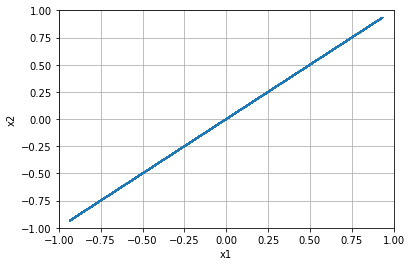


=================== Rollout 2381 =====================
x_init [[0.84]
 [0.4 ]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.84 0.4 ]
xx [0.84 0.4 ]
xxx [0.84 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.40000000000000013]


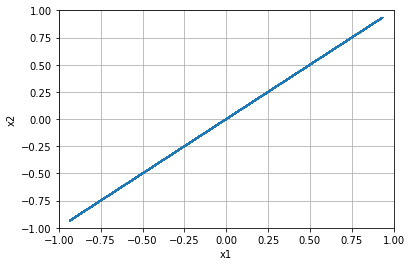


=================== Rollout 2382 =====================
x_init [[0.84]
 [0.44]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.84 0.44]
xx [0.84 0.44]
xxx [0.84 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.43999999999999995]


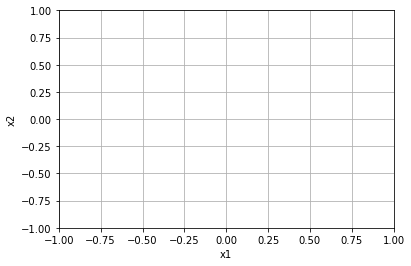


=================== Rollout 2383 =====================
x_init [[0.84]
 [0.48]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.84 0.48]
xx [0.84 0.48]
xxx [0.84 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.48]


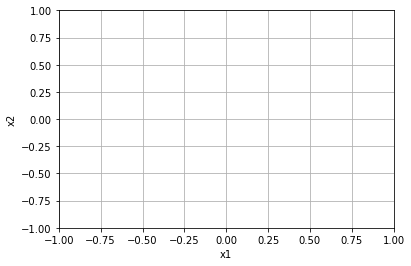


=================== Rollout 2384 =====================
x_init [[0.84]
 [0.52]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.84 0.52]
xx [0.84 0.52]
xxx [0.84 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.52]


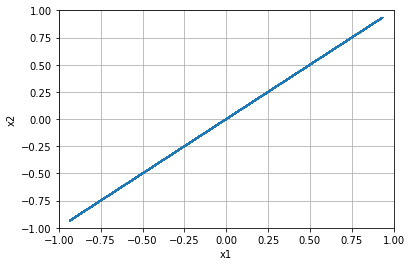


=================== Rollout 2385 =====================
x_init [[0.84]
 [0.56]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.84 0.56]
xx [0.84 0.56]
xxx [0.84 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.56]


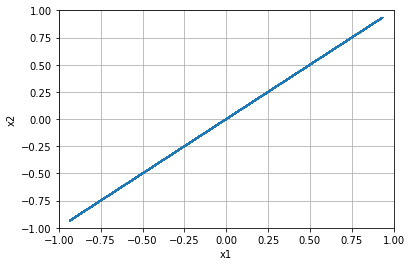


=================== Rollout 2386 =====================
x_init [[0.84]
 [0.6 ]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.84 0.6 ]
xx [0.84 0.6 ]
xxx [0.84 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.6000000000000001]


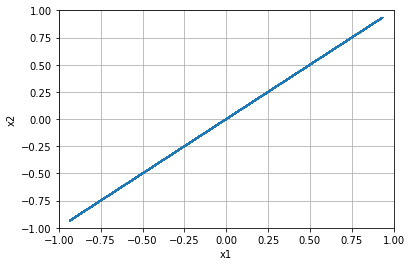


=================== Rollout 2387 =====================
x_init [[0.84]
 [0.64]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.84 0.64]
xx [0.84 0.64]
xxx [0.84 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.6400000000000001]


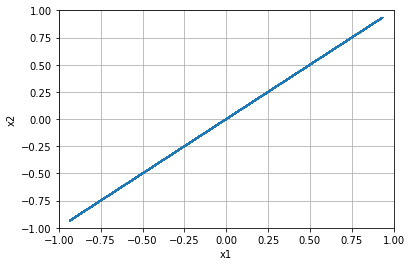


=================== Rollout 2388 =====================
x_init [[0.84]
 [0.68]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.84 0.68]
xx [0.84 0.68]
xxx [0.84 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.6799999999999999]


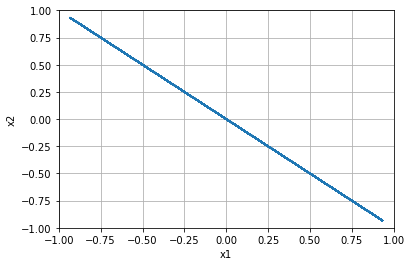


=================== Rollout 2389 =====================
x_init [[0.84]
 [0.72]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.84 0.72]
xx [0.84 0.72]
xxx [0.84 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.72]


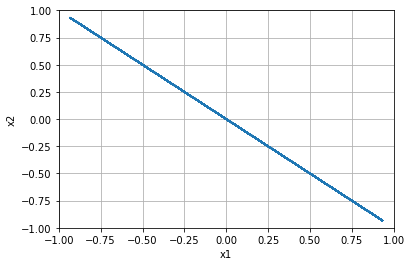


=================== Rollout 2390 =====================
x_init [[0.84]
 [0.76]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.84 0.76]
xx [0.84 0.76]
xxx [0.84 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.76]


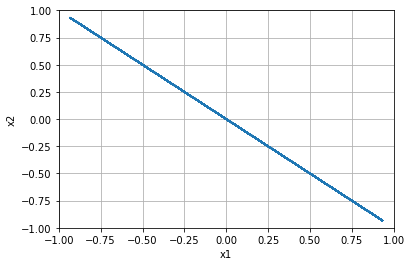


=================== Rollout 2391 =====================
x_init [[0.84]
 [0.8 ]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.84 0.8 ]
xx [0.84 0.8 ]
xxx [0.84 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.8]


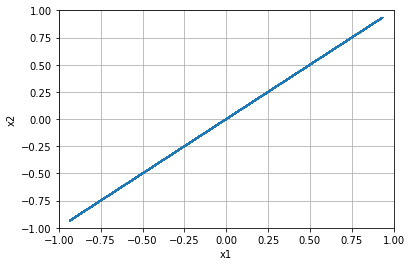


=================== Rollout 2392 =====================
x_init [[0.84]
 [0.84]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.84 0.84]
xx [0.84 0.84]
xxx [0.84 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.8400000000000001]


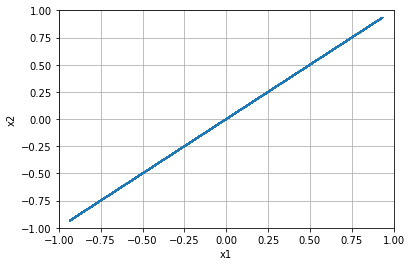


=================== Rollout 2393 =====================
x_init [[0.84]
 [0.88]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.84 0.88]
xx [0.84 0.88]
xxx [0.84 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.8800000000000001]


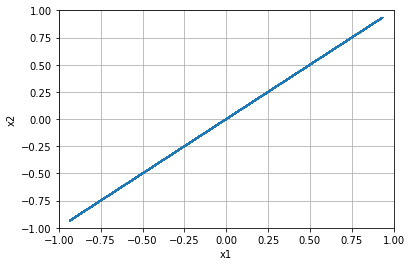


=================== Rollout 2394 =====================
x_init [[0.84]
 [0.92]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.84 0.92]
xx [0.84 0.92]
xxx [0.84 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.9199999999999999]


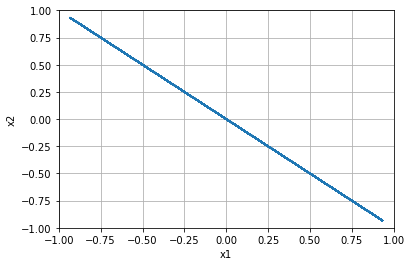


=================== Rollout 2395 =====================
x_init [[0.84]
 [0.96]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.84 0.96]
xx [0.84 0.96]
xxx [0.84 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 0.96]


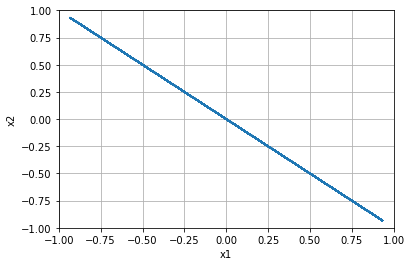


=================== Rollout 2396 =====================
x_init [[0.84]
 [1.  ]]
x_buffer [[0.84 0.84 0.84 0.84 0.84]
 [1.   1.   1.   1.   1.  ]]
x [0.84 1.  ]
xx [0.84 1.  ]
xxx [0.84 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8400000000000001, 1.0]


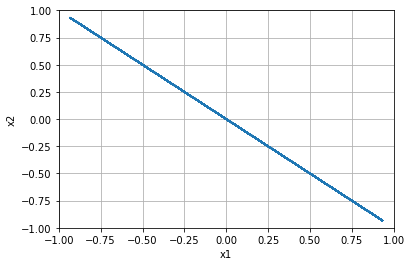


=================== Rollout 2397 =====================
x_init [[ 0.88]
 [-1.  ]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.88 -1.  ]
xx [ 0.88 -1.  ]
xxx [ 0.88 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -1.0]


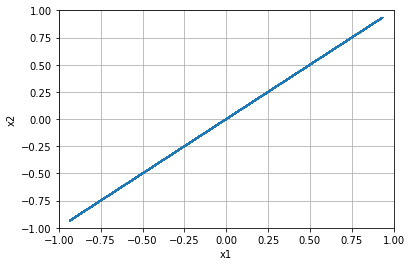


=================== Rollout 2398 =====================
x_init [[ 0.88]
 [-0.96]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.88 -0.96]
xx [ 0.88 -0.96]
xxx [ 0.88 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.96]


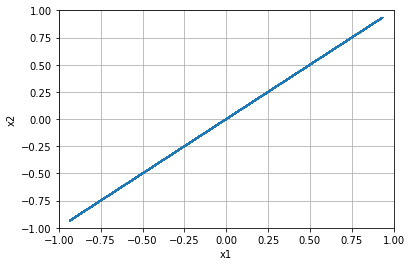


=================== Rollout 2399 =====================
x_init [[ 0.88]
 [-0.92]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.88 -0.92]
xx [ 0.88 -0.92]
xxx [ 0.88 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.92]


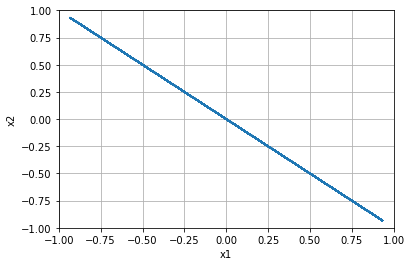


=================== Rollout 2400 =====================
x_init [[ 0.88]
 [-0.88]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.88 -0.88]
xx [ 0.88 -0.88]
xxx [ 0.88 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.88]


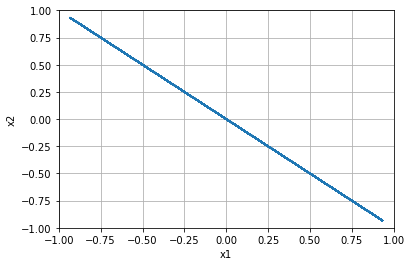


=================== Rollout 2401 =====================
x_init [[ 0.88]
 [-0.84]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.88 -0.84]
xx [ 0.88 -0.84]
xxx [ 0.88 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.84]


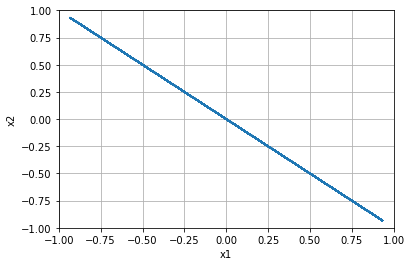


=================== Rollout 2402 =====================
x_init [[ 0.88]
 [-0.8 ]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.88 -0.8 ]
xx [ 0.88 -0.8 ]
xxx [ 0.88 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.8]


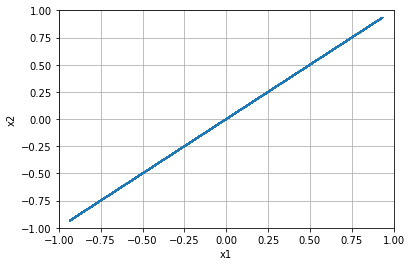


=================== Rollout 2403 =====================
x_init [[ 0.88]
 [-0.76]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.88 -0.76]
xx [ 0.88 -0.76]
xxx [ 0.88 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.76]


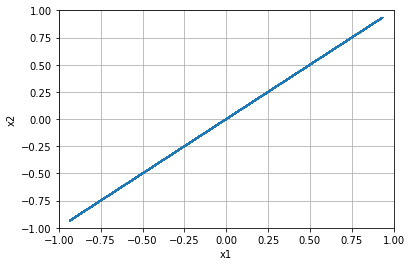


=================== Rollout 2404 =====================
x_init [[ 0.88]
 [-0.72]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.88 -0.72]
xx [ 0.88 -0.72]
xxx [ 0.88 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.72]


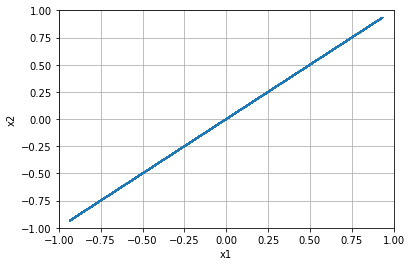


=================== Rollout 2405 =====================
x_init [[ 0.88]
 [-0.68]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.88 -0.68]
xx [ 0.88 -0.68]
xxx [ 0.88 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.6799999999999999]


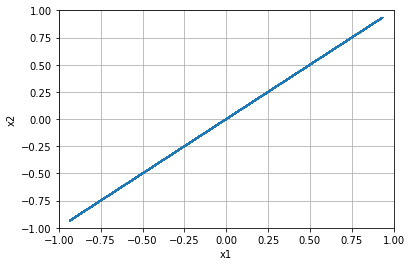


=================== Rollout 2406 =====================
x_init [[ 0.88]
 [-0.64]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.88 -0.64]
xx [ 0.88 -0.64]
xxx [ 0.88 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.64]


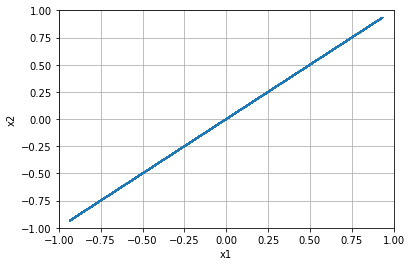


=================== Rollout 2407 =====================
x_init [[ 0.88]
 [-0.6 ]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.88 -0.6 ]
xx [ 0.88 -0.6 ]
xxx [ 0.88 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.6]


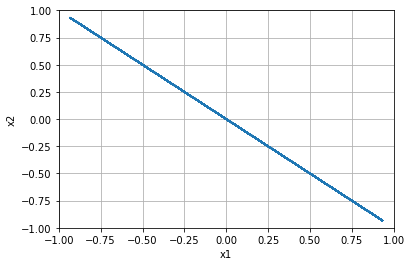


=================== Rollout 2408 =====================
x_init [[ 0.88]
 [-0.56]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.88 -0.56]
xx [ 0.88 -0.56]
xxx [ 0.88 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.56]


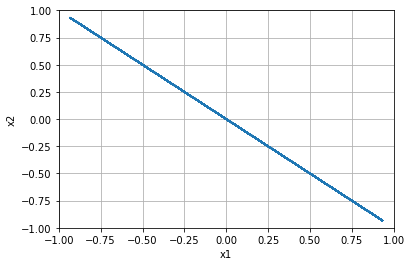


=================== Rollout 2409 =====================
x_init [[ 0.88]
 [-0.52]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.88 -0.52]
xx [ 0.88 -0.52]
xxx [ 0.88 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.52]


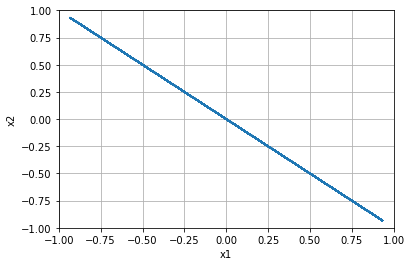


=================== Rollout 2410 =====================
x_init [[ 0.88]
 [-0.48]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.88 -0.48]
xx [ 0.88 -0.48]
xxx [ 0.88 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.48]


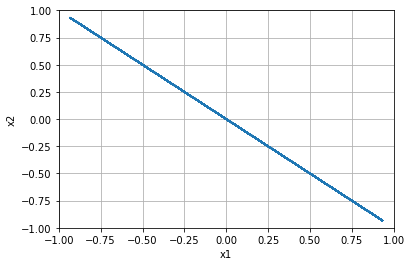


=================== Rollout 2411 =====================
x_init [[ 0.88]
 [-0.44]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.88 -0.44]
xx [ 0.88 -0.44]
xxx [ 0.88 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.43999999999999995]


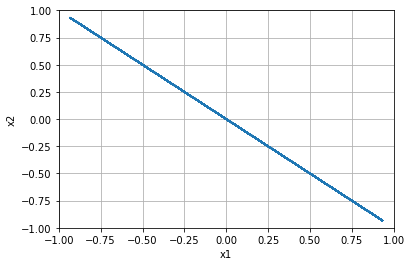


=================== Rollout 2412 =====================
x_init [[ 0.88]
 [-0.4 ]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.88 -0.4 ]
xx [ 0.88 -0.4 ]
xxx [ 0.88 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.4]


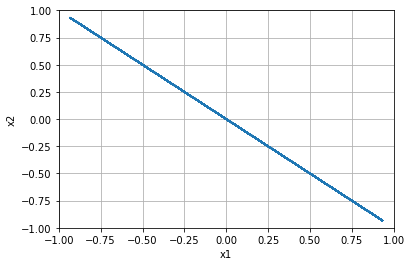


=================== Rollout 2413 =====================
x_init [[ 0.88]
 [-0.36]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.88 -0.36]
xx [ 0.88 -0.36]
xxx [ 0.88 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.36]


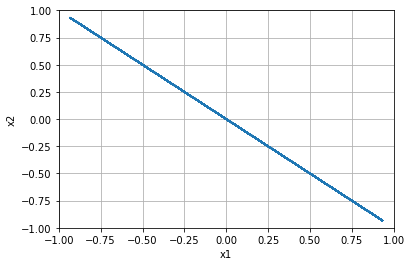


=================== Rollout 2414 =====================
x_init [[ 0.88]
 [-0.32]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.88 -0.32]
xx [ 0.88 -0.32]
xxx [ 0.88 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.31999999999999995]


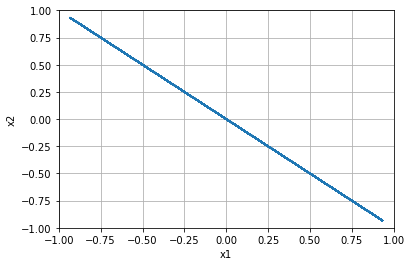


=================== Rollout 2415 =====================
x_init [[ 0.88]
 [-0.28]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.88 -0.28]
xx [ 0.88 -0.28]
xxx [ 0.88 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.28]


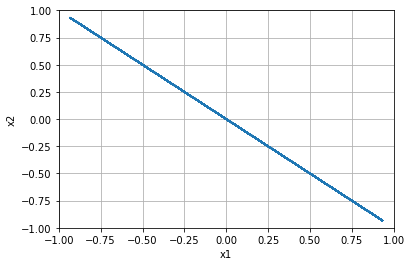


=================== Rollout 2416 =====================
x_init [[ 0.88]
 [-0.24]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.88 -0.24]
xx [ 0.88 -0.24]
xxx [ 0.88 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.24]


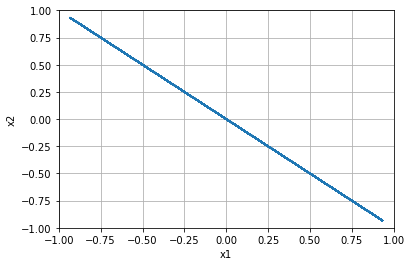


=================== Rollout 2417 =====================
x_init [[ 0.88]
 [-0.2 ]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.88 -0.2 ]
xx [ 0.88 -0.2 ]
xxx [ 0.88 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.19999999999999996]


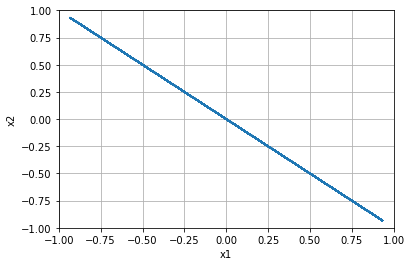


=================== Rollout 2418 =====================
x_init [[ 0.88]
 [-0.16]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.88 -0.16]
xx [ 0.88 -0.16]
xxx [ 0.88 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.16000000000000003]


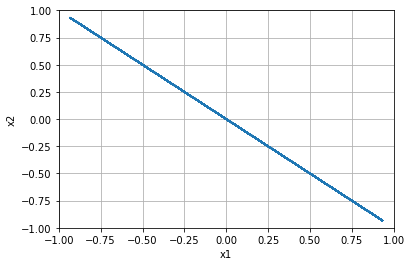


=================== Rollout 2419 =====================
x_init [[ 0.88]
 [-0.12]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.88 -0.12]
xx [ 0.88 -0.12]
xxx [ 0.88 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.12]


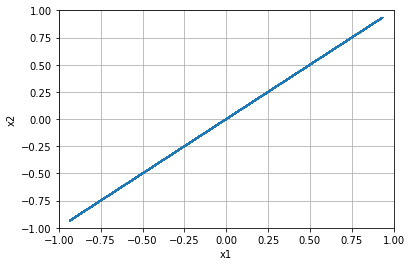


=================== Rollout 2420 =====================
x_init [[ 0.88]
 [-0.08]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.88 -0.08]
xx [ 0.88 -0.08]
xxx [ 0.88 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.07999999999999996]


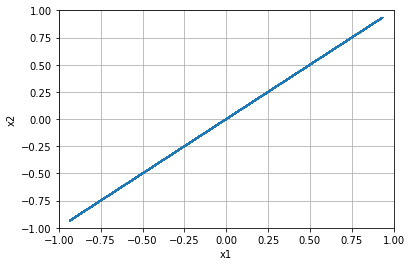


=================== Rollout 2421 =====================
x_init [[ 0.88]
 [-0.04]]
x_buffer [[ 0.88  0.88  0.88  0.88  0.88]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.88 -0.04]
xx [ 0.88 -0.04]
xxx [ 0.88 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, -0.040000000000000036]


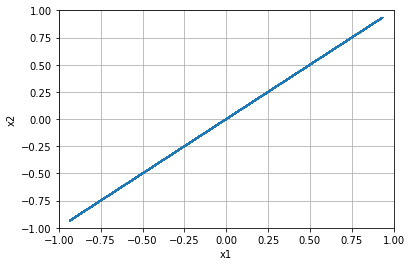


=================== Rollout 2422 =====================
x_init [[0.88]
 [0.  ]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.   0.   0.   0.   0.  ]]
x [0.88 0.  ]
xx [0.88 0.  ]
xxx [0.88 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.0]


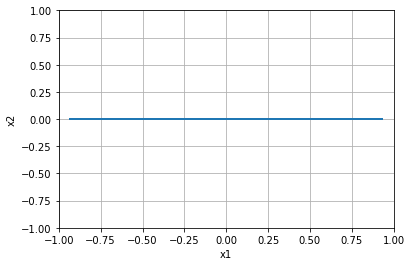


=================== Rollout 2423 =====================
x_init [[0.88]
 [0.04]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.88 0.04]
xx [0.88 0.04]
xxx [0.88 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.040000000000000036]


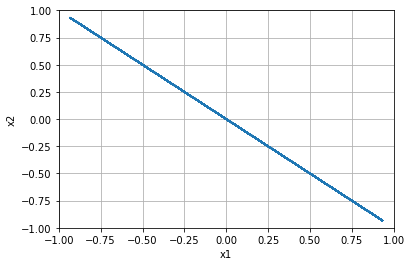


=================== Rollout 2424 =====================
x_init [[0.88]
 [0.08]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.88 0.08]
xx [0.88 0.08]
xxx [0.88 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.08000000000000007]


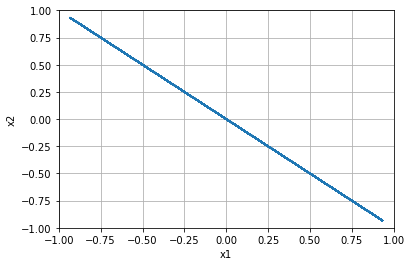


=================== Rollout 2425 =====================
x_init [[0.88]
 [0.12]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.88 0.12]
xx [0.88 0.12]
xxx [0.88 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.1200000000000001]


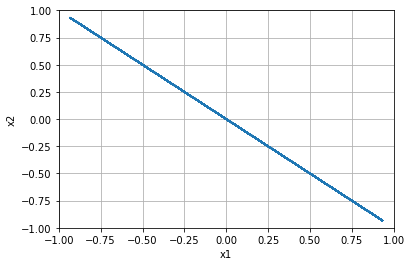


=================== Rollout 2426 =====================
x_init [[0.88]
 [0.16]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.88 0.16]
xx [0.88 0.16]
xxx [0.88 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.15999999999999992]


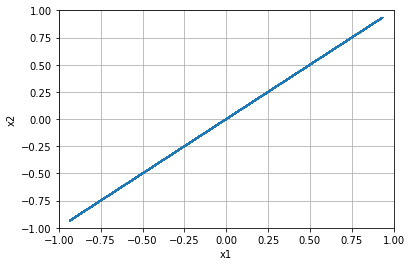


=================== Rollout 2427 =====================
x_init [[0.88]
 [0.2 ]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.88 0.2 ]
xx [0.88 0.2 ]
xxx [0.88 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.19999999999999996]


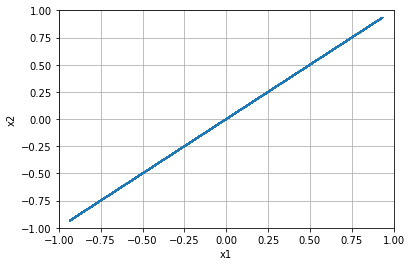


=================== Rollout 2428 =====================
x_init [[0.88]
 [0.24]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.88 0.24]
xx [0.88 0.24]
xxx [0.88 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.24]


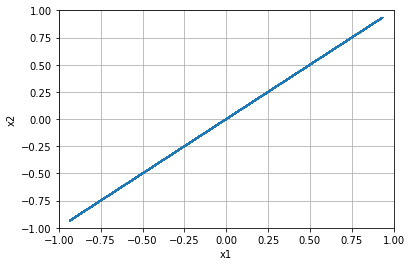


=================== Rollout 2429 =====================
x_init [[0.88]
 [0.28]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.88 0.28]
xx [0.88 0.28]
xxx [0.88 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.28]


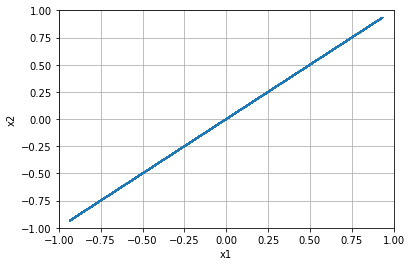


=================== Rollout 2430 =====================
x_init [[0.88]
 [0.32]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.88 0.32]
xx [0.88 0.32]
xxx [0.88 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.32000000000000006]


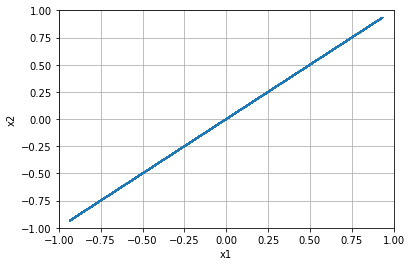


=================== Rollout 2431 =====================
x_init [[0.88]
 [0.36]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.88 0.36]
xx [0.88 0.36]
xxx [0.88 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.3600000000000001]


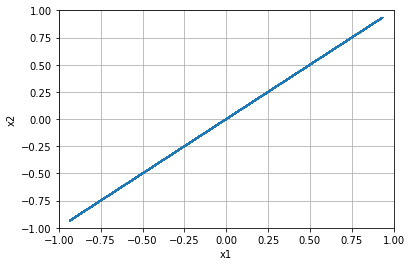


=================== Rollout 2432 =====================
x_init [[0.88]
 [0.4 ]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.88 0.4 ]
xx [0.88 0.4 ]
xxx [0.88 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.40000000000000013]


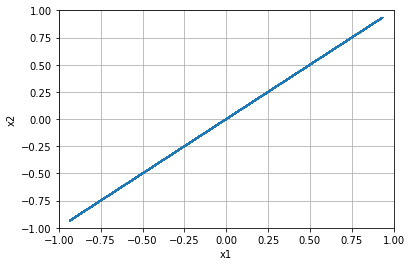


=================== Rollout 2433 =====================
x_init [[0.88]
 [0.44]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.88 0.44]
xx [0.88 0.44]
xxx [0.88 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.43999999999999995]


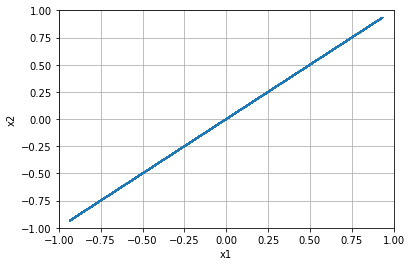


=================== Rollout 2434 =====================
x_init [[0.88]
 [0.48]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.88 0.48]
xx [0.88 0.48]
xxx [0.88 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.48]


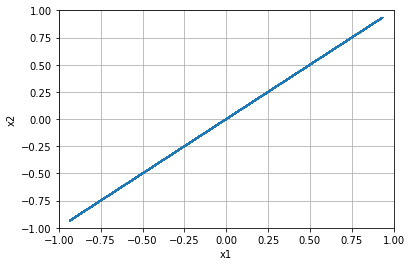


=================== Rollout 2435 =====================
x_init [[0.88]
 [0.52]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.88 0.52]
xx [0.88 0.52]
xxx [0.88 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.52]


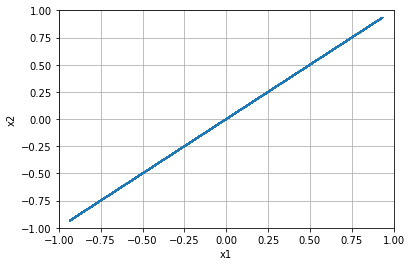


=================== Rollout 2436 =====================
x_init [[0.88]
 [0.56]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.88 0.56]
xx [0.88 0.56]
xxx [0.88 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.56]


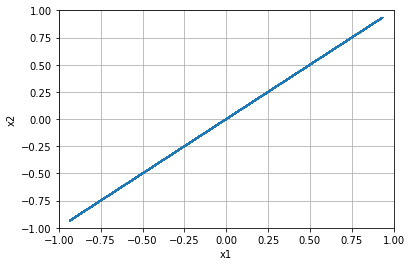


=================== Rollout 2437 =====================
x_init [[0.88]
 [0.6 ]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.88 0.6 ]
xx [0.88 0.6 ]
xxx [0.88 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.6000000000000001]


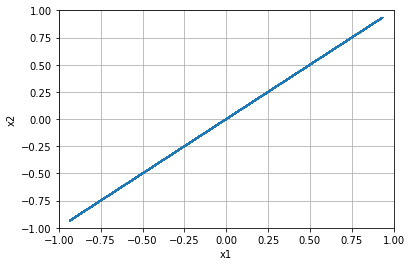


=================== Rollout 2438 =====================
x_init [[0.88]
 [0.64]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.88 0.64]
xx [0.88 0.64]
xxx [0.88 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.6400000000000001]


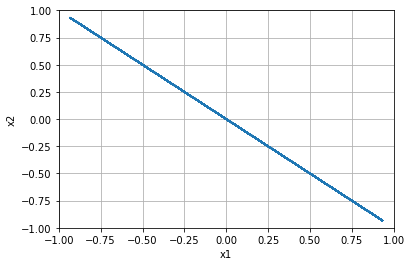


=================== Rollout 2439 =====================
x_init [[0.88]
 [0.68]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.88 0.68]
xx [0.88 0.68]
xxx [0.88 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.6799999999999999]


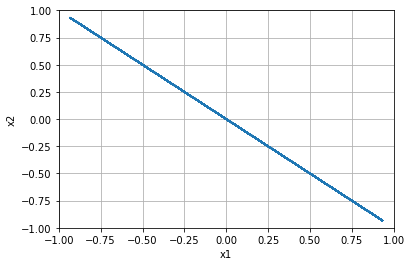


=================== Rollout 2440 =====================
x_init [[0.88]
 [0.72]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.88 0.72]
xx [0.88 0.72]
xxx [0.88 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.72]


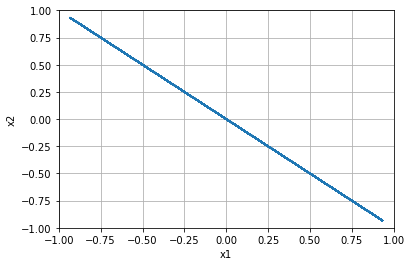


=================== Rollout 2441 =====================
x_init [[0.88]
 [0.76]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.88 0.76]
xx [0.88 0.76]
xxx [0.88 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.76]


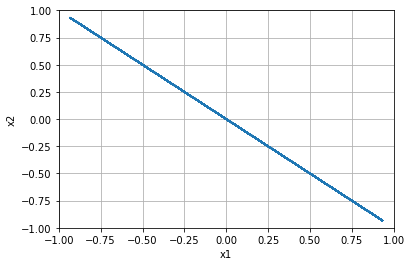


=================== Rollout 2442 =====================
x_init [[0.88]
 [0.8 ]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.88 0.8 ]
xx [0.88 0.8 ]
xxx [0.88 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.8]


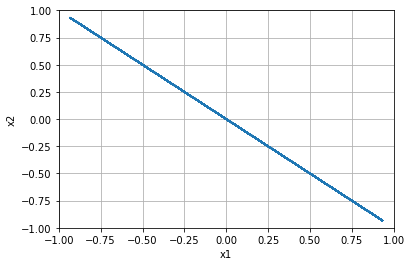


=================== Rollout 2443 =====================
x_init [[0.88]
 [0.84]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.88 0.84]
xx [0.88 0.84]
xxx [0.88 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.8400000000000001]


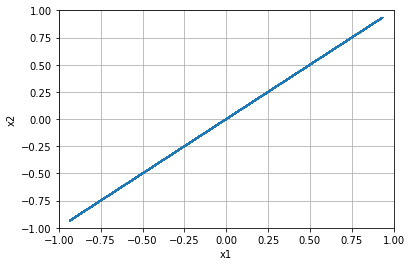


=================== Rollout 2444 =====================
x_init [[0.88]
 [0.88]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.88 0.88]
xx [0.88 0.88]
xxx [0.88 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.8800000000000001]


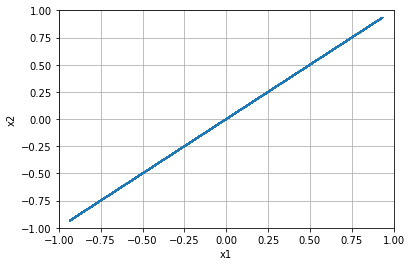


=================== Rollout 2445 =====================
x_init [[0.88]
 [0.92]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.88 0.92]
xx [0.88 0.92]
xxx [0.88 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.9199999999999999]


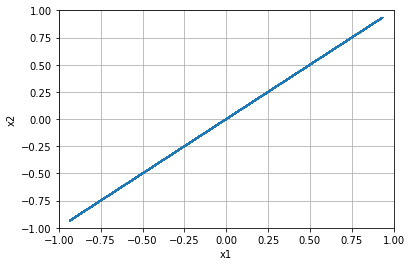


=================== Rollout 2446 =====================
x_init [[0.88]
 [0.96]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.88 0.96]
xx [0.88 0.96]
xxx [0.88 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 0.96]


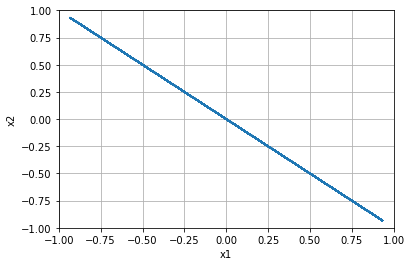


=================== Rollout 2447 =====================
x_init [[0.88]
 [1.  ]]
x_buffer [[0.88 0.88 0.88 0.88 0.88]
 [1.   1.   1.   1.   1.  ]]
x [0.88 1.  ]
xx [0.88 1.  ]
xxx [0.88 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.8800000000000001, 1.0]


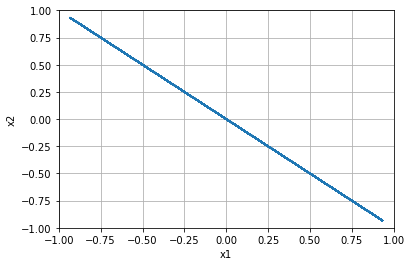


=================== Rollout 2448 =====================
x_init [[ 0.92]
 [-1.  ]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.92 -1.  ]
xx [ 0.92 -1.  ]
xxx [ 0.92 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -1.0]


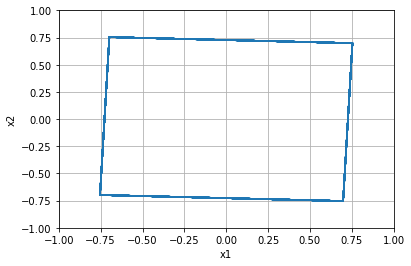


=================== Rollout 2449 =====================
x_init [[ 0.92]
 [-0.96]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.92 -0.96]
xx [ 0.92 -0.96]
xxx [ 0.92 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.96]


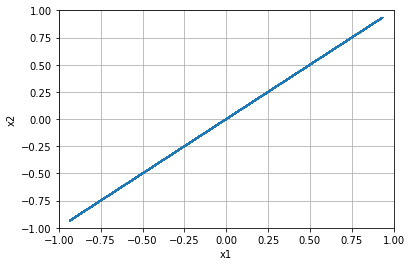


=================== Rollout 2450 =====================
x_init [[ 0.92]
 [-0.92]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.92 -0.92]
xx [ 0.92 -0.92]
xxx [ 0.92 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.92]


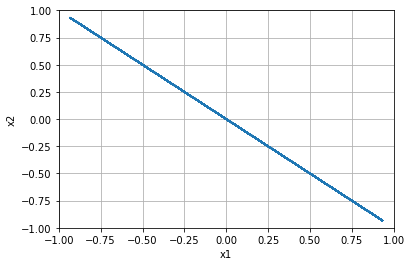


=================== Rollout 2451 =====================
x_init [[ 0.92]
 [-0.88]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.92 -0.88]
xx [ 0.92 -0.88]
xxx [ 0.92 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.88]


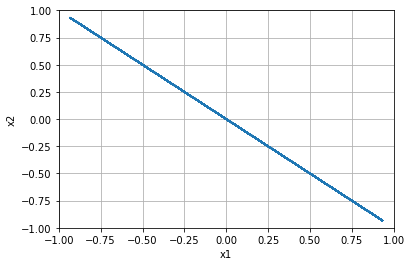


=================== Rollout 2452 =====================
x_init [[ 0.92]
 [-0.84]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.92 -0.84]
xx [ 0.92 -0.84]
xxx [ 0.92 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.84]


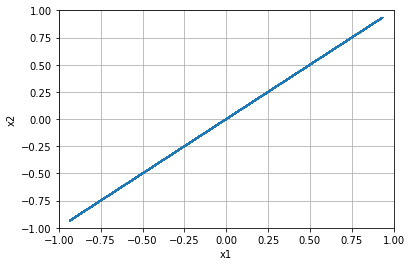


=================== Rollout 2453 =====================
x_init [[ 0.92]
 [-0.8 ]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.92 -0.8 ]
xx [ 0.92 -0.8 ]
xxx [ 0.92 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.8]


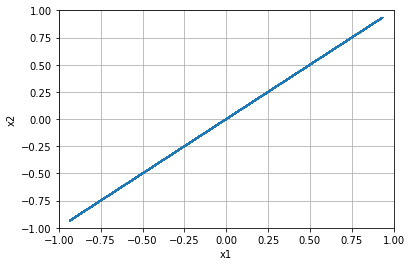


=================== Rollout 2454 =====================
x_init [[ 0.92]
 [-0.76]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.92 -0.76]
xx [ 0.92 -0.76]
xxx [ 0.92 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.76]


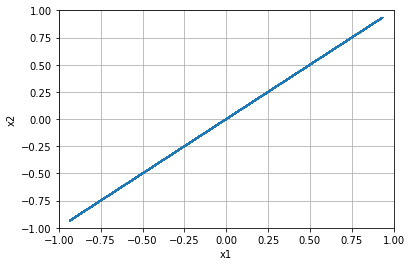


=================== Rollout 2455 =====================
x_init [[ 0.92]
 [-0.72]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.92 -0.72]
xx [ 0.92 -0.72]
xxx [ 0.92 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.72]


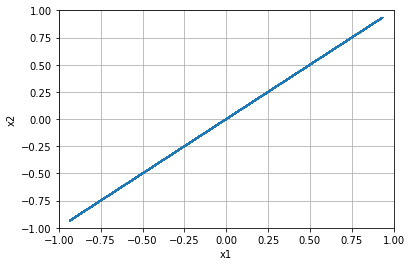


=================== Rollout 2456 =====================
x_init [[ 0.92]
 [-0.68]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.92 -0.68]
xx [ 0.92 -0.68]
xxx [ 0.92 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.6799999999999999]


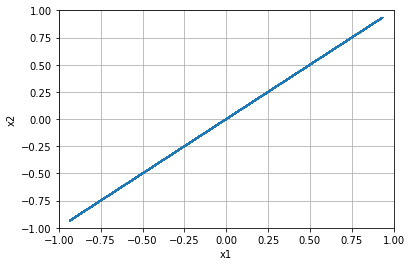


=================== Rollout 2457 =====================
x_init [[ 0.92]
 [-0.64]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.92 -0.64]
xx [ 0.92 -0.64]
xxx [ 0.92 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.64]


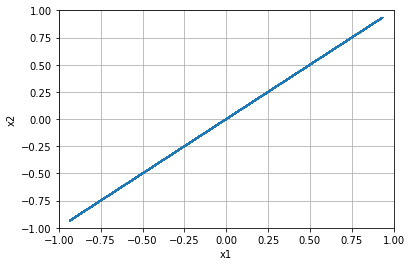


=================== Rollout 2458 =====================
x_init [[ 0.92]
 [-0.6 ]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.92 -0.6 ]
xx [ 0.92 -0.6 ]
xxx [ 0.92 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.6]


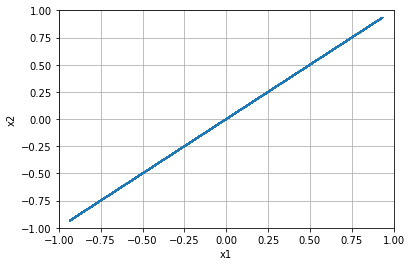


=================== Rollout 2459 =====================
x_init [[ 0.92]
 [-0.56]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.92 -0.56]
xx [ 0.92 -0.56]
xxx [ 0.92 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.56]


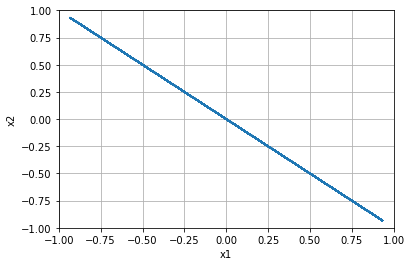


=================== Rollout 2460 =====================
x_init [[ 0.92]
 [-0.52]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.92 -0.52]
xx [ 0.92 -0.52]
xxx [ 0.92 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.52]


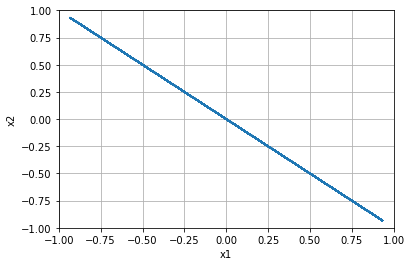


=================== Rollout 2461 =====================
x_init [[ 0.92]
 [-0.48]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.92 -0.48]
xx [ 0.92 -0.48]
xxx [ 0.92 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.48]


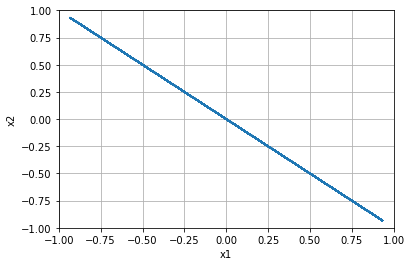


=================== Rollout 2462 =====================
x_init [[ 0.92]
 [-0.44]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.92 -0.44]
xx [ 0.92 -0.44]
xxx [ 0.92 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.43999999999999995]


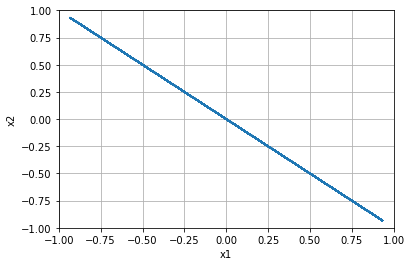


=================== Rollout 2463 =====================
x_init [[ 0.92]
 [-0.4 ]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.92 -0.4 ]
xx [ 0.92 -0.4 ]
xxx [ 0.92 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.4]


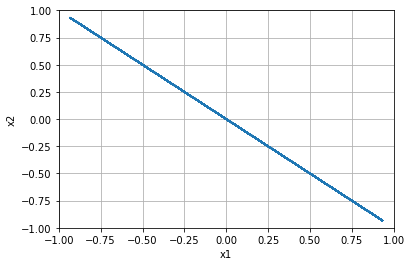


=================== Rollout 2464 =====================
x_init [[ 0.92]
 [-0.36]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.92 -0.36]
xx [ 0.92 -0.36]
xxx [ 0.92 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.36]


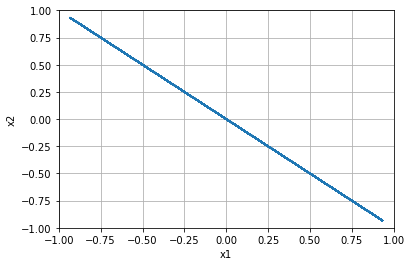


=================== Rollout 2465 =====================
x_init [[ 0.92]
 [-0.32]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.92 -0.32]
xx [ 0.92 -0.32]
xxx [ 0.92 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.31999999999999995]


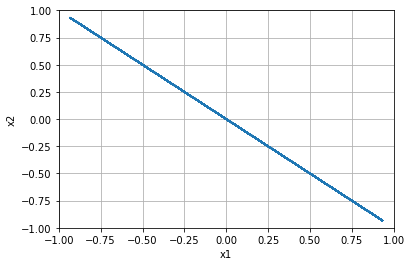


=================== Rollout 2466 =====================
x_init [[ 0.92]
 [-0.28]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.92 -0.28]
xx [ 0.92 -0.28]
xxx [ 0.92 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.28]


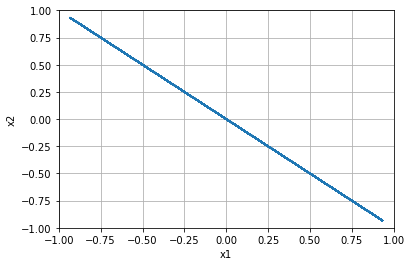


=================== Rollout 2467 =====================
x_init [[ 0.92]
 [-0.24]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.92 -0.24]
xx [ 0.92 -0.24]
xxx [ 0.92 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.24]


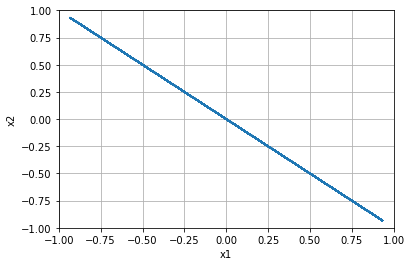


=================== Rollout 2468 =====================
x_init [[ 0.92]
 [-0.2 ]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.92 -0.2 ]
xx [ 0.92 -0.2 ]
xxx [ 0.92 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.19999999999999996]


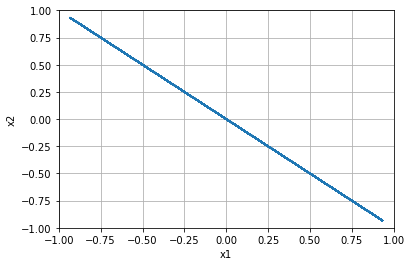


=================== Rollout 2469 =====================
x_init [[ 0.92]
 [-0.16]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.92 -0.16]
xx [ 0.92 -0.16]
xxx [ 0.92 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.16000000000000003]


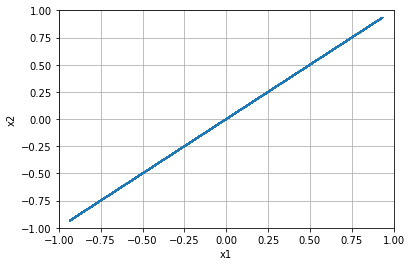


=================== Rollout 2470 =====================
x_init [[ 0.92]
 [-0.12]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.92 -0.12]
xx [ 0.92 -0.12]
xxx [ 0.92 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.12]


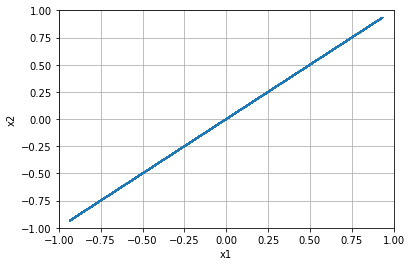


=================== Rollout 2471 =====================
x_init [[ 0.92]
 [-0.08]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.92 -0.08]
xx [ 0.92 -0.08]
xxx [ 0.92 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.07999999999999996]


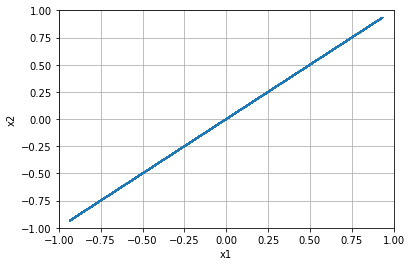


=================== Rollout 2472 =====================
x_init [[ 0.92]
 [-0.04]]
x_buffer [[ 0.92  0.92  0.92  0.92  0.92]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.92 -0.04]
xx [ 0.92 -0.04]
xxx [ 0.92 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, -0.040000000000000036]


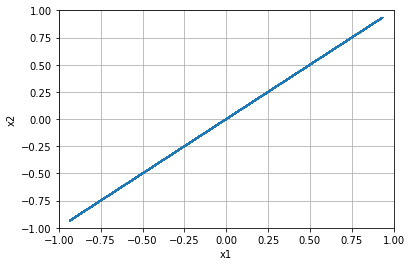


=================== Rollout 2473 =====================
x_init [[0.92]
 [0.  ]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.   0.   0.   0.   0.  ]]
x [0.92 0.  ]
xx [0.92 0.  ]
xxx [0.92 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.0]


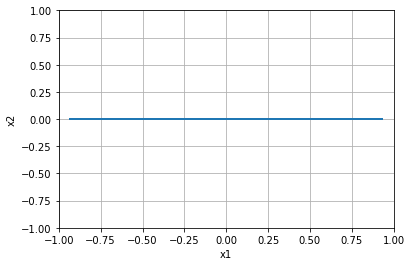


=================== Rollout 2474 =====================
x_init [[0.92]
 [0.04]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.92 0.04]
xx [0.92 0.04]
xxx [0.92 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.040000000000000036]


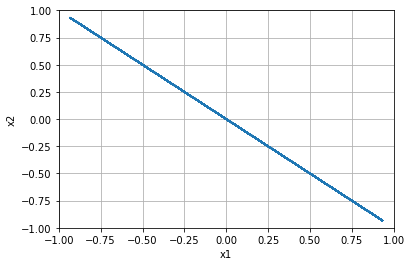


=================== Rollout 2475 =====================
x_init [[0.92]
 [0.08]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.92 0.08]
xx [0.92 0.08]
xxx [0.92 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.08000000000000007]


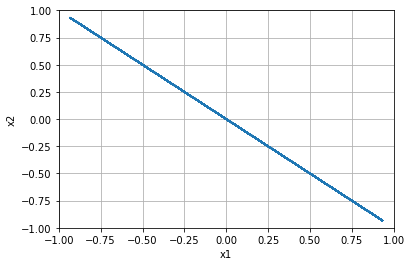


=================== Rollout 2476 =====================
x_init [[0.92]
 [0.12]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.92 0.12]
xx [0.92 0.12]
xxx [0.92 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.1200000000000001]


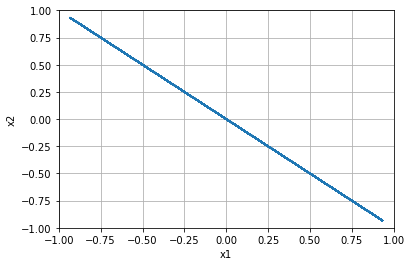


=================== Rollout 2477 =====================
x_init [[0.92]
 [0.16]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.92 0.16]
xx [0.92 0.16]
xxx [0.92 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.15999999999999992]


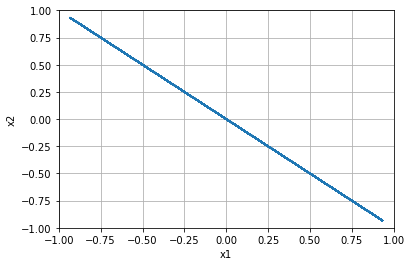


=================== Rollout 2478 =====================
x_init [[0.92]
 [0.2 ]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.92 0.2 ]
xx [0.92 0.2 ]
xxx [0.92 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.19999999999999996]


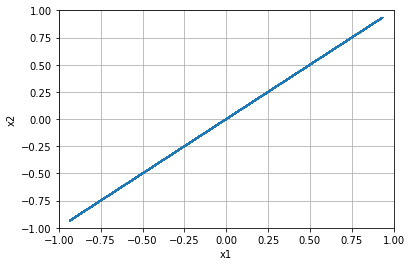


=================== Rollout 2479 =====================
x_init [[0.92]
 [0.24]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.92 0.24]
xx [0.92 0.24]
xxx [0.92 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.24]


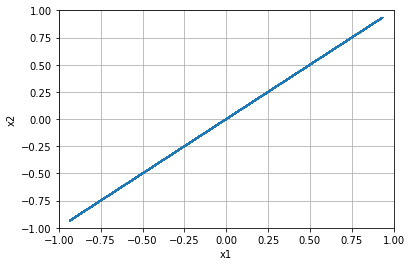


=================== Rollout 2480 =====================
x_init [[0.92]
 [0.28]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.92 0.28]
xx [0.92 0.28]
xxx [0.92 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.28]


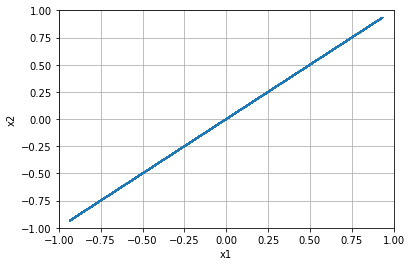


=================== Rollout 2481 =====================
x_init [[0.92]
 [0.32]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.92 0.32]
xx [0.92 0.32]
xxx [0.92 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.32000000000000006]


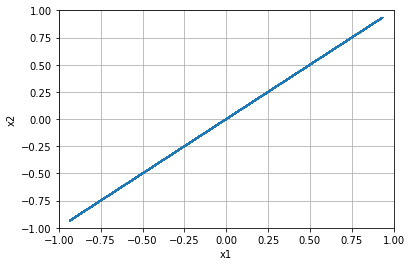


=================== Rollout 2482 =====================
x_init [[0.92]
 [0.36]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.92 0.36]
xx [0.92 0.36]
xxx [0.92 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.3600000000000001]


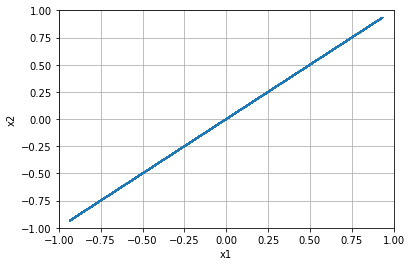


=================== Rollout 2483 =====================
x_init [[0.92]
 [0.4 ]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.92 0.4 ]
xx [0.92 0.4 ]
xxx [0.92 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.40000000000000013]


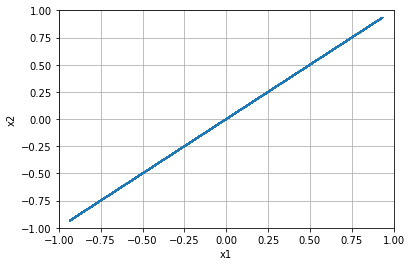


=================== Rollout 2484 =====================
x_init [[0.92]
 [0.44]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.92 0.44]
xx [0.92 0.44]
xxx [0.92 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.43999999999999995]


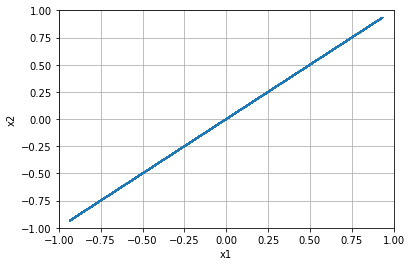


=================== Rollout 2485 =====================
x_init [[0.92]
 [0.48]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.92 0.48]
xx [0.92 0.48]
xxx [0.92 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.48]


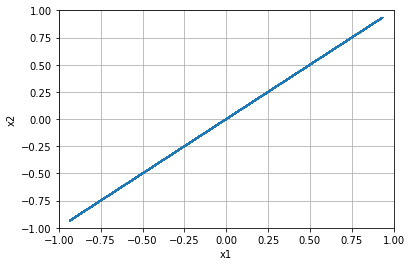


=================== Rollout 2486 =====================
x_init [[0.92]
 [0.52]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.92 0.52]
xx [0.92 0.52]
xxx [0.92 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.52]


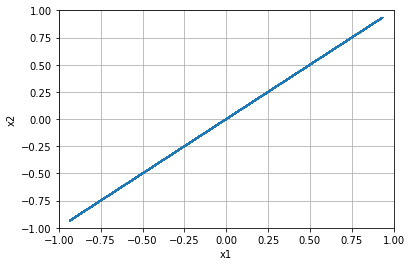


=================== Rollout 2487 =====================
x_init [[0.92]
 [0.56]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.92 0.56]
xx [0.92 0.56]
xxx [0.92 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.56]


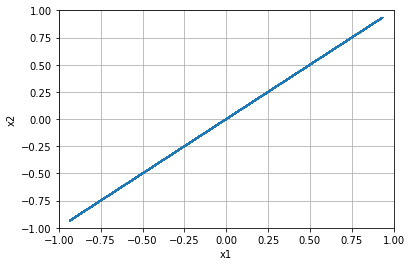


=================== Rollout 2488 =====================
x_init [[0.92]
 [0.6 ]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.92 0.6 ]
xx [0.92 0.6 ]
xxx [0.92 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.6000000000000001]


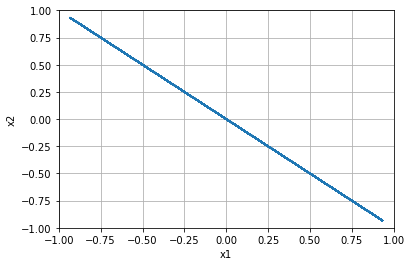


=================== Rollout 2489 =====================
x_init [[0.92]
 [0.64]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.92 0.64]
xx [0.92 0.64]
xxx [0.92 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.6400000000000001]


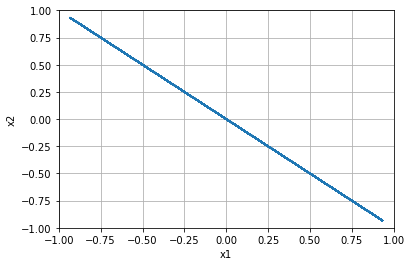


=================== Rollout 2490 =====================
x_init [[0.92]
 [0.68]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.92 0.68]
xx [0.92 0.68]
xxx [0.92 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.6799999999999999]


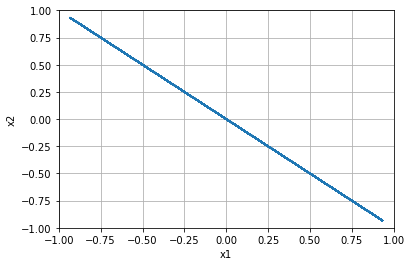


=================== Rollout 2491 =====================
x_init [[0.92]
 [0.72]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.92 0.72]
xx [0.92 0.72]
xxx [0.92 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.72]


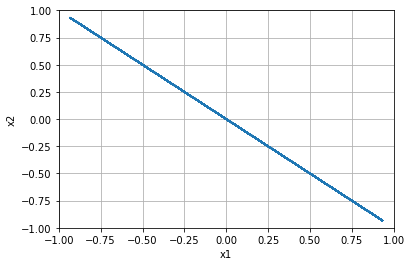


=================== Rollout 2492 =====================
x_init [[0.92]
 [0.76]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.92 0.76]
xx [0.92 0.76]
xxx [0.92 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.76]


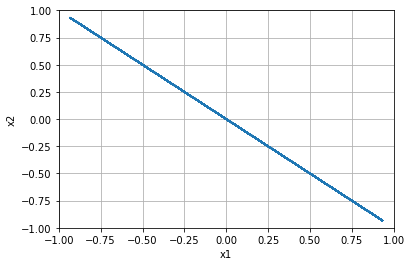


=================== Rollout 2493 =====================
x_init [[0.92]
 [0.8 ]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.92 0.8 ]
xx [0.92 0.8 ]
xxx [0.92 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.8]


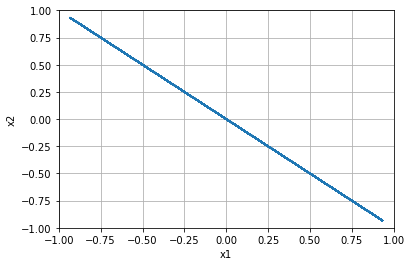


=================== Rollout 2494 =====================
x_init [[0.92]
 [0.84]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.92 0.84]
xx [0.92 0.84]
xxx [0.92 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.8400000000000001]


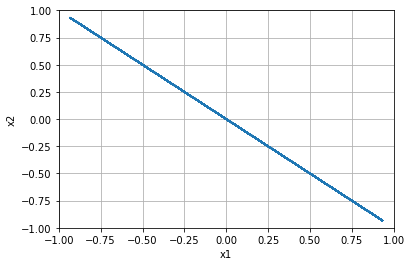


=================== Rollout 2495 =====================
x_init [[0.92]
 [0.88]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.92 0.88]
xx [0.92 0.88]
xxx [0.92 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.8800000000000001]


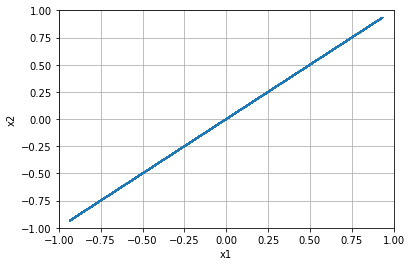


=================== Rollout 2496 =====================
x_init [[0.92]
 [0.92]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.92 0.92]
xx [0.92 0.92]
xxx [0.92 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.9199999999999999]


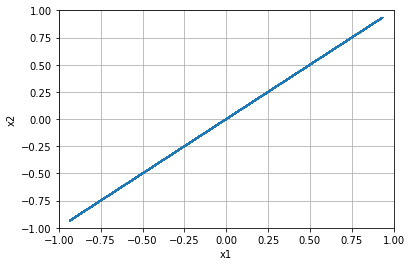


=================== Rollout 2497 =====================
x_init [[0.92]
 [0.96]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.92 0.96]
xx [0.92 0.96]
xxx [0.92 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 0.96]


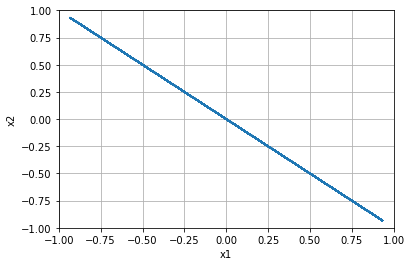


=================== Rollout 2498 =====================
x_init [[0.92]
 [1.  ]]
x_buffer [[0.92 0.92 0.92 0.92 0.92]
 [1.   1.   1.   1.   1.  ]]
x [0.92 1.  ]
xx [0.92 1.  ]
xxx [0.92 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.9199999999999999, 1.0]


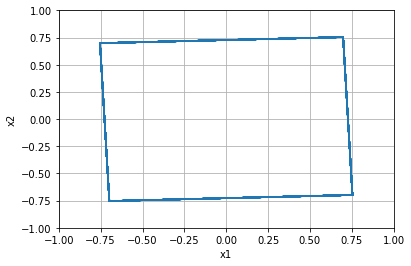


=================== Rollout 2499 =====================
x_init [[ 0.96]
 [-1.  ]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-1.   -1.   -1.   -1.   -1.  ]]
x [ 0.96 -1.  ]
xx [ 0.96 -1.  ]
xxx [ 0.96 -1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -1.0]


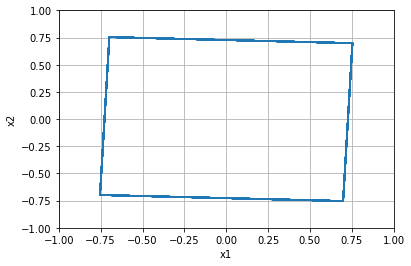


=================== Rollout 2500 =====================
x_init [[ 0.96]
 [-0.96]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 0.96 -0.96]
xx [ 0.96 -0.96]
xxx [ 0.96 -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.96]


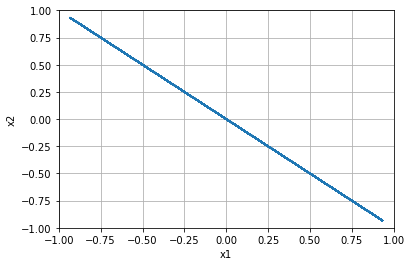


=================== Rollout 2501 =====================
x_init [[ 0.96]
 [-0.92]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 0.96 -0.92]
xx [ 0.96 -0.92]
xxx [ 0.96 -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.92]


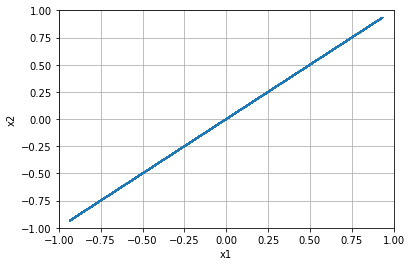


=================== Rollout 2502 =====================
x_init [[ 0.96]
 [-0.88]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 0.96 -0.88]
xx [ 0.96 -0.88]
xxx [ 0.96 -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.88]


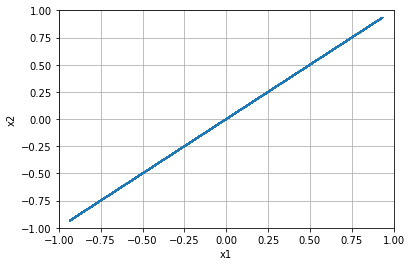


=================== Rollout 2503 =====================
x_init [[ 0.96]
 [-0.84]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 0.96 -0.84]
xx [ 0.96 -0.84]
xxx [ 0.96 -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.84]


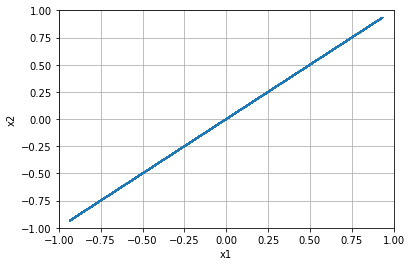


=================== Rollout 2504 =====================
x_init [[ 0.96]
 [-0.8 ]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.8  -0.8  -0.8  -0.8  -0.8 ]]
x [ 0.96 -0.8 ]
xx [ 0.96 -0.8 ]
xxx [ 0.96 -0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.8]


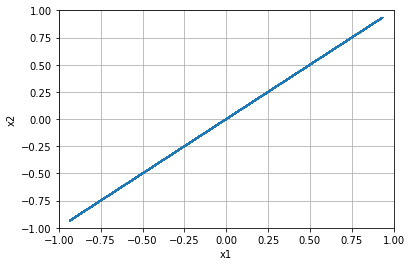


=================== Rollout 2505 =====================
x_init [[ 0.96]
 [-0.76]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 0.96 -0.76]
xx [ 0.96 -0.76]
xxx [ 0.96 -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.76]


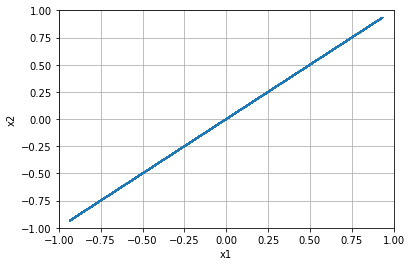


=================== Rollout 2506 =====================
x_init [[ 0.96]
 [-0.72]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 0.96 -0.72]
xx [ 0.96 -0.72]
xxx [ 0.96 -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.72]


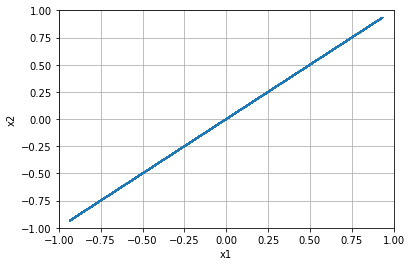


=================== Rollout 2507 =====================
x_init [[ 0.96]
 [-0.68]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 0.96 -0.68]
xx [ 0.96 -0.68]
xxx [ 0.96 -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.6799999999999999]


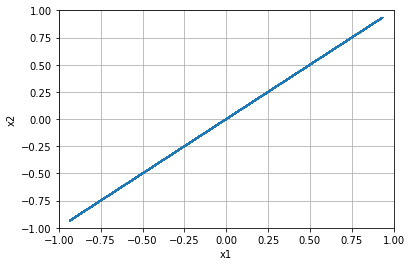


=================== Rollout 2508 =====================
x_init [[ 0.96]
 [-0.64]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 0.96 -0.64]
xx [ 0.96 -0.64]
xxx [ 0.96 -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.64]


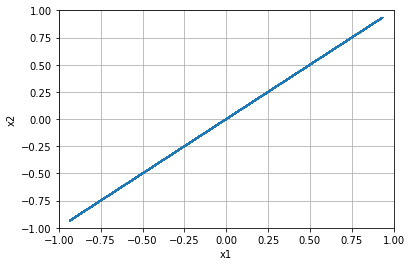


=================== Rollout 2509 =====================
x_init [[ 0.96]
 [-0.6 ]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.6  -0.6  -0.6  -0.6  -0.6 ]]
x [ 0.96 -0.6 ]
xx [ 0.96 -0.6 ]
xxx [ 0.96 -0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.6]


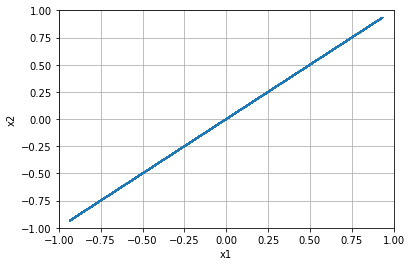


=================== Rollout 2510 =====================
x_init [[ 0.96]
 [-0.56]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 0.96 -0.56]
xx [ 0.96 -0.56]
xxx [ 0.96 -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.56]


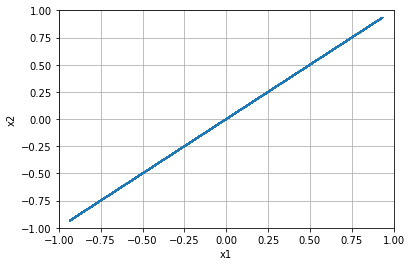


=================== Rollout 2511 =====================
x_init [[ 0.96]
 [-0.52]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 0.96 -0.52]
xx [ 0.96 -0.52]
xxx [ 0.96 -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.52]


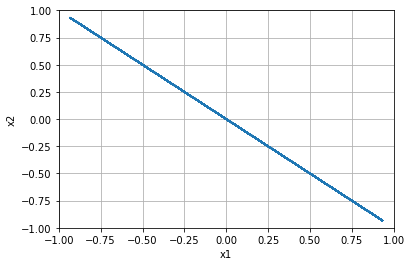


=================== Rollout 2512 =====================
x_init [[ 0.96]
 [-0.48]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 0.96 -0.48]
xx [ 0.96 -0.48]
xxx [ 0.96 -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.48]


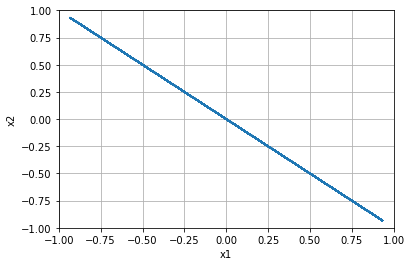


=================== Rollout 2513 =====================
x_init [[ 0.96]
 [-0.44]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 0.96 -0.44]
xx [ 0.96 -0.44]
xxx [ 0.96 -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.43999999999999995]


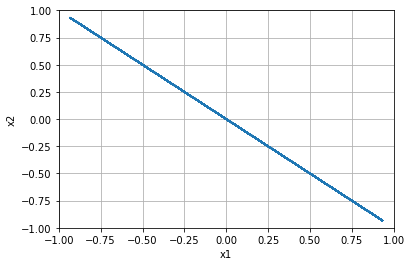


=================== Rollout 2514 =====================
x_init [[ 0.96]
 [-0.4 ]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.4  -0.4  -0.4  -0.4  -0.4 ]]
x [ 0.96 -0.4 ]
xx [ 0.96 -0.4 ]
xxx [ 0.96 -0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.4]


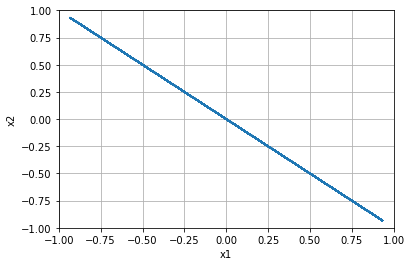


=================== Rollout 2515 =====================
x_init [[ 0.96]
 [-0.36]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 0.96 -0.36]
xx [ 0.96 -0.36]
xxx [ 0.96 -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.36]


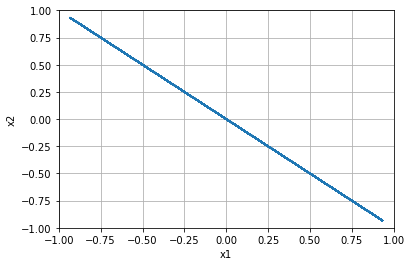


=================== Rollout 2516 =====================
x_init [[ 0.96]
 [-0.32]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 0.96 -0.32]
xx [ 0.96 -0.32]
xxx [ 0.96 -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.31999999999999995]


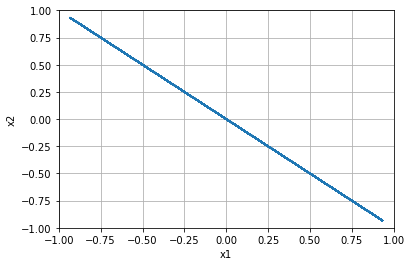


=================== Rollout 2517 =====================
x_init [[ 0.96]
 [-0.28]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 0.96 -0.28]
xx [ 0.96 -0.28]
xxx [ 0.96 -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.28]


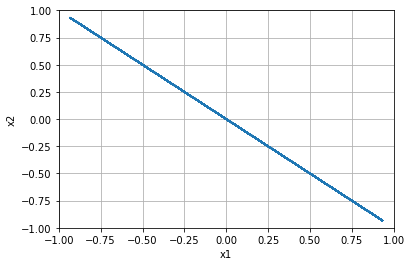


=================== Rollout 2518 =====================
x_init [[ 0.96]
 [-0.24]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 0.96 -0.24]
xx [ 0.96 -0.24]
xxx [ 0.96 -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.24]


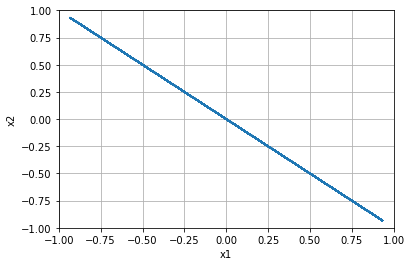


=================== Rollout 2519 =====================
x_init [[ 0.96]
 [-0.2 ]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.2  -0.2  -0.2  -0.2  -0.2 ]]
x [ 0.96 -0.2 ]
xx [ 0.96 -0.2 ]
xxx [ 0.96 -0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.19999999999999996]


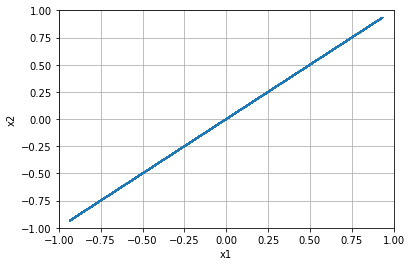


=================== Rollout 2520 =====================
x_init [[ 0.96]
 [-0.16]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 0.96 -0.16]
xx [ 0.96 -0.16]
xxx [ 0.96 -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.16000000000000003]


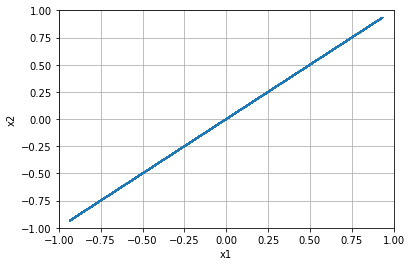


=================== Rollout 2521 =====================
x_init [[ 0.96]
 [-0.12]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 0.96 -0.12]
xx [ 0.96 -0.12]
xxx [ 0.96 -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.12]


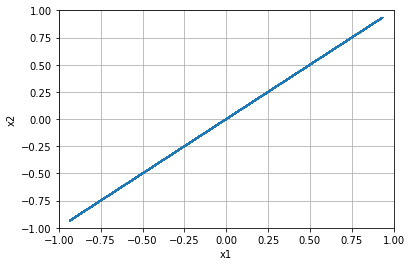


=================== Rollout 2522 =====================
x_init [[ 0.96]
 [-0.08]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 0.96 -0.08]
xx [ 0.96 -0.08]
xxx [ 0.96 -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.07999999999999996]


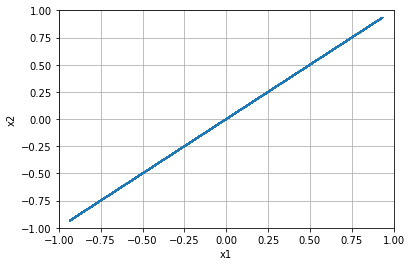


=================== Rollout 2523 =====================
x_init [[ 0.96]
 [-0.04]]
x_buffer [[ 0.96  0.96  0.96  0.96  0.96]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 0.96 -0.04]
xx [ 0.96 -0.04]
xxx [ 0.96 -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, -0.040000000000000036]


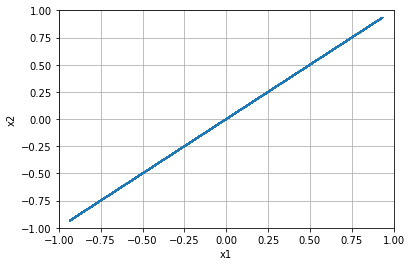


=================== Rollout 2524 =====================
x_init [[0.96]
 [0.  ]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.   0.   0.   0.   0.  ]]
x [0.96 0.  ]
xx [0.96 0.  ]
xxx [0.96 0.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.0]


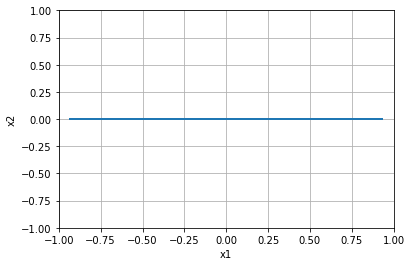


=================== Rollout 2525 =====================
x_init [[0.96]
 [0.04]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.04 0.04 0.04 0.04 0.04]]
x [0.96 0.04]
xx [0.96 0.04]
xxx [0.96 0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.040000000000000036]


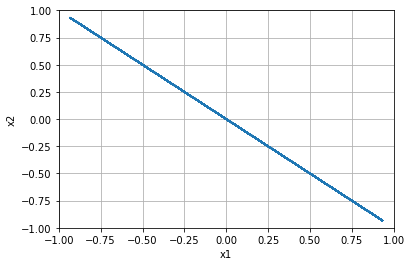


=================== Rollout 2526 =====================
x_init [[0.96]
 [0.08]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.08 0.08 0.08 0.08 0.08]]
x [0.96 0.08]
xx [0.96 0.08]
xxx [0.96 0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.08000000000000007]


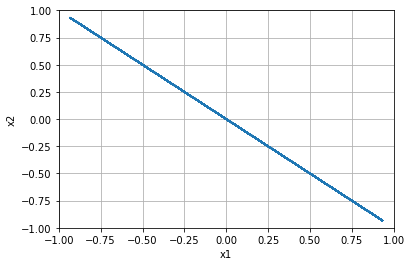


=================== Rollout 2527 =====================
x_init [[0.96]
 [0.12]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.12 0.12 0.12 0.12 0.12]]
x [0.96 0.12]
xx [0.96 0.12]
xxx [0.96 0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.1200000000000001]


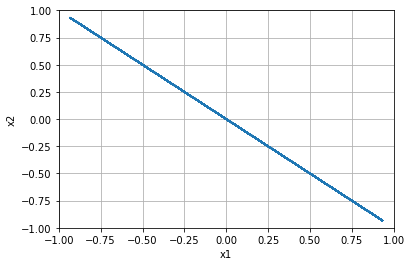


=================== Rollout 2528 =====================
x_init [[0.96]
 [0.16]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.16 0.16 0.16 0.16 0.16]]
x [0.96 0.16]
xx [0.96 0.16]
xxx [0.96 0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.15999999999999992]


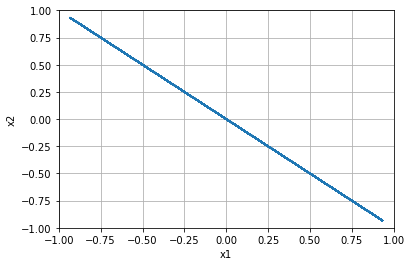


=================== Rollout 2529 =====================
x_init [[0.96]
 [0.2 ]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.2  0.2  0.2  0.2  0.2 ]]
x [0.96 0.2 ]
xx [0.96 0.2 ]
xxx [0.96 0.2 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.19999999999999996]


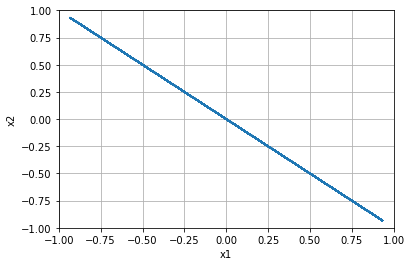


=================== Rollout 2530 =====================
x_init [[0.96]
 [0.24]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.24 0.24 0.24 0.24 0.24]]
x [0.96 0.24]
xx [0.96 0.24]
xxx [0.96 0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.24]


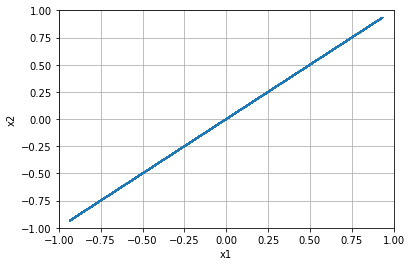


=================== Rollout 2531 =====================
x_init [[0.96]
 [0.28]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.28 0.28 0.28 0.28 0.28]]
x [0.96 0.28]
xx [0.96 0.28]
xxx [0.96 0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.28]


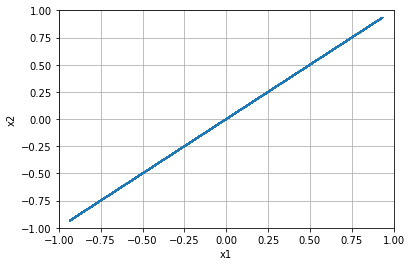


=================== Rollout 2532 =====================
x_init [[0.96]
 [0.32]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.32 0.32 0.32 0.32 0.32]]
x [0.96 0.32]
xx [0.96 0.32]
xxx [0.96 0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.32000000000000006]


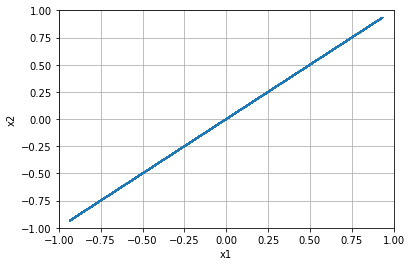


=================== Rollout 2533 =====================
x_init [[0.96]
 [0.36]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.36 0.36 0.36 0.36 0.36]]
x [0.96 0.36]
xx [0.96 0.36]
xxx [0.96 0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.3600000000000001]


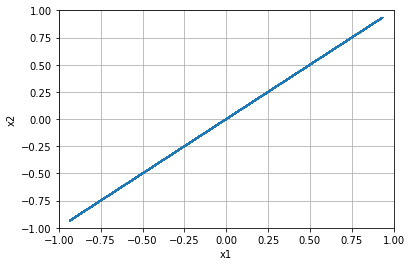


=================== Rollout 2534 =====================
x_init [[0.96]
 [0.4 ]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.4  0.4  0.4  0.4  0.4 ]]
x [0.96 0.4 ]
xx [0.96 0.4 ]
xxx [0.96 0.4 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.40000000000000013]


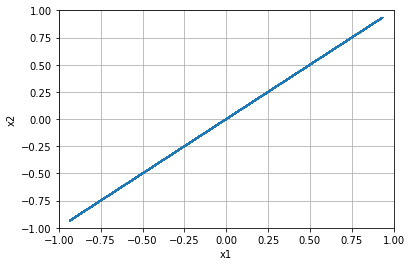


=================== Rollout 2535 =====================
x_init [[0.96]
 [0.44]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.44 0.44 0.44 0.44 0.44]]
x [0.96 0.44]
xx [0.96 0.44]
xxx [0.96 0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.43999999999999995]


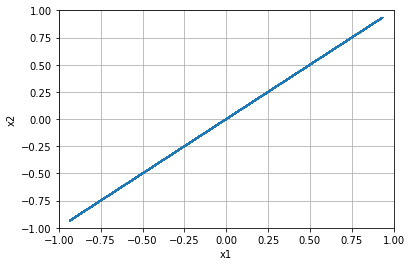


=================== Rollout 2536 =====================
x_init [[0.96]
 [0.48]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.48 0.48 0.48 0.48 0.48]]
x [0.96 0.48]
xx [0.96 0.48]
xxx [0.96 0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.48]


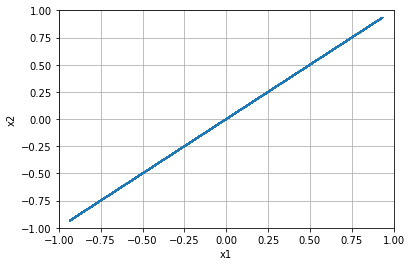


=================== Rollout 2537 =====================
x_init [[0.96]
 [0.52]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.52 0.52 0.52 0.52 0.52]]
x [0.96 0.52]
xx [0.96 0.52]
xxx [0.96 0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.52]


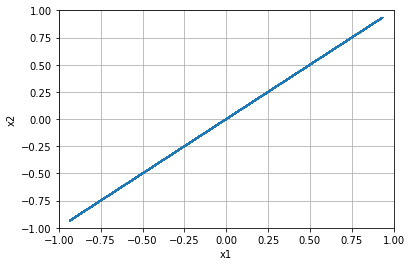


=================== Rollout 2538 =====================
x_init [[0.96]
 [0.56]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.56 0.56 0.56 0.56 0.56]]
x [0.96 0.56]
xx [0.96 0.56]
xxx [0.96 0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.56]


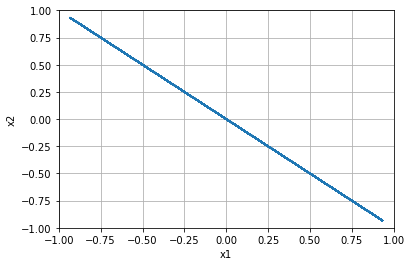


=================== Rollout 2539 =====================
x_init [[0.96]
 [0.6 ]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.6  0.6  0.6  0.6  0.6 ]]
x [0.96 0.6 ]
xx [0.96 0.6 ]
xxx [0.96 0.6 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.6000000000000001]


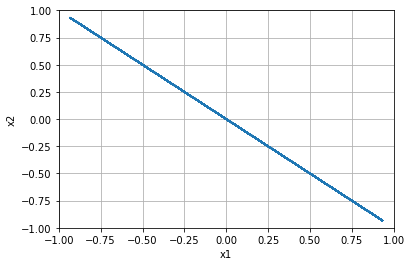


=================== Rollout 2540 =====================
x_init [[0.96]
 [0.64]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.64 0.64 0.64 0.64 0.64]]
x [0.96 0.64]
xx [0.96 0.64]
xxx [0.96 0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.6400000000000001]


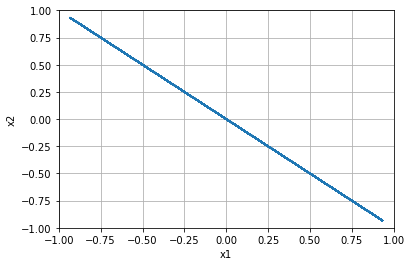


=================== Rollout 2541 =====================
x_init [[0.96]
 [0.68]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.68 0.68 0.68 0.68 0.68]]
x [0.96 0.68]
xx [0.96 0.68]
xxx [0.96 0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.6799999999999999]


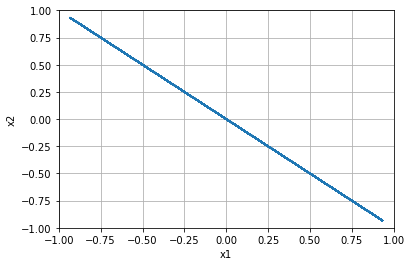


=================== Rollout 2542 =====================
x_init [[0.96]
 [0.72]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.72 0.72 0.72 0.72 0.72]]
x [0.96 0.72]
xx [0.96 0.72]
xxx [0.96 0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.72]


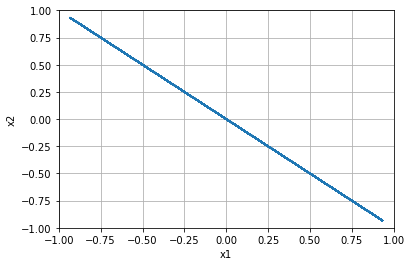


=================== Rollout 2543 =====================
x_init [[0.96]
 [0.76]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.76 0.76 0.76 0.76 0.76]]
x [0.96 0.76]
xx [0.96 0.76]
xxx [0.96 0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.76]


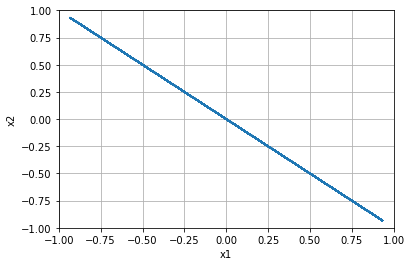


=================== Rollout 2544 =====================
x_init [[0.96]
 [0.8 ]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.8  0.8  0.8  0.8  0.8 ]]
x [0.96 0.8 ]
xx [0.96 0.8 ]
xxx [0.96 0.8 ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.8]


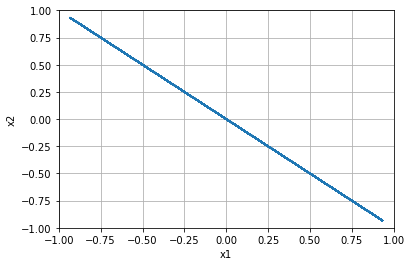


=================== Rollout 2545 =====================
x_init [[0.96]
 [0.84]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.84 0.84 0.84 0.84 0.84]]
x [0.96 0.84]
xx [0.96 0.84]
xxx [0.96 0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.8400000000000001]


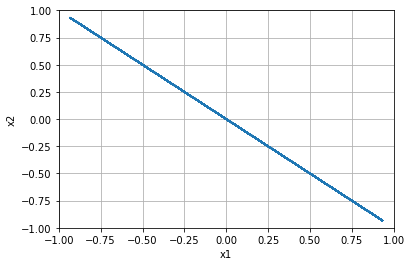


=================== Rollout 2546 =====================
x_init [[0.96]
 [0.88]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.88 0.88 0.88 0.88 0.88]]
x [0.96 0.88]
xx [0.96 0.88]
xxx [0.96 0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.8800000000000001]


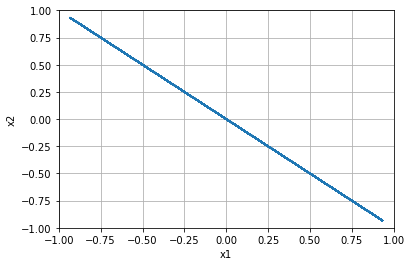


=================== Rollout 2547 =====================
x_init [[0.96]
 [0.92]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.92 0.92 0.92 0.92 0.92]]
x [0.96 0.92]
xx [0.96 0.92]
xxx [0.96 0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.9199999999999999]


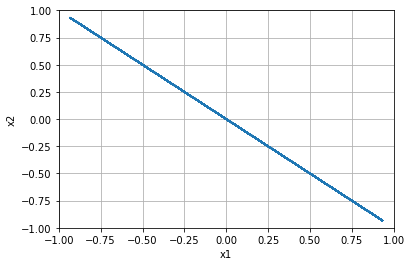


=================== Rollout 2548 =====================
x_init [[0.96]
 [0.96]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [0.96 0.96 0.96 0.96 0.96]]
x [0.96 0.96]
xx [0.96 0.96]
xxx [0.96 0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 0.96]


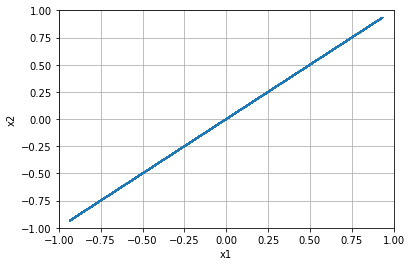


=================== Rollout 2549 =====================
x_init [[0.96]
 [1.  ]]
x_buffer [[0.96 0.96 0.96 0.96 0.96]
 [1.   1.   1.   1.   1.  ]]
x [0.96 1.  ]
xx [0.96 1.  ]
xxx [0.96 1.  ]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [0.96, 1.0]


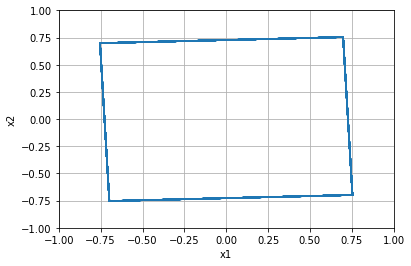


=================== Rollout 2550 =====================
x_init [[ 1.]
 [-1.]]
x_buffer [[ 1.  1.  1.  1.  1.]
 [-1. -1. -1. -1. -1.]]
x [ 1. -1.]
xx [ 1. -1.]
xxx [ 1. -1.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -1.0]


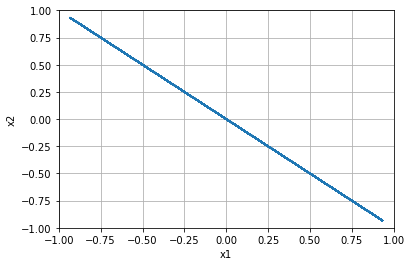


=================== Rollout 2551 =====================
x_init [[ 1.  ]
 [-0.96]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.96 -0.96 -0.96 -0.96 -0.96]]
x [ 1.   -0.96]
xx [ 1.   -0.96]
xxx [ 1.   -0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.96]


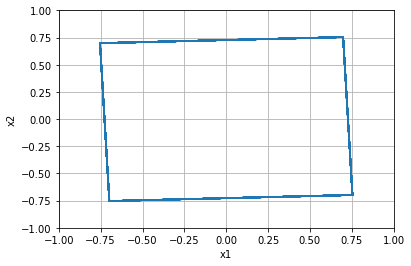


=================== Rollout 2552 =====================
x_init [[ 1.  ]
 [-0.92]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.92 -0.92 -0.92 -0.92 -0.92]]
x [ 1.   -0.92]
xx [ 1.   -0.92]
xxx [ 1.   -0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.92]


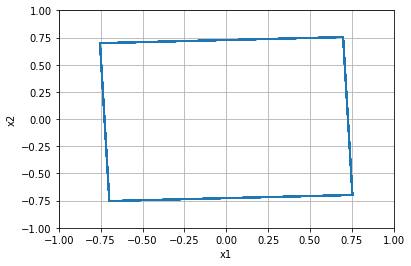


=================== Rollout 2553 =====================
x_init [[ 1.  ]
 [-0.88]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.88 -0.88 -0.88 -0.88 -0.88]]
x [ 1.   -0.88]
xx [ 1.   -0.88]
xxx [ 1.   -0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.88]


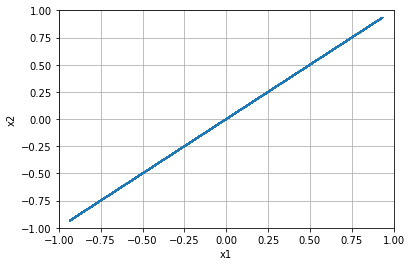


=================== Rollout 2554 =====================
x_init [[ 1.  ]
 [-0.84]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.84 -0.84 -0.84 -0.84 -0.84]]
x [ 1.   -0.84]
xx [ 1.   -0.84]
xxx [ 1.   -0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.84]


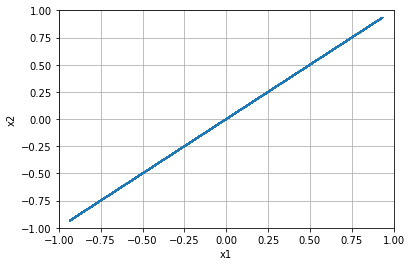


=================== Rollout 2555 =====================
x_init [[ 1. ]
 [-0.8]]
x_buffer [[ 1.   1.   1.   1.   1. ]
 [-0.8 -0.8 -0.8 -0.8 -0.8]]
x [ 1.  -0.8]
xx [ 1.  -0.8]
xxx [ 1.  -0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.8]


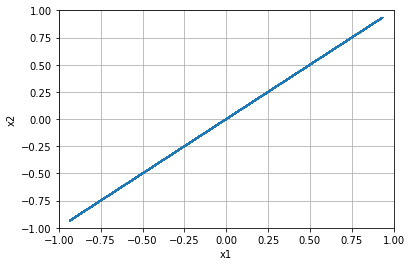


=================== Rollout 2556 =====================
x_init [[ 1.  ]
 [-0.76]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.76 -0.76 -0.76 -0.76 -0.76]]
x [ 1.   -0.76]
xx [ 1.   -0.76]
xxx [ 1.   -0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.76]


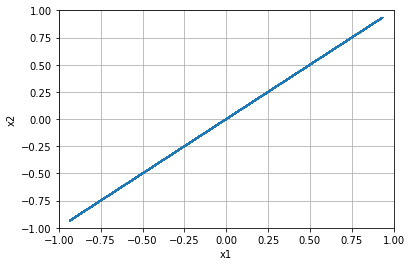


=================== Rollout 2557 =====================
x_init [[ 1.  ]
 [-0.72]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.72 -0.72 -0.72 -0.72 -0.72]]
x [ 1.   -0.72]
xx [ 1.   -0.72]
xxx [ 1.   -0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.72]


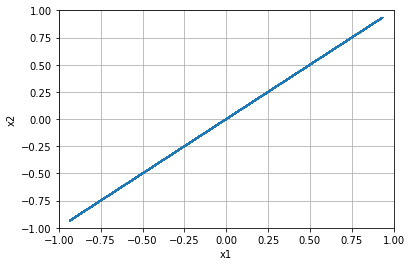


=================== Rollout 2558 =====================
x_init [[ 1.  ]
 [-0.68]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.68 -0.68 -0.68 -0.68 -0.68]]
x [ 1.   -0.68]
xx [ 1.   -0.68]
xxx [ 1.   -0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.6799999999999999]


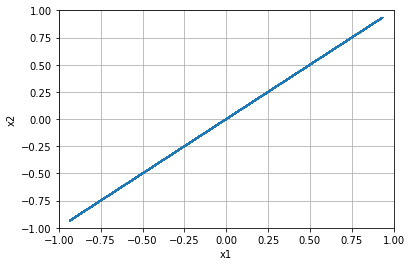


=================== Rollout 2559 =====================
x_init [[ 1.  ]
 [-0.64]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.64 -0.64 -0.64 -0.64 -0.64]]
x [ 1.   -0.64]
xx [ 1.   -0.64]
xxx [ 1.   -0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.64]


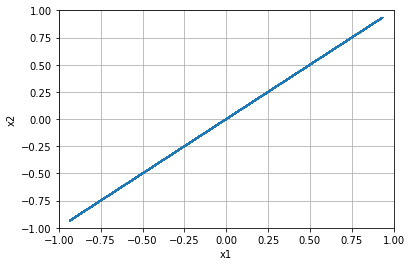


=================== Rollout 2560 =====================
x_init [[ 1. ]
 [-0.6]]
x_buffer [[ 1.   1.   1.   1.   1. ]
 [-0.6 -0.6 -0.6 -0.6 -0.6]]
x [ 1.  -0.6]
xx [ 1.  -0.6]
xxx [ 1.  -0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.6]


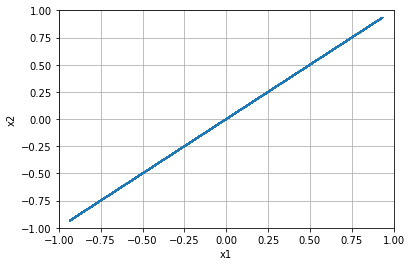


=================== Rollout 2561 =====================
x_init [[ 1.  ]
 [-0.56]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.56 -0.56 -0.56 -0.56 -0.56]]
x [ 1.   -0.56]
xx [ 1.   -0.56]
xxx [ 1.   -0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.56]


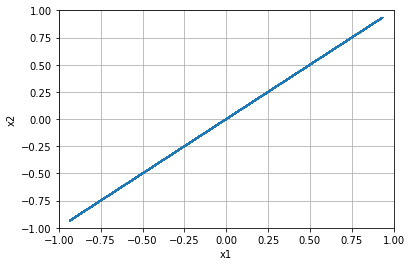


=================== Rollout 2562 =====================
x_init [[ 1.  ]
 [-0.52]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.52 -0.52 -0.52 -0.52 -0.52]]
x [ 1.   -0.52]
xx [ 1.   -0.52]
xxx [ 1.   -0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.52]


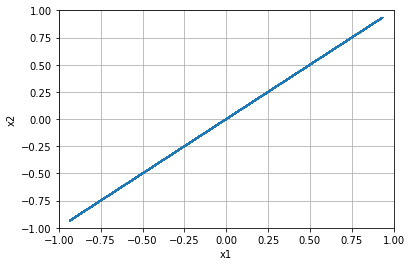


=================== Rollout 2563 =====================
x_init [[ 1.  ]
 [-0.48]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.48 -0.48 -0.48 -0.48 -0.48]]
x [ 1.   -0.48]
xx [ 1.   -0.48]
xxx [ 1.   -0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.48]


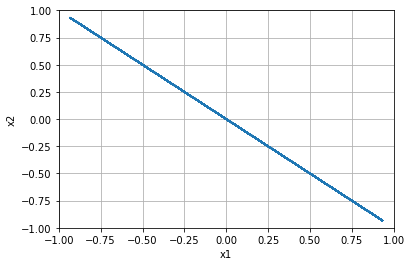


=================== Rollout 2564 =====================
x_init [[ 1.  ]
 [-0.44]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.44 -0.44 -0.44 -0.44 -0.44]]
x [ 1.   -0.44]
xx [ 1.   -0.44]
xxx [ 1.   -0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.43999999999999995]


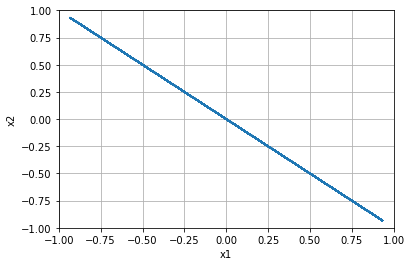


=================== Rollout 2565 =====================
x_init [[ 1. ]
 [-0.4]]
x_buffer [[ 1.   1.   1.   1.   1. ]
 [-0.4 -0.4 -0.4 -0.4 -0.4]]
x [ 1.  -0.4]
xx [ 1.  -0.4]
xxx [ 1.  -0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.4]


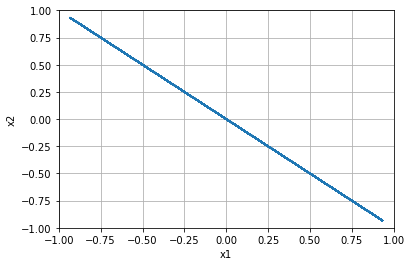


=================== Rollout 2566 =====================
x_init [[ 1.  ]
 [-0.36]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.36 -0.36 -0.36 -0.36 -0.36]]
x [ 1.   -0.36]
xx [ 1.   -0.36]
xxx [ 1.   -0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.36]


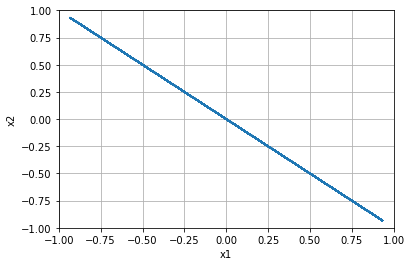


=================== Rollout 2567 =====================
x_init [[ 1.  ]
 [-0.32]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.32 -0.32 -0.32 -0.32 -0.32]]
x [ 1.   -0.32]
xx [ 1.   -0.32]
xxx [ 1.   -0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.31999999999999995]


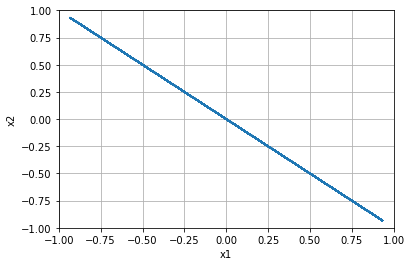


=================== Rollout 2568 =====================
x_init [[ 1.  ]
 [-0.28]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.28 -0.28 -0.28 -0.28 -0.28]]
x [ 1.   -0.28]
xx [ 1.   -0.28]
xxx [ 1.   -0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.28]


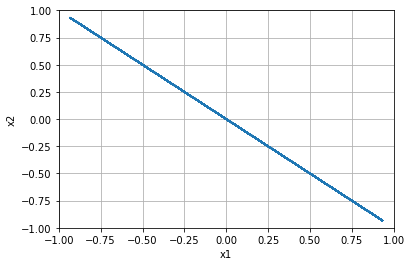


=================== Rollout 2569 =====================
x_init [[ 1.  ]
 [-0.24]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.24 -0.24 -0.24 -0.24 -0.24]]
x [ 1.   -0.24]
xx [ 1.   -0.24]
xxx [ 1.   -0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.24]


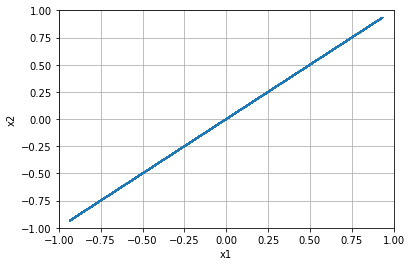


=================== Rollout 2570 =====================
x_init [[ 1. ]
 [-0.2]]
x_buffer [[ 1.   1.   1.   1.   1. ]
 [-0.2 -0.2 -0.2 -0.2 -0.2]]
x [ 1.  -0.2]
xx [ 1.  -0.2]
xxx [ 1.  -0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.19999999999999996]


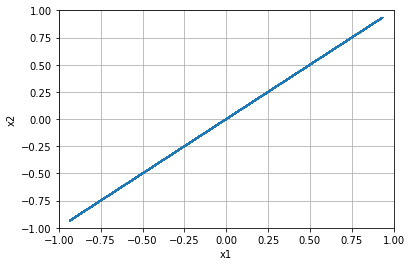


=================== Rollout 2571 =====================
x_init [[ 1.  ]
 [-0.16]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.16 -0.16 -0.16 -0.16 -0.16]]
x [ 1.   -0.16]
xx [ 1.   -0.16]
xxx [ 1.   -0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.16000000000000003]


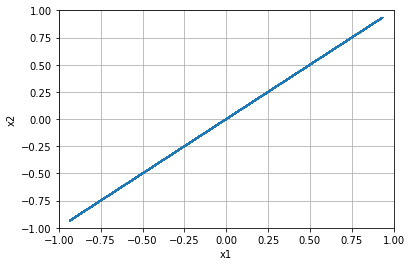


=================== Rollout 2572 =====================
x_init [[ 1.  ]
 [-0.12]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.12 -0.12 -0.12 -0.12 -0.12]]
x [ 1.   -0.12]
xx [ 1.   -0.12]
xxx [ 1.   -0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.12]


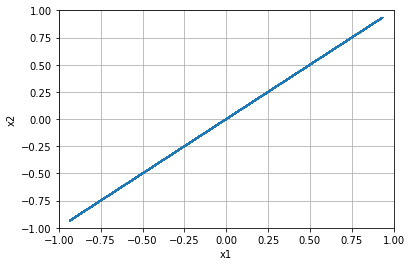


=================== Rollout 2573 =====================
x_init [[ 1.  ]
 [-0.08]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.08 -0.08 -0.08 -0.08 -0.08]]
x [ 1.   -0.08]
xx [ 1.   -0.08]
xxx [ 1.   -0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.07999999999999996]


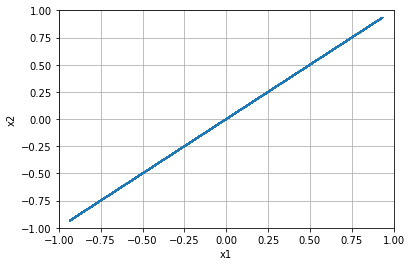


=================== Rollout 2574 =====================
x_init [[ 1.  ]
 [-0.04]]
x_buffer [[ 1.    1.    1.    1.    1.  ]
 [-0.04 -0.04 -0.04 -0.04 -0.04]]
x [ 1.   -0.04]
xx [ 1.   -0.04]
xxx [ 1.   -0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, -0.040000000000000036]


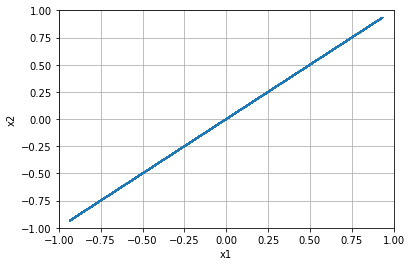


=================== Rollout 2575 =====================
x_init [[1.]
 [0.]]
x_buffer [[1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0.]]
x [1. 0.]
xx [1. 0.]
xxx [1. 0.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.0]


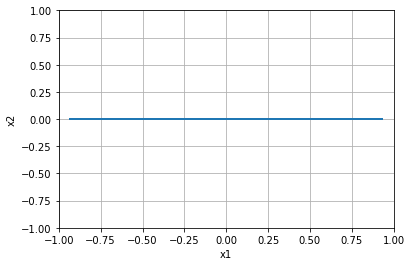


=================== Rollout 2576 =====================
x_init [[1.  ]
 [0.04]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.04 0.04 0.04 0.04 0.04]]
x [1.   0.04]
xx [1.   0.04]
xxx [1.   0.04]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.040000000000000036]


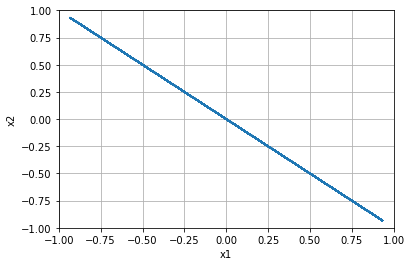


=================== Rollout 2577 =====================
x_init [[1.  ]
 [0.08]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.08 0.08 0.08 0.08 0.08]]
x [1.   0.08]
xx [1.   0.08]
xxx [1.   0.08]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.08000000000000007]


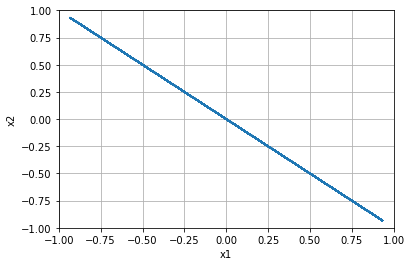


=================== Rollout 2578 =====================
x_init [[1.  ]
 [0.12]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.12 0.12 0.12 0.12 0.12]]
x [1.   0.12]
xx [1.   0.12]
xxx [1.   0.12]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.1200000000000001]


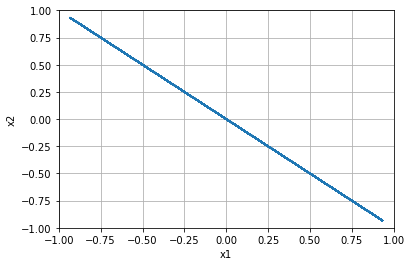


=================== Rollout 2579 =====================
x_init [[1.  ]
 [0.16]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.16 0.16 0.16 0.16 0.16]]
x [1.   0.16]
xx [1.   0.16]
xxx [1.   0.16]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.15999999999999992]


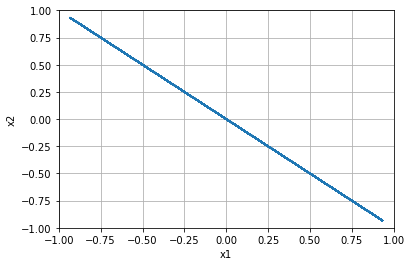


=================== Rollout 2580 =====================
x_init [[1. ]
 [0.2]]
x_buffer [[1.  1.  1.  1.  1. ]
 [0.2 0.2 0.2 0.2 0.2]]
x [1.  0.2]
xx [1.  0.2]
xxx [1.  0.2]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.19999999999999996]


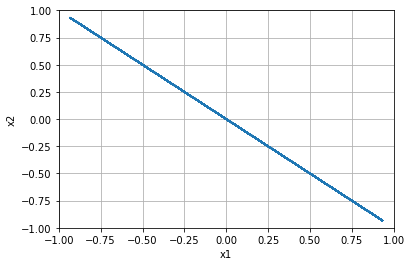


=================== Rollout 2581 =====================
x_init [[1.  ]
 [0.24]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.24 0.24 0.24 0.24 0.24]]
x [1.   0.24]
xx [1.   0.24]
xxx [1.   0.24]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.24]


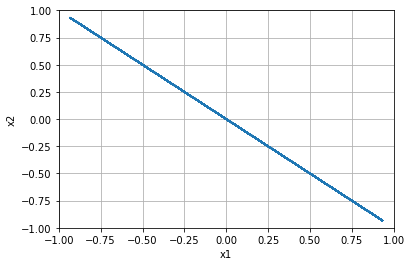


=================== Rollout 2582 =====================
x_init [[1.  ]
 [0.28]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.28 0.28 0.28 0.28 0.28]]
x [1.   0.28]
xx [1.   0.28]
xxx [1.   0.28]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.28]


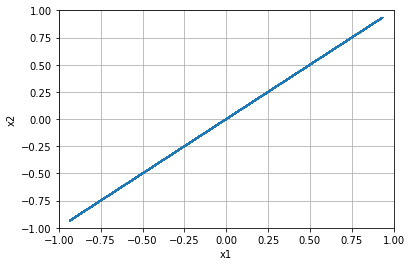


=================== Rollout 2583 =====================
x_init [[1.  ]
 [0.32]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.32 0.32 0.32 0.32 0.32]]
x [1.   0.32]
xx [1.   0.32]
xxx [1.   0.32]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.32000000000000006]


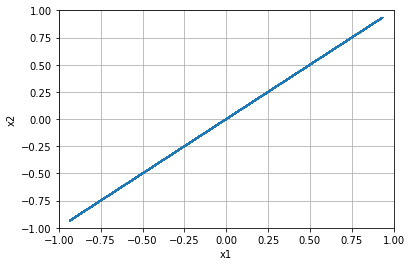


=================== Rollout 2584 =====================
x_init [[1.  ]
 [0.36]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.36 0.36 0.36 0.36 0.36]]
x [1.   0.36]
xx [1.   0.36]
xxx [1.   0.36]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.3600000000000001]


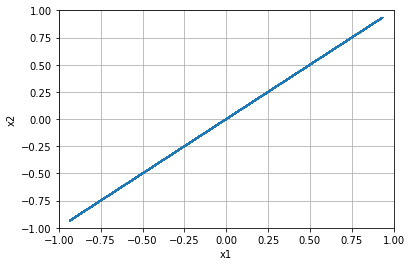


=================== Rollout 2585 =====================
x_init [[1. ]
 [0.4]]
x_buffer [[1.  1.  1.  1.  1. ]
 [0.4 0.4 0.4 0.4 0.4]]
x [1.  0.4]
xx [1.  0.4]
xxx [1.  0.4]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.40000000000000013]


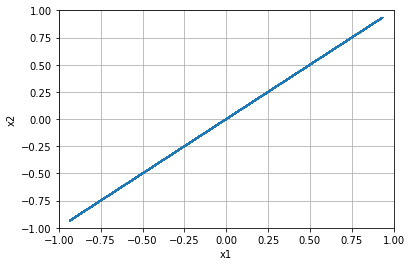


=================== Rollout 2586 =====================
x_init [[1.  ]
 [0.44]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.44 0.44 0.44 0.44 0.44]]
x [1.   0.44]
xx [1.   0.44]
xxx [1.   0.44]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.43999999999999995]


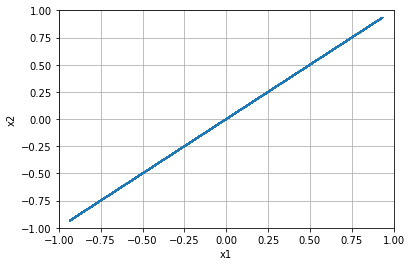


=================== Rollout 2587 =====================
x_init [[1.  ]
 [0.48]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.48 0.48 0.48 0.48 0.48]]
x [1.   0.48]
xx [1.   0.48]
xxx [1.   0.48]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.48]


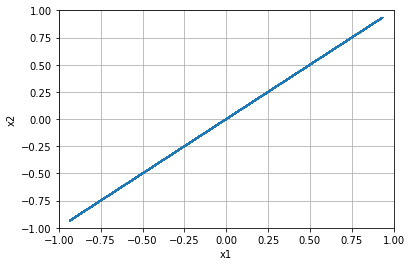


=================== Rollout 2588 =====================
x_init [[1.  ]
 [0.52]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.52 0.52 0.52 0.52 0.52]]
x [1.   0.52]
xx [1.   0.52]
xxx [1.   0.52]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.52]


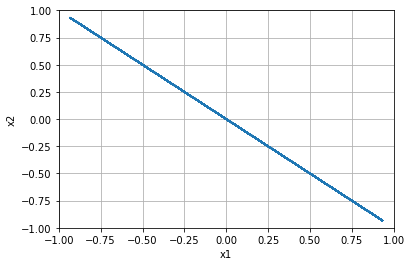


=================== Rollout 2589 =====================
x_init [[1.  ]
 [0.56]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.56 0.56 0.56 0.56 0.56]]
x [1.   0.56]
xx [1.   0.56]
xxx [1.   0.56]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.56]


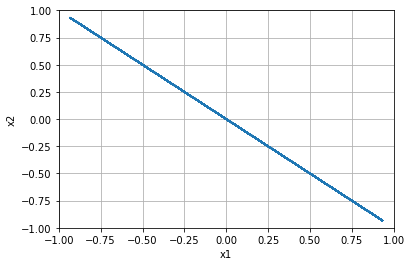


=================== Rollout 2590 =====================
x_init [[1. ]
 [0.6]]
x_buffer [[1.  1.  1.  1.  1. ]
 [0.6 0.6 0.6 0.6 0.6]]
x [1.  0.6]
xx [1.  0.6]
xxx [1.  0.6]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.6000000000000001]


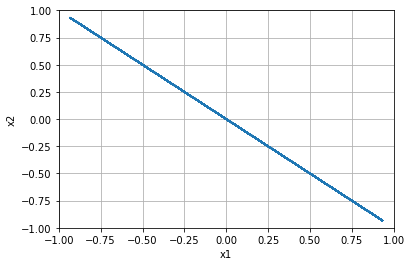


=================== Rollout 2591 =====================
x_init [[1.  ]
 [0.64]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.64 0.64 0.64 0.64 0.64]]
x [1.   0.64]
xx [1.   0.64]
xxx [1.   0.64]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.6400000000000001]


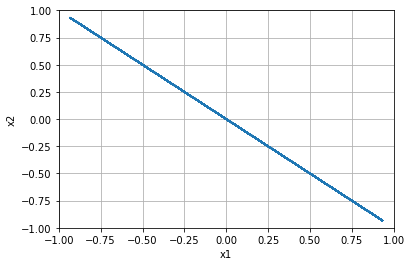


=================== Rollout 2592 =====================
x_init [[1.  ]
 [0.68]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.68 0.68 0.68 0.68 0.68]]
x [1.   0.68]
xx [1.   0.68]
xxx [1.   0.68]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.6799999999999999]


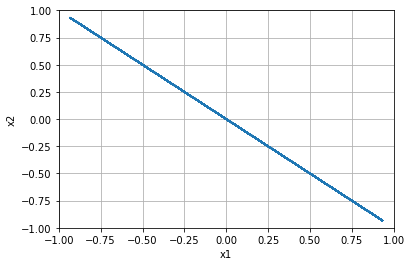


=================== Rollout 2593 =====================
x_init [[1.  ]
 [0.72]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.72 0.72 0.72 0.72 0.72]]
x [1.   0.72]
xx [1.   0.72]
xxx [1.   0.72]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.72]


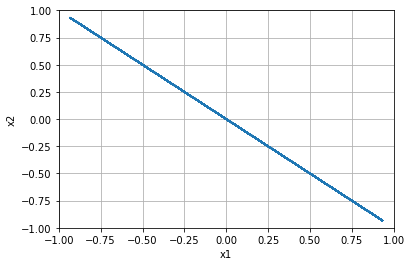


=================== Rollout 2594 =====================
x_init [[1.  ]
 [0.76]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.76 0.76 0.76 0.76 0.76]]
x [1.   0.76]
xx [1.   0.76]
xxx [1.   0.76]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.76]


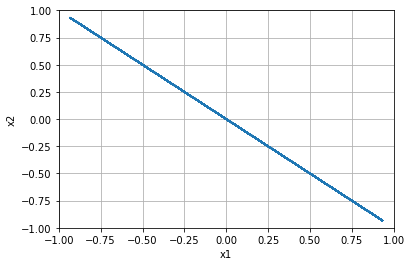


=================== Rollout 2595 =====================
x_init [[1. ]
 [0.8]]
x_buffer [[1.  1.  1.  1.  1. ]
 [0.8 0.8 0.8 0.8 0.8]]
x [1.  0.8]
xx [1.  0.8]
xxx [1.  0.8]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.8]


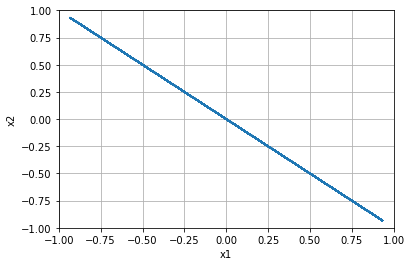


=================== Rollout 2596 =====================
x_init [[1.  ]
 [0.84]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.84 0.84 0.84 0.84 0.84]]
x [1.   0.84]
xx [1.   0.84]
xxx [1.   0.84]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.8400000000000001]


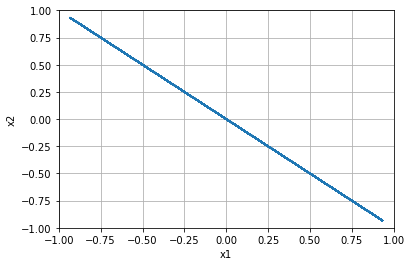


=================== Rollout 2597 =====================
x_init [[1.  ]
 [0.88]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.88 0.88 0.88 0.88 0.88]]
x [1.   0.88]
xx [1.   0.88]
xxx [1.   0.88]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.8800000000000001]


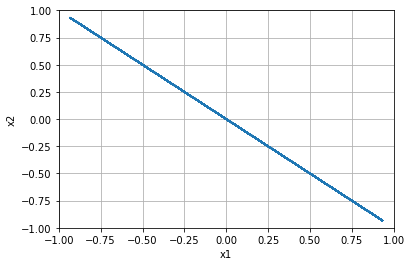


=================== Rollout 2598 =====================
x_init [[1.  ]
 [0.92]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.92 0.92 0.92 0.92 0.92]]
x [1.   0.92]
xx [1.   0.92]
xxx [1.   0.92]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.9199999999999999]


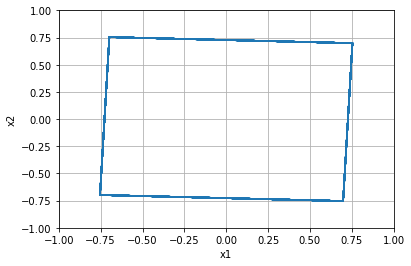


=================== Rollout 2599 =====================
x_init [[1.  ]
 [0.96]]
x_buffer [[1.   1.   1.   1.   1.  ]
 [0.96 0.96 0.96 0.96 0.96]]
x [1.   0.96]
xx [1.   0.96]
xxx [1.   0.96]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 0.96]


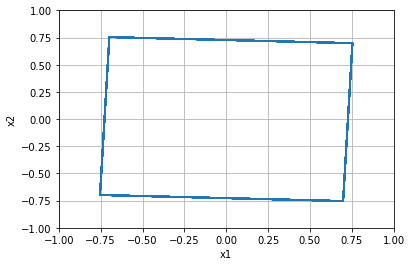


=================== Rollout 2600 =====================
x_init [[1.]
 [1.]]
x_buffer [[1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1.]]
x [1. 1.]
xx [1. 1.]
xxx [1. 1.]
x_dot [[0. 0.]]
y_dot_tilde [[0.]
 [0.]]
shape (20000, 2, 2)
Rollout starting at [1.0, 1.0]


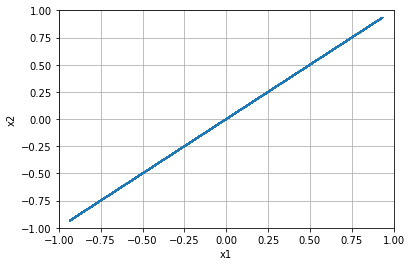

c_means
(2601, 4)
[[ 0  0  0  0]
 [ 0 -1  1  0]
 [ 0 -1  1  0]
 ...
 [ 0 -1  1  0]
 [ 0 -1  1  0]
 [ 0  0  0  0]]
c_clusters
(2601,)
[5 3 3 ... 3 3 5]
c_clusters.unique
[1 2 3 4 5 6]
c_means[c_clusters==1]
[1. 0. 0. 1.]
n_clusters 6
cluster_means
[array([1., 0., 0., 1.]), array([ 0.,  1., -1.,  0.]), array([ 0., -1.,  1.,  0.]), array([ 0.,  0.,  0., -1.]), array([0., 0., 0., 0.]), array([-1.,  0.,  0.,  0.])]
cluster_numbers
[4 2 2 ... 2 2 4]


In [10]:
c_means = np.full((START_POINTS_PER_SENSORY_DIMENSION**2, N_SENSORS**2), -1)
angles = np.full((START_POINTS_PER_SENSORY_DIMENSION, START_POINTS_PER_SENSORY_DIMENSION), -1)
x1_range = np.linspace(-1, 1, START_POINTS_PER_SENSORY_DIMENSION)
x2_range = np.linspace(-1, 1, START_POINTS_PER_SENSORY_DIMENSION)
fixed_point_values = None
#fixed_point_detector = FixedPointDetector()
n = 0
for i in range(len((x1_range))):
    for j in range(len(x2_range)):
        print("\n=================== Rollout %d =====================" % n)
        c_mean, all_c_hat, all_x = rollout_dep(x1_range[i], x2_range[j])
        c_means[n,:] = c_mean.flatten()
        # j,i to plot x1 on x axis, x2 on y axis
        angles[i,j] = get_angle_from_c_mean(c_mean)
        n = n + 1
        if PLOT_TIMESTEPS:
            print("Rollout starting at", [x1_range[i], x2_range[j]])
            plot_trajectory(all_x)
        if PLOT_C_HAT_EVOLUTION:
            plot_c(all_c_hat)
print("c_means")
print(c_means.shape)
print(c_means)
c_clusters = cluster.hierarchy.fclusterdata(c_means, MAX_CLUSTER_DISTANCE, criterion='distance')
print("c_clusters")
print(c_clusters.shape)
print(c_clusters)
print("c_clusters.unique")
print(np.unique(c_clusters))
print("c_means[c_clusters==1]")
print(np.mean(c_means[c_clusters==1], axis=0))

n_clusters = np.max(c_clusters)
print("n_clusters", n_clusters)
cluster_means = [np.mean(c_means[c_clusters==i+1], axis=0) for i in range(n_clusters)]
print("cluster_means")
print(cluster_means)
#cluster_numbers = c_clusters.reshape(START_POINTS_PER_SENSORY_DIMENSION,START_POINTS_PER_SENSORY_DIMENSION)
cluster_numbers = np.subtract(c_clusters,1)
print("cluster_numbers")
print(cluster_numbers)


x_start
[[[-1.   -1.  ]
  [-1.   -0.96]
  [-1.   -0.92]
  ...
  [-1.    0.92]
  [-1.    0.96]
  [-1.    1.  ]]

 [[-0.96 -1.  ]
  [-0.96 -0.96]
  [-0.96 -0.92]
  ...
  [-0.96  0.92]
  [-0.96  0.96]
  [-0.96  1.  ]]

 [[-0.92 -1.  ]
  [-0.92 -0.96]
  [-0.92 -0.92]
  ...
  [-0.92  0.92]
  [-0.92  0.96]
  [-0.92  1.  ]]

 ...

 [[ 0.92 -1.  ]
  [ 0.92 -0.96]
  [ 0.92 -0.92]
  ...
  [ 0.92  0.92]
  [ 0.92  0.96]
  [ 0.92  1.  ]]

 [[ 0.96 -1.  ]
  [ 0.96 -0.96]
  [ 0.96 -0.92]
  ...
  [ 0.96  0.92]
  [ 0.96  0.96]
  [ 0.96  1.  ]]

 [[ 1.   -1.  ]
  [ 1.   -0.96]
  [ 1.   -0.92]
  ...
  [ 1.    0.92]
  [ 1.    0.96]
  [ 1.    1.  ]]]


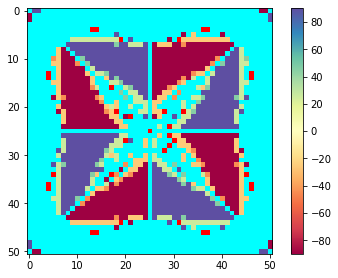

In [11]:
#print("angles", angles)
norm = matplotlib.colors.Normalize(vmin=-90, vmax=90, clip=True)
mapper = matplotlib.cm.ScalarMappable(norm=norm, cmap=matplotlib.cm.Spectral)

x_start = np.zeros(shape=(START_POINTS_PER_SENSORY_DIMENSION, START_POINTS_PER_SENSORY_DIMENSION, 2))
colours = np.zeros(shape=(START_POINTS_PER_SENSORY_DIMENSION, START_POINTS_PER_SENSORY_DIMENSION, 4))
for i in range(START_POINTS_PER_SENSORY_DIMENSION):
    for j in range(START_POINTS_PER_SENSORY_DIMENSION):
        x_start[i,j] = [x1_range[i], x2_range[j]]
        angle = angles[i,j]
        colours[i,j,:] = angle_to_rgba(angle)
print("x_start")
print(x_start)
fig, ax = plt.subplots()
fig.tight_layout()
fig.colorbar(mapper)
matrix = ax.imshow(colours)

plt.show()

In [12]:
matrix

6 fixed points
det 1.0 trace 2.0 angle 0.0 colour [0.998077662437524, 0.9992310649750096, 0.7460207612456747, 1.0]
det 1.0 trace 0.0 angle -90.0 colour [0.6196078431372549, 0.00392156862745098, 0.25882352941176473, 1.0]
det 1.0 trace 0.0 angle 90.0 colour [0.3686274509803922, 0.30980392156862746, 0.6352941176470588, 1.0]
det 0.0 trace -1.0 angle -1000 colour [0, 1, 1, 1]
det 0.0 trace 0.0 angle -2000 colour [1, 0, 0, 1]
det 0.0 trace -1.0 angle -1000 colour [0, 1, 1, 1]


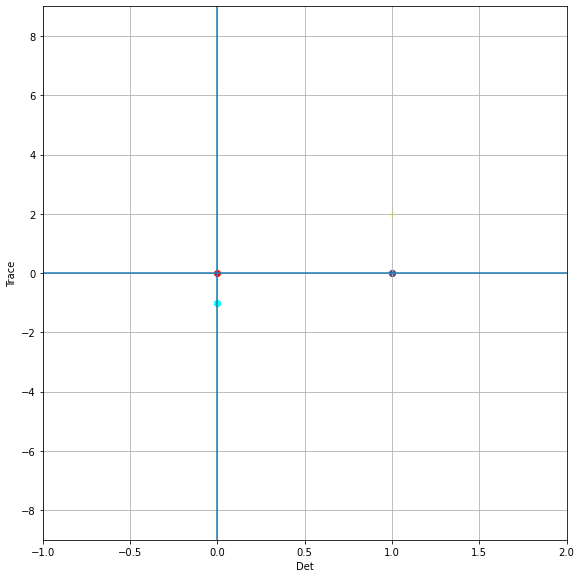

In [13]:
print("%d fixed points" % n_clusters)
fig, ax = plt.subplots(figsize=(8,8))
fig.tight_layout()
for c_mean in cluster_means:
    c_mean = c_mean.reshape(N_SENSORS, N_SENSORS)
    det = np.linalg.det(c_mean)
    trace = np.trace(c_mean)
    angle = get_angle_from_c_mean(c_mean)
    colour = angle_to_rgba(angle)
    print("det", det, "trace", trace, "angle", angle, "colour", colour)
    ax.scatter(det, trace, label=str(i), color=colour)
ax.grid()
#ax.legend()
ax.set_xlabel("Det")
ax.set_ylabel("Trace")
ax.axvline()
ax.axhline()
ax.set_xlim(-1,2)
ax.set_ylim(-9,9)
plt.show()

In [14]:
np.allclose([0.000000001],[0.000000002])

True

In [15]:
class FixedPointDetector():
    
    def __init__(self):
        self.fixed_points = []
        self.angles = []
        self.colours = []
    
    def detect(self, items):
        if len(items)<FIXED_POINT_TIME_THRESHOLD+1:
            return -1
        for i in range(FIXED_POINT_TIME_THRESHOLD):
            if not np.allclose(items[-1-i], items[-2-i]):
                return -1
        if not np.allclose(items[-1], items[-FIXED_POINT_TIME_THRESHOLD]):
            return -1
        print("Fixed point detected at %d timseteps" % len(items))
        print("We currently have %d fixed points" % len(self.fixed_points))
        items = np.array(items)
        new_fixed_point = np.mean(items[-FIXED_POINT_TIME_THRESHOLD:], axis=0)
        print("Last item")
        print(items[-1])
        print("new_fixed_point")
        print(new_fixed_point)
        for i, fp in enumerate(self.fixed_points):
            if np.allclose(fp, new_fixed_point, atol=FIXED_POINT_ABS_TOLERANCE, rtol=FIXED_POINT_REL_TOLERANCE): # default=200
                print("== Is equal to existing fixed point %d" % i)
                return i
        print("++ Appending new fixed point")    
        self.fixed_points.append(new_fixed_point)
        i = len(self.fixed_points)-1
        angle, colour = self.angle_and_colour(i)
        self.angles.append(angle)
        print("Colour", colour)
        self.colours.append(colour)
        print("Now we have %d fixed points" % len(self.fixed_points))
        return i
    
    def angle_and_colour(self, i):
        angle = -1000
        colour = CYAN
        c_hat = self.fixed_points[i]
        p2 = np.matmul(c_hat.T, c_hat)*2/(KAPPA**2)
        print("c_hat.T*c_hat*2/k**2")
        print(p2)
        #orthogonal = np.allclose(p2, np.identity(N_SENSORS), atol=ORTHOGONALITY_TOLERANCE)
        #print("orthogonal", orthogonal)
        scaled_c_hat = c_hat*math.sqrt(2)/KAPPA
        det = np.linalg.det(scaled_c_hat)
        print("scaled det", det)
        det_is_1 = (abs(1-det) < DET_IS_ONE_TOLERANCE) 
        orthogonal = det_is_1 or (abs(-1-det) < DET_IS_ONE_TOLERANCE)
        print("det_is_1", det_is_1)
        print("orthogonal", orthogonal)
        if orthogonal: # and orthogonal:
            angle = math.atan2(scaled_c_hat[0,0], scaled_c_hat[0,1])*180/math.pi
            if angle>90:
                angle = - 180 + angle
                colour = self.angle_to_rgba(angle)
            print("Angle",angle)
        return (angle, colour)  
        
    def angle_to_rgba(self, angle):
        norm = matplotlib.colors.Normalize(vmin=-90, vmax=90, clip=True)
        mapper = matplotlib.cm.ScalarMappable(norm=norm, cmap=matplotlib.cm.Spectral)
        return list(mapper.to_rgba(angle))